## Imports and settings

In [1]:
# reloads all sourced file before running called functions; avoids having to restart kernel for every modification
%load_ext autoreload
%autoreload 2

%matplotlib inline

In [2]:
PATH = ''

In [3]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from matplotlib.patches import Polygon
from scipy.spatial import ConvexHull
from matplotlib.colors import to_rgba
import seaborn as sns
sns.set_style('whitegrid')
from concave_hull import ConcaveHull

import pickle
import os
import sys
sys.path.append('../')
from miscellanea import np_to_pd, Simulator, barplot_diagnostics, coverage_diagnostics_branch, diagnostics_2D, hpd_region
from sbibm_gmm_modified import GaussianMixture
from bayesian_lfi_utils import func
from tqdm import tqdm

In [5]:
from qr_algorithms.complete_list import classifier_cde_dict
from qr_utils.qr_functions import train_qr_algo
import torch

In [5]:
from pyro import distributions as pdist
from sbi.inference.base import infer, simulate_for_sbi
from sbi.simulators.simutils import simulate_in_batches
from sbi.utils import MultipleIndependent
import sbibm
from sbibm.algorithms import snpe
from sbibm.visualisation import fig_posterior
sbibm.get_available_tasks()

['lotka_volterra',
 'gaussian_mixture',
 'gaussian_linear_uniform',
 'two_moons',
 'bernoulli_glm',
 'sir',
 'gaussian_linear',
 'slcp',
 'slcp_distractors',
 'bernoulli_glm_raw']

In [6]:
B = 100_000
B_PRIME = 30_000
B_DOUBLE_PRIME = 10_000
N_SAMPLES_POSTERIOR = 50_000

PRIOR_BOUND = 10.0

## Task

In [7]:
task = GaussianMixture(dim=2, prior_bound=PRIOR_BOUND, prior_name='gaussian', gaussian_var=2.0)

In [8]:
original_task = sbibm.get_task('gaussian_mixture')

#### Generate data

In [9]:
prior = task.get_prior()
simulator = task.get_simulator()

pdist_qr = MultipleIndependent(dists=[pdist.Uniform(low=-PRIOR_BOUND*torch.ones(1), high=PRIOR_BOUND*torch.ones(1)),
                                      pdist.Uniform(low=-PRIOR_BOUND*torch.ones(1), high=PRIOR_BOUND*torch.ones(1))])

###### True posterior

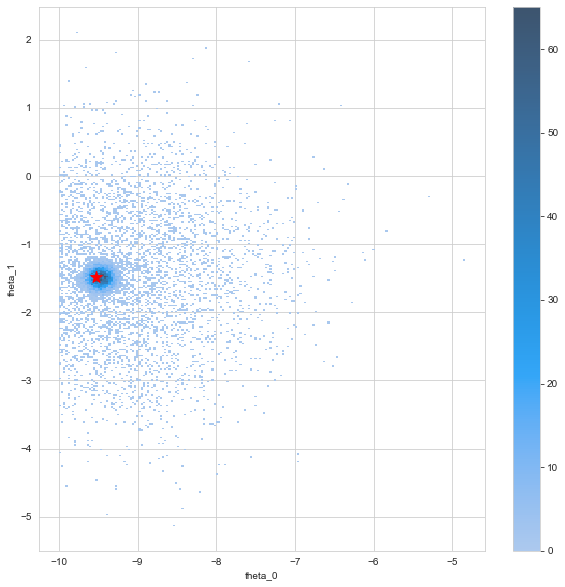

In [24]:
t_post_obs = 1
r_post = task.get_reference_posterior_samples(num_observation=t_post_obs)

plt.figure(figsize=(10, 10))
sns.histplot(data=np_to_pd(r_post, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=True, kde=False)
plt.scatter(x=task.get_true_parameters(num_observation=t_post_obs)[0][0], y=task.get_true_parameters(num_observation=t_post_obs)[0][1], marker='*', color='red', s=150)

###### Check simulated data

Running 100000 simulations.:   0%|          | 0/100000 [00:00<?, ?it/s]

<AxesSubplot:xlabel='x_0', ylabel='x_1'>

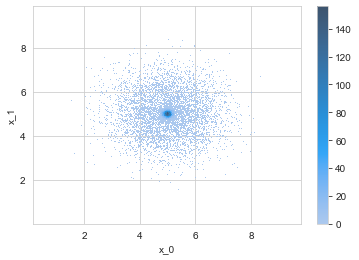

In [11]:
sns.histplot(data=np_to_pd(simulate_in_batches(simulator=simulator, theta=torch.Tensor([[5, 5]]).repeat_interleave(100_000, dim=0)).numpy(), ['x_0', 'x_1']), 
             x='x_0', y='x_1', cbar=True, kde=False)

###### B' simulations

Running 30000 simulations.:   0%|          | 0/30000 [00:00<?, ?it/s]

torch.Size([30000, 2]) torch.Size([30000, 2])


<AxesSubplot:xlabel='x_0', ylabel='x_1'>

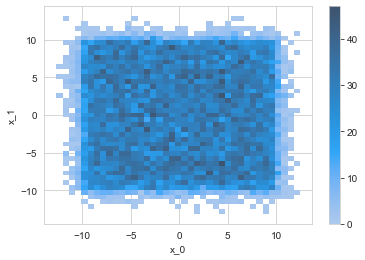

In [10]:
b_prime_theta, b_prime_x = simulate_for_sbi(simulator=simulator, proposal=pdist_qr, num_simulations=B_PRIME)
print(b_prime_theta.shape, b_prime_x.shape, flush=True)
sns.histplot(data=np_to_pd(b_prime_x, ['x_0', 'x_1']), x='x_0', y='x_1', cbar=True)

###### B'' simulations

Running 10000 simulations.:   0%|          | 0/10000 [00:00<?, ?it/s]

torch.Size([10000, 2]) torch.Size([10000, 2])


<AxesSubplot:xlabel='x_0', ylabel='x_1'>

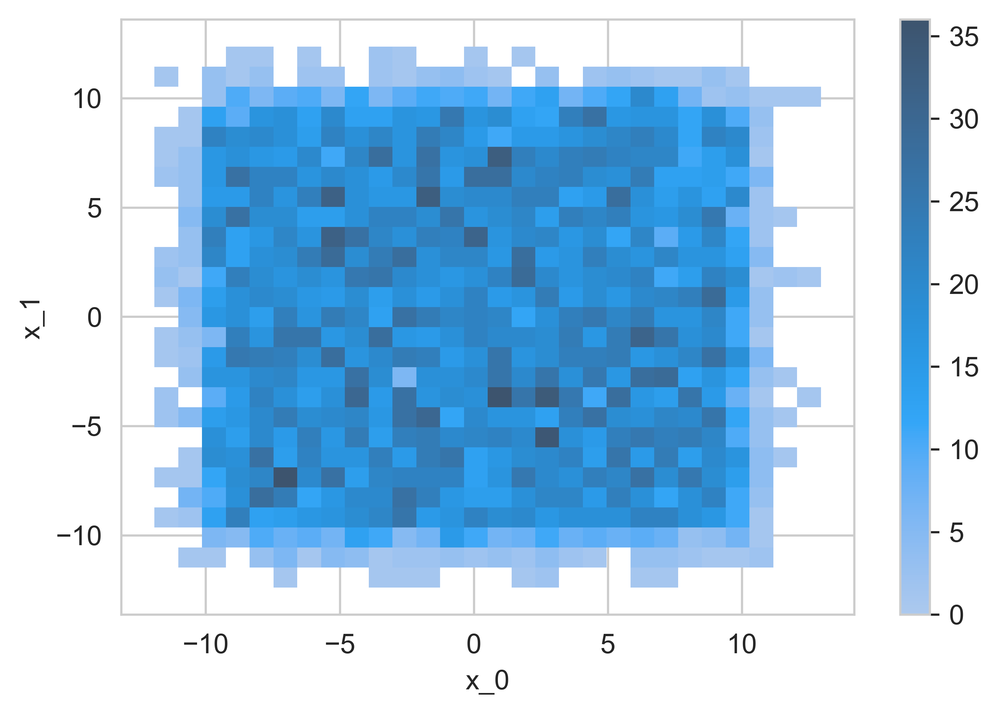

In [145]:
b_double_prime_theta, b_double_prime_x = simulate_for_sbi(simulator=simulator, proposal=pdist_qr, num_simulations=B_DOUBLE_PRIME)
print(b_double_prime_theta.shape, b_double_prime_x.shape, flush=True)
sns.histplot(data=np_to_pd(b_double_prime_x, ['x_0', 'x_1']), x='x_0', y='x_1', cbar=True)

## Train NPE

In [15]:
posterior = infer(simulator=simulator, prior=task.prior_dist, method='SNPE', num_simulations=B)

Running 100000 simulations.:   0%|          | 0/100000 [00:00<?, ?it/s]

Neural network successfully converged after 76 epochs.


Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

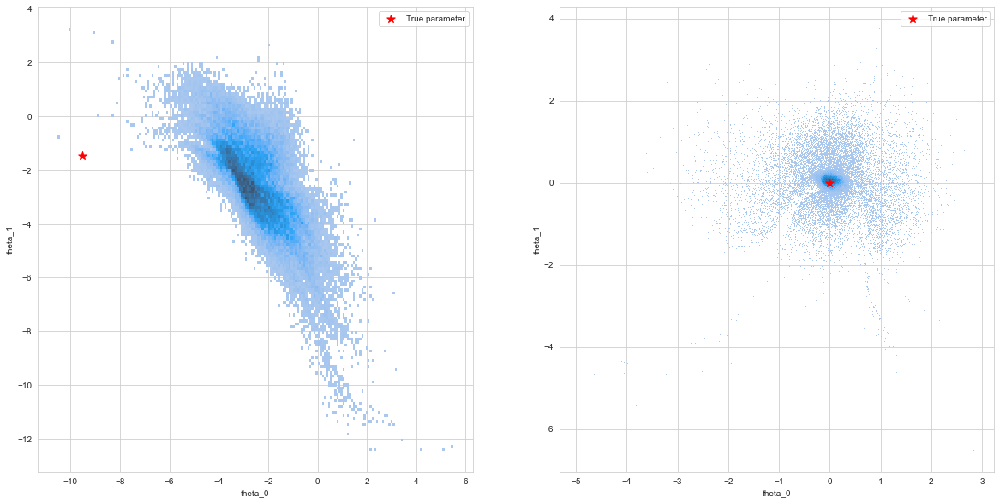

In [12]:
obs_n = 1

posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=original_task.get_observation(num_observation=obs_n))
posterior_samples_obszero = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=simulate_in_batches(simulator=simulator, theta=torch.Tensor([[0, 0]]).repeat_interleave(1, dim=0)).numpy())

fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# sbibm observations
estimated_hist = sns.histplot(data=np_to_pd(posterior_samples_obs, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=False, kde=False, ax=ax[0], stat='density')
estimated_hist.legend(labels=['Estimated Posterior'], loc='upper right')
ax[0].scatter(x=original_task.get_true_parameters(num_observation=obs_n)[0][0], y=original_task.get_true_parameters(num_observation=obs_n)[0][1], marker='*', color='red', s=100, label='True parameter', zorder=2)
ax[0].legend()

# [0, 0]
estimated_hist = sns.histplot(data=np_to_pd(posterior_samples_obszero, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=False, kde=False, ax=ax[1], stat='density')
estimated_hist.legend(labels=['Estimated Posterior'], loc='upper right')
ax[1].scatter(x=torch.Tensor([[0, 0]])[0][0], y=torch.Tensor([[0, 0]])[0][1], marker='*', color='red', s=100, label='True parameter', zorder=2)
ax[1].legend()

plt.show()

In [17]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/posterior_gaussPrior.pickle'), 'wb') as f:
    pickle.dump({'npe': posterior}, f)

In [10]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/posterior_gaussPrior.pickle'), 'rb') as f:
    posterior = pickle.load(f)['npe']

## Quantile Regression

In [18]:
from multiprocessing import Pool

In [ ]:
n_proc = 6
with Pool(processes=n_proc) as pool:
    idxs = np.linspace(0, B_PRIME, n_proc).astype(int)
    r = pool.starmap(func, [(idxs[j], idxs[j+1], posterior, N_SAMPLES_POSTERIOR, b_prime_x) for j in range(len(idxs)-1)])

  0%|          | 0/4000 [00:00<?, ?it/s]


Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:  60%|██████    | 30000/50000 [00:00<00:00, 92360.19it/s]

Drawing 50000 posterior samples: 100%|██████████| 50000/50000 [00:00<00:00, 95208.94it/s]

  0%|          | 1/4000 [00:00<35:07,  1.90it/s]

Drawing 50000 posterior samples:  20%|██        | 10000/50000 [00:00<00:00, 97284.94it/s]

Drawing 50000 posterior samples:  80%|████████  | 40000/50000 [00:00<00:00, 109109.72it/s]

Drawing 50000 posterior samples: 100%|██████████| 50000/50000 [00:00<00:00, 107283.00it/s]

Drawing 50000 posterior samples: 100%|██████████| 50000/50000 [00:00<00:00, 100793.84it/s]

Drawing 50000 posterior samples:  40%|████      | 20000/50000 [00:00<00:00, 110628.54it/s]

Drawing 50000 posterior samples:  40%|████      | 20000/50000 [00:00<00:00, 111205.78it/s]

Drawing 50000 posterior samples: 100%|██████████| 50000/50000 [00:00<00:00, 113713.62it/s]

Drawin

In [ ]:
posterior_means_qr = []
posterior_vars_qr = []
for m, v in r:
    posterior_means_qr += m
    posterior_vars_qr += v
len(posterior_means_qr), len(posterior_vars_qr)

#### Conditional mean/variance

In [13]:
posterior_means_qr = []
posterior_vars_qr = []
for i in tqdm(range(B_PRIME)):
    posterior_samples_qr = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=b_prime_x[i, :])
    posterior_means_qr.append(torch.mean(posterior_samples_qr, dim=0))
    posterior_vars_qr.append(torch.cov(torch.transpose(posterior_samples_qr, 0, 1)))

  0%|                                                                                                                                                            | 0/30000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 1/30000 [00:00<2:03:22,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 2/30000 [00:00<2:04:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 3/30000 [00:00<2:03:53,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 4/30000 [00:00<2:03:31,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 5/30000 [00:01<2:02:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 6/30000 [00:01<2:01:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 7/30000 [00:01<2:07:04,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 8/30000 [00:01<2:04:55,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                  | 9/30000 [00:02<2:03:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 10/30000 [00:02<2:02:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 11/30000 [00:02<2:02:39,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 12/30000 [00:02<2:02:02,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 13/30000 [00:03<2:01:19,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 14/30000 [00:03<2:01:13,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 15/30000 [00:03<2:01:54,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 16/30000 [00:03<2:02:40,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 17/30000 [00:04<2:02:32,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 18/30000 [00:04<2:03:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 19/30000 [00:04<2:03:47,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 20/30000 [00:04<2:03:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 21/30000 [00:05<2:02:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 22/30000 [00:05<2:01:51,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 23/30000 [00:05<2:01:22,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 24/30000 [00:05<2:00:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                 | 25/30000 [00:06<2:00:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 26/30000 [00:06<2:00:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 27/30000 [00:06<1:59:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 28/30000 [00:06<1:59:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 29/30000 [00:07<2:00:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 30/30000 [00:07<1:59:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 31/30000 [00:07<1:59:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 32/30000 [00:07<1:59:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 33/30000 [00:08<1:58:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 34/30000 [00:08<1:59:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 35/30000 [00:08<1:59:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 36/30000 [00:08<1:59:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 37/30000 [00:08<1:59:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 38/30000 [00:09<1:59:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 39/30000 [00:09<1:59:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 40/30000 [00:09<1:59:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 41/30000 [00:09<1:59:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 42/30000 [00:10<1:58:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 43/30000 [00:10<1:58:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 44/30000 [00:10<1:58:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 45/30000 [00:10<1:58:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 46/30000 [00:11<1:59:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 47/30000 [00:11<1:59:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 48/30000 [00:11<1:59:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 49/30000 [00:11<2:01:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 50/30000 [00:12<2:00:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                | 51/30000 [00:12<2:00:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 52/30000 [00:12<1:59:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 53/30000 [00:12<2:00:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 54/30000 [00:13<2:00:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 55/30000 [00:13<2:00:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 56/30000 [00:13<1:59:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 57/30000 [00:13<2:00:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 58/30000 [00:14<2:02:53,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 59/30000 [00:14<2:02:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 60/30000 [00:14<2:01:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 61/30000 [00:14<2:00:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 62/30000 [00:15<2:01:07,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 63/30000 [00:15<2:00:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 64/30000 [00:15<2:00:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 65/30000 [00:15<2:00:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 66/30000 [00:15<2:00:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 67/30000 [00:16<2:00:47,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 68/30000 [00:16<2:00:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 69/30000 [00:16<1:59:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 70/30000 [00:16<1:59:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 71/30000 [00:17<1:59:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 72/30000 [00:17<1:59:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 73/30000 [00:17<1:59:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 74/30000 [00:17<2:04:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 75/30000 [00:18<2:03:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 76/30000 [00:18<2:03:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                | 77/30000 [00:18<2:02:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 78/30000 [00:18<2:01:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 79/30000 [00:19<2:01:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 80/30000 [00:19<2:00:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 81/30000 [00:19<2:00:21,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 82/30000 [00:19<1:59:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 83/30000 [00:20<1:59:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 84/30000 [00:20<1:59:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 85/30000 [00:20<1:58:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 86/30000 [00:20<1:58:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 87/30000 [00:21<1:58:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 88/30000 [00:21<1:58:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 89/30000 [00:21<1:59:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 90/30000 [00:21<1:59:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 91/30000 [00:22<1:59:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 92/30000 [00:22<1:59:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 93/30000 [00:22<1:58:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 94/30000 [00:22<1:58:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 95/30000 [00:22<1:59:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 96/30000 [00:23<1:59:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 97/30000 [00:23<1:59:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 98/30000 [00:23<1:59:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                | 99/30000 [00:23<1:58:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                               | 100/30000 [00:24<1:59:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                               | 101/30000 [00:24<1:59:26,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                               | 102/30000 [00:24<1:59:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                               | 103/30000 [00:24<1:59:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                               | 104/30000 [00:25<2:00:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 105/30000 [00:25<1:59:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 106/30000 [00:25<1:59:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 107/30000 [00:25<1:59:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 108/30000 [00:26<1:59:57,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 109/30000 [00:26<1:59:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 110/30000 [00:26<2:01:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 111/30000 [00:26<2:00:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 112/30000 [00:27<2:00:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 113/30000 [00:27<2:00:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 114/30000 [00:27<2:00:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 115/30000 [00:27<2:00:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 116/30000 [00:28<2:00:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 117/30000 [00:28<2:00:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 118/30000 [00:28<2:00:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 119/30000 [00:28<2:00:30,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 120/30000 [00:28<1:59:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 121/30000 [00:29<1:59:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 122/30000 [00:29<1:59:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 123/30000 [00:29<1:59:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 124/30000 [00:29<1:59:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 125/30000 [00:30<1:59:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 126/30000 [00:30<1:59:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 127/30000 [00:30<1:58:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 128/30000 [00:30<1:58:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 129/30000 [00:31<1:59:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                               | 130/30000 [00:31<1:59:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 131/30000 [00:31<1:59:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 132/30000 [00:31<2:00:01,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 133/30000 [00:32<2:00:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 134/30000 [00:32<2:00:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 135/30000 [00:32<1:59:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 136/30000 [00:32<2:01:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 137/30000 [00:33<2:00:59,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 138/30000 [00:33<2:01:04,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 139/30000 [00:33<2:01:29,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 140/30000 [00:33<2:01:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 141/30000 [00:34<2:00:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 142/30000 [00:34<2:00:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 143/30000 [00:34<1:59:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 144/30000 [00:34<1:59:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 145/30000 [00:35<1:59:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 146/30000 [00:35<1:59:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 147/30000 [00:35<1:59:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 148/30000 [00:35<1:59:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 149/30000 [00:35<2:00:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                               | 150/30000 [00:36<2:02:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 151/30000 [00:36<2:02:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 152/30000 [00:36<2:01:00,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 153/30000 [00:36<2:00:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 154/30000 [00:37<1:59:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 155/30000 [00:37<1:59:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▋                                                                                                                                               | 156/30000 [00:37<1:59:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 157/30000 [00:37<1:59:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 158/30000 [00:38<1:59:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 159/30000 [00:38<1:59:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 160/30000 [00:38<1:59:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 161/30000 [00:38<1:59:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 162/30000 [00:39<1:59:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 163/30000 [00:39<2:04:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 164/30000 [00:39<2:03:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 165/30000 [00:39<2:02:02,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 166/30000 [00:40<2:01:18,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 167/30000 [00:40<2:00:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 168/30000 [00:40<2:00:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 169/30000 [00:40<2:00:59,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 170/30000 [00:41<2:01:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 171/30000 [00:41<2:01:19,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 172/30000 [00:41<2:00:46,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 173/30000 [00:41<2:00:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 174/30000 [00:42<2:00:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 175/30000 [00:42<2:00:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 176/30000 [00:42<2:00:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 177/30000 [00:42<2:00:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 178/30000 [00:43<1:59:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 179/30000 [00:43<1:59:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 180/30000 [00:43<1:59:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 181/30000 [00:43<1:59:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 182/30000 [00:43<1:59:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 183/30000 [00:44<1:59:28,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 184/30000 [00:44<1:58:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 185/30000 [00:44<1:58:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 186/30000 [00:44<1:58:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 187/30000 [00:45<1:59:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 188/30000 [00:45<1:59:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 189/30000 [00:45<1:59:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 190/30000 [00:45<1:59:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 191/30000 [00:46<1:58:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 192/30000 [00:46<1:58:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 193/30000 [00:46<1:59:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 194/30000 [00:46<1:59:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 195/30000 [00:47<1:59:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 196/30000 [00:47<1:59:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 197/30000 [00:47<1:58:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 198/30000 [00:47<1:58:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 199/30000 [00:48<1:58:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 200/30000 [00:48<1:58:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 201/30000 [00:48<1:58:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 202/30000 [00:48<1:58:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 203/30000 [00:48<1:58:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 204/30000 [00:49<1:58:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 205/30000 [00:49<1:58:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 206/30000 [00:49<1:59:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 207/30000 [00:49<1:58:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                               | 208/30000 [00:50<1:58:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 209/30000 [00:50<1:58:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 210/30000 [00:50<1:58:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 211/30000 [00:50<1:58:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 212/30000 [00:51<1:58:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 213/30000 [00:51<1:58:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 214/30000 [00:51<2:00:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 215/30000 [00:51<2:00:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 216/30000 [00:52<2:00:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 217/30000 [00:52<2:00:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 218/30000 [00:52<2:00:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 219/30000 [00:52<2:01:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 220/30000 [00:53<2:01:42,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 221/30000 [00:53<2:00:49,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 222/30000 [00:53<2:00:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 223/30000 [00:53<2:00:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 224/30000 [00:54<1:59:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 225/30000 [00:54<1:58:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 226/30000 [00:54<1:59:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 227/30000 [00:54<1:59:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 228/30000 [00:55<1:58:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 229/30000 [00:55<1:58:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 230/30000 [00:55<1:58:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 231/30000 [00:55<1:58:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 232/30000 [00:55<1:58:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 233/30000 [00:56<1:58:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                               | 234/30000 [00:56<1:59:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 235/30000 [00:56<1:58:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 236/30000 [00:56<1:59:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 237/30000 [00:57<1:59:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 238/30000 [00:57<1:59:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 239/30000 [00:57<1:59:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 240/30000 [00:57<1:59:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 241/30000 [00:58<1:59:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 242/30000 [00:58<1:59:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 243/30000 [00:58<1:59:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 244/30000 [00:58<1:59:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 245/30000 [00:59<1:59:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 246/30000 [00:59<1:59:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 247/30000 [00:59<1:59:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 248/30000 [00:59<1:59:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 249/30000 [01:00<1:59:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 250/30000 [01:00<1:59:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 251/30000 [01:00<1:59:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 252/30000 [01:00<1:59:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 253/30000 [01:01<1:59:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 254/30000 [01:01<1:59:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 255/30000 [01:01<1:59:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 256/30000 [01:01<1:59:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 257/30000 [01:01<1:59:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 258/30000 [01:02<2:00:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 259/30000 [01:02<2:00:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                              | 260/30000 [01:02<2:01:20,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 261/30000 [01:03<2:06:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 262/30000 [01:03<2:09:30,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 263/30000 [01:03<2:06:46,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 264/30000 [01:03<2:04:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 265/30000 [01:04<2:02:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 266/30000 [01:04<2:01:03,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 267/30000 [01:04<1:59:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 268/30000 [01:04<1:59:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 269/30000 [01:04<1:59:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 270/30000 [01:05<2:05:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 271/30000 [01:05<2:05:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 272/30000 [01:05<2:04:11,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 273/30000 [01:05<2:02:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 274/30000 [01:06<2:01:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 275/30000 [01:06<2:00:53,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 276/30000 [01:06<2:00:14,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 277/30000 [01:06<1:59:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 278/30000 [01:07<2:00:11,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 279/30000 [01:07<1:59:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 280/30000 [01:07<1:59:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 281/30000 [01:07<1:58:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 282/30000 [01:08<1:58:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 283/30000 [01:08<1:58:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 284/30000 [01:08<1:58:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 285/30000 [01:08<1:59:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                              | 286/30000 [01:09<1:59:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 287/30000 [01:09<1:59:13,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 288/30000 [01:09<1:58:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 289/30000 [01:09<1:57:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 290/30000 [01:10<2:07:06,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 291/30000 [01:10<2:04:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 292/30000 [01:10<2:02:00,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 293/30000 [01:10<2:00:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 294/30000 [01:11<1:59:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 295/30000 [01:11<1:59:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 296/30000 [01:11<1:59:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 297/30000 [01:11<1:59:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 298/30000 [01:12<2:00:51,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 299/30000 [01:12<2:00:42,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 300/30000 [01:12<2:00:39,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 301/30000 [01:12<2:01:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 302/30000 [01:13<2:02:02,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 303/30000 [01:13<2:03:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 304/30000 [01:13<2:02:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 305/30000 [01:13<2:01:33,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 306/30000 [01:14<2:00:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 307/30000 [01:14<2:00:51,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 308/30000 [01:14<2:00:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 309/30000 [01:14<2:00:46,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 310/30000 [01:14<2:01:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 311/30000 [01:15<2:00:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                              | 312/30000 [01:15<1:59:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 313/30000 [01:15<1:59:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 314/30000 [01:15<2:00:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 315/30000 [01:16<2:00:14,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 316/30000 [01:16<2:00:38,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 317/30000 [01:16<2:00:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 318/30000 [01:16<2:00:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 319/30000 [01:17<2:01:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 320/30000 [01:17<2:01:41,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 321/30000 [01:17<2:00:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 322/30000 [01:17<2:02:15,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 323/30000 [01:18<2:02:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 324/30000 [01:18<2:02:57,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 325/30000 [01:18<2:03:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 326/30000 [01:18<2:02:04,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 327/30000 [01:19<2:00:56,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 328/30000 [01:19<1:59:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 329/30000 [01:19<1:58:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 330/30000 [01:19<1:58:42,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 331/30000 [01:20<1:58:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 332/30000 [01:20<1:58:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 333/30000 [01:20<1:58:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 334/30000 [01:20<1:58:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 335/30000 [01:21<1:58:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 336/30000 [01:21<1:57:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 337/30000 [01:21<1:57:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                              | 338/30000 [01:21<1:57:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 339/30000 [01:22<1:57:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 340/30000 [01:22<1:57:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 341/30000 [01:22<1:58:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 342/30000 [01:22<1:57:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 343/30000 [01:22<1:57:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 344/30000 [01:23<1:58:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 345/30000 [01:23<1:58:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 346/30000 [01:23<2:03:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 347/30000 [01:23<2:01:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 348/30000 [01:24<2:00:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 349/30000 [01:24<1:59:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 350/30000 [01:24<1:58:24,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 351/30000 [01:24<1:58:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 352/30000 [01:25<1:58:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 353/30000 [01:25<1:58:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 354/30000 [01:25<1:57:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 355/30000 [01:25<1:58:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 356/30000 [01:26<2:00:57,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 357/30000 [01:26<1:59:59,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 358/30000 [01:26<1:59:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 359/30000 [01:26<1:58:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 360/30000 [01:27<2:04:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 361/30000 [01:27<2:03:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 362/30000 [01:27<2:00:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 363/30000 [01:27<1:59:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                              | 364/30000 [01:28<1:58:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 365/30000 [01:28<1:57:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 366/30000 [01:28<1:57:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 367/30000 [01:28<1:56:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 368/30000 [01:28<1:56:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 369/30000 [01:29<1:55:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 370/30000 [01:29<1:55:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 371/30000 [01:29<1:55:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 372/30000 [01:29<1:55:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 373/30000 [01:30<1:55:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 374/30000 [01:30<1:55:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 375/30000 [01:30<1:55:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 376/30000 [01:30<1:55:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 377/30000 [01:31<1:56:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 378/30000 [01:31<1:55:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 379/30000 [01:31<1:56:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 380/30000 [01:31<1:56:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 381/30000 [01:32<1:57:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 382/30000 [01:32<1:57:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 383/30000 [01:32<1:56:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 384/30000 [01:32<1:56:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 385/30000 [01:32<1:56:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 386/30000 [01:33<1:57:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 387/30000 [01:33<1:57:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 388/30000 [01:33<1:56:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 389/30000 [01:33<1:56:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                              | 390/30000 [01:34<1:56:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 391/30000 [01:34<1:56:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 392/30000 [01:34<1:56:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 393/30000 [01:34<1:56:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 394/30000 [01:35<1:56:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 395/30000 [01:35<1:56:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 396/30000 [01:35<1:56:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 397/30000 [01:35<1:56:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 398/30000 [01:36<1:57:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 399/30000 [01:36<1:56:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 400/30000 [01:36<1:56:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 401/30000 [01:36<1:56:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 402/30000 [01:37<1:56:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 403/30000 [01:37<1:57:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 404/30000 [01:37<1:57:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 405/30000 [01:37<1:56:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 406/30000 [01:37<1:56:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 407/30000 [01:38<1:57:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 408/30000 [01:38<1:56:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 409/30000 [01:38<1:56:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 410/30000 [01:38<1:56:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 411/30000 [01:39<1:56:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 412/30000 [01:39<1:56:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 413/30000 [01:39<1:56:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 414/30000 [01:39<1:56:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 415/30000 [01:40<1:56:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                              | 416/30000 [01:40<1:56:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 417/30000 [01:40<1:56:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 418/30000 [01:40<1:57:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 419/30000 [01:41<1:57:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 420/30000 [01:41<1:57:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 421/30000 [01:41<1:57:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 422/30000 [01:41<1:57:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 423/30000 [01:41<1:57:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 424/30000 [01:42<1:57:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 425/30000 [01:42<1:57:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 426/30000 [01:42<1:57:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 427/30000 [01:42<1:57:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 428/30000 [01:43<2:02:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 429/30000 [01:43<2:00:48,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 430/30000 [01:43<1:59:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 431/30000 [01:43<1:58:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 432/30000 [01:44<1:57:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 433/30000 [01:44<1:56:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 434/30000 [01:44<1:57:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 435/30000 [01:44<1:56:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 436/30000 [01:45<1:56:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 437/30000 [01:45<1:57:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 438/30000 [01:45<1:57:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 439/30000 [01:45<1:57:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 440/30000 [01:46<1:57:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 441/30000 [01:46<1:57:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                              | 442/30000 [01:46<1:57:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 443/30000 [01:46<1:56:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 444/30000 [01:47<1:56:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 445/30000 [01:47<1:57:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 446/30000 [01:47<1:56:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 447/30000 [01:47<1:56:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 448/30000 [01:47<1:56:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                             | 449/30000 [01:48<1:56:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 450/30000 [01:48<1:56:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 451/30000 [01:48<1:56:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 452/30000 [01:48<1:56:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 453/30000 [01:49<1:56:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 454/30000 [01:49<1:56:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 455/30000 [01:49<1:56:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 456/30000 [01:49<1:56:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 457/30000 [01:50<1:57:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 458/30000 [01:50<1:57:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 459/30000 [01:50<1:57:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 460/30000 [01:50<1:58:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 461/30000 [01:51<2:00:30,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 462/30000 [01:51<1:59:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 463/30000 [01:51<1:59:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 464/30000 [01:51<1:58:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 465/30000 [01:52<1:58:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 466/30000 [01:52<1:58:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 467/30000 [01:52<2:00:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▏                                                                                                                                             | 468/30000 [01:52<2:02:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 469/30000 [01:53<2:02:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 470/30000 [01:53<2:01:31,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 471/30000 [01:53<2:00:40,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 472/30000 [01:53<2:00:16,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 473/30000 [01:54<1:59:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 474/30000 [01:54<1:58:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 475/30000 [01:54<1:58:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 476/30000 [01:54<1:57:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 477/30000 [01:54<1:57:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 478/30000 [01:55<1:57:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 479/30000 [01:55<1:57:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 480/30000 [01:55<1:57:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 481/30000 [01:55<1:57:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 482/30000 [01:56<1:57:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 483/30000 [01:56<1:57:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 484/30000 [01:56<1:57:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 485/30000 [01:56<1:57:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 486/30000 [01:57<1:57:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 487/30000 [01:57<1:56:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 488/30000 [01:57<1:56:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 489/30000 [01:57<1:56:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 490/30000 [01:58<1:56:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 491/30000 [01:58<1:57:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 492/30000 [01:58<1:57:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 493/30000 [01:58<1:58:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▎                                                                                                                                             | 494/30000 [01:59<2:01:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 495/30000 [01:59<2:02:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 496/30000 [01:59<2:01:20,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 497/30000 [01:59<1:59:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 498/30000 [02:00<1:59:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 499/30000 [02:00<1:58:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 500/30000 [02:00<1:58:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 501/30000 [02:00<1:57:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 502/30000 [02:00<1:57:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 503/30000 [02:01<1:58:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 504/30000 [02:01<1:57:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 505/30000 [02:01<1:57:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 506/30000 [02:01<1:57:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 507/30000 [02:02<1:58:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 508/30000 [02:02<1:59:36,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 509/30000 [02:02<2:00:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 510/30000 [02:02<2:01:04,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 511/30000 [02:03<2:01:47,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 512/30000 [02:03<2:02:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 513/30000 [02:03<2:02:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 514/30000 [02:03<2:01:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 515/30000 [02:04<2:00:40,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 516/30000 [02:04<2:01:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 517/30000 [02:04<2:00:37,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 518/30000 [02:04<2:00:43,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 519/30000 [02:05<2:01:27,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▍                                                                                                                                             | 520/30000 [02:05<2:00:22,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 521/30000 [02:05<1:59:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 522/30000 [02:05<1:59:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 523/30000 [02:06<1:58:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 524/30000 [02:06<1:58:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 525/30000 [02:06<1:57:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 526/30000 [02:06<1:58:14,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 527/30000 [02:07<1:58:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 528/30000 [02:07<2:00:39,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 529/30000 [02:07<2:02:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 530/30000 [02:07<2:01:06,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 531/30000 [02:08<2:01:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 532/30000 [02:08<2:01:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 533/30000 [02:08<2:00:35,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 534/30000 [02:08<1:59:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 535/30000 [02:09<2:04:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 536/30000 [02:09<2:02:31,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 537/30000 [02:09<2:00:54,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 538/30000 [02:09<2:00:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 539/30000 [02:10<2:00:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 540/30000 [02:10<1:59:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 541/30000 [02:10<1:59:15,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 542/30000 [02:10<1:59:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 543/30000 [02:10<1:58:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 544/30000 [02:11<2:01:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 545/30000 [02:11<2:00:52,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▌                                                                                                                                             | 546/30000 [02:11<2:00:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 547/30000 [02:11<1:59:53,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 548/30000 [02:12<1:59:49,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 549/30000 [02:12<1:59:37,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 550/30000 [02:12<1:59:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 551/30000 [02:12<1:58:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 552/30000 [02:13<1:59:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 553/30000 [02:13<2:00:03,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 554/30000 [02:13<1:59:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 555/30000 [02:13<1:59:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 556/30000 [02:14<1:58:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 557/30000 [02:14<1:58:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 558/30000 [02:14<1:58:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 559/30000 [02:14<2:02:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 560/30000 [02:15<2:07:20,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 561/30000 [02:15<2:05:11,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 562/30000 [02:15<2:03:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 563/30000 [02:15<2:01:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 564/30000 [02:16<2:00:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 565/30000 [02:16<2:00:33,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 566/30000 [02:16<2:00:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 567/30000 [02:16<1:59:49,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 568/30000 [02:17<1:59:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 569/30000 [02:17<1:58:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 570/30000 [02:17<2:03:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 571/30000 [02:17<2:02:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▋                                                                                                                                             | 572/30000 [02:18<2:01:17,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 573/30000 [02:18<2:00:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 574/30000 [02:18<2:00:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 575/30000 [02:18<1:59:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 576/30000 [02:19<1:59:02,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 577/30000 [02:19<1:58:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 578/30000 [02:19<2:03:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 579/30000 [02:19<2:02:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 580/30000 [02:20<2:01:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 581/30000 [02:20<2:00:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 582/30000 [02:20<1:59:47,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 583/30000 [02:20<1:59:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 584/30000 [02:21<1:59:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 585/30000 [02:21<1:58:35,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 586/30000 [02:21<1:58:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 587/30000 [02:21<1:58:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 588/30000 [02:22<1:58:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 589/30000 [02:22<1:58:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 590/30000 [02:22<1:58:13,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 591/30000 [02:22<1:58:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 592/30000 [02:23<1:58:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 593/30000 [02:23<1:58:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 594/30000 [02:23<1:58:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 595/30000 [02:23<1:58:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 596/30000 [02:23<1:58:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 597/30000 [02:24<1:57:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▊                                                                                                                                             | 598/30000 [02:24<1:57:58,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 599/30000 [02:24<1:57:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 600/30000 [02:24<1:58:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 601/30000 [02:25<1:58:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 602/30000 [02:25<1:57:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 603/30000 [02:25<1:57:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 604/30000 [02:25<1:57:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 605/30000 [02:26<1:58:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 606/30000 [02:26<1:57:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 607/30000 [02:26<1:57:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 608/30000 [02:26<1:58:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 609/30000 [02:27<1:57:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 610/30000 [02:27<1:58:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 611/30000 [02:27<1:57:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 612/30000 [02:27<1:57:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 613/30000 [02:28<1:58:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 614/30000 [02:28<1:58:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 615/30000 [02:28<1:58:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 616/30000 [02:28<1:57:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 617/30000 [02:29<1:57:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 618/30000 [02:29<1:58:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 619/30000 [02:29<1:58:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 620/30000 [02:29<1:58:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 621/30000 [02:29<1:58:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 622/30000 [02:30<1:58:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 623/30000 [02:30<1:57:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                             | 624/30000 [02:30<1:57:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 625/30000 [02:30<1:58:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 626/30000 [02:31<1:58:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 627/30000 [02:31<1:58:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 628/30000 [02:31<1:58:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 629/30000 [02:31<1:58:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 630/30000 [02:32<1:58:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 631/30000 [02:32<1:58:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 632/30000 [02:32<1:58:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 633/30000 [02:32<1:58:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 634/30000 [02:33<1:58:21,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 635/30000 [02:33<1:58:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 636/30000 [02:33<1:58:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 637/30000 [02:33<1:58:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 638/30000 [02:34<1:58:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 639/30000 [02:34<1:59:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 640/30000 [02:34<1:58:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 641/30000 [02:34<1:58:33,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 642/30000 [02:35<1:57:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 643/30000 [02:35<1:57:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 644/30000 [02:35<1:57:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 645/30000 [02:35<1:57:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 646/30000 [02:36<1:58:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 647/30000 [02:36<1:58:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 648/30000 [02:36<1:58:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 649/30000 [02:36<1:58:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 650/30000 [02:36<1:57:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                             | 651/30000 [02:37<1:58:22,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 652/30000 [02:37<1:58:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 653/30000 [02:37<1:58:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 654/30000 [02:38<2:03:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 655/30000 [02:38<2:02:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 656/30000 [02:38<2:01:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 657/30000 [02:38<2:00:20,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 658/30000 [02:38<1:59:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 659/30000 [02:39<1:59:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 660/30000 [02:39<1:59:09,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 661/30000 [02:39<1:58:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 662/30000 [02:39<1:58:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 663/30000 [02:40<1:58:15,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 664/30000 [02:40<1:57:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 665/30000 [02:40<1:58:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 666/30000 [02:40<1:57:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 667/30000 [02:41<1:57:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 668/30000 [02:41<1:57:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 669/30000 [02:41<1:57:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 670/30000 [02:41<1:57:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 671/30000 [02:42<1:58:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 672/30000 [02:42<1:57:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 673/30000 [02:42<1:58:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 674/30000 [02:42<1:58:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 675/30000 [02:43<1:58:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 676/30000 [02:43<1:58:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                            | 677/30000 [02:43<1:58:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 678/30000 [02:43<1:58:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 679/30000 [02:44<1:58:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 680/30000 [02:44<1:57:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 681/30000 [02:44<1:58:15,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 682/30000 [02:44<1:58:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 683/30000 [02:45<1:58:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 684/30000 [02:45<1:57:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 685/30000 [02:45<1:57:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 686/30000 [02:45<1:57:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 687/30000 [02:45<1:57:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 688/30000 [02:46<1:58:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 689/30000 [02:46<1:58:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 690/30000 [02:46<1:58:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 691/30000 [02:46<1:58:11,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 692/30000 [02:47<1:58:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 693/30000 [02:47<1:58:01,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 694/30000 [02:47<1:58:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 695/30000 [02:47<1:58:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 696/30000 [02:48<1:58:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 697/30000 [02:48<1:58:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 698/30000 [02:48<1:57:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 699/30000 [02:48<1:57:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 700/30000 [02:49<1:57:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 701/30000 [02:49<1:57:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 702/30000 [02:49<1:57:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                            | 703/30000 [02:49<1:57:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 704/30000 [02:50<1:57:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 705/30000 [02:50<1:57:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 706/30000 [02:50<1:58:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 707/30000 [02:50<2:00:09,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 708/30000 [02:51<1:59:40,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 709/30000 [02:51<1:59:21,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 710/30000 [02:51<1:59:20,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 711/30000 [02:51<1:58:34,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 712/30000 [02:52<1:59:00,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 713/30000 [02:52<1:59:03,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 714/30000 [02:52<1:58:12,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 715/30000 [02:52<1:58:12,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 716/30000 [02:53<2:00:38,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 717/30000 [02:53<1:59:55,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 718/30000 [02:53<1:59:37,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 719/30000 [02:53<1:59:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 720/30000 [02:53<1:58:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 721/30000 [02:54<1:58:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 722/30000 [02:54<1:58:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 723/30000 [02:54<1:57:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 724/30000 [02:54<1:58:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 725/30000 [02:55<1:57:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 726/30000 [02:55<1:58:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 727/30000 [02:55<1:59:55,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 728/30000 [02:55<1:59:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                            | 729/30000 [02:56<1:59:59,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 730/30000 [02:56<1:59:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 731/30000 [02:56<1:58:19,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 732/30000 [02:56<1:57:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 733/30000 [02:57<2:00:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 734/30000 [02:57<2:00:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 735/30000 [02:57<1:59:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 736/30000 [02:57<1:58:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 737/30000 [02:58<1:57:56,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 738/30000 [02:58<1:57:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 739/30000 [02:58<1:58:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 740/30000 [02:58<1:57:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 741/30000 [02:59<1:57:48,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 742/30000 [02:59<1:57:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 743/30000 [02:59<1:57:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 744/30000 [02:59<1:57:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 745/30000 [03:00<1:57:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 746/30000 [03:00<1:57:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 747/30000 [03:00<1:57:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 748/30000 [03:00<1:56:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 749/30000 [03:01<1:56:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                            | 750/30000 [03:01<1:56:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▌                                                                                                                                            | 751/30000 [03:01<1:55:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▌                                                                                                                                            | 752/30000 [03:01<1:55:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▌                                                                                                                                            | 753/30000 [03:01<1:55:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▌                                                                                                                                            | 754/30000 [03:02<1:55:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▌                                                                                                                                            | 755/30000 [03:02<1:55:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 756/30000 [03:02<1:54:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 757/30000 [03:02<1:54:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 758/30000 [03:03<1:55:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 759/30000 [03:03<1:55:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 760/30000 [03:03<1:55:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 761/30000 [03:03<1:55:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 762/30000 [03:04<1:55:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 763/30000 [03:04<1:55:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 764/30000 [03:04<1:55:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 765/30000 [03:04<1:55:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 766/30000 [03:05<1:55:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 767/30000 [03:05<1:55:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 768/30000 [03:05<1:56:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 769/30000 [03:05<1:56:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 770/30000 [03:05<1:55:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 771/30000 [03:06<1:56:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 772/30000 [03:06<1:56:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 773/30000 [03:06<1:56:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 774/30000 [03:06<1:55:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 775/30000 [03:07<2:02:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 776/30000 [03:07<2:00:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 777/30000 [03:07<2:00:25,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 778/30000 [03:07<2:02:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 779/30000 [03:08<2:02:08,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 780/30000 [03:08<2:01:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▋                                                                                                                                            | 781/30000 [03:08<2:00:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 782/30000 [03:08<1:59:35,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 783/30000 [03:09<1:58:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 784/30000 [03:09<1:58:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 785/30000 [03:09<1:58:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 786/30000 [03:09<1:57:19,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 787/30000 [03:10<2:00:45,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 788/30000 [03:10<2:00:24,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 789/30000 [03:10<2:05:12,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 790/30000 [03:10<2:03:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 791/30000 [03:11<2:01:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 792/30000 [03:11<2:00:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 793/30000 [03:11<2:13:18,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 794/30000 [03:12<2:08:30,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 795/30000 [03:12<2:04:37,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 796/30000 [03:12<2:03:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 797/30000 [03:12<2:01:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 798/30000 [03:12<2:00:11,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 799/30000 [03:13<2:00:00,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 800/30000 [03:13<2:00:09,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 801/30000 [03:13<1:59:14,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 802/30000 [03:13<2:00:53,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 803/30000 [03:14<1:59:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 804/30000 [03:14<1:58:16,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 805/30000 [03:14<2:00:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 806/30000 [03:14<2:02:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▊                                                                                                                                            | 807/30000 [03:15<2:01:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 808/30000 [03:15<2:00:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 809/30000 [03:15<1:59:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 810/30000 [03:15<1:59:25,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 811/30000 [03:16<1:59:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 812/30000 [03:16<2:01:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 813/30000 [03:16<2:04:19,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 814/30000 [03:16<2:03:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 815/30000 [03:17<2:01:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 816/30000 [03:17<1:59:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 817/30000 [03:17<1:58:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 818/30000 [03:17<1:57:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 819/30000 [03:18<1:57:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 820/30000 [03:18<1:56:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 821/30000 [03:18<1:56:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 822/30000 [03:18<1:56:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 823/30000 [03:19<1:56:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 824/30000 [03:19<1:56:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 825/30000 [03:19<1:56:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 826/30000 [03:19<1:56:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 827/30000 [03:20<1:56:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 828/30000 [03:20<1:56:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 829/30000 [03:20<1:56:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 830/30000 [03:20<1:56:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 831/30000 [03:21<1:55:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 832/30000 [03:21<1:55:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|███▉                                                                                                                                            | 833/30000 [03:21<1:55:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 834/30000 [03:21<1:55:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 835/30000 [03:21<1:55:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 836/30000 [03:22<1:56:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 837/30000 [03:22<1:56:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 838/30000 [03:22<1:56:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 839/30000 [03:22<1:56:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 840/30000 [03:23<1:56:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 841/30000 [03:23<1:57:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 842/30000 [03:23<1:57:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 843/30000 [03:23<1:56:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 844/30000 [03:24<1:57:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 845/30000 [03:24<1:56:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 846/30000 [03:24<1:56:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 847/30000 [03:24<1:56:27,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 848/30000 [03:25<1:55:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 849/30000 [03:25<1:55:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 850/30000 [03:25<1:55:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 851/30000 [03:25<1:55:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 852/30000 [03:26<1:55:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 853/30000 [03:26<1:55:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 854/30000 [03:26<1:55:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 855/30000 [03:26<1:56:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 856/30000 [03:26<1:55:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 857/30000 [03:27<1:55:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 858/30000 [03:27<1:55:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████                                                                                                                                            | 859/30000 [03:27<1:55:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 860/30000 [03:27<1:55:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 861/30000 [03:28<1:55:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 862/30000 [03:28<1:55:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 863/30000 [03:28<1:55:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 864/30000 [03:28<1:55:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 865/30000 [03:29<1:55:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 866/30000 [03:29<1:55:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 867/30000 [03:29<1:55:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 868/30000 [03:29<1:55:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 869/30000 [03:30<1:55:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 870/30000 [03:30<1:56:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 871/30000 [03:30<1:56:24,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 872/30000 [03:30<1:56:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 873/30000 [03:31<1:56:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 874/30000 [03:31<1:55:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 875/30000 [03:31<1:55:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 876/30000 [03:31<1:55:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 877/30000 [03:32<1:55:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 878/30000 [03:32<1:55:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 879/30000 [03:32<1:55:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 880/30000 [03:32<1:56:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 881/30000 [03:32<1:56:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 882/30000 [03:33<1:56:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 883/30000 [03:33<1:56:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 884/30000 [03:33<1:56:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▏                                                                                                                                           | 885/30000 [03:33<1:56:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 886/30000 [03:34<1:56:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 887/30000 [03:34<1:56:26,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 888/30000 [03:34<1:56:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 889/30000 [03:34<1:56:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 890/30000 [03:35<1:56:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 891/30000 [03:35<1:55:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 892/30000 [03:35<1:55:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 893/30000 [03:35<1:55:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 894/30000 [03:36<1:56:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 895/30000 [03:36<1:56:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 896/30000 [03:36<1:56:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 897/30000 [03:36<1:56:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 898/30000 [03:37<1:56:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 899/30000 [03:37<1:56:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 900/30000 [03:37<1:56:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 901/30000 [03:37<1:55:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 902/30000 [03:37<1:55:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 903/30000 [03:38<1:55:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 904/30000 [03:38<1:54:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 905/30000 [03:38<1:55:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 906/30000 [03:38<1:55:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 907/30000 [03:39<1:55:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 908/30000 [03:39<1:55:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 909/30000 [03:39<1:56:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 910/30000 [03:39<1:56:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▎                                                                                                                                           | 911/30000 [03:40<1:56:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 912/30000 [03:40<1:56:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 913/30000 [03:40<1:55:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 914/30000 [03:40<1:56:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 915/30000 [03:41<1:56:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 916/30000 [03:41<1:56:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 917/30000 [03:41<1:56:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 918/30000 [03:41<1:56:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 919/30000 [03:42<1:56:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 920/30000 [03:42<1:56:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 921/30000 [03:42<1:56:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 922/30000 [03:42<1:56:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 923/30000 [03:43<1:55:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 924/30000 [03:43<2:01:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 925/30000 [03:43<2:01:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 926/30000 [03:43<1:59:43,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 927/30000 [03:44<1:58:55,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 928/30000 [03:44<1:57:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 929/30000 [03:44<1:57:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 930/30000 [03:44<1:57:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 931/30000 [03:44<1:56:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 932/30000 [03:45<1:56:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 933/30000 [03:45<1:56:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 934/30000 [03:45<1:56:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 935/30000 [03:45<1:55:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 936/30000 [03:46<1:55:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▍                                                                                                                                           | 937/30000 [03:46<1:55:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 938/30000 [03:46<1:56:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 939/30000 [03:46<1:55:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 940/30000 [03:47<1:55:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 941/30000 [03:47<1:56:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 942/30000 [03:47<1:56:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 943/30000 [03:47<1:55:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 944/30000 [03:48<1:55:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 945/30000 [03:48<1:55:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 946/30000 [03:48<1:55:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 947/30000 [03:48<1:54:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 948/30000 [03:49<1:54:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 949/30000 [03:49<1:55:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 950/30000 [03:49<1:55:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 951/30000 [03:49<1:54:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 952/30000 [03:49<1:55:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 953/30000 [03:50<1:55:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 954/30000 [03:50<1:54:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 955/30000 [03:50<1:54:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 956/30000 [03:50<1:54:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 957/30000 [03:51<1:55:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 958/30000 [03:51<1:55:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 959/30000 [03:51<1:55:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 960/30000 [03:51<1:54:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 961/30000 [03:52<1:56:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 962/30000 [03:52<1:56:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▌                                                                                                                                           | 963/30000 [03:52<1:56:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 964/30000 [03:52<1:56:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 965/30000 [03:53<1:56:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 966/30000 [03:53<1:57:34,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 967/30000 [03:53<2:01:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 968/30000 [03:53<2:04:28,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 969/30000 [03:54<2:04:43,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 970/30000 [03:54<2:03:23,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 971/30000 [03:54<2:02:48,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 972/30000 [03:54<2:01:07,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 973/30000 [03:55<2:00:01,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 974/30000 [03:55<1:59:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 975/30000 [03:55<1:58:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 976/30000 [03:55<1:57:51,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 977/30000 [03:56<1:57:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 978/30000 [03:56<1:58:20,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 979/30000 [03:56<1:58:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 980/30000 [03:56<1:57:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 981/30000 [03:57<1:57:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 982/30000 [03:57<1:56:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 983/30000 [03:57<1:56:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 984/30000 [03:57<1:57:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 985/30000 [03:58<1:57:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 986/30000 [03:58<1:56:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 987/30000 [03:58<1:56:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 988/30000 [03:58<1:56:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▋                                                                                                                                           | 989/30000 [03:58<1:55:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 990/30000 [03:59<1:55:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 991/30000 [03:59<1:56:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 992/30000 [03:59<1:57:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 993/30000 [03:59<1:56:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 994/30000 [04:00<1:56:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 995/30000 [04:00<1:55:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 996/30000 [04:00<1:55:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 997/30000 [04:00<1:56:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 998/30000 [04:01<2:02:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                           | 999/30000 [04:01<2:05:10,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1000/30000 [04:01<2:05:30,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1001/30000 [04:01<2:05:22,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1002/30000 [04:02<2:05:37,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1003/30000 [04:02<2:03:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1004/30000 [04:02<2:01:55,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1005/30000 [04:02<2:01:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1006/30000 [04:03<2:00:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1007/30000 [04:03<1:58:42,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1008/30000 [04:03<1:57:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1009/30000 [04:03<1:56:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1010/30000 [04:04<1:56:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1011/30000 [04:04<1:56:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1012/30000 [04:04<1:56:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1013/30000 [04:04<1:56:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1014/30000 [04:05<1:55:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1015/30000 [04:05<1:55:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1016/30000 [04:05<1:55:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1017/30000 [04:05<1:55:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1018/30000 [04:06<1:55:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1019/30000 [04:06<1:54:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1020/30000 [04:06<1:55:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1021/30000 [04:06<1:55:42,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                          | 1022/30000 [04:07<1:54:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1023/30000 [04:07<1:55:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1024/30000 [04:07<2:03:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1025/30000 [04:07<2:04:39,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1026/30000 [04:08<2:03:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1027/30000 [04:08<2:02:27,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1028/30000 [04:08<2:00:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1029/30000 [04:08<1:58:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1030/30000 [04:09<1:57:30,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1031/30000 [04:09<1:56:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1032/30000 [04:09<1:56:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1033/30000 [04:09<1:56:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1034/30000 [04:10<1:55:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1035/30000 [04:10<1:55:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1036/30000 [04:10<1:55:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1037/30000 [04:10<1:55:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1038/30000 [04:10<1:54:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1039/30000 [04:11<1:55:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1040/30000 [04:11<1:55:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1041/30000 [04:11<1:55:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1042/30000 [04:11<1:55:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1043/30000 [04:12<1:55:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1044/30000 [04:12<1:55:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1045/30000 [04:12<1:55:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1046/30000 [04:12<1:55:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1047/30000 [04:13<1:55:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                          | 1048/30000 [04:13<1:55:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                          | 1049/30000 [04:13<1:55:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1050/30000 [04:13<1:55:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1051/30000 [04:14<1:55:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1052/30000 [04:14<1:55:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1053/30000 [04:14<1:56:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1054/30000 [04:14<1:55:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1055/30000 [04:15<1:55:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1056/30000 [04:15<1:55:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1057/30000 [04:15<1:54:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1058/30000 [04:15<1:55:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1059/30000 [04:16<1:55:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1060/30000 [04:16<1:54:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1061/30000 [04:16<1:55:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1062/30000 [04:16<1:55:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1063/30000 [04:16<1:55:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1064/30000 [04:17<1:55:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1065/30000 [04:17<1:55:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1066/30000 [04:17<1:54:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1067/30000 [04:17<1:54:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1068/30000 [04:18<1:55:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1069/30000 [04:18<1:54:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1070/30000 [04:18<1:55:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1071/30000 [04:18<1:54:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1072/30000 [04:19<1:54:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1073/30000 [04:19<1:55:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1074/30000 [04:19<1:55:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████                                                                                                                                          | 1075/30000 [04:19<1:55:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1076/30000 [04:20<1:55:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1077/30000 [04:20<1:55:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1078/30000 [04:20<1:54:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1079/30000 [04:20<1:54:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1080/30000 [04:21<1:54:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1081/30000 [04:21<1:54:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1082/30000 [04:21<1:55:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1083/30000 [04:21<1:54:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1084/30000 [04:21<1:54:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1085/30000 [04:22<1:54:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1086/30000 [04:22<1:54:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1087/30000 [04:22<1:54:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1088/30000 [04:22<1:54:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1089/30000 [04:23<1:54:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1090/30000 [04:23<1:54:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1091/30000 [04:23<1:54:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1092/30000 [04:23<1:54:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1093/30000 [04:24<1:54:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1094/30000 [04:24<1:55:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1095/30000 [04:24<1:55:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1096/30000 [04:24<1:54:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1097/30000 [04:25<1:54:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1098/30000 [04:25<1:54:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1099/30000 [04:25<1:55:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1100/30000 [04:25<1:55:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▏                                                                                                                                         | 1101/30000 [04:26<1:54:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1102/30000 [04:26<1:54:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1103/30000 [04:26<1:54:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1104/30000 [04:26<1:54:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1105/30000 [04:26<1:54:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1106/30000 [04:27<1:54:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1107/30000 [04:27<1:59:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1108/30000 [04:27<1:58:26,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1109/30000 [04:27<1:57:18,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1110/30000 [04:28<1:56:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1111/30000 [04:28<1:56:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1112/30000 [04:28<1:55:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1113/30000 [04:28<1:55:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1114/30000 [04:29<1:54:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1115/30000 [04:29<1:54:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1116/30000 [04:29<1:54:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1117/30000 [04:29<1:54:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1118/30000 [04:30<1:54:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1119/30000 [04:30<1:54:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1120/30000 [04:30<1:55:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1121/30000 [04:30<1:56:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1122/30000 [04:31<1:55:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1123/30000 [04:31<1:55:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1124/30000 [04:31<1:57:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1125/30000 [04:31<1:58:36,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1126/30000 [04:32<1:59:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▎                                                                                                                                         | 1127/30000 [04:32<1:58:33,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1128/30000 [04:32<1:57:22,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1129/30000 [04:32<1:56:46,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1130/30000 [04:33<1:56:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1131/30000 [04:33<1:55:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1132/30000 [04:33<1:55:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1133/30000 [04:33<1:55:26,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1134/30000 [04:33<1:55:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1135/30000 [04:34<1:55:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1136/30000 [04:34<1:55:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1137/30000 [04:34<1:55:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1138/30000 [04:34<1:54:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1139/30000 [04:35<1:54:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1140/30000 [04:35<1:55:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1141/30000 [04:35<1:54:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1142/30000 [04:35<1:54:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1143/30000 [04:36<1:54:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1144/30000 [04:36<1:55:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1145/30000 [04:36<1:54:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1146/30000 [04:36<1:54:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1147/30000 [04:37<1:54:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1148/30000 [04:37<1:54:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1149/30000 [04:37<1:54:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1150/30000 [04:37<1:54:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1151/30000 [04:38<1:54:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1152/30000 [04:38<1:54:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▍                                                                                                                                         | 1153/30000 [04:38<1:54:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1154/30000 [04:38<1:54:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1155/30000 [04:38<1:54:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1156/30000 [04:39<1:54:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1157/30000 [04:39<1:54:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1158/30000 [04:39<1:54:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1159/30000 [04:39<1:54:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1160/30000 [04:40<1:54:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1161/30000 [04:40<1:54:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1162/30000 [04:40<1:54:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1163/30000 [04:40<1:54:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1164/30000 [04:41<1:54:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1165/30000 [04:41<1:54:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1166/30000 [04:41<1:54:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1167/30000 [04:41<1:54:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1168/30000 [04:42<1:54:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1169/30000 [04:42<1:54:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1170/30000 [04:42<1:54:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1171/30000 [04:42<1:54:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1172/30000 [04:43<1:54:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1173/30000 [04:43<1:55:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1174/30000 [04:43<1:55:19,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1175/30000 [04:43<2:01:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1176/30000 [04:44<1:59:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1177/30000 [04:44<2:03:39,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1178/30000 [04:44<2:03:07,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1179/30000 [04:44<2:01:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▌                                                                                                                                         | 1180/30000 [04:45<1:59:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1181/30000 [04:45<1:57:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1182/30000 [04:45<1:56:47,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1183/30000 [04:45<1:56:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1184/30000 [04:46<1:55:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1185/30000 [04:46<1:55:37,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1186/30000 [04:46<1:55:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1187/30000 [04:46<1:55:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1188/30000 [04:46<1:55:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1189/30000 [04:47<1:57:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1190/30000 [04:47<1:57:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1191/30000 [04:47<1:57:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1192/30000 [04:47<1:56:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1193/30000 [04:48<1:56:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1194/30000 [04:48<1:55:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1195/30000 [04:48<1:55:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1196/30000 [04:48<1:55:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1197/30000 [04:49<1:55:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1198/30000 [04:49<1:55:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1199/30000 [04:49<1:55:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1200/30000 [04:49<1:57:31,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1201/30000 [04:50<1:58:23,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1202/30000 [04:50<1:58:52,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1203/30000 [04:50<1:59:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1204/30000 [04:50<1:58:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1205/30000 [04:51<1:59:07,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▋                                                                                                                                         | 1206/30000 [04:51<1:57:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1207/30000 [04:51<1:56:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1208/30000 [04:51<1:57:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1209/30000 [04:52<1:56:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1210/30000 [04:52<1:57:40,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1211/30000 [04:52<1:58:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1212/30000 [04:52<1:58:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1213/30000 [04:53<1:58:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1214/30000 [04:53<1:57:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1215/30000 [04:53<1:56:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1216/30000 [04:53<1:55:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1217/30000 [04:54<1:55:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1218/30000 [04:54<1:54:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1219/30000 [04:54<1:54:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1220/30000 [04:54<1:54:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1221/30000 [04:54<1:54:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1222/30000 [04:55<1:53:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1223/30000 [04:55<1:53:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1224/30000 [04:55<1:53:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1225/30000 [04:55<1:53:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1226/30000 [04:56<1:53:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1227/30000 [04:56<1:53:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1228/30000 [04:56<1:53:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1229/30000 [04:56<1:54:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1230/30000 [04:57<1:54:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1231/30000 [04:57<1:53:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▊                                                                                                                                         | 1232/30000 [04:57<1:53:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1233/30000 [04:57<1:53:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1234/30000 [04:58<1:53:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1235/30000 [04:58<1:53:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1236/30000 [04:58<1:55:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1237/30000 [04:58<1:54:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1238/30000 [04:59<1:54:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1239/30000 [04:59<1:53:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1240/30000 [04:59<1:53:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1241/30000 [04:59<1:53:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1242/30000 [04:59<1:53:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1243/30000 [05:00<1:53:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1244/30000 [05:00<1:53:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1245/30000 [05:00<1:53:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1246/30000 [05:00<1:53:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1247/30000 [05:01<1:53:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1248/30000 [05:01<1:54:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1249/30000 [05:01<1:54:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1250/30000 [05:01<1:53:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1251/30000 [05:02<1:53:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1252/30000 [05:02<1:53:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1253/30000 [05:02<1:53:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1254/30000 [05:02<1:53:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1255/30000 [05:03<1:53:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1256/30000 [05:03<1:53:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1257/30000 [05:03<1:53:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|█████▉                                                                                                                                         | 1258/30000 [05:03<1:53:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1259/30000 [05:04<1:53:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1260/30000 [05:04<1:53:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1261/30000 [05:04<2:00:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1262/30000 [05:04<1:58:16,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1263/30000 [05:05<1:56:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1264/30000 [05:05<1:55:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1265/30000 [05:05<1:54:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1266/30000 [05:05<1:54:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1267/30000 [05:05<1:54:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1268/30000 [05:06<1:53:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1269/30000 [05:06<1:53:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1270/30000 [05:06<1:53:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1271/30000 [05:06<1:52:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1272/30000 [05:07<1:52:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1273/30000 [05:07<1:53:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1274/30000 [05:07<1:53:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1275/30000 [05:07<1:53:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1276/30000 [05:08<1:53:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1277/30000 [05:08<1:53:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1278/30000 [05:08<1:53:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1279/30000 [05:08<1:53:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1280/30000 [05:09<1:53:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1281/30000 [05:09<1:53:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1282/30000 [05:09<1:53:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1283/30000 [05:09<1:52:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████                                                                                                                                         | 1284/30000 [05:09<1:53:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1285/30000 [05:10<1:53:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1286/30000 [05:10<2:04:11,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1287/30000 [05:10<2:02:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1288/30000 [05:10<1:59:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1289/30000 [05:11<1:57:40,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1290/30000 [05:11<1:56:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1291/30000 [05:11<1:55:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1292/30000 [05:11<1:54:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1293/30000 [05:12<1:54:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1294/30000 [05:12<1:54:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1295/30000 [05:12<1:54:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1296/30000 [05:12<1:54:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1297/30000 [05:13<1:54:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1298/30000 [05:13<1:54:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1299/30000 [05:13<1:53:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1300/30000 [05:13<1:54:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1301/30000 [05:14<1:55:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1302/30000 [05:14<1:55:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1303/30000 [05:14<1:55:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1304/30000 [05:14<1:54:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1305/30000 [05:15<1:54:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1306/30000 [05:15<1:53:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1307/30000 [05:15<1:53:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1308/30000 [05:15<1:53:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1309/30000 [05:16<1:53:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1310/30000 [05:16<1:53:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▏                                                                                                                                        | 1311/30000 [05:16<1:53:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1312/30000 [05:16<1:54:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1313/30000 [05:16<1:55:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1314/30000 [05:17<1:55:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1315/30000 [05:17<1:55:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1316/30000 [05:17<1:54:43,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1317/30000 [05:17<1:54:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1318/30000 [05:18<1:53:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1319/30000 [05:18<1:53:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1320/30000 [05:18<1:53:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1321/30000 [05:18<1:53:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1322/30000 [05:19<1:53:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1323/30000 [05:19<1:53:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1324/30000 [05:19<1:52:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1325/30000 [05:19<1:53:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1326/30000 [05:20<1:52:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1327/30000 [05:20<1:52:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1328/30000 [05:20<1:53:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1329/30000 [05:20<1:52:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1330/30000 [05:20<1:52:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1331/30000 [05:21<1:52:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1332/30000 [05:21<1:52:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1333/30000 [05:21<1:52:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1334/30000 [05:21<1:53:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1335/30000 [05:22<1:53:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1336/30000 [05:22<1:52:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▎                                                                                                                                        | 1337/30000 [05:22<1:54:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1338/30000 [05:22<1:53:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1339/30000 [05:23<1:53:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1340/30000 [05:23<1:53:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1341/30000 [05:23<1:53:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1342/30000 [05:23<1:53:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1343/30000 [05:24<1:52:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1344/30000 [05:24<1:52:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1345/30000 [05:24<1:53:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1346/30000 [05:24<1:53:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1347/30000 [05:25<1:53:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1348/30000 [05:25<1:53:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1349/30000 [05:25<1:53:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▍                                                                                                                                        | 1350/30000 [05:25<1:53:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1351/30000 [05:25<1:53:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1352/30000 [05:26<1:53:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1353/30000 [05:26<1:53:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1354/30000 [05:26<1:57:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1355/30000 [05:26<1:57:54,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1356/30000 [05:27<1:56:57,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1357/30000 [05:27<1:59:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1358/30000 [05:27<1:59:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1359/30000 [05:27<1:57:11,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1360/30000 [05:28<1:55:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1361/30000 [05:28<1:54:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1362/30000 [05:28<1:54:58,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▍                                                                                                                                        | 1363/30000 [05:28<1:54:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1364/30000 [05:29<1:53:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1365/30000 [05:29<1:53:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1366/30000 [05:29<1:53:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1367/30000 [05:29<1:53:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1368/30000 [05:30<1:53:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1369/30000 [05:30<1:52:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1370/30000 [05:30<1:53:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1371/30000 [05:30<1:53:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1372/30000 [05:31<1:53:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1373/30000 [05:31<1:53:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1374/30000 [05:31<1:53:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1375/30000 [05:31<1:53:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1376/30000 [05:31<1:53:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1377/30000 [05:32<1:52:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1378/30000 [05:32<1:53:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1379/30000 [05:32<1:53:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1380/30000 [05:32<1:53:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1381/30000 [05:33<1:52:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1382/30000 [05:33<1:53:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1383/30000 [05:33<1:53:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1384/30000 [05:33<1:53:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1385/30000 [05:34<1:53:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1386/30000 [05:34<1:53:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1387/30000 [05:34<1:53:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1388/30000 [05:34<1:53:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▌                                                                                                                                        | 1389/30000 [05:35<1:53:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1390/30000 [05:35<1:52:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1391/30000 [05:35<1:52:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1392/30000 [05:35<1:52:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1393/30000 [05:36<1:52:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1394/30000 [05:36<1:52:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1395/30000 [05:36<1:52:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1396/30000 [05:36<1:53:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1397/30000 [05:36<1:52:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1398/30000 [05:37<1:52:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1399/30000 [05:37<1:53:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1400/30000 [05:37<1:54:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1401/30000 [05:37<1:54:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1402/30000 [05:38<1:54:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1403/30000 [05:38<1:54:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1404/30000 [05:38<1:54:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1405/30000 [05:38<1:53:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1406/30000 [05:39<1:53:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1407/30000 [05:39<1:53:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1408/30000 [05:39<1:53:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1409/30000 [05:39<1:54:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1410/30000 [05:40<1:53:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1411/30000 [05:40<1:53:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1412/30000 [05:40<1:58:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1413/30000 [05:40<1:58:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1414/30000 [05:41<1:58:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1415/30000 [05:41<1:56:21,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▋                                                                                                                                        | 1416/30000 [05:41<1:54:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1417/30000 [05:41<1:54:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1418/30000 [05:42<1:53:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1419/30000 [05:42<1:53:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1420/30000 [05:42<1:52:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1421/30000 [05:42<1:53:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1422/30000 [05:42<1:52:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1423/30000 [05:43<1:53:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1424/30000 [05:43<1:53:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1425/30000 [05:43<1:53:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1426/30000 [05:43<1:53:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1427/30000 [05:44<1:53:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1428/30000 [05:44<1:52:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1429/30000 [05:44<1:53:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1430/30000 [05:44<1:52:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1431/30000 [05:45<1:52:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1432/30000 [05:45<1:52:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1433/30000 [05:45<1:52:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1434/30000 [05:45<1:52:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1435/30000 [05:46<1:52:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1436/30000 [05:46<1:52:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1437/30000 [05:46<1:52:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1438/30000 [05:46<1:52:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1439/30000 [05:46<1:52:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1440/30000 [05:47<1:52:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1441/30000 [05:47<1:52:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▊                                                                                                                                        | 1442/30000 [05:47<1:52:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1443/30000 [05:47<1:52:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1444/30000 [05:48<1:59:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1445/30000 [05:48<1:57:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1446/30000 [05:48<1:56:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1447/30000 [05:48<1:57:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1448/30000 [05:49<2:02:15,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1449/30000 [05:49<2:00:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1450/30000 [05:49<2:01:03,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1451/30000 [05:49<2:00:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1452/30000 [05:50<1:57:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1453/30000 [05:50<1:56:25,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1454/30000 [05:50<1:56:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1455/30000 [05:50<1:57:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1456/30000 [05:51<1:56:38,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1457/30000 [05:51<1:56:32,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1458/30000 [05:51<1:56:12,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1459/30000 [05:51<1:56:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1460/30000 [05:52<1:56:30,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1461/30000 [05:52<1:55:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1462/30000 [05:52<1:54:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1463/30000 [05:52<1:53:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1464/30000 [05:53<1:53:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1465/30000 [05:53<1:53:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1466/30000 [05:53<1:53:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1467/30000 [05:53<1:52:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████▉                                                                                                                                        | 1468/30000 [05:54<1:52:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1469/30000 [05:54<1:53:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1470/30000 [05:54<1:52:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1471/30000 [05:54<1:52:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1472/30000 [05:55<1:52:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1473/30000 [05:55<1:55:15,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1474/30000 [05:55<1:54:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1475/30000 [05:55<1:56:17,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1476/30000 [05:56<1:55:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1477/30000 [05:56<1:54:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1478/30000 [05:56<1:54:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1479/30000 [05:56<1:54:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1480/30000 [05:56<1:54:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1481/30000 [05:57<1:53:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1482/30000 [05:57<1:53:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1483/30000 [05:57<1:53:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1484/30000 [05:57<1:53:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1485/30000 [05:58<1:53:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1486/30000 [05:58<1:52:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1487/30000 [05:58<1:52:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1488/30000 [05:58<1:52:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1489/30000 [05:59<1:52:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1490/30000 [05:59<1:52:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1491/30000 [05:59<1:52:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1492/30000 [05:59<1:52:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1493/30000 [06:00<1:52:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████                                                                                                                                        | 1494/30000 [06:00<1:52:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1495/30000 [06:00<1:53:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1496/30000 [06:00<1:55:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1497/30000 [06:01<1:55:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1498/30000 [06:01<1:54:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1499/30000 [06:01<1:54:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1500/30000 [06:01<1:53:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1501/30000 [06:01<1:53:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1502/30000 [06:02<1:54:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1503/30000 [06:02<1:56:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1504/30000 [06:02<2:06:31,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1505/30000 [06:03<2:04:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1506/30000 [06:03<2:00:53,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1507/30000 [06:03<1:58:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1508/30000 [06:03<1:56:37,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1509/30000 [06:03<1:55:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1510/30000 [06:04<1:54:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1511/30000 [06:04<1:53:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1512/30000 [06:04<1:52:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1513/30000 [06:04<1:52:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1514/30000 [06:05<1:52:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1515/30000 [06:05<1:52:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1516/30000 [06:05<1:52:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1517/30000 [06:05<1:52:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1518/30000 [06:06<1:52:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1519/30000 [06:06<1:52:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▏                                                                                                                                       | 1520/30000 [06:06<1:52:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1521/30000 [06:06<1:51:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1522/30000 [06:07<1:51:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1523/30000 [06:07<1:51:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1524/30000 [06:07<1:51:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1525/30000 [06:07<1:51:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1526/30000 [06:07<1:51:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1527/30000 [06:08<1:51:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1528/30000 [06:08<1:51:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1529/30000 [06:08<1:51:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1530/30000 [06:08<1:51:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1531/30000 [06:09<1:51:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1532/30000 [06:09<1:51:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1533/30000 [06:09<1:51:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1534/30000 [06:09<1:51:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1535/30000 [06:10<1:51:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1536/30000 [06:10<1:51:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1537/30000 [06:10<1:51:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1538/30000 [06:10<1:57:03,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1539/30000 [06:11<1:55:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1540/30000 [06:11<1:54:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1541/30000 [06:11<1:53:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1542/30000 [06:11<1:52:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1543/30000 [06:12<1:52:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1544/30000 [06:12<1:52:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1545/30000 [06:12<1:52:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1546/30000 [06:12<1:51:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▎                                                                                                                                       | 1547/30000 [06:12<1:51:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1548/30000 [06:13<1:51:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1549/30000 [06:13<1:51:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1550/30000 [06:13<1:51:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1551/30000 [06:13<1:51:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1552/30000 [06:14<1:52:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1553/30000 [06:14<1:51:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1554/30000 [06:14<1:51:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1555/30000 [06:14<1:51:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1556/30000 [06:15<1:51:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1557/30000 [06:15<1:51:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1558/30000 [06:15<1:51:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1559/30000 [06:15<1:52:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1560/30000 [06:16<1:52:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1561/30000 [06:16<1:51:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1562/30000 [06:16<1:51:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1563/30000 [06:16<1:51:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1564/30000 [06:16<1:51:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1565/30000 [06:17<1:51:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1566/30000 [06:17<1:51:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1567/30000 [06:17<1:52:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1568/30000 [06:17<1:52:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1569/30000 [06:18<1:51:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1570/30000 [06:18<1:51:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1571/30000 [06:18<1:52:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1572/30000 [06:18<1:51:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▍                                                                                                                                       | 1573/30000 [06:19<1:51:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1574/30000 [06:19<1:51:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1575/30000 [06:19<1:51:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1576/30000 [06:19<1:51:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1577/30000 [06:20<1:52:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1578/30000 [06:20<1:52:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1579/30000 [06:20<1:52:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1580/30000 [06:20<1:52:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1581/30000 [06:20<1:51:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1582/30000 [06:21<1:51:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1583/30000 [06:21<1:51:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1584/30000 [06:21<1:51:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1585/30000 [06:21<1:51:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1586/30000 [06:22<1:51:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1587/30000 [06:22<1:51:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1588/30000 [06:22<1:51:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1589/30000 [06:22<1:51:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1590/30000 [06:23<1:51:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1591/30000 [06:23<1:51:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1592/30000 [06:23<1:51:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1593/30000 [06:23<1:51:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1594/30000 [06:24<1:51:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1595/30000 [06:24<1:51:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1596/30000 [06:24<1:51:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1597/30000 [06:24<1:51:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1598/30000 [06:25<1:51:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▌                                                                                                                                       | 1599/30000 [06:25<1:51:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1600/30000 [06:25<1:51:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1601/30000 [06:25<1:52:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1602/30000 [06:25<1:52:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1603/30000 [06:26<1:51:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1604/30000 [06:26<1:51:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1605/30000 [06:26<1:51:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1606/30000 [06:26<1:51:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1607/30000 [06:27<1:51:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1608/30000 [06:27<1:51:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1609/30000 [06:27<1:51:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1610/30000 [06:27<1:51:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1611/30000 [06:28<1:51:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1612/30000 [06:28<1:51:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1613/30000 [06:28<1:51:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1614/30000 [06:28<1:51:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1615/30000 [06:29<1:51:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1616/30000 [06:29<1:51:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1617/30000 [06:29<1:51:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1618/30000 [06:29<1:52:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1619/30000 [06:29<1:52:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1620/30000 [06:30<1:52:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1621/30000 [06:30<1:52:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1622/30000 [06:30<1:52:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1623/30000 [06:30<1:52:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1624/30000 [06:31<1:51:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▋                                                                                                                                       | 1625/30000 [06:31<1:51:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1626/30000 [06:31<1:51:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1627/30000 [06:31<1:52:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1628/30000 [06:32<1:51:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1629/30000 [06:32<1:52:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1630/30000 [06:32<1:52:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1631/30000 [06:32<1:51:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1632/30000 [06:33<1:51:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1633/30000 [06:33<1:51:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1634/30000 [06:33<1:51:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1635/30000 [06:33<1:51:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1636/30000 [06:33<1:51:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1637/30000 [06:34<1:51:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1638/30000 [06:34<1:51:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1639/30000 [06:34<1:51:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1640/30000 [06:34<1:51:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1641/30000 [06:35<1:51:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1642/30000 [06:35<1:51:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1643/30000 [06:35<1:51:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1644/30000 [06:35<1:50:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1645/30000 [06:36<1:51:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1646/30000 [06:36<1:58:13,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1647/30000 [06:36<1:56:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1648/30000 [06:36<1:55:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|███████▊                                                                                                                                       | 1649/30000 [06:37<1:54:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▊                                                                                                                                       | 1650/30000 [06:37<1:53:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▊                                                                                                                                       | 1651/30000 [06:37<1:53:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▊                                                                                                                                       | 1652/30000 [06:37<1:52:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1653/30000 [06:38<1:52:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1654/30000 [06:38<1:51:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1655/30000 [06:38<1:52:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1656/30000 [06:38<1:52:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1657/30000 [06:38<1:51:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1658/30000 [06:39<1:51:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1659/30000 [06:39<1:51:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1660/30000 [06:39<1:51:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1661/30000 [06:39<1:51:29,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1662/30000 [06:40<1:51:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1663/30000 [06:40<1:51:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1664/30000 [06:40<1:51:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1665/30000 [06:40<1:51:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1666/30000 [06:41<1:51:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1667/30000 [06:41<1:51:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1668/30000 [06:41<1:51:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1669/30000 [06:41<1:51:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1670/30000 [06:42<1:51:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1671/30000 [06:42<1:51:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1672/30000 [06:42<1:51:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1673/30000 [06:42<1:51:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1674/30000 [06:43<1:51:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1675/30000 [06:43<1:52:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1676/30000 [06:43<1:51:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1677/30000 [06:43<1:51:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████▉                                                                                                                                       | 1678/30000 [06:43<1:51:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1679/30000 [06:44<1:51:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1680/30000 [06:44<1:51:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1681/30000 [06:44<1:51:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1682/30000 [06:44<1:51:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1683/30000 [06:45<1:51:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1684/30000 [06:45<1:51:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1685/30000 [06:45<1:51:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1686/30000 [06:45<1:51:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1687/30000 [06:46<1:51:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1688/30000 [06:46<1:51:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1689/30000 [06:46<1:51:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1690/30000 [06:46<1:51:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1691/30000 [06:47<1:51:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1692/30000 [06:47<1:50:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1693/30000 [06:47<1:50:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1694/30000 [06:47<1:50:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1695/30000 [06:47<1:51:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1696/30000 [06:48<1:51:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1697/30000 [06:48<1:51:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1698/30000 [06:48<1:51:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1699/30000 [06:48<1:51:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1700/30000 [06:49<1:51:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1701/30000 [06:49<1:51:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1702/30000 [06:49<1:51:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1703/30000 [06:49<1:51:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████                                                                                                                                       | 1704/30000 [06:50<1:51:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1705/30000 [06:50<1:50:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1706/30000 [06:50<1:50:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1707/30000 [06:50<1:50:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1708/30000 [06:51<1:50:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1709/30000 [06:51<1:51:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1710/30000 [06:51<1:51:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1711/30000 [06:51<1:51:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1712/30000 [06:51<1:51:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1713/30000 [06:52<1:51:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1714/30000 [06:52<1:51:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1715/30000 [06:52<1:51:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1716/30000 [06:52<1:51:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1717/30000 [06:53<1:52:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1718/30000 [06:53<1:52:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1719/30000 [06:53<1:53:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1720/30000 [06:53<1:53:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1721/30000 [06:54<1:52:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1722/30000 [06:54<1:52:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1723/30000 [06:54<1:52:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1724/30000 [06:54<1:51:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1725/30000 [06:55<1:51:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1726/30000 [06:55<1:52:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1727/30000 [06:55<1:53:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1728/30000 [06:55<1:52:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1729/30000 [06:56<1:52:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▏                                                                                                                                      | 1730/30000 [06:56<1:52:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1731/30000 [06:56<1:51:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1732/30000 [06:56<1:51:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1733/30000 [06:56<1:51:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1734/30000 [06:57<1:51:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1735/30000 [06:57<1:51:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1736/30000 [06:57<1:51:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1737/30000 [06:57<1:51:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1738/30000 [06:58<1:51:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1739/30000 [06:58<1:51:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1740/30000 [06:58<1:51:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1741/30000 [06:58<1:50:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1742/30000 [06:59<1:50:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1743/30000 [06:59<1:50:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1744/30000 [06:59<1:51:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1745/30000 [06:59<1:51:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1746/30000 [07:00<1:51:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1747/30000 [07:00<1:52:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1748/30000 [07:00<1:52:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1749/30000 [07:00<1:52:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1750/30000 [07:01<1:52:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1751/30000 [07:01<1:56:02,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1752/30000 [07:01<2:05:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1753/30000 [07:01<2:01:31,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1754/30000 [07:02<1:59:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1755/30000 [07:02<1:56:45,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▎                                                                                                                                      | 1756/30000 [07:02<1:56:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1757/30000 [07:02<1:55:17,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1758/30000 [07:03<1:54:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1759/30000 [07:03<1:53:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1760/30000 [07:03<1:52:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1761/30000 [07:03<1:52:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1762/30000 [07:03<1:52:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1763/30000 [07:04<1:53:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1764/30000 [07:04<1:54:26,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1765/30000 [07:04<1:53:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1766/30000 [07:04<1:55:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1767/30000 [07:05<1:54:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1768/30000 [07:05<1:53:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1769/30000 [07:05<1:52:49,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1770/30000 [07:05<1:52:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1771/30000 [07:06<1:52:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1772/30000 [07:06<1:52:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1773/30000 [07:06<1:53:47,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1774/30000 [07:06<1:52:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1775/30000 [07:07<1:52:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1776/30000 [07:07<1:52:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1777/30000 [07:07<1:52:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1778/30000 [07:07<1:51:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1779/30000 [07:08<1:51:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1780/30000 [07:08<1:51:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1781/30000 [07:08<1:51:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1782/30000 [07:08<1:51:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▍                                                                                                                                      | 1783/30000 [07:08<1:51:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1784/30000 [07:09<1:51:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1785/30000 [07:09<1:51:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1786/30000 [07:09<1:58:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1787/30000 [07:09<1:56:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1788/30000 [07:10<1:54:51,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1789/30000 [07:10<1:59:35,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1790/30000 [07:10<1:57:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1791/30000 [07:10<1:55:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1792/30000 [07:11<1:55:08,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1793/30000 [07:11<2:03:46,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1794/30000 [07:11<2:03:14,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1795/30000 [07:12<2:03:06,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1796/30000 [07:12<2:01:30,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1797/30000 [07:12<1:59:36,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1798/30000 [07:12<1:57:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1799/30000 [07:13<1:55:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1800/30000 [07:13<1:56:07,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1801/30000 [07:13<1:56:25,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1802/30000 [07:13<1:55:26,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1803/30000 [07:14<1:55:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1804/30000 [07:14<1:54:24,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1805/30000 [07:14<1:54:01,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1806/30000 [07:14<1:54:17,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1807/30000 [07:14<1:53:55,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1808/30000 [07:15<1:53:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▌                                                                                                                                      | 1809/30000 [07:15<1:52:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1810/30000 [07:15<1:52:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1811/30000 [07:15<1:51:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1812/30000 [07:16<1:52:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1813/30000 [07:16<1:51:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1814/30000 [07:16<1:52:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1815/30000 [07:16<1:52:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1816/30000 [07:17<1:52:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1817/30000 [07:17<1:51:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1818/30000 [07:17<1:51:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1819/30000 [07:17<1:52:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1820/30000 [07:18<1:52:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1821/30000 [07:18<1:51:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1822/30000 [07:18<1:52:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1823/30000 [07:18<1:51:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1824/30000 [07:19<1:52:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1825/30000 [07:19<1:52:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1826/30000 [07:19<1:52:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1827/30000 [07:19<1:57:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1828/30000 [07:20<1:55:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1829/30000 [07:20<1:54:01,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1830/30000 [07:20<1:59:35,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1831/30000 [07:20<1:57:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1832/30000 [07:21<1:55:07,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1833/30000 [07:21<2:00:17,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1834/30000 [07:21<1:57:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▋                                                                                                                                      | 1835/30000 [07:21<1:55:47,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1836/30000 [07:22<1:53:59,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1837/30000 [07:22<1:54:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1838/30000 [07:22<2:14:48,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1839/30000 [07:22<2:08:02,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1840/30000 [07:23<2:03:21,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1841/30000 [07:23<1:59:39,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1842/30000 [07:23<1:57:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1843/30000 [07:23<1:55:37,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1844/30000 [07:24<1:54:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1845/30000 [07:24<1:53:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1846/30000 [07:24<1:53:18,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1847/30000 [07:24<1:52:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1848/30000 [07:25<1:52:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1849/30000 [07:25<1:51:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1850/30000 [07:25<1:51:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1851/30000 [07:25<1:51:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1852/30000 [07:25<1:51:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1853/30000 [07:26<1:52:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1854/30000 [07:26<1:55:57,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1855/30000 [07:26<1:58:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1856/30000 [07:26<1:57:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1857/30000 [07:27<1:55:39,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1858/30000 [07:27<1:54:24,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1859/30000 [07:27<1:54:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1860/30000 [07:27<1:53:30,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▊                                                                                                                                      | 1861/30000 [07:28<1:52:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1862/30000 [07:28<1:52:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1863/30000 [07:28<1:52:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1864/30000 [07:28<1:51:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1865/30000 [07:29<1:51:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1866/30000 [07:29<1:51:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1867/30000 [07:29<1:51:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1868/30000 [07:29<1:51:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1869/30000 [07:30<1:51:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1870/30000 [07:30<1:51:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1871/30000 [07:30<1:51:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1872/30000 [07:30<1:51:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1873/30000 [07:31<1:51:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1874/30000 [07:31<1:51:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1875/30000 [07:31<1:51:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1876/30000 [07:31<1:51:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1877/30000 [07:31<1:51:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1878/30000 [07:32<1:51:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1879/30000 [07:32<1:51:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1880/30000 [07:32<1:51:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1881/30000 [07:32<1:51:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1882/30000 [07:33<1:51:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1883/30000 [07:33<1:51:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1884/30000 [07:33<1:51:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1885/30000 [07:33<1:51:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1886/30000 [07:34<1:51:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1887/30000 [07:34<1:50:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████▉                                                                                                                                      | 1888/30000 [07:34<1:50:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1889/30000 [07:34<1:50:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1890/30000 [07:35<1:50:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1891/30000 [07:35<1:50:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1892/30000 [07:35<1:50:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1893/30000 [07:35<1:50:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1894/30000 [07:36<1:50:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1895/30000 [07:36<1:50:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1896/30000 [07:36<1:50:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1897/30000 [07:36<1:50:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1898/30000 [07:36<1:49:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1899/30000 [07:37<1:50:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1900/30000 [07:37<1:50:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1901/30000 [07:37<1:51:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1902/30000 [07:37<1:51:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1903/30000 [07:38<1:51:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1904/30000 [07:38<1:51:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1905/30000 [07:38<1:51:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1906/30000 [07:38<1:51:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1907/30000 [07:39<1:50:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1908/30000 [07:39<1:51:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1909/30000 [07:39<1:51:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1910/30000 [07:39<1:50:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1911/30000 [07:40<1:50:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1912/30000 [07:40<1:50:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1913/30000 [07:40<1:50:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████                                                                                                                                      | 1914/30000 [07:40<1:51:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1915/30000 [07:40<1:51:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1916/30000 [07:41<1:51:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1917/30000 [07:41<1:51:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1918/30000 [07:41<1:51:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1919/30000 [07:41<1:51:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1920/30000 [07:42<1:51:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1921/30000 [07:42<1:51:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1922/30000 [07:42<1:52:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1923/30000 [07:42<1:52:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1924/30000 [07:43<1:51:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1925/30000 [07:43<1:51:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1926/30000 [07:43<1:51:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1927/30000 [07:43<1:51:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1928/30000 [07:44<1:50:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1929/30000 [07:44<1:51:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1930/30000 [07:44<1:51:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1931/30000 [07:44<1:51:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1932/30000 [07:45<1:50:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1933/30000 [07:45<1:50:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1934/30000 [07:45<1:50:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1935/30000 [07:45<1:50:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1936/30000 [07:45<1:50:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1937/30000 [07:46<1:56:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1938/30000 [07:46<1:55:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1939/30000 [07:46<1:53:58,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▏                                                                                                                                     | 1940/30000 [07:46<1:53:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1941/30000 [07:47<1:52:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1942/30000 [07:47<1:53:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1943/30000 [07:47<1:54:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1944/30000 [07:47<1:54:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1945/30000 [07:48<1:57:24,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1946/30000 [07:48<1:56:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1947/30000 [07:48<1:55:09,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1948/30000 [07:48<1:54:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1949/30000 [07:49<1:52:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|█████████▎                                                                                                                                     | 1950/30000 [07:49<1:53:53,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1951/30000 [07:49<1:54:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1952/30000 [07:49<1:53:44,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1953/30000 [07:50<1:52:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1954/30000 [07:50<1:53:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1955/30000 [07:50<1:52:53,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1956/30000 [07:50<1:54:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1957/30000 [07:51<1:53:40,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1958/30000 [07:51<1:53:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1959/30000 [07:51<1:52:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1960/30000 [07:51<1:52:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1961/30000 [07:52<1:52:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1962/30000 [07:52<1:52:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1963/30000 [07:52<1:52:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1964/30000 [07:52<1:52:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1965/30000 [07:53<1:51:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▎                                                                                                                                     | 1966/30000 [07:53<1:51:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1967/30000 [07:53<1:51:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1968/30000 [07:53<1:51:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1969/30000 [07:53<1:51:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1970/30000 [07:54<1:51:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1971/30000 [07:54<1:51:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1972/30000 [07:54<1:50:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1973/30000 [07:54<1:50:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1974/30000 [07:55<1:50:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1975/30000 [07:55<1:50:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1976/30000 [07:55<1:50:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1977/30000 [07:55<1:50:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1978/30000 [07:56<1:51:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1979/30000 [07:56<1:51:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1980/30000 [07:56<1:50:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1981/30000 [07:56<1:50:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1982/30000 [07:57<1:51:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1983/30000 [07:57<1:52:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1984/30000 [07:57<1:53:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1985/30000 [07:57<1:53:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1986/30000 [07:58<1:54:17,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1987/30000 [07:58<1:54:43,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1988/30000 [07:58<2:00:00,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1989/30000 [07:58<1:58:08,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1990/30000 [07:59<1:55:57,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1991/30000 [07:59<1:55:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1992/30000 [07:59<1:54:17,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▍                                                                                                                                     | 1993/30000 [07:59<1:53:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1994/30000 [08:00<1:53:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1995/30000 [08:00<1:53:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1996/30000 [08:00<1:53:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1997/30000 [08:00<1:53:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1998/30000 [08:01<1:52:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 1999/30000 [08:01<1:52:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2000/30000 [08:01<1:52:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2001/30000 [08:01<1:52:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2002/30000 [08:01<1:52:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2003/30000 [08:02<1:51:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2004/30000 [08:02<1:52:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2005/30000 [08:02<1:52:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2006/30000 [08:02<1:51:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2007/30000 [08:03<1:51:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2008/30000 [08:03<1:56:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2009/30000 [08:03<1:58:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2010/30000 [08:03<1:59:40,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2011/30000 [08:04<1:59:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2012/30000 [08:04<1:56:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2013/30000 [08:04<1:55:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2014/30000 [08:04<1:54:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2015/30000 [08:05<1:53:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2016/30000 [08:05<1:53:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2017/30000 [08:05<1:53:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2018/30000 [08:05<1:52:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▌                                                                                                                                     | 2019/30000 [08:06<1:52:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2020/30000 [08:06<1:58:38,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2021/30000 [08:06<1:59:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2022/30000 [08:06<1:58:20,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2023/30000 [08:07<1:56:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2024/30000 [08:07<1:55:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2025/30000 [08:07<1:55:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2026/30000 [08:07<1:53:31,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2027/30000 [08:08<1:53:11,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2028/30000 [08:08<1:52:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2029/30000 [08:08<1:52:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2030/30000 [08:08<1:51:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2031/30000 [08:09<1:51:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2032/30000 [08:09<1:50:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2033/30000 [08:09<1:50:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2034/30000 [08:09<1:50:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2035/30000 [08:10<1:50:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2036/30000 [08:10<1:50:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2037/30000 [08:10<1:51:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2038/30000 [08:10<1:50:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2039/30000 [08:10<1:50:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2040/30000 [08:11<1:50:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2041/30000 [08:11<1:50:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2042/30000 [08:11<1:50:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2043/30000 [08:11<1:50:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2044/30000 [08:12<1:50:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▋                                                                                                                                     | 2045/30000 [08:12<1:56:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2046/30000 [08:12<1:55:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2047/30000 [08:12<1:54:02,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2048/30000 [08:13<1:52:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2049/30000 [08:13<1:51:42,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2050/30000 [08:13<1:51:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2051/30000 [08:13<1:50:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2052/30000 [08:14<1:50:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2053/30000 [08:14<1:50:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2054/30000 [08:14<1:50:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2055/30000 [08:14<1:50:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2056/30000 [08:15<1:50:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2057/30000 [08:15<1:50:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2058/30000 [08:15<1:50:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2059/30000 [08:15<1:50:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2060/30000 [08:16<1:50:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2061/30000 [08:16<1:50:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2062/30000 [08:16<1:52:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2063/30000 [08:16<1:51:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2064/30000 [08:16<1:51:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2065/30000 [08:17<1:51:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2066/30000 [08:17<1:50:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2067/30000 [08:17<1:50:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2068/30000 [08:17<1:50:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2069/30000 [08:18<1:50:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2070/30000 [08:18<1:51:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▊                                                                                                                                     | 2071/30000 [08:18<1:53:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2072/30000 [08:18<1:54:38,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2073/30000 [08:19<1:53:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2074/30000 [08:19<1:53:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2075/30000 [08:19<1:52:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2076/30000 [08:19<1:51:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2077/30000 [08:20<1:51:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2078/30000 [08:20<1:51:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2079/30000 [08:20<1:51:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2080/30000 [08:20<1:51:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2081/30000 [08:21<1:50:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2082/30000 [08:21<1:50:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2083/30000 [08:21<1:50:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2084/30000 [08:21<1:50:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2085/30000 [08:22<1:50:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2086/30000 [08:22<1:50:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2087/30000 [08:22<1:50:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2088/30000 [08:22<1:50:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2089/30000 [08:22<1:50:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2090/30000 [08:23<1:50:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2091/30000 [08:23<1:50:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2092/30000 [08:23<1:49:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2093/30000 [08:23<1:49:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2094/30000 [08:24<1:49:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2095/30000 [08:24<1:49:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2096/30000 [08:24<1:49:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████▉                                                                                                                                     | 2097/30000 [08:24<1:49:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2098/30000 [08:25<1:49:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2099/30000 [08:25<1:50:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2100/30000 [08:25<1:50:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2101/30000 [08:25<1:50:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2102/30000 [08:26<1:50:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2103/30000 [08:26<1:49:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2104/30000 [08:26<1:49:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2105/30000 [08:26<1:49:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2106/30000 [08:26<1:49:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2107/30000 [08:27<1:49:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2108/30000 [08:27<1:49:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2109/30000 [08:27<1:50:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2110/30000 [08:27<1:49:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2111/30000 [08:28<1:49:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2112/30000 [08:28<1:49:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2113/30000 [08:28<1:50:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2114/30000 [08:28<1:50:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2115/30000 [08:29<1:50:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2116/30000 [08:29<1:50:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2117/30000 [08:29<1:50:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2118/30000 [08:29<1:50:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2119/30000 [08:30<1:50:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2120/30000 [08:30<1:50:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2121/30000 [08:30<1:50:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2122/30000 [08:30<1:50:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2123/30000 [08:31<1:50:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████                                                                                                                                     | 2124/30000 [08:31<1:49:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2125/30000 [08:31<1:50:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2126/30000 [08:31<1:50:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2127/30000 [08:31<1:50:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2128/30000 [08:32<1:50:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2129/30000 [08:32<1:50:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2130/30000 [08:32<1:50:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2131/30000 [08:32<1:50:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2132/30000 [08:33<1:50:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2133/30000 [08:33<1:50:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2134/30000 [08:33<1:50:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2135/30000 [08:33<1:50:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2136/30000 [08:34<1:50:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2137/30000 [08:34<1:50:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2138/30000 [08:34<1:50:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2139/30000 [08:34<1:50:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2140/30000 [08:35<1:50:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2141/30000 [08:35<1:50:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2142/30000 [08:35<1:50:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2143/30000 [08:35<1:49:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2144/30000 [08:35<1:50:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2145/30000 [08:36<1:50:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2146/30000 [08:36<1:50:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2147/30000 [08:36<1:50:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2148/30000 [08:36<1:50:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2149/30000 [08:37<1:50:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▏                                                                                                                                    | 2150/30000 [08:37<1:50:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2151/30000 [08:37<1:50:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2152/30000 [08:37<1:50:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2153/30000 [08:38<1:50:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2154/30000 [08:38<1:50:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2155/30000 [08:38<1:49:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2156/30000 [08:38<1:50:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2157/30000 [08:39<1:50:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2158/30000 [08:39<1:49:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2159/30000 [08:39<1:49:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2160/30000 [08:39<1:49:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2161/30000 [08:40<1:49:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2162/30000 [08:40<1:50:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2163/30000 [08:40<1:50:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2164/30000 [08:40<1:50:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2165/30000 [08:40<1:50:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2166/30000 [08:41<1:50:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2167/30000 [08:41<1:50:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2168/30000 [08:41<1:49:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2169/30000 [08:41<1:49:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2170/30000 [08:42<1:49:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2171/30000 [08:42<1:56:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2172/30000 [08:42<1:54:34,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2173/30000 [08:42<1:53:13,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2174/30000 [08:43<1:52:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2175/30000 [08:43<1:51:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▎                                                                                                                                    | 2176/30000 [08:43<1:51:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2177/30000 [08:43<1:50:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2178/30000 [08:44<1:50:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2179/30000 [08:44<1:50:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2180/30000 [08:44<1:49:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2181/30000 [08:44<1:49:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2182/30000 [08:45<1:49:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2183/30000 [08:45<1:49:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2184/30000 [08:45<1:49:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2185/30000 [08:45<1:49:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2186/30000 [08:45<1:49:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2187/30000 [08:46<1:49:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2188/30000 [08:46<1:49:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2189/30000 [08:46<1:49:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2190/30000 [08:46<1:49:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2191/30000 [08:47<1:49:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2192/30000 [08:47<1:49:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2193/30000 [08:47<1:49:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2194/30000 [08:47<1:49:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2195/30000 [08:48<1:49:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2196/30000 [08:48<1:49:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2197/30000 [08:48<1:49:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2198/30000 [08:48<1:50:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2199/30000 [08:49<1:49:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2200/30000 [08:49<1:49:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2201/30000 [08:49<1:49:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▍                                                                                                                                    | 2202/30000 [08:49<1:49:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2203/30000 [08:50<1:49:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2204/30000 [08:50<1:49:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2205/30000 [08:50<1:49:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2206/30000 [08:50<1:49:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2207/30000 [08:50<1:49:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2208/30000 [08:51<1:49:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2209/30000 [08:51<1:49:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2210/30000 [08:51<1:49:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2211/30000 [08:51<1:49:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2212/30000 [08:52<1:49:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2213/30000 [08:52<1:49:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2214/30000 [08:52<1:49:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2215/30000 [08:52<1:49:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2216/30000 [08:53<1:49:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2217/30000 [08:53<1:49:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2218/30000 [08:53<1:49:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2219/30000 [08:53<1:49:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2220/30000 [08:54<1:49:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2221/30000 [08:54<1:49:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2222/30000 [08:54<1:49:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2223/30000 [08:54<1:49:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2224/30000 [08:54<1:49:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2225/30000 [08:55<1:49:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2226/30000 [08:55<1:49:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2227/30000 [08:55<1:49:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2228/30000 [08:55<1:49:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▌                                                                                                                                    | 2229/30000 [08:56<1:49:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2230/30000 [08:56<1:49:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2231/30000 [08:56<1:49:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2232/30000 [08:56<1:49:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2233/30000 [08:57<1:49:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2234/30000 [08:57<1:49:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2235/30000 [08:57<1:49:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2236/30000 [08:57<1:49:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2237/30000 [08:58<1:48:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2238/30000 [08:58<1:49:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2239/30000 [08:58<1:49:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2240/30000 [08:58<1:49:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2241/30000 [08:59<1:49:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2242/30000 [08:59<1:49:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2243/30000 [08:59<1:49:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2244/30000 [08:59<1:49:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2245/30000 [08:59<1:49:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2246/30000 [09:00<1:49:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2247/30000 [09:00<1:49:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2248/30000 [09:00<1:49:34,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████▋                                                                                                                                    | 2249/30000 [09:00<1:49:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2250/30000 [09:01<1:49:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2251/30000 [09:01<1:50:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2252/30000 [09:01<1:50:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2253/30000 [09:01<1:50:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2254/30000 [09:02<1:49:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▋                                                                                                                                    | 2255/30000 [09:02<1:50:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2256/30000 [09:02<1:49:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2257/30000 [09:02<1:50:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2258/30000 [09:03<1:49:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2259/30000 [09:03<1:49:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2260/30000 [09:03<1:50:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2261/30000 [09:03<1:49:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2262/30000 [09:03<1:49:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2263/30000 [09:04<1:49:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2264/30000 [09:04<1:49:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2265/30000 [09:04<1:49:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2266/30000 [09:04<1:49:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2267/30000 [09:05<1:49:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2268/30000 [09:05<1:49:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2269/30000 [09:05<1:49:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2270/30000 [09:05<1:49:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2271/30000 [09:06<1:49:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2272/30000 [09:06<1:49:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2273/30000 [09:06<1:49:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2274/30000 [09:06<1:49:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2275/30000 [09:07<1:49:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2276/30000 [09:07<1:49:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2277/30000 [09:07<1:49:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2278/30000 [09:07<1:49:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2279/30000 [09:08<1:48:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2280/30000 [09:08<1:48:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▊                                                                                                                                    | 2281/30000 [09:08<1:49:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2282/30000 [09:08<1:49:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2283/30000 [09:08<1:48:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2284/30000 [09:09<1:49:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2285/30000 [09:09<1:49:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2286/30000 [09:09<1:48:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2287/30000 [09:09<1:49:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2288/30000 [09:10<1:49:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2289/30000 [09:10<1:48:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2290/30000 [09:10<1:49:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2291/30000 [09:10<1:49:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2292/30000 [09:11<1:49:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2293/30000 [09:11<1:49:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2294/30000 [09:11<1:49:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2295/30000 [09:11<1:49:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2296/30000 [09:12<1:49:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2297/30000 [09:12<1:49:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2298/30000 [09:12<1:59:24,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2299/30000 [09:12<1:57:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2300/30000 [09:13<1:54:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2301/30000 [09:13<1:53:54,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2302/30000 [09:13<1:52:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2303/30000 [09:13<1:51:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2304/30000 [09:14<1:51:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2305/30000 [09:14<1:50:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2306/30000 [09:14<1:49:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████▉                                                                                                                                    | 2307/30000 [09:14<1:50:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2308/30000 [09:14<1:50:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2309/30000 [09:15<1:50:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2310/30000 [09:15<1:52:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2311/30000 [09:15<1:53:12,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2312/30000 [09:15<1:55:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2313/30000 [09:16<1:53:23,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2314/30000 [09:16<1:52:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2315/30000 [09:16<1:51:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2316/30000 [09:16<1:51:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2317/30000 [09:17<1:51:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2318/30000 [09:17<1:50:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2319/30000 [09:17<1:50:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2320/30000 [09:17<1:50:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2321/30000 [09:18<1:49:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2322/30000 [09:18<1:49:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2323/30000 [09:18<2:01:30,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2324/30000 [09:18<1:59:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2325/30000 [09:19<1:57:18,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2326/30000 [09:19<1:54:43,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2327/30000 [09:19<1:53:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2328/30000 [09:19<1:52:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2329/30000 [09:20<1:51:13,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2330/30000 [09:20<1:50:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2331/30000 [09:20<1:50:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2332/30000 [09:20<1:49:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████                                                                                                                                    | 2333/30000 [09:21<1:49:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2334/30000 [09:21<1:49:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2335/30000 [09:21<1:48:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2336/30000 [09:21<1:49:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2337/30000 [09:22<1:48:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2338/30000 [09:22<1:48:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2339/30000 [09:22<1:48:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2340/30000 [09:22<1:49:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2341/30000 [09:22<1:49:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2342/30000 [09:23<1:49:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2343/30000 [09:23<1:49:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2344/30000 [09:23<1:49:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2345/30000 [09:23<1:49:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2346/30000 [09:24<1:49:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2347/30000 [09:24<1:49:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2348/30000 [09:24<1:49:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2349/30000 [09:24<1:49:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2350/30000 [09:25<1:49:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2351/30000 [09:25<1:49:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2352/30000 [09:25<1:48:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2353/30000 [09:25<1:48:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2354/30000 [09:26<1:48:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2355/30000 [09:26<1:48:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2356/30000 [09:26<1:48:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2357/30000 [09:26<1:49:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2358/30000 [09:27<1:55:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2359/30000 [09:27<1:54:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▏                                                                                                                                   | 2360/30000 [09:27<1:52:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2361/30000 [09:27<1:58:26,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2362/30000 [09:28<1:55:48,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2363/30000 [09:28<1:54:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2364/30000 [09:28<1:52:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2365/30000 [09:28<1:51:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2366/30000 [09:28<1:50:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2367/30000 [09:29<1:50:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2368/30000 [09:29<1:50:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2369/30000 [09:29<1:50:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2370/30000 [09:29<1:49:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2371/30000 [09:30<1:50:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2372/30000 [09:30<1:49:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2373/30000 [09:30<1:49:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2374/30000 [09:30<1:48:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2375/30000 [09:31<1:49:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2376/30000 [09:31<1:48:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2377/30000 [09:31<1:48:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2378/30000 [09:31<1:49:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2379/30000 [09:32<1:49:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2380/30000 [09:32<1:48:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2381/30000 [09:32<1:49:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2382/30000 [09:32<1:49:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2383/30000 [09:33<1:50:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2384/30000 [09:33<1:49:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2385/30000 [09:33<1:49:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▎                                                                                                                                   | 2386/30000 [09:33<1:49:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2387/30000 [09:33<1:49:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2388/30000 [09:34<1:49:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2389/30000 [09:34<1:49:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2390/30000 [09:34<1:49:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2391/30000 [09:34<1:49:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2392/30000 [09:35<1:49:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2393/30000 [09:35<1:48:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2394/30000 [09:35<1:49:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2395/30000 [09:35<1:48:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2396/30000 [09:36<1:48:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2397/30000 [09:36<1:48:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2398/30000 [09:36<1:48:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2399/30000 [09:36<1:48:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2400/30000 [09:37<1:48:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2401/30000 [09:37<1:49:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2402/30000 [09:37<1:49:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2403/30000 [09:37<1:48:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2404/30000 [09:38<1:49:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2405/30000 [09:38<1:49:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2406/30000 [09:38<1:49:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2407/30000 [09:38<1:49:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2408/30000 [09:38<1:49:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2409/30000 [09:39<1:49:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2410/30000 [09:39<1:49:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2411/30000 [09:39<1:48:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▍                                                                                                                                   | 2412/30000 [09:39<1:49:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2413/30000 [09:40<1:48:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2414/30000 [09:40<1:48:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2415/30000 [09:40<1:48:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2416/30000 [09:40<1:48:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2417/30000 [09:41<1:48:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2418/30000 [09:41<1:49:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2419/30000 [09:41<1:48:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2420/30000 [09:41<1:49:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2421/30000 [09:42<1:48:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2422/30000 [09:42<1:48:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2423/30000 [09:42<1:48:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2424/30000 [09:42<1:49:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2425/30000 [09:42<1:48:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2426/30000 [09:43<1:48:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2427/30000 [09:43<1:48:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2428/30000 [09:43<1:49:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2429/30000 [09:43<1:48:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2430/30000 [09:44<1:48:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2431/30000 [09:44<1:48:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2432/30000 [09:44<1:48:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2433/30000 [09:44<1:49:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2434/30000 [09:45<1:49:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2435/30000 [09:45<1:49:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2436/30000 [09:45<1:49:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2437/30000 [09:45<1:49:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▌                                                                                                                                   | 2438/30000 [09:46<1:48:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2439/30000 [09:46<1:48:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2440/30000 [09:46<1:48:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2441/30000 [09:46<1:48:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2442/30000 [09:47<1:48:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2443/30000 [09:47<1:48:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2444/30000 [09:47<1:49:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2445/30000 [09:47<1:49:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2446/30000 [09:47<1:48:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2447/30000 [09:48<1:49:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2448/30000 [09:48<1:48:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2449/30000 [09:48<1:48:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2450/30000 [09:48<1:49:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2451/30000 [09:49<1:49:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2452/30000 [09:49<1:49:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2453/30000 [09:49<1:49:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2454/30000 [09:49<1:49:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2455/30000 [09:50<1:49:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2456/30000 [09:50<1:49:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2457/30000 [09:50<1:49:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2458/30000 [09:50<1:49:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2459/30000 [09:51<1:49:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2460/30000 [09:51<1:49:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2461/30000 [09:51<1:49:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2462/30000 [09:51<1:48:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2463/30000 [09:52<1:48:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2464/30000 [09:52<1:48:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▋                                                                                                                                   | 2465/30000 [09:52<1:48:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2466/30000 [09:52<1:48:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2467/30000 [09:52<1:48:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2468/30000 [09:53<1:48:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2469/30000 [09:53<1:48:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2470/30000 [09:53<1:48:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2471/30000 [09:53<1:48:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2472/30000 [09:54<1:48:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2473/30000 [09:54<1:48:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2474/30000 [09:54<1:48:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2475/30000 [09:54<1:48:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2476/30000 [09:55<1:48:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2477/30000 [09:55<1:48:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2478/30000 [09:55<1:49:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2479/30000 [09:55<1:48:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2480/30000 [09:56<1:49:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2481/30000 [09:56<1:48:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2482/30000 [09:56<1:48:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2483/30000 [09:56<1:56:26,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2484/30000 [09:57<1:55:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2485/30000 [09:57<1:54:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2486/30000 [09:57<1:52:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2487/30000 [09:57<1:52:05,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2488/30000 [09:58<1:55:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2489/30000 [09:58<2:02:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2490/30000 [09:58<1:59:04,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                   | 2491/30000 [09:58<1:57:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2492/30000 [09:59<1:54:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2493/30000 [09:59<1:53:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2494/30000 [09:59<1:52:24,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2495/30000 [09:59<1:51:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2496/30000 [10:00<1:50:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2497/30000 [10:00<1:50:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2498/30000 [10:00<1:49:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2499/30000 [10:00<1:54:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2500/30000 [10:01<1:57:59,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2501/30000 [10:01<1:55:59,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2502/30000 [10:01<1:55:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2503/30000 [10:01<1:53:22,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2504/30000 [10:02<1:53:00,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2505/30000 [10:02<1:52:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2506/30000 [10:02<1:51:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2507/30000 [10:02<1:52:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2508/30000 [10:03<1:51:49,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2509/30000 [10:03<1:51:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2510/30000 [10:03<1:50:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2511/30000 [10:03<1:50:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2512/30000 [10:03<1:50:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2513/30000 [10:04<1:49:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2514/30000 [10:04<1:49:35,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2515/30000 [10:04<1:49:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2516/30000 [10:04<1:49:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████▉                                                                                                                                   | 2517/30000 [10:05<1:49:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2518/30000 [10:05<1:49:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2519/30000 [10:05<1:49:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2520/30000 [10:05<1:49:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2521/30000 [10:06<1:49:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2522/30000 [10:06<1:48:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2523/30000 [10:06<1:48:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2524/30000 [10:06<1:48:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2525/30000 [10:07<1:48:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2526/30000 [10:07<1:47:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2527/30000 [10:07<1:47:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2528/30000 [10:07<1:48:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2529/30000 [10:07<1:48:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2530/30000 [10:08<1:48:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2531/30000 [10:08<1:47:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2532/30000 [10:08<1:47:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2533/30000 [10:08<1:48:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2534/30000 [10:09<1:48:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2535/30000 [10:09<1:48:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2536/30000 [10:09<1:48:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2537/30000 [10:09<1:48:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2538/30000 [10:10<1:48:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2539/30000 [10:10<1:48:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2540/30000 [10:10<1:48:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2541/30000 [10:10<1:48:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2542/30000 [10:11<1:47:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████                                                                                                                                   | 2543/30000 [10:11<1:48:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2544/30000 [10:11<1:47:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2545/30000 [10:11<1:47:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2546/30000 [10:12<1:47:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2547/30000 [10:12<1:47:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2548/30000 [10:12<1:48:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2549/30000 [10:12<1:48:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████▏                                                                                                                                  | 2550/30000 [10:12<1:48:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2551/30000 [10:13<1:48:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2552/30000 [10:13<1:48:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2553/30000 [10:13<1:48:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2554/30000 [10:13<1:48:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2555/30000 [10:14<1:48:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2556/30000 [10:14<1:48:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2557/30000 [10:14<1:48:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2558/30000 [10:14<1:47:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2559/30000 [10:15<1:48:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2560/30000 [10:15<1:48:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2561/30000 [10:15<1:48:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2562/30000 [10:15<1:48:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2563/30000 [10:16<1:48:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2564/30000 [10:16<1:48:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2565/30000 [10:16<1:48:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2566/30000 [10:16<1:47:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2567/30000 [10:16<1:47:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2568/30000 [10:17<1:47:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▏                                                                                                                                  | 2569/30000 [10:17<1:47:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2570/30000 [10:17<1:47:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2571/30000 [10:17<1:47:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2572/30000 [10:18<1:48:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2573/30000 [10:18<1:48:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2574/30000 [10:18<1:48:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2575/30000 [10:18<1:48:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2576/30000 [10:19<1:48:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2577/30000 [10:19<1:48:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2578/30000 [10:19<1:48:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2579/30000 [10:19<1:47:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2580/30000 [10:20<1:48:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2581/30000 [10:20<1:48:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2582/30000 [10:20<1:48:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2583/30000 [10:20<1:48:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2584/30000 [10:21<1:48:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2585/30000 [10:21<1:48:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2586/30000 [10:21<1:48:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2587/30000 [10:21<1:48:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2588/30000 [10:21<1:48:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2589/30000 [10:22<1:48:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2590/30000 [10:22<1:48:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2591/30000 [10:22<1:48:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2592/30000 [10:22<1:48:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2593/30000 [10:23<1:48:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2594/30000 [10:23<1:48:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2595/30000 [10:23<1:48:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▎                                                                                                                                  | 2596/30000 [10:23<1:48:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2597/30000 [10:24<1:48:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2598/30000 [10:24<1:48:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2599/30000 [10:24<1:48:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2600/30000 [10:24<1:48:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2601/30000 [10:25<1:48:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2602/30000 [10:25<1:48:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2603/30000 [10:25<1:48:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2604/30000 [10:25<1:48:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2605/30000 [10:25<1:48:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2606/30000 [10:26<1:48:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2607/30000 [10:26<1:48:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2608/30000 [10:26<1:48:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2609/30000 [10:26<1:48:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2610/30000 [10:27<1:48:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2611/30000 [10:27<1:48:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2612/30000 [10:27<1:55:14,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2613/30000 [10:27<1:53:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2614/30000 [10:28<1:52:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2615/30000 [10:28<1:51:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2616/30000 [10:28<1:50:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2617/30000 [10:28<1:49:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2618/30000 [10:29<1:49:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2619/30000 [10:29<1:48:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2620/30000 [10:29<1:48:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2621/30000 [10:29<1:48:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▍                                                                                                                                  | 2622/30000 [10:30<1:48:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2623/30000 [10:30<1:48:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2624/30000 [10:30<1:48:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2625/30000 [10:30<1:48:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2626/30000 [10:31<1:48:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2627/30000 [10:31<1:48:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2628/30000 [10:31<1:48:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2629/30000 [10:31<1:48:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2630/30000 [10:31<1:48:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2631/30000 [10:32<1:48:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2632/30000 [10:32<1:48:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2633/30000 [10:32<1:47:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2634/30000 [10:32<1:47:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2635/30000 [10:33<1:47:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2636/30000 [10:33<1:48:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2637/30000 [10:33<1:48:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2638/30000 [10:33<1:48:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2639/30000 [10:34<1:48:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2640/30000 [10:34<1:48:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2641/30000 [10:34<1:48:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2642/30000 [10:34<1:48:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2643/30000 [10:35<1:48:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2644/30000 [10:35<1:47:44,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2645/30000 [10:35<1:48:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2646/30000 [10:35<1:48:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2647/30000 [10:36<1:48:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▌                                                                                                                                  | 2648/30000 [10:36<1:47:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2649/30000 [10:36<1:47:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2650/30000 [10:36<1:47:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2651/30000 [10:36<1:48:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2652/30000 [10:37<1:48:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2653/30000 [10:37<1:48:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2654/30000 [10:37<1:48:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2655/30000 [10:37<1:48:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2656/30000 [10:38<1:48:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2657/30000 [10:38<1:49:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2658/30000 [10:38<1:48:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2659/30000 [10:38<1:48:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2660/30000 [10:39<1:48:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2661/30000 [10:39<1:48:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2662/30000 [10:39<1:48:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2663/30000 [10:39<1:48:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2664/30000 [10:40<1:48:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2665/30000 [10:40<1:47:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2666/30000 [10:40<1:47:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2667/30000 [10:40<1:48:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2668/30000 [10:41<1:48:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2669/30000 [10:41<1:47:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2670/30000 [10:41<1:48:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2671/30000 [10:41<1:47:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2672/30000 [10:41<1:47:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2673/30000 [10:42<1:48:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▋                                                                                                                                  | 2674/30000 [10:42<1:47:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2675/30000 [10:42<1:47:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2676/30000 [10:42<1:48:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2677/30000 [10:43<1:48:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2678/30000 [10:43<1:48:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2679/30000 [10:43<1:48:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2680/30000 [10:43<1:48:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2681/30000 [10:44<1:48:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2682/30000 [10:44<1:48:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2683/30000 [10:44<1:48:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2684/30000 [10:44<1:47:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2685/30000 [10:45<1:47:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2686/30000 [10:45<1:48:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2687/30000 [10:45<1:48:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2688/30000 [10:45<1:48:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2689/30000 [10:46<1:48:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2690/30000 [10:46<1:48:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2691/30000 [10:46<1:48:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2692/30000 [10:46<1:48:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2693/30000 [10:46<1:48:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2694/30000 [10:47<1:48:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2695/30000 [10:47<1:48:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2696/30000 [10:47<1:48:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2697/30000 [10:47<1:48:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2698/30000 [10:48<1:48:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2699/30000 [10:48<1:48:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2700/30000 [10:48<1:48:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▊                                                                                                                                  | 2701/30000 [10:48<1:48:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2702/30000 [10:49<1:48:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2703/30000 [10:49<1:48:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2704/30000 [10:49<1:47:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2705/30000 [10:49<1:47:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2706/30000 [10:50<1:47:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2707/30000 [10:50<1:48:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2708/30000 [10:50<1:48:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2709/30000 [10:50<1:48:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2710/30000 [10:51<1:48:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2711/30000 [10:51<1:48:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2712/30000 [10:51<1:48:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2713/30000 [10:51<1:48:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2714/30000 [10:51<1:48:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2715/30000 [10:52<1:48:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2716/30000 [10:52<1:48:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2717/30000 [10:52<1:48:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2718/30000 [10:52<1:48:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2719/30000 [10:53<1:48:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2720/30000 [10:53<1:48:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2721/30000 [10:53<1:47:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2722/30000 [10:53<1:47:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2723/30000 [10:54<1:47:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2724/30000 [10:54<1:48:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2725/30000 [10:54<1:48:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2726/30000 [10:54<1:48:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████▉                                                                                                                                  | 2727/30000 [10:55<1:48:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2728/30000 [10:55<1:48:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2729/30000 [10:55<1:47:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2730/30000 [10:55<1:47:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2731/30000 [10:56<1:47:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2732/30000 [10:56<1:47:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2733/30000 [10:56<1:47:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2734/30000 [10:56<1:47:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2735/30000 [10:56<1:47:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2736/30000 [10:57<1:47:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2737/30000 [10:57<1:47:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2738/30000 [10:57<1:47:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2739/30000 [10:57<1:50:41,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2740/30000 [10:58<1:52:00,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2741/30000 [10:58<1:51:37,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2742/30000 [10:58<1:51:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2743/30000 [10:58<1:51:53,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2744/30000 [10:59<1:50:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2745/30000 [10:59<1:49:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2746/30000 [10:59<1:49:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2747/30000 [10:59<1:49:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2748/30000 [11:00<1:49:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2749/30000 [11:00<1:48:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2750/30000 [11:00<1:48:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2751/30000 [11:00<1:48:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2752/30000 [11:01<1:47:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████                                                                                                                                  | 2753/30000 [11:01<1:47:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2754/30000 [11:01<1:47:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2755/30000 [11:01<1:47:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2756/30000 [11:02<1:47:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2757/30000 [11:02<1:47:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2758/30000 [11:02<1:47:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2759/30000 [11:02<1:47:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2760/30000 [11:02<1:47:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2761/30000 [11:03<1:47:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2762/30000 [11:03<1:47:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2763/30000 [11:03<1:47:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2764/30000 [11:03<1:54:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2765/30000 [11:04<1:52:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2766/30000 [11:04<1:51:41,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2767/30000 [11:04<1:53:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2768/30000 [11:04<1:53:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2769/30000 [11:05<1:51:35,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2770/30000 [11:05<1:50:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2771/30000 [11:05<1:50:02,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2772/30000 [11:05<1:48:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2773/30000 [11:06<1:48:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2774/30000 [11:06<1:48:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2775/30000 [11:06<1:49:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2776/30000 [11:06<1:50:49,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2777/30000 [11:07<1:51:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2778/30000 [11:07<1:50:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▏                                                                                                                                 | 2779/30000 [11:07<1:50:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2780/30000 [11:07<1:51:02,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2781/30000 [11:08<1:52:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2782/30000 [11:08<1:51:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2783/30000 [11:08<1:50:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2784/30000 [11:08<1:49:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2785/30000 [11:09<1:48:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2786/30000 [11:09<1:47:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2787/30000 [11:09<1:47:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2788/30000 [11:09<1:46:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2789/30000 [11:09<1:48:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2790/30000 [11:10<1:50:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2791/30000 [11:10<1:50:41,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2792/30000 [11:10<1:49:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2793/30000 [11:10<1:48:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2794/30000 [11:11<1:47:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2795/30000 [11:11<1:47:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2796/30000 [11:11<1:47:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2797/30000 [11:11<1:47:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2798/30000 [11:12<1:47:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2799/30000 [11:12<1:47:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2800/30000 [11:12<1:47:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2801/30000 [11:12<1:47:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2802/30000 [11:13<1:47:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2803/30000 [11:13<1:53:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2804/30000 [11:13<1:56:05,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▎                                                                                                                                 | 2805/30000 [11:13<1:54:14,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2806/30000 [11:14<1:52:22,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2807/30000 [11:14<1:50:34,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2808/30000 [11:14<1:50:26,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2809/30000 [11:14<1:49:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2810/30000 [11:15<1:49:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2811/30000 [11:15<1:48:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2812/30000 [11:15<1:47:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2813/30000 [11:15<1:47:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2814/30000 [11:16<1:47:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2815/30000 [11:16<1:48:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2816/30000 [11:16<1:47:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2817/30000 [11:16<1:47:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2818/30000 [11:16<1:48:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2819/30000 [11:17<1:48:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2820/30000 [11:17<1:51:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2821/30000 [11:17<1:51:43,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2822/30000 [11:17<1:50:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2823/30000 [11:18<1:50:01,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2824/30000 [11:18<1:49:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2825/30000 [11:18<1:48:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2826/30000 [11:18<1:48:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2827/30000 [11:19<1:48:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2828/30000 [11:19<1:47:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2829/30000 [11:19<1:47:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2830/30000 [11:19<1:47:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2831/30000 [11:20<1:48:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▍                                                                                                                                 | 2832/30000 [11:20<1:47:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2833/30000 [11:20<1:48:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2834/30000 [11:20<1:48:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2835/30000 [11:21<1:47:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2836/30000 [11:21<1:48:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2837/30000 [11:21<1:48:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2838/30000 [11:21<1:55:19,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2839/30000 [11:22<1:53:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2840/30000 [11:22<1:52:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2841/30000 [11:22<2:02:53,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2842/30000 [11:22<1:58:39,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2843/30000 [11:23<1:57:45,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2844/30000 [11:23<1:59:29,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2845/30000 [11:23<1:56:12,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2846/30000 [11:23<1:53:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2847/30000 [11:24<1:51:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2848/30000 [11:24<1:50:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████▌                                                                                                                                 | 2849/30000 [11:24<1:49:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2850/30000 [11:24<1:49:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2851/30000 [11:25<1:48:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2852/30000 [11:25<1:48:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2853/30000 [11:25<1:47:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2854/30000 [11:25<1:47:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2855/30000 [11:26<1:47:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2856/30000 [11:26<1:46:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2857/30000 [11:26<1:47:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▌                                                                                                                                 | 2858/30000 [11:26<1:47:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2859/30000 [11:26<1:47:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2860/30000 [11:27<1:47:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2861/30000 [11:27<1:47:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2862/30000 [11:27<1:47:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2863/30000 [11:27<1:47:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2864/30000 [11:28<1:47:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2865/30000 [11:28<1:47:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2866/30000 [11:28<1:48:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2867/30000 [11:28<1:47:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2868/30000 [11:29<1:47:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2869/30000 [11:29<1:47:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2870/30000 [11:29<1:46:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2871/30000 [11:29<1:46:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2872/30000 [11:30<1:46:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2873/30000 [11:30<1:46:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2874/30000 [11:30<1:46:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2875/30000 [11:30<1:46:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2876/30000 [11:31<1:46:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2877/30000 [11:31<1:46:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2878/30000 [11:31<1:47:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2879/30000 [11:31<1:47:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2880/30000 [11:31<1:47:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2881/30000 [11:32<1:46:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2882/30000 [11:32<1:46:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2883/30000 [11:32<1:46:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▋                                                                                                                                 | 2884/30000 [11:32<1:46:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2885/30000 [11:33<1:48:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2886/30000 [11:33<1:48:24,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2887/30000 [11:33<1:49:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2888/30000 [11:33<1:48:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2889/30000 [11:34<1:51:31,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2890/30000 [11:34<1:57:04,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2891/30000 [11:34<1:57:03,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2892/30000 [11:34<2:01:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2893/30000 [11:35<2:05:31,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2894/30000 [11:35<2:00:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2895/30000 [11:35<1:57:10,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2896/30000 [11:35<1:54:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2897/30000 [11:36<1:54:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2898/30000 [11:36<1:52:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2899/30000 [11:36<1:51:25,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2900/30000 [11:36<1:49:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2901/30000 [11:37<1:49:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2902/30000 [11:37<1:48:53,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2903/30000 [11:37<1:48:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2904/30000 [11:37<1:47:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2905/30000 [11:38<1:46:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2906/30000 [11:38<1:47:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2907/30000 [11:38<1:47:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2908/30000 [11:38<1:47:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2909/30000 [11:39<1:47:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▊                                                                                                                                 | 2910/30000 [11:39<1:46:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2911/30000 [11:39<1:46:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2912/30000 [11:39<1:46:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2913/30000 [11:40<1:46:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2914/30000 [11:40<1:46:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2915/30000 [11:40<1:46:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2916/30000 [11:40<1:47:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2917/30000 [11:40<1:47:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2918/30000 [11:41<1:48:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2919/30000 [11:41<1:48:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2920/30000 [11:41<1:48:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2921/30000 [11:41<1:47:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2922/30000 [11:42<1:47:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2923/30000 [11:42<1:47:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2924/30000 [11:42<1:48:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2925/30000 [11:42<1:47:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2926/30000 [11:43<1:47:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2927/30000 [11:43<1:47:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2928/30000 [11:43<1:47:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2929/30000 [11:43<1:46:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2930/30000 [11:44<1:47:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2931/30000 [11:44<1:48:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2932/30000 [11:44<1:48:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2933/30000 [11:44<1:47:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2934/30000 [11:45<1:47:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2935/30000 [11:45<1:47:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2936/30000 [11:45<1:47:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|█████████████▉                                                                                                                                 | 2937/30000 [11:45<1:47:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2938/30000 [11:46<1:47:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2939/30000 [11:46<1:47:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2940/30000 [11:46<1:47:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2941/30000 [11:46<1:46:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2942/30000 [11:46<1:46:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2943/30000 [11:47<1:46:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2944/30000 [11:47<1:46:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2945/30000 [11:47<1:46:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2946/30000 [11:47<1:47:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2947/30000 [11:48<1:47:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2948/30000 [11:48<1:46:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2949/30000 [11:48<1:47:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2950/30000 [11:48<1:47:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2951/30000 [11:49<1:47:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2952/30000 [11:49<1:47:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2953/30000 [11:49<1:47:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2954/30000 [11:49<1:47:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2955/30000 [11:50<1:47:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2956/30000 [11:50<1:47:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2957/30000 [11:50<1:47:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2958/30000 [11:50<1:47:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2959/30000 [11:51<1:47:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2960/30000 [11:51<1:47:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2961/30000 [11:51<1:47:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2962/30000 [11:51<1:46:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████                                                                                                                                 | 2963/30000 [11:51<1:46:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2964/30000 [11:52<1:58:25,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2965/30000 [11:52<1:56:30,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2966/30000 [11:52<1:55:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2967/30000 [11:53<1:52:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2968/30000 [11:53<1:55:13,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2969/30000 [11:53<1:53:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2970/30000 [11:53<1:51:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2971/30000 [11:53<1:49:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2972/30000 [11:54<1:49:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2973/30000 [11:54<1:48:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2974/30000 [11:54<1:48:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2975/30000 [11:54<1:48:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2976/30000 [11:55<1:57:03,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2977/30000 [11:55<1:56:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2978/30000 [11:55<1:53:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2979/30000 [11:55<1:51:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2980/30000 [11:56<1:50:09,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2981/30000 [11:56<1:49:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2982/30000 [11:56<1:48:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2983/30000 [11:56<1:48:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2984/30000 [11:57<1:48:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2985/30000 [11:57<1:47:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2986/30000 [11:57<1:47:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2987/30000 [11:57<1:48:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2988/30000 [11:58<1:47:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                                | 2989/30000 [11:58<1:47:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2990/30000 [11:58<1:47:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2991/30000 [11:58<1:46:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2992/30000 [11:59<1:47:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2993/30000 [11:59<1:46:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2994/30000 [11:59<1:47:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2995/30000 [11:59<1:47:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2996/30000 [12:00<1:47:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2997/30000 [12:00<1:47:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2998/30000 [12:00<1:47:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 2999/30000 [12:00<1:47:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3000/30000 [12:00<1:48:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3001/30000 [12:01<1:49:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3002/30000 [12:01<1:50:59,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3003/30000 [12:01<1:50:09,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3004/30000 [12:01<1:50:12,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3005/30000 [12:02<1:49:37,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3006/30000 [12:02<1:48:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3007/30000 [12:02<1:48:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3008/30000 [12:02<1:47:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3009/30000 [12:03<1:47:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3010/30000 [12:03<1:47:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3011/30000 [12:03<1:47:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3012/30000 [12:03<1:46:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3013/30000 [12:04<1:46:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3014/30000 [12:04<1:46:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▎                                                                                                                                | 3015/30000 [12:04<1:46:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3016/30000 [12:04<1:46:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3017/30000 [12:05<1:46:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3018/30000 [12:05<1:46:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3019/30000 [12:05<1:46:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3020/30000 [12:05<1:46:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3021/30000 [12:06<1:46:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3022/30000 [12:06<1:46:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3023/30000 [12:06<1:46:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3024/30000 [12:06<1:47:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3025/30000 [12:06<1:47:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3026/30000 [12:07<1:47:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3027/30000 [12:07<1:47:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3028/30000 [12:07<1:46:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3029/30000 [12:07<1:47:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3030/30000 [12:08<1:48:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3031/30000 [12:08<1:48:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3032/30000 [12:08<1:48:13,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3033/30000 [12:08<1:47:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3034/30000 [12:09<1:49:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3035/30000 [12:09<1:49:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3036/30000 [12:09<1:49:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3037/30000 [12:09<1:49:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3038/30000 [12:10<1:50:00,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3039/30000 [12:10<1:49:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3040/30000 [12:10<1:48:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▍                                                                                                                                | 3041/30000 [12:10<1:47:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3042/30000 [12:11<1:49:12,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3043/30000 [12:11<1:57:53,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3044/30000 [12:11<1:56:07,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3045/30000 [12:11<1:53:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3046/30000 [12:12<1:54:47,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3047/30000 [12:12<1:54:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3048/30000 [12:12<1:53:18,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3049/30000 [12:12<1:51:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3050/30000 [12:13<1:49:46,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3051/30000 [12:13<1:48:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3052/30000 [12:13<1:48:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3053/30000 [12:13<1:47:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3054/30000 [12:14<1:46:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3055/30000 [12:14<1:46:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3056/30000 [12:14<1:46:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3057/30000 [12:14<1:46:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3058/30000 [12:15<1:46:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3059/30000 [12:15<1:46:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3060/30000 [12:15<1:45:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3061/30000 [12:15<1:45:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3062/30000 [12:15<1:45:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3063/30000 [12:16<1:45:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3064/30000 [12:16<1:46:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3065/30000 [12:16<1:45:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3066/30000 [12:16<1:45:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3067/30000 [12:17<1:45:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▌                                                                                                                                | 3068/30000 [12:17<1:45:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3069/30000 [12:17<1:45:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3070/30000 [12:17<1:45:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3071/30000 [12:18<1:45:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3072/30000 [12:18<1:45:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3073/30000 [12:18<1:45:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3074/30000 [12:18<1:45:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3075/30000 [12:19<1:46:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3076/30000 [12:19<1:46:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3077/30000 [12:19<1:46:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3078/30000 [12:19<1:46:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3079/30000 [12:19<1:46:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3080/30000 [12:20<1:46:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3081/30000 [12:20<1:46:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3082/30000 [12:20<1:46:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3083/30000 [12:20<1:46:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3084/30000 [12:21<1:46:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3085/30000 [12:21<1:46:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3086/30000 [12:21<1:45:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3087/30000 [12:21<1:45:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3088/30000 [12:22<1:45:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3089/30000 [12:22<1:45:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3090/30000 [12:22<1:45:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3091/30000 [12:22<1:45:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3092/30000 [12:23<1:46:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3093/30000 [12:23<1:45:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▋                                                                                                                                | 3094/30000 [12:23<1:46:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3095/30000 [12:23<1:46:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3096/30000 [12:23<1:46:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3097/30000 [12:24<1:45:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3098/30000 [12:24<1:45:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3099/30000 [12:24<1:45:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3100/30000 [12:24<1:45:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3101/30000 [12:25<1:45:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3102/30000 [12:25<1:45:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3103/30000 [12:25<1:45:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3104/30000 [12:25<1:45:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3105/30000 [12:26<1:45:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3106/30000 [12:26<1:46:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3107/30000 [12:26<1:46:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3108/30000 [12:26<1:46:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3109/30000 [12:27<1:47:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3110/30000 [12:27<1:47:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3111/30000 [12:27<1:46:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3112/30000 [12:27<1:46:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3113/30000 [12:28<1:46:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3114/30000 [12:28<1:46:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3115/30000 [12:28<1:46:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3116/30000 [12:28<1:45:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3117/30000 [12:28<1:46:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3118/30000 [12:29<1:46:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3119/30000 [12:29<1:46:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▊                                                                                                                                | 3120/30000 [12:29<1:46:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3121/30000 [12:29<1:46:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3122/30000 [12:30<1:48:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3123/30000 [12:30<1:50:35,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3124/30000 [12:30<1:50:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3125/30000 [12:30<1:49:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3126/30000 [12:31<1:48:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3127/30000 [12:31<1:47:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3128/30000 [12:31<1:46:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3129/30000 [12:31<1:46:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3130/30000 [12:32<1:46:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3131/30000 [12:32<1:46:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3132/30000 [12:32<1:46:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3133/30000 [12:32<1:46:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3134/30000 [12:33<1:45:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3135/30000 [12:33<1:46:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3136/30000 [12:33<1:46:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3137/30000 [12:33<1:46:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3138/30000 [12:34<2:05:18,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3139/30000 [12:34<1:59:15,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3140/30000 [12:34<1:55:07,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3141/30000 [12:34<1:52:19,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3142/30000 [12:35<1:50:09,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3143/30000 [12:35<1:55:46,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3144/30000 [12:35<1:52:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3145/30000 [12:35<1:50:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████▉                                                                                                                                | 3146/30000 [12:36<1:48:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████                                                                                                                                | 3147/30000 [12:36<1:48:01,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████                                                                                                                                | 3148/30000 [12:36<1:47:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████                                                                                                                                | 3149/30000 [12:36<1:46:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████                                                                                                                                | 3150/30000 [12:37<1:46:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3151/30000 [12:37<1:46:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3152/30000 [12:37<1:45:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3153/30000 [12:37<1:47:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3154/30000 [12:37<1:47:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3155/30000 [12:38<1:47:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3156/30000 [12:38<1:46:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3157/30000 [12:38<1:46:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3158/30000 [12:38<1:46:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3159/30000 [12:39<1:46:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3160/30000 [12:39<1:46:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3161/30000 [12:39<1:45:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3162/30000 [12:39<1:46:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3163/30000 [12:40<1:46:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3164/30000 [12:40<1:46:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3165/30000 [12:40<1:46:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3166/30000 [12:40<1:47:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3167/30000 [12:41<1:47:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3168/30000 [12:41<1:49:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3169/30000 [12:41<1:50:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3170/30000 [12:41<1:48:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3171/30000 [12:42<1:48:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3172/30000 [12:42<1:47:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████                                                                                                                                | 3173/30000 [12:42<1:46:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3174/30000 [12:42<1:47:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3175/30000 [12:43<1:46:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3176/30000 [12:43<1:46:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3177/30000 [12:43<1:45:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3178/30000 [12:43<1:46:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3179/30000 [12:43<1:45:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3180/30000 [12:44<1:46:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3181/30000 [12:44<1:45:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3182/30000 [12:44<1:45:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3183/30000 [12:44<1:45:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3184/30000 [12:45<1:45:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3185/30000 [12:45<1:46:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3186/30000 [12:45<1:46:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3187/30000 [12:45<1:45:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3188/30000 [12:46<1:46:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3189/30000 [12:46<1:45:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3190/30000 [12:46<1:45:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3191/30000 [12:46<1:45:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3192/30000 [12:47<1:44:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3193/30000 [12:47<1:45:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3194/30000 [12:47<1:45:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3195/30000 [12:47<1:45:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3196/30000 [12:47<1:45:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3197/30000 [12:48<1:44:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3198/30000 [12:48<1:45:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▏                                                                                                                               | 3199/30000 [12:48<1:46:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3200/30000 [12:48<1:46:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3201/30000 [12:49<1:46:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3202/30000 [12:49<1:46:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3203/30000 [12:49<1:46:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3204/30000 [12:49<1:46:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3205/30000 [12:50<1:45:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3206/30000 [12:50<1:47:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3207/30000 [12:50<1:48:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3208/30000 [12:50<1:49:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3209/30000 [12:51<1:48:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3210/30000 [12:51<1:47:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3211/30000 [12:51<1:46:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3212/30000 [12:51<1:46:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3213/30000 [12:52<1:46:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3214/30000 [12:52<1:46:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3215/30000 [12:52<1:45:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3216/30000 [12:52<1:45:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3217/30000 [12:52<1:45:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3218/30000 [12:53<1:46:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3219/30000 [12:53<1:47:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3220/30000 [12:53<1:46:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3221/30000 [12:53<1:47:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3222/30000 [12:54<1:46:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3223/30000 [12:54<1:46:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3224/30000 [12:54<1:46:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▎                                                                                                                               | 3225/30000 [12:54<1:46:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3226/30000 [12:55<1:46:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3227/30000 [12:55<1:46:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3228/30000 [12:55<1:46:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3229/30000 [12:55<1:46:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3230/30000 [12:56<1:46:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3231/30000 [12:56<1:46:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3232/30000 [12:56<1:46:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3233/30000 [12:56<1:46:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3234/30000 [12:57<1:46:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3235/30000 [12:57<1:46:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3236/30000 [12:57<1:45:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3237/30000 [12:57<1:45:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3238/30000 [12:57<1:46:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3239/30000 [12:58<1:46:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3240/30000 [12:58<1:46:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3241/30000 [12:58<1:46:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3242/30000 [12:58<1:46:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3243/30000 [12:59<1:46:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3244/30000 [12:59<1:46:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3245/30000 [12:59<1:46:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3246/30000 [12:59<1:46:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3247/30000 [13:00<1:50:22,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3248/30000 [13:00<1:53:45,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3249/30000 [13:00<1:52:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3250/30000 [13:00<1:50:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▍                                                                                                                               | 3251/30000 [13:01<1:48:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3252/30000 [13:01<1:48:14,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3253/30000 [13:01<1:47:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3254/30000 [13:01<1:47:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3255/30000 [13:02<1:48:00,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3256/30000 [13:02<1:48:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3257/30000 [13:02<1:47:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3258/30000 [13:02<1:48:06,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3259/30000 [13:03<1:49:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3260/30000 [13:03<1:49:48,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3261/30000 [13:03<1:52:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3262/30000 [13:03<1:54:46,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3263/30000 [13:04<1:55:48,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3264/30000 [13:04<1:54:25,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3265/30000 [13:04<1:53:45,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3266/30000 [13:04<1:54:33,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3267/30000 [13:05<1:54:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3268/30000 [13:05<1:52:13,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3269/30000 [13:05<1:50:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3270/30000 [13:05<1:49:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3271/30000 [13:06<1:48:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3272/30000 [13:06<1:47:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3273/30000 [13:06<1:46:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3274/30000 [13:06<1:46:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3275/30000 [13:07<1:45:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3276/30000 [13:07<1:47:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▌                                                                                                                               | 3277/30000 [13:07<1:51:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3278/30000 [13:07<1:54:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3279/30000 [13:08<1:54:11,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3280/30000 [13:08<1:53:57,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3281/30000 [13:08<1:55:18,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3282/30000 [13:08<1:55:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3283/30000 [13:09<1:54:08,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3284/30000 [13:09<1:51:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3285/30000 [13:09<1:50:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3286/30000 [13:09<1:48:50,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3287/30000 [13:10<1:47:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3288/30000 [13:10<1:46:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3289/30000 [13:10<1:46:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3290/30000 [13:10<1:46:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3291/30000 [13:11<1:45:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3292/30000 [13:11<1:45:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3293/30000 [13:11<1:45:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3294/30000 [13:11<1:45:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3295/30000 [13:11<1:45:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3296/30000 [13:12<1:45:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3297/30000 [13:12<1:45:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3298/30000 [13:12<1:45:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3299/30000 [13:12<1:45:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3300/30000 [13:13<1:45:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3301/30000 [13:13<1:45:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3302/30000 [13:13<1:45:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3303/30000 [13:13<1:45:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▋                                                                                                                               | 3304/30000 [13:14<1:45:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3305/30000 [13:14<1:50:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3306/30000 [13:14<1:53:06,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3307/30000 [13:14<1:51:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3308/30000 [13:15<1:50:46,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3309/30000 [13:15<1:49:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3310/30000 [13:15<1:48:22,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3311/30000 [13:15<1:47:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3312/30000 [13:16<1:47:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3313/30000 [13:16<1:47:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3314/30000 [13:16<1:47:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3315/30000 [13:16<1:47:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3316/30000 [13:17<1:46:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3317/30000 [13:17<1:45:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3318/30000 [13:17<1:46:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3319/30000 [13:17<1:47:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3320/30000 [13:18<1:50:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3321/30000 [13:18<1:53:21,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3322/30000 [13:18<1:55:52,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3323/30000 [13:18<1:55:24,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3324/30000 [13:19<1:54:20,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3325/30000 [13:19<1:53:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3326/30000 [13:19<1:51:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3327/30000 [13:19<1:52:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3328/30000 [13:20<1:51:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3329/30000 [13:20<1:50:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▊                                                                                                                               | 3330/30000 [13:20<1:50:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3331/30000 [13:20<1:49:41,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3332/30000 [13:21<1:48:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3333/30000 [13:21<1:48:47,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3334/30000 [13:21<1:48:31,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3335/30000 [13:21<1:48:29,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3336/30000 [13:22<1:49:01,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3337/30000 [13:22<1:51:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3338/30000 [13:22<1:52:25,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3339/30000 [13:22<2:01:14,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3340/30000 [13:23<1:58:25,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3341/30000 [13:23<1:56:01,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3342/30000 [13:23<1:59:42,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3343/30000 [13:23<1:55:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3344/30000 [13:24<1:52:53,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3345/30000 [13:24<1:57:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3346/30000 [13:24<1:54:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3347/30000 [13:24<1:51:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3348/30000 [13:25<1:49:37,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3349/30000 [13:25<1:48:33,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3350/30000 [13:25<1:47:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3351/30000 [13:25<1:46:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3352/30000 [13:26<1:46:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3353/30000 [13:26<1:46:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3354/30000 [13:26<1:46:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3355/30000 [13:26<1:45:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|███████████████▉                                                                                                                               | 3356/30000 [13:27<1:45:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3357/30000 [13:27<1:45:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3358/30000 [13:27<1:45:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3359/30000 [13:27<1:45:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3360/30000 [13:28<1:45:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3361/30000 [13:28<1:45:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3362/30000 [13:28<1:45:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3363/30000 [13:28<1:46:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3364/30000 [13:28<1:46:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3365/30000 [13:29<1:46:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3366/30000 [13:29<1:46:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3367/30000 [13:29<1:46:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3368/30000 [13:29<1:45:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3369/30000 [13:30<1:45:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3370/30000 [13:30<1:45:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3371/30000 [13:30<1:45:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3372/30000 [13:30<1:45:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3373/30000 [13:31<1:45:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3374/30000 [13:31<1:45:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3375/30000 [13:31<1:45:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3376/30000 [13:31<1:45:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3377/30000 [13:32<1:45:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3378/30000 [13:32<1:45:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3379/30000 [13:32<1:44:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3380/30000 [13:32<1:44:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3381/30000 [13:33<1:44:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████                                                                                                                               | 3382/30000 [13:33<1:45:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3383/30000 [13:33<1:45:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3384/30000 [13:33<1:45:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3385/30000 [13:33<1:44:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3386/30000 [13:34<1:44:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3387/30000 [13:34<1:44:29,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3388/30000 [13:34<1:44:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3389/30000 [13:34<1:44:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3390/30000 [13:35<1:44:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3391/30000 [13:35<1:44:44,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3392/30000 [13:35<1:45:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3393/30000 [13:35<1:47:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3394/30000 [13:36<1:46:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3395/30000 [13:36<1:47:40,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3396/30000 [13:36<1:47:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3397/30000 [13:36<1:46:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3398/30000 [13:37<1:46:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3399/30000 [13:37<1:46:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3400/30000 [13:37<1:46:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3401/30000 [13:37<1:45:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3402/30000 [13:38<1:46:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3403/30000 [13:38<1:45:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3404/30000 [13:38<1:45:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3405/30000 [13:38<1:45:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3406/30000 [13:38<1:45:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3407/30000 [13:39<1:45:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3408/30000 [13:39<1:45:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▏                                                                                                                              | 3409/30000 [13:39<1:44:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3410/30000 [13:39<1:44:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3411/30000 [13:40<1:44:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3412/30000 [13:40<1:44:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3413/30000 [13:40<1:44:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3414/30000 [13:40<1:45:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3415/30000 [13:41<1:45:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3416/30000 [13:41<1:45:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3417/30000 [13:41<1:45:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3418/30000 [13:41<1:45:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3419/30000 [13:42<1:45:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3420/30000 [13:42<1:45:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3421/30000 [13:42<1:45:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3422/30000 [13:42<1:46:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3423/30000 [13:43<1:45:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3424/30000 [13:43<1:45:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3425/30000 [13:43<1:45:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3426/30000 [13:43<1:45:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3427/30000 [13:43<1:45:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3428/30000 [13:44<1:45:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3429/30000 [13:44<1:45:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3430/30000 [13:44<1:44:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3431/30000 [13:44<1:45:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3432/30000 [13:45<1:45:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3433/30000 [13:45<1:44:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3434/30000 [13:45<1:44:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▎                                                                                                                              | 3435/30000 [13:45<1:44:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3436/30000 [13:46<1:44:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3437/30000 [13:46<1:45:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3438/30000 [13:46<1:45:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3439/30000 [13:46<1:44:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3440/30000 [13:47<1:44:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3441/30000 [13:47<1:45:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3442/30000 [13:47<1:44:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3443/30000 [13:47<1:44:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3444/30000 [13:48<1:45:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3445/30000 [13:48<1:45:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3446/30000 [13:48<1:45:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3447/30000 [13:48<1:45:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3448/30000 [13:48<1:45:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████▍                                                                                                                              | 3449/30000 [13:49<1:45:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3450/30000 [13:49<1:45:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3451/30000 [13:49<1:45:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3452/30000 [13:49<1:44:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3453/30000 [13:50<1:44:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3454/30000 [13:50<1:44:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3455/30000 [13:50<1:44:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3456/30000 [13:50<1:46:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3457/30000 [13:51<1:50:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3458/30000 [13:51<1:51:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3459/30000 [13:51<1:50:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3460/30000 [13:51<1:48:39,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▍                                                                                                                              | 3461/30000 [13:52<1:47:40,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3462/30000 [13:52<1:47:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3463/30000 [13:52<1:46:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3464/30000 [13:52<1:46:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3465/30000 [13:53<1:45:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3466/30000 [13:53<1:45:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3467/30000 [13:53<1:45:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3468/30000 [13:53<1:44:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3469/30000 [13:54<1:44:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3470/30000 [13:54<1:45:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3471/30000 [13:54<1:45:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3472/30000 [13:54<1:45:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3473/30000 [13:54<1:45:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3474/30000 [13:55<1:44:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3475/30000 [13:55<1:44:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3476/30000 [13:55<1:45:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3477/30000 [13:55<1:45:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3478/30000 [13:56<1:45:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3479/30000 [13:56<1:45:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3480/30000 [13:56<1:44:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3481/30000 [13:56<1:45:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3482/30000 [13:57<1:45:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3483/30000 [13:57<1:45:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3484/30000 [13:57<1:45:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3485/30000 [13:57<1:47:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3486/30000 [13:58<1:47:18,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▌                                                                                                                              | 3487/30000 [13:58<1:47:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3488/30000 [13:58<1:47:31,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3489/30000 [13:58<1:48:42,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3490/30000 [13:59<1:48:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3491/30000 [13:59<1:48:19,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3492/30000 [13:59<1:47:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3493/30000 [13:59<1:48:01,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3494/30000 [14:00<1:47:52,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3495/30000 [14:00<1:47:00,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3496/30000 [14:00<1:46:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3497/30000 [14:00<1:46:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3498/30000 [14:01<1:46:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3499/30000 [14:01<1:46:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3500/30000 [14:01<1:46:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3501/30000 [14:01<1:46:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3502/30000 [14:01<1:46:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3503/30000 [14:02<1:54:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3504/30000 [14:02<1:53:53,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3505/30000 [14:02<1:54:25,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3506/30000 [14:03<1:53:00,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3507/30000 [14:03<1:51:43,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3508/30000 [14:03<1:50:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3509/30000 [14:03<1:49:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3510/30000 [14:04<1:48:30,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3511/30000 [14:04<1:51:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3512/30000 [14:04<1:53:52,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▋                                                                                                                              | 3513/30000 [14:04<1:50:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3514/30000 [14:05<1:49:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3515/30000 [14:05<1:47:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3516/30000 [14:05<1:46:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3517/30000 [14:05<1:46:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3518/30000 [14:05<1:45:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3519/30000 [14:06<1:45:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3520/30000 [14:06<1:45:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3521/30000 [14:06<1:45:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3522/30000 [14:06<1:44:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3523/30000 [14:07<1:44:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3524/30000 [14:07<1:45:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3525/30000 [14:07<1:44:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3526/30000 [14:07<1:44:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3527/30000 [14:08<1:44:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3528/30000 [14:08<1:45:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3529/30000 [14:08<1:45:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3530/30000 [14:08<1:46:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3531/30000 [14:09<1:45:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3532/30000 [14:09<1:45:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3533/30000 [14:09<1:44:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3534/30000 [14:09<1:45:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3535/30000 [14:10<1:47:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3536/30000 [14:10<1:55:43,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3537/30000 [14:10<1:54:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3538/30000 [14:10<1:51:50,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3539/30000 [14:11<1:49:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▊                                                                                                                              | 3540/30000 [14:11<1:48:07,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3541/30000 [14:11<1:47:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3542/30000 [14:11<1:46:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3543/30000 [14:12<1:45:38,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3544/30000 [14:12<1:44:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3545/30000 [14:12<1:44:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3546/30000 [14:12<1:44:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3547/30000 [14:12<1:44:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3548/30000 [14:13<1:44:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3549/30000 [14:13<1:44:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3550/30000 [14:13<1:43:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3551/30000 [14:13<1:48:04,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3552/30000 [14:14<1:47:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3553/30000 [14:14<1:46:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3554/30000 [14:14<1:45:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3555/30000 [14:14<1:45:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3556/30000 [14:15<1:45:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3557/30000 [14:15<1:44:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3558/30000 [14:15<1:45:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3559/30000 [14:15<1:46:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3560/30000 [14:16<1:45:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3561/30000 [14:16<1:45:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3562/30000 [14:16<1:45:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3563/30000 [14:16<1:44:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3564/30000 [14:17<1:44:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3565/30000 [14:17<1:44:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████▉                                                                                                                              | 3566/30000 [14:17<1:43:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3567/30000 [14:17<1:44:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3568/30000 [14:17<1:44:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3569/30000 [14:18<1:44:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3570/30000 [14:18<1:44:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3571/30000 [14:18<1:44:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3572/30000 [14:18<1:44:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3573/30000 [14:19<1:44:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3574/30000 [14:19<1:44:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3575/30000 [14:19<1:44:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3576/30000 [14:19<1:44:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3577/30000 [14:20<1:44:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3578/30000 [14:20<1:44:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3579/30000 [14:20<1:47:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3580/30000 [14:20<1:51:22,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3581/30000 [14:21<1:50:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3582/30000 [14:21<1:49:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3583/30000 [14:21<1:47:52,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3584/30000 [14:21<1:46:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3585/30000 [14:22<1:50:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3586/30000 [14:22<1:49:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3587/30000 [14:22<1:47:49,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3588/30000 [14:22<1:49:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3589/30000 [14:23<1:48:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3590/30000 [14:23<1:47:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3591/30000 [14:23<1:46:28,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████                                                                                                                              | 3592/30000 [14:23<1:45:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3593/30000 [14:24<1:45:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3594/30000 [14:24<1:45:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3595/30000 [14:24<1:45:27,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3596/30000 [14:24<1:45:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3597/30000 [14:24<1:44:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3598/30000 [14:25<1:44:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3599/30000 [14:25<1:44:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3600/30000 [14:25<1:44:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3601/30000 [14:25<1:44:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3602/30000 [14:26<1:44:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3603/30000 [14:26<1:44:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3604/30000 [14:26<1:44:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3605/30000 [14:26<1:44:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3606/30000 [14:27<1:44:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3607/30000 [14:27<1:44:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3608/30000 [14:27<1:44:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3609/30000 [14:27<1:44:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3610/30000 [14:28<1:44:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3611/30000 [14:28<1:44:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3612/30000 [14:28<1:44:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3613/30000 [14:28<1:44:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3614/30000 [14:29<1:44:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3615/30000 [14:29<1:43:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3616/30000 [14:29<1:43:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3617/30000 [14:29<1:43:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▏                                                                                                                             | 3618/30000 [14:29<1:43:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3619/30000 [14:30<1:43:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3620/30000 [14:30<1:43:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3621/30000 [14:30<1:44:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3622/30000 [14:30<1:44:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3623/30000 [14:31<1:44:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3624/30000 [14:31<1:44:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3625/30000 [14:31<1:44:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3626/30000 [14:31<1:44:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3627/30000 [14:32<1:43:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3628/30000 [14:32<1:43:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3629/30000 [14:32<1:44:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3630/30000 [14:32<1:43:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3631/30000 [14:33<1:43:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3632/30000 [14:33<1:43:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3633/30000 [14:33<1:43:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3634/30000 [14:33<1:43:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3635/30000 [14:33<1:42:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3636/30000 [14:34<1:44:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3637/30000 [14:34<1:44:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3638/30000 [14:34<1:44:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3639/30000 [14:34<1:44:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3640/30000 [14:35<1:43:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3641/30000 [14:35<1:43:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3642/30000 [14:35<1:43:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3643/30000 [14:35<1:43:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3644/30000 [14:36<1:46:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▎                                                                                                                             | 3645/30000 [14:36<1:49:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3646/30000 [14:36<1:49:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3647/30000 [14:36<1:47:50,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3648/30000 [14:37<1:45:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3649/30000 [14:37<1:46:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3650/30000 [14:37<1:46:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3651/30000 [14:37<1:48:38,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3652/30000 [14:38<1:52:28,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3653/30000 [14:38<1:52:54,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3654/30000 [14:38<1:51:13,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3655/30000 [14:38<1:48:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3656/30000 [14:39<1:46:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3657/30000 [14:39<1:45:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3658/30000 [14:39<1:45:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3659/30000 [14:39<1:44:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3660/30000 [14:40<1:44:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3661/30000 [14:40<1:43:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3662/30000 [14:40<1:44:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3663/30000 [14:40<1:44:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3664/30000 [14:41<1:44:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3665/30000 [14:41<1:44:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3666/30000 [14:41<1:43:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3667/30000 [14:41<1:43:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3668/30000 [14:41<1:44:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3669/30000 [14:42<1:44:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3670/30000 [14:42<1:44:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▍                                                                                                                             | 3671/30000 [14:42<1:44:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3672/30000 [14:42<1:46:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3673/30000 [14:43<1:45:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3674/30000 [14:43<1:45:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3675/30000 [14:43<1:45:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3676/30000 [14:43<1:50:45,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3677/30000 [14:44<1:51:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3678/30000 [14:44<1:49:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3679/30000 [14:44<1:47:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3680/30000 [14:44<1:46:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3681/30000 [14:45<1:45:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3682/30000 [14:45<1:45:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3683/30000 [14:45<1:46:39,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3684/30000 [14:45<1:46:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3685/30000 [14:46<1:45:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3686/30000 [14:46<1:45:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3687/30000 [14:46<1:45:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3688/30000 [14:46<1:45:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3689/30000 [14:47<1:44:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3690/30000 [14:47<1:54:40,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3691/30000 [14:47<1:53:01,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3692/30000 [14:47<1:50:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3693/30000 [14:48<1:51:55,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3694/30000 [14:48<1:53:07,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3695/30000 [14:48<1:53:36,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3696/30000 [14:48<1:54:20,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▌                                                                                                                             | 3697/30000 [14:49<1:52:30,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3698/30000 [14:49<1:50:56,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3699/30000 [14:49<1:51:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3700/30000 [14:49<1:50:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3701/30000 [14:50<1:51:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3702/30000 [14:50<1:51:06,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3703/30000 [14:50<1:50:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3704/30000 [14:50<1:50:16,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3705/30000 [14:51<1:50:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3706/30000 [14:51<1:50:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3707/30000 [14:51<1:48:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3708/30000 [14:51<1:47:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3709/30000 [14:52<1:48:15,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3710/30000 [14:52<1:51:41,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3711/30000 [14:52<1:53:04,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3712/30000 [14:52<1:53:25,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3713/30000 [14:53<1:53:50,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3714/30000 [14:53<1:55:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3715/30000 [14:53<1:57:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3716/30000 [14:54<1:53:46,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3717/30000 [14:54<1:50:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3718/30000 [14:54<1:48:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3719/30000 [14:54<1:47:29,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3720/30000 [14:54<1:46:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3721/30000 [14:55<1:45:37,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3722/30000 [14:55<1:45:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▋                                                                                                                             | 3723/30000 [14:55<1:44:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3724/30000 [14:55<1:44:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3725/30000 [14:56<1:44:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3726/30000 [14:56<1:44:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3727/30000 [14:56<1:45:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3728/30000 [14:56<1:49:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3729/30000 [14:57<1:51:25,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3730/30000 [14:57<1:52:46,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3731/30000 [14:57<1:51:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3732/30000 [14:57<1:51:37,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3733/30000 [14:58<1:51:24,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3734/30000 [14:58<1:49:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3735/30000 [14:58<1:48:11,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3736/30000 [14:58<1:46:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3737/30000 [14:59<1:45:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3738/30000 [14:59<1:47:18,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3739/30000 [14:59<1:46:23,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3740/30000 [14:59<1:45:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3741/30000 [15:00<1:45:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3742/30000 [15:00<1:46:07,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3743/30000 [15:00<1:46:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3744/30000 [15:00<1:47:22,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3745/30000 [15:01<1:46:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3746/30000 [15:01<1:46:31,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3747/30000 [15:01<1:45:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3748/30000 [15:01<1:45:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▊                                                                                                                             | 3749/30000 [15:02<1:44:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|█████████████████▉                                                                                                                             | 3750/30000 [15:02<1:44:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3751/30000 [15:02<1:44:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3752/30000 [15:02<1:44:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3753/30000 [15:03<1:45:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3754/30000 [15:03<1:49:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3755/30000 [15:03<1:52:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3756/30000 [15:03<1:54:11,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3757/30000 [15:04<1:53:30,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3758/30000 [15:04<1:53:02,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3759/30000 [15:04<1:52:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3760/30000 [15:04<1:51:49,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3761/30000 [15:05<1:49:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3762/30000 [15:05<1:49:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3763/30000 [15:05<1:48:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3764/30000 [15:05<1:48:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3765/30000 [15:06<1:47:09,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3766/30000 [15:06<1:46:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3767/30000 [15:06<1:45:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3768/30000 [15:06<1:45:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3769/30000 [15:07<1:44:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3770/30000 [15:07<1:44:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3771/30000 [15:07<1:44:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3772/30000 [15:07<1:44:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3773/30000 [15:07<1:44:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3774/30000 [15:08<1:45:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3775/30000 [15:08<1:49:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████▉                                                                                                                             | 3776/30000 [15:08<1:51:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3777/30000 [15:09<1:53:30,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3778/30000 [15:09<1:52:28,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3779/30000 [15:09<1:51:17,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3780/30000 [15:09<1:51:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3781/30000 [15:10<1:50:17,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3782/30000 [15:10<1:50:22,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3783/30000 [15:10<1:51:22,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3784/30000 [15:10<1:52:42,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3785/30000 [15:11<1:54:16,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3786/30000 [15:11<1:56:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3787/30000 [15:11<1:57:21,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3788/30000 [15:11<1:56:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3789/30000 [15:12<1:54:04,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3790/30000 [15:12<1:52:47,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3791/30000 [15:12<1:52:19,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3792/30000 [15:12<1:50:35,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3793/30000 [15:13<1:51:18,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3794/30000 [15:13<1:49:57,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3795/30000 [15:13<1:49:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3796/30000 [15:13<1:48:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3797/30000 [15:14<1:46:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3798/30000 [15:14<1:46:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3799/30000 [15:14<1:45:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3800/30000 [15:14<1:45:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3801/30000 [15:15<1:45:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████                                                                                                                             | 3802/30000 [15:15<1:46:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3803/30000 [15:15<1:55:35,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3804/30000 [15:15<1:53:12,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3805/30000 [15:16<1:50:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3806/30000 [15:16<1:50:59,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3807/30000 [15:16<1:51:39,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3808/30000 [15:16<1:51:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3809/30000 [15:17<1:51:09,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3810/30000 [15:17<1:49:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3811/30000 [15:17<1:48:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3812/30000 [15:17<1:47:05,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3813/30000 [15:18<1:47:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3814/30000 [15:18<1:47:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3815/30000 [15:18<1:46:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3816/30000 [15:18<1:47:13,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3817/30000 [15:19<1:47:59,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3818/30000 [15:19<1:50:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3819/30000 [15:19<1:53:12,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3820/30000 [15:19<1:54:31,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3821/30000 [15:20<1:56:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3822/30000 [15:20<1:56:21,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3823/30000 [15:20<1:56:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3824/30000 [15:20<1:54:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3825/30000 [15:21<1:53:23,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3826/30000 [15:21<1:53:20,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3827/30000 [15:21<1:52:44,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▏                                                                                                                            | 3828/30000 [15:21<1:52:35,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3829/30000 [15:22<1:51:28,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3830/30000 [15:22<1:49:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3831/30000 [15:22<1:48:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3832/30000 [15:22<1:47:00,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3833/30000 [15:23<1:45:53,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3834/30000 [15:23<1:45:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3835/30000 [15:23<1:44:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3836/30000 [15:23<1:53:40,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3837/30000 [15:24<1:51:25,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3838/30000 [15:24<1:51:12,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3839/30000 [15:24<2:01:54,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3840/30000 [15:25<2:00:27,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3841/30000 [15:25<2:06:41,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3842/30000 [15:25<2:02:57,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3843/30000 [15:25<1:58:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3844/30000 [15:26<1:55:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3845/30000 [15:26<1:53:45,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3846/30000 [15:26<1:52:18,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3847/30000 [15:26<1:51:15,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3848/30000 [15:27<1:51:58,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3849/30000 [15:27<1:49:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3850/30000 [15:27<1:48:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3851/30000 [15:27<1:46:56,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3852/30000 [15:28<1:45:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3853/30000 [15:28<1:44:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▎                                                                                                                            | 3854/30000 [15:28<1:44:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3855/30000 [15:28<1:43:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3856/30000 [15:29<1:43:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3857/30000 [15:29<1:43:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3858/30000 [15:29<1:43:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3859/30000 [15:29<1:43:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3860/30000 [15:30<1:43:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3861/30000 [15:30<1:44:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3862/30000 [15:30<1:45:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3863/30000 [15:30<1:44:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3864/30000 [15:31<1:45:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3865/30000 [15:31<1:45:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3866/30000 [15:31<1:44:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3867/30000 [15:31<1:44:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3868/30000 [15:31<1:44:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3869/30000 [15:32<1:44:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3870/30000 [15:32<1:44:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3871/30000 [15:32<1:44:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3872/30000 [15:32<1:44:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3873/30000 [15:33<1:44:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3874/30000 [15:33<1:44:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3875/30000 [15:33<1:44:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3876/30000 [15:33<1:43:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3877/30000 [15:34<1:43:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3878/30000 [15:34<1:43:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3879/30000 [15:34<1:43:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3880/30000 [15:34<1:43:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▍                                                                                                                            | 3881/30000 [15:35<1:43:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3882/30000 [15:35<1:43:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3883/30000 [15:35<1:43:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3884/30000 [15:35<1:43:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3885/30000 [15:36<1:44:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3886/30000 [15:36<1:44:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3887/30000 [15:36<1:44:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3888/30000 [15:36<1:45:01,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3889/30000 [15:36<1:44:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3890/30000 [15:37<1:44:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3891/30000 [15:37<1:43:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3892/30000 [15:37<1:43:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3893/30000 [15:37<1:44:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3894/30000 [15:38<1:44:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3895/30000 [15:38<1:43:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3896/30000 [15:38<1:43:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3897/30000 [15:38<1:43:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3898/30000 [15:39<1:43:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3899/30000 [15:39<1:43:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3900/30000 [15:39<1:43:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3901/30000 [15:39<1:43:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3902/30000 [15:40<1:42:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3903/30000 [15:40<1:42:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3904/30000 [15:40<1:42:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3905/30000 [15:40<1:43:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3906/30000 [15:41<1:42:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▌                                                                                                                            | 3907/30000 [15:41<1:42:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3908/30000 [15:41<1:42:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3909/30000 [15:41<1:42:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3910/30000 [15:41<1:42:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3911/30000 [15:42<1:43:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3912/30000 [15:42<1:44:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3913/30000 [15:42<1:44:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3914/30000 [15:42<1:44:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3915/30000 [15:43<1:44:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3916/30000 [15:43<1:43:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3917/30000 [15:43<1:43:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3918/30000 [15:43<1:43:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3919/30000 [15:44<1:43:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3920/30000 [15:44<1:43:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3921/30000 [15:44<1:43:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3922/30000 [15:44<1:43:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3923/30000 [15:45<1:43:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3924/30000 [15:45<1:43:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3925/30000 [15:45<1:43:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3926/30000 [15:45<1:43:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3927/30000 [15:46<1:43:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3928/30000 [15:46<1:43:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3929/30000 [15:46<1:42:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3930/30000 [15:46<1:42:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3931/30000 [15:46<1:42:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3932/30000 [15:47<1:42:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▋                                                                                                                            | 3933/30000 [15:47<1:43:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3934/30000 [15:47<1:43:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3935/30000 [15:47<1:43:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3936/30000 [15:48<1:43:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3937/30000 [15:48<1:43:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3938/30000 [15:48<1:43:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3939/30000 [15:48<1:43:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3940/30000 [15:49<1:42:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3941/30000 [15:49<1:43:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3942/30000 [15:49<1:42:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3943/30000 [15:49<1:42:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3944/30000 [15:50<1:43:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3945/30000 [15:50<1:43:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3946/30000 [15:50<1:43:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3947/30000 [15:50<1:43:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3948/30000 [15:51<1:43:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3949/30000 [15:51<1:43:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3950/30000 [15:51<1:43:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3951/30000 [15:51<1:42:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3952/30000 [15:51<1:43:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3953/30000 [15:52<1:42:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3954/30000 [15:52<1:42:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3955/30000 [15:52<1:43:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3956/30000 [15:52<1:44:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3957/30000 [15:53<1:44:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3958/30000 [15:53<1:43:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▊                                                                                                                            | 3959/30000 [15:53<1:43:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3960/30000 [15:53<1:43:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3961/30000 [15:54<1:43:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3962/30000 [15:54<1:43:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3963/30000 [15:54<1:43:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3964/30000 [15:54<1:42:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3965/30000 [15:55<1:43:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3966/30000 [15:55<1:43:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3967/30000 [15:55<1:43:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3968/30000 [15:55<1:43:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3969/30000 [15:56<1:43:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3970/30000 [15:56<1:43:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3971/30000 [15:56<1:43:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3972/30000 [15:56<1:43:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3973/30000 [15:56<1:42:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3974/30000 [15:57<1:42:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3975/30000 [15:57<1:42:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3976/30000 [15:57<1:42:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3977/30000 [15:57<1:42:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3978/30000 [15:58<1:42:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3979/30000 [15:58<1:42:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3980/30000 [15:58<1:42:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3981/30000 [15:58<1:42:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3982/30000 [15:59<1:42:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3983/30000 [15:59<1:42:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3984/30000 [15:59<1:41:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3985/30000 [15:59<1:41:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████▉                                                                                                                            | 3986/30000 [16:00<1:41:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3987/30000 [16:00<1:41:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3988/30000 [16:00<1:41:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3989/30000 [16:00<1:41:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3990/30000 [16:00<1:41:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3991/30000 [16:01<1:42:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3992/30000 [16:01<1:41:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3993/30000 [16:01<1:42:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3994/30000 [16:01<1:42:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3995/30000 [16:02<1:41:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3996/30000 [16:02<1:41:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3997/30000 [16:02<1:42:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3998/30000 [16:02<1:42:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 3999/30000 [16:03<1:41:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4000/30000 [16:03<1:42:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4001/30000 [16:03<1:42:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4002/30000 [16:03<1:43:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4003/30000 [16:04<1:42:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4004/30000 [16:04<1:42:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4005/30000 [16:04<1:42:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4006/30000 [16:04<1:41:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4007/30000 [16:04<1:41:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4008/30000 [16:05<1:41:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4009/30000 [16:05<1:41:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4010/30000 [16:05<1:41:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4011/30000 [16:05<1:42:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████                                                                                                                            | 4012/30000 [16:06<1:49:10,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4013/30000 [16:06<1:46:48,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4014/30000 [16:06<1:45:34,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4015/30000 [16:06<1:44:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4016/30000 [16:07<1:43:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4017/30000 [16:07<1:42:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4018/30000 [16:07<1:43:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4019/30000 [16:07<1:43:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4020/30000 [16:08<1:42:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4021/30000 [16:08<1:42:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4022/30000 [16:08<1:42:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4023/30000 [16:08<1:42:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4024/30000 [16:09<1:42:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4025/30000 [16:09<1:42:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4026/30000 [16:09<1:42:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4027/30000 [16:09<1:42:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4028/30000 [16:10<1:43:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4029/30000 [16:10<1:44:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4030/30000 [16:10<1:44:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4031/30000 [16:10<1:44:16,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4032/30000 [16:10<1:44:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4033/30000 [16:11<1:45:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4034/30000 [16:11<1:46:19,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4035/30000 [16:11<1:45:54,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4036/30000 [16:11<1:45:06,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4037/30000 [16:12<1:44:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▏                                                                                                                           | 4038/30000 [16:12<1:43:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4039/30000 [16:12<1:43:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4040/30000 [16:12<1:44:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4041/30000 [16:13<1:44:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4042/30000 [16:13<1:43:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4043/30000 [16:13<1:43:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4044/30000 [16:13<1:43:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4045/30000 [16:14<1:43:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4046/30000 [16:14<1:43:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4047/30000 [16:14<1:43:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4048/30000 [16:14<1:43:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|███████████████████▎                                                                                                                           | 4049/30000 [16:15<1:43:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4050/30000 [16:15<1:42:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4051/30000 [16:15<1:42:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4052/30000 [16:15<1:42:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4053/30000 [16:16<1:42:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4054/30000 [16:16<1:42:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4055/30000 [16:16<1:42:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4056/30000 [16:16<1:42:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4057/30000 [16:16<1:42:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4058/30000 [16:17<1:43:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4059/30000 [16:17<1:46:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4060/30000 [16:17<1:48:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4061/30000 [16:17<1:49:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4062/30000 [16:18<1:47:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4063/30000 [16:18<1:45:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▎                                                                                                                           | 4064/30000 [16:18<1:44:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4065/30000 [16:18<1:43:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4066/30000 [16:19<1:42:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4067/30000 [16:19<1:42:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4068/30000 [16:19<1:42:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4069/30000 [16:19<1:43:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4070/30000 [16:20<1:43:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4071/30000 [16:20<1:43:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4072/30000 [16:20<1:44:46,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4073/30000 [16:20<1:45:25,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4074/30000 [16:21<1:45:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4075/30000 [16:21<1:44:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4076/30000 [16:21<1:43:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4077/30000 [16:21<1:42:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4078/30000 [16:22<1:42:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4079/30000 [16:22<1:42:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4080/30000 [16:22<1:41:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4081/30000 [16:22<1:41:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4082/30000 [16:22<1:42:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4083/30000 [16:23<1:42:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4084/30000 [16:23<1:41:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4085/30000 [16:23<1:41:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4086/30000 [16:23<1:42:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4087/30000 [16:24<1:44:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4088/30000 [16:24<1:46:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4089/30000 [16:24<1:47:14,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▍                                                                                                                           | 4090/30000 [16:24<1:46:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4091/30000 [16:25<1:47:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4092/30000 [16:25<1:46:53,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4093/30000 [16:25<1:46:50,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4094/30000 [16:25<1:47:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4095/30000 [16:26<1:47:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4096/30000 [16:26<1:47:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4097/30000 [16:26<1:47:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4098/30000 [16:26<1:46:32,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4099/30000 [16:27<1:46:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4100/30000 [16:27<1:46:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4101/30000 [16:27<1:46:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4102/30000 [16:27<1:47:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4103/30000 [16:28<1:47:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4104/30000 [16:28<1:47:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4105/30000 [16:28<1:47:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4106/30000 [16:28<1:46:51,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4107/30000 [16:29<1:45:52,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4108/30000 [16:29<1:44:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4109/30000 [16:29<1:43:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4110/30000 [16:29<1:43:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4111/30000 [16:30<1:42:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4112/30000 [16:30<1:43:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4113/30000 [16:30<1:43:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4114/30000 [16:30<1:43:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4115/30000 [16:31<1:42:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4116/30000 [16:31<1:42:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▌                                                                                                                           | 4117/30000 [16:31<1:42:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4118/30000 [16:31<1:41:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4119/30000 [16:31<1:41:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4120/30000 [16:32<1:41:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4121/30000 [16:32<1:41:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4122/30000 [16:32<1:41:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4123/30000 [16:32<1:42:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4124/30000 [16:33<1:42:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4125/30000 [16:33<1:42:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4126/30000 [16:33<1:42:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4127/30000 [16:33<1:41:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4128/30000 [16:34<1:41:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4129/30000 [16:34<1:42:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4130/30000 [16:34<1:42:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4131/30000 [16:34<1:42:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4132/30000 [16:35<1:42:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4133/30000 [16:35<1:42:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4134/30000 [16:35<1:41:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4135/30000 [16:35<1:41:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4136/30000 [16:36<1:41:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4137/30000 [16:36<1:41:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4138/30000 [16:36<1:41:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4139/30000 [16:36<1:41:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4140/30000 [16:36<1:43:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4141/30000 [16:37<1:42:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4142/30000 [16:37<1:43:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▋                                                                                                                           | 4143/30000 [16:37<1:43:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4144/30000 [16:37<1:43:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4145/30000 [16:38<1:43:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4146/30000 [16:38<1:43:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4147/30000 [16:38<1:42:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4148/30000 [16:38<1:42:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4149/30000 [16:39<1:43:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4150/30000 [16:39<1:42:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4151/30000 [16:39<1:42:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4152/30000 [16:39<1:42:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4153/30000 [16:40<1:41:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4154/30000 [16:40<1:41:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4155/30000 [16:40<1:42:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4156/30000 [16:40<1:42:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4157/30000 [16:41<1:42:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4158/30000 [16:41<1:42:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4159/30000 [16:41<1:43:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4160/30000 [16:41<1:42:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4161/30000 [16:41<1:42:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4162/30000 [16:42<1:41:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4163/30000 [16:42<1:42:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4164/30000 [16:42<1:42:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4165/30000 [16:42<1:42:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4166/30000 [16:43<1:42:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4167/30000 [16:43<1:42:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4168/30000 [16:43<1:42:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▊                                                                                                                           | 4169/30000 [16:43<1:43:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4170/30000 [16:44<1:42:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4171/30000 [16:44<1:42:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4172/30000 [16:44<1:42:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4173/30000 [16:44<1:42:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4174/30000 [16:45<1:42:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4175/30000 [16:45<1:42:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4176/30000 [16:45<1:42:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4177/30000 [16:45<1:41:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4178/30000 [16:46<1:41:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4179/30000 [16:46<1:41:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4180/30000 [16:46<1:42:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4181/30000 [16:46<1:42:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4182/30000 [16:46<1:42:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4183/30000 [16:47<1:42:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4184/30000 [16:47<1:42:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4185/30000 [16:47<1:42:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4186/30000 [16:47<1:42:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4187/30000 [16:48<1:42:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4188/30000 [16:48<1:42:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4189/30000 [16:48<1:42:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4190/30000 [16:48<1:43:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4191/30000 [16:49<1:42:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4192/30000 [16:49<1:42:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4193/30000 [16:49<1:42:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4194/30000 [16:49<1:42:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████▉                                                                                                                           | 4195/30000 [16:50<1:42:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4196/30000 [16:50<1:42:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4197/30000 [16:50<1:42:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4198/30000 [16:50<1:42:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4199/30000 [16:51<1:42:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4200/30000 [16:51<1:42:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4201/30000 [16:51<1:42:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4202/30000 [16:51<1:41:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4203/30000 [16:51<1:41:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4204/30000 [16:52<1:41:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4205/30000 [16:52<1:40:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4206/30000 [16:52<1:40:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4207/30000 [16:52<1:40:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4208/30000 [16:53<1:40:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4209/30000 [16:53<1:41:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4210/30000 [16:53<1:41:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4211/30000 [16:53<1:42:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4212/30000 [16:54<1:42:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4213/30000 [16:54<1:41:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4214/30000 [16:54<1:41:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4215/30000 [16:54<1:41:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4216/30000 [16:55<1:41:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4217/30000 [16:55<1:41:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4218/30000 [16:55<1:41:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4219/30000 [16:55<1:41:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4220/30000 [16:55<1:41:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4221/30000 [16:56<1:41:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████                                                                                                                           | 4222/30000 [16:56<1:41:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4223/30000 [16:56<1:41:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4224/30000 [16:56<1:49:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4225/30000 [16:57<1:46:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4226/30000 [16:57<1:45:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4227/30000 [16:57<1:44:05,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4228/30000 [16:57<1:43:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4229/30000 [16:58<1:42:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4230/30000 [16:58<1:42:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4231/30000 [16:58<1:41:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4232/30000 [16:58<1:41:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4233/30000 [16:59<1:41:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4234/30000 [16:59<1:40:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4235/30000 [16:59<1:40:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4236/30000 [16:59<1:41:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4237/30000 [17:00<1:41:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4238/30000 [17:00<1:40:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4239/30000 [17:00<1:40:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4240/30000 [17:00<1:41:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4241/30000 [17:00<1:41:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4242/30000 [17:01<1:40:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4243/30000 [17:01<1:41:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4244/30000 [17:01<1:41:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4245/30000 [17:01<1:41:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4246/30000 [17:02<1:41:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4247/30000 [17:02<1:41:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▏                                                                                                                          | 4248/30000 [17:02<1:41:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4249/30000 [17:02<1:41:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4250/30000 [17:03<1:42:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4251/30000 [17:03<1:41:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4252/30000 [17:03<1:41:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4253/30000 [17:03<1:41:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4254/30000 [17:04<1:41:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4255/30000 [17:04<1:40:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4256/30000 [17:04<1:40:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4257/30000 [17:04<1:40:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4258/30000 [17:04<1:40:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4259/30000 [17:05<1:41:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4260/30000 [17:05<1:41:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4261/30000 [17:05<1:41:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4262/30000 [17:05<1:41:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4263/30000 [17:06<1:41:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4264/30000 [17:06<1:41:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4265/30000 [17:06<1:41:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4266/30000 [17:06<1:41:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4267/30000 [17:07<1:41:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4268/30000 [17:07<1:41:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4269/30000 [17:07<1:41:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4270/30000 [17:07<1:41:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4271/30000 [17:08<1:41:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4272/30000 [17:08<1:40:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4273/30000 [17:08<1:41:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▎                                                                                                                          | 4274/30000 [17:08<1:42:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4275/30000 [17:09<1:42:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4276/30000 [17:09<1:42:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4277/30000 [17:09<1:42:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4278/30000 [17:09<1:42:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4279/30000 [17:09<1:41:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4280/30000 [17:10<1:42:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4281/30000 [17:10<1:41:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4282/30000 [17:10<1:41:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4283/30000 [17:10<1:41:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4284/30000 [17:11<1:41:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4285/30000 [17:11<1:41:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4286/30000 [17:11<1:41:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4287/30000 [17:11<1:41:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4288/30000 [17:12<1:45:39,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4289/30000 [17:12<1:47:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4290/30000 [17:12<1:49:19,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4291/30000 [17:12<1:50:53,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4292/30000 [17:13<1:47:50,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4293/30000 [17:13<1:45:39,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4294/30000 [17:13<1:44:16,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4295/30000 [17:13<1:43:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4296/30000 [17:14<1:42:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4297/30000 [17:14<1:41:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4298/30000 [17:14<1:41:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4299/30000 [17:14<1:41:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▍                                                                                                                          | 4300/30000 [17:15<1:48:04,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4301/30000 [17:15<1:52:17,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4302/30000 [17:15<1:50:12,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4303/30000 [17:15<1:47:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4304/30000 [17:16<1:45:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4305/30000 [17:16<1:50:36,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4306/30000 [17:16<1:54:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4307/30000 [17:16<1:52:16,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4308/30000 [17:17<1:49:16,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4309/30000 [17:17<1:46:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4310/30000 [17:17<1:48:37,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4311/30000 [17:17<1:46:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4312/30000 [17:18<1:45:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4313/30000 [17:18<1:43:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4314/30000 [17:18<1:43:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4315/30000 [17:18<1:42:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4316/30000 [17:19<1:42:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4317/30000 [17:19<1:42:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4318/30000 [17:19<1:41:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4319/30000 [17:19<1:43:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4320/30000 [17:20<1:43:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4321/30000 [17:20<1:43:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4322/30000 [17:20<1:42:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4323/30000 [17:20<1:42:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4324/30000 [17:21<1:42:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4325/30000 [17:21<1:45:22,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▌                                                                                                                          | 4326/30000 [17:21<1:48:49,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4327/30000 [17:21<1:48:25,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4328/30000 [17:22<1:46:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4329/30000 [17:22<1:45:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4330/30000 [17:22<1:43:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4331/30000 [17:22<1:42:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4332/30000 [17:22<1:42:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4333/30000 [17:23<1:41:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4334/30000 [17:23<1:41:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4335/30000 [17:23<1:41:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4336/30000 [17:23<1:41:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4337/30000 [17:24<1:40:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4338/30000 [17:24<1:40:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4339/30000 [17:24<1:40:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4340/30000 [17:24<1:48:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4341/30000 [17:25<1:46:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4342/30000 [17:25<1:44:45,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4343/30000 [17:25<1:52:10,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4344/30000 [17:25<1:48:27,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4345/30000 [17:26<1:47:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4346/30000 [17:26<1:56:06,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4347/30000 [17:26<1:53:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4348/30000 [17:26<1:50:57,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4349/30000 [17:27<1:48:28,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|████████████████████▋                                                                                                                          | 4350/30000 [17:27<1:45:55,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▋                                                                                                                          | 4351/30000 [17:27<1:45:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▋                                                                                                                          | 4352/30000 [17:27<1:43:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▋                                                                                                                          | 4353/30000 [17:28<1:42:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4354/30000 [17:28<1:42:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4355/30000 [17:28<1:41:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4356/30000 [17:28<1:41:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4357/30000 [17:29<1:41:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4358/30000 [17:29<1:41:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4359/30000 [17:29<1:41:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4360/30000 [17:29<1:41:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4361/30000 [17:30<1:41:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4362/30000 [17:30<1:41:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4363/30000 [17:30<1:41:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4364/30000 [17:30<1:41:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4365/30000 [17:31<1:40:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4366/30000 [17:31<1:40:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4367/30000 [17:31<1:41:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4368/30000 [17:31<1:42:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4369/30000 [17:31<1:42:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4370/30000 [17:32<1:42:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4371/30000 [17:32<1:41:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4372/30000 [17:32<1:41:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4373/30000 [17:32<1:41:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4374/30000 [17:33<1:41:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4375/30000 [17:33<1:41:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4376/30000 [17:33<1:40:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4377/30000 [17:33<1:40:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4378/30000 [17:34<1:40:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▊                                                                                                                          | 4379/30000 [17:34<1:40:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4380/30000 [17:34<1:40:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4381/30000 [17:34<1:40:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4382/30000 [17:35<1:40:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4383/30000 [17:35<1:40:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4384/30000 [17:35<1:39:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4385/30000 [17:35<1:40:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4386/30000 [17:35<1:40:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4387/30000 [17:36<1:40:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4388/30000 [17:36<1:40:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4389/30000 [17:36<1:41:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4390/30000 [17:36<1:41:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4391/30000 [17:37<1:40:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4392/30000 [17:37<1:40:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4393/30000 [17:37<1:40:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4394/30000 [17:37<1:40:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4395/30000 [17:38<1:40:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4396/30000 [17:38<1:40:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4397/30000 [17:38<1:40:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4398/30000 [17:38<1:40:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4399/30000 [17:39<1:40:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4400/30000 [17:39<1:40:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4401/30000 [17:39<1:40:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4402/30000 [17:39<1:40:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4403/30000 [17:39<1:41:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4404/30000 [17:40<1:40:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████▉                                                                                                                          | 4405/30000 [17:40<1:40:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4406/30000 [17:40<1:40:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4407/30000 [17:40<1:40:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4408/30000 [17:41<1:40:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4409/30000 [17:41<1:40:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4410/30000 [17:41<1:40:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4411/30000 [17:41<1:40:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4412/30000 [17:42<1:41:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4413/30000 [17:42<1:42:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4414/30000 [17:42<1:41:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4415/30000 [17:42<1:41:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4416/30000 [17:43<1:40:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4417/30000 [17:43<1:42:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4418/30000 [17:43<1:46:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4419/30000 [17:43<1:46:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4420/30000 [17:44<1:44:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4421/30000 [17:44<1:43:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4422/30000 [17:44<1:42:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4423/30000 [17:44<1:41:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4424/30000 [17:45<1:41:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4425/30000 [17:45<1:40:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4426/30000 [17:45<1:40:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4427/30000 [17:45<1:40:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4428/30000 [17:45<1:40:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4429/30000 [17:46<1:40:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4430/30000 [17:46<1:40:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████                                                                                                                          | 4431/30000 [17:46<1:40:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4432/30000 [17:46<1:40:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4433/30000 [17:47<1:40:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4434/30000 [17:47<1:39:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4435/30000 [17:47<1:40:02,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4436/30000 [17:47<1:40:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4437/30000 [17:48<1:40:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4438/30000 [17:48<1:39:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4439/30000 [17:48<1:39:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4440/30000 [17:48<1:39:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4441/30000 [17:49<1:39:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4442/30000 [17:49<1:40:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4443/30000 [17:49<1:40:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4444/30000 [17:49<1:40:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4445/30000 [17:49<1:40:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4446/30000 [17:50<1:40:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4447/30000 [17:50<1:39:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4448/30000 [17:50<1:40:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4449/30000 [17:50<1:40:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4450/30000 [17:51<1:40:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4451/30000 [17:51<1:39:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4452/30000 [17:51<1:39:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4453/30000 [17:51<1:39:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4454/30000 [17:52<1:39:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4455/30000 [17:52<1:39:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4456/30000 [17:52<1:39:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4457/30000 [17:52<1:39:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▏                                                                                                                         | 4458/30000 [17:52<1:39:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4459/30000 [17:53<1:39:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4460/30000 [17:53<1:39:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4461/30000 [17:53<1:39:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4462/30000 [17:53<1:39:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4463/30000 [17:54<1:40:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4464/30000 [17:54<1:40:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4465/30000 [17:54<1:39:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4466/30000 [17:54<1:39:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4467/30000 [17:55<1:39:40,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4468/30000 [17:55<1:39:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4469/30000 [17:55<1:39:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4470/30000 [17:55<1:39:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4471/30000 [17:56<1:39:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4472/30000 [17:56<1:39:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4473/30000 [17:56<1:39:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4474/30000 [17:56<1:40:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4475/30000 [17:56<1:39:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4476/30000 [17:57<1:40:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4477/30000 [17:57<1:39:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4478/30000 [17:57<1:40:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4479/30000 [17:57<1:39:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4480/30000 [17:58<1:39:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4481/30000 [17:58<1:39:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4482/30000 [17:58<1:39:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4483/30000 [17:58<1:39:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▎                                                                                                                         | 4484/30000 [17:59<1:39:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4485/30000 [17:59<1:39:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4486/30000 [17:59<1:40:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4487/30000 [17:59<1:39:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4488/30000 [18:00<1:40:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4489/30000 [18:00<1:40:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4490/30000 [18:00<1:39:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4491/30000 [18:00<1:39:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4492/30000 [18:00<1:39:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4493/30000 [18:01<1:39:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4494/30000 [18:01<1:39:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4495/30000 [18:01<1:39:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4496/30000 [18:01<1:39:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4497/30000 [18:02<1:40:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4498/30000 [18:02<1:39:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4499/30000 [18:02<1:39:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4500/30000 [18:02<1:40:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4501/30000 [18:03<1:40:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4502/30000 [18:03<1:39:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4503/30000 [18:03<1:39:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4504/30000 [18:03<1:39:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4505/30000 [18:04<1:39:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4506/30000 [18:04<1:39:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4507/30000 [18:04<1:39:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4508/30000 [18:04<1:39:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4509/30000 [18:04<1:39:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▍                                                                                                                         | 4510/30000 [18:05<1:39:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4511/30000 [18:05<1:39:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4512/30000 [18:05<1:39:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4513/30000 [18:05<1:39:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4514/30000 [18:06<1:39:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4515/30000 [18:06<1:39:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4516/30000 [18:06<1:40:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4517/30000 [18:06<1:40:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4518/30000 [18:07<1:40:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4519/30000 [18:07<1:39:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4520/30000 [18:07<1:39:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4521/30000 [18:07<1:40:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4522/30000 [18:08<1:40:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4523/30000 [18:08<1:40:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4524/30000 [18:08<1:39:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4525/30000 [18:08<1:39:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4526/30000 [18:08<1:39:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4527/30000 [18:09<1:40:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4528/30000 [18:09<1:39:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4529/30000 [18:09<1:40:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4530/30000 [18:09<1:40:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4531/30000 [18:10<1:40:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4532/30000 [18:10<1:39:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4533/30000 [18:10<1:40:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4534/30000 [18:10<1:40:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4535/30000 [18:11<1:40:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▌                                                                                                                         | 4536/30000 [18:11<1:40:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4537/30000 [18:11<1:40:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4538/30000 [18:11<1:40:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4539/30000 [18:12<1:39:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4540/30000 [18:12<1:40:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4541/30000 [18:12<1:40:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4542/30000 [18:12<1:40:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4543/30000 [18:12<1:40:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4544/30000 [18:13<1:40:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4545/30000 [18:13<1:40:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4546/30000 [18:13<1:40:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4547/30000 [18:13<1:40:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4548/30000 [18:14<1:48:49,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4549/30000 [18:14<1:45:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4550/30000 [18:14<1:43:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4551/30000 [18:14<1:43:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4552/30000 [18:15<1:42:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4553/30000 [18:15<1:41:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4554/30000 [18:15<1:41:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4555/30000 [18:15<1:40:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4556/30000 [18:16<1:40:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4557/30000 [18:16<1:40:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4558/30000 [18:16<1:40:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4559/30000 [18:16<1:40:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4560/30000 [18:17<1:40:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4561/30000 [18:17<1:40:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▋                                                                                                                         | 4562/30000 [18:17<1:40:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4563/30000 [18:17<1:40:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4564/30000 [18:18<1:40:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4565/30000 [18:18<1:40:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4566/30000 [18:18<1:40:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4567/30000 [18:18<1:40:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4568/30000 [18:18<1:40:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4569/30000 [18:19<1:40:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4570/30000 [18:19<1:40:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4571/30000 [18:19<1:40:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4572/30000 [18:19<1:40:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4573/30000 [18:20<1:40:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4574/30000 [18:20<1:40:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4575/30000 [18:20<1:40:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4576/30000 [18:20<1:40:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4577/30000 [18:21<1:40:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4578/30000 [18:21<1:40:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4579/30000 [18:21<1:40:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4580/30000 [18:21<1:39:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4581/30000 [18:22<1:39:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4582/30000 [18:22<1:39:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4583/30000 [18:22<1:39:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4584/30000 [18:22<1:39:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4585/30000 [18:22<1:40:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4586/30000 [18:23<1:40:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4587/30000 [18:23<1:39:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4588/30000 [18:23<1:39:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▊                                                                                                                         | 4589/30000 [18:23<1:39:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4590/30000 [18:24<1:39:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4591/30000 [18:24<1:39:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4592/30000 [18:24<1:39:24,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4593/30000 [18:24<1:39:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4594/30000 [18:25<1:39:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4595/30000 [18:25<1:39:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4596/30000 [18:25<1:39:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4597/30000 [18:25<1:40:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4598/30000 [18:26<1:40:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4599/30000 [18:26<1:39:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4600/30000 [18:26<1:40:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4601/30000 [18:26<1:40:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4602/30000 [18:26<1:39:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4603/30000 [18:27<1:40:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4604/30000 [18:27<1:39:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4605/30000 [18:27<1:39:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4606/30000 [18:27<1:40:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4607/30000 [18:28<1:40:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4608/30000 [18:28<1:40:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4609/30000 [18:28<1:40:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4610/30000 [18:28<1:40:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4611/30000 [18:29<1:39:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4612/30000 [18:29<1:41:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4613/30000 [18:29<1:41:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4614/30000 [18:29<1:41:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████▉                                                                                                                         | 4615/30000 [18:30<1:43:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4616/30000 [18:30<1:47:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4617/30000 [18:30<1:47:46,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4618/30000 [18:30<1:46:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4619/30000 [18:31<1:44:17,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4620/30000 [18:31<1:43:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4621/30000 [18:31<1:42:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4622/30000 [18:31<1:42:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4623/30000 [18:32<1:41:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4624/30000 [18:32<1:40:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4625/30000 [18:32<1:40:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4626/30000 [18:32<1:40:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4627/30000 [18:33<1:40:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4628/30000 [18:33<1:40:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4629/30000 [18:33<1:40:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4630/30000 [18:33<1:40:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4631/30000 [18:33<1:40:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4632/30000 [18:34<1:40:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4633/30000 [18:34<1:40:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4634/30000 [18:34<1:40:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4635/30000 [18:34<1:40:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4636/30000 [18:35<1:40:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4637/30000 [18:35<1:40:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4638/30000 [18:35<1:40:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4639/30000 [18:35<1:39:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4640/30000 [18:36<1:40:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████                                                                                                                         | 4641/30000 [18:36<1:41:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4642/30000 [18:36<1:41:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4643/30000 [18:36<1:42:48,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4644/30000 [18:37<1:43:59,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4645/30000 [18:37<1:43:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4646/30000 [18:37<1:42:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4647/30000 [18:37<1:42:34,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4648/30000 [18:38<1:41:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|██████████████████████▏                                                                                                                        | 4649/30000 [18:38<1:41:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4650/30000 [18:38<1:41:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4651/30000 [18:38<1:41:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4652/30000 [18:38<1:41:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4653/30000 [18:39<1:40:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4654/30000 [18:39<1:40:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4655/30000 [18:39<1:40:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4656/30000 [18:39<1:40:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4657/30000 [18:40<1:40:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4658/30000 [18:40<1:39:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4659/30000 [18:40<1:40:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4660/30000 [18:40<1:40:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4661/30000 [18:41<1:42:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4662/30000 [18:41<1:44:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4663/30000 [18:41<1:44:57,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4664/30000 [18:41<1:43:48,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4665/30000 [18:42<1:42:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4666/30000 [18:42<1:41:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▏                                                                                                                        | 4667/30000 [18:42<1:41:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4668/30000 [18:42<1:40:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4669/30000 [18:43<1:40:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4670/30000 [18:43<1:40:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4671/30000 [18:43<1:40:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4672/30000 [18:43<1:40:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4673/30000 [18:44<1:40:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4674/30000 [18:44<1:39:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4675/30000 [18:44<1:39:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4676/30000 [18:44<1:39:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4677/30000 [18:44<1:39:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4678/30000 [18:45<1:39:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4679/30000 [18:45<1:39:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4680/30000 [18:45<1:39:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4681/30000 [18:45<1:39:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4682/30000 [18:46<1:39:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4683/30000 [18:46<1:39:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4684/30000 [18:46<1:39:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4685/30000 [18:46<1:38:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4686/30000 [18:47<1:38:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4687/30000 [18:47<1:38:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4688/30000 [18:47<1:38:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4689/30000 [18:47<1:39:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4690/30000 [18:48<1:39:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4691/30000 [18:48<1:39:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4692/30000 [18:48<1:39:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4693/30000 [18:48<1:39:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▎                                                                                                                        | 4694/30000 [18:48<1:39:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4695/30000 [18:49<1:39:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4696/30000 [18:49<1:39:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4697/30000 [18:49<1:40:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4698/30000 [18:49<1:41:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4699/30000 [18:50<1:42:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4700/30000 [18:50<1:42:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4701/30000 [18:50<1:42:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4702/30000 [18:50<1:43:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4703/30000 [18:51<1:43:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4704/30000 [18:51<1:42:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4705/30000 [18:51<1:41:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4706/30000 [18:51<1:40:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4707/30000 [18:52<1:40:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4708/30000 [18:52<1:40:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4709/30000 [18:52<1:40:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4710/30000 [18:52<1:39:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4711/30000 [18:53<1:39:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4712/30000 [18:53<1:40:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4713/30000 [18:53<1:39:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4714/30000 [18:53<1:39:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4715/30000 [18:54<1:40:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4716/30000 [18:54<1:40:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4717/30000 [18:54<1:40:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4718/30000 [18:54<1:39:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4719/30000 [18:54<1:39:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▍                                                                                                                        | 4720/30000 [18:55<1:39:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4721/30000 [18:55<1:39:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4722/30000 [18:55<1:39:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4723/30000 [18:55<1:38:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4724/30000 [18:56<1:38:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4725/30000 [18:56<1:39:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4726/30000 [18:56<1:39:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4727/30000 [18:56<1:39:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4728/30000 [18:57<1:39:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4729/30000 [18:57<1:39:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4730/30000 [18:57<1:39:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4731/30000 [18:57<1:39:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4732/30000 [18:58<1:39:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4733/30000 [18:58<1:40:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4734/30000 [18:58<1:39:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4735/30000 [18:58<1:39:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4736/30000 [18:58<1:39:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4737/30000 [18:59<1:39:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4738/30000 [18:59<1:39:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4739/30000 [18:59<1:40:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4740/30000 [18:59<1:40:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4741/30000 [19:00<1:40:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4742/30000 [19:00<1:40:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4743/30000 [19:00<1:39:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4744/30000 [19:00<1:39:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4745/30000 [19:01<1:39:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▌                                                                                                                        | 4746/30000 [19:01<1:39:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4747/30000 [19:01<1:39:34,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4748/30000 [19:01<1:39:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4749/30000 [19:02<1:40:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4750/30000 [19:02<1:40:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4751/30000 [19:02<2:02:55,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4752/30000 [19:02<1:56:14,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4753/30000 [19:03<1:51:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4754/30000 [19:03<1:48:14,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4755/30000 [19:03<1:45:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4756/30000 [19:03<1:43:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4757/30000 [19:04<1:44:12,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4758/30000 [19:04<1:43:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4759/30000 [19:04<1:42:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4760/30000 [19:04<1:41:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4761/30000 [19:05<1:41:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4762/30000 [19:05<1:41:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4763/30000 [19:05<1:40:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4764/30000 [19:05<1:40:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4765/30000 [19:06<1:40:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4766/30000 [19:06<1:40:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4767/30000 [19:06<1:40:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4768/30000 [19:06<1:40:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4769/30000 [19:07<1:40:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4770/30000 [19:07<1:39:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4771/30000 [19:07<1:39:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▋                                                                                                                        | 4772/30000 [19:07<1:39:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4773/30000 [19:07<1:41:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4774/30000 [19:08<1:41:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4775/30000 [19:08<1:41:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4776/30000 [19:08<1:43:47,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4777/30000 [19:08<1:45:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4778/30000 [19:09<2:00:37,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4779/30000 [19:09<1:56:38,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4780/30000 [19:09<1:53:01,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4781/30000 [19:10<1:50:35,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4782/30000 [19:10<1:49:51,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4783/30000 [19:10<1:47:08,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4784/30000 [19:10<1:44:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4785/30000 [19:11<1:42:29,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4786/30000 [19:11<1:42:06,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4787/30000 [19:11<1:41:16,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4788/30000 [19:11<1:41:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4789/30000 [19:12<1:43:20,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4790/30000 [19:12<1:47:25,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4791/30000 [19:12<1:49:35,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4792/30000 [19:12<1:51:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4793/30000 [19:13<1:52:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4794/30000 [19:13<1:52:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4795/30000 [19:13<1:53:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4796/30000 [19:13<1:54:04,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4797/30000 [19:14<1:54:02,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▊                                                                                                                        | 4798/30000 [19:14<1:54:35,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4799/30000 [19:14<1:54:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4800/30000 [19:15<1:52:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4801/30000 [19:15<1:53:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4802/30000 [19:15<1:51:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4803/30000 [19:15<1:50:19,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4804/30000 [19:16<1:49:00,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4805/30000 [19:16<1:47:42,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4806/30000 [19:16<1:49:05,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4807/30000 [19:16<1:49:04,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4808/30000 [19:17<1:49:26,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4809/30000 [19:17<1:54:11,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4810/30000 [19:17<1:57:25,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4811/30000 [19:17<1:53:51,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4812/30000 [19:18<1:50:52,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4813/30000 [19:18<1:47:37,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4814/30000 [19:18<1:44:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4815/30000 [19:18<1:43:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4816/30000 [19:19<1:42:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4817/30000 [19:19<1:41:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4818/30000 [19:19<1:41:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4819/30000 [19:19<1:39:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4820/30000 [19:20<1:39:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4821/30000 [19:20<1:40:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4822/30000 [19:20<1:43:35,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4823/30000 [19:20<1:45:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4824/30000 [19:21<1:45:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████▉                                                                                                                        | 4825/30000 [19:21<1:44:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4826/30000 [19:21<1:44:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4827/30000 [19:21<1:42:56,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4828/30000 [19:22<1:43:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4829/30000 [19:22<1:45:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4830/30000 [19:22<1:48:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4831/30000 [19:22<1:49:14,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4832/30000 [19:23<1:49:48,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4833/30000 [19:23<1:50:02,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4834/30000 [19:23<1:50:26,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4835/30000 [19:23<1:50:16,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4836/30000 [19:24<1:49:41,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4837/30000 [19:24<1:51:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4838/30000 [19:24<1:51:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4839/30000 [19:25<1:49:57,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4840/30000 [19:25<1:49:15,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4841/30000 [19:25<1:50:11,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4842/30000 [19:25<1:52:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4843/30000 [19:26<1:55:21,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4844/30000 [19:26<1:52:26,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4845/30000 [19:26<1:57:33,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4846/30000 [19:26<1:57:02,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4847/30000 [19:27<1:55:28,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4848/30000 [19:27<1:51:59,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4849/30000 [19:27<1:49:28,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4850/30000 [19:27<1:48:09,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████                                                                                                                        | 4851/30000 [19:28<1:46:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4852/30000 [19:28<1:46:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4853/30000 [19:28<1:45:37,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4854/30000 [19:28<1:46:06,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4855/30000 [19:29<1:44:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4856/30000 [19:29<1:42:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4857/30000 [19:29<1:42:05,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4858/30000 [19:29<1:41:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4859/30000 [19:30<1:41:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4860/30000 [19:30<1:40:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4861/30000 [19:30<1:40:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4862/30000 [19:30<1:41:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4863/30000 [19:31<1:42:21,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4864/30000 [19:31<1:44:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4865/30000 [19:31<1:46:29,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4866/30000 [19:31<1:46:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4867/30000 [19:32<1:46:35,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4868/30000 [19:32<1:48:03,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4869/30000 [19:32<1:47:45,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4870/30000 [19:32<1:48:44,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4871/30000 [19:33<1:49:05,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4872/30000 [19:33<1:48:23,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4873/30000 [19:33<1:47:46,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4874/30000 [19:33<1:48:42,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4875/30000 [19:34<1:49:17,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4876/30000 [19:34<1:50:14,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▏                                                                                                                       | 4877/30000 [19:34<1:50:38,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4878/30000 [19:35<1:49:35,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4879/30000 [19:35<1:48:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4880/30000 [19:35<1:47:14,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4881/30000 [19:35<1:46:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4882/30000 [19:36<1:44:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4883/30000 [19:36<1:42:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4884/30000 [19:36<1:41:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4885/30000 [19:36<1:40:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4886/30000 [19:36<1:40:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4887/30000 [19:37<1:39:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4888/30000 [19:37<1:39:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4889/30000 [19:37<1:40:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4890/30000 [19:37<1:41:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4891/30000 [19:38<1:40:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4892/30000 [19:38<1:42:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4893/30000 [19:38<1:42:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4894/30000 [19:38<1:43:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4895/30000 [19:39<1:43:12,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4896/30000 [19:39<1:42:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4897/30000 [19:39<1:41:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4898/30000 [19:39<1:41:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4899/30000 [19:40<1:40:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4900/30000 [19:40<1:39:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4901/30000 [19:40<1:40:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4902/30000 [19:40<1:39:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▎                                                                                                                       | 4903/30000 [19:41<1:39:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4904/30000 [19:41<1:39:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4905/30000 [19:41<1:39:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4906/30000 [19:41<1:39:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4907/30000 [19:42<1:40:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4908/30000 [19:42<1:40:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4909/30000 [19:42<1:40:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4910/30000 [19:42<1:40:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4911/30000 [19:43<1:40:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4912/30000 [19:43<1:43:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4913/30000 [19:43<1:45:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4914/30000 [19:43<1:47:14,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4915/30000 [19:44<1:46:03,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4916/30000 [19:44<1:45:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4917/30000 [19:44<1:43:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4918/30000 [19:44<1:42:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4919/30000 [19:45<1:41:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4920/30000 [19:45<1:41:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4921/30000 [19:45<1:41:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4922/30000 [19:45<1:40:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4923/30000 [19:45<1:40:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4924/30000 [19:46<1:40:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4925/30000 [19:46<1:40:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4926/30000 [19:46<1:40:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4927/30000 [19:46<1:40:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4928/30000 [19:47<1:39:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4929/30000 [19:47<1:39:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▍                                                                                                                       | 4930/30000 [19:47<1:39:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4931/30000 [19:47<1:39:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4932/30000 [19:48<1:39:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4933/30000 [19:48<1:39:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4934/30000 [19:48<1:38:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4935/30000 [19:48<1:39:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4936/30000 [19:49<1:39:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4937/30000 [19:49<1:39:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4938/30000 [19:49<1:39:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4939/30000 [19:49<1:39:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4940/30000 [19:50<1:39:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4941/30000 [19:50<1:39:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4942/30000 [19:50<1:39:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4943/30000 [19:50<1:39:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4944/30000 [19:50<1:39:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4945/30000 [19:51<1:39:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4946/30000 [19:51<1:39:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4947/30000 [19:51<1:39:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4948/30000 [19:51<1:39:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4949/30000 [19:52<1:39:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████▌                                                                                                                       | 4950/30000 [19:52<1:39:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4951/30000 [19:52<1:38:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4952/30000 [19:52<1:38:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4953/30000 [19:53<1:38:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4954/30000 [19:53<1:38:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4955/30000 [19:53<1:38:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▌                                                                                                                       | 4956/30000 [19:53<1:38:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4957/30000 [19:54<1:38:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4958/30000 [19:54<1:39:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4959/30000 [19:54<1:39:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4960/30000 [19:54<1:39:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4961/30000 [19:55<1:39:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4962/30000 [19:55<1:39:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4963/30000 [19:55<1:39:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4964/30000 [19:55<1:39:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4965/30000 [19:55<1:39:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4966/30000 [19:56<1:39:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4967/30000 [19:56<1:39:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4968/30000 [19:56<1:38:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4969/30000 [19:56<1:38:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4970/30000 [19:57<1:38:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4971/30000 [19:57<1:38:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4972/30000 [19:57<1:38:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4973/30000 [19:57<1:38:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4974/30000 [19:58<1:38:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4975/30000 [19:58<1:38:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4976/30000 [19:58<1:39:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4977/30000 [19:58<1:39:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4978/30000 [19:59<1:38:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4979/30000 [19:59<1:38:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4980/30000 [19:59<1:39:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4981/30000 [19:59<1:39:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▋                                                                                                                       | 4982/30000 [20:00<1:39:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4983/30000 [20:00<1:39:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4984/30000 [20:00<1:39:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4985/30000 [20:00<1:39:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4986/30000 [20:00<1:39:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4987/30000 [20:01<1:39:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4988/30000 [20:01<1:39:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4989/30000 [20:01<1:39:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4990/30000 [20:01<1:39:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4991/30000 [20:02<1:39:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4992/30000 [20:02<1:38:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4993/30000 [20:02<1:39:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4994/30000 [20:02<1:38:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4995/30000 [20:03<1:38:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4996/30000 [20:03<1:38:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4997/30000 [20:03<1:38:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4998/30000 [20:03<1:38:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 4999/30000 [20:04<1:38:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5000/30000 [20:04<1:39:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5001/30000 [20:04<1:39:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5002/30000 [20:04<1:39:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5003/30000 [20:04<1:39:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5004/30000 [20:05<1:39:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5005/30000 [20:05<1:39:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5006/30000 [20:05<1:38:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5007/30000 [20:05<1:38:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▊                                                                                                                       | 5008/30000 [20:06<1:38:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5009/30000 [20:06<1:38:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5010/30000 [20:06<1:38:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5011/30000 [20:06<1:38:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5012/30000 [20:07<1:38:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5013/30000 [20:07<1:38:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5014/30000 [20:07<1:38:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5015/30000 [20:07<1:38:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5016/30000 [20:08<1:38:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5017/30000 [20:08<1:38:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5018/30000 [20:08<1:38:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5019/30000 [20:08<1:38:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5020/30000 [20:09<1:38:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5021/30000 [20:09<1:38:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5022/30000 [20:09<1:38:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5023/30000 [20:09<1:38:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5024/30000 [20:09<1:38:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5025/30000 [20:10<1:39:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5026/30000 [20:10<1:39:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5027/30000 [20:10<1:39:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5028/30000 [20:10<1:38:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5029/30000 [20:11<1:39:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5030/30000 [20:11<1:39:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5031/30000 [20:11<1:38:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5032/30000 [20:11<1:38:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5033/30000 [20:12<1:38:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████▉                                                                                                                       | 5034/30000 [20:12<1:38:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5035/30000 [20:12<1:38:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5036/30000 [20:12<1:39:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5037/30000 [20:13<1:39:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5038/30000 [20:13<1:39:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5039/30000 [20:13<1:38:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5040/30000 [20:13<1:38:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5041/30000 [20:14<1:39:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5042/30000 [20:14<1:39:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5043/30000 [20:14<1:38:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5044/30000 [20:14<1:38:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5045/30000 [20:14<1:39:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5046/30000 [20:15<1:39:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5047/30000 [20:15<1:38:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5048/30000 [20:15<1:38:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5049/30000 [20:15<1:39:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5050/30000 [20:16<1:38:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5051/30000 [20:16<1:39:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5052/30000 [20:16<1:38:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5053/30000 [20:16<1:39:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5054/30000 [20:17<1:39:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5055/30000 [20:17<1:39:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5056/30000 [20:17<1:39:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5057/30000 [20:17<1:38:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5058/30000 [20:18<1:38:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5059/30000 [20:18<1:38:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5060/30000 [20:18<1:39:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████                                                                                                                       | 5061/30000 [20:18<1:39:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5062/30000 [20:19<1:39:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5063/30000 [20:19<1:39:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5064/30000 [20:19<1:39:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5065/30000 [20:19<1:39:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5066/30000 [20:19<1:39:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5067/30000 [20:20<1:39:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5068/30000 [20:20<1:39:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5069/30000 [20:20<1:39:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5070/30000 [20:20<1:39:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5071/30000 [20:21<1:39:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5072/30000 [20:21<1:39:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5073/30000 [20:21<1:39:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5074/30000 [20:21<1:39:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5075/30000 [20:22<1:39:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5076/30000 [20:22<1:38:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5077/30000 [20:22<1:39:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5078/30000 [20:22<1:39:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5079/30000 [20:23<1:48:55,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5080/30000 [20:23<1:45:50,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5081/30000 [20:23<1:44:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5082/30000 [20:23<1:42:22,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5083/30000 [20:24<1:40:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5084/30000 [20:24<1:40:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5085/30000 [20:24<1:39:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5086/30000 [20:24<1:39:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▏                                                                                                                      | 5087/30000 [20:25<1:38:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5088/30000 [20:25<1:38:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5089/30000 [20:25<1:38:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5090/30000 [20:25<1:38:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5091/30000 [20:26<1:38:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5092/30000 [20:26<1:38:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5093/30000 [20:26<1:38:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5094/30000 [20:26<1:38:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5095/30000 [20:26<1:38:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5096/30000 [20:27<1:38:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5097/30000 [20:27<1:38:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5098/30000 [20:27<1:38:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5099/30000 [20:27<1:38:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5100/30000 [20:28<1:38:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5101/30000 [20:28<1:38:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5102/30000 [20:28<1:38:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5103/30000 [20:28<1:38:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5104/30000 [20:29<1:38:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5105/30000 [20:29<1:39:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5106/30000 [20:29<1:38:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5107/30000 [20:29<1:38:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5108/30000 [20:30<1:39:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5109/30000 [20:30<1:39:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5110/30000 [20:30<1:38:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5111/30000 [20:30<1:38:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5112/30000 [20:31<1:39:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▎                                                                                                                      | 5113/30000 [20:31<1:38:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5114/30000 [20:31<1:38:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5115/30000 [20:31<1:38:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5116/30000 [20:31<1:38:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5117/30000 [20:32<1:38:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5118/30000 [20:32<1:38:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5119/30000 [20:32<1:38:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5120/30000 [20:32<1:38:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5121/30000 [20:33<1:38:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5122/30000 [20:33<1:39:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5123/30000 [20:33<1:39:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5124/30000 [20:33<1:39:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5125/30000 [20:34<1:39:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5126/30000 [20:34<1:39:53,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5127/30000 [20:34<1:39:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5128/30000 [20:34<1:39:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5129/30000 [20:35<1:38:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5130/30000 [20:35<1:39:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5131/30000 [20:35<1:39:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5132/30000 [20:35<1:39:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5133/30000 [20:36<1:38:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5134/30000 [20:36<1:38:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5135/30000 [20:36<1:38:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5136/30000 [20:36<1:39:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5137/30000 [20:36<1:39:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5138/30000 [20:37<1:38:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▍                                                                                                                      | 5139/30000 [20:37<1:39:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5140/30000 [20:37<1:39:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5141/30000 [20:37<1:38:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5142/30000 [20:38<1:39:19,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5143/30000 [20:38<1:39:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5144/30000 [20:38<1:42:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5145/30000 [20:38<1:44:45,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5146/30000 [20:39<1:46:14,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5147/30000 [20:39<1:46:47,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5148/30000 [20:39<1:46:30,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5149/30000 [20:39<1:44:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5150/30000 [20:40<1:43:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5151/30000 [20:40<1:41:38,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5152/30000 [20:40<1:40:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5153/30000 [20:40<1:39:40,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5154/30000 [20:41<1:39:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5155/30000 [20:41<1:38:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5156/30000 [20:41<1:38:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5157/30000 [20:41<1:38:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5158/30000 [20:42<1:38:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5159/30000 [20:42<1:38:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5160/30000 [20:42<1:38:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5161/30000 [20:42<1:38:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5162/30000 [20:43<1:38:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5163/30000 [20:43<1:38:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5164/30000 [20:43<1:43:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5165/30000 [20:43<1:47:48,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▌                                                                                                                      | 5166/30000 [20:44<1:46:24,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5167/30000 [20:44<1:44:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5168/30000 [20:44<1:44:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5169/30000 [20:44<1:44:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5170/30000 [20:45<1:43:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5171/30000 [20:45<1:42:11,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5172/30000 [20:45<1:41:04,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5173/30000 [20:45<1:40:20,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5174/30000 [20:46<1:40:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5175/30000 [20:46<1:39:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5176/30000 [20:46<1:39:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5177/30000 [20:46<1:38:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5178/30000 [20:47<1:40:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5179/30000 [20:47<1:41:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5180/30000 [20:47<1:41:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5181/30000 [20:47<1:40:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5182/30000 [20:48<1:42:00,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5183/30000 [20:48<1:44:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5184/30000 [20:48<1:45:12,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5185/30000 [20:48<1:46:17,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5186/30000 [20:49<1:46:15,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5187/30000 [20:49<1:45:11,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5188/30000 [20:49<1:44:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5189/30000 [20:49<1:43:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5190/30000 [20:50<1:41:37,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5191/30000 [20:50<1:40:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▋                                                                                                                      | 5192/30000 [20:50<1:39:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5193/30000 [20:50<1:39:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5194/30000 [20:50<1:39:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5195/30000 [20:51<1:39:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5196/30000 [20:51<1:39:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5197/30000 [20:51<1:39:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5198/30000 [20:51<1:39:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5199/30000 [20:52<1:44:18,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5200/30000 [20:52<1:47:54,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5201/30000 [20:52<1:49:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5202/30000 [20:53<1:48:47,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5203/30000 [20:53<1:48:01,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5204/30000 [20:53<1:50:14,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5205/30000 [20:53<1:49:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5206/30000 [20:54<1:49:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5207/30000 [20:54<1:47:03,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5208/30000 [20:54<1:45:28,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5209/30000 [20:54<1:45:03,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5210/30000 [20:55<1:43:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5211/30000 [20:55<1:42:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5212/30000 [20:55<1:40:58,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5213/30000 [20:55<1:40:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5214/30000 [20:56<1:39:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5215/30000 [20:56<1:39:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5216/30000 [20:56<1:38:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5217/30000 [20:56<1:38:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▊                                                                                                                      | 5218/30000 [20:57<1:43:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5219/30000 [20:57<1:47:16,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5220/30000 [20:57<1:49:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5221/30000 [20:57<1:51:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5222/30000 [20:58<1:50:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5223/30000 [20:58<1:48:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5224/30000 [20:58<1:48:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5225/30000 [20:58<1:47:15,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5226/30000 [20:59<1:45:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5227/30000 [20:59<1:45:02,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5228/30000 [20:59<1:45:11,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5229/30000 [20:59<1:45:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5230/30000 [21:00<1:44:19,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5231/30000 [21:00<1:42:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5232/30000 [21:00<1:41:18,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5233/30000 [21:00<1:40:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5234/30000 [21:01<1:39:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5235/30000 [21:01<1:39:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5236/30000 [21:01<1:39:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5237/30000 [21:01<1:38:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5238/30000 [21:02<1:38:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5239/30000 [21:02<1:38:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5240/30000 [21:02<1:38:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5241/30000 [21:02<1:38:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5242/30000 [21:03<1:38:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5243/30000 [21:03<1:40:39,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████▉                                                                                                                      | 5244/30000 [21:03<1:41:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████                                                                                                                      | 5245/30000 [21:03<1:41:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████                                                                                                                      | 5246/30000 [21:04<1:40:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████                                                                                                                      | 5247/30000 [21:04<1:39:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████                                                                                                                      | 5248/30000 [21:04<1:39:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████                                                                                                                      | 5249/30000 [21:04<1:38:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5250/30000 [21:04<1:39:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5251/30000 [21:05<1:39:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5252/30000 [21:05<1:38:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5253/30000 [21:05<1:38:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5254/30000 [21:05<1:39:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5255/30000 [21:06<1:40:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5256/30000 [21:06<1:41:25,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5257/30000 [21:06<1:42:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5258/30000 [21:06<1:42:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5259/30000 [21:07<1:42:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5260/30000 [21:07<1:42:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5261/30000 [21:07<1:42:02,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5262/30000 [21:07<1:40:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5263/30000 [21:08<1:39:58,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5264/30000 [21:08<1:39:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5265/30000 [21:08<1:39:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5266/30000 [21:08<1:38:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5267/30000 [21:09<1:39:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5268/30000 [21:09<1:39:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5269/30000 [21:09<1:38:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████                                                                                                                      | 5270/30000 [21:09<1:37:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5271/30000 [21:10<1:37:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5272/30000 [21:10<1:37:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5273/30000 [21:10<1:37:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5274/30000 [21:10<1:37:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5275/30000 [21:11<1:37:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5276/30000 [21:11<1:37:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5277/30000 [21:11<1:36:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5278/30000 [21:11<1:36:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5279/30000 [21:11<1:36:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5280/30000 [21:12<1:37:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5281/30000 [21:12<1:37:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5282/30000 [21:12<1:37:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5283/30000 [21:12<1:37:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5284/30000 [21:13<1:37:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5285/30000 [21:13<1:37:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5286/30000 [21:13<1:37:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5287/30000 [21:13<1:37:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5288/30000 [21:14<1:37:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5289/30000 [21:14<1:37:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5290/30000 [21:14<1:37:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5291/30000 [21:14<1:37:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5292/30000 [21:15<1:37:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5293/30000 [21:15<1:37:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5294/30000 [21:15<1:37:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5295/30000 [21:15<1:37:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5296/30000 [21:15<1:37:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▏                                                                                                                     | 5297/30000 [21:16<1:37:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5298/30000 [21:16<1:37:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5299/30000 [21:16<1:37:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5300/30000 [21:16<1:37:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5301/30000 [21:17<1:37:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5302/30000 [21:17<1:37:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5303/30000 [21:17<1:39:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5304/30000 [21:17<1:39:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5305/30000 [21:18<1:38:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5306/30000 [21:18<1:43:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5307/30000 [21:18<1:47:56,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5308/30000 [21:18<1:46:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5309/30000 [21:19<1:45:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5310/30000 [21:19<1:43:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5311/30000 [21:19<1:41:58,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5312/30000 [21:19<1:40:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5313/30000 [21:20<1:39:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5314/30000 [21:20<1:39:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5315/30000 [21:20<1:38:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5316/30000 [21:20<1:37:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5317/30000 [21:21<1:37:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5318/30000 [21:21<1:37:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5319/30000 [21:21<1:37:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5320/30000 [21:21<1:37:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5321/30000 [21:22<1:37:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5322/30000 [21:22<1:37:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▎                                                                                                                     | 5323/30000 [21:22<1:38:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5324/30000 [21:22<1:37:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5325/30000 [21:22<1:37:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5326/30000 [21:23<1:37:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5327/30000 [21:23<1:37:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5328/30000 [21:23<1:37:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5329/30000 [21:23<1:37:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5330/30000 [21:24<1:37:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5331/30000 [21:24<1:37:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5332/30000 [21:24<1:37:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5333/30000 [21:24<1:37:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5334/30000 [21:25<1:37:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5335/30000 [21:25<1:37:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5336/30000 [21:25<1:37:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5337/30000 [21:25<1:37:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5338/30000 [21:26<1:37:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5339/30000 [21:26<1:37:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5340/30000 [21:26<1:37:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5341/30000 [21:26<1:45:23,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5342/30000 [21:27<1:45:05,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5343/30000 [21:27<1:43:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5344/30000 [21:27<1:41:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5345/30000 [21:27<1:50:24,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5346/30000 [21:28<1:46:29,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5347/30000 [21:28<1:43:48,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5348/30000 [21:28<1:51:04,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▍                                                                                                                     | 5349/30000 [21:28<1:47:06,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5350/30000 [21:29<1:44:57,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5351/30000 [21:29<1:43:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5352/30000 [21:29<1:42:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5353/30000 [21:29<1:42:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5354/30000 [21:30<1:43:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5355/30000 [21:30<1:43:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5356/30000 [21:30<1:43:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5357/30000 [21:30<1:43:47,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5358/30000 [21:31<1:44:34,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5359/30000 [21:31<1:43:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5360/30000 [21:31<1:42:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5361/30000 [21:31<1:43:24,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5362/30000 [21:32<1:42:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5363/30000 [21:32<1:41:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5364/30000 [21:32<1:41:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5365/30000 [21:32<1:41:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5366/30000 [21:33<1:41:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5367/30000 [21:33<1:41:02,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5368/30000 [21:33<1:41:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5369/30000 [21:33<1:40:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5370/30000 [21:34<1:39:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5371/30000 [21:34<1:38:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5372/30000 [21:34<1:38:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5373/30000 [21:34<1:38:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5374/30000 [21:35<1:38:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▌                                                                                                                     | 5375/30000 [21:35<1:37:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5376/30000 [21:35<1:37:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5377/30000 [21:35<1:37:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5378/30000 [21:36<1:37:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5379/30000 [21:36<1:38:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5380/30000 [21:36<1:38:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5381/30000 [21:36<1:38:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5382/30000 [21:36<1:38:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5383/30000 [21:37<1:38:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5384/30000 [21:37<1:37:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5385/30000 [21:37<1:37:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5386/30000 [21:37<1:37:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5387/30000 [21:38<1:37:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5388/30000 [21:38<1:36:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5389/30000 [21:38<1:37:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5390/30000 [21:38<1:37:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5391/30000 [21:39<1:37:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5392/30000 [21:39<1:37:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5393/30000 [21:39<1:37:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5394/30000 [21:39<1:37:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5395/30000 [21:40<1:37:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5396/30000 [21:40<1:37:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5397/30000 [21:40<1:37:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5398/30000 [21:40<1:37:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5399/30000 [21:41<1:37:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5400/30000 [21:41<1:37:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5401/30000 [21:41<1:37:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▋                                                                                                                     | 5402/30000 [21:41<1:37:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5403/30000 [21:41<1:37:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5404/30000 [21:42<1:37:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5405/30000 [21:42<1:37:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5406/30000 [21:42<1:37:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5407/30000 [21:42<1:36:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5408/30000 [21:43<1:36:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5409/30000 [21:43<1:37:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5410/30000 [21:43<1:37:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5411/30000 [21:43<1:36:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5412/30000 [21:44<1:37:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5413/30000 [21:44<1:37:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5414/30000 [21:44<1:37:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5415/30000 [21:44<1:37:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5416/30000 [21:45<1:37:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5417/30000 [21:45<1:37:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5418/30000 [21:45<1:37:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5419/30000 [21:45<1:37:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5420/30000 [21:46<1:37:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5421/30000 [21:46<1:37:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5422/30000 [21:46<1:37:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5423/30000 [21:46<1:37:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5424/30000 [21:46<1:37:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5425/30000 [21:47<1:37:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5426/30000 [21:47<1:37:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5427/30000 [21:47<1:36:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▊                                                                                                                     | 5428/30000 [21:47<1:37:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5429/30000 [21:48<1:37:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5430/30000 [21:48<1:37:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5431/30000 [21:48<1:37:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5432/30000 [21:48<1:37:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5433/30000 [21:49<1:38:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5434/30000 [21:49<1:37:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5435/30000 [21:49<1:37:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5436/30000 [21:49<1:37:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5437/30000 [21:50<1:37:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5438/30000 [21:50<1:37:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5439/30000 [21:50<1:37:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5440/30000 [21:50<1:36:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5441/30000 [21:50<1:37:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5442/30000 [21:51<1:36:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5443/30000 [21:51<1:36:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5444/30000 [21:51<1:36:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5445/30000 [21:51<1:37:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5446/30000 [21:52<1:36:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5447/30000 [21:52<1:36:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5448/30000 [21:52<1:36:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5449/30000 [21:52<1:36:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5450/30000 [21:53<1:36:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5451/30000 [21:53<1:36:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5452/30000 [21:53<1:37:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5453/30000 [21:53<1:37:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████▉                                                                                                                     | 5454/30000 [21:54<1:37:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5455/30000 [21:54<1:37:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5456/30000 [21:54<1:37:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5457/30000 [21:54<1:38:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5458/30000 [21:55<1:37:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5459/30000 [21:55<1:37:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5460/30000 [21:55<1:37:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5461/30000 [21:55<1:37:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5462/30000 [21:55<1:37:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5463/30000 [21:56<1:37:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5464/30000 [21:56<1:37:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5465/30000 [21:56<1:37:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5466/30000 [21:56<1:37:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5467/30000 [21:57<1:37:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5468/30000 [21:57<1:37:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5469/30000 [21:57<1:37:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5470/30000 [21:57<1:37:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5471/30000 [21:58<1:38:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5472/30000 [21:58<1:39:14,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5473/30000 [21:58<1:39:08,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5474/30000 [21:58<1:38:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5475/30000 [21:59<1:38:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5476/30000 [21:59<1:37:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5477/30000 [21:59<1:37:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5478/30000 [21:59<1:37:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5479/30000 [22:00<1:36:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████                                                                                                                     | 5480/30000 [22:00<1:36:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5481/30000 [22:00<1:37:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5482/30000 [22:00<1:36:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5483/30000 [22:00<1:36:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5484/30000 [22:01<1:36:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5485/30000 [22:01<1:36:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5486/30000 [22:01<1:36:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5487/30000 [22:01<1:36:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5488/30000 [22:02<1:35:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5489/30000 [22:02<1:35:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5490/30000 [22:02<1:36:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5491/30000 [22:02<1:36:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5492/30000 [22:03<1:36:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5493/30000 [22:03<1:36:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5494/30000 [22:03<1:36:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5495/30000 [22:03<1:36:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5496/30000 [22:04<1:37:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5497/30000 [22:04<1:38:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5498/30000 [22:04<1:38:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5499/30000 [22:04<1:38:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5500/30000 [22:05<1:37:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5501/30000 [22:05<1:37:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5502/30000 [22:05<1:37:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5503/30000 [22:05<1:37:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5504/30000 [22:05<1:36:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5505/30000 [22:06<1:37:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▏                                                                                                                    | 5506/30000 [22:06<1:36:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5507/30000 [22:06<1:36:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5508/30000 [22:06<1:36:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5509/30000 [22:07<1:36:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5510/30000 [22:07<1:36:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5511/30000 [22:07<1:36:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5512/30000 [22:07<1:36:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5513/30000 [22:08<1:36:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5514/30000 [22:08<1:36:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5515/30000 [22:08<1:36:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5516/30000 [22:08<1:36:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5517/30000 [22:09<1:36:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5518/30000 [22:09<1:36:34,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5519/30000 [22:09<1:36:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5520/30000 [22:09<1:36:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5521/30000 [22:10<1:37:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5522/30000 [22:10<1:37:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5523/30000 [22:10<1:37:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5524/30000 [22:10<1:36:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5525/30000 [22:10<1:37:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5526/30000 [22:11<1:38:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5527/30000 [22:11<1:38:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5528/30000 [22:11<1:37:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5529/30000 [22:11<1:37:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5530/30000 [22:12<1:38:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5531/30000 [22:12<1:38:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5532/30000 [22:12<1:37:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▎                                                                                                                    | 5533/30000 [22:12<1:37:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5534/30000 [22:13<1:37:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5535/30000 [22:13<1:36:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5536/30000 [22:13<1:36:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5537/30000 [22:13<1:36:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5538/30000 [22:14<1:37:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5539/30000 [22:14<1:37:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5540/30000 [22:14<1:38:14,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5541/30000 [22:14<1:38:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5542/30000 [22:15<1:40:39,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5543/30000 [22:15<1:41:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5544/30000 [22:15<1:40:35,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5545/30000 [22:15<1:40:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5546/30000 [22:16<1:41:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5547/30000 [22:16<1:41:00,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5548/30000 [22:16<1:40:36,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5549/30000 [22:16<1:40:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████▍                                                                                                                    | 5550/30000 [22:17<1:41:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5551/30000 [22:17<1:41:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5552/30000 [22:17<1:42:07,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5553/30000 [22:17<1:41:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5554/30000 [22:18<1:40:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5555/30000 [22:18<1:39:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5556/30000 [22:18<1:39:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5557/30000 [22:18<1:39:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5558/30000 [22:19<1:39:10,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▍                                                                                                                    | 5559/30000 [22:19<1:39:48,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5560/30000 [22:19<1:39:54,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5561/30000 [22:19<1:39:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5562/30000 [22:19<1:39:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5563/30000 [22:20<1:39:15,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5564/30000 [22:20<1:39:26,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5565/30000 [22:20<1:39:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5566/30000 [22:20<1:39:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5567/30000 [22:21<1:39:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5568/30000 [22:21<1:39:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5569/30000 [22:21<1:39:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5570/30000 [22:21<1:38:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5571/30000 [22:22<1:38:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5572/30000 [22:22<1:39:13,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5573/30000 [22:22<1:39:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5574/30000 [22:22<1:39:47,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5575/30000 [22:23<1:39:33,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5576/30000 [22:23<1:39:40,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5577/30000 [22:23<1:39:08,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5578/30000 [22:23<1:39:09,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5579/30000 [22:24<1:39:30,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5580/30000 [22:24<1:39:13,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5581/30000 [22:24<1:39:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5582/30000 [22:24<1:39:10,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5583/30000 [22:25<1:38:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5584/30000 [22:25<1:47:37,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▌                                                                                                                    | 5585/30000 [22:25<1:44:24,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5586/30000 [22:25<1:42:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5587/30000 [22:26<1:40:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5588/30000 [22:26<1:39:00,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5589/30000 [22:26<1:38:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5590/30000 [22:26<1:37:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5591/30000 [22:27<1:37:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5592/30000 [22:27<1:37:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5593/30000 [22:27<1:37:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5594/30000 [22:27<1:36:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5595/30000 [22:28<1:36:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5596/30000 [22:28<1:36:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5597/30000 [22:28<1:36:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5598/30000 [22:28<1:36:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5599/30000 [22:28<1:36:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5600/30000 [22:29<1:36:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5601/30000 [22:29<1:36:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5602/30000 [22:29<1:36:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5603/30000 [22:29<1:36:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5604/30000 [22:30<1:36:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5605/30000 [22:30<1:36:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5606/30000 [22:30<1:36:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5607/30000 [22:30<1:36:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5608/30000 [22:31<1:36:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5609/30000 [22:31<1:36:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5610/30000 [22:31<1:36:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▋                                                                                                                    | 5611/30000 [22:31<1:36:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5612/30000 [22:32<1:36:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5613/30000 [22:32<1:36:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5614/30000 [22:32<1:36:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5615/30000 [22:32<1:36:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5616/30000 [22:33<1:36:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5617/30000 [22:33<1:36:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5618/30000 [22:33<1:36:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5619/30000 [22:33<1:36:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5620/30000 [22:33<1:37:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5621/30000 [22:34<1:36:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5622/30000 [22:34<1:36:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5623/30000 [22:34<1:36:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5624/30000 [22:34<1:36:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5625/30000 [22:35<1:38:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5626/30000 [22:35<1:41:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5627/30000 [22:35<1:43:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5628/30000 [22:35<1:45:33,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5629/30000 [22:36<1:45:48,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5630/30000 [22:36<1:44:49,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5631/30000 [22:36<1:42:42,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5632/30000 [22:36<1:40:51,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5633/30000 [22:37<1:39:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5634/30000 [22:37<1:38:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5635/30000 [22:37<1:37:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5636/30000 [22:37<1:37:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5637/30000 [22:38<1:37:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▊                                                                                                                    | 5638/30000 [22:38<1:36:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5639/30000 [22:38<1:36:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5640/30000 [22:38<1:38:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5641/30000 [22:39<1:41:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5642/30000 [22:39<1:40:12,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5643/30000 [22:39<1:39:59,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5644/30000 [22:39<1:42:00,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5645/30000 [22:40<1:40:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5646/30000 [22:40<1:39:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5647/30000 [22:40<1:40:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5648/30000 [22:40<1:39:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5649/30000 [22:41<1:39:31,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5650/30000 [22:41<1:38:58,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5651/30000 [22:41<1:38:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5652/30000 [22:41<1:37:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5653/30000 [22:42<1:37:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5654/30000 [22:42<1:36:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5655/30000 [22:42<1:36:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5656/30000 [22:42<1:36:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5657/30000 [22:43<1:36:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5658/30000 [22:43<1:36:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5659/30000 [22:43<1:36:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5660/30000 [22:43<1:35:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5661/30000 [22:43<1:35:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5662/30000 [22:44<1:36:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5663/30000 [22:44<1:36:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|██████████████████████████▉                                                                                                                    | 5664/30000 [22:44<1:36:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5665/30000 [22:44<1:36:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5666/30000 [22:45<1:36:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5667/30000 [22:45<1:35:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5668/30000 [22:45<1:35:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5669/30000 [22:45<1:36:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5670/30000 [22:46<1:35:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5671/30000 [22:46<1:36:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5672/30000 [22:46<1:35:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5673/30000 [22:46<1:35:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5674/30000 [22:47<1:35:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5675/30000 [22:47<1:35:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5676/30000 [22:47<1:35:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5677/30000 [22:47<1:35:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5678/30000 [22:47<1:35:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5679/30000 [22:48<1:35:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5680/30000 [22:48<1:35:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5681/30000 [22:48<1:35:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5682/30000 [22:48<1:36:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5683/30000 [22:49<1:36:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5684/30000 [22:49<1:36:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5685/30000 [22:49<1:36:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5686/30000 [22:49<1:36:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5687/30000 [22:50<1:36:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5688/30000 [22:50<1:36:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5689/30000 [22:50<1:36:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████                                                                                                                    | 5690/30000 [22:50<1:36:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5691/30000 [22:51<1:36:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5692/30000 [22:51<1:35:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5693/30000 [22:51<1:35:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5694/30000 [22:51<1:35:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5695/30000 [22:52<1:35:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5696/30000 [22:52<1:36:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5697/30000 [22:52<1:36:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5698/30000 [22:52<1:36:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5699/30000 [22:52<1:36:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5700/30000 [22:53<1:36:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5701/30000 [22:53<1:36:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5702/30000 [22:53<1:35:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5703/30000 [22:53<1:35:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5704/30000 [22:54<1:35:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5705/30000 [22:54<1:35:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5706/30000 [22:54<1:36:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5707/30000 [22:54<1:36:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5708/30000 [22:55<1:36:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5709/30000 [22:55<1:36:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5710/30000 [22:55<1:36:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5711/30000 [22:55<1:36:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5712/30000 [22:56<1:36:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5713/30000 [22:56<1:36:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5714/30000 [22:56<1:36:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5715/30000 [22:56<1:36:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▏                                                                                                                   | 5716/30000 [22:56<1:36:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5717/30000 [22:57<1:36:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5718/30000 [22:57<1:35:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5719/30000 [22:57<1:35:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5720/30000 [22:57<1:36:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5721/30000 [22:58<1:36:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5722/30000 [22:58<1:36:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5723/30000 [22:58<1:36:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5724/30000 [22:58<1:36:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5725/30000 [22:59<1:36:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5726/30000 [22:59<1:36:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5727/30000 [22:59<1:36:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5728/30000 [22:59<1:36:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5729/30000 [23:00<1:36:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5730/30000 [23:00<1:36:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5731/30000 [23:00<1:36:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5732/30000 [23:00<1:36:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5733/30000 [23:01<1:36:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5734/30000 [23:01<1:36:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5735/30000 [23:01<1:36:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5736/30000 [23:01<1:35:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5737/30000 [23:01<1:35:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5738/30000 [23:02<1:36:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5739/30000 [23:02<1:35:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5740/30000 [23:02<1:36:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5741/30000 [23:02<1:35:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5742/30000 [23:03<1:35:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▎                                                                                                                   | 5743/30000 [23:03<1:35:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5744/30000 [23:03<1:35:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5745/30000 [23:03<1:35:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5746/30000 [23:04<1:36:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5747/30000 [23:04<1:36:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5748/30000 [23:04<1:36:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5749/30000 [23:04<1:36:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5750/30000 [23:05<1:37:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5751/30000 [23:05<1:37:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5752/30000 [23:05<1:36:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5753/30000 [23:05<1:36:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5754/30000 [23:06<1:44:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5755/30000 [23:06<1:46:25,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5756/30000 [23:06<1:43:52,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5757/30000 [23:06<1:41:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5758/30000 [23:07<1:39:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5759/30000 [23:07<1:38:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5760/30000 [23:07<1:37:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5761/30000 [23:07<1:36:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5762/30000 [23:08<1:35:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5763/30000 [23:08<1:35:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5764/30000 [23:08<1:35:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5765/30000 [23:08<1:35:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5766/30000 [23:08<1:35:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5767/30000 [23:09<1:35:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5768/30000 [23:09<1:34:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▍                                                                                                                   | 5769/30000 [23:09<1:35:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5770/30000 [23:09<1:35:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5771/30000 [23:10<1:35:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5772/30000 [23:10<1:35:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5773/30000 [23:10<1:35:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5774/30000 [23:10<1:35:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5775/30000 [23:11<1:35:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5776/30000 [23:11<1:34:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5777/30000 [23:11<1:34:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5778/30000 [23:11<1:35:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5779/30000 [23:12<1:36:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5780/30000 [23:12<1:36:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5781/30000 [23:12<1:36:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5782/30000 [23:12<1:37:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5783/30000 [23:13<1:37:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5784/30000 [23:13<1:37:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5785/30000 [23:13<1:36:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5786/30000 [23:13<1:36:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5787/30000 [23:13<1:36:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5788/30000 [23:14<1:36:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5789/30000 [23:14<1:36:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5790/30000 [23:14<1:36:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5791/30000 [23:14<1:36:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5792/30000 [23:15<1:36:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5793/30000 [23:15<1:36:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5794/30000 [23:15<1:36:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▌                                                                                                                   | 5795/30000 [23:15<1:36:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5796/30000 [23:16<1:36:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5797/30000 [23:16<1:36:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5798/30000 [23:16<1:36:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5799/30000 [23:16<1:36:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5800/30000 [23:17<1:36:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5801/30000 [23:17<1:36:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5802/30000 [23:17<1:36:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5803/30000 [23:17<1:35:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5804/30000 [23:18<1:35:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5805/30000 [23:18<1:35:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5806/30000 [23:18<1:35:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5807/30000 [23:18<1:36:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5808/30000 [23:18<1:36:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5809/30000 [23:19<1:38:19,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5810/30000 [23:19<1:38:59,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5811/30000 [23:19<1:38:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5812/30000 [23:19<1:39:06,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5813/30000 [23:20<1:38:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5814/30000 [23:20<1:37:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5815/30000 [23:20<1:36:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5816/30000 [23:20<1:36:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5817/30000 [23:21<1:36:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5818/30000 [23:21<1:35:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5819/30000 [23:21<1:35:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5820/30000 [23:21<1:35:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▋                                                                                                                   | 5821/30000 [23:22<1:35:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5822/30000 [23:22<1:36:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5823/30000 [23:22<1:36:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5824/30000 [23:22<1:36:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5825/30000 [23:23<1:45:54,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5826/30000 [23:23<1:45:10,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5827/30000 [23:23<1:42:47,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5828/30000 [23:23<1:40:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5829/30000 [23:24<1:39:21,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5830/30000 [23:24<1:38:21,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5831/30000 [23:24<1:38:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5832/30000 [23:24<1:37:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5833/30000 [23:25<1:37:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5834/30000 [23:25<1:36:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5835/30000 [23:25<1:36:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5836/30000 [23:25<1:36:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5837/30000 [23:26<1:35:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5838/30000 [23:26<1:36:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5839/30000 [23:26<1:35:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5840/30000 [23:26<1:35:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5841/30000 [23:26<1:35:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5842/30000 [23:27<1:35:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5843/30000 [23:27<1:35:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5844/30000 [23:27<1:35:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5845/30000 [23:27<1:36:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5846/30000 [23:28<1:37:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▊                                                                                                                   | 5847/30000 [23:28<1:37:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▉                                                                                                                   | 5848/30000 [23:28<1:36:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████▉                                                                                                                   | 5849/30000 [23:28<1:36:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5850/30000 [23:29<1:36:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5851/30000 [23:29<1:36:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5852/30000 [23:29<1:36:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5853/30000 [23:29<1:36:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5854/30000 [23:30<1:35:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5855/30000 [23:30<1:36:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5856/30000 [23:30<1:35:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5857/30000 [23:30<1:35:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5858/30000 [23:31<1:34:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5859/30000 [23:31<1:35:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5860/30000 [23:31<1:35:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5861/30000 [23:31<1:35:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5862/30000 [23:32<1:36:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5863/30000 [23:32<1:35:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5864/30000 [23:32<1:35:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5865/30000 [23:32<1:35:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5866/30000 [23:32<1:36:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5867/30000 [23:33<1:36:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5868/30000 [23:33<1:35:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5869/30000 [23:33<1:35:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5870/30000 [23:33<1:35:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5871/30000 [23:34<1:35:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5872/30000 [23:34<1:35:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5873/30000 [23:34<1:35:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████▉                                                                                                                   | 5874/30000 [23:34<1:35:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5875/30000 [23:35<1:35:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5876/30000 [23:35<1:36:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5877/30000 [23:35<1:37:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5878/30000 [23:35<1:36:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5879/30000 [23:36<1:36:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5880/30000 [23:36<1:36:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5881/30000 [23:36<1:36:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5882/30000 [23:36<1:36:45,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5883/30000 [23:37<1:36:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5884/30000 [23:37<1:35:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5885/30000 [23:37<1:35:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5886/30000 [23:37<1:35:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5887/30000 [23:37<1:34:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5888/30000 [23:38<1:35:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5889/30000 [23:38<1:35:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5890/30000 [23:38<1:35:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5891/30000 [23:38<1:35:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5892/30000 [23:39<1:34:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5893/30000 [23:39<1:35:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5894/30000 [23:39<1:34:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5895/30000 [23:39<1:34:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5896/30000 [23:40<1:35:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5897/30000 [23:40<1:35:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5898/30000 [23:40<1:35:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5899/30000 [23:40<1:36:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████                                                                                                                   | 5900/30000 [23:41<1:36:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5901/30000 [23:41<1:37:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5902/30000 [23:41<1:36:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5903/30000 [23:41<1:37:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5904/30000 [23:42<1:37:40,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5905/30000 [23:42<1:37:52,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5906/30000 [23:42<1:37:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5907/30000 [23:42<1:37:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5908/30000 [23:43<1:37:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5909/30000 [23:43<1:38:03,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5910/30000 [23:43<1:37:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5911/30000 [23:43<1:36:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5912/30000 [23:43<1:36:19,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5913/30000 [23:44<1:36:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5914/30000 [23:44<1:37:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5915/30000 [23:44<1:37:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5916/30000 [23:44<1:36:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5917/30000 [23:45<1:36:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5918/30000 [23:45<1:37:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5919/30000 [23:45<1:37:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5920/30000 [23:45<1:37:25,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5921/30000 [23:46<1:36:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5922/30000 [23:46<1:36:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5923/30000 [23:46<1:36:40,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5924/30000 [23:46<1:36:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5925/30000 [23:47<1:36:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▏                                                                                                                  | 5926/30000 [23:47<1:35:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5927/30000 [23:47<1:35:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5928/30000 [23:47<1:35:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5929/30000 [23:48<1:35:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5930/30000 [23:48<1:35:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5931/30000 [23:48<1:35:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5932/30000 [23:48<1:35:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5933/30000 [23:49<1:36:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5934/30000 [23:49<1:36:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5935/30000 [23:49<1:36:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5936/30000 [23:49<1:35:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5937/30000 [23:49<1:35:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5938/30000 [23:50<1:35:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5939/30000 [23:50<1:35:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5940/30000 [23:50<1:35:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5941/30000 [23:50<1:34:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5942/30000 [23:51<1:34:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5943/30000 [23:51<1:34:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5944/30000 [23:51<1:34:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5945/30000 [23:51<1:34:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5946/30000 [23:52<1:34:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5947/30000 [23:52<1:34:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5948/30000 [23:52<1:35:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5949/30000 [23:52<1:36:48,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5950/30000 [23:53<1:37:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5951/30000 [23:53<1:37:18,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▎                                                                                                                  | 5952/30000 [23:53<1:37:26,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5953/30000 [23:53<1:36:40,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5954/30000 [23:54<1:36:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5955/30000 [23:54<1:36:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5956/30000 [23:54<1:36:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5957/30000 [23:54<1:36:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5958/30000 [23:54<1:35:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5959/30000 [23:55<1:35:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5960/30000 [23:55<1:35:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5961/30000 [23:55<1:35:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5962/30000 [23:55<1:35:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5963/30000 [23:56<1:34:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5964/30000 [23:56<1:34:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5965/30000 [23:56<1:34:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5966/30000 [23:56<1:35:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5967/30000 [23:57<1:35:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5968/30000 [23:57<1:35:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5969/30000 [23:57<1:35:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5970/30000 [23:57<1:35:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5971/30000 [23:58<1:35:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5972/30000 [23:58<1:35:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5973/30000 [23:58<1:35:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5974/30000 [23:58<1:35:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5975/30000 [23:59<1:35:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5976/30000 [23:59<1:35:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5977/30000 [23:59<1:35:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5978/30000 [23:59<1:36:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▍                                                                                                                  | 5979/30000 [24:00<1:36:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5980/30000 [24:00<1:37:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5981/30000 [24:00<1:36:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5982/30000 [24:00<1:36:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5983/30000 [24:00<1:36:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5984/30000 [24:01<1:36:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5985/30000 [24:01<1:36:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5986/30000 [24:01<1:36:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5987/30000 [24:01<1:36:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5988/30000 [24:02<1:35:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5989/30000 [24:02<1:35:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5990/30000 [24:02<1:35:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5991/30000 [24:02<1:34:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5992/30000 [24:03<1:34:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5993/30000 [24:03<1:34:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5994/30000 [24:03<1:34:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5995/30000 [24:03<1:34:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5996/30000 [24:04<1:34:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5997/30000 [24:04<1:34:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5998/30000 [24:04<1:34:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 5999/30000 [24:04<1:34:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6000/30000 [24:04<1:34:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6001/30000 [24:05<1:34:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6002/30000 [24:05<1:34:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6003/30000 [24:05<1:35:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6004/30000 [24:05<1:35:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▌                                                                                                                  | 6005/30000 [24:06<1:36:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6006/30000 [24:06<1:36:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6007/30000 [24:06<1:36:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6008/30000 [24:06<1:36:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6009/30000 [24:07<1:35:49,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6010/30000 [24:07<1:36:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6011/30000 [24:07<1:35:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6012/30000 [24:07<1:35:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6013/30000 [24:08<1:35:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6014/30000 [24:08<1:34:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6015/30000 [24:08<1:34:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6016/30000 [24:08<1:35:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6017/30000 [24:09<1:35:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6018/30000 [24:09<1:35:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6019/30000 [24:09<1:35:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6020/30000 [24:09<1:35:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6021/30000 [24:10<1:35:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6022/30000 [24:10<1:36:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6023/30000 [24:10<1:36:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6024/30000 [24:10<1:36:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6025/30000 [24:10<1:35:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6026/30000 [24:11<1:35:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6027/30000 [24:11<1:36:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6028/30000 [24:11<1:36:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6029/30000 [24:11<1:36:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6030/30000 [24:12<1:35:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▋                                                                                                                  | 6031/30000 [24:12<1:35:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6032/30000 [24:12<1:35:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6033/30000 [24:12<1:36:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6034/30000 [24:13<1:37:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6035/30000 [24:13<1:37:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6036/30000 [24:13<1:36:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6037/30000 [24:13<1:37:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6038/30000 [24:14<1:36:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6039/30000 [24:14<1:35:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6040/30000 [24:14<1:35:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6041/30000 [24:14<1:35:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6042/30000 [24:15<1:36:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6043/30000 [24:15<1:36:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6044/30000 [24:15<1:35:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6045/30000 [24:15<1:35:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6046/30000 [24:16<1:35:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6047/30000 [24:16<1:35:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6048/30000 [24:16<1:35:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6049/30000 [24:16<1:35:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6050/30000 [24:16<1:35:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6051/30000 [24:17<1:35:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6052/30000 [24:17<1:35:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6053/30000 [24:17<1:35:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6054/30000 [24:17<1:35:38,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6055/30000 [24:18<1:36:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6056/30000 [24:18<1:35:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▊                                                                                                                  | 6057/30000 [24:18<1:35:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6058/30000 [24:18<1:35:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6059/30000 [24:19<1:35:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6060/30000 [24:19<1:35:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6061/30000 [24:19<1:35:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6062/30000 [24:19<1:35:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6063/30000 [24:20<1:35:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6064/30000 [24:20<1:35:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6065/30000 [24:20<1:35:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6066/30000 [24:20<1:35:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6067/30000 [24:21<1:35:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6068/30000 [24:21<1:36:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6069/30000 [24:21<1:36:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6070/30000 [24:21<1:35:38,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6071/30000 [24:22<1:35:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6072/30000 [24:22<1:35:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6073/30000 [24:22<1:34:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6074/30000 [24:22<1:34:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6075/30000 [24:22<1:34:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6076/30000 [24:23<1:34:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6077/30000 [24:23<1:34:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6078/30000 [24:23<1:36:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6079/30000 [24:23<1:35:44,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6080/30000 [24:24<1:35:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6081/30000 [24:24<1:34:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6082/30000 [24:24<1:34:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|████████████████████████████▉                                                                                                                  | 6083/30000 [24:24<1:34:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6084/30000 [24:25<1:34:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6085/30000 [24:25<1:35:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6086/30000 [24:25<1:35:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6087/30000 [24:25<1:44:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6088/30000 [24:26<1:41:38,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6089/30000 [24:26<1:39:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6090/30000 [24:26<1:37:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6091/30000 [24:26<1:36:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6092/30000 [24:27<1:35:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6093/30000 [24:27<1:35:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6094/30000 [24:27<1:34:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6095/30000 [24:27<1:34:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6096/30000 [24:28<1:34:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6097/30000 [24:28<1:34:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6098/30000 [24:28<1:34:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6099/30000 [24:28<1:34:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6100/30000 [24:28<1:33:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6101/30000 [24:29<1:33:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6102/30000 [24:29<1:33:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6103/30000 [24:29<1:33:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6104/30000 [24:29<1:33:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6105/30000 [24:30<1:33:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6106/30000 [24:30<1:34:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6107/30000 [24:30<1:34:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6108/30000 [24:30<1:34:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6109/30000 [24:31<1:33:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████                                                                                                                  | 6110/30000 [24:31<1:34:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6111/30000 [24:31<1:34:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6112/30000 [24:31<1:34:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6113/30000 [24:32<1:34:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6114/30000 [24:32<1:34:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6115/30000 [24:32<1:34:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6116/30000 [24:32<1:34:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6117/30000 [24:33<1:34:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6118/30000 [24:33<1:34:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6119/30000 [24:33<1:35:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6120/30000 [24:33<1:35:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6121/30000 [24:34<1:43:57,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6122/30000 [24:34<1:44:12,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6123/30000 [24:34<1:41:26,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6124/30000 [24:34<1:38:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6125/30000 [24:35<1:48:52,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6126/30000 [24:35<1:45:42,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6127/30000 [24:35<1:42:32,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6128/30000 [24:35<1:39:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6129/30000 [24:36<1:37:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6130/30000 [24:36<1:38:16,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6131/30000 [24:36<1:38:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6132/30000 [24:36<1:37:27,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6133/30000 [24:37<1:37:49,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6134/30000 [24:37<1:37:12,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6135/30000 [24:37<1:36:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▏                                                                                                                 | 6136/30000 [24:37<1:35:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6137/30000 [24:38<1:35:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6138/30000 [24:38<1:34:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6139/30000 [24:38<1:34:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6140/30000 [24:38<1:34:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6141/30000 [24:38<1:34:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6142/30000 [24:39<1:34:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6143/30000 [24:39<1:34:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6144/30000 [24:39<1:35:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6145/30000 [24:39<1:35:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6146/30000 [24:40<1:34:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6147/30000 [24:40<1:34:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6148/30000 [24:40<1:35:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6149/30000 [24:40<1:35:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████▎                                                                                                                 | 6150/30000 [24:41<1:34:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6151/30000 [24:41<1:34:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6152/30000 [24:41<1:36:11,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6153/30000 [24:41<1:35:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6154/30000 [24:42<1:35:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6155/30000 [24:42<1:34:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6156/30000 [24:42<1:35:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6157/30000 [24:42<1:35:12,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6158/30000 [24:43<1:34:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6159/30000 [24:43<1:35:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6160/30000 [24:43<1:36:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6161/30000 [24:43<1:35:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▎                                                                                                                 | 6162/30000 [24:44<1:35:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6163/30000 [24:44<1:35:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6164/30000 [24:44<1:35:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6165/30000 [24:44<1:35:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6166/30000 [24:44<1:36:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6167/30000 [24:45<1:36:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6168/30000 [24:45<1:38:08,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6169/30000 [24:45<1:38:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6170/30000 [24:45<1:37:26,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6171/30000 [24:46<1:36:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6172/30000 [24:46<1:35:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6173/30000 [24:46<1:34:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6174/30000 [24:46<1:33:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6175/30000 [24:47<1:33:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6176/30000 [24:47<1:33:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6177/30000 [24:47<1:33:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6178/30000 [24:47<1:33:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6179/30000 [24:48<1:33:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6180/30000 [24:48<1:33:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6181/30000 [24:48<1:33:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6182/30000 [24:48<1:33:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6183/30000 [24:49<1:33:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6184/30000 [24:49<1:33:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6185/30000 [24:49<1:33:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6186/30000 [24:49<1:33:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6187/30000 [24:49<1:33:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▍                                                                                                                 | 6188/30000 [24:50<1:33:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6189/30000 [24:50<1:33:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6190/30000 [24:50<1:33:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6191/30000 [24:50<1:33:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6192/30000 [24:51<1:33:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6193/30000 [24:51<1:34:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6194/30000 [24:51<1:33:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6195/30000 [24:51<1:34:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6196/30000 [24:52<1:34:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6197/30000 [24:52<1:33:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6198/30000 [24:52<1:33:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6199/30000 [24:52<1:34:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6200/30000 [24:53<1:34:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6201/30000 [24:53<1:37:40,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6202/30000 [24:53<1:37:17,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6203/30000 [24:53<1:36:22,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6204/30000 [24:54<1:35:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6205/30000 [24:54<1:35:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6206/30000 [24:54<1:35:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6207/30000 [24:54<1:35:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6208/30000 [24:54<1:35:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6209/30000 [24:55<1:34:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6210/30000 [24:55<1:34:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6211/30000 [24:55<1:34:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6212/30000 [24:55<1:34:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6213/30000 [24:56<1:34:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6214/30000 [24:56<1:34:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▌                                                                                                                 | 6215/30000 [24:56<1:34:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6216/30000 [24:56<1:34:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6217/30000 [24:57<1:35:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6218/30000 [24:57<1:35:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6219/30000 [24:57<1:34:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6220/30000 [24:57<1:34:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6221/30000 [24:58<1:34:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6222/30000 [24:58<1:34:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6223/30000 [24:58<1:34:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6224/30000 [24:58<1:35:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6225/30000 [24:59<1:34:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6226/30000 [24:59<1:34:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6227/30000 [24:59<1:34:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6228/30000 [24:59<1:34:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6229/30000 [24:59<1:34:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6230/30000 [25:00<1:34:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6231/30000 [25:00<1:34:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6232/30000 [25:00<1:34:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6233/30000 [25:00<1:33:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6234/30000 [25:01<1:33:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6235/30000 [25:01<1:34:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6236/30000 [25:01<1:34:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6237/30000 [25:01<1:34:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6238/30000 [25:02<1:35:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6239/30000 [25:02<1:36:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6240/30000 [25:02<1:36:29,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▋                                                                                                                 | 6241/30000 [25:02<1:35:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6242/30000 [25:03<1:36:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6243/30000 [25:03<1:37:32,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6244/30000 [25:03<1:37:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6245/30000 [25:03<1:37:06,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6246/30000 [25:04<1:36:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6247/30000 [25:04<1:35:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6248/30000 [25:04<1:37:06,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6249/30000 [25:04<1:40:14,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6250/30000 [25:05<1:40:54,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6251/30000 [25:05<1:40:15,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6252/30000 [25:05<1:39:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6253/30000 [25:05<1:40:22,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6254/30000 [25:06<1:40:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6255/30000 [25:06<1:42:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6256/30000 [25:06<1:41:48,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6257/30000 [25:06<1:40:51,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6258/30000 [25:07<1:39:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6259/30000 [25:07<1:39:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6260/30000 [25:07<1:39:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6261/30000 [25:07<1:37:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6262/30000 [25:08<1:36:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6263/30000 [25:08<1:37:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6264/30000 [25:08<1:37:41,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6265/30000 [25:08<1:37:36,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6266/30000 [25:09<1:36:57,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▊                                                                                                                 | 6267/30000 [25:09<1:36:36,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6268/30000 [25:09<1:36:51,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6269/30000 [25:09<1:37:26,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6270/30000 [25:10<1:37:46,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6271/30000 [25:10<1:38:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6272/30000 [25:10<1:37:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6273/30000 [25:10<1:36:57,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6274/30000 [25:11<1:36:20,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6275/30000 [25:11<1:36:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6276/30000 [25:11<1:35:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6277/30000 [25:11<1:34:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6278/30000 [25:12<1:34:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6279/30000 [25:12<1:34:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6280/30000 [25:12<1:34:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6281/30000 [25:12<1:34:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6282/30000 [25:12<1:34:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6283/30000 [25:13<1:35:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6284/30000 [25:13<1:34:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6285/30000 [25:13<1:34:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6286/30000 [25:13<1:34:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6287/30000 [25:14<1:33:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6288/30000 [25:14<1:34:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6289/30000 [25:14<1:35:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6290/30000 [25:14<1:36:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6291/30000 [25:15<1:37:22,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6292/30000 [25:15<1:37:07,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████▉                                                                                                                 | 6293/30000 [25:15<1:36:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6294/30000 [25:15<1:36:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6295/30000 [25:16<1:35:49,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6296/30000 [25:16<1:38:01,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6297/30000 [25:16<1:40:30,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6298/30000 [25:16<1:42:21,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6299/30000 [25:17<1:43:38,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6300/30000 [25:17<1:44:17,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6301/30000 [25:17<1:43:37,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6302/30000 [25:17<1:42:38,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6303/30000 [25:18<1:42:25,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6304/30000 [25:18<1:40:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6305/30000 [25:18<1:39:56,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6306/30000 [25:18<1:39:35,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6307/30000 [25:19<1:39:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6308/30000 [25:19<1:41:55,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6309/30000 [25:19<1:40:28,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6310/30000 [25:20<1:52:29,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6311/30000 [25:20<1:48:19,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6312/30000 [25:20<1:45:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6313/30000 [25:20<1:43:21,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6314/30000 [25:21<1:42:01,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6315/30000 [25:21<1:40:50,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6316/30000 [25:21<1:39:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6317/30000 [25:21<1:39:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6318/30000 [25:22<1:37:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████                                                                                                                 | 6319/30000 [25:22<1:37:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6320/30000 [25:22<1:37:43,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6321/30000 [25:22<1:36:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6322/30000 [25:23<1:36:39,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6323/30000 [25:23<1:36:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6324/30000 [25:23<1:37:06,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6325/30000 [25:23<1:37:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6326/30000 [25:24<1:37:21,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6327/30000 [25:24<1:37:21,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6328/30000 [25:24<1:37:20,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6329/30000 [25:24<1:37:43,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6330/30000 [25:25<1:36:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6331/30000 [25:25<1:36:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6332/30000 [25:25<1:35:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6333/30000 [25:25<1:35:01,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6334/30000 [25:26<1:35:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6335/30000 [25:26<1:34:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6336/30000 [25:26<1:34:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6337/30000 [25:26<1:35:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6338/30000 [25:26<1:35:33,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6339/30000 [25:27<1:36:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6340/30000 [25:27<1:36:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6341/30000 [25:27<1:36:42,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6342/30000 [25:27<1:36:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6343/30000 [25:28<1:44:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6344/30000 [25:28<1:47:03,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6345/30000 [25:28<1:44:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▏                                                                                                                | 6346/30000 [25:29<1:43:12,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6347/30000 [25:29<1:51:45,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6348/30000 [25:29<1:47:19,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6349/30000 [25:29<1:45:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6350/30000 [25:30<1:44:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6351/30000 [25:30<1:43:39,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6352/30000 [25:30<1:42:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6353/30000 [25:30<1:41:28,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6354/30000 [25:31<1:39:54,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6355/30000 [25:31<1:39:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6356/30000 [25:31<1:38:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6357/30000 [25:31<1:37:28,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6358/30000 [25:32<1:40:13,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6359/30000 [25:32<1:42:29,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6360/30000 [25:32<1:42:52,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6361/30000 [25:32<1:42:43,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6362/30000 [25:33<1:41:15,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6363/30000 [25:33<1:42:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6364/30000 [25:33<1:41:06,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6365/30000 [25:33<1:40:57,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6366/30000 [25:34<1:42:07,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6367/30000 [25:34<1:41:29,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6368/30000 [25:34<1:39:26,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6369/30000 [25:34<1:38:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6370/30000 [25:35<1:37:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6371/30000 [25:35<1:37:28,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▎                                                                                                                | 6372/30000 [25:35<1:36:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6373/30000 [25:35<1:36:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6374/30000 [25:36<1:36:37,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6375/30000 [25:36<1:39:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6376/30000 [25:36<1:40:14,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6377/30000 [25:37<1:40:15,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6378/30000 [25:37<1:39:09,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6379/30000 [25:37<1:38:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6380/30000 [25:37<1:38:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6381/30000 [25:37<1:38:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6382/30000 [25:38<1:37:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6383/30000 [25:38<1:37:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6384/30000 [25:38<1:38:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6385/30000 [25:38<1:38:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6386/30000 [25:39<1:38:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6387/30000 [25:39<1:38:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6388/30000 [25:39<1:39:15,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6389/30000 [25:39<1:38:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6390/30000 [25:40<1:38:37,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6391/30000 [25:40<1:37:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6392/30000 [25:40<1:37:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6393/30000 [25:40<1:37:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6394/30000 [25:41<1:40:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6395/30000 [25:41<1:42:59,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6396/30000 [25:41<1:43:01,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6397/30000 [25:42<1:42:14,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▍                                                                                                                | 6398/30000 [25:42<1:41:28,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6399/30000 [25:42<1:42:30,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6400/30000 [25:42<1:43:41,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6401/30000 [25:43<1:41:35,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6402/30000 [25:43<1:39:52,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6403/30000 [25:43<1:39:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6404/30000 [25:43<1:38:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6405/30000 [25:44<1:37:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6406/30000 [25:44<1:36:44,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6407/30000 [25:44<1:36:40,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6408/30000 [25:44<1:36:09,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6409/30000 [25:45<1:36:19,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6410/30000 [25:45<1:36:13,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6411/30000 [25:45<1:36:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6412/30000 [25:45<1:36:13,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6413/30000 [25:46<1:35:46,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6414/30000 [25:46<1:37:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6415/30000 [25:46<1:40:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6416/30000 [25:46<1:40:01,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6417/30000 [25:47<1:38:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6418/30000 [25:47<1:38:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6419/30000 [25:47<1:37:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6420/30000 [25:47<1:37:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6421/30000 [25:48<1:37:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6422/30000 [25:48<1:36:50,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6423/30000 [25:48<1:36:26,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▌                                                                                                                | 6424/30000 [25:48<1:35:57,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6425/30000 [25:48<1:35:04,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6426/30000 [25:49<1:34:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6427/30000 [25:49<1:33:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6428/30000 [25:49<1:33:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6429/30000 [25:49<1:33:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6430/30000 [25:50<1:33:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6431/30000 [25:50<1:33:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6432/30000 [25:50<1:33:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6433/30000 [25:50<1:33:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6434/30000 [25:51<1:33:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6435/30000 [25:51<1:33:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6436/30000 [25:51<1:33:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6437/30000 [25:51<1:32:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6438/30000 [25:52<1:32:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6439/30000 [25:52<1:32:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6440/30000 [25:52<1:32:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6441/30000 [25:52<1:32:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6442/30000 [25:53<1:32:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6443/30000 [25:53<1:32:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6444/30000 [25:53<1:32:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6445/30000 [25:53<1:32:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6446/30000 [25:53<1:32:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6447/30000 [25:54<1:32:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6448/30000 [25:54<1:32:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|██████████████████████████████▋                                                                                                                | 6449/30000 [25:54<1:32:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▋                                                                                                                | 6450/30000 [25:54<1:32:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▋                                                                                                                | 6451/30000 [25:55<1:33:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6452/30000 [25:55<1:33:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6453/30000 [25:55<1:34:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6454/30000 [25:55<1:34:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6455/30000 [25:56<1:34:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6456/30000 [25:56<1:33:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6457/30000 [25:56<1:33:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6458/30000 [25:56<1:33:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6459/30000 [25:57<1:32:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6460/30000 [25:57<1:33:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6461/30000 [25:57<1:33:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6462/30000 [25:57<1:33:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6463/30000 [25:58<1:33:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6464/30000 [25:58<1:33:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6465/30000 [25:58<1:33:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6466/30000 [25:58<1:32:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6467/30000 [25:58<1:33:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6468/30000 [25:59<1:34:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6469/30000 [25:59<1:35:08,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6470/30000 [25:59<1:35:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6471/30000 [25:59<1:38:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6472/30000 [26:00<1:37:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6473/30000 [26:00<1:37:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6474/30000 [26:00<1:38:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6475/30000 [26:00<1:37:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6476/30000 [26:01<1:37:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▊                                                                                                                | 6477/30000 [26:01<1:36:32,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6478/30000 [26:01<1:36:44,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6479/30000 [26:01<1:36:09,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6480/30000 [26:02<1:35:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6481/30000 [26:02<1:35:57,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6482/30000 [26:02<1:35:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6483/30000 [26:02<1:35:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6484/30000 [26:03<1:35:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6485/30000 [26:03<1:35:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6486/30000 [26:03<1:35:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6487/30000 [26:03<1:35:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6488/30000 [26:04<1:35:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6489/30000 [26:04<1:35:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6490/30000 [26:04<1:35:38,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6491/30000 [26:04<1:35:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6492/30000 [26:05<1:35:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6493/30000 [26:05<1:34:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6494/30000 [26:05<1:34:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6495/30000 [26:05<1:34:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6496/30000 [26:06<1:33:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6497/30000 [26:06<1:33:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6498/30000 [26:06<1:33:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6499/30000 [26:06<1:33:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6500/30000 [26:07<1:33:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6501/30000 [26:07<1:33:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6502/30000 [26:07<1:33:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████▉                                                                                                                | 6503/30000 [26:07<1:34:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6504/30000 [26:07<1:34:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6505/30000 [26:08<1:35:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6506/30000 [26:08<1:35:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6507/30000 [26:08<1:35:34,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6508/30000 [26:08<1:35:55,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6509/30000 [26:09<1:35:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6510/30000 [26:09<1:35:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6511/30000 [26:09<1:35:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6512/30000 [26:09<1:36:32,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6513/30000 [26:10<1:36:24,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6514/30000 [26:10<1:36:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6515/30000 [26:10<1:36:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6516/30000 [26:10<1:36:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6517/30000 [26:11<1:35:53,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6518/30000 [26:11<1:36:58,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6519/30000 [26:11<1:37:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6520/30000 [26:11<1:36:09,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6521/30000 [26:12<1:35:10,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6522/30000 [26:12<1:34:47,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6523/30000 [26:12<1:34:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6524/30000 [26:12<1:33:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6525/30000 [26:13<1:33:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6526/30000 [26:13<1:33:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6527/30000 [26:13<1:33:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6528/30000 [26:13<1:33:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████                                                                                                                | 6529/30000 [26:14<1:33:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6530/30000 [26:14<1:33:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6531/30000 [26:14<1:33:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6532/30000 [26:14<1:33:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6533/30000 [26:15<1:33:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6534/30000 [26:15<1:34:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6535/30000 [26:15<1:34:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6536/30000 [26:15<1:34:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6537/30000 [26:16<1:35:24,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6538/30000 [26:16<1:35:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6539/30000 [26:16<1:35:21,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6540/30000 [26:16<1:35:23,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6541/30000 [26:16<1:35:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6542/30000 [26:17<1:35:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6543/30000 [26:17<1:37:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6544/30000 [26:17<1:38:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6545/30000 [26:17<1:37:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6546/30000 [26:18<1:36:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6547/30000 [26:18<1:36:41,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6548/30000 [26:18<1:36:17,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6549/30000 [26:18<1:37:08,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6550/30000 [26:19<1:39:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6551/30000 [26:19<1:40:23,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6552/30000 [26:19<1:38:57,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6553/30000 [26:20<1:39:06,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6554/30000 [26:20<1:38:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▏                                                                                                               | 6555/30000 [26:20<1:37:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6556/30000 [26:20<1:36:45,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6557/30000 [26:20<1:35:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6558/30000 [26:21<1:35:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6559/30000 [26:21<1:35:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6560/30000 [26:21<1:35:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6561/30000 [26:21<1:34:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6562/30000 [26:22<1:34:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6563/30000 [26:22<1:33:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6564/30000 [26:22<1:34:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6565/30000 [26:22<1:35:26,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6566/30000 [26:23<1:35:49,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6567/30000 [26:23<1:35:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6568/30000 [26:23<1:34:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6569/30000 [26:23<1:34:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6570/30000 [26:24<1:33:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6571/30000 [26:24<1:33:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6572/30000 [26:24<1:33:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6573/30000 [26:24<1:33:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6574/30000 [26:25<1:33:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6575/30000 [26:25<1:33:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6576/30000 [26:25<1:32:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6577/30000 [26:25<1:33:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6578/30000 [26:26<1:33:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6579/30000 [26:26<1:33:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6580/30000 [26:26<1:33:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6581/30000 [26:26<1:34:43,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▎                                                                                                               | 6582/30000 [26:27<1:36:12,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6583/30000 [26:27<1:36:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6584/30000 [26:27<1:35:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6585/30000 [26:27<1:35:48,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6586/30000 [26:27<1:35:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6587/30000 [26:28<1:34:57,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6588/30000 [26:28<1:34:40,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6589/30000 [26:28<1:34:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6590/30000 [26:28<1:36:04,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6591/30000 [26:29<1:36:21,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6592/30000 [26:29<1:36:12,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6593/30000 [26:29<1:36:10,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6594/30000 [26:29<1:35:31,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6595/30000 [26:30<1:34:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6596/30000 [26:30<1:33:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6597/30000 [26:30<1:33:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6598/30000 [26:30<1:33:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6599/30000 [26:31<1:33:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6600/30000 [26:31<1:33:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6601/30000 [26:31<1:34:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6602/30000 [26:31<1:34:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6603/30000 [26:32<1:37:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6604/30000 [26:32<1:40:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6605/30000 [26:32<1:40:51,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6606/30000 [26:32<1:43:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6607/30000 [26:33<1:40:17,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▍                                                                                                               | 6608/30000 [26:33<1:37:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6609/30000 [26:33<1:36:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6610/30000 [26:33<1:35:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6611/30000 [26:34<1:34:34,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6612/30000 [26:34<1:33:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6613/30000 [26:34<1:32:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6614/30000 [26:34<1:32:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6615/30000 [26:35<1:32:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6616/30000 [26:35<1:32:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6617/30000 [26:35<1:33:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6618/30000 [26:35<1:33:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6619/30000 [26:36<1:34:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6620/30000 [26:36<1:34:53,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6621/30000 [26:36<1:37:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6622/30000 [26:36<1:46:10,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6623/30000 [26:37<1:42:08,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6624/30000 [26:37<1:39:17,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6625/30000 [26:37<1:39:15,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6626/30000 [26:37<1:39:04,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6627/30000 [26:38<1:37:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6628/30000 [26:38<1:36:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6629/30000 [26:38<1:36:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6630/30000 [26:38<1:36:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6631/30000 [26:39<1:37:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6632/30000 [26:39<1:36:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6633/30000 [26:39<1:36:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▌                                                                                                               | 6634/30000 [26:39<1:36:06,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6635/30000 [26:40<1:36:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6636/30000 [26:40<1:36:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6637/30000 [26:40<1:35:21,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6638/30000 [26:40<1:35:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6639/30000 [26:41<1:35:39,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6640/30000 [26:41<1:35:21,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6641/30000 [26:41<1:35:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6642/30000 [26:41<1:35:13,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6643/30000 [26:42<1:34:46,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6644/30000 [26:42<1:34:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6645/30000 [26:42<1:34:25,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6646/30000 [26:42<1:34:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6647/30000 [26:43<1:34:30,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6648/30000 [26:43<1:35:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6649/30000 [26:43<1:35:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6650/30000 [26:43<1:34:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6651/30000 [26:43<1:33:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6652/30000 [26:44<1:33:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6653/30000 [26:44<1:33:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6654/30000 [26:44<1:33:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6655/30000 [26:44<1:34:54,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6656/30000 [26:45<1:33:56,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6657/30000 [26:45<1:33:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6658/30000 [26:45<1:33:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6659/30000 [26:45<1:33:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▋                                                                                                               | 6660/30000 [26:46<1:33:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6661/30000 [26:46<1:33:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6662/30000 [26:46<1:33:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6663/30000 [26:46<1:33:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6664/30000 [26:47<1:33:40,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6665/30000 [26:47<1:33:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6666/30000 [26:47<1:33:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6667/30000 [26:47<1:32:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6668/30000 [26:48<1:32:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6669/30000 [26:48<1:32:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6670/30000 [26:48<1:32:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6671/30000 [26:48<1:32:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6672/30000 [26:49<1:32:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6673/30000 [26:49<1:32:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6674/30000 [26:49<1:32:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6675/30000 [26:49<1:32:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6676/30000 [26:49<1:32:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6677/30000 [26:50<1:32:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6678/30000 [26:50<1:32:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6679/30000 [26:50<1:32:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6680/30000 [26:50<1:32:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6681/30000 [26:51<1:32:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6682/30000 [26:51<1:33:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6683/30000 [26:51<1:32:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6684/30000 [26:51<1:32:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6685/30000 [26:52<1:32:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6686/30000 [26:52<1:32:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▊                                                                                                               | 6687/30000 [26:52<1:32:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6688/30000 [26:52<1:32:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6689/30000 [26:53<1:33:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6690/30000 [26:53<1:34:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6691/30000 [26:53<1:34:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6692/30000 [26:53<1:34:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6693/30000 [26:54<1:35:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6694/30000 [26:54<1:34:18,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6695/30000 [26:54<1:34:29,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6696/30000 [26:54<1:34:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6697/30000 [26:55<1:33:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6698/30000 [26:55<1:33:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6699/30000 [26:55<1:33:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6700/30000 [26:55<1:33:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6701/30000 [26:55<1:33:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6702/30000 [26:56<1:33:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6703/30000 [26:56<1:32:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6704/30000 [26:56<1:32:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6705/30000 [26:56<1:32:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6706/30000 [26:57<1:32:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6707/30000 [26:57<1:32:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6708/30000 [26:57<1:32:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6709/30000 [26:57<1:32:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6710/30000 [26:58<1:32:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6711/30000 [26:58<1:32:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6712/30000 [26:58<1:31:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████▉                                                                                                               | 6713/30000 [26:58<1:31:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6714/30000 [26:59<1:31:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6715/30000 [26:59<1:31:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6716/30000 [26:59<1:31:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6717/30000 [26:59<1:31:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6718/30000 [27:00<1:31:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6719/30000 [27:00<1:32:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6720/30000 [27:00<1:32:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6721/30000 [27:00<1:32:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6722/30000 [27:00<1:31:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6723/30000 [27:01<1:31:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6724/30000 [27:01<1:32:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6725/30000 [27:01<1:32:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6726/30000 [27:01<1:32:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6727/30000 [27:02<1:32:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6728/30000 [27:02<1:32:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6729/30000 [27:02<1:32:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6730/30000 [27:02<1:32:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6731/30000 [27:03<1:36:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6732/30000 [27:03<1:37:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6733/30000 [27:03<1:35:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6734/30000 [27:03<1:35:05,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6735/30000 [27:04<1:34:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6736/30000 [27:04<1:33:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6737/30000 [27:04<1:34:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6738/30000 [27:04<1:33:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████                                                                                                               | 6739/30000 [27:05<1:33:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6740/30000 [27:05<1:33:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6741/30000 [27:05<1:36:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6742/30000 [27:05<1:35:42,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6743/30000 [27:06<1:35:07,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6744/30000 [27:06<2:06:03,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6745/30000 [27:06<1:56:19,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6746/30000 [27:07<1:48:48,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6747/30000 [27:07<1:43:27,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6748/30000 [27:07<1:40:27,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6749/30000 [27:07<1:38:28,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|████████████████████████████████▏                                                                                                              | 6750/30000 [27:08<1:36:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6751/30000 [27:08<1:36:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6752/30000 [27:08<1:35:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6753/30000 [27:08<1:34:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6754/30000 [27:08<1:35:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6755/30000 [27:09<1:35:42,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6756/30000 [27:09<1:34:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6757/30000 [27:09<1:33:33,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6758/30000 [27:09<1:33:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6759/30000 [27:10<1:35:52,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6760/30000 [27:10<1:35:24,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6761/30000 [27:10<1:34:14,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6762/30000 [27:10<1:33:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6763/30000 [27:11<1:33:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6764/30000 [27:11<1:34:02,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▏                                                                                                              | 6765/30000 [27:11<1:35:01,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6766/30000 [27:11<1:34:46,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6767/30000 [27:12<1:34:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6768/30000 [27:12<1:34:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6769/30000 [27:12<1:36:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6770/30000 [27:12<1:37:54,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6771/30000 [27:13<1:38:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6772/30000 [27:13<1:37:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6773/30000 [27:13<1:36:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6774/30000 [27:13<1:35:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6775/30000 [27:14<1:34:25,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6776/30000 [27:14<1:33:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6777/30000 [27:14<1:33:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6778/30000 [27:14<1:33:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6779/30000 [27:15<1:33:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6780/30000 [27:15<1:32:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6781/30000 [27:15<1:32:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6782/30000 [27:15<1:32:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6783/30000 [27:16<1:33:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6784/30000 [27:16<1:32:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6785/30000 [27:16<1:32:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6786/30000 [27:16<1:32:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6787/30000 [27:17<1:32:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6788/30000 [27:17<1:32:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6789/30000 [27:17<1:32:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6790/30000 [27:17<1:32:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▎                                                                                                              | 6791/30000 [27:17<1:32:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6792/30000 [27:18<1:32:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6793/30000 [27:18<1:32:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6794/30000 [27:18<1:32:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6795/30000 [27:18<1:33:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6796/30000 [27:19<1:34:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6797/30000 [27:19<1:35:09,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6798/30000 [27:19<1:34:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6799/30000 [27:19<1:33:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6800/30000 [27:20<1:33:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6801/30000 [27:20<1:33:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6802/30000 [27:20<1:33:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6803/30000 [27:20<1:33:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6804/30000 [27:21<1:32:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6805/30000 [27:21<1:43:22,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6806/30000 [27:21<1:45:15,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6807/30000 [27:21<1:42:36,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6808/30000 [27:22<1:40:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6809/30000 [27:22<1:37:43,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6810/30000 [27:22<1:36:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6811/30000 [27:22<1:34:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6812/30000 [27:23<1:33:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6813/30000 [27:23<1:33:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6814/30000 [27:23<1:33:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6815/30000 [27:23<1:32:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6816/30000 [27:24<1:32:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6817/30000 [27:24<1:32:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▍                                                                                                              | 6818/30000 [27:24<1:31:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6819/30000 [27:24<1:32:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6820/30000 [27:25<1:32:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6821/30000 [27:25<1:32:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6822/30000 [27:25<1:32:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6823/30000 [27:25<1:33:47,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6824/30000 [27:26<1:33:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6825/30000 [27:26<1:34:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6826/30000 [27:26<1:34:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6827/30000 [27:26<1:34:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6828/30000 [27:27<1:33:46,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6829/30000 [27:27<1:33:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6830/30000 [27:27<1:34:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6831/30000 [27:27<1:33:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6832/30000 [27:28<1:33:37,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6833/30000 [27:28<1:34:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6834/30000 [27:28<1:33:21,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6835/30000 [27:28<1:32:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6836/30000 [27:28<1:32:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6837/30000 [27:29<1:32:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6838/30000 [27:29<1:32:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6839/30000 [27:29<1:32:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6840/30000 [27:30<1:42:37,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6841/30000 [27:30<1:40:13,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6842/30000 [27:30<1:38:07,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6843/30000 [27:30<1:46:44,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▌                                                                                                              | 6844/30000 [27:31<1:42:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6845/30000 [27:31<1:40:08,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6846/30000 [27:31<1:47:30,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6847/30000 [27:31<1:44:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6848/30000 [27:32<1:40:51,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6849/30000 [27:32<1:38:05,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6850/30000 [27:32<1:36:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6851/30000 [27:32<1:35:28,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6852/30000 [27:33<1:34:28,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6853/30000 [27:33<1:34:08,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6854/30000 [27:33<1:33:58,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6855/30000 [27:33<1:34:29,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6856/30000 [27:34<1:39:39,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6857/30000 [27:34<1:43:45,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6858/30000 [27:34<1:41:14,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6859/30000 [27:34<1:37:50,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6860/30000 [27:35<1:36:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6861/30000 [27:35<1:34:41,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6862/30000 [27:35<1:34:09,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6863/30000 [27:35<1:33:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6864/30000 [27:36<1:32:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6865/30000 [27:36<1:31:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6866/30000 [27:36<1:32:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6867/30000 [27:36<1:31:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6868/30000 [27:37<1:31:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6869/30000 [27:37<1:31:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▋                                                                                                              | 6870/30000 [27:37<1:32:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6871/30000 [27:37<1:32:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6872/30000 [27:37<1:32:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6873/30000 [27:38<1:32:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6874/30000 [27:38<1:31:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6875/30000 [27:38<1:31:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6876/30000 [27:38<1:31:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6877/30000 [27:39<1:31:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6878/30000 [27:39<1:31:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6879/30000 [27:39<1:31:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6880/30000 [27:39<1:31:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6881/30000 [27:40<1:31:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6882/30000 [27:40<1:31:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6883/30000 [27:40<1:31:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6884/30000 [27:40<1:32:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6885/30000 [27:41<1:32:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6886/30000 [27:41<1:31:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6887/30000 [27:41<1:31:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6888/30000 [27:41<1:31:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6889/30000 [27:42<1:31:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6890/30000 [27:42<1:31:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6891/30000 [27:42<1:31:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6892/30000 [27:42<1:31:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6893/30000 [27:42<1:31:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6894/30000 [27:43<1:31:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6895/30000 [27:43<1:31:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▊                                                                                                              | 6896/30000 [27:43<1:31:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6897/30000 [27:43<1:31:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6898/30000 [27:44<1:31:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6899/30000 [27:44<1:31:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6900/30000 [27:44<1:31:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6901/30000 [27:44<1:31:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6902/30000 [27:45<1:31:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6903/30000 [27:45<1:31:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6904/30000 [27:45<1:31:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6905/30000 [27:45<1:31:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6906/30000 [27:46<1:31:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6907/30000 [27:46<1:31:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6908/30000 [27:46<1:31:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6909/30000 [27:46<1:31:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6910/30000 [27:47<1:31:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6911/30000 [27:47<1:31:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6912/30000 [27:47<1:31:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6913/30000 [27:47<1:31:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6914/30000 [27:47<1:31:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6915/30000 [27:48<1:31:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6916/30000 [27:48<1:31:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6917/30000 [27:48<1:31:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6918/30000 [27:48<1:31:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6919/30000 [27:49<1:31:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6920/30000 [27:49<1:31:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6921/30000 [27:49<1:31:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6922/30000 [27:49<1:31:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████▉                                                                                                              | 6923/30000 [27:50<1:31:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6924/30000 [27:50<1:31:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6925/30000 [27:50<1:31:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6926/30000 [27:50<1:31:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6927/30000 [27:51<1:31:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6928/30000 [27:51<1:31:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6929/30000 [27:51<1:31:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6930/30000 [27:51<1:31:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6931/30000 [27:51<1:31:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6932/30000 [27:52<1:31:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6933/30000 [27:52<1:32:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6934/30000 [27:52<1:31:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6935/30000 [27:52<1:32:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6936/30000 [27:53<1:31:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6937/30000 [27:53<1:31:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6938/30000 [27:53<1:32:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6939/30000 [27:53<1:32:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6940/30000 [27:54<1:32:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6941/30000 [27:54<1:31:52,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6942/30000 [27:54<1:31:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6943/30000 [27:54<1:31:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6944/30000 [27:55<1:31:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6945/30000 [27:55<1:31:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6946/30000 [27:55<1:31:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6947/30000 [27:55<1:31:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6948/30000 [27:56<1:31:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████                                                                                                              | 6949/30000 [27:56<1:31:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6950/30000 [27:56<1:31:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6951/30000 [27:56<1:31:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6952/30000 [27:57<1:31:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6953/30000 [27:57<1:31:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6954/30000 [27:57<1:31:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6955/30000 [27:57<1:31:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6956/30000 [27:57<1:31:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6957/30000 [27:58<1:31:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6958/30000 [27:58<1:31:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6959/30000 [27:58<1:31:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6960/30000 [27:58<1:31:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6961/30000 [27:59<1:31:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6962/30000 [27:59<1:31:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6963/30000 [27:59<1:31:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6964/30000 [27:59<1:31:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6965/30000 [28:00<1:31:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6966/30000 [28:00<1:30:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6967/30000 [28:00<1:31:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6968/30000 [28:00<1:32:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6969/30000 [28:01<1:32:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6970/30000 [28:01<1:32:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6971/30000 [28:01<1:32:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6972/30000 [28:01<1:31:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6973/30000 [28:02<1:31:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6974/30000 [28:02<1:30:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▏                                                                                                             | 6975/30000 [28:02<1:31:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6976/30000 [28:02<1:30:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6977/30000 [28:02<1:30:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6978/30000 [28:03<1:31:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6979/30000 [28:03<1:31:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6980/30000 [28:03<1:31:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6981/30000 [28:03<1:31:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6982/30000 [28:04<1:31:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6983/30000 [28:04<1:31:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6984/30000 [28:04<1:31:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6985/30000 [28:04<1:31:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6986/30000 [28:05<1:31:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6987/30000 [28:05<1:31:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6988/30000 [28:05<1:31:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6989/30000 [28:05<1:31:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6990/30000 [28:06<1:31:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6991/30000 [28:06<1:31:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6992/30000 [28:06<1:31:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6993/30000 [28:06<1:32:19,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6994/30000 [28:07<1:32:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6995/30000 [28:07<1:32:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6996/30000 [28:07<1:33:05,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6997/30000 [28:07<1:32:58,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6998/30000 [28:08<1:32:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 6999/30000 [28:08<1:31:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 7000/30000 [28:08<1:31:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▎                                                                                                             | 7001/30000 [28:08<1:31:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7002/30000 [28:08<1:31:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7003/30000 [28:09<1:31:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7004/30000 [28:09<1:31:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7005/30000 [28:09<1:31:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7006/30000 [28:09<1:31:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7007/30000 [28:10<1:31:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7008/30000 [28:10<1:31:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7009/30000 [28:10<1:31:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7010/30000 [28:10<1:31:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7011/30000 [28:11<1:31:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7012/30000 [28:11<1:31:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7013/30000 [28:11<1:31:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7014/30000 [28:11<1:31:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7015/30000 [28:12<1:31:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7016/30000 [28:12<1:31:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7017/30000 [28:12<1:31:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7018/30000 [28:12<1:31:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7019/30000 [28:13<1:31:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7020/30000 [28:13<1:32:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7021/30000 [28:13<1:32:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7022/30000 [28:13<1:31:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7023/30000 [28:13<1:31:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7024/30000 [28:14<1:31:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7025/30000 [28:14<1:31:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7026/30000 [28:14<1:31:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▍                                                                                                             | 7027/30000 [28:14<1:31:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7028/30000 [28:15<1:32:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7029/30000 [28:15<1:31:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7030/30000 [28:15<1:32:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7031/30000 [28:15<1:32:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7032/30000 [28:16<1:32:21,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7033/30000 [28:16<1:32:19,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7034/30000 [28:16<1:32:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7035/30000 [28:16<1:32:33,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7036/30000 [28:17<1:32:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7037/30000 [28:17<1:33:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7038/30000 [28:17<1:32:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7039/30000 [28:17<1:34:20,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7040/30000 [28:18<1:34:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7041/30000 [28:18<1:33:09,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7042/30000 [28:18<1:33:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7043/30000 [28:18<1:32:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7044/30000 [28:19<1:34:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7045/30000 [28:19<1:36:39,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7046/30000 [28:19<1:39:40,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7047/30000 [28:19<1:38:09,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7048/30000 [28:20<1:36:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████▌                                                                                                             | 7049/30000 [28:20<1:35:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▌                                                                                                             | 7050/30000 [28:20<1:34:31,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▌                                                                                                             | 7051/30000 [28:20<1:33:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▌                                                                                                             | 7052/30000 [28:21<1:34:09,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▌                                                                                                             | 7053/30000 [28:21<1:34:19,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▌                                                                                                             | 7054/30000 [28:21<1:33:59,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7055/30000 [28:21<1:33:14,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7056/30000 [28:22<1:32:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7057/30000 [28:22<1:32:21,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7058/30000 [28:22<1:32:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7059/30000 [28:22<1:31:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7060/30000 [28:23<1:31:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7061/30000 [28:23<1:31:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7062/30000 [28:23<1:32:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7063/30000 [28:23<1:32:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7064/30000 [28:23<1:32:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7065/30000 [28:24<1:32:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7066/30000 [28:24<1:32:01,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7067/30000 [28:24<1:31:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7068/30000 [28:24<1:33:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7069/30000 [28:25<1:33:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7070/30000 [28:25<1:32:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7071/30000 [28:25<1:31:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7072/30000 [28:25<1:31:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7073/30000 [28:26<1:31:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7074/30000 [28:26<1:31:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7075/30000 [28:26<1:31:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7076/30000 [28:26<1:31:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7077/30000 [28:27<1:31:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7078/30000 [28:27<1:30:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7079/30000 [28:27<1:30:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▋                                                                                                             | 7080/30000 [28:27<1:30:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7081/30000 [28:28<1:30:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7082/30000 [28:28<1:30:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7083/30000 [28:28<1:31:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7084/30000 [28:28<1:30:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7085/30000 [28:29<1:30:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7086/30000 [28:29<1:30:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7087/30000 [28:29<1:30:34,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7088/30000 [28:29<1:30:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7089/30000 [28:29<1:30:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7090/30000 [28:30<1:30:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7091/30000 [28:30<1:30:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7092/30000 [28:30<1:30:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7093/30000 [28:30<1:31:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7094/30000 [28:31<1:30:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7095/30000 [28:31<1:31:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7096/30000 [28:31<1:32:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7097/30000 [28:31<1:32:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7098/30000 [28:32<1:32:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7099/30000 [28:32<1:32:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7100/30000 [28:32<1:32:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7101/30000 [28:32<1:31:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7102/30000 [28:33<1:31:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7103/30000 [28:33<1:31:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7104/30000 [28:33<1:31:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7105/30000 [28:33<1:31:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▊                                                                                                             | 7106/30000 [28:34<1:31:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7107/30000 [28:34<1:30:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7108/30000 [28:34<1:30:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7109/30000 [28:34<1:30:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7110/30000 [28:34<1:30:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7111/30000 [28:35<1:30:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7112/30000 [28:35<1:30:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7113/30000 [28:35<1:30:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7114/30000 [28:35<1:30:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7115/30000 [28:36<1:30:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7116/30000 [28:36<1:30:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7117/30000 [28:36<1:31:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7118/30000 [28:36<1:31:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7119/30000 [28:37<1:31:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7120/30000 [28:37<1:31:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7121/30000 [28:37<1:31:58,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7122/30000 [28:37<1:31:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7123/30000 [28:38<1:32:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7124/30000 [28:38<1:33:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7125/30000 [28:38<1:33:41,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7126/30000 [28:38<1:32:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7127/30000 [28:39<1:32:58,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7128/30000 [28:39<1:34:20,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7129/30000 [28:39<1:34:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7130/30000 [28:39<1:42:47,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7131/30000 [28:40<1:39:39,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████▉                                                                                                             | 7132/30000 [28:40<1:37:11,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7133/30000 [28:40<1:35:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7134/30000 [28:40<1:34:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7135/30000 [28:41<1:33:50,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7136/30000 [28:41<1:33:39,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7137/30000 [28:41<1:32:53,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7138/30000 [28:41<1:32:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7139/30000 [28:42<1:31:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7140/30000 [28:42<1:31:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7141/30000 [28:42<1:32:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7142/30000 [28:42<1:32:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7143/30000 [28:43<1:33:24,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7144/30000 [28:43<1:33:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7145/30000 [28:43<1:32:52,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7146/30000 [28:43<1:32:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7147/30000 [28:44<1:31:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7148/30000 [28:44<1:32:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7149/30000 [28:44<1:31:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7150/30000 [28:44<1:31:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7151/30000 [28:44<1:31:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7152/30000 [28:45<1:31:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7153/30000 [28:45<1:32:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7154/30000 [28:45<1:31:54,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7155/30000 [28:45<1:31:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7156/30000 [28:46<1:31:34,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7157/30000 [28:46<1:31:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7158/30000 [28:46<1:32:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████                                                                                                             | 7159/30000 [28:46<1:32:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7160/30000 [28:47<1:31:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7161/30000 [28:47<1:31:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7162/30000 [28:47<1:30:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7163/30000 [28:47<1:30:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7164/30000 [28:48<1:30:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7165/30000 [28:48<1:30:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7166/30000 [28:48<1:30:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7167/30000 [28:48<1:30:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7168/30000 [28:49<1:30:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7169/30000 [28:49<1:30:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7170/30000 [28:49<1:31:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7171/30000 [28:49<1:31:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7172/30000 [28:50<1:30:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7173/30000 [28:50<1:32:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7174/30000 [28:50<1:33:05,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7175/30000 [28:50<1:32:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7176/30000 [28:50<1:31:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7177/30000 [28:51<1:33:39,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7178/30000 [28:51<1:41:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7179/30000 [28:51<1:40:38,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7180/30000 [28:52<1:39:19,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7181/30000 [28:52<1:39:03,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7182/30000 [28:52<1:38:22,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7183/30000 [28:52<1:37:56,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7184/30000 [28:53<1:37:56,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▏                                                                                                            | 7185/30000 [28:53<1:37:36,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7186/30000 [28:53<1:37:07,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7187/30000 [28:53<1:37:29,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7188/30000 [28:54<1:35:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7189/30000 [28:54<1:33:52,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7190/30000 [28:54<1:32:22,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7191/30000 [28:54<1:31:44,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7192/30000 [28:55<1:31:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7193/30000 [28:55<1:30:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7194/30000 [28:55<1:30:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7195/30000 [28:55<1:30:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7196/30000 [28:55<1:30:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7197/30000 [28:56<1:30:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7198/30000 [28:56<1:30:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7199/30000 [28:56<1:31:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7200/30000 [28:56<1:30:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7201/30000 [28:57<1:30:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7202/30000 [28:57<1:30:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7203/30000 [28:57<1:30:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7204/30000 [28:57<1:30:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7205/30000 [28:58<1:30:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7206/30000 [28:58<1:30:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7207/30000 [28:58<1:30:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7208/30000 [28:58<1:29:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7209/30000 [28:59<1:29:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7210/30000 [28:59<1:29:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▎                                                                                                            | 7211/30000 [28:59<1:29:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7212/30000 [28:59<1:29:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7213/30000 [29:00<1:29:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7214/30000 [29:00<1:30:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7215/30000 [29:00<1:30:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7216/30000 [29:00<1:29:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7217/30000 [29:00<1:29:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7218/30000 [29:01<1:29:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7219/30000 [29:01<1:30:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7220/30000 [29:01<1:30:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7221/30000 [29:01<1:30:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7222/30000 [29:02<1:29:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7223/30000 [29:02<1:29:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7224/30000 [29:02<1:29:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7225/30000 [29:02<1:29:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7226/30000 [29:03<1:29:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7227/30000 [29:03<1:29:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7228/30000 [29:03<1:29:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7229/30000 [29:03<1:30:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7230/30000 [29:04<1:30:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7231/30000 [29:04<1:30:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7232/30000 [29:04<1:30:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7233/30000 [29:04<1:30:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7234/30000 [29:05<1:30:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7235/30000 [29:05<1:31:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7236/30000 [29:05<1:30:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▍                                                                                                            | 7237/30000 [29:05<1:30:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7238/30000 [29:05<1:31:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7239/30000 [29:06<1:32:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7240/30000 [29:06<1:31:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7241/30000 [29:06<1:31:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7242/30000 [29:06<1:30:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7243/30000 [29:07<1:31:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7244/30000 [29:07<1:30:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7245/30000 [29:07<1:30:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7246/30000 [29:07<1:30:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7247/30000 [29:08<1:30:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7248/30000 [29:08<1:30:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7249/30000 [29:08<1:30:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7250/30000 [29:08<1:30:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7251/30000 [29:09<1:29:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7252/30000 [29:09<1:29:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7253/30000 [29:09<1:30:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7254/30000 [29:09<1:29:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7255/30000 [29:10<1:29:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7256/30000 [29:10<1:30:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7257/30000 [29:10<1:33:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7258/30000 [29:10<1:34:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7259/30000 [29:11<1:34:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7260/30000 [29:11<1:37:24,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7261/30000 [29:11<1:35:45,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7262/30000 [29:11<1:33:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▌                                                                                                            | 7263/30000 [29:12<1:32:54,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7264/30000 [29:12<1:32:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7265/30000 [29:12<1:31:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7266/30000 [29:12<1:31:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7267/30000 [29:12<1:30:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7268/30000 [29:13<1:30:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7269/30000 [29:13<1:30:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7270/30000 [29:13<1:30:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7271/30000 [29:13<1:29:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7272/30000 [29:14<1:30:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7273/30000 [29:14<1:29:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7274/30000 [29:14<1:29:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7275/30000 [29:14<1:29:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7276/30000 [29:15<1:29:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7277/30000 [29:15<1:29:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7278/30000 [29:15<1:29:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7279/30000 [29:15<1:28:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7280/30000 [29:16<1:28:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7281/30000 [29:16<1:29:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7282/30000 [29:16<1:29:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7283/30000 [29:16<1:29:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7284/30000 [29:16<1:29:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7285/30000 [29:17<1:28:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7286/30000 [29:17<1:28:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7287/30000 [29:17<1:28:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7288/30000 [29:17<1:28:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7289/30000 [29:18<1:28:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▋                                                                                                            | 7290/30000 [29:18<1:28:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7291/30000 [29:18<1:28:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7292/30000 [29:18<1:28:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7293/30000 [29:19<1:28:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7294/30000 [29:19<1:28:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7295/30000 [29:19<1:28:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7296/30000 [29:19<1:28:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7297/30000 [29:20<1:28:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7298/30000 [29:20<1:28:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7299/30000 [29:20<1:29:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7300/30000 [29:20<1:29:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7301/30000 [29:20<1:29:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7302/30000 [29:21<1:29:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7303/30000 [29:21<1:28:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7304/30000 [29:21<1:28:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7305/30000 [29:21<1:28:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7306/30000 [29:22<1:29:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7307/30000 [29:22<1:37:38,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7308/30000 [29:22<1:39:26,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7309/30000 [29:22<1:37:33,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7310/30000 [29:23<1:36:00,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7311/30000 [29:23<1:34:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7312/30000 [29:23<1:33:16,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7313/30000 [29:23<1:32:14,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7314/30000 [29:24<1:31:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7315/30000 [29:24<1:31:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▊                                                                                                            | 7316/30000 [29:24<1:30:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7317/30000 [29:24<1:29:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7318/30000 [29:25<1:29:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7319/30000 [29:25<1:28:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7320/30000 [29:25<1:28:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7321/30000 [29:25<1:28:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7322/30000 [29:26<1:29:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7323/30000 [29:26<1:29:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7324/30000 [29:26<1:29:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7325/30000 [29:26<1:29:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7326/30000 [29:27<1:29:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7327/30000 [29:27<1:29:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7328/30000 [29:27<1:29:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7329/30000 [29:27<1:29:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7330/30000 [29:27<1:29:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7331/30000 [29:28<1:29:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7332/30000 [29:28<1:29:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7333/30000 [29:28<1:29:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7334/30000 [29:28<1:29:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7335/30000 [29:29<1:29:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7336/30000 [29:29<1:29:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7337/30000 [29:29<1:29:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7338/30000 [29:29<1:30:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7339/30000 [29:30<1:30:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7340/30000 [29:30<1:30:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7341/30000 [29:30<1:30:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████▉                                                                                                            | 7342/30000 [29:30<1:38:25,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7343/30000 [29:31<1:37:20,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7344/30000 [29:31<1:34:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7345/30000 [29:31<1:33:19,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7346/30000 [29:31<1:41:24,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7347/30000 [29:32<1:38:10,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7348/30000 [29:32<1:35:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7349/30000 [29:32<1:43:33,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████                                                                                                            | 7350/30000 [29:32<1:40:02,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7351/30000 [29:33<1:36:39,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7352/30000 [29:33<1:35:00,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7353/30000 [29:33<1:33:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7354/30000 [29:33<1:32:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7355/30000 [29:34<1:31:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7356/30000 [29:34<1:30:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7357/30000 [29:34<1:30:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7358/30000 [29:34<1:29:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7359/30000 [29:35<1:29:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7360/30000 [29:35<1:29:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7361/30000 [29:35<1:29:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7362/30000 [29:35<1:29:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7363/30000 [29:36<1:30:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7364/30000 [29:36<1:30:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7365/30000 [29:36<1:30:27,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7366/30000 [29:36<1:30:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7367/30000 [29:37<1:29:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████                                                                                                            | 7368/30000 [29:37<1:29:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7369/30000 [29:37<1:30:06,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7370/30000 [29:37<1:29:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7371/30000 [29:37<1:29:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7372/30000 [29:38<1:29:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7373/30000 [29:38<1:29:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7374/30000 [29:38<1:30:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7375/30000 [29:38<1:30:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7376/30000 [29:39<1:30:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7377/30000 [29:39<1:29:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7378/30000 [29:39<1:29:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7379/30000 [29:39<1:29:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7380/30000 [29:40<1:29:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7381/30000 [29:40<1:29:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7382/30000 [29:40<1:30:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7383/30000 [29:40<1:30:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7384/30000 [29:41<1:30:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7385/30000 [29:41<1:30:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7386/30000 [29:41<1:30:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7387/30000 [29:41<1:29:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7388/30000 [29:42<1:29:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7389/30000 [29:42<1:29:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7390/30000 [29:42<1:29:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7391/30000 [29:42<1:29:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7392/30000 [29:43<1:29:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7393/30000 [29:43<1:29:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7394/30000 [29:43<1:29:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▏                                                                                                           | 7395/30000 [29:43<1:28:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7396/30000 [29:43<1:29:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7397/30000 [29:44<1:29:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7398/30000 [29:44<1:29:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7399/30000 [29:44<1:29:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7400/30000 [29:44<1:29:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7401/30000 [29:45<1:28:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7402/30000 [29:45<1:28:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7403/30000 [29:45<1:28:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7404/30000 [29:45<1:28:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7405/30000 [29:46<1:29:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7406/30000 [29:46<1:29:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7407/30000 [29:46<1:29:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7408/30000 [29:46<1:29:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7409/30000 [29:47<1:29:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7410/30000 [29:47<1:29:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7411/30000 [29:47<1:29:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7412/30000 [29:47<1:29:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7413/30000 [29:47<1:29:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7414/30000 [29:48<1:29:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7415/30000 [29:48<1:29:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7416/30000 [29:48<1:29:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7417/30000 [29:48<1:29:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7418/30000 [29:49<1:29:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7419/30000 [29:49<1:29:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7420/30000 [29:49<1:29:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▎                                                                                                           | 7421/30000 [29:49<1:29:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7422/30000 [29:50<1:29:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7423/30000 [29:50<1:29:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7424/30000 [29:50<1:29:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7425/30000 [29:50<1:29:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7426/30000 [29:51<1:29:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7427/30000 [29:51<1:28:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7428/30000 [29:51<1:29:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7429/30000 [29:51<1:29:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7430/30000 [29:52<1:29:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7431/30000 [29:52<1:29:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7432/30000 [29:52<1:29:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7433/30000 [29:52<1:28:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7434/30000 [29:52<1:28:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7435/30000 [29:53<1:28:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7436/30000 [29:53<1:28:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7437/30000 [29:53<1:28:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7438/30000 [29:53<1:28:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7439/30000 [29:54<1:28:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7440/30000 [29:54<1:28:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7441/30000 [29:54<1:28:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7442/30000 [29:54<1:29:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7443/30000 [29:55<1:29:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7444/30000 [29:55<1:28:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7445/30000 [29:55<1:28:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7446/30000 [29:55<1:28:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▍                                                                                                           | 7447/30000 [29:56<1:28:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7448/30000 [29:56<1:29:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7449/30000 [29:56<1:29:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7450/30000 [29:56<1:29:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7451/30000 [29:56<1:29:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7452/30000 [29:57<1:28:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7453/30000 [29:57<1:28:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7454/30000 [29:57<1:28:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7455/30000 [29:57<1:28:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7456/30000 [29:58<1:28:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7457/30000 [29:58<1:28:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7458/30000 [29:58<1:28:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7459/30000 [29:58<1:28:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7460/30000 [29:59<1:28:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7461/30000 [29:59<1:28:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7462/30000 [29:59<1:28:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7463/30000 [29:59<1:28:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7464/30000 [30:00<1:28:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7465/30000 [30:00<1:28:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7466/30000 [30:00<1:28:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7467/30000 [30:00<1:28:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7468/30000 [30:01<1:28:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7469/30000 [30:01<1:28:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7470/30000 [30:01<1:28:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7471/30000 [30:01<1:28:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7472/30000 [30:01<1:28:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▌                                                                                                           | 7473/30000 [30:02<1:28:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7474/30000 [30:02<1:29:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7475/30000 [30:02<1:29:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7476/30000 [30:02<1:29:45,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7477/30000 [30:03<1:29:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7478/30000 [30:03<1:29:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7479/30000 [30:03<1:29:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7480/30000 [30:03<1:28:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7481/30000 [30:04<1:29:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7482/30000 [30:04<1:28:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7483/30000 [30:04<1:28:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7484/30000 [30:04<1:28:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7485/30000 [30:05<1:29:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7486/30000 [30:05<1:29:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7487/30000 [30:05<1:29:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7488/30000 [30:05<1:29:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7489/30000 [30:05<1:29:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7490/30000 [30:06<1:29:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7491/30000 [30:06<1:29:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7492/30000 [30:06<1:28:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7493/30000 [30:06<1:28:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7494/30000 [30:07<1:28:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7495/30000 [30:07<1:29:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7496/30000 [30:07<1:29:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7497/30000 [30:07<1:29:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7498/30000 [30:08<1:29:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▋                                                                                                           | 7499/30000 [30:08<1:29:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7500/30000 [30:08<1:29:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7501/30000 [30:08<1:29:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7502/30000 [30:09<1:29:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7503/30000 [30:09<1:29:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7504/30000 [30:09<1:29:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7505/30000 [30:09<1:29:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7506/30000 [30:10<1:29:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7507/30000 [30:10<1:29:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7508/30000 [30:10<1:29:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7509/30000 [30:10<1:29:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7510/30000 [30:10<1:29:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7511/30000 [30:11<1:29:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7512/30000 [30:11<1:29:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7513/30000 [30:11<1:29:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7514/30000 [30:11<1:29:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7515/30000 [30:12<1:29:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7516/30000 [30:12<1:29:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7517/30000 [30:12<1:28:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7518/30000 [30:12<1:28:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7519/30000 [30:13<1:28:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7520/30000 [30:13<1:28:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7521/30000 [30:13<1:28:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7522/30000 [30:13<1:28:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7523/30000 [30:14<1:29:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7524/30000 [30:14<1:29:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7525/30000 [30:14<1:29:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▊                                                                                                           | 7526/30000 [30:14<1:29:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7527/30000 [30:15<1:30:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7528/30000 [30:15<1:30:19,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7529/30000 [30:15<1:29:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7530/30000 [30:15<1:29:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7531/30000 [30:15<1:29:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7532/30000 [30:16<1:29:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7533/30000 [30:16<1:28:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7534/30000 [30:16<1:29:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7535/30000 [30:16<1:30:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7536/30000 [30:17<1:30:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7537/30000 [30:17<1:30:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7538/30000 [30:17<1:30:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7539/30000 [30:17<1:29:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7540/30000 [30:18<1:29:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7541/30000 [30:18<1:29:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7542/30000 [30:18<1:29:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7543/30000 [30:18<1:28:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7544/30000 [30:19<1:29:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7545/30000 [30:19<1:29:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7546/30000 [30:19<1:28:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7547/30000 [30:19<1:29:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7548/30000 [30:20<1:29:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7549/30000 [30:20<1:28:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7550/30000 [30:20<1:28:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7551/30000 [30:20<1:29:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████▉                                                                                                           | 7552/30000 [30:21<1:28:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7553/30000 [30:21<1:28:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7554/30000 [30:21<1:28:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7555/30000 [30:21<1:28:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7556/30000 [30:21<1:28:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7557/30000 [30:22<1:29:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7558/30000 [30:22<1:29:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7559/30000 [30:22<1:29:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7560/30000 [30:22<1:29:08,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7561/30000 [30:23<1:28:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7562/30000 [30:23<1:29:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7563/30000 [30:23<1:29:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7564/30000 [30:23<1:29:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7565/30000 [30:24<1:29:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7566/30000 [30:24<1:29:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7567/30000 [30:24<1:29:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7568/30000 [30:24<1:29:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7569/30000 [30:25<1:29:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7570/30000 [30:25<1:28:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7571/30000 [30:25<1:28:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7572/30000 [30:25<1:28:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7573/30000 [30:25<1:28:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7574/30000 [30:26<1:28:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7575/30000 [30:26<1:28:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7576/30000 [30:26<1:29:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7577/30000 [30:26<1:29:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████                                                                                                           | 7578/30000 [30:27<1:28:41,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7579/30000 [30:27<1:28:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7580/30000 [30:27<1:29:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7581/30000 [30:27<1:28:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7582/30000 [30:28<1:28:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7583/30000 [30:28<1:28:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7584/30000 [30:28<1:28:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7585/30000 [30:28<1:28:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7586/30000 [30:29<1:28:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7587/30000 [30:29<1:28:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7588/30000 [30:29<1:28:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7589/30000 [30:29<1:28:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7590/30000 [30:30<1:28:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7591/30000 [30:30<1:28:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7592/30000 [30:30<1:28:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7593/30000 [30:30<1:28:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7594/30000 [30:30<1:28:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7595/30000 [30:31<1:28:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7596/30000 [30:31<1:29:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7597/30000 [30:31<1:29:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7598/30000 [30:31<1:29:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7599/30000 [30:32<1:29:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7600/30000 [30:32<1:29:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7601/30000 [30:32<1:29:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7602/30000 [30:32<1:29:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7603/30000 [30:33<1:29:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▏                                                                                                          | 7604/30000 [30:33<1:28:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7605/30000 [30:33<1:28:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7606/30000 [30:33<1:29:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7607/30000 [30:34<1:29:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7608/30000 [30:34<1:29:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7609/30000 [30:34<1:29:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7610/30000 [30:34<1:29:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7611/30000 [30:35<1:28:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7612/30000 [30:35<1:29:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7613/30000 [30:35<1:29:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7614/30000 [30:35<1:29:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7615/30000 [30:36<1:29:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7616/30000 [30:36<1:29:35,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7617/30000 [30:36<1:29:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7618/30000 [30:36<1:29:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7619/30000 [30:36<1:29:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7620/30000 [30:37<1:30:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7621/30000 [30:37<1:35:53,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7622/30000 [30:37<1:35:13,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7623/30000 [30:38<1:35:51,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7624/30000 [30:38<1:39:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7625/30000 [30:38<1:38:04,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7626/30000 [30:38<1:35:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7627/30000 [30:39<1:33:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7628/30000 [30:39<1:31:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7629/30000 [30:39<1:30:54,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7630/30000 [30:39<1:30:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▎                                                                                                          | 7631/30000 [30:40<1:33:53,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7632/30000 [30:40<1:33:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7633/30000 [30:40<1:31:57,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7634/30000 [30:40<1:31:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7635/30000 [30:40<1:30:22,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7636/30000 [30:41<1:36:50,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7637/30000 [30:41<1:40:15,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7638/30000 [30:41<1:42:37,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7639/30000 [30:42<1:38:35,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7640/30000 [30:42<1:35:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7641/30000 [30:42<1:33:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7642/30000 [30:42<1:31:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7643/30000 [30:43<1:30:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7644/30000 [30:43<1:29:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7645/30000 [30:43<1:29:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7646/30000 [30:43<1:29:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7647/30000 [30:44<1:28:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7648/30000 [30:44<1:28:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████▍                                                                                                          | 7649/30000 [30:44<1:28:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7650/30000 [30:44<1:28:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7651/30000 [30:44<1:28:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7652/30000 [30:45<1:28:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7653/30000 [30:45<1:28:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7654/30000 [30:45<1:28:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7655/30000 [30:45<1:28:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7656/30000 [30:46<1:29:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▍                                                                                                          | 7657/30000 [30:46<1:29:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7658/30000 [30:46<1:30:49,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7659/30000 [30:46<1:31:14,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7660/30000 [30:47<1:34:24,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7661/30000 [30:47<1:33:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7662/30000 [30:47<1:32:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7663/30000 [30:47<1:31:52,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7664/30000 [30:48<1:32:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7665/30000 [30:48<1:32:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7666/30000 [30:48<1:32:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7667/30000 [30:48<1:31:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7668/30000 [30:49<1:30:52,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7669/30000 [30:49<1:30:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7670/30000 [30:49<1:29:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7671/30000 [30:49<1:29:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7672/30000 [30:50<1:29:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7673/30000 [30:50<1:29:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7674/30000 [30:50<1:28:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7675/30000 [30:50<1:28:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7676/30000 [30:51<1:28:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7677/30000 [30:51<1:28:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7678/30000 [30:51<1:28:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7679/30000 [30:51<1:28:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7680/30000 [30:52<1:28:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7681/30000 [30:52<1:29:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7682/30000 [30:52<1:29:28,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▌                                                                                                          | 7683/30000 [30:52<1:29:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7684/30000 [30:52<1:29:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7685/30000 [30:53<1:29:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7686/30000 [30:53<1:29:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7687/30000 [30:53<1:28:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7688/30000 [30:53<1:28:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7689/30000 [30:54<1:28:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7690/30000 [30:54<1:28:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7691/30000 [30:54<1:28:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7692/30000 [30:54<1:28:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7693/30000 [30:55<1:29:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7694/30000 [30:55<1:29:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7695/30000 [30:55<1:29:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7696/30000 [30:55<1:29:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7697/30000 [30:56<1:28:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7698/30000 [30:56<1:28:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7699/30000 [30:56<1:28:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7700/30000 [30:56<1:28:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7701/30000 [30:57<1:28:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7702/30000 [30:57<1:28:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7703/30000 [30:57<1:28:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7704/30000 [30:57<1:28:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7705/30000 [30:57<1:27:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7706/30000 [30:58<1:27:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7707/30000 [30:58<1:27:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7708/30000 [30:58<1:27:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▋                                                                                                          | 7709/30000 [30:58<1:27:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7710/30000 [30:59<1:28:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7711/30000 [30:59<1:29:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7712/30000 [30:59<1:29:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7713/30000 [30:59<1:29:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7714/30000 [31:00<1:30:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7715/30000 [31:00<1:31:38,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7716/30000 [31:00<1:31:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7717/30000 [31:00<1:30:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7718/30000 [31:01<1:30:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7719/30000 [31:01<1:29:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7720/30000 [31:01<1:29:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7721/30000 [31:01<1:28:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7722/30000 [31:02<1:28:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7723/30000 [31:02<1:28:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7724/30000 [31:02<1:28:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7725/30000 [31:02<1:28:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7726/30000 [31:03<1:28:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7727/30000 [31:03<1:28:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7728/30000 [31:03<1:28:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7729/30000 [31:03<1:28:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7730/30000 [31:03<1:28:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7731/30000 [31:04<1:28:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7732/30000 [31:04<1:28:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7733/30000 [31:04<1:28:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7734/30000 [31:04<1:28:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7735/30000 [31:05<1:29:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▊                                                                                                          | 7736/30000 [31:05<1:30:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7737/30000 [31:05<1:30:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7738/30000 [31:05<1:29:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7739/30000 [31:06<1:29:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7740/30000 [31:06<1:29:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7741/30000 [31:06<1:28:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7742/30000 [31:06<1:28:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7743/30000 [31:07<1:28:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7744/30000 [31:07<1:29:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7745/30000 [31:07<1:28:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7746/30000 [31:07<1:29:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7747/30000 [31:08<1:29:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7748/30000 [31:08<1:29:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7749/30000 [31:08<1:29:08,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7750/30000 [31:08<1:29:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7751/30000 [31:09<1:29:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7752/30000 [31:09<1:29:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7753/30000 [31:09<1:29:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7754/30000 [31:09<1:30:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7755/30000 [31:10<1:30:40,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7756/30000 [31:10<1:30:32,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7757/30000 [31:10<1:29:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7758/30000 [31:10<1:29:47,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7759/30000 [31:10<1:28:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7760/30000 [31:11<1:28:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7761/30000 [31:11<1:28:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|████████████████████████████████████▉                                                                                                          | 7762/30000 [31:11<1:28:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7763/30000 [31:11<1:28:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7764/30000 [31:12<1:27:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7765/30000 [31:12<1:28:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7766/30000 [31:12<1:28:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7767/30000 [31:12<1:27:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7768/30000 [31:13<1:27:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7769/30000 [31:13<1:27:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7770/30000 [31:13<1:28:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7771/30000 [31:13<1:28:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7772/30000 [31:14<1:27:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7773/30000 [31:14<1:27:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7774/30000 [31:14<1:28:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7775/30000 [31:14<1:27:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7776/30000 [31:15<1:27:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7777/30000 [31:15<1:28:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7778/30000 [31:15<1:28:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7779/30000 [31:15<1:27:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7780/30000 [31:15<1:27:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7781/30000 [31:16<1:28:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7782/30000 [31:16<1:28:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7783/30000 [31:16<1:29:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7784/30000 [31:16<1:31:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7785/30000 [31:17<1:30:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7786/30000 [31:17<1:30:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7787/30000 [31:17<1:31:19,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████                                                                                                          | 7788/30000 [31:17<1:30:53,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7789/30000 [31:18<1:30:04,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7790/30000 [31:18<1:29:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7791/30000 [31:18<1:30:50,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7792/30000 [31:18<1:30:39,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7793/30000 [31:19<1:29:58,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7794/30000 [31:19<1:29:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7795/30000 [31:19<1:29:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7796/30000 [31:19<1:28:49,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7797/30000 [31:20<1:28:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7798/30000 [31:20<1:29:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7799/30000 [31:20<1:31:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7800/30000 [31:20<1:31:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7801/30000 [31:21<1:31:26,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7802/30000 [31:21<1:32:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7803/30000 [31:21<1:31:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7804/30000 [31:21<1:31:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7805/30000 [31:22<1:32:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7806/30000 [31:22<1:31:10,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7807/30000 [31:22<1:30:32,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7808/30000 [31:22<1:31:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7809/30000 [31:23<1:31:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7810/30000 [31:23<1:30:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7811/30000 [31:23<1:47:59,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7812/30000 [31:23<1:46:06,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7813/30000 [31:24<1:44:10,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▏                                                                                                         | 7814/30000 [31:24<1:42:07,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7815/30000 [31:24<1:41:11,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7816/30000 [31:25<1:38:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7817/30000 [31:25<1:36:04,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7818/30000 [31:25<1:33:39,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7819/30000 [31:25<1:32:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7820/30000 [31:26<1:31:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7821/30000 [31:26<1:29:55,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7822/30000 [31:26<1:29:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7823/30000 [31:26<1:28:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7824/30000 [31:26<1:28:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7825/30000 [31:27<1:28:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7826/30000 [31:27<1:28:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7827/30000 [31:27<1:27:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7828/30000 [31:27<1:28:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7829/30000 [31:28<1:27:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7830/30000 [31:28<1:27:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7831/30000 [31:28<1:27:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7832/30000 [31:28<1:27:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7833/30000 [31:29<1:28:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7834/30000 [31:29<1:28:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7835/30000 [31:29<1:28:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7836/30000 [31:29<1:28:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7837/30000 [31:30<1:28:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7838/30000 [31:30<1:28:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7839/30000 [31:30<1:28:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▎                                                                                                         | 7840/30000 [31:30<1:28:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7841/30000 [31:30<1:28:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7842/30000 [31:31<1:27:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7843/30000 [31:31<1:28:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7844/30000 [31:31<1:28:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7845/30000 [31:32<1:34:59,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7846/30000 [31:32<1:35:35,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7847/30000 [31:32<1:33:25,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7848/30000 [31:32<1:37:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7849/30000 [31:33<1:39:29,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7850/30000 [31:33<1:36:17,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7851/30000 [31:33<1:35:07,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7852/30000 [31:33<1:41:10,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7853/30000 [31:34<1:37:16,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7854/30000 [31:34<1:34:40,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7855/30000 [31:34<1:32:53,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7856/30000 [31:34<1:31:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7857/30000 [31:35<1:30:30,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7858/30000 [31:35<1:30:03,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7859/30000 [31:35<1:29:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7860/30000 [31:35<1:28:44,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7861/30000 [31:36<1:28:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7862/30000 [31:36<1:28:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7863/30000 [31:36<1:28:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7864/30000 [31:36<1:28:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7865/30000 [31:37<1:28:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7866/30000 [31:37<1:28:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▍                                                                                                         | 7867/30000 [31:37<1:28:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7868/30000 [31:37<1:28:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7869/30000 [31:37<1:28:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7870/30000 [31:38<1:28:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7871/30000 [31:38<1:28:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7872/30000 [31:38<1:28:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7873/30000 [31:38<1:28:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7874/30000 [31:39<1:28:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7875/30000 [31:39<1:28:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7876/30000 [31:39<1:28:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7877/30000 [31:39<1:29:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7878/30000 [31:40<1:32:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7879/30000 [31:40<1:32:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7880/30000 [31:40<1:35:39,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7881/30000 [31:40<1:35:18,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7882/30000 [31:41<1:33:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7883/30000 [31:41<1:31:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7884/30000 [31:41<1:30:36,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7885/30000 [31:41<1:30:05,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7886/30000 [31:42<1:29:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7887/30000 [31:42<1:28:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7888/30000 [31:42<1:27:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7889/30000 [31:42<1:27:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7890/30000 [31:43<1:27:50,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7891/30000 [31:43<1:27:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7892/30000 [31:43<1:27:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▌                                                                                                         | 7893/30000 [31:43<1:27:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7894/30000 [31:44<1:27:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7895/30000 [31:44<1:27:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7896/30000 [31:44<1:27:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7897/30000 [31:44<1:27:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7898/30000 [31:44<1:27:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7899/30000 [31:45<1:27:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7900/30000 [31:45<1:27:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7901/30000 [31:45<1:27:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7902/30000 [31:45<1:27:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7903/30000 [31:46<1:27:32,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7904/30000 [31:46<1:27:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7905/30000 [31:46<1:27:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7906/30000 [31:46<1:27:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7907/30000 [31:47<1:27:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7908/30000 [31:47<1:27:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7909/30000 [31:47<1:27:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7910/30000 [31:47<1:27:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7911/30000 [31:48<1:27:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7912/30000 [31:48<1:27:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7913/30000 [31:48<1:26:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7914/30000 [31:48<1:27:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7915/30000 [31:49<1:27:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7916/30000 [31:49<1:27:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7917/30000 [31:49<1:28:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7918/30000 [31:49<1:27:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▋                                                                                                         | 7919/30000 [31:49<1:27:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7920/30000 [31:50<1:28:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7921/30000 [31:50<1:28:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7922/30000 [31:50<1:28:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7923/30000 [31:50<1:28:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7924/30000 [31:51<1:28:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7925/30000 [31:51<1:28:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7926/30000 [31:51<1:28:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7927/30000 [31:51<1:29:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7928/30000 [31:52<1:29:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7929/30000 [31:52<1:29:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7930/30000 [31:52<1:28:57,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7931/30000 [31:52<1:28:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7932/30000 [31:53<1:28:53,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7933/30000 [31:53<1:28:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7934/30000 [31:53<1:28:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7935/30000 [31:53<1:28:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7936/30000 [31:54<1:30:07,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7937/30000 [31:54<1:29:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7938/30000 [31:54<1:29:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7939/30000 [31:54<1:28:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7940/30000 [31:55<1:29:00,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7941/30000 [31:55<1:28:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7942/30000 [31:55<1:27:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7943/30000 [31:55<1:27:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7944/30000 [31:55<1:26:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▊                                                                                                         | 7945/30000 [31:56<1:26:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▉                                                                                                         | 7946/30000 [31:56<1:26:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▉                                                                                                         | 7947/30000 [31:56<1:27:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▉                                                                                                         | 7948/30000 [31:56<1:27:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▉                                                                                                         | 7949/30000 [31:57<1:27:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████▉                                                                                                         | 7950/30000 [31:57<1:27:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7951/30000 [31:57<1:26:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7952/30000 [31:57<1:26:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7953/30000 [31:58<1:26:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7954/30000 [31:58<1:26:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7955/30000 [31:58<1:26:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7956/30000 [31:58<1:26:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7957/30000 [31:59<1:26:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7958/30000 [31:59<1:26:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7959/30000 [31:59<1:26:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7960/30000 [31:59<1:26:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7961/30000 [32:00<1:28:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7962/30000 [32:00<1:28:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7963/30000 [32:00<1:27:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7964/30000 [32:00<1:26:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7965/30000 [32:00<1:26:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7966/30000 [32:01<1:26:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7967/30000 [32:01<1:26:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7968/30000 [32:01<1:25:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7969/30000 [32:01<1:25:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7970/30000 [32:02<1:25:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7971/30000 [32:02<1:25:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████▉                                                                                                         | 7972/30000 [32:02<1:26:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7973/30000 [32:02<1:25:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7974/30000 [32:03<1:25:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7975/30000 [32:03<1:25:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7976/30000 [32:03<1:26:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7977/30000 [32:03<1:26:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7978/30000 [32:04<1:26:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7979/30000 [32:04<1:26:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7980/30000 [32:04<1:25:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7981/30000 [32:04<1:25:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7982/30000 [32:04<1:25:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7983/30000 [32:05<1:26:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7984/30000 [32:05<1:26:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7985/30000 [32:05<1:26:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7986/30000 [32:05<1:26:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7987/30000 [32:06<1:26:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7988/30000 [32:06<1:26:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7989/30000 [32:06<1:26:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7990/30000 [32:06<1:26:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7991/30000 [32:07<1:29:53,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7992/30000 [32:07<1:30:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7993/30000 [32:07<1:31:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7994/30000 [32:07<1:33:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7995/30000 [32:08<1:31:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7996/30000 [32:08<1:29:52,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7997/30000 [32:08<1:28:08,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████                                                                                                         | 7998/30000 [32:08<1:27:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 7999/30000 [32:09<1:26:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8000/30000 [32:09<1:26:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8001/30000 [32:09<1:26:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8002/30000 [32:09<1:26:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8003/30000 [32:09<1:25:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8004/30000 [32:10<1:25:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8005/30000 [32:10<1:25:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8006/30000 [32:10<1:25:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8007/30000 [32:10<1:25:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8008/30000 [32:11<1:25:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8009/30000 [32:11<1:25:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8010/30000 [32:11<1:25:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8011/30000 [32:11<1:25:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8012/30000 [32:12<1:24:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8013/30000 [32:12<1:24:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8014/30000 [32:12<1:24:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8015/30000 [32:12<1:24:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8016/30000 [32:12<1:26:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8017/30000 [32:13<1:26:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8018/30000 [32:13<1:25:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8019/30000 [32:13<1:25:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8020/30000 [32:13<1:25:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8021/30000 [32:14<1:25:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8022/30000 [32:14<1:25:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8023/30000 [32:14<1:25:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▏                                                                                                        | 8024/30000 [32:14<1:25:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8025/30000 [32:15<1:25:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8026/30000 [32:15<1:25:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8027/30000 [32:15<1:25:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8028/30000 [32:15<1:24:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8029/30000 [32:16<1:25:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8030/30000 [32:16<1:24:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8031/30000 [32:16<1:24:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8032/30000 [32:16<1:24:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8033/30000 [32:16<1:24:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8034/30000 [32:17<1:24:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8035/30000 [32:17<1:25:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8036/30000 [32:17<1:25:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8037/30000 [32:17<1:25:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8038/30000 [32:18<1:25:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8039/30000 [32:18<1:25:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8040/30000 [32:18<1:25:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8041/30000 [32:18<1:25:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8042/30000 [32:19<1:25:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8043/30000 [32:19<1:25:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8044/30000 [32:19<1:24:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8045/30000 [32:19<1:24:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8046/30000 [32:19<1:25:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8047/30000 [32:20<1:24:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8048/30000 [32:20<1:24:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8049/30000 [32:20<1:24:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▎                                                                                                        | 8050/30000 [32:20<1:24:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8051/30000 [32:21<1:24:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8052/30000 [32:21<1:24:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8053/30000 [32:21<1:25:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8054/30000 [32:21<1:25:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8055/30000 [32:22<1:24:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8056/30000 [32:22<1:24:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8057/30000 [32:22<1:24:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8058/30000 [32:22<1:24:56,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8059/30000 [32:22<1:24:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8060/30000 [32:23<1:25:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8061/30000 [32:23<1:25:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8062/30000 [32:23<1:25:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8063/30000 [32:23<1:25:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8064/30000 [32:24<1:25:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8065/30000 [32:24<1:24:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8066/30000 [32:24<1:24:51,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8067/30000 [32:24<1:25:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8068/30000 [32:25<1:24:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8069/30000 [32:25<1:24:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8070/30000 [32:25<1:24:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8071/30000 [32:25<1:24:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8072/30000 [32:26<1:24:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8073/30000 [32:26<1:24:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8074/30000 [32:26<1:24:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8075/30000 [32:26<1:24:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▍                                                                                                        | 8076/30000 [32:26<1:24:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8077/30000 [32:27<1:25:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8078/30000 [32:27<1:25:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8079/30000 [32:27<1:25:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8080/30000 [32:27<1:25:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8081/30000 [32:28<1:25:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8082/30000 [32:28<1:25:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8083/30000 [32:28<1:25:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8084/30000 [32:28<1:25:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8085/30000 [32:29<1:26:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8086/30000 [32:29<1:26:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8087/30000 [32:29<1:26:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8088/30000 [32:29<1:25:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8089/30000 [32:29<1:25:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8090/30000 [32:30<1:25:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8091/30000 [32:30<1:25:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8092/30000 [32:30<1:25:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8093/30000 [32:30<1:24:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8094/30000 [32:31<1:25:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8095/30000 [32:31<1:25:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8096/30000 [32:31<1:25:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8097/30000 [32:31<1:25:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8098/30000 [32:32<1:25:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8099/30000 [32:32<1:25:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8100/30000 [32:32<1:24:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8101/30000 [32:32<1:24:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8102/30000 [32:33<1:24:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▌                                                                                                        | 8103/30000 [32:33<1:24:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8104/30000 [32:33<1:25:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8105/30000 [32:33<1:24:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8106/30000 [32:33<1:24:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8107/30000 [32:34<1:24:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8108/30000 [32:34<1:24:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8109/30000 [32:34<1:24:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8110/30000 [32:34<1:24:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8111/30000 [32:35<1:24:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8112/30000 [32:35<1:24:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8113/30000 [32:35<1:24:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8114/30000 [32:35<1:23:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8115/30000 [32:36<1:24:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8116/30000 [32:36<1:24:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8117/30000 [32:36<1:23:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8118/30000 [32:36<1:23:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8119/30000 [32:36<1:24:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8120/30000 [32:37<1:24:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8121/30000 [32:37<1:24:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8122/30000 [32:37<1:24:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8123/30000 [32:37<1:24:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8124/30000 [32:38<1:24:37,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8125/30000 [32:38<1:25:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8126/30000 [32:38<1:24:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8127/30000 [32:38<1:24:30,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8128/30000 [32:39<1:25:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▋                                                                                                        | 8129/30000 [32:39<1:25:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8130/30000 [32:39<1:25:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8131/30000 [32:39<1:25:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8132/30000 [32:39<1:25:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8133/30000 [32:40<1:24:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8134/30000 [32:40<1:24:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8135/30000 [32:40<1:24:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8136/30000 [32:40<1:25:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8137/30000 [32:41<1:24:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8138/30000 [32:41<1:24:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8139/30000 [32:41<1:24:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8140/30000 [32:41<1:24:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8141/30000 [32:42<1:24:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8142/30000 [32:42<1:24:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8143/30000 [32:42<1:24:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8144/30000 [32:42<1:24:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8145/30000 [32:43<1:24:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8146/30000 [32:43<1:24:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8147/30000 [32:43<1:24:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8148/30000 [32:43<1:25:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8149/30000 [32:43<1:25:19,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8150/30000 [32:44<1:25:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8151/30000 [32:44<1:25:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8152/30000 [32:44<1:25:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8153/30000 [32:44<1:26:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8154/30000 [32:45<1:26:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▊                                                                                                        | 8155/30000 [32:45<1:26:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8156/30000 [32:45<1:25:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8157/30000 [32:45<1:25:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8158/30000 [32:46<1:25:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8159/30000 [32:46<1:25:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8160/30000 [32:46<1:35:38,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8161/30000 [32:46<1:32:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8162/30000 [32:47<1:30:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8163/30000 [32:47<1:28:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8164/30000 [32:47<1:27:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8165/30000 [32:47<1:27:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8166/30000 [32:48<1:25:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8167/30000 [32:48<1:25:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8168/30000 [32:48<1:24:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8169/30000 [32:48<1:24:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8170/30000 [32:48<1:24:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8171/30000 [32:49<1:24:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8172/30000 [32:49<1:24:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8173/30000 [32:49<1:24:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8174/30000 [32:49<1:23:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8175/30000 [32:50<1:23:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8176/30000 [32:50<1:23:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8177/30000 [32:50<1:24:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8178/30000 [32:50<1:23:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8179/30000 [32:51<1:23:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8180/30000 [32:51<1:23:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|██████████████████████████████████████▉                                                                                                        | 8181/30000 [32:51<1:23:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8182/30000 [32:51<1:23:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8183/30000 [32:51<1:23:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8184/30000 [32:52<1:24:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8185/30000 [32:52<1:24:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8186/30000 [32:52<1:24:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8187/30000 [32:52<1:24:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8188/30000 [32:53<1:24:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8189/30000 [32:53<1:24:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8190/30000 [32:53<1:23:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8191/30000 [32:53<1:24:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8192/30000 [32:54<1:24:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8193/30000 [32:54<1:24:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8194/30000 [32:54<1:23:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8195/30000 [32:54<1:23:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8196/30000 [32:54<1:24:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8197/30000 [32:55<1:24:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8198/30000 [32:55<1:24:34,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8199/30000 [32:55<1:24:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8200/30000 [32:55<1:24:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8201/30000 [32:56<1:24:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8202/30000 [32:56<1:24:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8203/30000 [32:56<1:24:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8204/30000 [32:56<1:25:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8205/30000 [32:57<1:24:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8206/30000 [32:57<1:25:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8207/30000 [32:57<1:25:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████                                                                                                        | 8208/30000 [32:57<1:25:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8209/30000 [32:57<1:25:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8210/30000 [32:58<1:24:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8211/30000 [32:58<1:24:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8212/30000 [32:58<1:25:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8213/30000 [32:58<1:24:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8214/30000 [32:59<1:24:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8215/30000 [32:59<1:24:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8216/30000 [32:59<1:24:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8217/30000 [32:59<1:24:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8218/30000 [33:00<1:24:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8219/30000 [33:00<1:24:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8220/30000 [33:00<1:24:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8221/30000 [33:00<1:24:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8222/30000 [33:01<1:24:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8223/30000 [33:01<1:24:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8224/30000 [33:01<1:24:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8225/30000 [33:01<1:24:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8226/30000 [33:01<1:24:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8227/30000 [33:02<1:24:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8228/30000 [33:02<1:23:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8229/30000 [33:02<1:24:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8230/30000 [33:02<1:24:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8231/30000 [33:03<1:24:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8232/30000 [33:03<1:25:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8233/30000 [33:03<1:24:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▏                                                                                                       | 8234/30000 [33:03<1:25:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8235/30000 [33:04<1:24:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8236/30000 [33:04<1:24:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8237/30000 [33:04<1:24:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8238/30000 [33:04<1:24:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8239/30000 [33:04<1:24:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8240/30000 [33:05<1:24:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8241/30000 [33:05<1:24:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8242/30000 [33:05<1:24:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8243/30000 [33:05<1:24:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8244/30000 [33:06<1:23:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8245/30000 [33:06<1:23:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8246/30000 [33:06<1:24:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8247/30000 [33:06<1:24:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8248/30000 [33:07<1:24:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████▎                                                                                                       | 8249/30000 [33:07<1:24:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8250/30000 [33:07<1:24:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8251/30000 [33:07<1:25:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8252/30000 [33:08<1:24:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8253/30000 [33:08<1:24:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8254/30000 [33:08<1:24:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8255/30000 [33:08<1:25:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8256/30000 [33:08<1:25:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8257/30000 [33:09<1:25:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8258/30000 [33:09<1:24:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8259/30000 [33:09<1:24:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▎                                                                                                       | 8260/30000 [33:09<1:24:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8261/30000 [33:10<1:25:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8262/30000 [33:10<1:24:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8263/30000 [33:10<1:24:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8264/30000 [33:10<1:24:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8265/30000 [33:11<1:24:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8266/30000 [33:11<1:25:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8267/30000 [33:11<1:25:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8268/30000 [33:11<1:24:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8269/30000 [33:11<1:24:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8270/30000 [33:12<1:24:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8271/30000 [33:12<1:34:20,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8272/30000 [33:12<1:32:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8273/30000 [33:13<1:30:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8274/30000 [33:13<1:28:31,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8275/30000 [33:13<1:27:00,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8276/30000 [33:13<1:26:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8277/30000 [33:13<1:25:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8278/30000 [33:14<1:24:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8279/30000 [33:14<1:24:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8280/30000 [33:14<1:24:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8281/30000 [33:14<1:24:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8282/30000 [33:15<1:24:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8283/30000 [33:15<1:25:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8284/30000 [33:15<1:24:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8285/30000 [33:15<1:24:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▍                                                                                                       | 8286/30000 [33:16<1:25:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8287/30000 [33:16<1:24:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8288/30000 [33:16<1:24:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8289/30000 [33:16<1:25:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8290/30000 [33:17<1:24:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8291/30000 [33:17<1:25:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8292/30000 [33:17<1:25:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8293/30000 [33:17<1:25:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8294/30000 [33:17<1:25:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8295/30000 [33:18<1:25:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8296/30000 [33:18<1:26:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8297/30000 [33:18<1:26:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8298/30000 [33:18<1:26:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8299/30000 [33:19<1:26:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8300/30000 [33:19<1:25:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8301/30000 [33:19<1:25:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8302/30000 [33:19<1:25:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8303/30000 [33:20<1:25:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8304/30000 [33:20<1:25:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8305/30000 [33:20<1:24:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8306/30000 [33:20<1:24:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8307/30000 [33:21<1:24:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8308/30000 [33:21<1:24:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8309/30000 [33:21<1:24:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8310/30000 [33:21<1:24:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8311/30000 [33:21<1:23:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▌                                                                                                       | 8312/30000 [33:22<1:24:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8313/30000 [33:22<1:24:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8314/30000 [33:22<1:25:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8315/30000 [33:22<1:24:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8316/30000 [33:23<1:24:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8317/30000 [33:23<1:24:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8318/30000 [33:23<1:24:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8319/30000 [33:23<1:24:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8320/30000 [33:24<1:24:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8321/30000 [33:24<1:23:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8322/30000 [33:24<1:23:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8323/30000 [33:24<1:24:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8324/30000 [33:24<1:24:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8325/30000 [33:25<1:24:12,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8326/30000 [33:25<1:37:17,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8327/30000 [33:25<1:37:55,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8328/30000 [33:26<1:34:44,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8329/30000 [33:26<1:33:16,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8330/30000 [33:26<1:31:04,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8331/30000 [33:26<1:30:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8332/30000 [33:27<1:29:20,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8333/30000 [33:27<1:28:43,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8334/30000 [33:27<1:28:00,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8335/30000 [33:27<1:26:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8336/30000 [33:28<1:26:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8337/30000 [33:28<1:25:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8338/30000 [33:28<1:25:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▋                                                                                                       | 8339/30000 [33:28<1:25:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8340/30000 [33:28<1:24:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8341/30000 [33:29<1:24:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8342/30000 [33:29<1:23:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8343/30000 [33:29<1:23:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8344/30000 [33:29<1:23:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8345/30000 [33:30<1:23:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8346/30000 [33:30<1:23:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8347/30000 [33:30<1:23:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8348/30000 [33:30<1:22:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8349/30000 [33:31<1:23:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8350/30000 [33:31<1:24:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8351/30000 [33:31<1:24:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8352/30000 [33:31<1:24:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8353/30000 [33:31<1:24:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8354/30000 [33:32<1:24:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8355/30000 [33:32<1:24:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8356/30000 [33:32<1:24:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8357/30000 [33:32<1:24:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8358/30000 [33:33<1:24:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8359/30000 [33:33<1:24:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8360/30000 [33:33<1:24:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8361/30000 [33:33<1:24:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8362/30000 [33:34<1:34:03,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8363/30000 [33:34<1:31:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8364/30000 [33:34<1:28:45,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▊                                                                                                       | 8365/30000 [33:34<1:36:17,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8366/30000 [33:35<1:33:24,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8367/30000 [33:35<1:30:19,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8368/30000 [33:35<1:34:17,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8369/30000 [33:35<1:34:28,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8370/30000 [33:36<1:31:17,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8371/30000 [33:36<1:29:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8372/30000 [33:36<1:27:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8373/30000 [33:36<1:25:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8374/30000 [33:37<1:25:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8375/30000 [33:37<1:24:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8376/30000 [33:37<1:24:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8377/30000 [33:37<1:23:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8378/30000 [33:38<1:24:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8379/30000 [33:38<1:24:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8380/30000 [33:38<1:24:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8381/30000 [33:38<1:24:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8382/30000 [33:38<1:24:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8383/30000 [33:39<1:24:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8384/30000 [33:39<1:24:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8385/30000 [33:39<1:23:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8386/30000 [33:39<1:23:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8387/30000 [33:40<1:32:22,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8388/30000 [33:40<1:29:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8389/30000 [33:40<1:28:44,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8390/30000 [33:40<1:27:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████▉                                                                                                       | 8391/30000 [33:41<1:26:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8392/30000 [33:41<1:27:22,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8393/30000 [33:41<1:26:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8394/30000 [33:41<1:25:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8395/30000 [33:42<1:26:58,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8396/30000 [33:42<1:27:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8397/30000 [33:42<1:26:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8398/30000 [33:42<1:25:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8399/30000 [33:43<1:25:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8400/30000 [33:43<1:24:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8401/30000 [33:43<1:27:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8402/30000 [33:43<1:27:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8403/30000 [33:44<1:25:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8404/30000 [33:44<1:24:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8405/30000 [33:44<1:24:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8406/30000 [33:44<1:23:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8407/30000 [33:44<1:23:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8408/30000 [33:45<1:23:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8409/30000 [33:45<1:23:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8410/30000 [33:45<1:22:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8411/30000 [33:45<1:22:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8412/30000 [33:46<1:22:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8413/30000 [33:46<1:22:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8414/30000 [33:46<1:22:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8415/30000 [33:46<1:22:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8416/30000 [33:47<1:22:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████                                                                                                       | 8417/30000 [33:47<1:22:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8418/30000 [33:47<1:22:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8419/30000 [33:47<1:22:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8420/30000 [33:47<1:22:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8421/30000 [33:48<1:21:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8422/30000 [33:48<1:21:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8423/30000 [33:48<1:21:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8424/30000 [33:48<1:21:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8425/30000 [33:49<1:22:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8426/30000 [33:49<1:22:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8427/30000 [33:49<1:22:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8428/30000 [33:49<1:22:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8429/30000 [33:50<1:22:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8430/30000 [33:50<1:22:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8431/30000 [33:50<1:22:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8432/30000 [33:50<1:22:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8433/30000 [33:50<1:22:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8434/30000 [33:51<1:23:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8435/30000 [33:51<1:23:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8436/30000 [33:51<1:23:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8437/30000 [33:51<1:23:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8438/30000 [33:52<1:23:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8439/30000 [33:52<1:23:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8440/30000 [33:52<1:24:12,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8441/30000 [33:52<1:24:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8442/30000 [33:53<1:23:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8443/30000 [33:53<1:23:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▏                                                                                                      | 8444/30000 [33:53<1:23:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8445/30000 [33:53<1:23:49,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8446/30000 [33:53<1:23:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8447/30000 [33:54<1:23:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8448/30000 [33:54<1:23:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8449/30000 [33:54<1:22:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8450/30000 [33:54<1:23:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8451/30000 [33:55<1:23:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8452/30000 [33:55<1:23:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8453/30000 [33:55<1:23:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8454/30000 [33:55<1:23:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8455/30000 [33:56<1:23:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8456/30000 [33:56<1:23:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8457/30000 [33:56<1:23:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8458/30000 [33:56<1:23:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8459/30000 [33:56<1:22:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8460/30000 [33:57<1:23:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8461/30000 [33:57<1:23:34,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8462/30000 [33:57<1:23:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8463/30000 [33:57<1:23:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8464/30000 [33:58<1:23:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8465/30000 [33:58<1:23:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8466/30000 [33:58<1:23:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8467/30000 [33:58<1:23:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8468/30000 [33:59<1:23:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8469/30000 [33:59<1:23:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▎                                                                                                      | 8470/30000 [33:59<1:22:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8471/30000 [33:59<1:23:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8472/30000 [33:59<1:23:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8473/30000 [34:00<1:23:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8474/30000 [34:00<1:24:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8475/30000 [34:00<1:24:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8476/30000 [34:00<1:24:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8477/30000 [34:01<1:23:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8478/30000 [34:01<1:23:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8479/30000 [34:01<1:23:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8480/30000 [34:01<1:23:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8481/30000 [34:02<1:23:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8482/30000 [34:02<1:23:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8483/30000 [34:02<1:23:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8484/30000 [34:02<1:23:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8485/30000 [34:03<1:23:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8486/30000 [34:03<1:23:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8487/30000 [34:03<1:23:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8488/30000 [34:03<1:23:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8489/30000 [34:03<1:22:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8490/30000 [34:04<1:22:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8491/30000 [34:04<1:23:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8492/30000 [34:04<1:24:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8493/30000 [34:04<1:25:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8494/30000 [34:05<1:24:44,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8495/30000 [34:05<1:24:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▍                                                                                                      | 8496/30000 [34:05<1:23:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8497/30000 [34:05<1:23:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8498/30000 [34:06<1:23:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8499/30000 [34:06<1:23:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8500/30000 [34:06<1:23:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8501/30000 [34:06<1:23:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8502/30000 [34:06<1:23:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8503/30000 [34:07<1:23:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8504/30000 [34:07<1:23:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8505/30000 [34:07<1:23:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8506/30000 [34:07<1:23:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8507/30000 [34:08<1:23:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8508/30000 [34:08<1:23:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8509/30000 [34:08<1:23:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8510/30000 [34:08<1:23:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8511/30000 [34:09<1:23:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8512/30000 [34:09<1:22:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8513/30000 [34:09<1:23:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8514/30000 [34:09<1:22:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8515/30000 [34:10<1:22:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8516/30000 [34:10<1:22:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8517/30000 [34:10<1:23:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8518/30000 [34:10<1:23:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8519/30000 [34:10<1:22:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8520/30000 [34:11<1:22:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8521/30000 [34:11<1:22:47,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▌                                                                                                      | 8522/30000 [34:11<1:22:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8523/30000 [34:11<1:22:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8524/30000 [34:12<1:22:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8525/30000 [34:12<1:22:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8526/30000 [34:12<1:22:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8527/30000 [34:12<1:23:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8528/30000 [34:13<1:22:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8529/30000 [34:13<1:22:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8530/30000 [34:13<1:23:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8531/30000 [34:13<1:22:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8532/30000 [34:13<1:22:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8533/30000 [34:14<1:22:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8534/30000 [34:14<1:22:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8535/30000 [34:14<1:22:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8536/30000 [34:14<1:22:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8537/30000 [34:15<1:22:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8538/30000 [34:15<1:22:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8539/30000 [34:15<1:22:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8540/30000 [34:15<1:22:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8541/30000 [34:16<1:22:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8542/30000 [34:16<1:22:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8543/30000 [34:16<1:22:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8544/30000 [34:16<1:22:20,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8545/30000 [34:16<1:22:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8546/30000 [34:17<1:22:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8547/30000 [34:17<1:22:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▋                                                                                                      | 8548/30000 [34:17<1:22:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▊                                                                                                      | 8549/30000 [34:17<1:22:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|████████████████████████████████████████▊                                                                                                      | 8550/30000 [34:18<1:22:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8551/30000 [34:18<1:23:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8552/30000 [34:18<1:23:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8553/30000 [34:18<1:23:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8554/30000 [34:19<1:23:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8555/30000 [34:19<1:23:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8556/30000 [34:19<1:23:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8557/30000 [34:19<1:23:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8558/30000 [34:19<1:23:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8559/30000 [34:20<1:22:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8560/30000 [34:20<1:22:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8561/30000 [34:20<1:22:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8562/30000 [34:20<1:22:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8563/30000 [34:21<1:22:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8564/30000 [34:21<1:23:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8565/30000 [34:21<1:24:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8566/30000 [34:21<1:24:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8567/30000 [34:22<1:24:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8568/30000 [34:22<1:24:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8569/30000 [34:22<1:24:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8570/30000 [34:22<1:24:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8571/30000 [34:23<1:23:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8572/30000 [34:23<1:24:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8573/30000 [34:23<1:24:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8574/30000 [34:23<1:24:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▊                                                                                                      | 8575/30000 [34:23<1:24:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8576/30000 [34:24<1:24:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8577/30000 [34:24<1:25:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8578/30000 [34:24<1:25:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8579/30000 [34:24<1:24:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8580/30000 [34:25<1:24:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8581/30000 [34:25<1:24:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8582/30000 [34:25<1:24:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8583/30000 [34:25<1:24:34,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8584/30000 [34:26<1:24:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8585/30000 [34:26<1:23:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8586/30000 [34:26<1:24:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8587/30000 [34:26<1:23:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8588/30000 [34:27<1:23:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8589/30000 [34:27<1:24:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8590/30000 [34:27<1:24:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8591/30000 [34:27<1:24:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8592/30000 [34:28<1:25:58,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8593/30000 [34:28<1:28:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8594/30000 [34:28<1:28:43,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8595/30000 [34:28<1:29:38,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8596/30000 [34:29<1:31:35,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8597/30000 [34:29<1:29:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8598/30000 [34:29<1:27:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8599/30000 [34:29<1:26:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8600/30000 [34:29<1:26:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████▉                                                                                                      | 8601/30000 [34:30<1:25:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8602/30000 [34:30<1:25:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8603/30000 [34:30<1:24:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8604/30000 [34:30<1:24:44,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8605/30000 [34:31<1:24:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8606/30000 [34:31<1:23:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8607/30000 [34:31<1:23:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8608/30000 [34:31<1:23:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8609/30000 [34:32<1:23:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8610/30000 [34:32<1:23:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8611/30000 [34:32<1:23:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8612/30000 [34:32<1:23:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8613/30000 [34:33<1:23:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8614/30000 [34:33<1:23:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8615/30000 [34:33<1:23:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8616/30000 [34:33<1:24:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8617/30000 [34:33<1:24:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8618/30000 [34:34<1:23:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8619/30000 [34:34<1:23:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8620/30000 [34:34<1:23:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8621/30000 [34:34<1:23:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8622/30000 [34:35<1:23:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8623/30000 [34:35<1:23:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8624/30000 [34:35<1:22:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8625/30000 [34:35<1:22:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8626/30000 [34:36<1:22:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████                                                                                                      | 8627/30000 [34:36<1:22:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8628/30000 [34:36<1:22:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8629/30000 [34:36<1:22:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8630/30000 [34:37<1:22:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8631/30000 [34:37<1:22:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8632/30000 [34:37<1:22:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8633/30000 [34:37<1:23:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8634/30000 [34:37<1:23:20,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8635/30000 [34:38<1:23:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8636/30000 [34:38<1:23:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8637/30000 [34:38<1:23:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8638/30000 [34:38<1:23:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8639/30000 [34:39<1:22:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8640/30000 [34:39<1:22:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8641/30000 [34:39<1:22:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8642/30000 [34:39<1:22:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8643/30000 [34:40<1:22:56,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8644/30000 [34:40<1:23:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8645/30000 [34:40<1:23:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8646/30000 [34:40<1:23:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8647/30000 [34:40<1:23:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8648/30000 [34:41<1:24:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8649/30000 [34:41<1:24:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8650/30000 [34:41<1:24:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8651/30000 [34:41<1:24:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8652/30000 [34:42<1:23:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▏                                                                                                     | 8653/30000 [34:42<1:23:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8654/30000 [34:42<1:24:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8655/30000 [34:42<1:24:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8656/30000 [34:43<1:24:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8657/30000 [34:43<1:24:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8658/30000 [34:43<1:24:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8659/30000 [34:43<1:24:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8660/30000 [34:44<1:24:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8661/30000 [34:44<1:24:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8662/30000 [34:44<1:24:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8663/30000 [34:44<1:24:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8664/30000 [34:45<1:24:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8665/30000 [34:45<1:23:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8666/30000 [34:45<1:23:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8667/30000 [34:45<1:23:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8668/30000 [34:45<1:23:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8669/30000 [34:46<1:23:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8670/30000 [34:46<1:23:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8671/30000 [34:46<1:24:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8672/30000 [34:46<1:26:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8673/30000 [34:47<1:26:11,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8674/30000 [34:47<1:26:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8675/30000 [34:47<1:30:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8676/30000 [34:47<1:28:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8677/30000 [34:48<1:26:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8678/30000 [34:48<1:25:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8679/30000 [34:48<1:24:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▎                                                                                                     | 8680/30000 [34:48<1:24:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8681/30000 [34:49<1:23:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8682/30000 [34:49<1:23:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8683/30000 [34:49<1:23:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8684/30000 [34:49<1:23:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8685/30000 [34:50<1:23:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8686/30000 [34:50<1:23:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8687/30000 [34:50<1:23:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8688/30000 [34:50<1:22:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8689/30000 [34:50<1:23:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8690/30000 [34:51<1:22:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8691/30000 [34:51<1:22:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8692/30000 [34:51<1:22:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8693/30000 [34:51<1:22:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8694/30000 [34:52<1:23:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8695/30000 [34:52<1:23:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8696/30000 [34:52<1:23:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8697/30000 [34:52<1:23:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8698/30000 [34:53<1:23:12,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8699/30000 [34:53<1:23:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8700/30000 [34:53<1:22:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8701/30000 [34:53<1:22:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8702/30000 [34:53<1:22:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8703/30000 [34:54<1:23:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8704/30000 [34:54<1:23:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8705/30000 [34:54<1:23:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▍                                                                                                     | 8706/30000 [34:54<1:22:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8707/30000 [34:55<1:33:09,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8708/30000 [34:55<1:30:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8709/30000 [34:55<1:28:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8710/30000 [34:55<1:27:24,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8711/30000 [34:56<1:26:14,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8712/30000 [34:56<1:25:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8713/30000 [34:56<1:24:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8714/30000 [34:56<1:24:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8715/30000 [34:57<1:23:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8716/30000 [34:57<1:23:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8717/30000 [34:57<1:23:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8718/30000 [34:57<1:24:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8719/30000 [34:58<1:28:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8720/30000 [34:58<1:30:10,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8721/30000 [34:58<1:36:25,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8722/30000 [34:58<1:33:16,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8723/30000 [34:59<1:29:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8724/30000 [34:59<1:27:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8725/30000 [34:59<1:26:14,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8726/30000 [34:59<1:25:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8727/30000 [35:00<1:30:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8728/30000 [35:00<1:28:44,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8729/30000 [35:00<1:26:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8730/30000 [35:00<1:25:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8731/30000 [35:01<1:24:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▌                                                                                                     | 8732/30000 [35:01<1:23:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8733/30000 [35:01<1:24:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8734/30000 [35:01<1:25:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8735/30000 [35:02<1:24:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8736/30000 [35:02<1:23:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8737/30000 [35:02<1:24:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8738/30000 [35:02<1:25:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8739/30000 [35:03<1:32:38,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8740/30000 [35:03<1:29:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8741/30000 [35:03<1:27:07,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8742/30000 [35:03<1:26:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8743/30000 [35:04<1:32:25,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8744/30000 [35:04<1:30:35,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8745/30000 [35:04<1:28:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8746/30000 [35:04<1:26:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8747/30000 [35:05<1:25:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8748/30000 [35:05<1:29:37,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8749/30000 [35:05<1:30:03,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8750/30000 [35:05<1:29:15,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8751/30000 [35:06<1:26:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8752/30000 [35:06<1:25:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8753/30000 [35:06<1:24:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8754/30000 [35:06<1:27:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8755/30000 [35:07<1:27:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8756/30000 [35:07<1:26:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8757/30000 [35:07<1:24:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▋                                                                                                     | 8758/30000 [35:07<1:24:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8759/30000 [35:07<1:23:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8760/30000 [35:08<1:23:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8761/30000 [35:08<1:22:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8762/30000 [35:08<1:22:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8763/30000 [35:08<1:22:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8764/30000 [35:09<1:22:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8765/30000 [35:09<1:22:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8766/30000 [35:09<1:22:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8767/30000 [35:09<1:21:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8768/30000 [35:10<1:21:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8769/30000 [35:10<1:21:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8770/30000 [35:10<1:21:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8771/30000 [35:10<1:21:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8772/30000 [35:10<1:21:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8773/30000 [35:11<1:21:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8774/30000 [35:11<1:21:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8775/30000 [35:11<1:22:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8776/30000 [35:11<1:22:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8777/30000 [35:12<1:22:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8778/30000 [35:12<1:22:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8779/30000 [35:12<1:21:47,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8780/30000 [35:12<1:21:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8781/30000 [35:13<1:20:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8782/30000 [35:13<1:20:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8783/30000 [35:13<1:20:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▊                                                                                                     | 8784/30000 [35:13<1:21:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8785/30000 [35:13<1:21:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8786/30000 [35:14<1:21:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8787/30000 [35:14<1:21:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8788/30000 [35:14<1:21:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8789/30000 [35:14<1:21:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8790/30000 [35:15<1:20:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8791/30000 [35:15<1:21:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8792/30000 [35:15<1:21:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8793/30000 [35:15<1:21:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8794/30000 [35:16<1:21:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8795/30000 [35:16<1:21:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8796/30000 [35:16<1:21:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8797/30000 [35:16<1:21:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8798/30000 [35:16<1:21:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8799/30000 [35:17<1:21:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8800/30000 [35:17<1:21:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8801/30000 [35:17<1:21:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8802/30000 [35:17<1:21:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8803/30000 [35:18<1:22:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8804/30000 [35:18<1:22:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8805/30000 [35:18<1:21:49,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8806/30000 [35:18<1:21:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8807/30000 [35:19<1:21:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8808/30000 [35:19<1:22:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8809/30000 [35:19<1:22:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8810/30000 [35:19<1:22:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|█████████████████████████████████████████▉                                                                                                     | 8811/30000 [35:19<1:22:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8812/30000 [35:20<1:22:40,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8813/30000 [35:20<1:22:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8814/30000 [35:20<1:22:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8815/30000 [35:20<1:22:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8816/30000 [35:21<1:22:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8817/30000 [35:21<1:22:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8818/30000 [35:21<1:21:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8819/30000 [35:21<1:23:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8820/30000 [35:22<1:22:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8821/30000 [35:22<1:22:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8822/30000 [35:22<1:22:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8823/30000 [35:22<1:24:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8824/30000 [35:23<1:23:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8825/30000 [35:23<1:22:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8826/30000 [35:23<1:22:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8827/30000 [35:23<1:24:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8828/30000 [35:24<1:28:15,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8829/30000 [35:24<1:31:07,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8830/30000 [35:24<1:32:39,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8831/30000 [35:24<1:34:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8832/30000 [35:25<1:35:20,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8833/30000 [35:25<1:36:01,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8834/30000 [35:25<1:34:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8835/30000 [35:25<1:32:22,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8836/30000 [35:26<1:33:33,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████                                                                                                     | 8837/30000 [35:26<1:33:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8838/30000 [35:26<1:37:03,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8839/30000 [35:27<1:37:14,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8840/30000 [35:27<1:38:09,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8841/30000 [35:27<1:50:22,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8842/30000 [35:27<1:43:06,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8843/30000 [35:28<1:40:21,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8844/30000 [35:28<1:37:54,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8845/30000 [35:28<1:33:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8846/30000 [35:28<1:33:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8847/30000 [35:29<1:35:03,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8848/30000 [35:29<1:30:47,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|██████████████████████████████████████████▏                                                                                                    | 8849/30000 [35:29<1:31:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8850/30000 [35:30<1:31:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8851/30000 [35:30<1:29:57,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8852/30000 [35:30<1:32:47,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8853/30000 [35:30<1:31:02,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8854/30000 [35:31<1:28:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8855/30000 [35:31<1:26:24,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8856/30000 [35:31<1:29:06,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8857/30000 [35:31<1:32:44,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8858/30000 [35:32<1:34:56,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8859/30000 [35:32<1:36:28,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8860/30000 [35:32<1:33:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8861/30000 [35:32<1:35:01,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8862/30000 [35:33<1:35:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▏                                                                                                    | 8863/30000 [35:33<1:35:51,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8864/30000 [35:33<1:34:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8865/30000 [35:33<1:31:33,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8866/30000 [35:34<1:28:49,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8867/30000 [35:34<1:27:15,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8868/30000 [35:34<1:30:09,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8869/30000 [35:34<1:30:28,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8870/30000 [35:35<1:28:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8871/30000 [35:35<1:31:55,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8872/30000 [35:35<1:31:19,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8873/30000 [35:36<1:32:21,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8874/30000 [35:36<1:31:55,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8875/30000 [35:36<1:32:07,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8876/30000 [35:36<1:33:36,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8877/30000 [35:37<1:31:03,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8878/30000 [35:37<1:32:58,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8879/30000 [35:37<1:30:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8880/30000 [35:37<1:27:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8881/30000 [35:38<1:26:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8882/30000 [35:38<1:25:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8883/30000 [35:38<1:24:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8884/30000 [35:38<1:23:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8885/30000 [35:38<1:23:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8886/30000 [35:39<1:22:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8887/30000 [35:39<1:24:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8888/30000 [35:39<1:27:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▎                                                                                                    | 8889/30000 [35:39<1:25:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8890/30000 [35:40<1:24:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8891/30000 [35:40<1:23:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8892/30000 [35:40<1:23:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8893/30000 [35:40<1:22:34,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8894/30000 [35:41<1:22:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8895/30000 [35:41<1:21:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8896/30000 [35:41<1:21:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8897/30000 [35:41<1:21:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8898/30000 [35:42<1:21:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8899/30000 [35:42<1:21:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8900/30000 [35:42<1:21:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8901/30000 [35:42<1:21:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8902/30000 [35:42<1:20:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8903/30000 [35:43<1:20:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8904/30000 [35:43<1:20:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8905/30000 [35:43<1:20:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8906/30000 [35:43<1:21:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8907/30000 [35:44<1:21:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8908/30000 [35:44<1:20:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8909/30000 [35:44<1:20:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8910/30000 [35:44<1:21:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8911/30000 [35:45<1:21:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8912/30000 [35:45<1:21:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8913/30000 [35:45<1:21:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8914/30000 [35:45<1:21:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8915/30000 [35:45<1:21:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▍                                                                                                    | 8916/30000 [35:46<1:26:03,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8917/30000 [35:46<1:27:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8918/30000 [35:46<1:27:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8919/30000 [35:47<1:30:18,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8920/30000 [35:47<1:32:08,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8921/30000 [35:47<1:33:43,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8922/30000 [35:47<1:31:03,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8923/30000 [35:48<1:32:22,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8924/30000 [35:48<1:30:19,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8925/30000 [35:48<1:27:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8926/30000 [35:48<1:25:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8927/30000 [35:49<1:27:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8928/30000 [35:49<1:28:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8929/30000 [35:49<1:26:51,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8930/30000 [35:49<1:24:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8931/30000 [35:50<1:26:40,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8932/30000 [35:50<1:27:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8933/30000 [35:50<1:25:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8934/30000 [35:50<1:24:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8935/30000 [35:50<1:24:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8936/30000 [35:51<1:26:00,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8937/30000 [35:51<1:27:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8938/30000 [35:51<1:25:56,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8939/30000 [35:51<1:24:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8940/30000 [35:52<1:24:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8941/30000 [35:52<1:23:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▌                                                                                                    | 8942/30000 [35:52<1:23:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8943/30000 [35:52<1:25:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8944/30000 [35:53<1:26:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8945/30000 [35:53<1:25:49,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8946/30000 [35:53<1:24:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8947/30000 [35:53<1:24:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8948/30000 [35:54<1:23:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8949/30000 [35:54<1:25:37,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8950/30000 [35:54<1:27:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8951/30000 [35:54<1:29:35,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8952/30000 [35:55<1:30:46,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8953/30000 [35:55<1:32:18,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8954/30000 [35:55<1:34:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8955/30000 [35:56<1:34:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8956/30000 [35:56<1:34:06,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8957/30000 [35:56<1:34:01,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8958/30000 [35:56<1:30:39,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8959/30000 [35:57<1:27:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8960/30000 [35:57<1:27:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8961/30000 [35:57<1:29:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8962/30000 [35:57<1:27:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8963/30000 [35:58<1:29:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8964/30000 [35:58<1:28:45,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8965/30000 [35:58<1:26:45,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8966/30000 [35:58<1:25:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8967/30000 [35:58<1:24:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▋                                                                                                    | 8968/30000 [35:59<1:23:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8969/30000 [35:59<1:22:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8970/30000 [35:59<1:22:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8971/30000 [35:59<1:22:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8972/30000 [36:00<1:22:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8973/30000 [36:00<1:21:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8974/30000 [36:00<1:21:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8975/30000 [36:00<1:21:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8976/30000 [36:01<1:21:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8977/30000 [36:01<1:21:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8978/30000 [36:01<1:21:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8979/30000 [36:01<1:22:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8980/30000 [36:02<1:22:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8981/30000 [36:02<1:21:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8982/30000 [36:02<1:21:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8983/30000 [36:02<1:21:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8984/30000 [36:02<1:21:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8985/30000 [36:03<1:21:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8986/30000 [36:03<1:21:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8987/30000 [36:03<1:21:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8988/30000 [36:03<1:21:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8989/30000 [36:04<1:21:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8990/30000 [36:04<1:21:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8991/30000 [36:04<1:21:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8992/30000 [36:04<1:21:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8993/30000 [36:05<1:21:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▊                                                                                                    | 8994/30000 [36:05<1:20:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 8995/30000 [36:05<1:21:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 8996/30000 [36:05<1:21:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 8997/30000 [36:05<1:21:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 8998/30000 [36:06<1:21:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 8999/30000 [36:06<1:21:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9000/30000 [36:06<1:21:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9001/30000 [36:06<1:21:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9002/30000 [36:07<1:21:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9003/30000 [36:07<1:20:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9004/30000 [36:07<1:20:52,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9005/30000 [36:07<1:20:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9006/30000 [36:08<1:21:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9007/30000 [36:08<1:21:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9008/30000 [36:08<1:21:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9009/30000 [36:08<1:21:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9010/30000 [36:08<1:21:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9011/30000 [36:09<1:21:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9012/30000 [36:09<1:21:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9013/30000 [36:09<1:21:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9014/30000 [36:09<1:20:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9015/30000 [36:10<1:20:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9016/30000 [36:10<1:20:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9017/30000 [36:10<1:21:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9018/30000 [36:10<1:21:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9019/30000 [36:11<1:20:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████▉                                                                                                    | 9020/30000 [36:11<1:20:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9021/30000 [36:11<1:21:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9022/30000 [36:11<1:21:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9023/30000 [36:12<1:21:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9024/30000 [36:12<1:21:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9025/30000 [36:12<1:21:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9026/30000 [36:12<1:21:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9027/30000 [36:12<1:21:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9028/30000 [36:13<1:21:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9029/30000 [36:13<1:21:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9030/30000 [36:13<1:21:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9031/30000 [36:13<1:21:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9032/30000 [36:14<1:21:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9033/30000 [36:14<1:20:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9034/30000 [36:14<1:20:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9035/30000 [36:14<1:21:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9036/30000 [36:15<1:21:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9037/30000 [36:15<1:21:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9038/30000 [36:15<1:26:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9039/30000 [36:15<1:26:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9040/30000 [36:16<1:27:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9041/30000 [36:16<1:26:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9042/30000 [36:16<1:28:39,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9043/30000 [36:16<1:27:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9044/30000 [36:17<1:26:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9045/30000 [36:17<1:26:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9046/30000 [36:17<1:28:20,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████                                                                                                    | 9047/30000 [36:17<1:27:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9048/30000 [36:18<1:26:13,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9049/30000 [36:18<1:26:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9050/30000 [36:18<1:25:46,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9051/30000 [36:18<1:24:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9052/30000 [36:18<1:23:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9053/30000 [36:19<1:23:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9054/30000 [36:19<1:22:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9055/30000 [36:19<1:21:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9056/30000 [36:19<1:21:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9057/30000 [36:20<1:21:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9058/30000 [36:20<1:21:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9059/30000 [36:20<1:21:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9060/30000 [36:20<1:21:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9061/30000 [36:21<1:20:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9062/30000 [36:21<1:21:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9063/30000 [36:21<1:21:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9064/30000 [36:21<1:21:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9065/30000 [36:22<1:21:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9066/30000 [36:22<1:21:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9067/30000 [36:22<1:21:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9068/30000 [36:22<1:21:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9069/30000 [36:22<1:21:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9070/30000 [36:23<1:21:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9071/30000 [36:23<1:21:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9072/30000 [36:23<1:21:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▏                                                                                                   | 9073/30000 [36:23<1:20:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9074/30000 [36:24<1:20:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9075/30000 [36:24<1:20:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9076/30000 [36:24<1:20:31,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9077/30000 [36:24<1:21:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9078/30000 [36:25<1:22:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9079/30000 [36:25<1:22:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9080/30000 [36:25<1:22:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9081/30000 [36:25<1:23:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9082/30000 [36:26<1:22:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9083/30000 [36:26<1:22:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9084/30000 [36:26<1:22:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9085/30000 [36:26<1:23:38,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9086/30000 [36:26<1:24:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9087/30000 [36:27<1:23:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9088/30000 [36:27<1:23:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9089/30000 [36:27<1:22:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9090/30000 [36:27<1:22:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9091/30000 [36:28<1:21:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9092/30000 [36:28<1:21:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9093/30000 [36:28<1:21:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9094/30000 [36:28<1:21:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9095/30000 [36:29<1:21:14,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9096/30000 [36:29<1:21:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9097/30000 [36:29<1:21:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9098/30000 [36:29<1:21:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▎                                                                                                   | 9099/30000 [36:30<1:21:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9100/30000 [36:30<1:21:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9101/30000 [36:30<1:20:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9102/30000 [36:30<1:20:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9103/30000 [36:30<1:21:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9104/30000 [36:31<1:21:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9105/30000 [36:31<1:20:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9106/30000 [36:31<1:20:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9107/30000 [36:31<1:21:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9108/30000 [36:32<1:21:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9109/30000 [36:32<1:21:10,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9110/30000 [36:32<1:21:14,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9111/30000 [36:32<1:21:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9112/30000 [36:33<1:21:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9113/30000 [36:33<1:21:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9114/30000 [36:33<1:21:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9115/30000 [36:33<1:21:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9116/30000 [36:33<1:21:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9117/30000 [36:34<1:22:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9118/30000 [36:34<1:21:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9119/30000 [36:34<1:21:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9120/30000 [36:34<1:21:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9121/30000 [36:35<1:21:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9122/30000 [36:35<1:21:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9123/30000 [36:35<1:21:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9124/30000 [36:35<1:21:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▍                                                                                                   | 9125/30000 [36:36<1:21:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9126/30000 [36:36<1:21:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9127/30000 [36:36<1:21:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9128/30000 [36:36<1:21:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9129/30000 [36:37<1:21:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9130/30000 [36:37<1:21:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9131/30000 [36:37<1:21:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9132/30000 [36:37<1:21:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9133/30000 [36:37<1:21:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9134/30000 [36:38<1:21:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9135/30000 [36:38<1:20:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9136/30000 [36:38<1:21:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9137/30000 [36:38<1:22:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9138/30000 [36:39<1:22:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9139/30000 [36:39<1:21:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9140/30000 [36:39<1:21:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9141/30000 [36:39<1:21:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9142/30000 [36:40<1:21:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9143/30000 [36:40<1:21:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9144/30000 [36:40<1:21:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9145/30000 [36:40<1:21:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9146/30000 [36:41<1:21:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9147/30000 [36:41<1:21:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9148/30000 [36:41<1:21:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9149/30000 [36:41<1:21:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|███████████████████████████████████████████▌                                                                                                   | 9150/30000 [36:41<1:21:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▌                                                                                                   | 9151/30000 [36:42<1:21:19,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▌                                                                                                   | 9152/30000 [36:42<1:21:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9153/30000 [36:42<1:21:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9154/30000 [36:42<1:21:08,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9155/30000 [36:43<1:21:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9156/30000 [36:43<1:21:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9157/30000 [36:43<1:21:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9158/30000 [36:43<1:21:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9159/30000 [36:44<1:21:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9160/30000 [36:44<1:21:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9161/30000 [36:44<1:21:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9162/30000 [36:44<1:21:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9163/30000 [36:45<1:20:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9164/30000 [36:45<1:21:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9165/30000 [36:45<1:21:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9166/30000 [36:45<1:21:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9167/30000 [36:45<1:21:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9168/30000 [36:46<1:21:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9169/30000 [36:46<1:21:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9170/30000 [36:46<1:21:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9171/30000 [36:46<1:21:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9172/30000 [36:47<1:21:20,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9173/30000 [36:47<1:21:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9174/30000 [36:47<1:21:20,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9175/30000 [36:47<1:21:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9176/30000 [36:48<1:21:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9177/30000 [36:48<1:21:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▋                                                                                                   | 9178/30000 [36:48<1:21:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9179/30000 [36:48<1:20:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9180/30000 [36:48<1:20:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9181/30000 [36:49<1:20:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9182/30000 [36:49<1:20:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9183/30000 [36:49<1:20:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9184/30000 [36:49<1:21:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9185/30000 [36:50<1:21:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9186/30000 [36:50<1:21:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9187/30000 [36:50<1:21:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9188/30000 [36:50<1:21:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9189/30000 [36:51<1:21:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9190/30000 [36:51<1:20:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9191/30000 [36:51<1:20:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9192/30000 [36:51<1:21:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9193/30000 [36:52<1:21:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9194/30000 [36:52<1:21:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9195/30000 [36:52<1:20:49,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9196/30000 [36:52<1:21:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9197/30000 [36:52<1:20:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9198/30000 [36:53<1:20:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9199/30000 [36:53<1:20:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9200/30000 [36:53<1:20:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9201/30000 [36:53<1:20:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9202/30000 [36:54<1:21:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9203/30000 [36:54<1:21:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▊                                                                                                   | 9204/30000 [36:54<1:21:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9205/30000 [36:54<1:21:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9206/30000 [36:55<1:21:24,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9207/30000 [36:55<1:21:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9208/30000 [36:55<1:21:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9209/30000 [36:55<1:21:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9210/30000 [36:56<1:21:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9211/30000 [36:56<1:21:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9212/30000 [36:56<1:22:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9213/30000 [36:56<1:21:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9214/30000 [36:56<1:21:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9215/30000 [36:57<1:21:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9216/30000 [36:57<1:20:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9217/30000 [36:57<1:20:37,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9218/30000 [36:57<1:20:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9219/30000 [36:58<1:20:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9220/30000 [36:58<1:20:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9221/30000 [36:58<1:20:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9222/30000 [36:58<1:20:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9223/30000 [36:59<1:20:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9224/30000 [36:59<1:20:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9225/30000 [36:59<1:20:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9226/30000 [36:59<1:20:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9227/30000 [36:59<1:20:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9228/30000 [37:00<1:20:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9229/30000 [37:00<1:20:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████▉                                                                                                   | 9230/30000 [37:00<1:20:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9231/30000 [37:00<1:20:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9232/30000 [37:01<1:20:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9233/30000 [37:01<1:20:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9234/30000 [37:01<1:20:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9235/30000 [37:01<1:20:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9236/30000 [37:02<1:31:11,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9237/30000 [37:02<1:28:33,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9238/30000 [37:02<1:26:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9239/30000 [37:02<1:25:01,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9240/30000 [37:03<1:23:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9241/30000 [37:03<1:22:41,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9242/30000 [37:03<1:21:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9243/30000 [37:04<2:02:47,  2.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9244/30000 [37:04<1:49:44,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9245/30000 [37:04<1:41:39,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9246/30000 [37:04<1:37:52,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9247/30000 [37:05<1:33:17,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9248/30000 [37:05<1:29:43,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9249/30000 [37:05<1:27:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9250/30000 [37:05<1:25:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9251/30000 [37:06<1:23:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9252/30000 [37:06<1:22:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9253/30000 [37:06<1:21:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9254/30000 [37:06<1:21:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9255/30000 [37:07<1:21:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████                                                                                                   | 9256/30000 [37:07<1:20:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9257/30000 [37:07<1:20:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9258/30000 [37:07<1:19:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9259/30000 [37:07<1:19:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9260/30000 [37:08<1:19:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9261/30000 [37:08<1:19:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9262/30000 [37:08<1:19:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9263/30000 [37:08<1:19:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9264/30000 [37:09<1:19:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9265/30000 [37:09<1:19:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9266/30000 [37:09<1:19:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9267/30000 [37:09<1:19:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9268/30000 [37:10<1:19:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9269/30000 [37:10<1:19:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9270/30000 [37:10<1:19:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9271/30000 [37:10<1:19:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9272/30000 [37:10<1:20:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9273/30000 [37:11<1:20:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9274/30000 [37:11<1:20:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9275/30000 [37:11<1:20:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9276/30000 [37:11<1:20:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9277/30000 [37:12<1:20:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9278/30000 [37:12<1:20:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9279/30000 [37:12<1:20:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9280/30000 [37:12<1:20:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9281/30000 [37:13<1:20:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9282/30000 [37:13<1:19:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▏                                                                                                  | 9283/30000 [37:13<1:20:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9284/30000 [37:13<1:20:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9285/30000 [37:13<1:19:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9286/30000 [37:14<1:19:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9287/30000 [37:14<1:19:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9288/30000 [37:14<1:19:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9289/30000 [37:14<1:19:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9290/30000 [37:15<1:19:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9291/30000 [37:15<1:19:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9292/30000 [37:15<1:19:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9293/30000 [37:15<1:19:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9294/30000 [37:16<1:19:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9295/30000 [37:16<1:19:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9296/30000 [37:16<1:19:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9297/30000 [37:16<1:19:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9298/30000 [37:16<1:19:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9299/30000 [37:17<1:19:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9300/30000 [37:17<1:19:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9301/30000 [37:17<1:19:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9302/30000 [37:17<1:19:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9303/30000 [37:18<1:19:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9304/30000 [37:18<1:19:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9305/30000 [37:18<1:19:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9306/30000 [37:18<1:19:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9307/30000 [37:19<1:19:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9308/30000 [37:19<1:19:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▎                                                                                                  | 9309/30000 [37:19<1:19:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9310/30000 [37:19<1:19:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9311/30000 [37:19<1:19:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9312/30000 [37:20<1:19:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9313/30000 [37:20<1:19:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9314/30000 [37:20<1:20:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9315/30000 [37:20<1:20:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9316/30000 [37:21<1:20:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9317/30000 [37:21<1:19:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9318/30000 [37:21<1:19:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9319/30000 [37:21<1:19:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9320/30000 [37:22<1:19:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9321/30000 [37:22<1:19:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9322/30000 [37:22<1:19:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9323/30000 [37:22<1:19:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9324/30000 [37:22<1:19:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9325/30000 [37:23<1:19:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9326/30000 [37:23<1:19:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9327/30000 [37:23<1:19:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9328/30000 [37:23<1:19:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9329/30000 [37:24<1:19:51,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9330/30000 [37:24<1:19:48,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9331/30000 [37:24<1:20:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9332/30000 [37:24<1:20:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9333/30000 [37:25<1:20:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9334/30000 [37:25<1:21:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▍                                                                                                  | 9335/30000 [37:25<1:20:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9336/30000 [37:25<1:20:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9337/30000 [37:26<1:20:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9338/30000 [37:26<1:20:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9339/30000 [37:26<1:20:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9340/30000 [37:26<1:20:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9341/30000 [37:26<1:19:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9342/30000 [37:27<1:20:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9343/30000 [37:27<1:20:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9344/30000 [37:27<1:19:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9345/30000 [37:27<1:19:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9346/30000 [37:28<1:19:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9347/30000 [37:28<1:20:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9348/30000 [37:28<1:26:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9349/30000 [37:28<1:25:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9350/30000 [37:29<1:24:44,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9351/30000 [37:29<1:25:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9352/30000 [37:29<1:39:39,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9353/30000 [37:29<1:33:35,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9354/30000 [37:30<1:29:04,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9355/30000 [37:30<1:25:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9356/30000 [37:30<1:23:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9357/30000 [37:30<1:22:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9358/30000 [37:31<1:21:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9359/30000 [37:31<1:20:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9360/30000 [37:31<1:19:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▌                                                                                                  | 9361/30000 [37:31<1:19:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9362/30000 [37:32<1:19:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9363/30000 [37:32<1:19:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9364/30000 [37:32<1:19:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9365/30000 [37:32<1:19:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9366/30000 [37:32<1:19:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9367/30000 [37:33<1:19:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9368/30000 [37:33<1:19:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9369/30000 [37:33<1:19:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9370/30000 [37:33<1:19:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9371/30000 [37:34<1:19:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9372/30000 [37:34<1:19:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9373/30000 [37:34<1:19:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9374/30000 [37:34<1:19:46,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9375/30000 [37:35<1:19:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9376/30000 [37:35<1:20:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9377/30000 [37:35<1:19:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9378/30000 [37:35<1:19:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9379/30000 [37:35<1:19:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9380/30000 [37:36<1:19:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9381/30000 [37:36<1:19:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9382/30000 [37:36<1:19:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9383/30000 [37:36<1:19:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9384/30000 [37:37<1:19:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9385/30000 [37:37<1:19:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9386/30000 [37:37<1:19:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9387/30000 [37:37<1:19:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▋                                                                                                  | 9388/30000 [37:38<1:19:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9389/30000 [37:38<1:20:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9390/30000 [37:38<1:20:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9391/30000 [37:38<1:19:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9392/30000 [37:38<1:19:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9393/30000 [37:39<1:19:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9394/30000 [37:39<1:19:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9395/30000 [37:39<1:19:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9396/30000 [37:39<1:19:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9397/30000 [37:40<1:19:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9398/30000 [37:40<1:19:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9399/30000 [37:40<1:19:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9400/30000 [37:40<1:19:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9401/30000 [37:41<1:19:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9402/30000 [37:41<1:19:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9403/30000 [37:41<1:19:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9404/30000 [37:41<1:19:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9405/30000 [37:41<1:19:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9406/30000 [37:42<1:19:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9407/30000 [37:42<1:19:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9408/30000 [37:42<1:19:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9409/30000 [37:42<1:19:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9410/30000 [37:43<1:19:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9411/30000 [37:43<1:19:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9412/30000 [37:43<1:19:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9413/30000 [37:43<1:19:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▊                                                                                                  | 9414/30000 [37:44<1:19:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9415/30000 [37:44<1:19:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9416/30000 [37:44<1:19:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9417/30000 [37:44<1:19:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9418/30000 [37:44<1:19:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9419/30000 [37:45<1:19:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9420/30000 [37:45<1:19:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9421/30000 [37:45<1:19:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9422/30000 [37:45<1:19:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9423/30000 [37:46<1:21:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9424/30000 [37:46<1:20:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9425/30000 [37:46<1:20:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9426/30000 [37:46<1:19:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9427/30000 [37:47<1:19:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9428/30000 [37:47<1:19:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9429/30000 [37:47<1:19:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9430/30000 [37:47<1:19:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9431/30000 [37:48<1:19:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9432/30000 [37:48<1:19:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9433/30000 [37:48<1:19:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9434/30000 [37:48<1:19:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9435/30000 [37:48<1:19:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9436/30000 [37:49<1:19:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9437/30000 [37:49<1:19:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9438/30000 [37:49<1:19:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9439/30000 [37:49<1:18:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████▉                                                                                                  | 9440/30000 [37:50<1:20:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9441/30000 [37:50<1:21:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9442/30000 [37:50<1:23:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9443/30000 [37:50<1:22:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9444/30000 [37:51<1:21:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9445/30000 [37:51<1:20:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9446/30000 [37:51<1:20:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9447/30000 [37:51<1:19:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9448/30000 [37:51<1:19:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|█████████████████████████████████████████████                                                                                                  | 9449/30000 [37:52<1:19:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9450/30000 [37:52<1:19:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9451/30000 [37:52<1:20:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9452/30000 [37:52<1:22:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9453/30000 [37:53<1:21:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9454/30000 [37:53<1:21:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9455/30000 [37:53<1:20:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9456/30000 [37:53<1:20:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9457/30000 [37:54<1:20:22,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9458/30000 [37:54<1:22:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9459/30000 [37:54<1:22:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9460/30000 [37:54<1:21:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9461/30000 [37:55<1:20:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9462/30000 [37:55<1:20:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9463/30000 [37:55<1:19:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9464/30000 [37:55<1:19:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9465/30000 [37:55<1:19:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████                                                                                                  | 9466/30000 [37:56<1:18:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9467/30000 [37:56<1:19:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9468/30000 [37:56<1:19:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9469/30000 [37:56<1:19:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9470/30000 [37:57<1:19:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9471/30000 [37:57<1:19:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9472/30000 [37:57<1:19:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9473/30000 [37:57<1:19:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9474/30000 [37:58<1:19:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9475/30000 [37:58<1:18:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9476/30000 [37:58<1:18:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9477/30000 [37:58<1:19:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9478/30000 [37:59<1:19:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9479/30000 [37:59<1:18:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9480/30000 [37:59<1:19:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9481/30000 [37:59<1:19:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9482/30000 [37:59<1:19:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9483/30000 [38:00<1:19:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9484/30000 [38:00<1:19:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9485/30000 [38:00<1:19:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9486/30000 [38:00<1:19:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9487/30000 [38:01<1:19:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9488/30000 [38:01<1:19:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9489/30000 [38:01<1:18:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9490/30000 [38:01<1:18:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9491/30000 [38:02<1:19:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9492/30000 [38:02<1:21:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▏                                                                                                 | 9493/30000 [38:02<1:20:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9494/30000 [38:02<1:21:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9495/30000 [38:02<1:21:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9496/30000 [38:03<1:20:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9497/30000 [38:03<1:20:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9498/30000 [38:03<1:20:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9499/30000 [38:03<1:20:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9500/30000 [38:04<1:19:55,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9501/30000 [38:04<1:19:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9502/30000 [38:04<1:19:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9503/30000 [38:04<1:18:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9504/30000 [38:05<1:18:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9505/30000 [38:05<1:18:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9506/30000 [38:05<1:18:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9507/30000 [38:05<1:18:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9508/30000 [38:05<1:18:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9509/30000 [38:06<1:18:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9510/30000 [38:06<1:18:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9511/30000 [38:06<1:19:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9512/30000 [38:06<1:19:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9513/30000 [38:07<1:19:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9514/30000 [38:07<1:19:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9515/30000 [38:07<1:20:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9516/30000 [38:07<1:20:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9517/30000 [38:08<1:20:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9518/30000 [38:08<1:19:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▎                                                                                                 | 9519/30000 [38:08<1:19:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9520/30000 [38:08<1:19:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9521/30000 [38:09<1:19:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9522/30000 [38:09<1:19:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9523/30000 [38:09<1:19:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9524/30000 [38:09<1:19:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9525/30000 [38:09<1:19:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9526/30000 [38:10<1:19:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9527/30000 [38:10<1:18:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9528/30000 [38:10<1:18:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9529/30000 [38:10<1:18:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9530/30000 [38:11<1:18:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9531/30000 [38:11<1:19:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9532/30000 [38:11<1:19:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9533/30000 [38:11<1:18:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9534/30000 [38:12<1:18:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9535/30000 [38:12<1:18:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9536/30000 [38:12<1:19:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9537/30000 [38:12<1:18:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9538/30000 [38:12<1:18:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9539/30000 [38:13<1:18:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9540/30000 [38:13<1:18:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9541/30000 [38:13<1:18:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9542/30000 [38:13<1:18:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9543/30000 [38:14<1:18:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9544/30000 [38:14<1:18:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▍                                                                                                 | 9545/30000 [38:14<1:18:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9546/30000 [38:14<1:18:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9547/30000 [38:15<1:18:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9548/30000 [38:15<1:18:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9549/30000 [38:15<1:18:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9550/30000 [38:15<1:19:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9551/30000 [38:15<1:18:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9552/30000 [38:16<1:19:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9553/30000 [38:16<1:18:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9554/30000 [38:16<1:19:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9555/30000 [38:16<1:19:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9556/30000 [38:17<1:18:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9557/30000 [38:17<1:19:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9558/30000 [38:17<1:19:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9559/30000 [38:17<1:19:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9560/30000 [38:18<1:19:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9561/30000 [38:18<1:19:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9562/30000 [38:18<1:18:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9563/30000 [38:18<1:18:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9564/30000 [38:18<1:19:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9565/30000 [38:19<1:18:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9566/30000 [38:19<1:18:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9567/30000 [38:19<1:18:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9568/30000 [38:19<1:18:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9569/30000 [38:20<1:18:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9570/30000 [38:20<1:18:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▌                                                                                                 | 9571/30000 [38:20<1:19:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9572/30000 [38:20<1:19:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9573/30000 [38:21<1:19:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9574/30000 [38:21<1:19:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9575/30000 [38:21<1:19:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9576/30000 [38:21<1:19:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9577/30000 [38:22<1:20:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9578/30000 [38:22<1:21:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9579/30000 [38:22<1:20:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9580/30000 [38:22<1:22:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9581/30000 [38:22<1:22:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9582/30000 [38:23<1:21:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9583/30000 [38:23<1:20:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9584/30000 [38:23<1:20:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9585/30000 [38:23<1:20:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9586/30000 [38:24<1:21:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9587/30000 [38:24<1:23:54,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9588/30000 [38:24<1:24:25,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9589/30000 [38:24<1:24:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9590/30000 [38:25<1:23:41,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9591/30000 [38:25<1:22:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9592/30000 [38:25<1:22:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9593/30000 [38:25<1:22:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9594/30000 [38:26<1:21:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9595/30000 [38:26<1:22:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9596/30000 [38:26<1:21:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▋                                                                                                 | 9597/30000 [38:26<1:22:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9598/30000 [38:27<1:22:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9599/30000 [38:27<1:24:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9600/30000 [38:27<1:23:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9601/30000 [38:27<1:23:36,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9602/30000 [38:28<1:23:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9603/30000 [38:28<1:22:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9604/30000 [38:28<1:22:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9605/30000 [38:28<1:22:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9606/30000 [38:29<1:22:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9607/30000 [38:29<1:22:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9608/30000 [38:29<1:22:40,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9609/30000 [38:29<1:22:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9610/30000 [38:30<1:21:16,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9611/30000 [38:30<1:20:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9612/30000 [38:30<1:20:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9613/30000 [38:30<1:19:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9614/30000 [38:30<1:19:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9615/30000 [38:31<1:19:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9616/30000 [38:31<1:19:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9617/30000 [38:31<1:18:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9618/30000 [38:31<1:19:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9619/30000 [38:32<1:19:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9620/30000 [38:32<1:19:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9621/30000 [38:32<1:19:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9622/30000 [38:32<1:19:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9623/30000 [38:33<1:18:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▊                                                                                                 | 9624/30000 [38:33<1:18:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9625/30000 [38:33<1:18:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9626/30000 [38:33<1:17:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9627/30000 [38:33<1:17:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9628/30000 [38:34<1:18:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9629/30000 [38:34<1:18:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9630/30000 [38:34<1:18:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9631/30000 [38:34<1:18:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9632/30000 [38:35<1:18:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9633/30000 [38:35<1:17:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9634/30000 [38:35<1:18:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9635/30000 [38:35<1:18:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9636/30000 [38:36<1:17:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9637/30000 [38:36<1:17:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9638/30000 [38:36<1:17:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9639/30000 [38:36<1:17:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9640/30000 [38:36<1:17:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9641/30000 [38:37<1:18:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9642/30000 [38:37<1:17:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9643/30000 [38:37<1:17:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9644/30000 [38:37<1:18:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9645/30000 [38:38<1:18:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9646/30000 [38:38<1:17:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9647/30000 [38:38<1:17:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9648/30000 [38:38<1:17:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9649/30000 [38:38<1:18:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████▉                                                                                                 | 9650/30000 [38:39<1:18:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9651/30000 [38:39<1:18:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9652/30000 [38:39<1:18:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9653/30000 [38:39<1:18:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9654/30000 [38:40<1:18:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9655/30000 [38:40<1:18:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9656/30000 [38:40<1:18:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9657/30000 [38:40<1:18:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9658/30000 [38:41<1:18:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9659/30000 [38:41<1:18:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9660/30000 [38:41<1:18:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9661/30000 [38:41<1:18:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9662/30000 [38:42<1:18:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9663/30000 [38:42<1:18:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9664/30000 [38:42<1:18:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9665/30000 [38:42<1:18:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9666/30000 [38:42<1:18:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9667/30000 [38:43<1:18:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9668/30000 [38:43<1:18:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9669/30000 [38:43<1:18:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9670/30000 [38:43<1:18:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9671/30000 [38:44<1:18:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9672/30000 [38:44<1:18:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9673/30000 [38:44<1:18:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9674/30000 [38:44<1:18:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9675/30000 [38:45<1:18:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████                                                                                                 | 9676/30000 [38:45<1:19:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9677/30000 [38:45<1:19:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9678/30000 [38:45<1:19:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9679/30000 [38:45<1:19:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9680/30000 [38:46<1:18:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9681/30000 [38:46<1:18:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9682/30000 [38:46<1:18:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9683/30000 [38:46<1:18:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9684/30000 [38:47<1:18:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9685/30000 [38:47<1:18:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9686/30000 [38:47<1:19:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9687/30000 [38:47<1:20:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9688/30000 [38:48<1:20:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9689/30000 [38:48<1:21:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9690/30000 [38:48<1:20:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9691/30000 [38:48<1:21:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9692/30000 [38:49<1:21:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9693/30000 [38:49<1:20:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9694/30000 [38:49<1:19:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9695/30000 [38:49<1:19:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9696/30000 [38:49<1:19:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9697/30000 [38:50<1:19:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9698/30000 [38:50<1:20:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9699/30000 [38:50<1:21:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9700/30000 [38:50<1:21:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9701/30000 [38:51<1:20:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▏                                                                                                | 9702/30000 [38:51<1:20:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9703/30000 [38:51<1:20:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9704/30000 [38:51<1:19:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9705/30000 [38:52<1:18:51,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9706/30000 [38:52<1:18:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9707/30000 [38:52<1:18:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9708/30000 [38:52<1:18:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9709/30000 [38:53<1:19:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9710/30000 [38:53<1:19:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9711/30000 [38:53<1:19:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9712/30000 [38:53<1:18:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9713/30000 [38:53<1:18:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9714/30000 [38:54<1:18:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9715/30000 [38:54<1:18:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9716/30000 [38:54<1:18:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9717/30000 [38:54<1:18:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9718/30000 [38:55<1:18:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9719/30000 [38:55<1:18:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9720/30000 [38:55<1:18:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9721/30000 [38:55<1:19:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9722/30000 [38:56<1:19:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9723/30000 [38:56<1:19:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9724/30000 [38:56<1:20:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9725/30000 [38:56<1:20:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9726/30000 [38:57<1:19:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9727/30000 [38:57<1:19:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9728/30000 [38:57<1:19:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▎                                                                                                | 9729/30000 [38:57<1:19:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9730/30000 [38:57<1:19:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9731/30000 [38:58<1:19:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9732/30000 [38:58<1:19:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9733/30000 [38:58<1:18:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9734/30000 [38:58<1:20:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9735/30000 [38:59<1:20:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9736/30000 [38:59<1:20:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9737/30000 [38:59<1:20:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9738/30000 [38:59<1:20:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9739/30000 [39:00<1:20:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9740/30000 [39:00<1:20:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9741/30000 [39:00<1:19:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9742/30000 [39:00<1:19:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9743/30000 [39:01<1:18:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9744/30000 [39:01<1:18:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9745/30000 [39:01<1:18:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9746/30000 [39:01<1:18:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9747/30000 [39:01<1:18:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9748/30000 [39:02<1:18:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9749/30000 [39:02<1:18:34,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████▍                                                                                                | 9750/30000 [39:02<1:18:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▍                                                                                                | 9751/30000 [39:02<1:19:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▍                                                                                                | 9752/30000 [39:03<1:19:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▍                                                                                                | 9753/30000 [39:03<1:19:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▍                                                                                                | 9754/30000 [39:03<1:18:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▍                                                                                                | 9755/30000 [39:03<1:18:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9756/30000 [39:04<1:18:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9757/30000 [39:04<1:28:28,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9758/30000 [39:04<1:27:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9759/30000 [39:04<1:24:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9760/30000 [39:05<1:22:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9761/30000 [39:05<1:21:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9762/30000 [39:05<1:20:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9763/30000 [39:05<1:21:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9764/30000 [39:06<1:20:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9765/30000 [39:06<1:20:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9766/30000 [39:06<1:20:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9767/30000 [39:06<1:19:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9768/30000 [39:07<1:19:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9769/30000 [39:07<1:19:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9770/30000 [39:07<1:19:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9771/30000 [39:07<1:18:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9772/30000 [39:07<1:18:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9773/30000 [39:08<1:19:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9774/30000 [39:08<1:20:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9775/30000 [39:08<1:19:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9776/30000 [39:08<1:19:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9777/30000 [39:09<1:18:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9778/30000 [39:09<1:19:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9779/30000 [39:09<1:19:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9780/30000 [39:09<1:19:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▌                                                                                                | 9781/30000 [39:10<1:19:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9782/30000 [39:10<1:19:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9783/30000 [39:10<1:19:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9784/30000 [39:10<1:18:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9785/30000 [39:10<1:18:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9786/30000 [39:11<1:18:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9787/30000 [39:11<1:18:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9788/30000 [39:11<1:18:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9789/30000 [39:11<1:18:43,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9790/30000 [39:12<1:18:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9791/30000 [39:12<1:18:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9792/30000 [39:12<1:27:52,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9793/30000 [39:12<1:28:14,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9794/30000 [39:13<1:25:18,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9795/30000 [39:13<1:23:17,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9796/30000 [39:13<1:31:15,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9797/30000 [39:13<1:26:17,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9798/30000 [39:14<1:21:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9799/30000 [39:14<1:18:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9800/30000 [39:14<1:16:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9801/30000 [39:14<1:15:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9802/30000 [39:15<1:14:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9803/30000 [39:15<1:13:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9804/30000 [39:15<1:12:30,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9805/30000 [39:15<1:12:00,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9806/30000 [39:15<1:11:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▋                                                                                                | 9807/30000 [39:16<1:11:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9808/30000 [39:16<1:11:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9809/30000 [39:16<1:11:38,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9810/30000 [39:16<1:11:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9811/30000 [39:16<1:11:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9812/30000 [39:17<1:10:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9813/30000 [39:17<1:11:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9814/30000 [39:17<1:11:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9815/30000 [39:17<1:11:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9816/30000 [39:18<1:10:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9817/30000 [39:18<1:10:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9818/30000 [39:18<1:11:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9819/30000 [39:18<1:11:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9820/30000 [39:18<1:12:48,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9821/30000 [39:19<1:12:16,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9822/30000 [39:19<1:12:59,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9823/30000 [39:19<1:12:54,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9824/30000 [39:19<1:12:32,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9825/30000 [39:19<1:12:13,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9826/30000 [39:20<1:11:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9827/30000 [39:20<1:11:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9828/30000 [39:20<1:11:29,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9829/30000 [39:20<1:11:25,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9830/30000 [39:21<1:11:48,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9831/30000 [39:21<1:11:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9832/30000 [39:21<1:11:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▊                                                                                                | 9833/30000 [39:21<1:10:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9834/30000 [39:21<1:10:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9835/30000 [39:22<1:10:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9836/30000 [39:22<1:10:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9837/30000 [39:22<1:11:10,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9838/30000 [39:22<1:11:10,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9839/30000 [39:22<1:10:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9840/30000 [39:23<1:10:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9841/30000 [39:23<1:10:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9842/30000 [39:23<1:10:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9843/30000 [39:23<1:10:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9844/30000 [39:23<1:10:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9845/30000 [39:24<1:10:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9846/30000 [39:24<1:10:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9847/30000 [39:24<1:10:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9848/30000 [39:24<1:10:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9849/30000 [39:25<1:10:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9850/30000 [39:25<1:11:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9851/30000 [39:25<1:11:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9852/30000 [39:25<1:12:16,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9853/30000 [39:25<1:12:35,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9854/30000 [39:26<1:12:23,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9855/30000 [39:26<1:14:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9856/30000 [39:26<1:17:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9857/30000 [39:26<1:17:51,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9858/30000 [39:27<1:17:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9859/30000 [39:27<1:18:12,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████▉                                                                                                | 9860/30000 [39:27<1:17:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9861/30000 [39:27<1:15:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9862/30000 [39:27<1:15:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9863/30000 [39:28<1:14:02,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9864/30000 [39:28<1:13:26,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9865/30000 [39:28<1:12:54,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9866/30000 [39:28<1:12:33,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9867/30000 [39:29<1:12:19,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9868/30000 [39:29<1:11:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9869/30000 [39:29<1:17:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9870/30000 [39:29<1:17:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9871/30000 [39:29<1:16:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9872/30000 [39:30<1:16:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9873/30000 [39:30<1:16:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9874/30000 [39:30<1:16:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9875/30000 [39:30<1:14:51,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9876/30000 [39:31<1:13:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9877/30000 [39:31<1:13:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9878/30000 [39:31<1:12:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9879/30000 [39:31<1:12:17,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9880/30000 [39:31<1:11:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9881/30000 [39:32<1:11:30,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9882/30000 [39:32<1:11:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9883/30000 [39:32<1:10:43,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9884/30000 [39:32<1:10:26,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9885/30000 [39:32<1:10:04,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████                                                                                                | 9886/30000 [39:33<1:09:39,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9887/30000 [39:33<1:09:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9888/30000 [39:33<1:11:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9889/30000 [39:33<1:11:28,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9890/30000 [39:34<1:11:12,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9891/30000 [39:34<1:11:13,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9892/30000 [39:34<1:10:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9893/30000 [39:34<1:10:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9894/30000 [39:34<1:11:39,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9895/30000 [39:35<1:12:17,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9896/30000 [39:35<1:12:07,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9897/30000 [39:35<1:11:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9898/30000 [39:35<1:11:27,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9899/30000 [39:35<1:11:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9900/30000 [39:36<1:10:58,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9901/30000 [39:36<1:11:10,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9902/30000 [39:36<1:24:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9903/30000 [39:36<1:21:19,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9904/30000 [39:37<1:18:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9905/30000 [39:37<1:16:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9906/30000 [39:37<1:15:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9907/30000 [39:37<1:15:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9908/30000 [39:38<1:14:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9909/30000 [39:38<1:13:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9910/30000 [39:38<1:13:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9911/30000 [39:38<1:13:06,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▏                                                                                               | 9912/30000 [39:38<1:12:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9913/30000 [39:39<1:11:51,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9914/30000 [39:39<1:11:15,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9915/30000 [39:39<1:10:59,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9916/30000 [39:39<1:13:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9917/30000 [39:39<1:13:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9918/30000 [39:40<1:13:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9919/30000 [39:40<1:13:07,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9920/30000 [39:40<1:12:25,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9921/30000 [39:40<1:12:04,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9922/30000 [39:41<1:11:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9923/30000 [39:41<1:11:23,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9924/30000 [39:41<1:11:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9925/30000 [39:41<1:11:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9926/30000 [39:41<1:11:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9927/30000 [39:42<1:11:31,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9928/30000 [39:42<1:11:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9929/30000 [39:42<1:11:05,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9930/30000 [39:42<1:10:53,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9931/30000 [39:42<1:12:07,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9932/30000 [39:43<1:12:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9933/30000 [39:43<1:12:51,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9934/30000 [39:43<1:13:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9935/30000 [39:43<1:13:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9936/30000 [39:44<1:12:43,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9937/30000 [39:44<1:13:08,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                               | 9938/30000 [39:44<1:12:22,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9939/30000 [39:44<1:11:59,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9940/30000 [39:44<1:11:27,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9941/30000 [39:45<1:11:23,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9942/30000 [39:45<1:11:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9943/30000 [39:45<1:10:58,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9944/30000 [39:45<1:10:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9945/30000 [39:45<1:10:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9946/30000 [39:46<1:10:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9947/30000 [39:46<1:11:41,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9948/30000 [39:46<1:11:37,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9949/30000 [39:46<1:11:40,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9950/30000 [39:47<1:11:39,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9951/30000 [39:47<1:11:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9952/30000 [39:47<1:11:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9953/30000 [39:47<1:11:00,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9954/30000 [39:47<1:11:12,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9955/30000 [39:48<1:11:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9956/30000 [39:48<1:10:59,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9957/30000 [39:48<1:11:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9958/30000 [39:48<1:11:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9959/30000 [39:48<1:11:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9960/30000 [39:49<1:11:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9961/30000 [39:49<1:10:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9962/30000 [39:49<1:10:34,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9963/30000 [39:49<1:10:49,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9964/30000 [39:50<1:10:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                               | 9965/30000 [39:50<1:10:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9966/30000 [39:50<1:10:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9967/30000 [39:50<1:10:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9968/30000 [39:50<1:10:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9969/30000 [39:51<1:10:41,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9970/30000 [39:51<1:10:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9971/30000 [39:51<1:10:38,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9972/30000 [39:51<1:11:22,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9973/30000 [39:51<1:11:15,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9974/30000 [39:52<1:11:02,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9975/30000 [39:52<1:10:42,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9976/30000 [39:52<1:10:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9977/30000 [39:52<1:10:37,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9978/30000 [39:52<1:11:33,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9979/30000 [39:53<1:11:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9980/30000 [39:53<1:11:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9981/30000 [39:53<1:11:21,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9982/30000 [39:53<1:11:33,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9983/30000 [39:54<1:10:42,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9984/30000 [39:54<1:10:56,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9985/30000 [39:54<1:11:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9986/30000 [39:54<1:12:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9987/30000 [39:54<1:14:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9988/30000 [39:55<1:14:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9989/30000 [39:55<1:14:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9990/30000 [39:55<1:15:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                               | 9991/30000 [39:55<1:16:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9992/30000 [39:56<1:18:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9993/30000 [39:56<1:29:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9994/30000 [39:56<1:30:02,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9995/30000 [39:56<1:25:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9996/30000 [39:57<1:21:21,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9997/30000 [39:57<1:19:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9998/30000 [39:57<1:18:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▋                                                                                               | 9999/30000 [39:57<1:17:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10000/30000 [39:58<1:17:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10001/30000 [39:58<1:15:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10002/30000 [39:58<1:14:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10003/30000 [39:58<1:14:11,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10004/30000 [39:58<1:15:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10005/30000 [39:59<1:14:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10006/30000 [39:59<1:13:31,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10007/30000 [39:59<1:12:37,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▎                                                                                              | 10008/30000 [39:59<1:13:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10009/30000 [40:00<1:15:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10010/30000 [40:00<1:15:18,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10011/30000 [40:00<1:15:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10012/30000 [40:00<1:15:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10013/30000 [40:00<1:15:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10014/30000 [40:01<1:15:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10015/30000 [40:01<1:16:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10016/30000 [40:01<1:16:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10017/30000 [40:01<1:15:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10018/30000 [40:02<1:15:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10019/30000 [40:02<1:14:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10020/30000 [40:02<1:13:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10021/30000 [40:02<1:12:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10022/30000 [40:03<1:15:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10023/30000 [40:03<1:14:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10024/30000 [40:03<1:15:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10025/30000 [40:03<1:15:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10026/30000 [40:03<1:15:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10027/30000 [40:04<1:14:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10028/30000 [40:04<1:13:01,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10029/30000 [40:04<1:12:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10030/30000 [40:04<1:13:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10031/30000 [40:05<1:12:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10032/30000 [40:05<1:12:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10033/30000 [40:05<1:12:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10034/30000 [40:05<1:13:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▍                                                                                              | 10035/30000 [40:05<1:12:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10036/30000 [40:06<1:12:45,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10037/30000 [40:06<1:14:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10038/30000 [40:06<1:13:04,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10039/30000 [40:06<1:13:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10040/30000 [40:06<1:13:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10041/30000 [40:07<1:13:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10042/30000 [40:07<1:14:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10043/30000 [40:07<1:13:21,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10044/30000 [40:07<1:12:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10045/30000 [40:08<1:12:42,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10046/30000 [40:08<1:13:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10047/30000 [40:08<1:12:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10048/30000 [40:08<1:12:11,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████▌                                                                                              | 10049/30000 [40:08<1:11:40,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10050/30000 [40:09<1:11:25,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10051/30000 [40:09<1:11:13,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10052/30000 [40:09<1:10:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10053/30000 [40:09<1:10:56,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10054/30000 [40:10<1:10:37,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10055/30000 [40:10<1:12:01,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10056/30000 [40:10<1:12:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10057/30000 [40:10<1:11:40,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10058/30000 [40:10<1:12:58,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10059/30000 [40:11<1:12:49,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10060/30000 [40:11<1:11:56,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▌                                                                                              | 10061/30000 [40:11<1:11:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10062/30000 [40:11<1:11:06,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10063/30000 [40:11<1:10:51,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10064/30000 [40:12<1:10:52,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10065/30000 [40:12<1:10:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10066/30000 [40:12<1:12:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10067/30000 [40:12<1:12:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10068/30000 [40:13<1:11:33,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10069/30000 [40:13<1:11:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10070/30000 [40:13<1:11:12,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10071/30000 [40:13<1:10:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10072/30000 [40:13<1:10:44,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10073/30000 [40:14<1:10:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10074/30000 [40:14<1:10:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10075/30000 [40:14<1:10:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10076/30000 [40:14<1:10:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10077/30000 [40:14<1:10:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10078/30000 [40:15<1:10:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10079/30000 [40:15<1:10:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10080/30000 [40:15<1:09:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10081/30000 [40:15<1:09:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10082/30000 [40:16<1:09:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10083/30000 [40:16<1:09:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10084/30000 [40:16<1:09:46,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10085/30000 [40:16<1:10:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10086/30000 [40:16<1:10:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10087/30000 [40:17<1:10:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▋                                                                                              | 10088/30000 [40:17<1:10:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10089/30000 [40:17<1:11:53,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10090/30000 [40:17<1:12:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10091/30000 [40:17<1:12:05,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10092/30000 [40:18<1:11:21,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10093/30000 [40:18<1:11:03,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10094/30000 [40:18<1:12:01,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10095/30000 [40:18<1:12:10,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10096/30000 [40:19<1:11:34,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10097/30000 [40:19<1:12:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10098/30000 [40:19<1:12:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10099/30000 [40:19<1:11:41,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10100/30000 [40:19<1:11:28,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10101/30000 [40:20<1:11:00,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10102/30000 [40:20<1:11:24,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10103/30000 [40:20<1:12:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10104/30000 [40:20<1:12:14,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10105/30000 [40:20<1:11:32,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10106/30000 [40:21<1:11:03,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10107/30000 [40:21<1:12:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10108/30000 [40:21<1:12:42,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10109/30000 [40:21<1:12:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10110/30000 [40:22<1:13:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10111/30000 [40:22<1:13:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10112/30000 [40:22<1:12:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10113/30000 [40:22<1:11:56,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▊                                                                                              | 10114/30000 [40:22<1:11:41,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10115/30000 [40:23<1:11:22,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10116/30000 [40:23<1:11:13,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10117/30000 [40:23<1:11:03,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10118/30000 [40:23<1:12:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10119/30000 [40:24<1:11:56,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10120/30000 [40:24<1:11:38,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10121/30000 [40:24<1:12:02,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10122/30000 [40:24<1:14:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10123/30000 [40:24<1:13:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10124/30000 [40:25<1:13:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10125/30000 [40:25<1:13:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10126/30000 [40:25<1:12:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10127/30000 [40:25<1:12:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10128/30000 [40:25<1:11:43,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10129/30000 [40:26<1:11:23,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10130/30000 [40:26<1:10:51,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10131/30000 [40:26<1:10:29,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10132/30000 [40:26<1:10:14,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10133/30000 [40:27<1:10:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10134/30000 [40:27<1:09:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10135/30000 [40:27<1:09:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10136/30000 [40:27<1:09:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10137/30000 [40:27<1:09:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10138/30000 [40:28<1:09:23,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10139/30000 [40:28<1:09:15,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|███████████████████████████████████████████████▉                                                                                              | 10140/30000 [40:28<1:09:25,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10141/30000 [40:28<1:09:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10142/30000 [40:28<1:09:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10143/30000 [40:29<1:09:32,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10144/30000 [40:29<1:09:30,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10145/30000 [40:29<1:09:30,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10146/30000 [40:29<1:09:32,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10147/30000 [40:29<1:09:15,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10148/30000 [40:30<1:09:35,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10149/30000 [40:30<1:09:20,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10150/30000 [40:30<1:09:29,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10151/30000 [40:30<1:09:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10152/30000 [40:31<1:10:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10153/30000 [40:31<1:10:23,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10154/30000 [40:31<1:10:43,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10155/30000 [40:31<1:11:43,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10156/30000 [40:31<1:11:55,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10157/30000 [40:32<1:11:56,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10158/30000 [40:32<1:11:24,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10159/30000 [40:32<1:12:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10160/30000 [40:32<1:13:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10161/30000 [40:33<1:14:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10162/30000 [40:33<1:14:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10163/30000 [40:33<1:13:08,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10164/30000 [40:33<1:13:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10165/30000 [40:33<1:13:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10166/30000 [40:34<1:12:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████                                                                                              | 10167/30000 [40:34<1:11:44,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10168/30000 [40:34<1:12:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10169/30000 [40:34<1:13:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10170/30000 [40:35<1:12:32,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10171/30000 [40:35<1:11:46,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10172/30000 [40:35<1:11:29,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10173/30000 [40:35<1:12:17,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10174/30000 [40:35<1:12:05,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10175/30000 [40:36<1:12:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10176/30000 [40:36<1:12:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10177/30000 [40:36<1:12:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10178/30000 [40:36<1:11:47,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10179/30000 [40:36<1:12:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10180/30000 [40:37<1:11:33,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10181/30000 [40:37<1:11:08,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10182/30000 [40:37<1:11:02,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10183/30000 [40:37<1:11:15,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10184/30000 [40:38<1:11:29,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10185/30000 [40:38<1:11:13,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10186/30000 [40:38<1:10:56,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10187/30000 [40:38<1:10:37,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10188/30000 [40:38<1:10:47,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10189/30000 [40:39<1:11:00,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10190/30000 [40:39<1:11:29,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10191/30000 [40:39<1:11:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10192/30000 [40:39<1:13:09,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▏                                                                                             | 10193/30000 [40:40<1:13:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10194/30000 [40:40<1:13:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10195/30000 [40:40<1:13:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10196/30000 [40:40<1:12:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10197/30000 [40:40<1:11:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10198/30000 [40:41<1:11:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10199/30000 [40:41<1:11:12,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10200/30000 [40:41<1:11:00,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10201/30000 [40:41<1:10:46,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10202/30000 [40:41<1:10:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10203/30000 [40:42<1:25:28,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10204/30000 [40:42<1:21:09,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10205/30000 [40:42<1:17:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10206/30000 [40:42<1:15:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10207/30000 [40:43<1:14:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10208/30000 [40:43<1:12:54,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10209/30000 [40:43<1:12:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10210/30000 [40:43<1:11:24,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10211/30000 [40:44<1:11:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10212/30000 [40:44<1:10:56,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10213/30000 [40:44<1:10:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10214/30000 [40:44<1:10:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10215/30000 [40:44<1:10:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10216/30000 [40:45<1:10:54,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10217/30000 [40:45<1:12:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10218/30000 [40:45<1:12:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10219/30000 [40:45<1:13:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▎                                                                                             | 10220/30000 [40:46<1:14:01,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10221/30000 [40:46<1:13:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10222/30000 [40:46<1:13:39,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10223/30000 [40:46<1:12:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10224/30000 [40:46<1:11:51,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10225/30000 [40:47<1:12:27,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10226/30000 [40:47<1:12:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10227/30000 [40:47<1:12:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10228/30000 [40:47<1:14:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10229/30000 [40:48<1:13:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10230/30000 [40:48<1:15:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10231/30000 [40:48<1:14:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10232/30000 [40:48<1:13:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10233/30000 [40:48<1:14:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10234/30000 [40:49<1:13:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10235/30000 [40:49<1:13:36,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10236/30000 [40:49<1:14:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10237/30000 [40:49<1:14:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10238/30000 [40:50<1:13:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10239/30000 [40:50<1:12:31,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10240/30000 [40:50<1:13:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10241/30000 [40:50<1:12:03,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10242/30000 [40:50<1:11:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10243/30000 [40:51<1:12:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10244/30000 [40:51<1:11:18,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10245/30000 [40:51<1:10:41,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▍                                                                                             | 10246/30000 [40:51<1:10:50,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10247/30000 [40:51<1:11:26,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10248/30000 [40:52<1:11:13,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10249/30000 [40:52<1:10:46,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10250/30000 [40:52<1:10:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10251/30000 [40:52<1:10:53,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10252/30000 [40:53<1:10:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10253/30000 [40:53<1:10:23,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10254/30000 [40:53<1:10:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10255/30000 [40:53<1:10:07,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10256/30000 [40:53<1:10:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10257/30000 [40:54<1:09:56,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10258/30000 [40:54<1:09:17,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10259/30000 [40:54<1:09:10,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10260/30000 [40:54<1:09:15,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10261/30000 [40:54<1:09:19,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10262/30000 [40:55<1:09:19,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10263/30000 [40:55<1:09:15,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10264/30000 [40:55<1:09:17,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10265/30000 [40:55<1:09:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10266/30000 [40:55<1:09:26,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10267/30000 [40:56<1:09:27,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10268/30000 [40:56<1:09:23,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10269/30000 [40:56<1:09:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10270/30000 [40:56<1:09:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10271/30000 [40:57<1:09:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▌                                                                                             | 10272/30000 [40:57<1:09:41,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10273/30000 [40:57<1:09:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10274/30000 [40:57<1:09:25,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10275/30000 [40:57<1:09:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10276/30000 [40:58<1:09:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10277/30000 [40:58<1:09:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10278/30000 [40:58<1:09:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10279/30000 [40:58<1:09:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10280/30000 [40:58<1:09:32,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10281/30000 [40:59<1:09:26,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10282/30000 [40:59<1:09:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10283/30000 [40:59<1:09:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10284/30000 [40:59<1:09:38,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10285/30000 [41:00<1:09:46,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10286/30000 [41:00<1:09:45,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10287/30000 [41:00<1:09:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10288/30000 [41:00<1:09:37,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10289/30000 [41:00<1:09:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10290/30000 [41:01<1:09:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10291/30000 [41:01<1:09:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10292/30000 [41:01<1:09:27,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10293/30000 [41:01<1:09:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10294/30000 [41:01<1:09:41,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10295/30000 [41:02<1:09:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10296/30000 [41:02<1:09:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10297/30000 [41:02<1:09:54,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10298/30000 [41:02<1:09:49,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▋                                                                                             | 10299/30000 [41:02<1:09:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10300/30000 [41:03<1:09:26,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10301/30000 [41:03<1:09:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10302/30000 [41:03<1:09:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10303/30000 [41:03<1:09:22,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10304/30000 [41:04<1:09:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10305/30000 [41:04<1:09:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10306/30000 [41:04<1:09:30,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10307/30000 [41:04<1:09:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10308/30000 [41:04<1:09:09,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10309/30000 [41:05<1:09:08,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10310/30000 [41:05<1:09:11,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10311/30000 [41:05<1:09:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10312/30000 [41:05<1:09:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10313/30000 [41:05<1:09:16,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10314/30000 [41:06<1:09:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10315/30000 [41:06<1:09:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10316/30000 [41:06<1:09:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10317/30000 [41:06<1:09:14,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10318/30000 [41:07<1:09:18,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10319/30000 [41:07<1:09:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10320/30000 [41:07<1:09:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10321/30000 [41:07<1:09:13,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10322/30000 [41:07<1:09:08,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10323/30000 [41:08<1:09:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10324/30000 [41:08<1:09:30,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▊                                                                                             | 10325/30000 [41:08<1:09:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10326/30000 [41:08<1:09:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10327/30000 [41:08<1:09:15,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10328/30000 [41:09<1:09:30,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10329/30000 [41:09<1:09:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10330/30000 [41:09<1:09:00,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10331/30000 [41:09<1:08:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10332/30000 [41:09<1:08:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10333/30000 [41:10<1:08:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10334/30000 [41:10<1:08:36,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10335/30000 [41:10<1:08:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10336/30000 [41:10<1:08:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10337/30000 [41:11<1:08:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10338/30000 [41:11<1:08:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10339/30000 [41:11<1:08:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10340/30000 [41:11<1:08:49,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10341/30000 [41:11<1:08:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10342/30000 [41:12<1:08:39,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10343/30000 [41:12<1:09:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10344/30000 [41:12<1:09:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10345/30000 [41:12<1:09:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10346/30000 [41:12<1:09:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10347/30000 [41:13<1:09:37,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10348/30000 [41:13<1:09:35,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10349/30000 [41:13<1:09:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████▉                                                                                             | 10350/30000 [41:13<1:09:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████▉                                                                                             | 10351/30000 [41:13<1:09:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████▉                                                                                             | 10352/30000 [41:14<1:09:39,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10353/30000 [41:14<1:09:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10354/30000 [41:14<1:09:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10355/30000 [41:14<1:09:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10356/30000 [41:15<1:09:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10357/30000 [41:15<1:09:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10358/30000 [41:15<1:09:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10359/30000 [41:15<1:09:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10360/30000 [41:15<1:09:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10361/30000 [41:16<1:09:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10362/30000 [41:16<1:09:12,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10363/30000 [41:16<1:09:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10364/30000 [41:16<1:09:12,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10365/30000 [41:16<1:08:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10366/30000 [41:17<1:09:14,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10367/30000 [41:17<1:09:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10368/30000 [41:17<1:10:48,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10369/30000 [41:17<1:10:55,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10370/30000 [41:18<1:10:46,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10371/30000 [41:18<1:10:11,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10372/30000 [41:18<1:09:51,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10373/30000 [41:18<1:09:36,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10374/30000 [41:18<1:09:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10375/30000 [41:19<1:09:21,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10376/30000 [41:19<1:09:09,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10377/30000 [41:19<1:09:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████                                                                                             | 10378/30000 [41:19<1:09:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10379/30000 [41:19<1:09:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10380/30000 [41:20<1:09:49,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10381/30000 [41:20<1:09:34,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10382/30000 [41:20<1:09:30,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10383/30000 [41:20<1:09:25,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10384/30000 [41:20<1:09:22,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10385/30000 [41:21<1:09:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10386/30000 [41:21<1:09:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10387/30000 [41:21<1:09:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10388/30000 [41:21<1:09:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10389/30000 [41:22<1:09:09,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10390/30000 [41:22<1:09:22,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10391/30000 [41:22<1:09:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10392/30000 [41:22<1:09:54,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10393/30000 [41:22<1:09:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10394/30000 [41:23<1:09:39,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10395/30000 [41:23<1:09:43,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10396/30000 [41:23<1:09:27,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10397/30000 [41:23<1:10:26,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10398/30000 [41:23<1:11:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10399/30000 [41:24<1:10:40,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10400/30000 [41:24<1:10:19,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10401/30000 [41:24<1:10:31,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10402/30000 [41:24<1:10:24,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10403/30000 [41:25<1:10:09,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▏                                                                                            | 10404/30000 [41:25<1:10:05,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10405/30000 [41:25<1:09:44,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10406/30000 [41:25<1:09:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10407/30000 [41:25<1:09:31,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10408/30000 [41:26<1:09:35,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10409/30000 [41:26<1:09:36,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10410/30000 [41:26<1:09:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10411/30000 [41:26<1:09:20,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10412/30000 [41:26<1:09:16,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10413/30000 [41:27<1:09:08,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10414/30000 [41:27<1:09:05,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10415/30000 [41:27<1:08:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10416/30000 [41:27<1:08:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10417/30000 [41:28<1:09:35,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10418/30000 [41:28<1:09:36,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10419/30000 [41:28<1:09:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10420/30000 [41:28<1:09:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10421/30000 [41:28<1:09:48,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10422/30000 [41:29<1:10:06,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10423/30000 [41:29<1:09:44,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10424/30000 [41:29<1:10:13,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10425/30000 [41:29<1:10:02,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10426/30000 [41:29<1:09:40,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10427/30000 [41:30<1:09:37,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10428/30000 [41:30<1:09:20,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10429/30000 [41:30<1:12:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10430/30000 [41:30<1:14:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▎                                                                                            | 10431/30000 [41:31<1:13:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10432/30000 [41:31<1:13:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10433/30000 [41:31<1:15:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10434/30000 [41:31<1:15:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10435/30000 [41:32<1:15:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10436/30000 [41:32<1:14:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10437/30000 [41:32<1:28:39,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10438/30000 [41:32<1:23:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10439/30000 [41:33<1:20:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10440/30000 [41:33<1:16:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10441/30000 [41:33<1:14:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10442/30000 [41:33<1:13:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10443/30000 [41:33<1:13:12,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10444/30000 [41:34<1:12:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10445/30000 [41:34<1:11:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10446/30000 [41:34<1:12:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10447/30000 [41:34<1:12:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10448/30000 [41:35<1:11:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10449/30000 [41:35<1:11:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10450/30000 [41:35<1:10:59,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10451/30000 [41:35<1:11:02,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10452/30000 [41:35<1:10:28,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10453/30000 [41:36<1:09:51,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10454/30000 [41:36<1:09:32,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10455/30000 [41:36<1:09:12,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10456/30000 [41:36<1:09:00,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▍                                                                                            | 10457/30000 [41:36<1:09:40,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10458/30000 [41:37<1:09:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10459/30000 [41:37<1:10:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10460/30000 [41:37<1:10:41,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10461/30000 [41:37<1:10:49,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10462/30000 [41:38<1:10:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10463/30000 [41:38<1:10:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10464/30000 [41:38<1:11:49,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10465/30000 [41:38<1:12:33,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10466/30000 [41:38<1:14:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10467/30000 [41:39<1:13:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10468/30000 [41:39<1:12:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10469/30000 [41:39<1:11:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10470/30000 [41:39<1:11:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10471/30000 [41:40<1:10:46,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10472/30000 [41:40<1:10:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10473/30000 [41:40<1:09:47,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10474/30000 [41:40<1:11:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10475/30000 [41:41<1:23:01,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10476/30000 [41:41<1:19:39,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10477/30000 [41:41<1:16:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10478/30000 [41:41<1:15:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10479/30000 [41:42<1:24:57,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10480/30000 [41:42<1:20:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10481/30000 [41:42<1:16:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10482/30000 [41:42<1:14:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10483/30000 [41:42<1:12:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▌                                                                                            | 10484/30000 [41:43<1:12:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10485/30000 [41:43<1:12:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10486/30000 [41:43<1:11:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10487/30000 [41:43<1:10:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10488/30000 [41:43<1:10:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10489/30000 [41:44<1:10:13,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10490/30000 [41:44<1:10:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10491/30000 [41:44<1:09:50,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10492/30000 [41:44<1:09:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10493/30000 [41:45<1:09:31,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10494/30000 [41:45<1:09:31,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10495/30000 [41:45<1:09:50,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10496/30000 [41:45<1:09:28,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10497/30000 [41:45<1:09:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10498/30000 [41:46<1:09:12,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10499/30000 [41:46<1:09:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10500/30000 [41:46<1:09:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10501/30000 [41:46<1:08:54,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10502/30000 [41:46<1:08:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10503/30000 [41:47<1:08:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10504/30000 [41:47<1:08:49,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10505/30000 [41:47<1:08:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10506/30000 [41:47<1:10:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10507/30000 [41:47<1:10:33,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10508/30000 [41:48<1:10:24,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10509/30000 [41:48<1:09:54,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▋                                                                                            | 10510/30000 [41:48<1:09:47,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10511/30000 [41:48<1:09:23,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10512/30000 [41:49<1:09:00,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10513/30000 [41:49<1:09:36,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10514/30000 [41:49<1:09:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10515/30000 [41:49<1:09:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10516/30000 [41:49<1:08:55,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10517/30000 [41:50<1:08:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10518/30000 [41:50<1:08:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10519/30000 [41:50<1:08:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10520/30000 [41:50<1:08:23,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10521/30000 [41:50<1:08:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10522/30000 [41:51<1:09:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10523/30000 [41:51<1:09:09,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10524/30000 [41:51<1:09:45,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10525/30000 [41:51<1:09:54,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10526/30000 [41:52<1:09:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10527/30000 [41:52<1:09:32,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10528/30000 [41:52<1:09:23,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10529/30000 [41:52<1:11:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10530/30000 [41:52<1:11:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10531/30000 [41:53<1:13:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10532/30000 [41:53<1:14:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10533/30000 [41:53<1:14:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10534/30000 [41:53<1:13:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10535/30000 [41:54<1:13:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▊                                                                                            | 10536/30000 [41:54<1:13:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10537/30000 [41:54<1:12:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10538/30000 [41:54<1:11:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10539/30000 [41:54<1:12:05,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10540/30000 [41:55<1:11:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10541/30000 [41:55<1:11:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10542/30000 [41:55<1:10:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10543/30000 [41:55<1:10:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10544/30000 [41:56<1:14:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10545/30000 [41:56<1:28:12,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10546/30000 [41:56<1:25:10,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10547/30000 [41:56<1:21:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10548/30000 [41:57<1:18:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10549/30000 [41:57<1:15:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10550/30000 [41:57<1:13:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10551/30000 [41:57<1:12:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10552/30000 [41:57<1:11:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10553/30000 [41:58<1:11:32,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10554/30000 [41:58<1:11:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10555/30000 [41:58<1:10:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10556/30000 [41:58<1:11:00,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10557/30000 [41:59<1:10:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10558/30000 [41:59<1:09:59,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10559/30000 [41:59<1:09:21,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10560/30000 [41:59<1:08:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10561/30000 [41:59<1:08:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10562/30000 [42:00<1:08:31,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|█████████████████████████████████████████████████▉                                                                                            | 10563/30000 [42:00<1:08:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10564/30000 [42:00<1:09:14,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10565/30000 [42:00<1:09:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10566/30000 [42:00<1:09:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10567/30000 [42:01<1:08:58,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10568/30000 [42:01<1:08:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10569/30000 [42:01<1:08:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10570/30000 [42:01<1:08:59,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10571/30000 [42:02<1:09:16,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10572/30000 [42:02<1:09:28,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10573/30000 [42:02<1:09:22,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10574/30000 [42:02<1:09:29,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10575/30000 [42:02<1:10:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10576/30000 [42:03<1:10:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10577/30000 [42:03<1:10:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10578/30000 [42:03<1:09:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10579/30000 [42:03<1:09:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10580/30000 [42:04<1:10:07,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10581/30000 [42:04<1:10:09,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10582/30000 [42:04<1:09:41,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10583/30000 [42:04<1:09:25,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10584/30000 [42:04<1:09:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10585/30000 [42:05<1:09:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10586/30000 [42:05<1:09:50,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10587/30000 [42:05<1:10:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10588/30000 [42:05<1:10:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████                                                                                            | 10589/30000 [42:05<1:09:55,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10590/30000 [42:06<1:10:46,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10591/30000 [42:06<1:10:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10592/30000 [42:06<1:10:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10593/30000 [42:06<1:11:04,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10594/30000 [42:07<1:11:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10595/30000 [42:07<1:10:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10596/30000 [42:07<1:10:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10597/30000 [42:07<1:10:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10598/30000 [42:07<1:10:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10599/30000 [42:08<1:11:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10600/30000 [42:08<1:11:27,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10601/30000 [42:08<1:11:57,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10602/30000 [42:08<1:11:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10603/30000 [42:09<1:10:34,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10604/30000 [42:09<1:09:56,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10605/30000 [42:09<1:09:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10606/30000 [42:09<1:09:21,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10607/30000 [42:09<1:09:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10608/30000 [42:10<1:09:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10609/30000 [42:10<1:10:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10610/30000 [42:10<1:10:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10611/30000 [42:10<1:09:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10612/30000 [42:10<1:09:23,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10613/30000 [42:11<1:10:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10614/30000 [42:11<1:10:39,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10615/30000 [42:11<1:10:03,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▏                                                                                           | 10616/30000 [42:11<1:10:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10617/30000 [42:12<1:10:04,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10618/30000 [42:12<1:09:24,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10619/30000 [42:12<1:09:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10620/30000 [42:12<1:08:45,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10621/30000 [42:12<1:09:26,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10622/30000 [42:13<1:09:15,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10623/30000 [42:13<1:08:39,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10624/30000 [42:13<1:08:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10625/30000 [42:13<1:08:53,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10626/30000 [42:13<1:08:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10627/30000 [42:14<1:08:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10628/30000 [42:14<1:08:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10629/30000 [42:14<1:08:10,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10630/30000 [42:14<1:08:18,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10631/30000 [42:15<1:08:27,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10632/30000 [42:15<1:08:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10633/30000 [42:15<1:08:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10634/30000 [42:15<1:08:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10635/30000 [42:15<1:08:15,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10636/30000 [42:16<1:09:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10637/30000 [42:16<1:10:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10638/30000 [42:16<1:09:41,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10639/30000 [42:16<1:10:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10640/30000 [42:16<1:10:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10641/30000 [42:17<1:10:13,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▎                                                                                           | 10642/30000 [42:17<1:09:21,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10643/30000 [42:17<1:09:45,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10644/30000 [42:17<1:10:17,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10645/30000 [42:18<1:09:45,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10646/30000 [42:18<1:09:29,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10647/30000 [42:18<1:09:55,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10648/30000 [42:18<1:09:22,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████▍                                                                                           | 10649/30000 [42:18<1:08:53,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10650/30000 [42:19<1:08:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10651/30000 [42:19<1:08:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10652/30000 [42:19<1:08:55,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10653/30000 [42:19<1:08:43,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10654/30000 [42:19<1:08:28,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10655/30000 [42:20<1:08:12,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10656/30000 [42:20<1:08:16,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10657/30000 [42:20<1:08:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10658/30000 [42:20<1:08:09,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10659/30000 [42:21<1:08:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10660/30000 [42:21<1:08:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10661/30000 [42:21<1:08:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10662/30000 [42:21<1:07:46,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10663/30000 [42:21<1:07:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10664/30000 [42:22<1:07:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10665/30000 [42:22<1:07:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10666/30000 [42:22<1:07:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10667/30000 [42:22<1:07:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10668/30000 [42:22<1:08:29,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▍                                                                                           | 10669/30000 [42:23<1:08:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10670/30000 [42:23<1:08:08,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10671/30000 [42:23<1:08:08,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10672/30000 [42:23<1:08:04,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10673/30000 [42:23<1:08:00,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10674/30000 [42:24<1:07:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10675/30000 [42:24<1:07:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10676/30000 [42:24<1:07:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10677/30000 [42:24<1:07:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10678/30000 [42:25<1:07:44,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10679/30000 [42:25<1:07:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10680/30000 [42:25<1:07:49,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10681/30000 [42:25<1:07:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10682/30000 [42:25<1:07:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10683/30000 [42:26<1:07:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10684/30000 [42:26<1:07:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10685/30000 [42:26<1:07:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10686/30000 [42:26<1:07:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10687/30000 [42:26<1:07:34,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10688/30000 [42:27<1:07:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10689/30000 [42:27<1:07:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10690/30000 [42:27<1:07:37,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10691/30000 [42:27<1:07:32,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10692/30000 [42:27<1:07:25,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10693/30000 [42:28<1:07:24,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10694/30000 [42:28<1:07:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▌                                                                                           | 10695/30000 [42:28<1:07:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10696/30000 [42:28<1:07:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10697/30000 [42:29<1:07:29,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10698/30000 [42:29<1:07:27,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10699/30000 [42:29<1:07:43,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10700/30000 [42:29<1:07:36,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10701/30000 [42:29<1:07:28,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10702/30000 [42:30<1:07:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10703/30000 [42:30<1:07:12,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10704/30000 [42:30<1:07:08,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10705/30000 [42:30<1:07:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10706/30000 [42:30<1:07:12,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10707/30000 [42:31<1:07:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10708/30000 [42:31<1:07:24,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10709/30000 [42:31<1:07:30,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10710/30000 [42:31<1:07:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10711/30000 [42:31<1:07:29,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10712/30000 [42:32<1:07:23,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10713/30000 [42:32<1:07:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10714/30000 [42:32<1:07:27,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10715/30000 [42:32<1:07:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10716/30000 [42:33<1:07:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10717/30000 [42:33<1:07:44,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10718/30000 [42:33<1:07:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10719/30000 [42:33<1:07:43,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10720/30000 [42:33<1:07:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▋                                                                                           | 10721/30000 [42:34<1:07:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10722/30000 [42:34<1:08:00,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10723/30000 [42:34<1:07:45,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10724/30000 [42:34<1:07:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10725/30000 [42:34<1:07:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10726/30000 [42:35<1:07:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10727/30000 [42:35<1:07:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10728/30000 [42:35<1:07:44,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10729/30000 [42:35<1:07:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10730/30000 [42:35<1:07:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10731/30000 [42:36<1:07:59,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10732/30000 [42:36<1:07:49,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10733/30000 [42:36<1:07:43,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10734/30000 [42:36<1:07:57,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10735/30000 [42:37<1:07:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10736/30000 [42:37<1:09:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10737/30000 [42:37<1:08:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10738/30000 [42:37<1:08:14,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10739/30000 [42:37<1:08:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10740/30000 [42:38<1:09:21,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10741/30000 [42:38<1:09:23,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10742/30000 [42:38<1:11:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10743/30000 [42:38<1:10:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10744/30000 [42:38<1:11:36,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10745/30000 [42:39<1:12:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10746/30000 [42:39<1:11:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10747/30000 [42:39<1:10:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▊                                                                                           | 10748/30000 [42:39<1:09:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10749/30000 [42:40<1:09:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10750/30000 [42:40<1:09:40,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10751/30000 [42:40<1:10:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10752/30000 [42:40<1:10:07,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10753/30000 [42:40<1:11:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10754/30000 [42:41<1:10:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10755/30000 [42:41<1:09:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10756/30000 [42:41<1:09:05,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10757/30000 [42:41<1:08:40,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10758/30000 [42:42<1:08:16,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10759/30000 [42:42<1:08:13,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10760/30000 [42:42<1:09:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10761/30000 [42:42<1:09:59,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10762/30000 [42:42<1:10:11,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10763/30000 [42:43<1:10:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10764/30000 [42:43<1:27:57,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10765/30000 [42:43<1:30:50,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10766/30000 [42:44<1:28:19,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10767/30000 [42:44<1:22:19,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10768/30000 [42:44<1:18:10,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10769/30000 [42:44<1:15:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10770/30000 [42:44<1:13:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10771/30000 [42:45<1:12:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10772/30000 [42:45<1:11:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10773/30000 [42:45<1:11:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████▉                                                                                           | 10774/30000 [42:45<1:10:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10775/30000 [42:46<1:10:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10776/30000 [42:46<1:09:48,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10777/30000 [42:46<1:09:22,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10778/30000 [42:46<1:09:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10779/30000 [42:46<1:08:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10780/30000 [42:47<1:08:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10781/30000 [42:47<1:08:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10782/30000 [42:47<1:07:46,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10783/30000 [42:47<1:07:53,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10784/30000 [42:47<1:07:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10785/30000 [42:48<1:08:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10786/30000 [42:48<1:08:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10787/30000 [42:48<1:07:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10788/30000 [42:48<1:07:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10789/30000 [42:49<1:08:59,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10790/30000 [42:49<1:09:08,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10791/30000 [42:49<1:08:37,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10792/30000 [42:49<1:08:31,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10793/30000 [42:49<1:08:38,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10794/30000 [42:50<1:08:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10795/30000 [42:50<1:08:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10796/30000 [42:50<1:08:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10797/30000 [42:50<1:07:57,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10798/30000 [42:50<1:08:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10799/30000 [42:51<1:08:04,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10800/30000 [42:51<1:08:22,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████                                                                                           | 10801/30000 [42:51<1:08:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10802/30000 [42:51<1:08:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10803/30000 [42:52<1:07:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10804/30000 [42:52<1:07:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10805/30000 [42:52<1:07:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10806/30000 [42:52<1:07:47,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10807/30000 [42:52<1:07:57,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10808/30000 [42:53<1:08:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10809/30000 [42:53<1:08:23,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10810/30000 [42:53<1:08:17,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10811/30000 [42:53<1:08:07,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10812/30000 [42:53<1:07:54,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10813/30000 [42:54<1:07:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10814/30000 [42:54<1:07:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10815/30000 [42:54<1:08:00,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10816/30000 [42:54<1:07:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10817/30000 [42:54<1:07:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10818/30000 [42:55<1:07:31,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10819/30000 [42:55<1:07:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10820/30000 [42:55<1:07:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10821/30000 [42:55<1:07:16,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10822/30000 [42:56<1:07:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10823/30000 [42:56<1:07:10,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10824/30000 [42:56<1:07:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10825/30000 [42:56<1:07:20,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10826/30000 [42:56<1:07:16,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▏                                                                                          | 10827/30000 [42:57<1:07:17,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10828/30000 [42:57<1:07:13,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10829/30000 [42:57<1:07:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10830/30000 [42:57<1:07:11,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10831/30000 [42:57<1:06:59,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10832/30000 [42:58<1:07:13,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10833/30000 [42:58<1:07:19,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10834/30000 [42:58<1:07:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10835/30000 [42:58<1:07:14,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10836/30000 [42:58<1:07:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10837/30000 [42:59<1:07:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10838/30000 [42:59<1:07:07,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10839/30000 [42:59<1:07:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10840/30000 [42:59<1:07:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10841/30000 [43:00<1:07:41,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10842/30000 [43:00<1:07:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10843/30000 [43:00<1:07:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10844/30000 [43:00<1:07:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10845/30000 [43:00<1:07:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10846/30000 [43:01<1:08:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10847/30000 [43:01<1:08:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10848/30000 [43:01<1:08:47,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10849/30000 [43:01<1:09:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10850/30000 [43:01<1:11:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10851/30000 [43:02<1:10:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10852/30000 [43:02<1:09:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▎                                                                                          | 10853/30000 [43:02<1:09:10,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10854/30000 [43:02<1:08:37,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10855/30000 [43:03<1:08:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10856/30000 [43:03<1:08:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10857/30000 [43:03<1:08:08,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10858/30000 [43:03<1:07:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10859/30000 [43:03<1:07:54,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10860/30000 [43:04<1:07:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10861/30000 [43:04<1:07:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10862/30000 [43:04<1:07:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10863/30000 [43:04<1:07:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10864/30000 [43:04<1:07:43,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10865/30000 [43:05<1:07:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10866/30000 [43:05<1:07:41,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10867/30000 [43:05<1:07:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10868/30000 [43:05<1:07:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10869/30000 [43:06<1:07:17,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10870/30000 [43:06<1:07:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10871/30000 [43:06<1:07:43,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10872/30000 [43:06<1:07:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10873/30000 [43:06<1:07:36,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10874/30000 [43:07<1:07:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10875/30000 [43:07<1:07:36,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10876/30000 [43:07<1:07:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10877/30000 [43:07<1:07:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10878/30000 [43:07<1:07:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10879/30000 [43:08<1:07:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▍                                                                                          | 10880/30000 [43:08<1:07:24,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10881/30000 [43:08<1:07:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10882/30000 [43:08<1:07:22,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10883/30000 [43:08<1:07:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10884/30000 [43:09<1:07:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10885/30000 [43:09<1:07:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10886/30000 [43:09<1:07:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10887/30000 [43:09<1:07:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10888/30000 [43:10<1:07:24,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10889/30000 [43:10<1:07:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10890/30000 [43:10<1:07:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10891/30000 [43:10<1:07:18,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10892/30000 [43:10<1:09:04,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10893/30000 [43:11<1:10:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10894/30000 [43:11<1:10:01,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10895/30000 [43:11<1:09:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10896/30000 [43:11<1:08:37,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10897/30000 [43:12<1:08:10,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10898/30000 [43:12<1:08:08,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10899/30000 [43:12<1:07:52,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10900/30000 [43:12<1:07:44,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10901/30000 [43:12<1:07:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10902/30000 [43:13<1:08:26,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10903/30000 [43:13<1:08:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10904/30000 [43:13<1:09:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10905/30000 [43:13<1:10:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▌                                                                                          | 10906/30000 [43:13<1:11:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10907/30000 [43:14<1:11:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10908/30000 [43:14<1:11:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10909/30000 [43:14<1:12:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10910/30000 [43:14<1:12:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10911/30000 [43:15<1:11:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10912/30000 [43:15<1:10:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10913/30000 [43:15<1:09:32,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10914/30000 [43:15<1:08:40,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10915/30000 [43:15<1:08:10,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10916/30000 [43:16<1:07:57,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10917/30000 [43:16<1:07:38,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10918/30000 [43:16<1:07:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10919/30000 [43:16<1:06:57,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10920/30000 [43:17<1:07:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10921/30000 [43:17<1:07:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10922/30000 [43:17<1:07:15,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10923/30000 [43:17<1:07:38,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10924/30000 [43:17<1:07:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10925/30000 [43:18<1:09:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10926/30000 [43:18<1:10:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10927/30000 [43:18<1:11:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10928/30000 [43:18<1:10:49,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10929/30000 [43:18<1:11:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10930/30000 [43:19<1:12:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10931/30000 [43:19<1:11:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10932/30000 [43:19<1:12:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▋                                                                                          | 10933/30000 [43:19<1:11:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10934/30000 [43:20<1:11:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10935/30000 [43:20<1:10:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10936/30000 [43:20<1:10:11,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10937/30000 [43:20<1:10:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10938/30000 [43:21<1:10:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10939/30000 [43:21<1:09:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10940/30000 [43:21<1:09:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10941/30000 [43:21<1:09:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10942/30000 [43:21<1:10:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10943/30000 [43:22<1:09:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10944/30000 [43:22<1:09:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10945/30000 [43:22<1:09:11,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10946/30000 [43:22<1:08:40,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10947/30000 [43:22<1:08:05,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10948/30000 [43:23<1:07:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10949/30000 [43:23<1:07:44,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|███████████████████████████████████████████████████▊                                                                                          | 10950/30000 [43:23<1:07:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10951/30000 [43:23<1:07:01,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10952/30000 [43:24<1:06:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10953/30000 [43:24<1:06:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10954/30000 [43:24<1:06:40,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10955/30000 [43:24<1:06:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10956/30000 [43:24<1:06:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10957/30000 [43:25<1:06:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10958/30000 [43:25<1:06:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▊                                                                                          | 10959/30000 [43:25<1:06:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10960/30000 [43:25<1:06:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10961/30000 [43:25<1:06:44,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10962/30000 [43:26<1:06:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10963/30000 [43:26<1:06:43,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10964/30000 [43:26<1:06:34,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10965/30000 [43:26<1:06:29,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10966/30000 [43:26<1:06:24,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10967/30000 [43:27<1:06:17,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10968/30000 [43:27<1:06:19,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10969/30000 [43:27<1:06:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10970/30000 [43:27<1:06:35,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10971/30000 [43:27<1:06:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10972/30000 [43:28<1:06:28,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10973/30000 [43:28<1:06:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10974/30000 [43:28<1:06:40,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10975/30000 [43:28<1:06:30,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10976/30000 [43:29<1:06:27,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10977/30000 [43:29<1:06:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10978/30000 [43:29<1:06:59,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10979/30000 [43:29<1:07:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10980/30000 [43:29<1:07:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10981/30000 [43:30<1:07:14,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10982/30000 [43:30<1:07:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10983/30000 [43:30<1:06:43,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10984/30000 [43:30<1:06:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████▉                                                                                          | 10985/30000 [43:30<1:06:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10986/30000 [43:31<1:06:17,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10987/30000 [43:31<1:06:12,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10988/30000 [43:31<1:06:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10989/30000 [43:31<1:06:30,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10990/30000 [43:32<1:11:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10991/30000 [43:32<1:22:40,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10992/30000 [43:32<1:18:19,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10993/30000 [43:32<1:16:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10994/30000 [43:33<1:14:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10995/30000 [43:33<1:14:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10996/30000 [43:33<1:13:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10997/30000 [43:33<1:11:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10998/30000 [43:33<1:09:41,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 10999/30000 [43:34<1:08:45,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11000/30000 [43:34<1:07:49,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11001/30000 [43:34<1:07:15,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11002/30000 [43:34<1:08:51,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11003/30000 [43:35<1:11:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11004/30000 [43:35<1:12:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11005/30000 [43:35<1:12:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11006/30000 [43:35<1:12:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11007/30000 [43:35<1:11:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11008/30000 [43:36<1:10:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11009/30000 [43:36<1:08:55,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11010/30000 [43:36<1:08:48,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11011/30000 [43:36<1:08:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████                                                                                          | 11012/30000 [43:37<1:07:36,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11013/30000 [43:37<1:07:19,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11014/30000 [43:37<1:07:11,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11015/30000 [43:37<1:07:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11016/30000 [43:37<1:07:03,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11017/30000 [43:38<1:06:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11018/30000 [43:38<1:07:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11019/30000 [43:38<1:06:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11020/30000 [43:38<1:06:22,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11021/30000 [43:38<1:06:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11022/30000 [43:39<1:06:21,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11023/30000 [43:39<1:06:45,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11024/30000 [43:39<1:07:11,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11025/30000 [43:39<1:07:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11026/30000 [43:39<1:06:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11027/30000 [43:40<1:06:36,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11028/30000 [43:40<1:07:07,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11029/30000 [43:40<1:20:48,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11030/30000 [43:40<1:17:21,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11031/30000 [43:41<1:14:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11032/30000 [43:41<1:12:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11033/30000 [43:41<1:23:20,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11034/30000 [43:41<1:19:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11035/30000 [43:42<1:15:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11036/30000 [43:42<1:13:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11037/30000 [43:42<1:11:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▏                                                                                         | 11038/30000 [43:42<1:10:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11039/30000 [43:43<1:08:53,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11040/30000 [43:43<1:08:26,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11041/30000 [43:43<1:09:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11042/30000 [43:43<1:08:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11043/30000 [43:43<1:08:06,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11044/30000 [43:44<1:08:06,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11045/30000 [43:44<1:07:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11046/30000 [43:44<1:07:20,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11047/30000 [43:44<1:07:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11048/30000 [43:44<1:07:07,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11049/30000 [43:45<1:06:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11050/30000 [43:45<1:06:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11051/30000 [43:45<1:06:28,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11052/30000 [43:45<1:06:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11053/30000 [43:45<1:06:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11054/30000 [43:46<1:06:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11055/30000 [43:46<1:06:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11056/30000 [43:46<1:06:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11057/30000 [43:46<1:06:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11058/30000 [43:47<1:06:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11059/30000 [43:47<1:06:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11060/30000 [43:47<1:06:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11061/30000 [43:47<1:06:11,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11062/30000 [43:47<1:06:20,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11063/30000 [43:48<1:06:17,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11064/30000 [43:48<1:06:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▎                                                                                         | 11065/30000 [43:48<1:06:36,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11066/30000 [43:48<1:06:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11067/30000 [43:48<1:06:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11068/30000 [43:49<1:06:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11069/30000 [43:49<1:06:28,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11070/30000 [43:49<1:06:28,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11071/30000 [43:49<1:06:22,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11072/30000 [43:49<1:06:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11073/30000 [43:50<1:06:44,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11074/30000 [43:50<1:06:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11075/30000 [43:50<1:06:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11076/30000 [43:50<1:06:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11077/30000 [43:51<1:06:39,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11078/30000 [43:51<1:06:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11079/30000 [43:51<1:06:29,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11080/30000 [43:51<1:06:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11081/30000 [43:51<1:06:23,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11082/30000 [43:52<1:06:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11083/30000 [43:52<1:06:12,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11084/30000 [43:52<1:06:15,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11085/30000 [43:52<1:06:05,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11086/30000 [43:52<1:06:47,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11087/30000 [43:53<1:06:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11088/30000 [43:53<1:06:23,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11089/30000 [43:53<1:06:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11090/30000 [43:53<1:06:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▍                                                                                         | 11091/30000 [43:53<1:06:34,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11092/30000 [43:54<1:06:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11093/30000 [43:54<1:06:14,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11094/30000 [43:54<1:06:20,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11095/30000 [43:54<1:08:07,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11096/30000 [43:55<1:08:00,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11097/30000 [43:55<1:07:36,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11098/30000 [43:55<1:07:39,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11099/30000 [43:55<1:07:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11100/30000 [43:55<1:07:56,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11101/30000 [43:56<1:07:33,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11102/30000 [43:56<1:07:52,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11103/30000 [43:56<1:08:38,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11104/30000 [43:56<1:09:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11105/30000 [43:57<1:08:55,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11106/30000 [43:57<1:10:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11107/30000 [43:57<1:18:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11108/30000 [43:57<1:16:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11109/30000 [43:58<1:13:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11110/30000 [43:58<1:12:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11111/30000 [43:58<1:10:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11112/30000 [43:58<1:09:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11113/30000 [43:58<1:09:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11114/30000 [43:59<1:08:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11115/30000 [43:59<1:08:02,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11116/30000 [43:59<1:09:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▌                                                                                         | 11117/30000 [43:59<1:11:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11118/30000 [44:00<1:11:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11119/30000 [44:00<1:11:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11120/30000 [44:00<1:13:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11121/30000 [44:00<1:11:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11122/30000 [44:00<1:10:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11123/30000 [44:01<1:09:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11124/30000 [44:01<1:09:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11125/30000 [44:01<1:09:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11126/30000 [44:01<1:09:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11127/30000 [44:01<1:08:34,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11128/30000 [44:02<1:08:31,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11129/30000 [44:02<1:08:05,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11130/30000 [44:02<1:07:24,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11131/30000 [44:02<1:07:03,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11132/30000 [44:03<1:06:59,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11133/30000 [44:03<1:07:05,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11134/30000 [44:03<1:06:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11135/30000 [44:03<1:07:03,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11136/30000 [44:03<1:06:41,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11137/30000 [44:04<1:06:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11138/30000 [44:04<1:06:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11139/30000 [44:04<1:07:14,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11140/30000 [44:04<1:07:26,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11141/30000 [44:04<1:07:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11142/30000 [44:05<1:07:33,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11143/30000 [44:05<1:07:50,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▋                                                                                         | 11144/30000 [44:05<1:07:28,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11145/30000 [44:05<1:08:02,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11146/30000 [44:06<1:07:29,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11147/30000 [44:06<1:07:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11148/30000 [44:06<1:06:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11149/30000 [44:06<1:06:17,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11150/30000 [44:06<1:06:13,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11151/30000 [44:07<1:06:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11152/30000 [44:07<1:06:08,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11153/30000 [44:07<1:06:03,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11154/30000 [44:07<1:06:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11155/30000 [44:07<1:06:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11156/30000 [44:08<1:06:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11157/30000 [44:08<1:05:53,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11158/30000 [44:08<1:06:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11159/30000 [44:08<1:05:54,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11160/30000 [44:08<1:05:55,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11161/30000 [44:09<1:05:53,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11162/30000 [44:09<1:05:52,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11163/30000 [44:09<1:05:41,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11164/30000 [44:09<1:05:44,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11165/30000 [44:10<1:06:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11166/30000 [44:10<1:06:13,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11167/30000 [44:10<1:06:17,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11168/30000 [44:10<1:06:24,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11169/30000 [44:10<1:06:01,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▊                                                                                         | 11170/30000 [44:11<1:06:11,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11171/30000 [44:11<1:06:11,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11172/30000 [44:11<1:06:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11173/30000 [44:11<1:06:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11174/30000 [44:11<1:06:18,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11175/30000 [44:12<1:06:06,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11176/30000 [44:12<1:06:08,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11177/30000 [44:12<1:06:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11178/30000 [44:12<1:06:27,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11179/30000 [44:12<1:06:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11180/30000 [44:13<1:06:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11181/30000 [44:13<1:06:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11182/30000 [44:13<1:06:34,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11183/30000 [44:13<1:06:24,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11184/30000 [44:14<1:06:40,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11185/30000 [44:14<1:06:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11186/30000 [44:14<1:06:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11187/30000 [44:14<1:06:35,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11188/30000 [44:14<1:06:41,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11189/30000 [44:15<1:06:34,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11190/30000 [44:15<1:06:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11191/30000 [44:15<1:06:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11192/30000 [44:15<1:06:15,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11193/30000 [44:15<1:06:14,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11194/30000 [44:16<1:06:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11195/30000 [44:16<1:06:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11196/30000 [44:16<1:06:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████▉                                                                                         | 11197/30000 [44:16<1:06:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11198/30000 [44:17<1:06:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11199/30000 [44:17<1:06:28,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11200/30000 [44:17<1:06:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11201/30000 [44:17<1:06:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11202/30000 [44:17<1:06:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11203/30000 [44:18<1:06:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11204/30000 [44:18<1:06:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11205/30000 [44:18<1:06:42,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11206/30000 [44:18<1:06:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11207/30000 [44:18<1:06:34,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11208/30000 [44:19<1:06:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11209/30000 [44:19<1:06:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11210/30000 [44:19<1:06:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11211/30000 [44:19<1:06:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11212/30000 [44:19<1:06:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11213/30000 [44:20<1:06:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11214/30000 [44:20<1:06:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11215/30000 [44:20<1:06:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11216/30000 [44:20<1:06:16,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11217/30000 [44:21<1:06:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11218/30000 [44:21<1:06:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11219/30000 [44:21<1:06:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11220/30000 [44:21<1:06:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11221/30000 [44:21<1:06:08,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11222/30000 [44:22<1:06:38,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████                                                                                         | 11223/30000 [44:22<1:06:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11224/30000 [44:22<1:06:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11225/30000 [44:22<1:06:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11226/30000 [44:22<1:06:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11227/30000 [44:23<1:06:16,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11228/30000 [44:23<1:06:04,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11229/30000 [44:23<1:05:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11230/30000 [44:23<1:06:00,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11231/30000 [44:24<1:06:30,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11232/30000 [44:24<1:06:12,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11233/30000 [44:24<1:06:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11234/30000 [44:24<1:06:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11235/30000 [44:24<1:06:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11236/30000 [44:25<1:06:15,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11237/30000 [44:25<1:06:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11238/30000 [44:25<1:07:07,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11239/30000 [44:25<1:07:04,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11240/30000 [44:25<1:06:40,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11241/30000 [44:26<1:06:42,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11242/30000 [44:26<1:06:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11243/30000 [44:26<1:06:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11244/30000 [44:26<1:06:15,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11245/30000 [44:26<1:06:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11246/30000 [44:27<1:06:11,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11247/30000 [44:27<1:06:27,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11248/30000 [44:27<1:06:34,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|█████████████████████████████████████████████████████▏                                                                                        | 11249/30000 [44:27<1:06:16,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11250/30000 [44:28<1:06:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11251/30000 [44:28<1:06:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11252/30000 [44:28<1:07:06,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11253/30000 [44:28<1:07:03,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11254/30000 [44:28<1:06:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11255/30000 [44:29<1:06:48,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11256/30000 [44:29<1:06:24,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11257/30000 [44:29<1:06:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11258/30000 [44:29<1:06:48,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11259/30000 [44:29<1:06:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11260/30000 [44:30<1:06:52,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11261/30000 [44:30<1:07:22,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11262/30000 [44:30<1:07:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11263/30000 [44:30<1:07:34,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11264/30000 [44:31<1:06:57,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11265/30000 [44:31<1:07:22,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11266/30000 [44:31<1:06:58,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11267/30000 [44:31<1:08:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11268/30000 [44:31<1:08:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11269/30000 [44:32<1:07:54,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11270/30000 [44:32<1:07:21,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11271/30000 [44:32<1:06:34,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11272/30000 [44:32<1:06:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11273/30000 [44:33<1:06:14,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11274/30000 [44:33<1:06:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11275/30000 [44:33<1:06:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▎                                                                                        | 11276/30000 [44:33<1:06:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11277/30000 [44:33<1:05:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11278/30000 [44:34<1:05:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11279/30000 [44:34<1:05:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11280/30000 [44:34<1:05:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11281/30000 [44:34<1:06:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11282/30000 [44:34<1:06:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11283/30000 [44:35<1:06:24,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11284/30000 [44:35<1:06:34,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11285/30000 [44:35<1:06:23,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11286/30000 [44:35<1:06:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11287/30000 [44:35<1:06:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11288/30000 [44:36<1:06:06,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11289/30000 [44:36<1:06:22,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11290/30000 [44:36<1:06:17,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11291/30000 [44:36<1:06:39,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11292/30000 [44:37<1:06:40,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11293/30000 [44:37<1:07:00,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11294/30000 [44:37<1:07:20,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11295/30000 [44:37<1:07:07,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11296/30000 [44:37<1:07:00,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11297/30000 [44:38<1:06:24,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11298/30000 [44:38<1:06:39,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11299/30000 [44:38<1:06:47,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11300/30000 [44:38<1:06:18,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11301/30000 [44:38<1:06:15,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▍                                                                                        | 11302/30000 [44:39<1:06:14,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11303/30000 [44:39<1:06:15,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11304/30000 [44:39<1:06:18,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11305/30000 [44:39<1:06:27,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11306/30000 [44:40<1:06:53,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11307/30000 [44:40<1:06:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11308/30000 [44:40<1:06:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11309/30000 [44:40<1:06:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11310/30000 [44:40<1:06:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11311/30000 [44:41<1:06:37,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11312/30000 [44:41<1:06:39,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11313/30000 [44:41<1:06:32,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11314/30000 [44:41<1:06:22,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11315/30000 [44:41<1:06:39,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11316/30000 [44:42<1:06:24,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11317/30000 [44:42<1:06:40,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11318/30000 [44:42<1:07:02,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11319/30000 [44:42<1:07:07,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11320/30000 [44:43<1:07:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11321/30000 [44:43<1:07:19,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11322/30000 [44:43<1:07:01,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11323/30000 [44:43<1:06:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11324/30000 [44:43<1:06:12,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11325/30000 [44:44<1:07:19,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11326/30000 [44:44<1:07:30,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11327/30000 [44:44<1:07:24,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11328/30000 [44:44<1:07:37,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▌                                                                                        | 11329/30000 [44:44<1:06:59,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11330/30000 [44:45<1:06:32,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11331/30000 [44:45<1:06:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11332/30000 [44:45<1:06:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11333/30000 [44:45<1:06:32,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11334/30000 [44:46<1:06:34,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11335/30000 [44:46<1:06:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11336/30000 [44:46<1:06:36,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11337/30000 [44:46<1:06:39,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11338/30000 [44:46<1:06:45,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11339/30000 [44:47<1:06:33,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11340/30000 [44:47<1:06:34,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11341/30000 [44:47<1:06:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11342/30000 [44:47<1:06:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11343/30000 [44:47<1:06:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11344/30000 [44:48<1:06:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11345/30000 [44:48<1:06:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11346/30000 [44:48<1:06:16,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11347/30000 [44:48<1:06:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11348/30000 [44:49<1:05:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11349/30000 [44:49<1:05:45,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11350/30000 [44:49<1:05:44,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11351/30000 [44:49<1:05:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11352/30000 [44:49<1:05:35,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11353/30000 [44:50<1:05:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11354/30000 [44:50<1:05:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▋                                                                                        | 11355/30000 [44:50<1:05:17,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11356/30000 [44:50<1:05:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11357/30000 [44:50<1:05:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11358/30000 [44:51<1:05:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11359/30000 [44:51<1:05:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11360/30000 [44:51<1:05:36,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11361/30000 [44:51<1:05:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11362/30000 [44:51<1:05:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11363/30000 [44:52<1:05:08,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11364/30000 [44:52<1:05:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11365/30000 [44:52<1:05:47,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11366/30000 [44:52<1:05:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11367/30000 [44:53<1:05:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11368/30000 [44:53<1:05:13,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11369/30000 [44:53<1:05:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11370/30000 [44:53<1:05:29,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11371/30000 [44:53<1:06:19,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11372/30000 [44:54<1:06:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11373/30000 [44:54<1:06:17,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11374/30000 [44:54<1:06:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11375/30000 [44:54<1:05:45,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11376/30000 [44:54<1:05:54,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11377/30000 [44:55<1:05:46,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11378/30000 [44:55<1:05:44,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11379/30000 [44:55<1:05:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11380/30000 [44:55<1:06:17,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11381/30000 [44:56<1:06:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▊                                                                                        | 11382/30000 [44:56<1:06:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11383/30000 [44:56<1:06:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11384/30000 [44:56<1:06:56,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11385/30000 [44:56<1:06:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11386/30000 [44:57<1:06:29,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11387/30000 [44:57<1:06:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11388/30000 [44:57<1:07:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11389/30000 [44:57<1:07:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11390/30000 [44:57<1:07:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11391/30000 [44:58<1:06:51,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11392/30000 [44:58<1:06:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11393/30000 [44:58<1:06:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11394/30000 [44:58<1:06:45,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11395/30000 [44:59<1:06:29,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11396/30000 [44:59<1:06:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11397/30000 [44:59<1:06:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11398/30000 [44:59<1:06:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11399/30000 [44:59<1:06:15,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11400/30000 [45:00<1:06:28,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11401/30000 [45:00<1:06:12,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11402/30000 [45:00<1:06:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11403/30000 [45:00<1:06:37,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11404/30000 [45:00<1:06:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11405/30000 [45:01<1:06:05,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11406/30000 [45:01<1:05:49,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11407/30000 [45:01<1:05:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████▉                                                                                        | 11408/30000 [45:01<1:06:03,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11409/30000 [45:02<1:06:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11410/30000 [45:02<1:06:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11411/30000 [45:02<1:06:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11412/30000 [45:02<1:07:01,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11413/30000 [45:02<1:07:07,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11414/30000 [45:03<1:07:16,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11415/30000 [45:03<1:07:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11416/30000 [45:03<1:07:15,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11417/30000 [45:03<1:06:41,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11418/30000 [45:03<1:06:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11419/30000 [45:04<1:06:16,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11420/30000 [45:04<1:06:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11421/30000 [45:04<1:06:19,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11422/30000 [45:04<1:06:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11423/30000 [45:05<1:05:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11424/30000 [45:05<1:05:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11425/30000 [45:05<1:05:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11426/30000 [45:05<1:06:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11427/30000 [45:05<1:06:26,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11428/30000 [45:06<1:06:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11429/30000 [45:06<1:06:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11430/30000 [45:06<1:06:04,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11431/30000 [45:06<1:05:56,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11432/30000 [45:06<1:06:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11433/30000 [45:07<1:05:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████                                                                                        | 11434/30000 [45:07<1:05:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11435/30000 [45:07<1:05:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11436/30000 [45:07<1:05:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11437/30000 [45:08<1:05:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11438/30000 [45:08<1:05:30,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11439/30000 [45:08<1:05:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11440/30000 [45:08<1:05:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11441/30000 [45:08<1:05:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11442/30000 [45:09<1:05:22,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11443/30000 [45:09<1:05:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11444/30000 [45:09<1:05:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11445/30000 [45:09<1:05:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11446/30000 [45:09<1:05:27,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11447/30000 [45:10<1:05:59,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11448/30000 [45:10<1:11:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11449/30000 [45:10<1:10:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11450/30000 [45:10<1:11:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11451/30000 [45:11<1:12:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11452/30000 [45:11<1:13:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11453/30000 [45:11<1:14:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11454/30000 [45:11<1:12:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11455/30000 [45:12<1:10:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11456/30000 [45:12<1:09:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11457/30000 [45:12<1:08:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11458/30000 [45:12<1:07:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11459/30000 [45:12<1:06:28,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11460/30000 [45:13<1:06:14,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▏                                                                                       | 11461/30000 [45:13<1:05:49,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11462/30000 [45:13<1:05:40,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11463/30000 [45:13<1:05:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11464/30000 [45:13<1:05:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11465/30000 [45:14<1:19:32,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11466/30000 [45:14<1:17:24,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11467/30000 [45:14<1:14:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11468/30000 [45:14<1:11:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11469/30000 [45:15<1:09:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11470/30000 [45:15<1:08:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11471/30000 [45:15<1:07:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11472/30000 [45:15<1:06:38,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11473/30000 [45:16<1:06:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11474/30000 [45:16<1:05:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11475/30000 [45:16<1:05:24,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11476/30000 [45:16<1:05:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11477/30000 [45:16<1:05:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11478/30000 [45:17<1:05:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11479/30000 [45:17<1:05:29,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11480/30000 [45:17<1:05:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11481/30000 [45:17<1:05:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11482/30000 [45:17<1:05:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11483/30000 [45:18<1:05:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11484/30000 [45:18<1:11:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11485/30000 [45:18<1:13:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11486/30000 [45:18<1:13:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▎                                                                                       | 11487/30000 [45:19<1:11:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11488/30000 [45:19<1:09:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11489/30000 [45:19<1:07:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11490/30000 [45:19<1:07:04,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11491/30000 [45:19<1:06:34,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11492/30000 [45:20<1:06:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11493/30000 [45:20<1:05:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11494/30000 [45:20<1:05:41,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11495/30000 [45:20<1:05:43,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11496/30000 [45:21<1:05:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11497/30000 [45:21<1:05:37,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11498/30000 [45:21<1:05:36,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11499/30000 [45:21<1:05:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11500/30000 [45:21<1:05:12,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11501/30000 [45:22<1:05:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11502/30000 [45:22<1:05:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11503/30000 [45:22<1:05:07,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11504/30000 [45:22<1:05:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11505/30000 [45:22<1:05:15,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11506/30000 [45:23<1:05:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11507/30000 [45:23<1:04:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11508/30000 [45:23<1:05:05,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11509/30000 [45:23<1:05:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11510/30000 [45:23<1:05:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11511/30000 [45:24<1:05:07,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11512/30000 [45:24<1:05:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11513/30000 [45:24<1:05:01,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▍                                                                                       | 11514/30000 [45:24<1:04:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11515/30000 [45:25<1:04:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11516/30000 [45:25<1:05:03,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11517/30000 [45:25<1:05:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11518/30000 [45:25<1:05:03,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11519/30000 [45:25<1:05:11,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11520/30000 [45:26<1:05:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11521/30000 [45:26<1:05:08,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11522/30000 [45:26<1:05:01,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11523/30000 [45:26<1:04:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11524/30000 [45:26<1:04:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11525/30000 [45:27<1:04:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11526/30000 [45:27<1:04:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11527/30000 [45:27<1:04:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11528/30000 [45:27<1:04:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11529/30000 [45:27<1:04:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11530/30000 [45:28<1:04:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11531/30000 [45:28<1:04:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11532/30000 [45:28<1:04:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11533/30000 [45:28<1:05:03,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11534/30000 [45:29<1:04:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11535/30000 [45:29<1:05:07,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11536/30000 [45:29<1:05:00,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11537/30000 [45:29<1:04:43,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11538/30000 [45:29<1:04:36,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11539/30000 [45:30<1:04:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▌                                                                                       | 11540/30000 [45:30<1:04:35,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11541/30000 [45:30<1:04:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11542/30000 [45:30<1:04:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11543/30000 [45:30<1:04:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11544/30000 [45:31<1:04:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11545/30000 [45:31<1:04:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11546/30000 [45:31<1:04:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11547/30000 [45:31<1:04:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11548/30000 [45:31<1:04:44,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11549/30000 [45:32<1:04:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████▋                                                                                       | 11550/30000 [45:32<1:04:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11551/30000 [45:32<1:04:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11552/30000 [45:32<1:04:59,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11553/30000 [45:33<1:04:57,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11554/30000 [45:33<1:04:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11555/30000 [45:33<1:04:59,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11556/30000 [45:33<1:04:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11557/30000 [45:33<1:04:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11558/30000 [45:34<1:04:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11559/30000 [45:34<1:05:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11560/30000 [45:34<1:07:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11561/30000 [45:34<1:07:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11562/30000 [45:34<1:08:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11563/30000 [45:35<1:08:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11564/30000 [45:35<1:08:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11565/30000 [45:35<1:15:03,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▋                                                                                       | 11566/30000 [45:36<1:21:21,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11567/30000 [45:36<1:16:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11568/30000 [45:36<1:13:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11569/30000 [45:36<1:10:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11570/30000 [45:36<1:08:40,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11571/30000 [45:37<1:07:39,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11572/30000 [45:37<1:06:36,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11573/30000 [45:37<1:06:03,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11574/30000 [45:37<1:05:23,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11575/30000 [45:37<1:04:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11576/30000 [45:38<1:04:20,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11577/30000 [45:38<1:04:01,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11578/30000 [45:38<1:04:16,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11579/30000 [45:38<1:04:25,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11580/30000 [45:38<1:04:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11581/30000 [45:39<1:04:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11582/30000 [45:39<1:04:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11583/30000 [45:39<1:04:36,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11584/30000 [45:39<1:04:45,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11585/30000 [45:40<1:04:24,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11586/30000 [45:40<1:04:34,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11587/30000 [45:40<1:04:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11588/30000 [45:40<1:05:07,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11589/30000 [45:40<1:05:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11590/30000 [45:41<1:04:34,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11591/30000 [45:41<1:04:19,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11592/30000 [45:41<1:04:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▊                                                                                       | 11593/30000 [45:41<1:04:35,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11594/30000 [45:41<1:04:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11595/30000 [45:42<1:05:25,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11596/30000 [45:42<1:05:07,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11597/30000 [45:42<1:05:28,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11598/30000 [45:42<1:05:22,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11599/30000 [45:43<1:05:11,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11600/30000 [45:43<1:05:08,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11601/30000 [45:43<1:04:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11602/30000 [45:43<1:04:27,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11603/30000 [45:43<1:04:36,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11604/30000 [45:44<1:04:41,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11605/30000 [45:44<1:04:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11606/30000 [45:44<1:05:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11607/30000 [45:44<1:06:35,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11608/30000 [45:44<1:07:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11609/30000 [45:45<1:07:04,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11610/30000 [45:45<1:06:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11611/30000 [45:45<1:06:37,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11612/30000 [45:45<1:07:25,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11613/30000 [45:46<1:07:02,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11614/30000 [45:46<1:07:47,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11615/30000 [45:46<1:07:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11616/30000 [45:46<1:06:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11617/30000 [45:46<1:06:08,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11618/30000 [45:47<1:05:47,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████▉                                                                                       | 11619/30000 [45:47<1:05:55,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11620/30000 [45:47<1:05:41,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11621/30000 [45:47<1:05:54,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11622/30000 [45:47<1:05:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11623/30000 [45:48<1:05:41,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11624/30000 [45:48<1:05:50,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11625/30000 [45:48<1:05:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11626/30000 [45:48<1:06:00,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11627/30000 [45:49<1:05:31,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11628/30000 [45:49<1:05:31,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11629/30000 [45:49<1:06:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11630/30000 [45:49<1:06:34,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11631/30000 [45:49<1:06:30,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11632/30000 [45:50<1:06:06,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11633/30000 [45:50<1:05:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11634/30000 [45:50<1:05:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11635/30000 [45:50<1:05:15,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11636/30000 [45:50<1:05:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11637/30000 [45:51<1:05:16,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11638/30000 [45:51<1:05:29,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11639/30000 [45:51<1:05:20,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11640/30000 [45:51<1:05:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11641/30000 [45:52<1:05:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11642/30000 [45:52<1:06:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11643/30000 [45:52<1:08:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11644/30000 [45:52<1:08:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11645/30000 [45:52<1:07:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████                                                                                       | 11646/30000 [45:53<1:07:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11647/30000 [45:53<1:07:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11648/30000 [45:53<1:06:34,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11649/30000 [45:53<1:08:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11650/30000 [45:54<1:08:50,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11651/30000 [45:54<1:07:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11652/30000 [45:54<1:07:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11653/30000 [45:54<1:06:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11654/30000 [45:54<1:06:33,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11655/30000 [45:55<1:07:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11656/30000 [45:55<1:09:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11657/30000 [45:55<1:11:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11658/30000 [45:55<1:11:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11659/30000 [45:56<1:12:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11660/30000 [45:56<1:11:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11661/30000 [45:56<1:10:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11662/30000 [45:56<1:09:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11663/30000 [45:57<1:08:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11664/30000 [45:57<1:07:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11665/30000 [45:57<1:06:45,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11666/30000 [45:57<1:06:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11667/30000 [45:57<1:06:00,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11668/30000 [45:58<1:05:44,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11669/30000 [45:58<1:05:12,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11670/30000 [45:58<1:04:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11671/30000 [45:58<1:05:12,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▏                                                                                      | 11672/30000 [45:58<1:04:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11673/30000 [45:59<1:04:59,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11674/30000 [45:59<1:04:42,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11675/30000 [45:59<1:04:46,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11676/30000 [45:59<1:04:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11677/30000 [45:59<1:04:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11678/30000 [46:00<1:05:52,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11679/30000 [46:00<1:05:36,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11680/30000 [46:00<1:05:12,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11681/30000 [46:00<1:04:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11682/30000 [46:01<1:05:03,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11683/30000 [46:01<1:05:14,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11684/30000 [46:01<1:05:55,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11685/30000 [46:01<1:05:24,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11686/30000 [46:01<1:05:02,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11687/30000 [46:02<1:05:19,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11688/30000 [46:02<1:05:08,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11689/30000 [46:02<1:05:06,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11690/30000 [46:02<1:05:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11691/30000 [46:02<1:04:56,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11692/30000 [46:03<1:04:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11693/30000 [46:03<1:04:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11694/30000 [46:03<1:04:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11695/30000 [46:03<1:04:43,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11696/30000 [46:04<1:04:39,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11697/30000 [46:04<1:04:39,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▎                                                                                      | 11698/30000 [46:04<1:07:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11699/30000 [46:04<1:09:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11700/30000 [46:04<1:08:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11701/30000 [46:05<1:07:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11702/30000 [46:05<1:07:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11703/30000 [46:05<1:06:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11704/30000 [46:05<1:05:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11705/30000 [46:06<1:05:48,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11706/30000 [46:06<1:05:24,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11707/30000 [46:06<1:06:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11708/30000 [46:06<1:06:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11709/30000 [46:06<1:05:43,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11710/30000 [46:07<1:05:31,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11711/30000 [46:07<1:05:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11712/30000 [46:07<1:05:45,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11713/30000 [46:07<1:06:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11714/30000 [46:07<1:05:46,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11715/30000 [46:08<1:05:30,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11716/30000 [46:08<1:05:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11717/30000 [46:08<1:04:56,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11718/30000 [46:08<1:05:14,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11719/30000 [46:09<1:05:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11720/30000 [46:09<1:04:51,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11721/30000 [46:09<1:05:24,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11722/30000 [46:09<1:07:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11723/30000 [46:09<1:06:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11724/30000 [46:10<1:06:13,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▍                                                                                      | 11725/30000 [46:10<1:05:54,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11726/30000 [46:10<1:05:43,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11727/30000 [46:10<1:05:22,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11728/30000 [46:10<1:05:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11729/30000 [46:11<1:05:05,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11730/30000 [46:11<1:04:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11731/30000 [46:11<1:04:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11732/30000 [46:11<1:04:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11733/30000 [46:12<1:04:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11734/30000 [46:12<1:05:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11735/30000 [46:12<1:04:49,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11736/30000 [46:12<1:04:39,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11737/30000 [46:12<1:04:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11738/30000 [46:13<1:04:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11739/30000 [46:13<1:04:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11740/30000 [46:13<1:04:08,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11741/30000 [46:13<1:04:14,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11742/30000 [46:13<1:04:06,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11743/30000 [46:14<1:03:58,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11744/30000 [46:14<1:03:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11745/30000 [46:14<1:04:02,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11746/30000 [46:14<1:03:48,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11747/30000 [46:14<1:03:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11748/30000 [46:15<1:03:48,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11749/30000 [46:15<1:03:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11750/30000 [46:15<1:04:24,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▌                                                                                      | 11751/30000 [46:15<1:04:24,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11752/30000 [46:16<1:04:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11753/30000 [46:16<1:04:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11754/30000 [46:16<1:04:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11755/30000 [46:16<1:04:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11756/30000 [46:16<1:04:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11757/30000 [46:17<1:04:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11758/30000 [46:17<1:04:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11759/30000 [46:17<1:05:34,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11760/30000 [46:17<1:05:22,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11761/30000 [46:17<1:04:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11762/30000 [46:18<1:04:57,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11763/30000 [46:18<1:05:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11764/30000 [46:18<1:04:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11765/30000 [46:18<1:04:39,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11766/30000 [46:19<1:04:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11767/30000 [46:19<1:04:06,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11768/30000 [46:19<1:03:44,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11769/30000 [46:19<1:03:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11770/30000 [46:19<1:03:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11771/30000 [46:20<1:03:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11772/30000 [46:20<1:03:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11773/30000 [46:20<1:03:50,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11774/30000 [46:20<1:03:50,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11775/30000 [46:20<1:03:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11776/30000 [46:21<1:03:46,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11777/30000 [46:21<1:03:33,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▋                                                                                      | 11778/30000 [46:21<1:03:36,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11779/30000 [46:21<1:03:35,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11780/30000 [46:21<1:03:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11781/30000 [46:22<1:03:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11782/30000 [46:22<1:03:36,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11783/30000 [46:22<1:03:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11784/30000 [46:22<1:03:49,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11785/30000 [46:23<1:03:41,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11786/30000 [46:23<1:03:25,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11787/30000 [46:23<1:03:30,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11788/30000 [46:23<1:03:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11789/30000 [46:23<1:03:39,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11790/30000 [46:24<1:03:37,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11791/30000 [46:24<1:03:37,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11792/30000 [46:24<1:03:34,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11793/30000 [46:24<1:03:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11794/30000 [46:24<1:03:26,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11795/30000 [46:25<1:03:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11796/30000 [46:25<1:03:17,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11797/30000 [46:25<1:03:32,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11798/30000 [46:25<1:03:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11799/30000 [46:25<1:03:47,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11800/30000 [46:26<1:03:38,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11801/30000 [46:26<1:03:46,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11802/30000 [46:26<1:03:34,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11803/30000 [46:26<1:03:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▊                                                                                      | 11804/30000 [46:27<1:03:52,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11805/30000 [46:27<1:03:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11806/30000 [46:27<1:03:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11807/30000 [46:27<1:03:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11808/30000 [46:27<1:03:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11809/30000 [46:28<1:04:07,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11810/30000 [46:28<1:04:46,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11811/30000 [46:28<1:04:58,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11812/30000 [46:28<1:06:07,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11813/30000 [46:28<1:05:30,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11814/30000 [46:29<1:04:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11815/30000 [46:29<1:04:34,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11816/30000 [46:29<1:04:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11817/30000 [46:29<1:04:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11818/30000 [46:29<1:04:44,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11819/30000 [46:30<1:04:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11820/30000 [46:30<1:04:11,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11821/30000 [46:30<1:04:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11822/30000 [46:30<1:04:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11823/30000 [46:31<1:04:08,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11824/30000 [46:31<1:04:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11825/30000 [46:31<1:03:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11826/30000 [46:31<1:04:00,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11827/30000 [46:31<1:04:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11828/30000 [46:32<1:03:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11829/30000 [46:32<1:03:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████▉                                                                                      | 11830/30000 [46:32<1:03:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11831/30000 [46:32<1:03:49,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11832/30000 [46:32<1:03:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11833/30000 [46:33<1:03:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11834/30000 [46:33<1:04:04,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11835/30000 [46:33<1:04:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11836/30000 [46:33<1:03:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11837/30000 [46:34<1:03:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11838/30000 [46:34<1:04:06,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11839/30000 [46:34<1:03:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11840/30000 [46:34<1:03:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11841/30000 [46:34<1:04:06,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11842/30000 [46:35<1:03:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11843/30000 [46:35<1:03:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11844/30000 [46:35<1:04:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11845/30000 [46:35<1:04:00,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11846/30000 [46:35<1:03:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11847/30000 [46:36<1:03:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11848/30000 [46:36<1:03:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████                                                                                      | 11849/30000 [46:36<1:03:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11850/30000 [46:36<1:03:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11851/30000 [46:36<1:03:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11852/30000 [46:37<1:03:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11853/30000 [46:37<1:03:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11854/30000 [46:37<1:03:53,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11855/30000 [46:37<1:04:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11856/30000 [46:38<1:04:06,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████                                                                                      | 11857/30000 [46:38<1:03:45,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11858/30000 [46:38<1:03:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11859/30000 [46:38<1:03:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11860/30000 [46:38<1:03:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11861/30000 [46:39<1:03:51,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11862/30000 [46:39<1:03:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11863/30000 [46:39<1:03:37,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11864/30000 [46:39<1:03:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11865/30000 [46:39<1:03:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11866/30000 [46:40<1:03:42,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11867/30000 [46:40<1:03:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11868/30000 [46:40<1:04:00,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11869/30000 [46:40<1:04:14,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11870/30000 [46:40<1:03:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11871/30000 [46:41<1:03:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11872/30000 [46:41<1:04:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11873/30000 [46:41<1:03:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11874/30000 [46:41<1:03:43,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11875/30000 [46:42<1:03:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11876/30000 [46:42<1:03:42,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11877/30000 [46:42<1:03:40,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11878/30000 [46:42<1:03:51,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11879/30000 [46:42<1:03:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11880/30000 [46:43<1:03:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11881/30000 [46:43<1:03:41,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11882/30000 [46:43<1:03:53,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▏                                                                                     | 11883/30000 [46:43<1:04:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11884/30000 [46:43<1:04:12,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11885/30000 [46:44<1:04:21,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11886/30000 [46:44<1:04:09,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11887/30000 [46:44<1:04:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11888/30000 [46:44<1:04:45,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11889/30000 [46:45<1:04:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11890/30000 [46:45<1:04:58,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11891/30000 [46:45<1:04:53,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11892/30000 [46:45<1:04:40,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11893/30000 [46:45<1:04:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11894/30000 [46:46<1:04:41,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11895/30000 [46:46<1:05:15,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11896/30000 [46:46<1:05:15,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11897/30000 [46:46<1:05:16,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11898/30000 [46:46<1:04:40,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11899/30000 [46:47<1:04:56,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11900/30000 [46:47<1:04:47,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11901/30000 [46:47<1:04:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11902/30000 [46:47<1:04:45,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11903/30000 [46:48<1:04:31,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11904/30000 [46:48<1:04:26,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11905/30000 [46:48<1:04:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11906/30000 [46:48<1:04:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11907/30000 [46:48<1:04:09,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11908/30000 [46:49<1:04:00,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11909/30000 [46:49<1:05:06,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▎                                                                                     | 11910/30000 [46:49<1:05:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11911/30000 [46:49<1:05:33,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11912/30000 [46:49<1:05:06,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11913/30000 [46:50<1:05:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11914/30000 [46:50<1:06:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11915/30000 [46:50<1:07:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11916/30000 [46:50<1:06:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11917/30000 [46:51<1:06:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11918/30000 [46:51<1:05:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11919/30000 [46:51<1:05:17,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11920/30000 [46:51<1:05:38,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11921/30000 [46:51<1:05:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11922/30000 [46:52<1:05:35,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11923/30000 [46:52<1:05:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11924/30000 [46:52<1:04:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11925/30000 [46:52<1:04:33,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11926/30000 [46:53<1:04:28,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11927/30000 [46:53<1:04:14,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11928/30000 [46:53<1:04:09,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11929/30000 [46:53<1:04:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11930/30000 [46:53<1:04:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11931/30000 [46:54<1:04:08,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11932/30000 [46:54<1:03:56,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11933/30000 [46:54<1:03:59,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11934/30000 [46:54<1:04:27,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11935/30000 [46:54<1:04:55,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▍                                                                                     | 11936/30000 [46:55<1:05:17,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11937/30000 [46:55<1:05:04,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11938/30000 [46:55<1:04:56,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11939/30000 [46:55<1:04:26,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11940/30000 [46:56<1:04:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11941/30000 [46:56<1:03:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11942/30000 [46:56<1:03:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11943/30000 [46:56<1:03:56,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11944/30000 [46:56<1:04:01,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11945/30000 [46:57<1:04:00,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11946/30000 [46:57<1:03:58,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11947/30000 [46:57<1:03:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11948/30000 [46:57<1:03:51,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11949/30000 [46:57<1:03:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11950/30000 [46:58<1:03:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11951/30000 [46:58<1:03:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11952/30000 [46:58<1:03:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11953/30000 [46:58<1:04:00,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11954/30000 [46:58<1:04:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11955/30000 [46:59<1:04:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11956/30000 [46:59<1:04:02,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11957/30000 [46:59<1:03:45,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11958/30000 [46:59<1:03:48,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11959/30000 [47:00<1:04:20,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11960/30000 [47:00<1:04:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11961/30000 [47:00<1:04:05,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11962/30000 [47:00<1:04:00,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▌                                                                                     | 11963/30000 [47:00<1:03:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11964/30000 [47:01<1:03:38,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11965/30000 [47:01<1:03:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11966/30000 [47:01<1:03:32,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11967/30000 [47:01<1:03:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11968/30000 [47:01<1:03:48,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11969/30000 [47:02<1:03:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11970/30000 [47:02<1:03:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11971/30000 [47:02<1:03:34,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11972/30000 [47:02<1:04:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11973/30000 [47:03<1:03:42,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11974/30000 [47:03<1:03:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11975/30000 [47:03<1:03:45,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11976/30000 [47:03<1:03:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11977/30000 [47:03<1:03:56,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11978/30000 [47:04<1:03:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11979/30000 [47:04<1:04:01,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11980/30000 [47:04<1:04:09,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11981/30000 [47:04<1:03:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11982/30000 [47:04<1:04:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11983/30000 [47:05<1:04:01,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11984/30000 [47:05<1:03:51,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11985/30000 [47:05<1:03:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11986/30000 [47:05<1:03:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11987/30000 [47:05<1:03:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11988/30000 [47:06<1:03:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▋                                                                                     | 11989/30000 [47:06<1:03:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11990/30000 [47:06<1:03:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11991/30000 [47:06<1:03:57,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11992/30000 [47:07<1:03:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11993/30000 [47:07<1:03:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11994/30000 [47:07<1:03:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11995/30000 [47:07<1:03:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11996/30000 [47:07<1:03:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11997/30000 [47:08<1:03:36,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11998/30000 [47:08<1:03:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 11999/30000 [47:08<1:03:26,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12000/30000 [47:08<1:03:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12001/30000 [47:08<1:03:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12002/30000 [47:09<1:03:22,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12003/30000 [47:09<1:03:46,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12004/30000 [47:09<1:03:45,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12005/30000 [47:09<1:03:46,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12006/30000 [47:10<1:03:42,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12007/30000 [47:10<1:03:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12008/30000 [47:10<1:03:43,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12009/30000 [47:10<1:03:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12010/30000 [47:10<1:03:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12011/30000 [47:11<1:03:16,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12012/30000 [47:11<1:03:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12013/30000 [47:11<1:03:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12014/30000 [47:11<1:03:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 12015/30000 [47:11<1:03:53,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12016/30000 [47:12<1:03:55,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12017/30000 [47:12<1:03:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12018/30000 [47:12<1:03:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12019/30000 [47:12<1:16:42,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12020/30000 [47:13<1:14:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12021/30000 [47:13<1:11:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12022/30000 [47:13<1:10:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12023/30000 [47:13<1:08:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12024/30000 [47:14<1:07:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12025/30000 [47:14<1:07:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12026/30000 [47:14<1:06:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12027/30000 [47:14<1:06:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12028/30000 [47:14<1:05:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12029/30000 [47:15<1:05:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12030/30000 [47:15<1:04:46,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12031/30000 [47:15<1:04:23,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12032/30000 [47:15<1:03:59,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12033/30000 [47:15<1:03:53,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12034/30000 [47:16<1:03:40,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12035/30000 [47:16<1:03:38,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12036/30000 [47:16<1:04:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12037/30000 [47:16<1:05:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12038/30000 [47:17<1:05:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12039/30000 [47:17<1:05:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12040/30000 [47:17<1:04:55,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12041/30000 [47:17<1:04:38,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████▉                                                                                     | 12042/30000 [47:17<1:04:15,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12043/30000 [47:18<1:04:00,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12044/30000 [47:18<1:03:49,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12045/30000 [47:18<1:03:54,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12046/30000 [47:18<1:03:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12047/30000 [47:18<1:03:34,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12048/30000 [47:19<1:03:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12049/30000 [47:19<1:03:36,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12050/30000 [47:19<1:03:36,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12051/30000 [47:19<1:03:21,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12052/30000 [47:20<1:03:08,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12053/30000 [47:20<1:03:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12054/30000 [47:20<1:03:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12055/30000 [47:20<1:03:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12056/30000 [47:20<1:04:05,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12057/30000 [47:21<1:04:04,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12058/30000 [47:21<1:03:58,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12059/30000 [47:21<1:03:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12060/30000 [47:21<1:04:23,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12061/30000 [47:21<1:04:05,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12062/30000 [47:22<1:03:42,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12063/30000 [47:22<1:03:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12064/30000 [47:22<1:03:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12065/30000 [47:22<1:03:28,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12066/30000 [47:23<1:03:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12067/30000 [47:23<1:03:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████                                                                                     | 12068/30000 [47:23<1:03:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12069/30000 [47:23<1:03:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12070/30000 [47:23<1:02:58,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12071/30000 [47:24<1:02:50,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12072/30000 [47:24<1:02:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12073/30000 [47:24<1:02:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12074/30000 [47:24<1:02:49,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12075/30000 [47:24<1:02:49,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12076/30000 [47:25<1:02:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12077/30000 [47:25<1:03:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12078/30000 [47:25<1:04:20,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12079/30000 [47:25<1:04:37,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12080/30000 [47:26<1:04:31,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12081/30000 [47:26<1:04:16,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12082/30000 [47:26<1:03:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12083/30000 [47:26<1:03:37,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12084/30000 [47:26<1:03:39,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12085/30000 [47:27<1:03:14,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12086/30000 [47:27<1:04:03,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12087/30000 [47:27<1:04:13,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12088/30000 [47:27<1:04:33,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12089/30000 [47:27<1:05:00,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12090/30000 [47:28<1:05:17,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12091/30000 [47:28<1:04:48,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12092/30000 [47:28<1:04:29,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12093/30000 [47:28<1:04:03,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12094/30000 [47:29<1:03:39,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▏                                                                                    | 12095/30000 [47:29<1:03:36,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12096/30000 [47:29<1:03:28,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12097/30000 [47:29<1:03:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12098/30000 [47:29<1:03:22,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12099/30000 [47:30<1:03:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12100/30000 [47:30<1:02:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12101/30000 [47:30<1:02:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12102/30000 [47:30<1:02:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12103/30000 [47:30<1:02:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12104/30000 [47:31<1:02:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12105/30000 [47:31<1:02:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12106/30000 [47:31<1:03:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12107/30000 [47:31<1:03:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12108/30000 [47:31<1:03:12,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12109/30000 [47:32<1:02:59,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12110/30000 [47:32<1:03:04,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12111/30000 [47:32<1:03:05,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12112/30000 [47:32<1:03:17,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12113/30000 [47:33<1:02:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12114/30000 [47:33<1:02:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12115/30000 [47:33<1:02:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12116/30000 [47:33<1:03:00,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12117/30000 [47:33<1:03:12,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12118/30000 [47:34<1:02:59,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12119/30000 [47:34<1:02:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12120/30000 [47:34<1:02:55,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▎                                                                                    | 12121/30000 [47:34<1:02:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12122/30000 [47:34<1:02:17,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12123/30000 [47:35<1:02:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12124/30000 [47:35<1:02:35,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12125/30000 [47:35<1:02:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12126/30000 [47:35<1:02:36,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12127/30000 [47:35<1:02:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12128/30000 [47:36<1:02:24,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12129/30000 [47:36<1:04:07,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12130/30000 [47:36<1:06:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12131/30000 [47:36<1:05:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12132/30000 [47:37<1:06:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12133/30000 [47:37<1:05:47,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12134/30000 [47:37<1:06:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12135/30000 [47:37<1:19:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12136/30000 [47:38<1:16:46,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12137/30000 [47:38<1:13:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12138/30000 [47:38<1:10:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12139/30000 [47:38<1:08:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12140/30000 [47:39<1:07:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12141/30000 [47:39<1:07:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12142/30000 [47:39<1:06:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12143/30000 [47:39<1:05:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12144/30000 [47:39<1:04:59,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12145/30000 [47:40<1:03:48,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12146/30000 [47:40<1:03:09,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▍                                                                                    | 12147/30000 [47:40<1:03:13,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▌                                                                                    | 12148/30000 [47:40<1:03:17,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▌                                                                                    | 12149/30000 [47:40<1:03:35,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████▌                                                                                    | 12150/30000 [47:41<1:03:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12151/30000 [47:41<1:04:03,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12152/30000 [47:41<1:04:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12153/30000 [47:41<1:04:38,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12154/30000 [47:42<1:04:24,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12155/30000 [47:42<1:04:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12156/30000 [47:42<1:04:25,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12157/30000 [47:42<1:04:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12158/30000 [47:42<1:04:32,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12159/30000 [47:43<1:04:04,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12160/30000 [47:43<1:03:43,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12161/30000 [47:43<1:04:14,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12162/30000 [47:43<1:04:08,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12163/30000 [47:43<1:03:41,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12164/30000 [47:44<1:04:18,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12165/30000 [47:44<1:04:15,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12166/30000 [47:44<1:04:03,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12167/30000 [47:44<1:04:02,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12168/30000 [47:45<1:03:37,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12169/30000 [47:45<1:03:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12170/30000 [47:45<1:03:26,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12171/30000 [47:45<1:03:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12172/30000 [47:45<1:02:51,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12173/30000 [47:46<1:02:45,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▌                                                                                    | 12174/30000 [47:46<1:03:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12175/30000 [47:46<1:03:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12176/30000 [47:46<1:03:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12177/30000 [47:46<1:04:06,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12178/30000 [47:47<1:03:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12179/30000 [47:47<1:03:34,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12180/30000 [47:47<1:03:40,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12181/30000 [47:47<1:03:46,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12182/30000 [47:48<1:03:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12183/30000 [47:48<1:03:09,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12184/30000 [47:48<1:03:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12185/30000 [47:48<1:03:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12186/30000 [47:48<1:02:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12187/30000 [47:49<1:02:35,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12188/30000 [47:49<1:02:30,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12189/30000 [47:49<1:02:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12190/30000 [47:49<1:02:32,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12191/30000 [47:49<1:02:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12192/30000 [47:50<1:02:20,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12193/30000 [47:50<1:02:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12194/30000 [47:50<1:02:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12195/30000 [47:50<1:03:14,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12196/30000 [47:50<1:03:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12197/30000 [47:51<1:02:50,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12198/30000 [47:51<1:05:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12199/30000 [47:51<1:10:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▋                                                                                    | 12200/30000 [47:51<1:09:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12201/30000 [47:52<1:09:10,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12202/30000 [47:52<1:07:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12203/30000 [47:52<1:05:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12204/30000 [47:52<1:04:45,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12205/30000 [47:53<1:04:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12206/30000 [47:53<1:07:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12207/30000 [47:53<1:09:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12208/30000 [47:53<1:13:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12209/30000 [47:54<1:13:22,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12210/30000 [47:54<1:11:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12211/30000 [47:54<1:09:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12212/30000 [47:54<1:07:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12213/30000 [47:54<1:07:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12214/30000 [47:55<1:06:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12215/30000 [47:55<1:06:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12216/30000 [47:55<1:06:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12217/30000 [47:55<1:07:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12218/30000 [47:56<1:13:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12219/30000 [47:56<1:11:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12220/30000 [47:56<1:11:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12221/30000 [47:56<1:13:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12222/30000 [47:57<1:12:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12223/30000 [47:57<1:10:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12224/30000 [47:57<1:09:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12225/30000 [47:57<1:18:03,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12226/30000 [47:58<1:30:43,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▊                                                                                    | 12227/30000 [47:58<1:31:58,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12228/30000 [47:58<1:26:59,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12229/30000 [47:59<1:21:45,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12230/30000 [47:59<1:17:56,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12231/30000 [47:59<1:15:10,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12232/30000 [47:59<1:13:16,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12233/30000 [48:00<1:10:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12234/30000 [48:00<1:09:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12235/30000 [48:00<1:07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12236/30000 [48:00<1:06:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12237/30000 [48:00<1:06:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12238/30000 [48:01<1:05:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12239/30000 [48:01<1:05:45,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12240/30000 [48:01<1:05:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12241/30000 [48:01<1:05:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12242/30000 [48:01<1:05:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12243/30000 [48:02<1:05:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12244/30000 [48:02<1:05:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12245/30000 [48:02<1:06:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12246/30000 [48:02<1:06:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12247/30000 [48:03<1:06:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12248/30000 [48:03<1:08:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12249/30000 [48:03<1:07:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12250/30000 [48:03<1:06:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12251/30000 [48:04<1:06:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12252/30000 [48:04<1:06:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|█████████████████████████████████████████████████████████▉                                                                                    | 12253/30000 [48:04<1:06:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12254/30000 [48:04<1:06:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12255/30000 [48:04<1:06:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12256/30000 [48:05<1:05:50,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12257/30000 [48:05<1:05:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12258/30000 [48:05<1:05:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12259/30000 [48:05<1:05:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12260/30000 [48:06<1:05:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12261/30000 [48:06<1:05:45,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12262/30000 [48:06<1:05:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12263/30000 [48:06<1:05:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12264/30000 [48:06<1:06:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12265/30000 [48:07<1:06:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12266/30000 [48:07<1:06:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12267/30000 [48:07<1:06:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12268/30000 [48:07<1:06:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12269/30000 [48:08<1:06:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12270/30000 [48:08<1:06:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12271/30000 [48:08<1:06:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12272/30000 [48:08<1:05:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12273/30000 [48:08<1:05:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12274/30000 [48:09<1:05:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12275/30000 [48:09<1:05:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12276/30000 [48:09<1:05:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12277/30000 [48:09<1:05:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12278/30000 [48:10<1:05:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████                                                                                    | 12279/30000 [48:10<1:05:50,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12280/30000 [48:10<1:05:49,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12281/30000 [48:10<1:05:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12282/30000 [48:10<1:05:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12283/30000 [48:11<1:05:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12284/30000 [48:11<1:05:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12285/30000 [48:11<1:05:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12286/30000 [48:11<1:05:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12287/30000 [48:12<1:05:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12288/30000 [48:12<1:05:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12289/30000 [48:12<1:05:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12290/30000 [48:12<1:05:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12291/30000 [48:12<1:05:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12292/30000 [48:13<1:05:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12293/30000 [48:13<1:05:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12294/30000 [48:13<1:05:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12295/30000 [48:13<1:05:26,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12296/30000 [48:14<1:05:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12297/30000 [48:14<1:05:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12298/30000 [48:14<1:05:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12299/30000 [48:14<1:05:26,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12300/30000 [48:14<1:05:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12301/30000 [48:15<1:05:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12302/30000 [48:15<1:05:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12303/30000 [48:15<1:05:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12304/30000 [48:15<1:05:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12305/30000 [48:16<1:05:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▏                                                                                   | 12306/30000 [48:16<1:05:22,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12307/30000 [48:16<1:05:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12308/30000 [48:16<1:05:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12309/30000 [48:16<1:05:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12310/30000 [48:17<1:05:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12311/30000 [48:17<1:05:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12312/30000 [48:17<1:05:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12313/30000 [48:17<1:05:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12314/30000 [48:18<1:05:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12315/30000 [48:18<1:05:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12316/30000 [48:18<1:05:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12317/30000 [48:18<1:05:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12318/30000 [48:18<1:05:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12319/30000 [48:19<1:05:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12320/30000 [48:19<1:05:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12321/30000 [48:19<1:05:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12322/30000 [48:19<1:05:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12323/30000 [48:20<1:05:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12324/30000 [48:20<1:05:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12325/30000 [48:20<1:05:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12326/30000 [48:20<1:05:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12327/30000 [48:20<1:05:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12328/30000 [48:21<1:05:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12329/30000 [48:21<1:05:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12330/30000 [48:21<1:05:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12331/30000 [48:21<1:05:30,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▎                                                                                   | 12332/30000 [48:22<1:05:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12333/30000 [48:22<1:05:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12334/30000 [48:22<1:05:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12335/30000 [48:22<1:05:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12336/30000 [48:22<1:05:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12337/30000 [48:23<1:06:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12338/30000 [48:23<1:06:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12339/30000 [48:23<1:06:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12340/30000 [48:23<1:05:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12341/30000 [48:24<1:06:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12342/30000 [48:24<1:06:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12343/30000 [48:24<1:05:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12344/30000 [48:24<1:05:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12345/30000 [48:25<2:01:59,  2.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12346/30000 [48:25<1:46:25,  2.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12347/30000 [48:26<1:34:50,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12348/30000 [48:26<1:25:53,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12349/30000 [48:26<1:20:09,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12350/30000 [48:26<1:16:52,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12351/30000 [48:26<1:14:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12352/30000 [48:27<1:12:03,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12353/30000 [48:27<1:10:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12354/30000 [48:27<1:09:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12355/30000 [48:27<1:08:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12356/30000 [48:28<1:07:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12357/30000 [48:28<1:24:25,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12358/30000 [48:28<1:28:54,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▍                                                                                   | 12359/30000 [48:29<1:21:33,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12360/30000 [48:29<1:16:44,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12361/30000 [48:29<1:13:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12362/30000 [48:29<1:13:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12363/30000 [48:30<1:17:25,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12364/30000 [48:30<1:15:47,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12365/30000 [48:30<1:12:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12366/30000 [48:30<1:10:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12367/30000 [48:31<1:10:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12368/30000 [48:31<1:09:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12369/30000 [48:31<1:09:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12370/30000 [48:31<1:10:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12371/30000 [48:31<1:10:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12372/30000 [48:32<1:09:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12373/30000 [48:32<1:08:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12374/30000 [48:32<1:07:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12375/30000 [48:32<1:07:52,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12376/30000 [48:33<1:07:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12377/30000 [48:33<1:08:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12378/30000 [48:33<1:07:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12379/30000 [48:33<1:07:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12380/30000 [48:34<1:07:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12381/30000 [48:34<1:07:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12382/30000 [48:34<1:07:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12383/30000 [48:34<1:07:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12384/30000 [48:34<1:07:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▌                                                                                   | 12385/30000 [48:35<1:07:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12386/30000 [48:35<1:06:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12387/30000 [48:35<1:06:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12388/30000 [48:35<1:06:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12389/30000 [48:36<1:06:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12390/30000 [48:36<1:06:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12391/30000 [48:36<1:06:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12392/30000 [48:36<1:06:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12393/30000 [48:36<1:06:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12394/30000 [48:37<1:07:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12395/30000 [48:37<1:06:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12396/30000 [48:37<1:06:04,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12397/30000 [48:38<1:28:53,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12398/30000 [48:38<1:23:38,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12399/30000 [48:38<1:20:24,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12400/30000 [48:38<1:15:56,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12401/30000 [48:39<1:13:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12402/30000 [48:39<1:11:24,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12403/30000 [48:39<1:09:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12404/30000 [48:39<1:09:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12405/30000 [48:39<1:08:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12406/30000 [48:40<1:07:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12407/30000 [48:40<1:07:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12408/30000 [48:40<1:06:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12409/30000 [48:40<1:06:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12410/30000 [48:41<1:06:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▋                                                                                   | 12411/30000 [48:41<1:06:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12412/30000 [48:41<1:05:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12413/30000 [48:41<1:05:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12414/30000 [48:42<1:05:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12415/30000 [48:42<1:05:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12416/30000 [48:42<1:05:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12417/30000 [48:42<1:05:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12418/30000 [48:42<1:05:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12419/30000 [48:43<1:05:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12420/30000 [48:43<1:05:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12421/30000 [48:43<1:06:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12422/30000 [48:43<1:07:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12423/30000 [48:44<1:07:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12424/30000 [48:44<1:06:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12425/30000 [48:44<1:06:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12426/30000 [48:44<1:06:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12427/30000 [48:44<1:06:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12428/30000 [48:45<1:06:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12429/30000 [48:45<1:05:47,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12430/30000 [48:45<1:05:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12431/30000 [48:45<1:05:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12432/30000 [48:46<1:06:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12433/30000 [48:46<1:06:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12434/30000 [48:46<1:07:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12435/30000 [48:46<1:07:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12436/30000 [48:47<1:06:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12437/30000 [48:47<1:07:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▊                                                                                   | 12438/30000 [48:47<1:07:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12439/30000 [48:47<1:07:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12440/30000 [48:47<1:06:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12441/30000 [48:48<1:06:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12442/30000 [48:48<1:05:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12443/30000 [48:48<1:05:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12444/30000 [48:48<1:05:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12445/30000 [48:49<1:05:27,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12446/30000 [48:49<1:05:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12447/30000 [48:49<1:07:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12448/30000 [48:49<1:07:20,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████▉                                                                                   | 12449/30000 [48:49<1:08:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12450/30000 [48:50<1:07:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12451/30000 [48:50<1:06:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12452/30000 [48:50<1:06:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12453/30000 [48:50<1:05:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12454/30000 [48:51<1:06:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12455/30000 [48:51<1:06:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12456/30000 [48:51<1:06:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12457/30000 [48:51<1:06:07,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12458/30000 [48:51<1:05:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12459/30000 [48:52<1:05:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12460/30000 [48:52<1:05:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12461/30000 [48:52<1:06:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12462/30000 [48:52<1:07:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12463/30000 [48:53<1:06:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████▉                                                                                   | 12464/30000 [48:53<1:05:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12465/30000 [48:53<1:05:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12466/30000 [48:53<1:05:28,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12467/30000 [48:54<1:05:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12468/30000 [48:54<1:05:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12469/30000 [48:54<1:05:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12470/30000 [48:54<1:05:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12471/30000 [48:54<1:05:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12472/30000 [48:55<1:04:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12473/30000 [48:55<1:05:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12474/30000 [48:55<1:05:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12475/30000 [48:55<1:05:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12476/30000 [48:56<1:05:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12477/30000 [48:56<1:05:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12478/30000 [48:56<1:05:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12479/30000 [48:56<1:06:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12480/30000 [48:56<1:07:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12481/30000 [48:57<1:07:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12482/30000 [48:57<1:06:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12483/30000 [48:57<1:06:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12484/30000 [48:57<1:06:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12485/30000 [48:58<1:06:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12486/30000 [48:58<1:06:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12487/30000 [48:58<1:05:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12488/30000 [48:58<1:05:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12489/30000 [48:58<1:05:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12490/30000 [48:59<1:05:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████                                                                                   | 12491/30000 [48:59<1:05:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12492/30000 [48:59<1:05:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12493/30000 [48:59<1:05:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12494/30000 [49:00<1:05:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12495/30000 [49:00<1:05:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12496/30000 [49:00<1:05:12,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12497/30000 [49:00<1:05:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12498/30000 [49:00<1:05:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12499/30000 [49:01<1:05:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12500/30000 [49:01<1:05:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12501/30000 [49:01<1:05:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12502/30000 [49:01<1:05:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12503/30000 [49:02<1:05:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12504/30000 [49:02<1:05:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12505/30000 [49:02<1:08:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12506/30000 [49:02<1:08:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12507/30000 [49:03<1:08:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12508/30000 [49:03<1:08:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12509/30000 [49:03<1:08:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12510/30000 [49:03<1:07:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12511/30000 [49:03<1:06:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12512/30000 [49:04<1:05:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12513/30000 [49:04<1:05:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12514/30000 [49:04<1:05:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12515/30000 [49:04<1:05:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12516/30000 [49:05<1:07:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 12517/30000 [49:05<1:06:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12518/30000 [49:05<1:06:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12519/30000 [49:05<1:05:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12520/30000 [49:06<1:05:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12521/30000 [49:06<1:05:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12522/30000 [49:06<1:05:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12523/30000 [49:06<1:05:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12524/30000 [49:06<1:05:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12525/30000 [49:07<1:07:30,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12526/30000 [49:07<1:07:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12527/30000 [49:07<1:07:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12528/30000 [49:07<1:07:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12529/30000 [49:08<1:08:12,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12530/30000 [49:08<1:08:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12531/30000 [49:08<1:08:02,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12532/30000 [49:08<1:07:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12533/30000 [49:09<1:06:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12534/30000 [49:09<1:06:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12535/30000 [49:09<1:06:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12536/30000 [49:09<1:05:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12537/30000 [49:09<1:05:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12538/30000 [49:10<1:05:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12539/30000 [49:10<1:05:16,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12540/30000 [49:10<1:05:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12541/30000 [49:10<1:05:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12542/30000 [49:11<1:05:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12543/30000 [49:11<1:04:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▎                                                                                  | 12544/30000 [49:11<1:04:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12545/30000 [49:11<1:04:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12546/30000 [49:11<1:04:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12547/30000 [49:12<1:04:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12548/30000 [49:12<1:04:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12549/30000 [49:12<1:04:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12550/30000 [49:12<1:04:54,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12551/30000 [49:13<1:05:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12552/30000 [49:13<1:05:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12553/30000 [49:13<1:05:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12554/30000 [49:13<1:06:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12555/30000 [49:13<1:06:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12556/30000 [49:14<1:06:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12557/30000 [49:14<1:06:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12558/30000 [49:14<1:06:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12559/30000 [49:14<1:05:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12560/30000 [49:15<1:05:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12561/30000 [49:15<1:05:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12562/30000 [49:15<1:05:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12563/30000 [49:15<1:05:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12564/30000 [49:16<1:05:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12565/30000 [49:16<1:05:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12566/30000 [49:16<1:05:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12567/30000 [49:16<1:05:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12568/30000 [49:16<1:05:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12569/30000 [49:17<1:05:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▍                                                                                  | 12570/30000 [49:17<1:05:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12571/30000 [49:17<1:05:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12572/30000 [49:17<1:05:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12573/30000 [49:18<1:05:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12574/30000 [49:18<1:05:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12575/30000 [49:18<1:05:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12576/30000 [49:18<1:05:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12577/30000 [49:18<1:05:18,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12578/30000 [49:19<1:05:01,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12579/30000 [49:19<1:05:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12580/30000 [49:19<1:05:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12581/30000 [49:19<1:05:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12582/30000 [49:20<1:04:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12583/30000 [49:20<1:04:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12584/30000 [49:20<1:04:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12585/30000 [49:20<1:04:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12586/30000 [49:20<1:04:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12587/30000 [49:21<1:05:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12588/30000 [49:21<1:05:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12589/30000 [49:21<1:04:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12590/30000 [49:21<1:04:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12591/30000 [49:22<1:04:55,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12592/30000 [49:22<1:05:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12593/30000 [49:22<1:06:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12594/30000 [49:22<1:06:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12595/30000 [49:22<1:06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▌                                                                                  | 12596/30000 [49:23<1:09:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12597/30000 [49:23<1:09:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12598/30000 [49:23<1:08:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12599/30000 [49:23<1:10:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12600/30000 [49:24<1:10:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12601/30000 [49:24<1:10:12,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12602/30000 [49:24<1:11:43,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12603/30000 [49:25<1:16:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12604/30000 [49:25<1:13:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12605/30000 [49:25<1:11:15,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12606/30000 [49:25<1:09:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12607/30000 [49:25<1:08:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12608/30000 [49:26<1:11:04,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12609/30000 [49:26<1:15:13,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12610/30000 [49:26<1:13:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12611/30000 [49:26<1:11:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12612/30000 [49:27<1:09:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12613/30000 [49:27<1:08:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12614/30000 [49:27<1:07:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12615/30000 [49:27<1:06:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12616/30000 [49:28<1:07:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12617/30000 [49:28<1:07:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12618/30000 [49:28<1:08:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12619/30000 [49:28<1:07:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12620/30000 [49:29<1:07:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12621/30000 [49:29<1:06:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12622/30000 [49:29<1:06:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▋                                                                                  | 12623/30000 [49:29<1:05:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12624/30000 [49:29<1:05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12625/30000 [49:30<1:05:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12626/30000 [49:30<1:05:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12627/30000 [49:30<1:05:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12628/30000 [49:30<1:06:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12629/30000 [49:31<1:06:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12630/30000 [49:31<1:06:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12631/30000 [49:31<1:06:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12632/30000 [49:31<1:06:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12633/30000 [49:31<1:05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12634/30000 [49:32<1:05:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12635/30000 [49:32<1:05:18,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12636/30000 [49:32<1:05:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12637/30000 [49:32<1:08:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12638/30000 [49:33<1:09:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12639/30000 [49:33<1:11:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12640/30000 [49:33<1:10:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12641/30000 [49:33<1:08:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12642/30000 [49:34<1:07:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12643/30000 [49:34<1:07:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12644/30000 [49:34<1:07:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12645/30000 [49:34<1:06:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12646/30000 [49:35<1:06:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12647/30000 [49:35<1:05:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12648/30000 [49:35<1:06:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▊                                                                                  | 12649/30000 [49:35<1:07:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12650/30000 [49:35<1:07:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12651/30000 [49:36<1:07:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12652/30000 [49:36<1:06:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12653/30000 [49:36<1:06:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12654/30000 [49:36<1:08:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12655/30000 [49:37<1:07:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12656/30000 [49:37<1:06:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12657/30000 [49:37<1:06:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12658/30000 [49:37<1:05:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12659/30000 [49:38<1:05:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12660/30000 [49:38<1:05:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12661/30000 [49:38<1:09:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12662/30000 [49:38<1:10:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12663/30000 [49:39<1:09:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12664/30000 [49:39<1:09:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12665/30000 [49:39<1:08:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12666/30000 [49:39<1:08:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12667/30000 [49:40<1:19:56,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12668/30000 [49:40<1:19:13,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12669/30000 [49:40<1:15:10,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12670/30000 [49:40<1:12:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12671/30000 [49:41<1:10:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12672/30000 [49:41<1:09:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12673/30000 [49:41<1:08:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12674/30000 [49:41<1:07:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12675/30000 [49:41<1:07:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|███████████████████████████████████████████████████████████▉                                                                                  | 12676/30000 [49:42<1:06:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12677/30000 [49:42<1:05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12678/30000 [49:42<1:05:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12679/30000 [49:42<1:04:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12680/30000 [49:43<1:05:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12681/30000 [49:43<1:05:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12682/30000 [49:43<1:04:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12683/30000 [49:43<1:04:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12684/30000 [49:43<1:05:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12685/30000 [49:44<1:04:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12686/30000 [49:44<1:04:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12687/30000 [49:44<1:04:49,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12688/30000 [49:44<1:04:50,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12689/30000 [49:45<1:04:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12690/30000 [49:45<1:04:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12691/30000 [49:45<1:04:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12692/30000 [49:45<1:04:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12693/30000 [49:46<1:04:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12694/30000 [49:46<1:04:50,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12695/30000 [49:46<1:04:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12696/30000 [49:46<1:05:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12697/30000 [49:46<1:04:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12698/30000 [49:47<1:06:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12699/30000 [49:47<1:12:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12700/30000 [49:47<1:12:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12701/30000 [49:47<1:12:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████                                                                                  | 12702/30000 [49:48<1:11:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12703/30000 [49:48<1:11:25,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12704/30000 [49:48<1:25:41,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12705/30000 [49:49<1:22:28,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12706/30000 [49:49<1:17:28,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12707/30000 [49:49<1:21:43,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12708/30000 [49:49<1:24:15,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12709/30000 [49:50<1:18:59,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12710/30000 [49:50<1:15:02,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12711/30000 [49:50<1:12:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12712/30000 [49:50<1:10:59,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12713/30000 [49:51<1:10:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12714/30000 [49:51<1:09:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12715/30000 [49:51<1:09:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12716/30000 [49:51<1:08:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12717/30000 [49:52<1:08:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12718/30000 [49:52<1:08:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12719/30000 [49:52<1:08:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12720/30000 [49:52<1:07:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12721/30000 [49:52<1:06:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12722/30000 [49:53<1:06:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12723/30000 [49:53<1:06:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12724/30000 [49:53<1:07:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12725/30000 [49:53<1:07:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12726/30000 [49:54<1:07:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12727/30000 [49:54<1:06:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▏                                                                                 | 12728/30000 [49:54<1:06:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12729/30000 [49:54<1:05:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12730/30000 [49:55<1:05:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12731/30000 [49:55<1:06:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12732/30000 [49:55<1:06:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12733/30000 [49:55<1:06:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12734/30000 [49:56<1:06:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12735/30000 [49:56<1:07:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12736/30000 [49:56<1:07:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12737/30000 [49:56<1:07:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12738/30000 [49:56<1:06:46,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12739/30000 [49:57<1:06:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12740/30000 [49:57<1:05:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12741/30000 [49:57<1:05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12742/30000 [49:57<1:05:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12743/30000 [49:58<1:05:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12744/30000 [49:58<1:05:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12745/30000 [49:58<1:04:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12746/30000 [49:58<1:05:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12747/30000 [49:58<1:04:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12748/30000 [49:59<1:04:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12749/30000 [49:59<1:05:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████▎                                                                                 | 12750/30000 [49:59<1:05:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▎                                                                                 | 12751/30000 [49:59<1:05:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▎                                                                                 | 12752/30000 [50:00<1:05:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▎                                                                                 | 12753/30000 [50:00<1:05:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▎                                                                                 | 12754/30000 [50:00<1:04:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▎                                                                                 | 12755/30000 [50:00<1:04:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12756/30000 [50:01<1:04:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12757/30000 [50:01<1:04:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12758/30000 [50:01<1:04:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12759/30000 [50:01<1:04:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12760/30000 [50:01<1:04:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12761/30000 [50:02<1:04:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12762/30000 [50:02<1:04:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12763/30000 [50:02<1:04:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12764/30000 [50:02<1:04:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12765/30000 [50:03<1:04:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12766/30000 [50:03<1:04:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12767/30000 [50:03<1:04:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12768/30000 [50:03<1:04:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12769/30000 [50:03<1:04:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12770/30000 [50:04<1:04:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12771/30000 [50:04<1:04:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12772/30000 [50:04<1:03:54,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12773/30000 [50:04<1:03:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12774/30000 [50:05<1:04:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12775/30000 [50:05<1:04:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12776/30000 [50:05<1:04:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12777/30000 [50:05<1:04:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12778/30000 [50:05<1:04:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12779/30000 [50:06<1:04:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12780/30000 [50:06<1:04:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▍                                                                                 | 12781/30000 [50:06<1:04:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12782/30000 [50:06<1:04:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12783/30000 [50:07<1:04:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12784/30000 [50:07<1:04:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12785/30000 [50:07<1:04:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12786/30000 [50:07<1:04:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12787/30000 [50:07<1:04:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12788/30000 [50:08<1:05:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12789/30000 [50:08<1:07:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12790/30000 [50:08<1:07:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12791/30000 [50:08<1:07:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12792/30000 [50:09<1:06:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12793/30000 [50:09<1:06:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12794/30000 [50:09<1:05:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12795/30000 [50:09<1:05:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12796/30000 [50:10<1:05:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12797/30000 [50:10<1:05:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12798/30000 [50:10<1:05:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12799/30000 [50:10<1:05:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12800/30000 [50:10<1:05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12801/30000 [50:11<1:05:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12802/30000 [50:11<1:05:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12803/30000 [50:11<1:05:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12804/30000 [50:11<1:05:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12805/30000 [50:12<1:05:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12806/30000 [50:12<1:05:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12807/30000 [50:12<1:05:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▌                                                                                 | 12808/30000 [50:12<1:04:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12809/30000 [50:13<1:04:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12810/30000 [50:13<1:04:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12811/30000 [50:13<1:05:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12812/30000 [50:13<1:05:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12813/30000 [50:13<1:05:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12814/30000 [50:14<1:05:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12815/30000 [50:14<1:05:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12816/30000 [50:14<1:05:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12817/30000 [50:14<1:05:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12818/30000 [50:15<1:05:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12819/30000 [50:15<1:06:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12820/30000 [50:15<1:06:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12821/30000 [50:15<1:05:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12822/30000 [50:16<1:05:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12823/30000 [50:16<1:05:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12824/30000 [50:16<1:05:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12825/30000 [50:16<1:04:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12826/30000 [50:16<1:04:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12827/30000 [50:17<1:04:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12828/30000 [50:17<1:04:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12829/30000 [50:17<1:04:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12830/30000 [50:17<1:04:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12831/30000 [50:18<1:04:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12832/30000 [50:18<1:04:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12833/30000 [50:18<1:04:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▋                                                                                 | 12834/30000 [50:18<1:04:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12835/30000 [50:18<1:04:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12836/30000 [50:19<1:04:18,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12837/30000 [50:19<1:05:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12838/30000 [50:19<1:05:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12839/30000 [50:19<1:05:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12840/30000 [50:20<1:05:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12841/30000 [50:20<1:06:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12842/30000 [50:20<1:05:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12843/30000 [50:20<1:05:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12844/30000 [50:21<1:05:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12845/30000 [50:21<1:05:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12846/30000 [50:21<1:05:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12847/30000 [50:21<1:04:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12848/30000 [50:21<1:04:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12849/30000 [50:22<1:04:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12850/30000 [50:22<1:04:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12851/30000 [50:22<1:04:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12852/30000 [50:22<1:04:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12853/30000 [50:23<1:05:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12854/30000 [50:23<1:05:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12855/30000 [50:23<1:05:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12856/30000 [50:23<1:05:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12857/30000 [50:23<1:05:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12858/30000 [50:24<1:04:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12859/30000 [50:24<1:04:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▊                                                                                 | 12860/30000 [50:24<1:04:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12861/30000 [50:24<1:04:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12862/30000 [50:25<1:04:20,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12863/30000 [50:25<1:04:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12864/30000 [50:25<1:04:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12865/30000 [50:25<1:03:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12866/30000 [50:25<1:03:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12867/30000 [50:26<1:04:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12868/30000 [50:26<1:03:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12869/30000 [50:26<1:03:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12870/30000 [50:26<1:03:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12871/30000 [50:27<1:03:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12872/30000 [50:27<1:03:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12873/30000 [50:27<1:03:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12874/30000 [50:27<1:03:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12875/30000 [50:27<1:03:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12876/30000 [50:28<1:03:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12877/30000 [50:28<1:03:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12878/30000 [50:28<1:04:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12879/30000 [50:28<1:03:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12880/30000 [50:29<1:04:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12881/30000 [50:29<1:03:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12882/30000 [50:29<1:04:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12883/30000 [50:29<1:04:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12884/30000 [50:30<1:03:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12885/30000 [50:30<1:04:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12886/30000 [50:30<1:03:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|████████████████████████████████████████████████████████████▉                                                                                 | 12887/30000 [50:30<1:04:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12888/30000 [50:30<1:04:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12889/30000 [50:31<1:04:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12890/30000 [50:31<1:04:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12891/30000 [50:31<1:04:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12892/30000 [50:31<1:04:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12893/30000 [50:32<1:04:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12894/30000 [50:32<1:04:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12895/30000 [50:32<1:05:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12896/30000 [50:32<1:04:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12897/30000 [50:32<1:04:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12898/30000 [50:33<1:04:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12899/30000 [50:33<1:04:12,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12900/30000 [50:33<1:04:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12901/30000 [50:33<1:03:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12902/30000 [50:34<1:04:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12903/30000 [50:34<1:04:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12904/30000 [50:34<1:04:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12905/30000 [50:34<1:04:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12906/30000 [50:34<1:04:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12907/30000 [50:35<1:04:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12908/30000 [50:35<1:04:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12909/30000 [50:35<1:04:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12910/30000 [50:35<1:05:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12911/30000 [50:36<1:04:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12912/30000 [50:36<1:04:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████                                                                                 | 12913/30000 [50:36<1:04:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12914/30000 [50:36<1:04:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12915/30000 [50:37<1:04:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12916/30000 [50:37<1:04:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12917/30000 [50:37<1:04:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12918/30000 [50:37<1:05:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12919/30000 [50:37<1:05:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12920/30000 [50:38<1:04:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12921/30000 [50:38<1:05:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12922/30000 [50:38<1:04:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12923/30000 [50:38<1:04:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12924/30000 [50:39<1:04:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12925/30000 [50:39<1:04:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12926/30000 [50:39<1:03:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12927/30000 [50:39<1:03:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12928/30000 [50:39<1:04:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12929/30000 [50:40<1:05:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12930/30000 [50:40<1:04:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12931/30000 [50:40<1:04:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12932/30000 [50:40<1:04:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12933/30000 [50:41<1:04:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12934/30000 [50:41<1:04:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12935/30000 [50:41<1:04:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12936/30000 [50:41<1:04:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12937/30000 [50:42<1:04:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12938/30000 [50:42<1:03:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12939/30000 [50:42<1:03:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▏                                                                                | 12940/30000 [50:42<1:03:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12941/30000 [50:42<1:03:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12942/30000 [50:43<1:04:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12943/30000 [50:43<1:04:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12944/30000 [50:43<1:04:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12945/30000 [50:43<1:04:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12946/30000 [50:44<1:04:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12947/30000 [50:44<1:04:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12948/30000 [50:44<1:04:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12949/30000 [50:44<1:04:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12950/30000 [50:44<1:04:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12951/30000 [50:45<1:04:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12952/30000 [50:45<1:04:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12953/30000 [50:45<1:05:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12954/30000 [50:45<1:04:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12955/30000 [50:46<1:04:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12956/30000 [50:46<1:03:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12957/30000 [50:46<1:03:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12958/30000 [50:46<1:04:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12959/30000 [50:47<1:04:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12960/30000 [50:47<1:04:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12961/30000 [50:47<1:04:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12962/30000 [50:47<1:04:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12963/30000 [50:47<1:04:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12964/30000 [50:48<1:03:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12965/30000 [50:48<1:03:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▎                                                                                | 12966/30000 [50:48<1:03:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12967/30000 [50:48<1:03:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12968/30000 [50:49<1:04:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12969/30000 [50:49<1:04:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12970/30000 [50:49<1:03:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12971/30000 [50:49<1:03:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12972/30000 [50:49<1:03:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12973/30000 [50:50<1:03:47,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12974/30000 [50:50<1:03:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12975/30000 [50:50<1:03:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12976/30000 [50:50<1:03:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12977/30000 [50:51<1:03:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12978/30000 [50:51<1:03:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12979/30000 [50:51<1:03:54,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12980/30000 [50:51<1:03:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12981/30000 [50:51<1:03:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12982/30000 [50:52<1:04:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12983/30000 [50:52<1:04:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12984/30000 [50:52<1:04:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12985/30000 [50:52<1:04:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12986/30000 [50:53<1:04:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12987/30000 [50:53<1:03:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12988/30000 [50:53<1:04:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12989/30000 [50:53<1:03:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12990/30000 [50:53<1:03:45,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12991/30000 [50:54<1:03:50,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▍                                                                                | 12992/30000 [50:54<1:04:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12993/30000 [50:54<1:04:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12994/30000 [50:54<1:04:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12995/30000 [50:55<1:04:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12996/30000 [50:55<1:04:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12997/30000 [50:55<1:04:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12998/30000 [50:55<1:04:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 12999/30000 [50:56<1:04:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13000/30000 [50:56<1:06:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13001/30000 [50:56<1:06:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13002/30000 [50:56<1:06:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13003/30000 [50:56<1:05:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13004/30000 [50:57<1:05:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13005/30000 [50:57<1:05:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13006/30000 [50:57<1:05:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13007/30000 [50:57<1:05:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13008/30000 [50:58<1:04:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13009/30000 [50:58<1:04:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13010/30000 [50:58<1:04:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13011/30000 [50:58<1:04:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13012/30000 [50:59<1:03:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13013/30000 [50:59<1:04:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13014/30000 [50:59<1:04:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13015/30000 [50:59<1:04:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13016/30000 [50:59<1:04:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13017/30000 [51:00<1:04:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13018/30000 [51:00<1:04:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▌                                                                                | 13019/30000 [51:00<1:04:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13020/30000 [51:00<1:04:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13021/30000 [51:01<1:04:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13022/30000 [51:01<1:04:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13023/30000 [51:01<1:04:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13024/30000 [51:01<1:04:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13025/30000 [51:01<1:03:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13026/30000 [51:02<1:04:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13027/30000 [51:02<1:04:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13028/30000 [51:02<1:04:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13029/30000 [51:02<1:05:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13030/30000 [51:03<1:05:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13031/30000 [51:03<1:05:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13032/30000 [51:03<1:05:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13033/30000 [51:03<1:05:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13034/30000 [51:04<1:05:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13035/30000 [51:04<1:04:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13036/30000 [51:04<1:04:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13037/30000 [51:04<1:05:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13038/30000 [51:04<1:05:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13039/30000 [51:05<1:05:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13040/30000 [51:05<1:05:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13041/30000 [51:05<1:05:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13042/30000 [51:05<1:04:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13043/30000 [51:06<1:04:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13044/30000 [51:06<1:04:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▋                                                                                | 13045/30000 [51:06<1:04:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▊                                                                                | 13046/30000 [51:06<1:04:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▊                                                                                | 13047/30000 [51:07<1:04:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▊                                                                                | 13048/30000 [51:07<1:04:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|█████████████████████████████████████████████████████████████▊                                                                                | 13049/30000 [51:07<1:04:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13050/30000 [51:07<1:03:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13051/30000 [51:07<1:03:56,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13052/30000 [51:08<1:03:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13053/30000 [51:08<1:04:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13054/30000 [51:08<1:04:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13055/30000 [51:08<1:04:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13056/30000 [51:09<1:04:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13057/30000 [51:09<1:04:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13058/30000 [51:09<1:04:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13059/30000 [51:09<1:03:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13060/30000 [51:09<1:03:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13061/30000 [51:10<1:03:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13062/30000 [51:10<1:03:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13063/30000 [51:10<1:03:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13064/30000 [51:10<1:03:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13065/30000 [51:11<1:03:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13066/30000 [51:11<1:03:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13067/30000 [51:11<1:05:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13068/30000 [51:11<1:04:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13069/30000 [51:12<1:04:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13070/30000 [51:12<1:04:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13071/30000 [51:12<1:03:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▊                                                                                | 13072/30000 [51:12<1:03:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13073/30000 [51:12<1:03:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13074/30000 [51:13<1:03:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13075/30000 [51:13<1:03:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13076/30000 [51:13<1:03:30,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13077/30000 [51:13<1:03:23,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13078/30000 [51:14<1:03:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13079/30000 [51:14<1:03:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13080/30000 [51:14<1:03:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13081/30000 [51:14<1:03:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13082/30000 [51:14<1:03:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13083/30000 [51:15<1:03:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13084/30000 [51:15<1:03:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13085/30000 [51:15<1:03:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13086/30000 [51:15<1:03:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13087/30000 [51:16<1:03:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13088/30000 [51:16<1:03:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13089/30000 [51:16<1:03:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13090/30000 [51:16<1:03:20,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13091/30000 [51:16<1:03:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13092/30000 [51:17<1:03:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13093/30000 [51:17<1:04:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13094/30000 [51:17<1:04:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13095/30000 [51:17<1:04:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13096/30000 [51:18<1:04:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13097/30000 [51:18<1:04:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████▉                                                                                | 13098/30000 [51:18<1:04:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13099/30000 [51:18<1:03:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13100/30000 [51:19<1:03:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13101/30000 [51:19<1:03:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13102/30000 [51:19<1:03:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13103/30000 [51:19<1:03:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13104/30000 [51:19<1:04:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13105/30000 [51:20<1:03:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13106/30000 [51:20<1:03:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13107/30000 [51:20<1:03:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13108/30000 [51:20<1:03:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13109/30000 [51:21<1:03:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13110/30000 [51:21<1:03:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13111/30000 [51:21<1:03:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13112/30000 [51:21<1:03:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13113/30000 [51:21<1:03:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13114/30000 [51:22<1:03:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13115/30000 [51:22<1:03:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13116/30000 [51:22<1:04:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13117/30000 [51:22<1:04:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13118/30000 [51:23<1:04:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13119/30000 [51:23<1:04:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13120/30000 [51:23<1:04:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13121/30000 [51:23<1:05:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13122/30000 [51:24<1:05:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13123/30000 [51:24<1:04:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████                                                                                | 13124/30000 [51:24<1:04:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13125/30000 [51:24<1:03:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13126/30000 [51:24<1:03:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13127/30000 [51:25<1:04:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13128/30000 [51:25<1:12:56,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13129/30000 [51:25<1:10:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13130/30000 [51:25<1:08:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13131/30000 [51:26<1:06:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13132/30000 [51:26<1:07:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13133/30000 [51:26<1:06:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13134/30000 [51:26<1:05:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13135/30000 [51:27<1:04:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13136/30000 [51:27<1:04:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13137/30000 [51:27<1:05:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13138/30000 [51:27<1:05:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13139/30000 [51:28<1:05:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13140/30000 [51:28<1:04:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13141/30000 [51:28<1:05:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13142/30000 [51:28<1:06:56,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13143/30000 [51:28<1:06:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13144/30000 [51:29<1:05:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13145/30000 [51:29<1:05:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13146/30000 [51:29<1:04:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13147/30000 [51:29<1:04:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13148/30000 [51:30<1:05:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13149/30000 [51:30<1:06:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13150/30000 [51:30<1:05:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▏                                                                               | 13151/30000 [51:30<1:04:46,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13152/30000 [51:31<1:04:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13153/30000 [51:31<1:05:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13154/30000 [51:31<1:08:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13155/30000 [51:31<1:06:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13156/30000 [51:32<1:06:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13157/30000 [51:32<1:05:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13158/30000 [51:32<1:05:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13159/30000 [51:32<1:04:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13160/30000 [51:32<1:04:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13161/30000 [51:33<1:04:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13162/30000 [51:33<1:04:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13163/30000 [51:33<1:04:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13164/30000 [51:33<1:03:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13165/30000 [51:34<1:05:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13166/30000 [51:34<1:05:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13167/30000 [51:34<1:04:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13168/30000 [51:34<1:03:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13169/30000 [51:35<1:03:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13170/30000 [51:35<1:03:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13171/30000 [51:35<1:04:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13172/30000 [51:35<1:03:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13173/30000 [51:35<1:03:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13174/30000 [51:36<1:04:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13175/30000 [51:36<1:04:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13176/30000 [51:36<1:04:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▎                                                                               | 13177/30000 [51:36<1:03:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13178/30000 [51:37<1:04:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13179/30000 [51:37<1:05:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13180/30000 [51:37<1:11:47,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13181/30000 [51:37<1:11:06,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13182/30000 [51:38<1:10:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13183/30000 [51:38<1:09:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13184/30000 [51:38<1:08:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13185/30000 [51:38<1:07:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13186/30000 [51:39<1:06:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13187/30000 [51:39<1:05:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13188/30000 [51:39<1:04:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13189/30000 [51:39<1:04:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13190/30000 [51:39<1:04:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13191/30000 [51:40<1:04:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13192/30000 [51:40<1:09:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13193/30000 [51:40<1:30:20,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13194/30000 [51:41<1:30:59,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13195/30000 [51:41<1:23:18,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13196/30000 [51:41<1:18:25,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13197/30000 [51:42<1:14:24,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13198/30000 [51:42<1:13:11,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13199/30000 [51:42<1:10:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13200/30000 [51:42<1:08:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13201/30000 [51:42<1:06:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13202/30000 [51:43<1:05:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13203/30000 [51:43<1:04:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▍                                                                               | 13204/30000 [51:43<1:04:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13205/30000 [51:43<1:04:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13206/30000 [51:44<1:04:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13207/30000 [51:44<1:03:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13208/30000 [51:44<1:03:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13209/30000 [51:44<1:03:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13210/30000 [51:44<1:03:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13211/30000 [51:45<1:02:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13212/30000 [51:45<1:02:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13213/30000 [51:45<1:03:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13214/30000 [51:45<1:03:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13215/30000 [51:46<1:03:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13216/30000 [51:46<1:03:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13217/30000 [51:46<1:03:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13218/30000 [51:46<1:03:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13219/30000 [51:47<1:03:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13220/30000 [51:47<1:03:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13221/30000 [51:47<1:04:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13222/30000 [51:47<1:04:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13223/30000 [51:47<1:04:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13224/30000 [51:48<1:04:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13225/30000 [51:48<1:03:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13226/30000 [51:48<1:03:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13227/30000 [51:48<1:04:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13228/30000 [51:49<1:05:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13229/30000 [51:49<1:04:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▌                                                                               | 13230/30000 [51:49<1:18:38,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13231/30000 [51:49<1:16:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13232/30000 [51:50<1:12:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13233/30000 [51:50<1:16:31,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13234/30000 [51:50<1:21:06,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13235/30000 [51:51<1:16:03,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13236/30000 [51:51<1:12:47,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13237/30000 [51:51<1:09:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13238/30000 [51:51<1:08:29,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13239/30000 [51:51<1:06:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13240/30000 [51:52<1:05:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13241/30000 [51:52<1:04:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13242/30000 [51:52<1:05:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13243/30000 [51:52<1:04:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13244/30000 [51:53<1:03:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13245/30000 [51:53<1:04:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13246/30000 [51:53<1:03:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13247/30000 [51:53<1:03:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13248/30000 [51:54<1:03:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13249/30000 [51:54<1:02:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13250/30000 [51:54<1:03:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13251/30000 [51:54<1:03:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13252/30000 [51:54<1:03:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13253/30000 [51:55<1:03:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13254/30000 [51:55<1:02:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13255/30000 [51:55<1:02:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13256/30000 [51:55<1:03:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▋                                                                               | 13257/30000 [51:56<1:02:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13258/30000 [51:56<1:03:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13259/30000 [51:56<1:03:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13260/30000 [51:56<1:03:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13261/30000 [51:56<1:03:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13262/30000 [51:57<1:02:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13263/30000 [51:57<1:03:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13264/30000 [51:57<1:03:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13265/30000 [51:57<1:03:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13266/30000 [51:58<1:03:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13267/30000 [51:58<1:03:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13268/30000 [51:58<1:02:52,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13269/30000 [51:58<1:02:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13270/30000 [51:59<1:02:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13271/30000 [51:59<1:02:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13272/30000 [51:59<1:02:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13273/30000 [51:59<1:02:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13274/30000 [51:59<1:02:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13275/30000 [52:00<1:02:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13276/30000 [52:00<1:02:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13277/30000 [52:00<1:02:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13278/30000 [52:00<1:02:29,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13279/30000 [52:01<1:02:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13280/30000 [52:01<1:02:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13281/30000 [52:01<1:02:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13282/30000 [52:01<1:02:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▊                                                                               | 13283/30000 [52:01<1:03:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13284/30000 [52:02<1:03:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13285/30000 [52:02<1:03:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13286/30000 [52:02<1:03:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13287/30000 [52:02<1:04:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13288/30000 [52:03<1:04:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13289/30000 [52:03<1:04:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13290/30000 [52:03<1:03:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13291/30000 [52:03<1:03:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13292/30000 [52:03<1:03:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13293/30000 [52:04<1:03:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13294/30000 [52:04<1:03:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13295/30000 [52:04<1:03:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13296/30000 [52:04<1:03:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13297/30000 [52:05<1:03:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13298/30000 [52:05<1:03:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13299/30000 [52:05<1:03:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13300/30000 [52:05<1:02:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13301/30000 [52:06<1:02:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13302/30000 [52:06<1:02:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13303/30000 [52:06<1:02:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13304/30000 [52:06<1:02:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13305/30000 [52:06<1:02:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13306/30000 [52:07<1:02:46,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13307/30000 [52:07<1:02:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13308/30000 [52:07<1:02:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|██████████████████████████████████████████████████████████████▉                                                                               | 13309/30000 [52:07<1:02:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13310/30000 [52:08<1:02:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13311/30000 [52:08<1:02:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13312/30000 [52:08<1:02:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13313/30000 [52:08<1:02:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13314/30000 [52:08<1:02:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13315/30000 [52:09<1:02:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13316/30000 [52:09<1:02:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13317/30000 [52:09<1:02:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13318/30000 [52:09<1:02:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13319/30000 [52:10<1:02:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13320/30000 [52:10<1:03:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13321/30000 [52:10<1:03:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13322/30000 [52:10<1:02:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13323/30000 [52:10<1:02:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13324/30000 [52:11<1:11:39,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13325/30000 [52:11<1:09:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13326/30000 [52:11<1:10:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13327/30000 [52:12<1:06:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13328/30000 [52:12<1:04:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13329/30000 [52:12<1:02:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13330/30000 [52:12<1:01:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13331/30000 [52:12<1:00:47,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████                                                                               | 13332/30000 [52:13<1:00:08,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████▉                                                                                | 13333/30000 [52:13<59:38,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13334/30000 [52:13<59:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13335/30000 [52:13<59:12,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13336/30000 [52:13<59:10,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████▏                                                                              | 13337/30000 [52:14<1:00:43,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████▏                                                                              | 13338/30000 [52:14<1:01:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████▏                                                                              | 13339/30000 [52:14<1:00:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████▏                                                                              | 13340/30000 [52:14<1:00:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13341/30000 [52:15<59:39,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13342/30000 [52:15<59:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13343/30000 [52:15<59:17,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13344/30000 [52:15<59:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13345/30000 [52:15<59:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13346/30000 [52:16<58:59,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13347/30000 [52:16<58:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13348/30000 [52:16<58:51,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13349/30000 [52:16<58:50,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████                                                                                | 13350/30000 [52:16<58:49,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13351/30000 [52:17<58:54,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13352/30000 [52:17<58:55,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13353/30000 [52:17<59:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13354/30000 [52:17<59:06,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13355/30000 [52:18<58:55,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13356/30000 [52:18<58:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13357/30000 [52:18<58:54,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13358/30000 [52:18<58:55,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                                | 13359/30000 [52:18<59:14,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▏                                                                              | 13360/30000 [52:19<1:01:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▏                                                                              | 13361/30000 [52:19<1:01:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▏                                                                              | 13362/30000 [52:19<1:01:10,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13363/30000 [52:19<1:00:45,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13364/30000 [52:19<1:00:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13365/30000 [52:20<1:00:19,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13366/30000 [52:20<1:00:07,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13367/30000 [52:20<59:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13368/30000 [52:20<59:48,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13369/30000 [52:21<59:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13370/30000 [52:21<59:33,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13371/30000 [52:21<1:00:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13372/30000 [52:21<1:03:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13373/30000 [52:21<1:04:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13374/30000 [52:22<1:03:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13375/30000 [52:22<1:02:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13376/30000 [52:22<1:01:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13377/30000 [52:22<1:00:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13378/30000 [52:23<1:00:00,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13379/30000 [52:23<59:33,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13380/30000 [52:23<59:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13381/30000 [52:23<59:29,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                               | 13382/30000 [52:23<59:16,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13383/30000 [52:24<1:02:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13384/30000 [52:24<1:02:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13385/30000 [52:24<1:01:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13386/30000 [52:24<1:01:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13387/30000 [52:25<1:05:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13388/30000 [52:25<1:03:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▎                                                                              | 13389/30000 [52:25<1:02:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13390/30000 [52:25<1:01:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13391/30000 [52:25<1:00:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13392/30000 [52:26<1:00:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13393/30000 [52:26<1:04:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13394/30000 [52:26<1:07:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13395/30000 [52:26<1:06:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13396/30000 [52:27<1:05:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13397/30000 [52:27<1:04:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13398/30000 [52:27<1:03:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13399/30000 [52:27<1:02:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13400/30000 [52:28<1:02:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13401/30000 [52:28<1:01:38,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13402/30000 [52:28<1:01:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13403/30000 [52:28<1:00:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13404/30000 [52:28<1:00:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13405/30000 [52:29<1:02:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13406/30000 [52:29<1:03:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13407/30000 [52:29<1:03:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13408/30000 [52:29<1:04:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13409/30000 [52:30<1:07:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13410/30000 [52:30<1:05:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13411/30000 [52:30<1:05:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13412/30000 [52:30<1:03:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13413/30000 [52:31<1:12:57,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13414/30000 [52:31<1:12:21,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▍                                                                              | 13415/30000 [52:31<1:10:13,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13416/30000 [52:31<1:08:25,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13417/30000 [52:32<1:06:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13418/30000 [52:32<1:05:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13419/30000 [52:32<1:04:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13420/30000 [52:32<1:03:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13421/30000 [52:32<1:02:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13422/30000 [52:33<1:01:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13423/30000 [52:33<1:01:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13424/30000 [52:33<1:01:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13425/30000 [52:33<1:01:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13426/30000 [52:34<1:01:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13427/30000 [52:34<1:01:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13428/30000 [52:34<1:01:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13429/30000 [52:34<1:01:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13430/30000 [52:34<1:01:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13431/30000 [52:35<1:01:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13432/30000 [52:35<1:02:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13433/30000 [52:35<1:02:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13434/30000 [52:35<1:02:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13435/30000 [52:36<1:02:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13436/30000 [52:36<1:02:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13437/30000 [52:36<1:02:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13438/30000 [52:36<1:02:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13439/30000 [52:37<1:02:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13440/30000 [52:37<1:02:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▌                                                                              | 13441/30000 [52:37<1:02:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13442/30000 [52:37<1:02:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13443/30000 [52:37<1:02:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13444/30000 [52:38<1:02:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13445/30000 [52:38<1:01:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13446/30000 [52:38<1:01:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13447/30000 [52:38<1:02:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13448/30000 [52:39<1:01:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13449/30000 [52:39<1:03:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13450/30000 [52:39<1:03:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13451/30000 [52:39<1:02:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13452/30000 [52:39<1:02:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13453/30000 [52:40<1:02:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13454/30000 [52:40<1:03:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13455/30000 [52:40<1:02:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13456/30000 [52:40<1:02:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13457/30000 [52:41<1:02:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13458/30000 [52:41<1:02:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13459/30000 [52:41<1:01:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13460/30000 [52:41<1:01:48,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13461/30000 [52:41<1:01:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13462/30000 [52:42<1:01:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13463/30000 [52:42<1:01:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13464/30000 [52:42<1:01:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13465/30000 [52:42<1:01:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13466/30000 [52:43<1:01:51,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13467/30000 [52:43<1:01:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▋                                                                              | 13468/30000 [52:43<1:02:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13469/30000 [52:43<1:02:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13470/30000 [52:44<1:02:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13471/30000 [52:44<1:01:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13472/30000 [52:44<1:02:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13473/30000 [52:44<1:05:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13474/30000 [52:44<1:04:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13475/30000 [52:45<1:03:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13476/30000 [52:45<1:02:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13477/30000 [52:45<1:02:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13478/30000 [52:45<1:02:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13479/30000 [52:46<1:01:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13480/30000 [52:46<1:01:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13481/30000 [52:46<1:01:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13482/30000 [52:46<1:01:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13483/30000 [52:46<1:01:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13484/30000 [52:47<1:01:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13485/30000 [52:47<1:04:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13486/30000 [52:47<1:04:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13487/30000 [52:47<1:05:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13488/30000 [52:48<1:05:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13489/30000 [52:48<1:04:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13490/30000 [52:48<1:04:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13491/30000 [52:48<1:03:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13492/30000 [52:49<1:02:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13493/30000 [52:49<1:02:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▊                                                                              | 13494/30000 [52:49<1:01:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13495/30000 [52:49<1:01:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13496/30000 [52:49<1:01:31,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13497/30000 [52:50<1:01:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13498/30000 [52:50<1:01:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13499/30000 [52:50<1:01:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13500/30000 [52:50<1:01:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13501/30000 [52:51<1:01:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13502/30000 [52:51<1:01:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13503/30000 [52:51<1:01:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13504/30000 [52:51<1:01:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13505/30000 [52:51<1:01:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13506/30000 [52:52<1:01:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13507/30000 [52:52<1:01:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13508/30000 [52:52<1:01:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13509/30000 [52:52<1:01:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13510/30000 [52:53<1:01:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13511/30000 [52:53<1:01:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13512/30000 [52:53<1:01:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13513/30000 [52:53<1:01:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13514/30000 [52:53<1:01:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13515/30000 [52:54<1:01:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13516/30000 [52:54<1:01:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13517/30000 [52:54<1:01:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13518/30000 [52:54<1:01:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13519/30000 [52:55<1:01:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13520/30000 [52:55<1:01:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████▉                                                                              | 13521/30000 [52:55<1:01:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13522/30000 [52:55<1:01:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13523/30000 [52:55<1:01:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13524/30000 [52:56<1:01:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13525/30000 [52:56<1:01:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13526/30000 [52:56<1:01:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13527/30000 [52:56<1:01:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13528/30000 [52:57<1:01:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13529/30000 [52:57<1:01:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13530/30000 [52:57<1:01:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13531/30000 [52:57<1:00:46,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13532/30000 [52:57<1:00:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13533/30000 [52:58<1:00:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13534/30000 [52:58<1:00:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13535/30000 [52:58<1:00:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13536/30000 [52:58<1:00:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13537/30000 [52:59<1:01:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13538/30000 [52:59<1:01:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13539/30000 [52:59<1:01:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13540/30000 [52:59<1:01:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13541/30000 [52:59<1:01:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13542/30000 [53:00<1:01:24,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13543/30000 [53:00<1:01:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13544/30000 [53:00<1:01:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13545/30000 [53:00<1:05:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13546/30000 [53:01<1:05:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████                                                                              | 13547/30000 [53:01<1:04:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13548/30000 [53:01<1:04:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13549/30000 [53:01<1:03:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13550/30000 [53:02<1:02:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13551/30000 [53:02<1:03:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13552/30000 [53:02<1:03:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13553/30000 [53:02<1:02:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13554/30000 [53:03<1:02:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13555/30000 [53:03<1:01:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13556/30000 [53:03<1:01:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13557/30000 [53:03<1:01:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13558/30000 [53:03<1:01:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13559/30000 [53:04<1:01:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13560/30000 [53:04<1:01:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13561/30000 [53:04<1:01:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13562/30000 [53:04<1:01:52,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13563/30000 [53:05<1:02:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13564/30000 [53:05<1:01:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13565/30000 [53:05<1:01:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13566/30000 [53:05<1:02:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13567/30000 [53:05<1:02:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13568/30000 [53:06<1:02:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13569/30000 [53:06<1:01:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13570/30000 [53:06<1:02:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13571/30000 [53:06<1:02:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13572/30000 [53:07<1:02:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▏                                                                             | 13573/30000 [53:07<1:01:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13574/30000 [53:07<1:01:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13575/30000 [53:07<1:01:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13576/30000 [53:07<1:01:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13577/30000 [53:08<1:01:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13578/30000 [53:08<1:01:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13579/30000 [53:08<1:01:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13580/30000 [53:08<1:01:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13581/30000 [53:09<1:01:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13582/30000 [53:09<1:01:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13583/30000 [53:09<1:01:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13584/30000 [53:09<1:01:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13585/30000 [53:09<1:01:19,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13586/30000 [53:10<1:01:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13587/30000 [53:10<1:01:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13588/30000 [53:10<1:01:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13589/30000 [53:10<1:01:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13590/30000 [53:11<1:01:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13591/30000 [53:11<1:01:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13592/30000 [53:11<1:01:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13593/30000 [53:11<1:01:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13594/30000 [53:12<1:02:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13595/30000 [53:12<1:06:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13596/30000 [53:12<1:07:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13597/30000 [53:12<1:09:32,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13598/30000 [53:13<1:10:15,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13599/30000 [53:13<1:07:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▎                                                                             | 13600/30000 [53:13<1:05:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13601/30000 [53:13<1:05:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13602/30000 [53:13<1:04:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13603/30000 [53:14<1:03:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13604/30000 [53:14<1:02:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13605/30000 [53:14<1:02:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13606/30000 [53:14<1:01:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13607/30000 [53:15<1:01:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13608/30000 [53:15<1:01:00,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13609/30000 [53:15<1:00:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13610/30000 [53:15<1:00:44,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13611/30000 [53:15<1:00:44,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13612/30000 [53:16<1:00:31,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13613/30000 [53:16<1:00:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13614/30000 [53:16<1:00:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13615/30000 [53:16<1:00:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13616/30000 [53:17<1:00:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13617/30000 [53:17<1:00:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13618/30000 [53:17<1:00:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13619/30000 [53:17<1:00:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13620/30000 [53:17<1:00:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13621/30000 [53:18<1:01:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13622/30000 [53:18<1:01:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13623/30000 [53:18<1:01:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13624/30000 [53:18<1:03:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13625/30000 [53:19<1:04:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▍                                                                             | 13626/30000 [53:19<1:03:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13627/30000 [53:19<1:02:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13628/30000 [53:19<1:01:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13629/30000 [53:20<1:01:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13630/30000 [53:20<1:01:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13631/30000 [53:20<1:00:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13632/30000 [53:20<1:00:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13633/30000 [53:20<1:00:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13634/30000 [53:21<1:00:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13635/30000 [53:21<1:00:11,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13636/30000 [53:21<1:00:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13637/30000 [53:21<1:00:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13638/30000 [53:22<1:00:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13639/30000 [53:22<1:00:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13640/30000 [53:22<1:00:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13641/30000 [53:22<1:00:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13642/30000 [53:22<1:00:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13643/30000 [53:23<1:00:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13644/30000 [53:23<1:00:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13645/30000 [53:23<1:00:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13646/30000 [53:23<1:00:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13647/30000 [53:24<1:00:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13648/30000 [53:24<1:00:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|████████████████████████████████████████████████████████████████▌                                                                             | 13649/30000 [53:24<1:00:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▌                                                                             | 13650/30000 [53:24<1:00:51,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▌                                                                             | 13651/30000 [53:24<1:00:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▌                                                                             | 13652/30000 [53:25<1:00:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▌                                                                             | 13653/30000 [53:25<1:01:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13654/30000 [53:25<1:00:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13655/30000 [53:25<1:01:21,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13656/30000 [53:26<1:01:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13657/30000 [53:26<1:01:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13658/30000 [53:26<1:01:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13659/30000 [53:26<1:00:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13660/30000 [53:26<1:00:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13661/30000 [53:27<1:01:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13662/30000 [53:27<1:00:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13663/30000 [53:27<1:00:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13664/30000 [53:27<1:01:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13665/30000 [53:28<1:01:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13666/30000 [53:28<1:00:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13667/30000 [53:28<1:01:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13668/30000 [53:28<1:00:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13669/30000 [53:28<1:01:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13670/30000 [53:29<1:02:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13671/30000 [53:29<1:01:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13672/30000 [53:29<1:01:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13673/30000 [53:29<1:01:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13674/30000 [53:30<1:01:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13675/30000 [53:30<1:01:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13676/30000 [53:30<1:01:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13677/30000 [53:30<1:01:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13678/30000 [53:31<1:01:21,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▋                                                                             | 13679/30000 [53:31<1:01:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13680/30000 [53:31<1:01:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13681/30000 [53:31<1:00:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13682/30000 [53:31<1:00:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13683/30000 [53:32<1:00:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13684/30000 [53:32<1:01:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13685/30000 [53:32<1:01:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13686/30000 [53:32<1:01:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13687/30000 [53:33<1:01:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13688/30000 [53:33<1:01:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13689/30000 [53:33<1:01:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13690/30000 [53:33<1:01:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13691/30000 [53:33<1:01:21,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13692/30000 [53:34<1:01:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13693/30000 [53:34<1:01:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13694/30000 [53:34<1:01:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13695/30000 [53:34<1:01:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13696/30000 [53:35<1:01:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13697/30000 [53:35<1:01:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13698/30000 [53:35<1:01:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13699/30000 [53:35<1:01:12,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13700/30000 [53:35<1:01:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13701/30000 [53:36<1:01:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13702/30000 [53:36<1:01:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13703/30000 [53:36<1:01:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13704/30000 [53:36<1:01:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▊                                                                             | 13705/30000 [53:37<1:02:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13706/30000 [53:37<1:02:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13707/30000 [53:37<1:01:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13708/30000 [53:37<1:01:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13709/30000 [53:38<1:01:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13710/30000 [53:38<1:01:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13711/30000 [53:38<1:01:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13712/30000 [53:38<1:01:13,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13713/30000 [53:38<1:01:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13714/30000 [53:39<1:01:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13715/30000 [53:39<1:01:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13716/30000 [53:39<1:01:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13717/30000 [53:39<1:01:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13718/30000 [53:40<1:01:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13719/30000 [53:40<1:01:13,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13720/30000 [53:40<1:01:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13721/30000 [53:40<1:01:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13722/30000 [53:40<1:01:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13723/30000 [53:41<1:00:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13724/30000 [53:41<1:00:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13725/30000 [53:41<1:00:40,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13726/30000 [53:41<1:00:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13727/30000 [53:42<1:00:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13728/30000 [53:42<1:00:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13729/30000 [53:42<1:17:07,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13730/30000 [53:43<1:35:27,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13731/30000 [53:43<1:26:14,  3.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████▉                                                                             | 13732/30000 [53:43<1:24:46,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13733/30000 [53:44<1:28:17,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13734/30000 [53:44<1:25:45,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13735/30000 [53:44<1:21:35,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13736/30000 [53:44<1:16:39,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13737/30000 [53:45<1:14:14,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13738/30000 [53:45<1:12:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13739/30000 [53:45<1:08:57,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13740/30000 [53:45<1:07:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13741/30000 [53:46<1:07:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13742/30000 [53:46<1:05:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13743/30000 [53:46<1:04:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13744/30000 [53:46<1:03:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13745/30000 [53:47<1:02:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13746/30000 [53:47<1:01:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13747/30000 [53:47<1:01:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13748/30000 [53:47<1:00:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13749/30000 [53:47<1:00:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13750/30000 [53:48<1:01:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13751/30000 [53:48<1:01:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13752/30000 [53:48<1:01:02,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13753/30000 [53:48<1:01:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13754/30000 [53:49<1:01:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13755/30000 [53:49<1:00:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13756/30000 [53:49<1:00:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13757/30000 [53:49<1:00:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████                                                                             | 13758/30000 [53:49<1:00:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13759/30000 [53:50<1:00:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13760/30000 [53:50<1:00:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13761/30000 [53:50<1:00:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13762/30000 [53:50<1:00:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13763/30000 [53:51<1:08:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13764/30000 [53:51<1:06:48,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13765/30000 [53:51<1:21:59,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13766/30000 [53:52<1:24:50,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13767/30000 [53:52<1:17:34,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13768/30000 [53:52<1:27:55,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13769/30000 [53:53<1:20:52,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13770/30000 [53:53<1:14:55,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13771/30000 [53:53<1:21:46,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13772/30000 [53:53<1:18:38,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13773/30000 [53:54<1:13:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13774/30000 [53:54<1:09:36,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13775/30000 [53:54<1:06:34,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13776/30000 [53:54<1:04:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13777/30000 [53:54<1:03:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13778/30000 [53:55<1:02:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13779/30000 [53:55<1:01:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13780/30000 [53:55<1:01:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13781/30000 [53:55<1:00:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13782/30000 [53:56<1:00:24,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13783/30000 [53:56<1:00:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13784/30000 [53:56<1:00:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▏                                                                            | 13785/30000 [53:56<1:00:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13786/30000 [53:56<1:00:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13787/30000 [53:57<1:00:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13788/30000 [53:57<1:00:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13789/30000 [53:57<1:00:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13790/30000 [53:57<1:00:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13791/30000 [53:58<1:00:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13792/30000 [53:58<1:00:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13793/30000 [53:58<59:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13794/30000 [53:58<59:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13795/30000 [53:58<1:00:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13796/30000 [53:59<1:00:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13797/30000 [53:59<1:00:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13798/30000 [53:59<59:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13799/30000 [53:59<59:46,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13800/30000 [54:00<59:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13801/30000 [54:00<59:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▏                                                                             | 13802/30000 [54:00<59:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13803/30000 [54:00<59:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13804/30000 [54:00<1:00:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13805/30000 [54:01<1:00:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13806/30000 [54:01<1:00:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13807/30000 [54:01<1:00:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13808/30000 [54:01<1:00:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13809/30000 [54:02<1:00:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13810/30000 [54:02<1:00:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▎                                                                            | 13811/30000 [54:02<1:00:30,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13812/30000 [54:02<1:00:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13813/30000 [54:03<1:00:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13814/30000 [54:03<1:00:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13815/30000 [54:03<1:00:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13816/30000 [54:03<1:00:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13817/30000 [54:03<59:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13818/30000 [54:04<59:55,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13819/30000 [54:04<59:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13820/30000 [54:04<59:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13821/30000 [54:04<1:00:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13822/30000 [54:05<59:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13823/30000 [54:05<59:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13824/30000 [54:05<59:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13825/30000 [54:05<59:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13826/30000 [54:05<59:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13827/30000 [54:06<1:00:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▎                                                                             | 13828/30000 [54:06<59:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13829/30000 [54:06<1:00:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13830/30000 [54:06<1:00:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13831/30000 [54:07<1:00:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13832/30000 [54:07<59:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13833/30000 [54:07<59:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13834/30000 [54:07<59:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13835/30000 [54:07<59:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13836/30000 [54:08<59:52,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13837/30000 [54:08<59:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▍                                                                            | 13838/30000 [54:08<1:00:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13839/30000 [54:08<1:00:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13840/30000 [54:09<59:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13841/30000 [54:09<59:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13842/30000 [54:09<59:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▍                                                                             | 13843/30000 [54:09<59:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13844/30000 [54:09<1:00:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13845/30000 [54:10<1:00:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13846/30000 [54:10<1:00:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13847/30000 [54:10<1:00:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13848/30000 [54:10<1:02:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13849/30000 [54:11<1:02:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13850/30000 [54:11<1:01:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13851/30000 [54:11<1:01:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13852/30000 [54:11<1:00:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13853/30000 [54:11<1:00:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13854/30000 [54:12<1:00:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13855/30000 [54:12<1:01:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13856/30000 [54:12<1:05:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13857/30000 [54:12<1:04:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13858/30000 [54:13<1:04:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13859/30000 [54:13<1:03:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13860/30000 [54:13<1:02:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13861/30000 [54:13<1:02:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13862/30000 [54:14<1:02:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13863/30000 [54:14<1:02:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▌                                                                            | 13864/30000 [54:14<1:01:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13865/30000 [54:14<1:00:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13866/30000 [54:14<1:00:48,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13867/30000 [54:15<1:00:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13868/30000 [54:15<1:00:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13869/30000 [54:15<1:00:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13870/30000 [54:15<1:00:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13871/30000 [54:16<1:00:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13872/30000 [54:16<1:00:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13873/30000 [54:16<1:00:48,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13874/30000 [54:16<1:00:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13875/30000 [54:16<1:00:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13876/30000 [54:17<1:00:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13877/30000 [54:17<1:00:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13878/30000 [54:17<1:00:02,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▌                                                                             | 13879/30000 [54:17<59:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13880/30000 [54:18<1:00:00,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13881/30000 [54:18<1:00:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13882/30000 [54:18<1:00:00,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13883/30000 [54:18<1:00:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13884/30000 [54:19<1:01:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13885/30000 [54:19<1:02:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13886/30000 [54:19<1:02:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13887/30000 [54:19<1:02:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13888/30000 [54:19<1:02:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13889/30000 [54:20<1:01:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▋                                                                            | 13890/30000 [54:20<1:01:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13891/30000 [54:20<1:00:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13892/30000 [54:20<1:00:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13893/30000 [54:21<1:00:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13894/30000 [54:21<1:00:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13895/30000 [54:21<1:00:24,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13896/30000 [54:21<1:00:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13897/30000 [54:21<1:01:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13898/30000 [54:22<1:00:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13899/30000 [54:22<1:00:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13900/30000 [54:22<1:00:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13901/30000 [54:22<1:00:20,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13902/30000 [54:23<1:01:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13903/30000 [54:23<1:01:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13904/30000 [54:23<1:01:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13905/30000 [54:23<1:00:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13906/30000 [54:24<1:00:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13907/30000 [54:24<1:00:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13908/30000 [54:24<1:00:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▊                                                                            | 13909/30000 [54:24<1:00:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13910/30000 [54:24<59:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13911/30000 [54:25<59:44,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13912/30000 [54:25<59:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13913/30000 [54:25<59:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13914/30000 [54:25<59:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13915/30000 [54:26<59:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13916/30000 [54:26<59:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13917/30000 [54:26<59:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13918/30000 [54:26<1:00:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13919/30000 [54:26<1:00:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13920/30000 [54:27<59:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13921/30000 [54:27<1:00:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13922/30000 [54:27<1:00:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13923/30000 [54:27<1:00:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13924/30000 [54:28<1:00:00,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13925/30000 [54:28<59:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13926/30000 [54:28<59:55,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13927/30000 [54:28<59:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13928/30000 [54:28<59:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13929/30000 [54:29<59:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13930/30000 [54:29<59:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13931/30000 [54:29<59:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▊                                                                             | 13932/30000 [54:29<59:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13933/30000 [54:30<1:00:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13934/30000 [54:30<1:00:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13935/30000 [54:30<1:00:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13936/30000 [54:30<59:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13937/30000 [54:30<59:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13938/30000 [54:31<59:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13939/30000 [54:31<1:00:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13940/30000 [54:31<59:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████▉                                                                            | 13941/30000 [54:31<1:00:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13942/30000 [54:32<59:55,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13943/30000 [54:32<59:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13944/30000 [54:32<59:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13945/30000 [54:32<59:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13946/30000 [54:32<59:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13947/30000 [54:33<59:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13948/30000 [54:33<59:31,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13949/30000 [54:33<59:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|██████████████████████████████████████████████████████████████████▉                                                                             | 13950/30000 [54:33<59:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13951/30000 [54:34<59:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13952/30000 [54:34<59:08,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13953/30000 [54:34<59:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13954/30000 [54:34<58:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13955/30000 [54:34<58:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13956/30000 [54:35<59:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13957/30000 [54:35<59:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                             | 13958/30000 [54:35<59:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13959/30000 [54:35<59:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13960/30000 [54:36<59:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13961/30000 [54:36<59:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13962/30000 [54:36<59:29,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13963/30000 [54:36<59:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13964/30000 [54:36<1:01:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13965/30000 [54:37<1:02:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13966/30000 [54:37<1:01:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13967/30000 [54:37<1:01:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13968/30000 [54:37<1:00:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13969/30000 [54:38<1:00:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████                                                                            | 13970/30000 [54:38<1:00:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▏                                                                           | 13971/30000 [54:38<1:00:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▏                                                                           | 13972/30000 [54:38<1:00:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13973/30000 [54:39<59:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13974/30000 [54:39<59:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13975/30000 [54:39<59:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13976/30000 [54:39<59:29,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13977/30000 [54:39<59:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13978/30000 [54:40<59:36,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13979/30000 [54:40<59:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13980/30000 [54:40<59:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13981/30000 [54:40<59:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13982/30000 [54:41<59:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13983/30000 [54:41<59:36,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                             | 13984/30000 [54:41<59:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13985/30000 [54:41<59:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13986/30000 [54:41<59:29,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13987/30000 [54:42<59:22,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13988/30000 [54:42<59:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13989/30000 [54:42<59:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13990/30000 [54:42<59:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13991/30000 [54:43<59:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13992/30000 [54:43<59:22,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13993/30000 [54:43<59:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13994/30000 [54:43<59:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13995/30000 [54:43<59:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13996/30000 [54:44<59:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13997/30000 [54:44<59:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13998/30000 [54:44<59:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 13999/30000 [54:44<59:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                            | 14000/30000 [54:45<59:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14001/30000 [54:45<1:00:04,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14002/30000 [54:45<1:01:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14003/30000 [54:45<1:10:30,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14004/30000 [54:46<1:12:36,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14005/30000 [54:46<1:09:43,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14006/30000 [54:46<1:07:10,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14007/30000 [54:46<1:05:15,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14008/30000 [54:47<1:03:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14009/30000 [54:47<1:03:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14010/30000 [54:47<1:02:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14011/30000 [54:47<1:02:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14012/30000 [54:48<1:02:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14013/30000 [54:48<1:04:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14014/30000 [54:48<1:04:47,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14015/30000 [54:48<1:04:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14016/30000 [54:49<1:06:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14017/30000 [54:49<1:06:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14018/30000 [54:49<1:06:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14019/30000 [54:49<1:08:20,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14020/30000 [54:50<1:07:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14021/30000 [54:50<1:07:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▎                                                                           | 14022/30000 [54:50<1:06:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14023/30000 [54:50<1:05:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14024/30000 [54:51<1:05:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14025/30000 [54:51<1:05:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14026/30000 [54:51<1:03:26,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14027/30000 [54:51<1:02:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14028/30000 [54:51<1:04:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14029/30000 [54:52<1:04:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14030/30000 [54:52<1:03:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14031/30000 [54:52<1:03:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14032/30000 [54:52<1:03:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14033/30000 [54:53<1:05:10,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14034/30000 [54:53<1:05:44,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14035/30000 [54:53<1:08:55,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14036/30000 [54:53<1:10:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14037/30000 [54:54<1:09:27,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14038/30000 [54:54<1:08:36,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14039/30000 [54:54<1:06:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14040/30000 [54:54<1:06:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14041/30000 [54:55<1:11:50,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14042/30000 [54:55<1:10:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14043/30000 [54:55<1:07:35,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14044/30000 [54:55<1:05:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14045/30000 [54:56<1:04:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14046/30000 [54:56<1:03:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14047/30000 [54:56<1:02:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14048/30000 [54:56<1:03:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▍                                                                           | 14049/30000 [54:57<1:03:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14050/30000 [54:57<1:02:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14051/30000 [54:57<1:02:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14052/30000 [54:57<1:02:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14053/30000 [54:58<1:04:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14054/30000 [54:58<1:03:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14055/30000 [54:58<1:06:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14056/30000 [54:58<1:08:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14057/30000 [54:59<1:07:19,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14058/30000 [54:59<1:05:32,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14059/30000 [54:59<1:04:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14060/30000 [54:59<1:02:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14061/30000 [55:00<1:01:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14062/30000 [55:00<1:01:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14063/30000 [55:00<1:02:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14064/30000 [55:00<1:03:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14065/30000 [55:01<1:03:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14066/30000 [55:01<1:03:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14067/30000 [55:01<1:03:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14068/30000 [55:01<1:03:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14069/30000 [55:01<1:02:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14070/30000 [55:02<1:02:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14071/30000 [55:02<1:01:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14072/30000 [55:02<1:01:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14073/30000 [55:02<1:00:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14074/30000 [55:03<1:00:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▌                                                                           | 14075/30000 [55:03<1:00:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14076/30000 [55:03<1:00:03,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14077/30000 [55:03<1:00:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14078/30000 [55:04<1:01:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14079/30000 [55:04<1:00:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14080/30000 [55:04<1:00:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14081/30000 [55:04<1:00:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14082/30000 [55:04<1:00:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14083/30000 [55:05<1:00:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▌                                                                            | 14084/30000 [55:05<59:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▌                                                                            | 14085/30000 [55:05<59:52,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▌                                                                            | 14086/30000 [55:05<59:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▌                                                                            | 14087/30000 [55:06<59:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▌                                                                            | 14088/30000 [55:06<59:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14089/30000 [55:06<59:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14090/30000 [55:06<59:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14091/30000 [55:06<59:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14092/30000 [55:07<59:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14093/30000 [55:07<59:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14094/30000 [55:07<59:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14095/30000 [55:07<59:52,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14096/30000 [55:08<59:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14097/30000 [55:08<59:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14098/30000 [55:08<59:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14099/30000 [55:08<1:00:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14100/30000 [55:08<1:01:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14101/30000 [55:09<1:00:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▋                                                                           | 14102/30000 [55:09<1:00:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14103/30000 [55:09<1:00:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14104/30000 [55:09<1:00:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14105/30000 [55:10<1:00:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14106/30000 [55:10<1:00:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14107/30000 [55:10<59:46,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▋                                                                            | 14108/30000 [55:10<59:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14109/30000 [55:11<1:01:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14110/30000 [55:11<1:01:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14111/30000 [55:11<1:01:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14112/30000 [55:11<1:00:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14113/30000 [55:11<1:02:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14114/30000 [55:12<1:03:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14115/30000 [55:12<1:02:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14116/30000 [55:12<1:02:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14117/30000 [55:12<1:03:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14118/30000 [55:13<1:03:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14119/30000 [55:13<1:02:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14120/30000 [55:13<1:01:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14121/30000 [55:13<1:00:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14122/30000 [55:14<1:02:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14123/30000 [55:14<1:01:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14124/30000 [55:14<1:01:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14125/30000 [55:14<1:01:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14126/30000 [55:15<1:01:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14127/30000 [55:15<1:02:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▊                                                                           | 14128/30000 [55:15<1:01:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14129/30000 [55:15<1:00:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14130/30000 [55:15<1:00:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14131/30000 [55:16<1:00:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14132/30000 [55:16<1:01:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14133/30000 [55:16<1:01:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14134/30000 [55:16<1:01:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14135/30000 [55:17<1:03:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14136/30000 [55:17<1:02:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14137/30000 [55:17<1:01:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14138/30000 [55:17<1:00:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14139/30000 [55:18<1:02:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14140/30000 [55:18<1:01:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14141/30000 [55:18<1:01:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14142/30000 [55:18<1:04:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14143/30000 [55:19<1:03:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14144/30000 [55:19<1:02:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14145/30000 [55:19<1:03:24,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14146/30000 [55:19<1:02:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14147/30000 [55:19<1:01:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14148/30000 [55:20<1:01:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14149/30000 [55:20<1:00:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14150/30000 [55:20<1:00:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14151/30000 [55:20<1:01:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14152/30000 [55:21<1:01:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14153/30000 [55:21<1:00:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████▉                                                                           | 14154/30000 [55:21<1:01:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14155/30000 [55:21<1:02:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14156/30000 [55:22<1:01:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14157/30000 [55:22<1:01:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14158/30000 [55:22<1:00:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14159/30000 [55:22<1:01:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14160/30000 [55:22<1:00:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14161/30000 [55:23<1:00:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▉                                                                            | 14162/30000 [55:23<59:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▉                                                                            | 14163/30000 [55:23<59:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14164/30000 [55:23<1:00:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14165/30000 [55:24<1:01:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14166/30000 [55:24<1:01:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14167/30000 [55:24<1:00:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14168/30000 [55:24<1:00:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14169/30000 [55:25<1:00:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14170/30000 [55:25<1:00:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14171/30000 [55:25<1:00:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14172/30000 [55:25<1:00:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14173/30000 [55:25<1:00:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14174/30000 [55:26<1:00:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14175/30000 [55:26<1:00:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14176/30000 [55:26<1:01:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14177/30000 [55:26<1:02:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14178/30000 [55:27<1:02:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14179/30000 [55:27<1:05:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14180/30000 [55:27<1:04:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████                                                                           | 14181/30000 [55:27<1:05:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14182/30000 [55:28<1:05:08,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14183/30000 [55:28<1:03:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14184/30000 [55:28<1:02:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14185/30000 [55:28<1:01:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14186/30000 [55:29<1:02:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14187/30000 [55:29<1:03:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14188/30000 [55:29<1:03:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14189/30000 [55:29<1:02:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14190/30000 [55:30<1:02:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14191/30000 [55:30<1:03:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14192/30000 [55:30<1:02:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14193/30000 [55:30<1:01:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14194/30000 [55:30<1:01:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14195/30000 [55:31<1:02:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14196/30000 [55:31<1:02:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14197/30000 [55:31<1:03:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14198/30000 [55:31<1:04:28,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14199/30000 [55:32<1:03:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14200/30000 [55:32<1:03:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14201/30000 [55:32<1:01:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14202/30000 [55:32<1:01:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14203/30000 [55:33<1:00:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████▏                                                                          | 14204/30000 [55:33<1:00:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14205/30000 [55:33<59:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14206/30000 [55:33<59:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14207/30000 [55:33<59:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14208/30000 [55:34<59:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14209/30000 [55:34<59:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14210/30000 [55:34<59:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14211/30000 [55:34<59:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14212/30000 [55:35<59:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14213/30000 [55:35<59:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14214/30000 [55:35<59:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14215/30000 [55:35<59:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14216/30000 [55:36<59:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14217/30000 [55:36<59:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▏                                                                           | 14218/30000 [55:36<59:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14219/30000 [55:36<59:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14220/30000 [55:36<59:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14221/30000 [55:37<59:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14222/30000 [55:37<59:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14223/30000 [55:37<59:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14224/30000 [55:37<59:18,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14225/30000 [55:38<59:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14226/30000 [55:38<59:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14227/30000 [55:38<59:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14228/30000 [55:38<59:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14229/30000 [55:38<59:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14230/30000 [55:39<59:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14231/30000 [55:39<59:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14232/30000 [55:39<59:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14233/30000 [55:39<59:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14234/30000 [55:40<59:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14235/30000 [55:40<59:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14236/30000 [55:40<59:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14237/30000 [55:40<59:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14238/30000 [55:40<59:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14239/30000 [55:41<59:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14240/30000 [55:41<59:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14241/30000 [55:41<59:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14242/30000 [55:41<58:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14243/30000 [55:42<58:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▎                                                                           | 14244/30000 [55:42<58:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▍                                                                           | 14245/30000 [55:42<59:01,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▍                                                                           | 14246/30000 [55:42<59:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▍                                                                           | 14247/30000 [55:43<59:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▍                                                                           | 14248/30000 [55:43<59:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|████████████████████████████████████████████████████████████████████▍                                                                           | 14249/30000 [55:43<59:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14250/30000 [55:43<59:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14251/30000 [55:43<59:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14252/30000 [55:44<59:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14253/30000 [55:44<59:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14254/30000 [55:44<59:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14255/30000 [55:44<59:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14256/30000 [55:45<59:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▍                                                                           | 14257/30000 [55:45<59:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▍                                                                          | 14258/30000 [55:45<1:21:51,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▍                                                                          | 14259/30000 [55:46<1:33:14,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▍                                                                          | 14260/30000 [55:46<1:24:01,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14261/30000 [55:46<1:18:42,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14262/30000 [55:46<1:13:37,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14263/30000 [55:47<1:11:29,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14264/30000 [55:47<1:09:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14265/30000 [55:47<1:06:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14266/30000 [55:47<1:04:13,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14267/30000 [55:48<1:02:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14268/30000 [55:48<1:01:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14269/30000 [55:48<1:00:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▌                                                                          | 14270/30000 [55:48<1:00:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14271/30000 [55:49<59:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14272/30000 [55:49<59:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14273/30000 [55:49<59:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14274/30000 [55:49<59:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14275/30000 [55:49<59:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14276/30000 [55:50<59:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14277/30000 [55:50<59:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14278/30000 [55:50<59:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14279/30000 [55:50<58:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14280/30000 [55:51<59:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14281/30000 [55:51<59:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14282/30000 [55:51<58:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14283/30000 [55:51<59:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14284/30000 [55:51<59:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14285/30000 [55:52<59:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14286/30000 [55:52<59:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14287/30000 [55:52<58:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14288/30000 [55:52<58:49,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14289/30000 [55:53<58:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14290/30000 [55:53<59:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14291/30000 [55:53<59:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14292/30000 [55:53<59:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14293/30000 [55:54<59:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14294/30000 [55:54<59:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▌                                                                           | 14295/30000 [55:54<59:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14296/30000 [55:54<1:14:25,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14297/30000 [55:55<1:10:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14298/30000 [55:55<1:06:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14299/30000 [55:55<1:17:40,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14300/30000 [55:55<1:13:49,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14301/30000 [55:56<1:09:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14302/30000 [55:56<1:10:41,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14303/30000 [55:56<1:18:17,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14304/30000 [55:57<1:12:45,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14305/30000 [55:57<1:09:04,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14306/30000 [55:57<1:06:30,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14307/30000 [55:57<1:04:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14308/30000 [55:58<1:02:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14309/30000 [55:58<1:01:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14310/30000 [55:58<1:01:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14311/30000 [55:58<1:00:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▋                                                                          | 14312/30000 [55:58<1:00:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14313/30000 [55:59<59:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14314/30000 [55:59<59:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14315/30000 [55:59<59:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14316/30000 [55:59<59:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14317/30000 [56:00<59:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14318/30000 [56:00<59:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14319/30000 [56:00<59:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14320/30000 [56:00<59:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14321/30000 [56:00<59:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                           | 14322/30000 [56:01<59:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14323/30000 [56:01<59:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14324/30000 [56:01<59:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14325/30000 [56:01<59:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14326/30000 [56:02<58:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14327/30000 [56:02<59:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14328/30000 [56:02<59:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14329/30000 [56:02<59:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14330/30000 [56:02<59:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14331/30000 [56:03<58:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14332/30000 [56:03<59:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14333/30000 [56:03<58:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14334/30000 [56:03<58:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14335/30000 [56:04<58:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14336/30000 [56:04<59:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14337/30000 [56:04<59:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14338/30000 [56:04<59:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14339/30000 [56:05<58:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14340/30000 [56:05<58:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14341/30000 [56:05<58:39,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14342/30000 [56:05<59:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14343/30000 [56:05<59:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14344/30000 [56:06<58:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14345/30000 [56:06<58:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14346/30000 [56:06<58:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14347/30000 [56:06<58:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                           | 14348/30000 [56:07<58:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▉                                                                           | 14349/30000 [56:07<58:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14350/30000 [56:07<1:05:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14351/30000 [56:07<1:03:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14352/30000 [56:08<1:02:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14353/30000 [56:08<1:00:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14354/30000 [56:08<1:00:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14355/30000 [56:08<1:01:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14356/30000 [56:08<1:00:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14357/30000 [56:09<1:00:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14358/30000 [56:09<1:00:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▉                                                                           | 14359/30000 [56:09<59:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14360/30000 [56:09<1:01:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14361/30000 [56:10<1:03:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14362/30000 [56:10<1:02:18,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14363/30000 [56:10<1:01:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████▉                                                                          | 14364/30000 [56:10<1:00:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▉                                                                           | 14365/30000 [56:11<59:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▉                                                                           | 14366/30000 [56:11<59:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14367/30000 [56:11<1:03:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14368/30000 [56:11<1:07:59,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14369/30000 [56:12<1:07:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14370/30000 [56:12<1:05:35,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14371/30000 [56:12<1:04:06,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14372/30000 [56:12<1:02:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14373/30000 [56:13<1:01:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14374/30000 [56:13<1:00:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14375/30000 [56:13<1:00:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14376/30000 [56:13<59:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14377/30000 [56:13<59:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14378/30000 [56:14<58:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14379/30000 [56:14<59:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████                                                                          | 14380/30000 [56:14<1:00:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14381/30000 [56:14<59:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14382/30000 [56:15<59:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14383/30000 [56:15<59:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14384/30000 [56:15<59:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14385/30000 [56:15<59:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14386/30000 [56:15<58:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14387/30000 [56:16<58:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14388/30000 [56:16<58:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14389/30000 [56:16<58:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14390/30000 [56:16<58:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14391/30000 [56:17<58:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14392/30000 [56:17<58:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14393/30000 [56:17<59:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14394/30000 [56:17<59:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14395/30000 [56:18<59:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14396/30000 [56:18<59:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14397/30000 [56:18<59:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14398/30000 [56:18<58:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14399/30000 [56:18<58:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14400/30000 [56:19<58:19,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████                                                                           | 14401/30000 [56:19<58:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14402/30000 [56:19<58:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14403/30000 [56:19<58:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14404/30000 [56:20<58:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14405/30000 [56:20<58:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14406/30000 [56:20<57:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14407/30000 [56:20<58:02,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14408/30000 [56:20<58:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14409/30000 [56:21<1:00:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14410/30000 [56:21<1:00:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14411/30000 [56:21<1:02:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14412/30000 [56:21<1:01:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14413/30000 [56:22<1:00:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14414/30000 [56:22<1:02:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14415/30000 [56:22<1:03:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14416/30000 [56:22<1:06:26,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14417/30000 [56:23<1:05:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14418/30000 [56:23<1:03:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▏                                                                         | 14419/30000 [56:23<1:02:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▎                                                                         | 14420/30000 [56:23<1:00:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▎                                                                         | 14421/30000 [56:24<1:00:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▎                                                                         | 14422/30000 [56:24<1:00:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14423/30000 [56:24<59:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14424/30000 [56:24<59:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14425/30000 [56:24<58:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14426/30000 [56:25<58:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▏                                                                          | 14427/30000 [56:25<58:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14428/30000 [56:25<58:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14429/30000 [56:25<57:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14430/30000 [56:26<58:01,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14431/30000 [56:26<58:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14432/30000 [56:26<58:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14433/30000 [56:26<58:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14434/30000 [56:26<57:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14435/30000 [56:27<57:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14436/30000 [56:27<57:49,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14437/30000 [56:27<57:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14438/30000 [56:27<57:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14439/30000 [56:28<57:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14440/30000 [56:28<57:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14441/30000 [56:28<57:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14442/30000 [56:28<57:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14443/30000 [56:28<57:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14444/30000 [56:29<57:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14445/30000 [56:29<57:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14446/30000 [56:29<57:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14447/30000 [56:29<57:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14448/30000 [56:30<57:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14449/30000 [56:30<57:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14450/30000 [56:30<57:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14451/30000 [56:30<57:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14452/30000 [56:30<57:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▎                                                                          | 14453/30000 [56:31<57:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14454/30000 [56:31<57:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14455/30000 [56:31<57:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14456/30000 [56:31<57:30,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14457/30000 [56:32<57:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14458/30000 [56:32<57:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14459/30000 [56:32<57:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14460/30000 [56:32<57:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14461/30000 [56:32<57:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14462/30000 [56:33<57:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14463/30000 [56:33<57:30,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14464/30000 [56:33<57:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14465/30000 [56:33<57:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14466/30000 [56:34<57:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14467/30000 [56:34<57:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14468/30000 [56:34<57:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14469/30000 [56:34<57:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14470/30000 [56:34<57:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14471/30000 [56:35<57:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14472/30000 [56:35<57:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14473/30000 [56:35<57:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14474/30000 [56:35<57:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14475/30000 [56:36<57:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14476/30000 [56:36<57:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14477/30000 [56:36<57:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14478/30000 [56:36<57:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▍                                                                          | 14479/30000 [56:36<57:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14480/30000 [56:37<57:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14481/30000 [56:37<57:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14482/30000 [56:37<57:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14483/30000 [56:37<57:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14484/30000 [56:38<58:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14485/30000 [56:38<58:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14486/30000 [56:38<59:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14487/30000 [56:38<59:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14488/30000 [56:39<59:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14489/30000 [56:39<59:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14490/30000 [56:39<59:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14491/30000 [56:39<58:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14492/30000 [56:39<58:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14493/30000 [56:40<58:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14494/30000 [56:40<57:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14495/30000 [56:40<57:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14496/30000 [56:40<58:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14497/30000 [56:41<57:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14498/30000 [56:41<57:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14499/30000 [56:41<57:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14500/30000 [56:41<57:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14501/30000 [56:41<57:40,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14502/30000 [56:42<57:40,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████▌                                                                          | 14503/30000 [56:42<59:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14504/30000 [56:42<1:00:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14505/30000 [56:42<1:01:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14506/30000 [56:43<1:01:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14507/30000 [56:43<1:00:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14508/30000 [56:43<1:01:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14509/30000 [56:43<1:01:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14510/30000 [56:44<1:00:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14511/30000 [56:44<1:00:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14512/30000 [56:44<1:00:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14513/30000 [56:44<1:01:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14514/30000 [56:45<1:01:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14515/30000 [56:45<1:04:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14516/30000 [56:45<1:06:50,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14517/30000 [56:45<1:07:31,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14518/30000 [56:46<1:05:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14519/30000 [56:46<1:04:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14520/30000 [56:46<1:03:05,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14521/30000 [56:46<1:03:21,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14522/30000 [56:47<1:02:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14523/30000 [56:47<1:02:18,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▋                                                                         | 14524/30000 [56:47<1:03:26,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14525/30000 [56:47<1:02:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14526/30000 [56:48<1:02:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14527/30000 [56:48<1:01:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14528/30000 [56:48<1:01:25,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14529/30000 [56:48<1:00:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14530/30000 [56:48<1:00:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14531/30000 [56:49<1:00:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14532/30000 [56:49<1:00:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14533/30000 [56:49<1:01:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14534/30000 [56:49<1:01:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14535/30000 [56:50<1:02:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14536/30000 [56:50<1:02:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14537/30000 [56:50<1:02:00,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14538/30000 [56:50<1:02:00,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14539/30000 [56:51<1:01:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14540/30000 [56:51<1:01:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14541/30000 [56:51<1:01:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14542/30000 [56:51<1:00:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14543/30000 [56:52<1:00:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14544/30000 [56:52<1:00:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14545/30000 [56:52<1:00:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14546/30000 [56:52<1:00:08,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14547/30000 [56:52<1:00:17,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14548/30000 [56:53<1:00:08,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14549/30000 [56:53<1:00:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████▊                                                                         | 14550/30000 [56:53<1:00:08,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▊                                                                          | 14551/30000 [56:53<59:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14552/30000 [56:54<1:00:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14553/30000 [56:54<1:00:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14554/30000 [56:54<1:00:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14555/30000 [56:54<1:00:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14556/30000 [56:55<1:00:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14557/30000 [56:55<1:00:22,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14558/30000 [56:55<1:00:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14559/30000 [56:55<1:01:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14560/30000 [56:56<1:01:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14561/30000 [56:56<1:01:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14562/30000 [56:56<1:01:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14563/30000 [56:56<1:01:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14564/30000 [56:57<1:00:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14565/30000 [56:57<1:01:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14566/30000 [56:57<1:01:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14567/30000 [56:57<1:00:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14568/30000 [56:57<1:00:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14569/30000 [56:58<1:01:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14570/30000 [56:58<1:01:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14571/30000 [56:58<1:01:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14572/30000 [56:58<1:01:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14573/30000 [56:59<1:00:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14574/30000 [56:59<1:00:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14575/30000 [56:59<1:00:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14576/30000 [56:59<1:00:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|████████████████████████████████████████████████████████████████████▉                                                                         | 14577/30000 [57:00<1:00:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14578/30000 [57:00<1:00:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14579/30000 [57:00<1:00:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14580/30000 [57:00<1:00:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14581/30000 [57:01<1:00:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                          | 14582/30000 [57:01<59:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14583/30000 [57:01<1:00:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14584/30000 [57:01<1:00:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14585/30000 [57:01<59:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14586/30000 [57:02<59:49,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14587/30000 [57:02<59:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14588/30000 [57:02<59:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14589/30000 [57:02<59:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14590/30000 [57:03<59:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14591/30000 [57:03<59:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14592/30000 [57:03<59:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14593/30000 [57:03<59:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14594/30000 [57:04<59:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████                                                                         | 14595/30000 [57:04<1:00:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14596/30000 [57:04<59:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14597/30000 [57:04<59:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14598/30000 [57:04<59:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14599/30000 [57:05<59:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14600/30000 [57:05<59:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14601/30000 [57:05<59:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14602/30000 [57:05<59:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14603/30000 [57:06<59:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14604/30000 [57:06<59:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                          | 14605/30000 [57:06<59:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14606/30000 [57:06<1:01:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14607/30000 [57:07<1:01:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14608/30000 [57:07<1:01:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14609/30000 [57:07<1:00:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14610/30000 [57:07<1:00:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14611/30000 [57:08<1:00:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14612/30000 [57:08<1:00:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14613/30000 [57:08<1:00:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14614/30000 [57:08<1:00:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14615/30000 [57:08<1:00:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14616/30000 [57:09<59:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14617/30000 [57:09<59:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14618/30000 [57:09<59:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14619/30000 [57:09<1:00:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14620/30000 [57:10<59:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14621/30000 [57:10<59:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14622/30000 [57:10<59:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14623/30000 [57:10<1:00:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14624/30000 [57:11<59:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                         | 14625/30000 [57:11<59:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14626/30000 [57:11<1:00:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14627/30000 [57:11<1:01:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14628/30000 [57:12<1:01:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14629/30000 [57:12<1:01:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▏                                                                        | 14630/30000 [57:12<1:01:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14631/30000 [57:12<1:00:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14632/30000 [57:12<1:00:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14633/30000 [57:13<1:00:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14634/30000 [57:13<1:00:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14635/30000 [57:13<1:00:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14636/30000 [57:13<1:00:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14637/30000 [57:14<1:00:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14638/30000 [57:14<1:00:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14639/30000 [57:14<59:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14640/30000 [57:14<1:00:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14641/30000 [57:15<1:00:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14642/30000 [57:15<1:00:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14643/30000 [57:15<1:00:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14644/30000 [57:15<1:00:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14645/30000 [57:16<59:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14646/30000 [57:16<59:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14647/30000 [57:16<59:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14648/30000 [57:16<59:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14649/30000 [57:16<59:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14650/30000 [57:17<59:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14651/30000 [57:17<59:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14652/30000 [57:17<59:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▎                                                                        | 14653/30000 [57:17<1:00:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14654/30000 [57:18<59:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14655/30000 [57:18<59:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14656/30000 [57:18<59:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14657/30000 [57:18<59:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14658/30000 [57:19<59:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14659/30000 [57:19<59:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▎                                                                         | 14660/30000 [57:19<59:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14661/30000 [57:19<1:00:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14662/30000 [57:20<59:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14663/30000 [57:20<59:41,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14664/30000 [57:20<59:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14665/30000 [57:20<59:41,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14666/30000 [57:20<59:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14667/30000 [57:21<59:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14668/30000 [57:21<59:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14669/30000 [57:21<59:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14670/30000 [57:21<59:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▍                                                                         | 14671/30000 [57:22<59:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14672/30000 [57:22<1:00:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14673/30000 [57:22<1:00:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14674/30000 [57:22<1:00:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14675/30000 [57:23<1:00:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14676/30000 [57:23<1:04:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14677/30000 [57:23<1:04:53,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14678/30000 [57:23<1:03:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14679/30000 [57:24<1:02:18,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14680/30000 [57:24<1:01:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14681/30000 [57:24<1:02:18,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14682/30000 [57:24<1:01:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▍                                                                        | 14683/30000 [57:25<1:01:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14684/30000 [57:25<1:00:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14685/30000 [57:25<1:00:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14686/30000 [57:25<1:00:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14687/30000 [57:25<1:00:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14688/30000 [57:26<1:01:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14689/30000 [57:26<1:01:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14690/30000 [57:26<1:01:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14691/30000 [57:26<1:00:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14692/30000 [57:27<1:00:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14693/30000 [57:27<1:00:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14694/30000 [57:27<1:00:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14695/30000 [57:27<59:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14696/30000 [57:28<59:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14697/30000 [57:28<59:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14698/30000 [57:28<59:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14699/30000 [57:28<59:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14700/30000 [57:29<59:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14701/30000 [57:29<59:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14702/30000 [57:29<59:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14703/30000 [57:29<59:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14704/30000 [57:29<59:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14705/30000 [57:30<59:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14706/30000 [57:30<59:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14707/30000 [57:30<1:00:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14708/30000 [57:30<59:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▌                                                                        | 14709/30000 [57:31<1:00:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14710/30000 [57:31<1:00:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14711/30000 [57:31<59:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14712/30000 [57:31<59:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▌                                                                         | 14713/30000 [57:32<59:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14714/30000 [57:32<59:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14715/30000 [57:32<59:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14716/30000 [57:32<59:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14717/30000 [57:33<59:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14718/30000 [57:33<59:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14719/30000 [57:33<59:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14720/30000 [57:33<1:00:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14721/30000 [57:33<1:00:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14722/30000 [57:34<59:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14723/30000 [57:34<59:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14724/30000 [57:34<59:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14725/30000 [57:34<59:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14726/30000 [57:35<59:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14727/30000 [57:35<59:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14728/30000 [57:35<59:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14729/30000 [57:35<1:00:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14730/30000 [57:36<1:00:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14731/30000 [57:36<1:00:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▋                                                                        | 14732/30000 [57:36<1:00:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14733/30000 [57:36<59:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14734/30000 [57:37<59:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14735/30000 [57:37<59:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14736/30000 [57:37<59:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14737/30000 [57:37<59:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14738/30000 [57:37<59:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                         | 14739/30000 [57:38<59:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14740/30000 [57:38<59:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14741/30000 [57:38<59:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14742/30000 [57:38<59:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14743/30000 [57:39<59:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14744/30000 [57:39<59:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14745/30000 [57:39<59:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14746/30000 [57:39<59:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14747/30000 [57:40<59:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14748/30000 [57:40<59:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14749/30000 [57:40<59:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14750/30000 [57:40<59:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14751/30000 [57:40<59:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▊                                                                        | 14752/30000 [57:41<1:00:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▊                                                                        | 14753/30000 [57:41<1:00:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14754/30000 [57:41<59:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14755/30000 [57:41<59:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14756/30000 [57:42<59:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14757/30000 [57:42<59:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14758/30000 [57:42<59:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14759/30000 [57:42<59:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14760/30000 [57:43<59:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14761/30000 [57:43<59:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14762/30000 [57:43<59:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14763/30000 [57:43<59:34,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14764/30000 [57:44<59:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▊                                                                         | 14765/30000 [57:44<59:47,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14766/30000 [57:44<59:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14767/30000 [57:44<59:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14768/30000 [57:44<59:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14769/30000 [57:45<59:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14770/30000 [57:45<59:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14771/30000 [57:45<59:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14772/30000 [57:45<59:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14773/30000 [57:46<59:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14774/30000 [57:46<59:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14775/30000 [57:46<59:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14776/30000 [57:46<59:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14777/30000 [57:47<59:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14778/30000 [57:47<59:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14779/30000 [57:47<59:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14780/30000 [57:47<59:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14781/30000 [57:48<59:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▉                                                                         | 14782/30000 [57:48<59:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14783/30000 [57:48<1:10:32,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14784/30000 [57:49<1:30:45,  2.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14785/30000 [57:49<1:24:39,  3.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14786/30000 [57:49<1:17:27,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14787/30000 [57:49<1:14:26,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                        | 14788/30000 [57:50<1:10:40,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14789/30000 [57:50<1:11:23,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14790/30000 [57:50<1:07:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14791/30000 [57:50<1:05:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14792/30000 [57:51<1:03:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14793/30000 [57:51<1:02:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14794/30000 [57:51<1:01:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14795/30000 [57:51<1:01:12,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14796/30000 [57:52<1:00:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14797/30000 [57:52<1:00:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14798/30000 [57:52<59:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14799/30000 [57:52<1:00:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14800/30000 [57:53<59:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14801/30000 [57:53<59:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14802/30000 [57:53<59:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14803/30000 [57:53<59:20,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14804/30000 [57:54<59:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14805/30000 [57:54<59:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14806/30000 [57:54<59:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14807/30000 [57:54<59:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14808/30000 [57:54<59:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14809/30000 [57:55<59:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14810/30000 [57:55<59:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14811/30000 [57:55<59:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14812/30000 [57:55<59:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████                                                                        | 14813/30000 [57:56<1:00:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14814/30000 [57:56<59:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14815/30000 [57:56<59:44,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14816/30000 [57:56<59:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████                                                                         | 14817/30000 [57:57<59:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14818/30000 [57:57<59:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14819/30000 [57:57<1:05:39,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14820/30000 [57:57<1:12:21,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14821/30000 [57:58<1:08:41,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14822/30000 [57:58<1:06:12,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14823/30000 [57:58<1:16:31,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14824/30000 [57:59<1:12:11,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14825/30000 [57:59<1:08:31,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14826/30000 [57:59<1:05:43,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14827/30000 [57:59<1:03:53,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14828/30000 [58:00<1:02:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14829/30000 [58:00<1:01:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████▏                                                                       | 14830/30000 [58:00<1:00:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14831/30000 [58:00<59:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14832/30000 [58:00<59:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14833/30000 [58:01<59:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14834/30000 [58:01<59:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14835/30000 [58:01<59:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14836/30000 [58:01<59:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14837/30000 [58:02<59:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14838/30000 [58:02<59:11,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14839/30000 [58:02<59:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14840/30000 [58:02<59:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14841/30000 [58:03<59:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14842/30000 [58:03<59:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▏                                                                        | 14843/30000 [58:03<59:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14844/30000 [58:03<59:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14845/30000 [58:04<59:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14846/30000 [58:04<59:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14847/30000 [58:04<59:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14848/30000 [58:04<59:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14849/30000 [58:04<59:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14850/30000 [58:05<59:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14851/30000 [58:05<59:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14852/30000 [58:05<59:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14853/30000 [58:05<59:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14854/30000 [58:06<59:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14855/30000 [58:06<59:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14856/30000 [58:06<59:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14857/30000 [58:06<59:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14858/30000 [58:07<59:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14859/30000 [58:07<59:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14860/30000 [58:07<59:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14861/30000 [58:07<59:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14862/30000 [58:08<59:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14863/30000 [58:08<59:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14864/30000 [58:08<59:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14865/30000 [58:08<59:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14866/30000 [58:08<59:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14867/30000 [58:09<59:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14868/30000 [58:09<59:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                        | 14869/30000 [58:09<59:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14870/30000 [58:09<59:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14871/30000 [58:10<59:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14872/30000 [58:10<59:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14873/30000 [58:10<59:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14874/30000 [58:10<59:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14875/30000 [58:11<59:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14876/30000 [58:11<58:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14877/30000 [58:11<59:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14878/30000 [58:11<59:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14879/30000 [58:12<59:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14880/30000 [58:12<59:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14881/30000 [58:12<59:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14882/30000 [58:12<59:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14883/30000 [58:12<59:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14884/30000 [58:13<59:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14885/30000 [58:13<59:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▍                                                                       | 14886/30000 [58:13<1:00:25,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14887/30000 [58:13<59:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14888/30000 [58:14<59:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14889/30000 [58:14<59:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14890/30000 [58:14<59:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14891/30000 [58:14<59:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14892/30000 [58:15<59:15,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14893/30000 [58:15<59:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14894/30000 [58:15<59:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                        | 14895/30000 [58:15<59:02,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14896/30000 [58:16<59:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14897/30000 [58:16<58:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14898/30000 [58:16<59:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14899/30000 [58:16<59:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14900/30000 [58:16<59:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14901/30000 [58:17<59:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14902/30000 [58:17<59:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14903/30000 [58:17<58:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14904/30000 [58:17<59:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14905/30000 [58:18<59:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14906/30000 [58:18<59:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14907/30000 [58:18<59:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14908/30000 [58:18<59:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14909/30000 [58:19<59:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14910/30000 [58:19<59:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14911/30000 [58:19<59:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14912/30000 [58:19<59:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14913/30000 [58:20<59:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14914/30000 [58:20<59:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14915/30000 [58:20<59:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14916/30000 [58:20<59:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14917/30000 [58:21<59:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14918/30000 [58:21<59:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14919/30000 [58:21<59:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14920/30000 [58:21<59:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                        | 14921/30000 [58:21<59:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14922/30000 [58:22<59:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14923/30000 [58:22<59:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14924/30000 [58:22<59:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14925/30000 [58:22<59:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14926/30000 [58:23<59:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14927/30000 [58:23<59:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▋                                                                       | 14928/30000 [58:23<1:00:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14929/30000 [58:23<59:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14930/30000 [58:24<59:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14931/30000 [58:24<59:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14932/30000 [58:24<59:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14933/30000 [58:24<59:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14934/30000 [58:25<59:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14935/30000 [58:25<58:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14936/30000 [58:25<58:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14937/30000 [58:25<58:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14938/30000 [58:25<59:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14939/30000 [58:26<59:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14940/30000 [58:26<58:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14941/30000 [58:26<59:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14942/30000 [58:26<59:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14943/30000 [58:27<59:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14944/30000 [58:27<59:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▋                                                                        | 14945/30000 [58:27<59:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▋                                                                       | 14946/30000 [58:27<1:00:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▋                                                                       | 14947/30000 [58:28<1:00:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14948/30000 [58:28<59:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14949/30000 [58:28<59:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14950/30000 [58:28<59:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14951/30000 [58:29<59:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14952/30000 [58:29<59:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14953/30000 [58:29<59:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14954/30000 [58:29<59:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14955/30000 [58:29<59:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14956/30000 [58:30<59:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14957/30000 [58:30<59:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14958/30000 [58:30<59:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14959/30000 [58:30<59:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14960/30000 [58:31<59:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14961/30000 [58:31<58:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14962/30000 [58:31<59:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14963/30000 [58:31<59:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14964/30000 [58:32<59:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14965/30000 [58:32<59:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14966/30000 [58:32<59:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14967/30000 [58:32<59:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14968/30000 [58:33<59:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14969/30000 [58:33<59:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14970/30000 [58:33<59:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14971/30000 [58:33<59:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14972/30000 [58:33<58:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▊                                                                        | 14973/30000 [58:34<58:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14974/30000 [58:34<58:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14975/30000 [58:34<59:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14976/30000 [58:34<59:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14977/30000 [58:35<59:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14978/30000 [58:35<59:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14979/30000 [58:35<59:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14980/30000 [58:35<59:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▉                                                                       | 14981/30000 [58:36<1:00:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14982/30000 [58:36<59:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▉                                                                       | 14983/30000 [58:36<1:00:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14984/30000 [58:36<59:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14985/30000 [58:37<59:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|██████████████████████████████████████████████████████████████████████▉                                                                       | 14986/30000 [58:37<1:00:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14987/30000 [58:37<59:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14988/30000 [58:37<59:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14989/30000 [58:38<59:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14990/30000 [58:38<59:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14991/30000 [58:38<59:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14992/30000 [58:38<58:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14993/30000 [58:38<58:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14994/30000 [58:39<59:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14995/30000 [58:39<59:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14996/30000 [58:39<59:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14997/30000 [58:39<59:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14998/30000 [58:40<59:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▉                                                                        | 14999/30000 [58:40<59:27,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15000/30000 [58:40<59:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15001/30000 [58:40<59:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15002/30000 [58:41<59:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15003/30000 [58:41<58:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15004/30000 [58:41<58:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15005/30000 [58:41<58:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15006/30000 [58:42<58:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15007/30000 [58:42<58:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15008/30000 [58:42<58:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15009/30000 [58:42<58:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15010/30000 [58:43<58:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15011/30000 [58:43<58:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15012/30000 [58:43<58:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15013/30000 [58:43<58:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15014/30000 [58:43<58:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15015/30000 [58:44<58:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15016/30000 [58:44<58:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15017/30000 [58:44<58:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15018/30000 [58:44<58:34,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15019/30000 [58:45<58:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15020/30000 [58:45<58:34,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15021/30000 [58:45<58:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15022/30000 [58:45<58:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15023/30000 [58:46<58:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15024/30000 [58:46<58:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15025/30000 [58:46<58:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████                                                                        | 15026/30000 [58:46<58:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15027/30000 [58:46<58:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15028/30000 [58:47<58:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15029/30000 [58:47<58:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15030/30000 [58:47<58:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15031/30000 [58:47<58:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15032/30000 [58:48<58:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15033/30000 [58:48<58:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15034/30000 [58:48<58:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15035/30000 [58:48<58:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15036/30000 [58:49<58:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15037/30000 [58:49<58:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15038/30000 [58:49<58:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15039/30000 [58:49<58:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15040/30000 [58:50<58:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15041/30000 [58:50<58:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15042/30000 [58:50<58:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15043/30000 [58:50<58:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15044/30000 [58:50<58:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15045/30000 [58:51<58:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15046/30000 [58:51<58:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15047/30000 [58:51<58:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15048/30000 [58:51<58:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15049/30000 [58:52<58:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15050/30000 [58:52<58:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15051/30000 [58:52<58:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▏                                                                       | 15052/30000 [58:52<58:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15053/30000 [58:53<58:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15054/30000 [58:53<58:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15055/30000 [58:53<58:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15056/30000 [58:53<58:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15057/30000 [58:54<59:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15058/30000 [58:54<59:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15059/30000 [58:54<59:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15060/30000 [58:54<59:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15061/30000 [58:55<59:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15062/30000 [58:55<59:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15063/30000 [58:55<59:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15064/30000 [58:55<1:00:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15065/30000 [58:55<59:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15066/30000 [58:56<59:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15067/30000 [58:56<58:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15068/30000 [58:56<58:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15069/30000 [58:56<58:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15070/30000 [58:57<58:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15071/30000 [58:57<59:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▎                                                                       | 15072/30000 [58:57<59:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15073/30000 [58:57<1:00:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15074/30000 [58:58<1:02:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15075/30000 [58:58<1:02:53,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15076/30000 [58:58<1:01:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15077/30000 [58:58<1:01:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15078/30000 [58:59<1:00:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▎                                                                      | 15079/30000 [58:59<1:03:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15080/30000 [58:59<1:03:42,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15081/30000 [58:59<1:02:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15082/30000 [59:00<1:01:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15083/30000 [59:00<1:00:53,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15084/30000 [59:00<1:00:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15085/30000 [59:00<59:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15086/30000 [59:01<59:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15087/30000 [59:01<59:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15088/30000 [59:01<59:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15089/30000 [59:01<1:01:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15090/30000 [59:02<1:05:13,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15091/30000 [59:02<1:04:31,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15092/30000 [59:02<1:04:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15093/30000 [59:02<1:02:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15094/30000 [59:03<1:01:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15095/30000 [59:03<1:00:40,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15096/30000 [59:03<1:00:56,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15097/30000 [59:03<1:01:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████▍                                                                      | 15098/30000 [59:04<1:00:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15099/30000 [59:04<59:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15100/30000 [59:04<59:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15101/30000 [59:04<59:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15102/30000 [59:05<59:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15103/30000 [59:05<59:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▍                                                                       | 15104/30000 [59:05<59:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15105/30000 [59:05<59:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15106/30000 [59:05<59:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15107/30000 [59:06<59:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15108/30000 [59:06<59:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15109/30000 [59:06<59:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15110/30000 [59:06<58:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15111/30000 [59:07<58:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15112/30000 [59:07<58:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15113/30000 [59:07<58:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15114/30000 [59:07<58:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15115/30000 [59:08<58:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15116/30000 [59:08<58:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15117/30000 [59:08<58:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15118/30000 [59:08<58:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15119/30000 [59:09<58:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15120/30000 [59:09<58:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15121/30000 [59:09<58:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15122/30000 [59:09<58:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15123/30000 [59:10<58:19,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15124/30000 [59:10<58:16,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15125/30000 [59:10<58:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15126/30000 [59:10<58:29,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15127/30000 [59:10<58:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15128/30000 [59:11<58:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15129/30000 [59:11<58:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▌                                                                       | 15130/30000 [59:11<58:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15131/30000 [59:11<57:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15132/30000 [59:12<57:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15133/30000 [59:12<57:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15134/30000 [59:12<57:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15135/30000 [59:12<58:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15136/30000 [59:13<57:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15137/30000 [59:13<58:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15138/30000 [59:13<59:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15139/30000 [59:13<59:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15140/30000 [59:14<59:26,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15141/30000 [59:14<58:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15142/30000 [59:14<58:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15143/30000 [59:14<58:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15144/30000 [59:14<58:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15145/30000 [59:15<59:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15146/30000 [59:15<58:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15147/30000 [59:15<58:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15148/30000 [59:15<58:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15149/30000 [59:16<58:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15150/30000 [59:16<58:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15151/30000 [59:16<58:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15152/30000 [59:16<58:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15153/30000 [59:17<58:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15154/30000 [59:17<58:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15155/30000 [59:17<58:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                       | 15156/30000 [59:17<58:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15157/30000 [59:18<58:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15158/30000 [59:18<58:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15159/30000 [59:18<58:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15160/30000 [59:18<58:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15161/30000 [59:18<58:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15162/30000 [59:19<58:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15163/30000 [59:19<58:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15164/30000 [59:19<58:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15165/30000 [59:19<58:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15166/30000 [59:20<59:38,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15167/30000 [59:20<59:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15168/30000 [59:20<59:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15169/30000 [59:20<58:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15170/30000 [59:21<58:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15171/30000 [59:21<58:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15172/30000 [59:21<59:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15173/30000 [59:21<1:00:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15174/30000 [59:22<1:00:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15175/30000 [59:22<1:01:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15176/30000 [59:22<1:01:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15177/30000 [59:22<1:01:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15178/30000 [59:23<1:00:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15179/30000 [59:23<1:00:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15180/30000 [59:23<59:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                       | 15181/30000 [59:23<59:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▊                                                                      | 15182/30000 [59:24<1:00:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15183/30000 [59:24<59:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15184/30000 [59:24<59:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15185/30000 [59:24<58:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15186/30000 [59:25<58:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15187/30000 [59:25<58:40,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15188/30000 [59:25<58:29,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15189/30000 [59:25<58:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15190/30000 [59:25<58:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15191/30000 [59:26<58:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15192/30000 [59:26<57:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15193/30000 [59:26<57:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15194/30000 [59:26<57:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15195/30000 [59:27<57:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15196/30000 [59:27<58:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15197/30000 [59:27<58:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15198/30000 [59:27<59:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15199/30000 [59:28<59:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15200/30000 [59:28<59:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15201/30000 [59:28<58:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15202/30000 [59:28<58:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15203/30000 [59:29<58:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15204/30000 [59:29<58:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15205/30000 [59:29<59:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15206/30000 [59:29<58:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15207/30000 [59:29<58:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                       | 15208/30000 [59:30<58:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15209/30000 [59:30<58:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15210/30000 [59:30<57:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15211/30000 [59:30<57:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15212/30000 [59:31<58:00,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15213/30000 [59:31<58:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15214/30000 [59:31<58:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15215/30000 [59:31<58:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15216/30000 [59:32<58:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15217/30000 [59:32<57:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15218/30000 [59:32<57:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15219/30000 [59:32<58:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15220/30000 [59:33<58:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15221/30000 [59:33<58:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15222/30000 [59:33<58:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15223/30000 [59:33<58:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15224/30000 [59:34<58:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15225/30000 [59:34<57:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15226/30000 [59:34<57:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15227/30000 [59:34<57:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15228/30000 [59:34<58:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15229/30000 [59:35<57:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15230/30000 [59:35<57:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15231/30000 [59:35<58:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15232/30000 [59:35<57:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15233/30000 [59:36<57:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                       | 15234/30000 [59:36<57:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15235/30000 [59:36<57:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15236/30000 [59:36<57:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15237/30000 [59:37<57:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15238/30000 [59:37<57:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15239/30000 [59:37<57:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15240/30000 [59:37<57:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15241/30000 [59:37<57:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15242/30000 [59:38<57:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15243/30000 [59:38<57:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15244/30000 [59:38<57:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15245/30000 [59:38<57:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15246/30000 [59:39<57:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15247/30000 [59:39<57:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15248/30000 [59:39<57:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15249/30000 [59:39<57:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15250/30000 [59:40<58:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15251/30000 [59:40<58:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15252/30000 [59:40<57:47,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15253/30000 [59:40<57:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15254/30000 [59:41<57:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15255/30000 [59:41<57:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15256/30000 [59:41<57:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15257/30000 [59:41<57:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15258/30000 [59:41<57:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15259/30000 [59:42<57:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                      | 15260/30000 [59:42<57:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15261/30000 [59:42<57:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15262/30000 [59:42<57:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15263/30000 [59:43<58:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15264/30000 [59:43<58:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15265/30000 [59:43<58:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15266/30000 [59:43<58:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15267/30000 [59:44<58:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15268/30000 [59:44<58:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15269/30000 [59:44<58:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15270/30000 [59:44<58:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15271/30000 [59:45<58:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15272/30000 [59:45<59:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15273/30000 [59:45<59:30,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15274/30000 [59:45<59:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15275/30000 [59:46<58:49,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15276/30000 [59:46<58:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15277/30000 [59:46<58:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15278/30000 [59:46<58:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15279/30000 [59:46<57:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15280/30000 [59:47<57:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15281/30000 [59:47<57:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15282/30000 [59:47<57:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15283/30000 [59:47<57:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15284/30000 [59:48<57:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15285/30000 [59:48<57:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▎                                                                      | 15286/30000 [59:48<57:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15287/30000 [59:48<57:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15288/30000 [59:49<58:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15289/30000 [59:49<58:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15290/30000 [59:49<58:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15291/30000 [59:49<58:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15292/30000 [59:50<58:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15293/30000 [59:50<59:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15294/30000 [59:50<59:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15295/30000 [59:50<58:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15296/30000 [59:51<58:35,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15297/30000 [59:51<58:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15298/30000 [59:51<1:15:33,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15299/30000 [59:52<1:20:52,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15300/30000 [59:52<1:14:37,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15301/30000 [59:52<1:10:11,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15302/30000 [59:52<1:07:13,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15303/30000 [59:53<1:07:25,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15304/30000 [59:53<1:05:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15305/30000 [59:53<1:03:05,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15306/30000 [59:53<1:01:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15307/30000 [59:54<1:00:22,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15308/30000 [59:54<59:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15309/30000 [59:54<59:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▍                                                                      | 15310/30000 [59:54<59:31,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15311/30000 [59:55<1:00:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15312/30000 [59:55<1:01:24,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▍                                                                     | 15313/30000 [59:55<1:01:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15314/30000 [59:55<59:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15315/30000 [59:56<59:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15316/30000 [59:56<59:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15317/30000 [59:56<59:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15318/30000 [59:56<58:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15319/30000 [59:56<58:35,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15320/30000 [59:57<58:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15321/30000 [59:57<58:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15322/30000 [59:57<57:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15323/30000 [59:57<57:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15324/30000 [59:58<57:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15325/30000 [59:58<58:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15326/30000 [59:58<58:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15327/30000 [59:58<57:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15328/30000 [59:59<57:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15329/30000 [59:59<57:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15330/30000 [59:59<57:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▌                                                                      | 15331/30000 [59:59<57:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▌                                                                     | 15332/30000 [1:00:00<57:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15333/30000 [1:00:00<1:08:14,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15334/30000 [1:00:00<1:07:34,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15335/30000 [1:00:00<1:04:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15336/30000 [1:00:01<1:04:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15337/30000 [1:00:01<1:15:37,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15338/30000 [1:00:01<1:10:46,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15339/30000 [1:00:02<1:07:46,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15340/30000 [1:00:02<1:19:29,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15341/30000 [1:00:02<1:14:23,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15342/30000 [1:00:03<1:09:22,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15343/30000 [1:00:03<1:06:14,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15344/30000 [1:00:03<1:03:44,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15345/30000 [1:00:03<1:01:56,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15346/30000 [1:00:04<1:01:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▌                                                                    | 15347/30000 [1:00:04<1:00:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15348/30000 [1:00:04<59:57,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15349/30000 [1:00:04<59:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15350/30000 [1:00:04<58:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15351/30000 [1:00:05<58:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15352/30000 [1:00:05<57:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15353/30000 [1:00:05<58:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15354/30000 [1:00:05<57:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15355/30000 [1:00:06<57:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15356/30000 [1:00:06<57:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15357/30000 [1:00:06<58:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15358/30000 [1:00:06<58:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15359/30000 [1:00:07<57:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15360/30000 [1:00:07<57:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15361/30000 [1:00:07<58:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15362/30000 [1:00:07<57:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15363/30000 [1:00:08<57:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15364/30000 [1:00:08<57:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15365/30000 [1:00:08<57:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15366/30000 [1:00:08<57:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15367/30000 [1:00:08<57:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15368/30000 [1:00:09<57:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▋                                                                     | 15369/30000 [1:00:09<57:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15370/30000 [1:00:09<57:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15371/30000 [1:00:09<57:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15372/30000 [1:00:10<57:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15373/30000 [1:00:10<57:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15374/30000 [1:00:10<58:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15375/30000 [1:00:10<58:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15376/30000 [1:00:11<57:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15377/30000 [1:00:11<58:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15378/30000 [1:00:11<58:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15379/30000 [1:00:11<58:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15380/30000 [1:00:12<59:05,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15381/30000 [1:00:12<58:54,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15382/30000 [1:00:12<58:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15383/30000 [1:00:12<58:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15384/30000 [1:00:13<58:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15385/30000 [1:00:13<58:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15386/30000 [1:00:13<58:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15387/30000 [1:00:13<57:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15388/30000 [1:00:13<57:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15389/30000 [1:00:14<57:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15390/30000 [1:00:14<57:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15391/30000 [1:00:14<57:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15392/30000 [1:00:14<57:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15393/30000 [1:00:15<57:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15394/30000 [1:00:15<57:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15395/30000 [1:00:15<57:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▊                                                                     | 15396/30000 [1:00:15<57:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15397/30000 [1:00:16<57:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15398/30000 [1:00:16<57:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15399/30000 [1:00:16<57:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15400/30000 [1:00:16<57:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15401/30000 [1:00:17<57:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15402/30000 [1:00:17<57:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████▉                                                                    | 15403/30000 [1:00:17<1:00:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15404/30000 [1:00:17<59:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15405/30000 [1:00:18<58:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15406/30000 [1:00:18<58:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15407/30000 [1:00:18<57:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15408/30000 [1:00:18<57:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15409/30000 [1:00:18<57:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15410/30000 [1:00:19<57:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15411/30000 [1:00:19<57:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15412/30000 [1:00:19<57:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15413/30000 [1:00:19<57:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15414/30000 [1:00:20<57:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15415/30000 [1:00:20<57:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15416/30000 [1:00:20<57:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15417/30000 [1:00:20<57:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15418/30000 [1:00:21<57:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15419/30000 [1:00:21<57:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15420/30000 [1:00:21<57:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15421/30000 [1:00:21<59:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|████████████████████████████████████████████████████████████████████████▉                                                                     | 15422/30000 [1:00:22<58:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15423/30000 [1:00:22<58:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15424/30000 [1:00:22<58:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15425/30000 [1:00:22<58:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15426/30000 [1:00:23<59:25,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15427/30000 [1:00:23<59:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15428/30000 [1:00:23<59:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15429/30000 [1:00:23<59:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15430/30000 [1:00:24<58:58,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15431/30000 [1:00:24<58:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15432/30000 [1:00:24<59:14,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15433/30000 [1:00:24<59:27,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15434/30000 [1:00:24<58:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15435/30000 [1:00:25<58:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15436/30000 [1:00:25<57:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15437/30000 [1:00:25<57:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15438/30000 [1:00:25<57:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15439/30000 [1:00:26<57:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15440/30000 [1:00:26<57:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15441/30000 [1:00:26<57:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15442/30000 [1:00:26<57:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15443/30000 [1:00:27<57:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15444/30000 [1:00:27<57:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15445/30000 [1:00:27<57:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15446/30000 [1:00:27<57:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15447/30000 [1:00:28<57:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████                                                                     | 15448/30000 [1:00:28<57:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15449/30000 [1:00:28<57:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15450/30000 [1:00:28<57:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15451/30000 [1:00:28<57:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15452/30000 [1:00:29<57:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15453/30000 [1:00:29<57:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15454/30000 [1:00:29<58:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15455/30000 [1:00:29<59:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15456/30000 [1:00:30<59:54,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15457/30000 [1:00:30<59:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15458/30000 [1:00:30<58:47,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15459/30000 [1:00:30<58:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15460/30000 [1:00:31<58:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15461/30000 [1:00:31<58:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15462/30000 [1:00:31<57:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15463/30000 [1:00:31<58:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15464/30000 [1:00:32<58:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15465/30000 [1:00:32<58:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15466/30000 [1:00:32<58:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15467/30000 [1:00:32<58:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15468/30000 [1:00:33<58:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15469/30000 [1:00:33<57:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15470/30000 [1:00:33<57:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15471/30000 [1:00:33<58:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15472/30000 [1:00:34<57:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15473/30000 [1:00:34<57:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15474/30000 [1:00:34<57:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▏                                                                    | 15475/30000 [1:00:34<57:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15476/30000 [1:00:35<57:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15477/30000 [1:00:35<57:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15478/30000 [1:00:35<57:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15479/30000 [1:00:35<57:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15480/30000 [1:00:35<56:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15481/30000 [1:00:36<57:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15482/30000 [1:00:36<57:09,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15483/30000 [1:00:36<57:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15484/30000 [1:00:36<56:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15485/30000 [1:00:37<56:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15486/30000 [1:00:37<57:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15487/30000 [1:00:37<56:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15488/30000 [1:00:37<57:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15489/30000 [1:00:38<56:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15490/30000 [1:00:38<56:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15491/30000 [1:00:38<57:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15492/30000 [1:00:38<57:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15493/30000 [1:00:39<57:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15494/30000 [1:00:39<57:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15495/30000 [1:00:39<56:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15496/30000 [1:00:39<56:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15497/30000 [1:00:39<57:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15498/30000 [1:00:40<57:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15499/30000 [1:00:40<57:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15500/30000 [1:00:40<57:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▎                                                                    | 15501/30000 [1:00:40<56:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15502/30000 [1:00:41<56:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15503/30000 [1:00:41<56:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15504/30000 [1:00:41<56:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15505/30000 [1:00:41<56:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15506/30000 [1:00:42<56:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15507/30000 [1:00:42<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15508/30000 [1:00:42<56:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15509/30000 [1:00:42<56:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15510/30000 [1:00:43<56:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15511/30000 [1:00:43<56:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15512/30000 [1:00:43<56:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15513/30000 [1:00:43<56:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15514/30000 [1:00:43<56:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15515/30000 [1:00:44<56:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15516/30000 [1:00:44<56:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15517/30000 [1:00:44<56:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15518/30000 [1:00:44<56:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15519/30000 [1:00:45<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15520/30000 [1:00:45<56:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15521/30000 [1:00:45<57:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15522/30000 [1:00:45<57:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15523/30000 [1:00:46<57:12,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15524/30000 [1:00:46<56:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15525/30000 [1:00:46<56:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15526/30000 [1:00:46<56:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15527/30000 [1:00:47<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▍                                                                    | 15528/30000 [1:00:47<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15529/30000 [1:00:47<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15530/30000 [1:00:47<56:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15531/30000 [1:00:47<56:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15532/30000 [1:00:48<56:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15533/30000 [1:00:48<56:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15534/30000 [1:00:48<56:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15535/30000 [1:00:48<56:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15536/30000 [1:00:49<56:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15537/30000 [1:00:49<56:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15538/30000 [1:00:49<56:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15539/30000 [1:00:49<56:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15540/30000 [1:00:50<57:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15541/30000 [1:00:50<57:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15542/30000 [1:00:50<57:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15543/30000 [1:00:50<57:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15544/30000 [1:00:51<57:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15545/30000 [1:00:51<56:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15546/30000 [1:00:51<56:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15547/30000 [1:00:51<57:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15548/30000 [1:00:51<57:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15549/30000 [1:00:52<57:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15550/30000 [1:00:52<57:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15551/30000 [1:00:52<57:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15552/30000 [1:00:52<57:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15553/30000 [1:00:53<56:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▌                                                                    | 15554/30000 [1:00:53<56:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15555/30000 [1:00:53<56:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15556/30000 [1:00:53<56:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15557/30000 [1:00:54<57:02,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15558/30000 [1:00:54<56:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15559/30000 [1:00:54<56:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15560/30000 [1:00:54<56:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15561/30000 [1:00:55<56:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15562/30000 [1:00:55<56:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15563/30000 [1:00:55<56:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15564/30000 [1:00:55<56:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15565/30000 [1:00:55<56:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15566/30000 [1:00:56<56:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15567/30000 [1:00:56<56:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15568/30000 [1:00:56<56:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15569/30000 [1:00:56<56:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15570/30000 [1:00:57<56:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15571/30000 [1:00:57<56:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15572/30000 [1:00:57<56:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15573/30000 [1:00:57<56:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15574/30000 [1:00:58<56:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15575/30000 [1:00:58<56:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15576/30000 [1:00:58<56:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15577/30000 [1:00:58<56:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15578/30000 [1:00:59<56:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15579/30000 [1:00:59<56:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▋                                                                    | 15580/30000 [1:00:59<56:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15581/30000 [1:00:59<56:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15582/30000 [1:00:59<56:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15583/30000 [1:01:00<56:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15584/30000 [1:01:00<56:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15585/30000 [1:01:00<57:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15586/30000 [1:01:00<56:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15587/30000 [1:01:01<56:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15588/30000 [1:01:01<56:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15589/30000 [1:01:01<56:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15590/30000 [1:01:01<56:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15591/30000 [1:01:02<56:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15592/30000 [1:01:02<57:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15593/30000 [1:01:02<58:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15594/30000 [1:01:02<58:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15595/30000 [1:01:03<59:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15596/30000 [1:01:03<59:01,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15597/30000 [1:01:03<58:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15598/30000 [1:01:03<58:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15599/30000 [1:01:04<58:56,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15600/30000 [1:01:04<59:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15601/30000 [1:01:04<59:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15602/30000 [1:01:04<58:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15603/30000 [1:01:05<58:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15604/30000 [1:01:05<57:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15605/30000 [1:01:05<57:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15606/30000 [1:01:05<56:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▊                                                                    | 15607/30000 [1:01:06<57:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15608/30000 [1:01:06<57:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15609/30000 [1:01:06<57:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15610/30000 [1:01:06<57:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15611/30000 [1:01:06<56:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15612/30000 [1:01:07<56:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15613/30000 [1:01:07<57:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15614/30000 [1:01:07<57:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15615/30000 [1:01:07<57:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15616/30000 [1:01:08<57:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15617/30000 [1:01:08<57:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15618/30000 [1:01:08<57:03,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15619/30000 [1:01:08<57:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15620/30000 [1:01:09<56:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15621/30000 [1:01:09<56:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15622/30000 [1:01:09<56:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15623/30000 [1:01:09<56:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15624/30000 [1:01:10<56:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15625/30000 [1:01:10<56:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15626/30000 [1:01:10<56:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15627/30000 [1:01:10<56:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15628/30000 [1:01:10<56:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15629/30000 [1:01:11<56:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15630/30000 [1:01:11<56:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15631/30000 [1:01:11<56:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15632/30000 [1:01:11<56:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                    | 15633/30000 [1:01:12<55:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15634/30000 [1:01:12<56:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15635/30000 [1:01:12<56:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15636/30000 [1:01:12<56:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15637/30000 [1:01:13<56:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15638/30000 [1:01:13<56:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15639/30000 [1:01:13<56:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15640/30000 [1:01:13<56:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15641/30000 [1:01:14<57:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15642/30000 [1:01:14<56:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15643/30000 [1:01:14<56:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15644/30000 [1:01:14<56:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15645/30000 [1:01:15<56:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15646/30000 [1:01:15<57:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15647/30000 [1:01:15<58:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15648/30000 [1:01:15<57:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15649/30000 [1:01:15<57:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15650/30000 [1:01:16<57:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15651/30000 [1:01:16<57:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15652/30000 [1:01:16<56:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15653/30000 [1:01:16<56:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15654/30000 [1:01:17<56:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15655/30000 [1:01:17<56:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15656/30000 [1:01:17<56:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15657/30000 [1:01:17<56:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15658/30000 [1:01:18<56:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15659/30000 [1:01:18<56:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████                                                                    | 15660/30000 [1:01:18<56:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15661/30000 [1:01:18<56:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15662/30000 [1:01:19<56:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15663/30000 [1:01:19<56:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15664/30000 [1:01:19<56:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15665/30000 [1:01:19<56:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15666/30000 [1:01:19<56:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15667/30000 [1:01:20<56:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15668/30000 [1:01:20<56:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15669/30000 [1:01:20<56:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15670/30000 [1:01:20<56:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15671/30000 [1:01:21<56:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15672/30000 [1:01:21<56:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15673/30000 [1:01:21<56:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15674/30000 [1:01:21<56:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15675/30000 [1:01:22<56:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15676/30000 [1:01:22<56:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15677/30000 [1:01:22<56:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15678/30000 [1:01:22<56:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15679/30000 [1:01:23<56:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15680/30000 [1:01:23<56:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15681/30000 [1:01:23<56:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15682/30000 [1:01:23<56:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15683/30000 [1:01:24<56:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15684/30000 [1:01:24<56:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15685/30000 [1:01:24<56:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▏                                                                   | 15686/30000 [1:01:24<56:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15687/30000 [1:01:24<56:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15688/30000 [1:01:25<55:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15689/30000 [1:01:25<55:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15690/30000 [1:01:25<56:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15691/30000 [1:01:25<56:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15692/30000 [1:01:26<56:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15693/30000 [1:01:26<56:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15694/30000 [1:01:26<56:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15695/30000 [1:01:26<56:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15696/30000 [1:01:27<56:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15697/30000 [1:01:27<56:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15698/30000 [1:01:27<56:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15699/30000 [1:01:27<56:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15700/30000 [1:01:28<56:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15701/30000 [1:01:28<56:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15702/30000 [1:01:28<56:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15703/30000 [1:01:28<56:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15704/30000 [1:01:28<56:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15705/30000 [1:01:29<56:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15706/30000 [1:01:29<56:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15707/30000 [1:01:29<56:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15708/30000 [1:01:29<56:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15709/30000 [1:01:30<56:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15710/30000 [1:01:30<56:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15711/30000 [1:01:30<56:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15712/30000 [1:01:30<55:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▎                                                                   | 15713/30000 [1:01:31<55:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15714/30000 [1:01:31<55:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15715/30000 [1:01:31<55:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15716/30000 [1:01:31<55:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15717/30000 [1:01:32<56:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15718/30000 [1:01:32<56:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15719/30000 [1:01:32<55:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15720/30000 [1:01:32<56:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15721/30000 [1:01:32<56:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15722/30000 [1:01:33<55:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15723/30000 [1:01:33<55:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15724/30000 [1:01:33<56:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15725/30000 [1:01:33<56:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15726/30000 [1:01:34<56:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15727/30000 [1:01:34<56:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15728/30000 [1:01:34<56:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15729/30000 [1:01:34<56:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15730/30000 [1:01:35<56:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15731/30000 [1:01:35<56:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15732/30000 [1:01:35<56:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15733/30000 [1:01:35<56:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15734/30000 [1:01:36<56:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15735/30000 [1:01:36<57:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15736/30000 [1:01:36<57:54,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15737/30000 [1:01:36<57:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15738/30000 [1:01:37<57:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▍                                                                   | 15739/30000 [1:01:37<56:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15740/30000 [1:01:37<56:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15741/30000 [1:01:37<56:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15742/30000 [1:01:37<56:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15743/30000 [1:01:38<56:13,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15744/30000 [1:01:38<56:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15745/30000 [1:01:38<56:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15746/30000 [1:01:38<57:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15747/30000 [1:01:39<56:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15748/30000 [1:01:39<56:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15749/30000 [1:01:39<56:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15750/30000 [1:01:39<57:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15751/30000 [1:01:40<56:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15752/30000 [1:01:40<56:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15753/30000 [1:01:40<56:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15754/30000 [1:01:40<56:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15755/30000 [1:01:41<57:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15756/30000 [1:01:41<56:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15757/30000 [1:01:41<56:26,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15758/30000 [1:01:41<56:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15759/30000 [1:01:42<55:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15760/30000 [1:01:42<55:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15761/30000 [1:01:42<56:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15762/30000 [1:01:42<56:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15763/30000 [1:01:42<56:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15764/30000 [1:01:43<56:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                   | 15765/30000 [1:01:43<56:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15766/30000 [1:01:43<55:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15767/30000 [1:01:43<55:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15768/30000 [1:01:44<55:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15769/30000 [1:01:44<55:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15770/30000 [1:01:44<55:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15771/30000 [1:01:44<55:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15772/30000 [1:01:45<55:57,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15773/30000 [1:01:45<55:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15774/30000 [1:01:45<55:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15775/30000 [1:01:45<55:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15776/30000 [1:01:46<55:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15777/30000 [1:01:46<55:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15778/30000 [1:01:46<55:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15779/30000 [1:01:46<55:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15780/30000 [1:01:46<56:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15781/30000 [1:01:47<56:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15782/30000 [1:01:47<55:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15783/30000 [1:01:47<55:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15784/30000 [1:01:47<56:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15785/30000 [1:01:48<57:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15786/30000 [1:01:48<59:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15787/30000 [1:01:48<59:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15788/30000 [1:01:48<59:24,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15789/30000 [1:01:49<58:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15790/30000 [1:01:49<58:19,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15791/30000 [1:01:49<57:46,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                   | 15792/30000 [1:01:49<57:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15793/30000 [1:01:50<57:42,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15794/30000 [1:01:50<57:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15795/30000 [1:01:50<57:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15796/30000 [1:01:50<56:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15797/30000 [1:01:51<56:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15798/30000 [1:01:51<56:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15799/30000 [1:01:51<56:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15800/30000 [1:01:51<56:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15801/30000 [1:01:52<56:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15802/30000 [1:01:52<56:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15803/30000 [1:01:52<56:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15804/30000 [1:01:52<56:20,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15805/30000 [1:01:53<56:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15806/30000 [1:01:53<56:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15807/30000 [1:01:53<1:13:17,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15808/30000 [1:01:54<1:15:07,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15809/30000 [1:01:54<1:10:15,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15810/30000 [1:01:54<1:12:22,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15811/30000 [1:01:54<1:09:12,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15812/30000 [1:01:55<1:05:59,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15813/30000 [1:01:55<1:04:13,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15814/30000 [1:01:55<1:02:17,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▊                                                                  | 15815/30000 [1:01:55<1:00:53,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15816/30000 [1:01:56<59:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15817/30000 [1:01:56<58:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▊                                                                   | 15818/30000 [1:01:56<57:39,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15819/30000 [1:01:56<57:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15820/30000 [1:01:57<56:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15821/30000 [1:01:57<56:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15822/30000 [1:01:57<56:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15823/30000 [1:01:57<55:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15824/30000 [1:01:57<55:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15825/30000 [1:01:58<55:24,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15826/30000 [1:01:58<55:42,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15827/30000 [1:01:58<55:38,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15828/30000 [1:01:58<55:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15829/30000 [1:01:59<55:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15830/30000 [1:01:59<55:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15831/30000 [1:01:59<55:17,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15832/30000 [1:01:59<55:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15833/30000 [1:02:00<55:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15834/30000 [1:02:00<55:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15835/30000 [1:02:00<55:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15836/30000 [1:02:00<55:36,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15837/30000 [1:02:01<57:18,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15838/30000 [1:02:01<57:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15839/30000 [1:02:01<57:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15840/30000 [1:02:01<56:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▉                                                                   | 15841/30000 [1:02:02<57:02,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15842/30000 [1:02:02<1:04:42,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15843/30000 [1:02:02<1:08:18,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15844/30000 [1:02:02<1:04:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15845/30000 [1:02:03<1:01:10,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15846/30000 [1:02:03<1:12:37,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15847/30000 [1:02:03<1:08:01,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15848/30000 [1:02:04<1:03:53,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15849/30000 [1:02:04<1:12:09,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15850/30000 [1:02:04<1:10:00,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15851/30000 [1:02:04<1:05:26,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15852/30000 [1:02:05<1:02:14,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████▉                                                                  | 15853/30000 [1:02:05<1:00:05,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15854/30000 [1:02:05<58:22,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15855/30000 [1:02:05<57:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15856/30000 [1:02:06<56:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15857/30000 [1:02:06<55:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15858/30000 [1:02:06<56:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████                                                                  | 15859/30000 [1:02:06<1:00:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████                                                                  | 15860/30000 [1:02:07<1:03:57,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████                                                                  | 15861/30000 [1:02:07<1:01:45,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15862/30000 [1:02:07<59:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15863/30000 [1:02:07<58:17,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15864/30000 [1:02:08<57:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15865/30000 [1:02:08<57:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15866/30000 [1:02:08<57:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15867/30000 [1:02:08<57:36,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15868/30000 [1:02:09<56:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15869/30000 [1:02:09<56:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15870/30000 [1:02:09<55:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████                                                                   | 15871/30000 [1:02:09<56:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15872/30000 [1:02:10<56:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15873/30000 [1:02:10<55:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15874/30000 [1:02:10<55:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15875/30000 [1:02:10<55:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15876/30000 [1:02:11<55:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15877/30000 [1:02:11<55:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15878/30000 [1:02:11<54:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15879/30000 [1:02:11<54:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15880/30000 [1:02:11<53:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15881/30000 [1:02:12<53:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15882/30000 [1:02:12<53:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15883/30000 [1:02:12<53:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15884/30000 [1:02:12<53:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15885/30000 [1:02:13<54:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15886/30000 [1:02:13<55:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15887/30000 [1:02:13<55:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15888/30000 [1:02:13<55:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15889/30000 [1:02:14<55:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15890/30000 [1:02:14<55:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15891/30000 [1:02:14<55:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15892/30000 [1:02:14<55:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15893/30000 [1:02:14<56:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15894/30000 [1:02:15<56:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15895/30000 [1:02:15<56:33,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15896/30000 [1:02:15<56:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▏                                                                  | 15897/30000 [1:02:15<57:10,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15898/30000 [1:02:16<57:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15899/30000 [1:02:16<57:26,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15900/30000 [1:02:16<57:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15901/30000 [1:02:16<57:20,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15902/30000 [1:02:17<57:52,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15903/30000 [1:02:17<58:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▏                                                                 | 15904/30000 [1:02:17<1:00:39,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15905/30000 [1:02:17<59:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15906/30000 [1:02:18<58:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15907/30000 [1:02:18<58:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15908/30000 [1:02:18<58:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15909/30000 [1:02:18<57:53,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15910/30000 [1:02:19<57:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15911/30000 [1:02:19<56:58,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15912/30000 [1:02:19<56:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15913/30000 [1:02:19<56:47,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15914/30000 [1:02:20<56:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15915/30000 [1:02:20<56:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15916/30000 [1:02:20<56:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15917/30000 [1:02:20<56:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15918/30000 [1:02:21<55:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15919/30000 [1:02:21<56:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15920/30000 [1:02:21<55:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15921/30000 [1:02:21<56:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15922/30000 [1:02:22<56:19,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15923/30000 [1:02:22<56:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▎                                                                  | 15924/30000 [1:02:22<56:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15925/30000 [1:02:22<56:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15926/30000 [1:02:23<57:09,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15927/30000 [1:02:23<57:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15928/30000 [1:02:23<56:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15929/30000 [1:02:23<57:04,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15930/30000 [1:02:23<57:10,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15931/30000 [1:02:24<57:17,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15932/30000 [1:02:24<57:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15933/30000 [1:02:24<57:13,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15934/30000 [1:02:24<56:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15935/30000 [1:02:25<57:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15936/30000 [1:02:25<57:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15937/30000 [1:02:25<57:12,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15938/30000 [1:02:25<56:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15939/30000 [1:02:26<56:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15940/30000 [1:02:26<56:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15941/30000 [1:02:26<56:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15942/30000 [1:02:26<56:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15943/30000 [1:02:27<56:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15944/30000 [1:02:27<56:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15945/30000 [1:02:27<57:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15946/30000 [1:02:27<57:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15947/30000 [1:02:28<56:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15948/30000 [1:02:28<56:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15949/30000 [1:02:28<56:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                  | 15950/30000 [1:02:28<56:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15951/30000 [1:02:29<56:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15952/30000 [1:02:29<56:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15953/30000 [1:02:29<55:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15954/30000 [1:02:29<55:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15955/30000 [1:02:30<55:59,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15956/30000 [1:02:30<56:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15957/30000 [1:02:30<55:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15958/30000 [1:02:30<55:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15959/30000 [1:02:30<55:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15960/30000 [1:02:31<55:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15961/30000 [1:02:31<55:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15962/30000 [1:02:31<56:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15963/30000 [1:02:31<57:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15964/30000 [1:02:32<56:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15965/30000 [1:02:32<56:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15966/30000 [1:02:32<56:33,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15967/30000 [1:02:32<57:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15968/30000 [1:02:33<56:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15969/30000 [1:02:33<56:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15970/30000 [1:02:33<56:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15971/30000 [1:02:33<56:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15972/30000 [1:02:34<56:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15973/30000 [1:02:34<55:57,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15974/30000 [1:02:34<55:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15975/30000 [1:02:34<56:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15976/30000 [1:02:35<56:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▌                                                                  | 15977/30000 [1:02:35<55:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15978/30000 [1:02:35<56:01,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15979/30000 [1:02:35<55:54,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15980/30000 [1:02:36<55:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15981/30000 [1:02:36<57:09,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15982/30000 [1:02:36<56:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15983/30000 [1:02:36<56:30,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15984/30000 [1:02:37<56:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15985/30000 [1:02:37<57:11,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15986/30000 [1:02:37<57:14,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                 | 15987/30000 [1:02:37<1:01:27,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                 | 15988/30000 [1:02:38<1:03:36,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                 | 15989/30000 [1:02:38<1:04:13,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                 | 15990/30000 [1:02:38<1:02:17,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▌                                                                 | 15991/30000 [1:02:38<1:01:12,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                 | 15992/30000 [1:02:39<1:00:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                 | 15993/30000 [1:02:39<1:00:00,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                 | 15994/30000 [1:02:39<1:01:09,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                 | 15995/30000 [1:02:39<1:01:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████▋                                                                 | 15996/30000 [1:02:40<1:00:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15997/30000 [1:02:40<58:53,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15998/30000 [1:02:40<58:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 15999/30000 [1:02:40<59:42,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 16000/30000 [1:02:41<59:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 16001/30000 [1:02:41<58:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 16002/30000 [1:02:41<58:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▋                                                                  | 16003/30000 [1:02:41<58:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16004/30000 [1:02:42<58:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16005/30000 [1:02:42<58:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16006/30000 [1:02:42<58:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16007/30000 [1:02:42<58:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16008/30000 [1:02:43<58:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16009/30000 [1:02:43<57:37,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16010/30000 [1:02:43<57:32,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16011/30000 [1:02:43<57:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16012/30000 [1:02:44<57:24,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16013/30000 [1:02:44<57:06,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16014/30000 [1:02:44<57:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16015/30000 [1:02:44<56:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16016/30000 [1:02:45<56:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16017/30000 [1:02:45<57:05,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16018/30000 [1:02:45<57:10,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16019/30000 [1:02:45<56:42,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16020/30000 [1:02:46<56:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16021/30000 [1:02:46<56:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16022/30000 [1:02:46<57:15,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16023/30000 [1:02:46<57:31,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16024/30000 [1:02:47<57:39,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16025/30000 [1:02:47<57:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16026/30000 [1:02:47<57:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16027/30000 [1:02:47<57:13,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16028/30000 [1:02:48<57:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▊                                                                  | 16029/30000 [1:02:48<57:13,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16030/30000 [1:02:48<57:08,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16031/30000 [1:02:48<56:54,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16032/30000 [1:02:49<57:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16033/30000 [1:02:49<57:06,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16034/30000 [1:02:49<56:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16035/30000 [1:02:49<56:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16036/30000 [1:02:50<56:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16037/30000 [1:02:50<56:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16038/30000 [1:02:50<56:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16039/30000 [1:02:50<56:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16040/30000 [1:02:51<56:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16041/30000 [1:02:51<56:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16042/30000 [1:02:51<56:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16043/30000 [1:02:51<56:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16044/30000 [1:02:51<56:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16045/30000 [1:02:52<56:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16046/30000 [1:02:52<56:25,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16047/30000 [1:02:52<57:17,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16048/30000 [1:02:52<58:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16049/30000 [1:02:53<58:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16050/30000 [1:02:53<58:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16051/30000 [1:02:53<58:34,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16052/30000 [1:02:53<59:05,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16053/30000 [1:02:54<58:57,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16054/30000 [1:02:54<58:24,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16055/30000 [1:02:54<57:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                  | 16056/30000 [1:02:54<57:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16057/30000 [1:02:55<58:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16058/30000 [1:02:55<58:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16059/30000 [1:02:55<58:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16060/30000 [1:02:55<58:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16061/30000 [1:02:56<57:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16062/30000 [1:02:56<57:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16063/30000 [1:02:56<56:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16064/30000 [1:02:56<56:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16065/30000 [1:02:57<56:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16066/30000 [1:02:57<55:53,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16067/30000 [1:02:57<55:35,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16068/30000 [1:02:57<55:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16069/30000 [1:02:58<55:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16070/30000 [1:02:58<55:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16071/30000 [1:02:58<57:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16072/30000 [1:02:58<56:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16073/30000 [1:02:59<56:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16074/30000 [1:02:59<56:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16075/30000 [1:02:59<56:51,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16076/30000 [1:02:59<57:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16077/30000 [1:03:00<57:15,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16078/30000 [1:03:00<57:34,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16079/30000 [1:03:00<57:11,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16080/30000 [1:03:00<57:24,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16081/30000 [1:03:01<57:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                  | 16082/30000 [1:03:01<56:48,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16083/30000 [1:03:01<57:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16084/30000 [1:03:01<57:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16085/30000 [1:03:02<56:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16086/30000 [1:03:02<56:31,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16087/30000 [1:03:02<57:16,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16088/30000 [1:03:02<58:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16089/30000 [1:03:03<57:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16090/30000 [1:03:03<57:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16091/30000 [1:03:03<57:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16092/30000 [1:03:03<58:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16093/30000 [1:03:04<59:53,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16094/30000 [1:03:04<58:47,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16095/30000 [1:03:04<58:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16096/30000 [1:03:04<57:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16097/30000 [1:03:05<56:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16098/30000 [1:03:05<56:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16099/30000 [1:03:05<57:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16100/30000 [1:03:05<57:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16101/30000 [1:03:06<57:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16102/30000 [1:03:06<56:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16103/30000 [1:03:06<56:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16104/30000 [1:03:06<56:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16105/30000 [1:03:07<56:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16106/30000 [1:03:07<56:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16107/30000 [1:03:07<56:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16108/30000 [1:03:07<57:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                                 | 16109/30000 [1:03:08<56:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16110/30000 [1:03:08<56:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16111/30000 [1:03:08<55:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16112/30000 [1:03:08<55:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16113/30000 [1:03:08<55:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16114/30000 [1:03:09<55:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16115/30000 [1:03:09<56:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16116/30000 [1:03:09<56:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16117/30000 [1:03:09<55:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16118/30000 [1:03:10<55:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16119/30000 [1:03:10<55:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16120/30000 [1:03:10<55:13,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16121/30000 [1:03:10<55:11,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16122/30000 [1:03:11<55:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16123/30000 [1:03:11<55:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16124/30000 [1:03:11<55:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16125/30000 [1:03:11<56:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16126/30000 [1:03:12<56:38,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16127/30000 [1:03:12<56:17,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16128/30000 [1:03:12<55:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16129/30000 [1:03:12<55:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16130/30000 [1:03:13<55:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16131/30000 [1:03:13<55:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16132/30000 [1:03:13<55:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16133/30000 [1:03:13<55:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16134/30000 [1:03:14<56:41,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                                 | 16135/30000 [1:03:14<56:23,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16136/30000 [1:03:14<57:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16137/30000 [1:03:14<59:23,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▎                                                                | 16138/30000 [1:03:15<1:00:11,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16139/30000 [1:03:15<58:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16140/30000 [1:03:15<57:23,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16141/30000 [1:03:15<56:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16142/30000 [1:03:16<56:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16143/30000 [1:03:16<56:08,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16144/30000 [1:03:16<56:32,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16145/30000 [1:03:16<57:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16146/30000 [1:03:17<58:19,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16147/30000 [1:03:17<59:04,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16148/30000 [1:03:17<59:34,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16149/30000 [1:03:17<59:44,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16150/30000 [1:03:18<59:50,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16151/30000 [1:03:18<58:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16152/30000 [1:03:18<57:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16153/30000 [1:03:18<57:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16154/30000 [1:03:19<56:22,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16155/30000 [1:03:19<55:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16156/30000 [1:03:19<55:28,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16157/30000 [1:03:19<55:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16158/30000 [1:03:20<55:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16159/30000 [1:03:20<54:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16160/30000 [1:03:20<55:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▍                                                                 | 16161/30000 [1:03:20<55:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16162/30000 [1:03:21<55:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16163/30000 [1:03:21<55:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16164/30000 [1:03:21<55:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16165/30000 [1:03:21<55:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16166/30000 [1:03:21<55:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16167/30000 [1:03:22<55:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16168/30000 [1:03:22<57:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16169/30000 [1:03:22<58:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16170/30000 [1:03:23<1:01:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16171/30000 [1:03:23<1:01:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16172/30000 [1:03:23<1:03:48,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16173/30000 [1:03:23<1:01:47,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16174/30000 [1:03:24<1:00:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▍                                                                | 16175/30000 [1:03:24<1:00:02,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16176/30000 [1:03:24<59:04,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16177/30000 [1:03:24<58:30,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16178/30000 [1:03:25<57:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16179/30000 [1:03:25<59:34,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16180/30000 [1:03:25<1:02:07,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16181/30000 [1:03:25<1:01:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16182/30000 [1:03:26<59:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16183/30000 [1:03:26<1:00:10,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16184/30000 [1:03:26<59:28,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16185/30000 [1:03:26<1:00:34,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16186/30000 [1:03:27<59:24,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16187/30000 [1:03:27<1:00:23,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▌                                                                 | 16188/30000 [1:03:27<59:24,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16189/30000 [1:03:27<59:54,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16190/30000 [1:03:28<59:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16191/30000 [1:03:28<58:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16192/30000 [1:03:28<57:53,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16193/30000 [1:03:28<57:43,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16194/30000 [1:03:29<1:00:20,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▌                                                                | 16195/30000 [1:03:29<1:00:26,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16196/30000 [1:03:29<59:45,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16197/30000 [1:03:30<59:07,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16198/30000 [1:03:30<59:11,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16199/30000 [1:03:30<59:30,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16200/30000 [1:03:30<58:33,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16201/30000 [1:03:31<58:31,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16202/30000 [1:03:31<58:14,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16203/30000 [1:03:31<57:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16204/30000 [1:03:31<56:16,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16205/30000 [1:03:32<56:40,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16206/30000 [1:03:33<1:49:22,  2.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16207/30000 [1:03:33<1:34:21,  2.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16208/30000 [1:03:33<1:23:32,  2.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16209/30000 [1:03:33<1:16:02,  3.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16210/30000 [1:03:34<1:12:01,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16211/30000 [1:03:34<1:07:44,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16212/30000 [1:03:34<1:03:37,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▋                                                                | 16213/30000 [1:03:34<1:00:43,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▋                                                                 | 16214/30000 [1:03:35<59:03,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16215/30000 [1:03:35<58:12,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16216/30000 [1:03:35<57:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16217/30000 [1:03:35<57:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16218/30000 [1:03:36<56:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16219/30000 [1:03:36<55:47,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16220/30000 [1:03:36<55:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16221/30000 [1:03:36<54:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16222/30000 [1:03:37<58:23,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16223/30000 [1:03:37<58:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16224/30000 [1:03:37<57:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16225/30000 [1:03:37<57:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16226/30000 [1:03:37<56:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16227/30000 [1:03:38<55:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16228/30000 [1:03:38<56:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16229/30000 [1:03:38<55:16,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16230/30000 [1:03:38<54:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16231/30000 [1:03:39<55:08,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16232/30000 [1:03:39<55:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16233/30000 [1:03:39<54:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16234/30000 [1:03:39<54:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16235/30000 [1:03:40<54:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16236/30000 [1:03:40<55:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16237/30000 [1:03:40<54:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16238/30000 [1:03:40<54:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16239/30000 [1:03:41<54:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16240/30000 [1:03:41<54:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▊                                                                 | 16241/30000 [1:03:41<54:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16242/30000 [1:03:41<54:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16243/30000 [1:03:42<54:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16244/30000 [1:03:42<53:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16245/30000 [1:03:42<53:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16246/30000 [1:03:42<54:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16247/30000 [1:03:43<56:22,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16248/30000 [1:03:43<56:04,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16249/30000 [1:03:43<55:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16250/30000 [1:03:43<55:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16251/30000 [1:03:43<54:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16252/30000 [1:03:44<55:18,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16253/30000 [1:03:44<55:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16254/30000 [1:03:44<56:22,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16255/30000 [1:03:44<56:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16256/30000 [1:03:45<55:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16257/30000 [1:03:45<56:34,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16258/30000 [1:03:45<56:34,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16259/30000 [1:03:45<56:43,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16260/30000 [1:03:46<56:21,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16261/30000 [1:03:46<58:38,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16262/30000 [1:03:46<57:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16263/30000 [1:03:46<57:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16264/30000 [1:03:47<56:33,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16265/30000 [1:03:47<56:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16266/30000 [1:03:47<56:27,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▉                                                                 | 16267/30000 [1:03:47<56:58,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16268/30000 [1:03:48<59:50,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████▉                                                                | 16269/30000 [1:03:48<1:00:28,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16270/30000 [1:03:48<58:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16271/30000 [1:03:48<57:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16272/30000 [1:03:49<56:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16273/30000 [1:03:49<55:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16274/30000 [1:03:49<55:34,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16275/30000 [1:03:49<54:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16276/30000 [1:03:50<54:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16277/30000 [1:03:50<53:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16278/30000 [1:03:50<53:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16279/30000 [1:03:50<53:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16280/30000 [1:03:51<53:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16281/30000 [1:03:51<53:21,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16282/30000 [1:03:51<53:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16283/30000 [1:03:51<53:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16284/30000 [1:03:52<53:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16285/30000 [1:03:52<53:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16286/30000 [1:03:52<53:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16287/30000 [1:03:52<53:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16288/30000 [1:03:52<53:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16289/30000 [1:03:53<53:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16290/30000 [1:03:53<53:22,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16291/30000 [1:03:53<53:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16292/30000 [1:03:53<53:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16293/30000 [1:03:54<53:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                 | 16294/30000 [1:03:54<53:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16295/30000 [1:03:54<53:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16296/30000 [1:03:54<53:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16297/30000 [1:03:55<53:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16298/30000 [1:03:55<53:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16299/30000 [1:03:55<53:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16300/30000 [1:03:55<53:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16301/30000 [1:03:56<53:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16302/30000 [1:03:56<54:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16303/30000 [1:03:56<1:03:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16304/30000 [1:03:57<1:25:50,  2.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16305/30000 [1:03:57<1:19:48,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16306/30000 [1:03:57<1:13:40,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16307/30000 [1:03:58<1:08:27,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16308/30000 [1:03:58<1:07:05,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16309/30000 [1:03:58<1:06:39,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16310/30000 [1:03:58<1:03:38,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████                                                                | 16311/30000 [1:03:59<1:01:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16312/30000 [1:03:59<59:25,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16313/30000 [1:03:59<57:52,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16314/30000 [1:03:59<57:50,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16315/30000 [1:04:00<59:34,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                               | 16316/30000 [1:04:00<1:00:04,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16317/30000 [1:04:00<58:47,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16318/30000 [1:04:00<58:07,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16319/30000 [1:04:01<57:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▏                                                                | 16320/30000 [1:04:01<59:26,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16321/30000 [1:04:01<58:01,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16322/30000 [1:04:01<57:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16323/30000 [1:04:02<56:13,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16324/30000 [1:04:02<55:50,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16325/30000 [1:04:02<55:48,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16326/30000 [1:04:02<55:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16327/30000 [1:04:03<55:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16328/30000 [1:04:03<54:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16329/30000 [1:04:03<55:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16330/30000 [1:04:03<55:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16331/30000 [1:04:04<54:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16332/30000 [1:04:04<54:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16333/30000 [1:04:04<54:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16334/30000 [1:04:04<54:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16335/30000 [1:04:04<54:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16336/30000 [1:04:05<54:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▎                                                                | 16337/30000 [1:04:05<54:38,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                               | 16338/30000 [1:04:05<1:05:53,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▏                                                               | 16339/30000 [1:04:06<1:05:34,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16340/30000 [1:04:06<1:02:00,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16341/30000 [1:04:06<1:00:00,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16342/30000 [1:04:07<1:12:17,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16343/30000 [1:04:07<1:07:35,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16344/30000 [1:04:07<1:03:50,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16345/30000 [1:04:07<1:13:51,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16346/30000 [1:04:08<1:08:59,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16347/30000 [1:04:08<1:04:23,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████▎                                                               | 16348/30000 [1:04:08<1:01:00,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16349/30000 [1:04:08<58:42,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16350/30000 [1:04:09<57:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16351/30000 [1:04:09<56:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16352/30000 [1:04:09<55:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16353/30000 [1:04:09<55:23,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16354/30000 [1:04:10<54:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16355/30000 [1:04:10<53:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16356/30000 [1:04:10<54:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16357/30000 [1:04:10<53:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16358/30000 [1:04:11<53:44,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16359/30000 [1:04:11<53:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16360/30000 [1:04:11<53:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16361/30000 [1:04:11<53:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16362/30000 [1:04:12<53:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16363/30000 [1:04:12<53:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16364/30000 [1:04:12<53:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16365/30000 [1:04:12<53:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16366/30000 [1:04:12<53:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16367/30000 [1:04:13<53:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16368/30000 [1:04:13<53:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16369/30000 [1:04:13<53:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16370/30000 [1:04:13<53:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16371/30000 [1:04:14<53:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16372/30000 [1:04:14<53:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▍                                                                | 16373/30000 [1:04:14<53:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16374/30000 [1:04:14<54:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16375/30000 [1:04:15<54:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16376/30000 [1:04:15<54:08,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16377/30000 [1:04:15<54:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16378/30000 [1:04:15<53:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16379/30000 [1:04:16<54:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16380/30000 [1:04:16<53:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16381/30000 [1:04:16<53:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16382/30000 [1:04:16<53:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16383/30000 [1:04:16<53:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16384/30000 [1:04:17<53:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16385/30000 [1:04:17<53:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16386/30000 [1:04:17<53:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16387/30000 [1:04:17<53:29,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16388/30000 [1:04:18<53:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16389/30000 [1:04:18<53:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16390/30000 [1:04:18<53:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16391/30000 [1:04:18<53:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16392/30000 [1:04:19<54:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16393/30000 [1:04:19<54:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16394/30000 [1:04:19<54:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16395/30000 [1:04:19<54:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16396/30000 [1:04:20<55:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▌                                                                | 16397/30000 [1:04:20<56:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16398/30000 [1:04:20<1:01:23,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16399/30000 [1:04:20<1:00:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16400/30000 [1:04:21<1:02:39,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16401/30000 [1:04:21<1:01:09,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16402/30000 [1:04:21<1:01:25,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▌                                                               | 16403/30000 [1:04:22<1:02:03,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16404/30000 [1:04:22<59:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16405/30000 [1:04:22<58:21,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16406/30000 [1:04:22<57:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16407/30000 [1:04:22<55:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16408/30000 [1:04:23<54:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16409/30000 [1:04:23<54:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16410/30000 [1:04:23<54:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16411/30000 [1:04:23<53:53,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16412/30000 [1:04:24<54:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16413/30000 [1:04:24<53:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16414/30000 [1:04:24<54:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16415/30000 [1:04:24<53:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16416/30000 [1:04:25<53:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16417/30000 [1:04:25<53:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16418/30000 [1:04:25<52:55,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16419/30000 [1:04:25<52:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16420/30000 [1:04:26<52:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16421/30000 [1:04:26<52:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16422/30000 [1:04:26<52:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16423/30000 [1:04:26<52:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16424/30000 [1:04:26<52:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16425/30000 [1:04:27<53:16,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▋                                                                | 16426/30000 [1:04:27<53:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16427/30000 [1:04:27<53:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16428/30000 [1:04:27<53:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16429/30000 [1:04:28<53:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16430/30000 [1:04:28<53:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16431/30000 [1:04:28<53:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16432/30000 [1:04:28<52:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16433/30000 [1:04:29<52:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16434/30000 [1:04:29<52:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16435/30000 [1:04:29<52:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16436/30000 [1:04:29<52:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16437/30000 [1:04:30<52:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16438/30000 [1:04:30<53:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16439/30000 [1:04:30<53:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16440/30000 [1:04:30<53:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16441/30000 [1:04:30<53:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16442/30000 [1:04:31<53:02,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16443/30000 [1:04:31<53:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16444/30000 [1:04:31<53:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16445/30000 [1:04:31<53:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16446/30000 [1:04:32<53:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16447/30000 [1:04:32<53:50,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16448/30000 [1:04:32<53:44,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16449/30000 [1:04:32<53:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16450/30000 [1:04:33<53:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16451/30000 [1:04:33<54:21,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▊                                                                | 16452/30000 [1:04:33<54:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16453/30000 [1:04:33<56:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16454/30000 [1:04:34<59:21,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|████████████████████████████████████████████████████████████████████████████▊                                                               | 16455/30000 [1:04:34<1:00:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16456/30000 [1:04:34<58:26,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16457/30000 [1:04:34<56:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16458/30000 [1:04:35<55:26,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16459/30000 [1:04:35<54:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16460/30000 [1:04:35<54:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16461/30000 [1:04:35<53:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16462/30000 [1:04:36<53:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16463/30000 [1:04:36<53:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16464/30000 [1:04:36<53:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16465/30000 [1:04:36<53:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16466/30000 [1:04:37<53:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16467/30000 [1:04:37<52:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16468/30000 [1:04:37<52:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16469/30000 [1:04:37<52:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16470/30000 [1:04:37<52:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16471/30000 [1:04:38<52:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16472/30000 [1:04:38<52:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16473/30000 [1:04:38<52:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16474/30000 [1:04:38<52:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16475/30000 [1:04:39<52:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16476/30000 [1:04:39<52:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16477/30000 [1:04:39<52:41,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████▉                                                                | 16478/30000 [1:04:39<52:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16479/30000 [1:04:40<52:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16480/30000 [1:04:40<52:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16481/30000 [1:04:40<52:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16482/30000 [1:04:40<52:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16483/30000 [1:04:40<52:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16484/30000 [1:04:41<52:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16485/30000 [1:04:41<52:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16486/30000 [1:04:41<52:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16487/30000 [1:04:41<52:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16488/30000 [1:04:42<52:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16489/30000 [1:04:42<52:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16490/30000 [1:04:42<52:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16491/30000 [1:04:42<52:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16492/30000 [1:04:43<52:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16493/30000 [1:04:43<52:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16494/30000 [1:04:43<52:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16495/30000 [1:04:43<52:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16496/30000 [1:04:44<52:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16497/30000 [1:04:44<52:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16498/30000 [1:04:44<52:23,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16499/30000 [1:04:44<52:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16500/30000 [1:04:44<52:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16501/30000 [1:04:45<52:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16502/30000 [1:04:45<52:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16503/30000 [1:04:45<52:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16504/30000 [1:04:45<52:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████                                                                | 16505/30000 [1:04:46<52:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16506/30000 [1:04:46<52:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16507/30000 [1:04:46<52:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16508/30000 [1:04:46<52:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16509/30000 [1:04:47<52:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16510/30000 [1:04:47<52:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16511/30000 [1:04:47<53:24,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16512/30000 [1:04:47<53:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16513/30000 [1:04:47<53:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16514/30000 [1:04:48<53:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16515/30000 [1:04:48<55:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16516/30000 [1:04:48<57:22,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16517/30000 [1:04:49<58:27,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16518/30000 [1:04:49<59:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████                                                               | 16519/30000 [1:04:49<1:16:23,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████                                                               | 16520/30000 [1:04:50<1:10:37,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████                                                               | 16521/30000 [1:04:50<1:05:31,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████                                                               | 16522/30000 [1:04:50<1:01:39,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16523/30000 [1:04:50<58:56,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16524/30000 [1:04:51<57:03,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16525/30000 [1:04:51<55:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16526/30000 [1:04:51<55:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16527/30000 [1:04:51<54:43,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16528/30000 [1:04:52<56:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16529/30000 [1:04:52<55:24,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16530/30000 [1:04:52<55:15,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▏                                                               | 16531/30000 [1:04:52<54:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16532/30000 [1:04:52<53:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16533/30000 [1:04:53<53:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16534/30000 [1:04:53<53:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16535/30000 [1:04:53<55:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16536/30000 [1:04:53<55:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16537/30000 [1:04:54<56:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16538/30000 [1:04:54<55:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16539/30000 [1:04:54<54:52,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16540/30000 [1:04:54<54:39,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16541/30000 [1:04:55<54:54,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16542/30000 [1:04:55<54:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16543/30000 [1:04:55<53:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16544/30000 [1:04:55<54:24,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16545/30000 [1:04:56<54:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16546/30000 [1:04:56<53:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16547/30000 [1:04:56<53:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16548/30000 [1:04:56<53:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16549/30000 [1:04:57<53:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16550/30000 [1:04:57<52:47,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16551/30000 [1:04:57<52:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16552/30000 [1:04:57<52:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16553/30000 [1:04:58<52:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16554/30000 [1:04:58<52:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16555/30000 [1:04:58<52:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16556/30000 [1:04:58<52:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16557/30000 [1:04:58<52:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▎                                                               | 16558/30000 [1:04:59<52:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16559/30000 [1:04:59<52:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16560/30000 [1:04:59<52:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16561/30000 [1:04:59<52:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16562/30000 [1:05:00<52:14,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16563/30000 [1:05:00<52:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16564/30000 [1:05:00<52:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16565/30000 [1:05:00<52:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16566/30000 [1:05:01<53:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16567/30000 [1:05:01<53:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16568/30000 [1:05:01<52:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16569/30000 [1:05:01<52:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16570/30000 [1:05:02<52:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16571/30000 [1:05:02<52:34,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16572/30000 [1:05:02<52:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16573/30000 [1:05:02<52:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16574/30000 [1:05:02<52:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16575/30000 [1:05:03<52:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16576/30000 [1:05:03<52:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16577/30000 [1:05:03<52:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16578/30000 [1:05:03<52:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16579/30000 [1:05:04<52:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16580/30000 [1:05:04<52:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16581/30000 [1:05:04<52:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16582/30000 [1:05:04<52:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16583/30000 [1:05:05<52:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▍                                                               | 16584/30000 [1:05:05<52:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16585/30000 [1:05:05<52:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16586/30000 [1:05:05<51:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16587/30000 [1:05:05<51:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16588/30000 [1:05:06<51:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16589/30000 [1:05:06<52:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16590/30000 [1:05:06<52:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16591/30000 [1:05:06<52:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16592/30000 [1:05:07<52:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16593/30000 [1:05:07<52:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16594/30000 [1:05:07<52:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16595/30000 [1:05:07<51:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16596/30000 [1:05:08<51:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16597/30000 [1:05:08<51:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16598/30000 [1:05:08<51:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16599/30000 [1:05:08<51:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16600/30000 [1:05:09<51:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16601/30000 [1:05:09<51:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16602/30000 [1:05:09<51:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16603/30000 [1:05:09<52:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16604/30000 [1:05:09<52:08,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16605/30000 [1:05:10<52:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16606/30000 [1:05:10<52:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16607/30000 [1:05:10<53:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16608/30000 [1:05:10<54:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16609/30000 [1:05:11<53:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▌                                                               | 16610/30000 [1:05:11<53:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16611/30000 [1:05:11<53:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16612/30000 [1:05:11<53:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16613/30000 [1:05:12<53:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16614/30000 [1:05:12<53:27,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16615/30000 [1:05:12<53:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16616/30000 [1:05:12<53:37,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16617/30000 [1:05:13<53:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16618/30000 [1:05:13<53:10,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16619/30000 [1:05:13<53:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16620/30000 [1:05:13<52:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16621/30000 [1:05:14<52:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16622/30000 [1:05:14<52:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16623/30000 [1:05:14<52:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16624/30000 [1:05:14<52:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16625/30000 [1:05:14<53:31,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16626/30000 [1:05:15<58:52,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16627/30000 [1:05:15<58:01,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16628/30000 [1:05:15<57:26,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16629/30000 [1:05:16<56:45,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16630/30000 [1:05:16<56:17,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16631/30000 [1:05:16<56:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16632/30000 [1:05:16<54:57,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16633/30000 [1:05:17<54:50,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16634/30000 [1:05:17<54:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16635/30000 [1:05:17<53:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16636/30000 [1:05:17<53:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                               | 16637/30000 [1:05:17<53:15,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16638/30000 [1:05:18<52:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16639/30000 [1:05:18<52:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16640/30000 [1:05:18<52:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16641/30000 [1:05:18<52:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16642/30000 [1:05:19<52:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16643/30000 [1:05:19<52:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16644/30000 [1:05:19<51:56,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16645/30000 [1:05:19<51:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16646/30000 [1:05:20<52:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16647/30000 [1:05:20<52:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16648/30000 [1:05:20<51:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16649/30000 [1:05:20<51:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16650/30000 [1:05:21<52:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16651/30000 [1:05:21<52:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16652/30000 [1:05:21<52:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16653/30000 [1:05:21<52:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16654/30000 [1:05:21<52:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16655/30000 [1:05:22<52:46,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16656/30000 [1:05:22<53:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16657/30000 [1:05:22<53:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16658/30000 [1:05:22<53:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16659/30000 [1:05:23<53:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16660/30000 [1:05:23<53:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16661/30000 [1:05:23<54:24,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16662/30000 [1:05:23<53:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▊                                                               | 16663/30000 [1:05:24<53:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16664/30000 [1:05:24<53:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16665/30000 [1:05:24<53:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16666/30000 [1:05:24<53:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16667/30000 [1:05:25<53:05,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16668/30000 [1:05:25<53:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16669/30000 [1:05:25<53:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16670/30000 [1:05:25<58:40,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|█████████████████████████████████████████████████████████████████████████████▊                                                              | 16671/30000 [1:05:26<1:00:20,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16672/30000 [1:05:26<59:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16673/30000 [1:05:26<56:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16674/30000 [1:05:26<55:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16675/30000 [1:05:27<54:25,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16676/30000 [1:05:27<54:50,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16677/30000 [1:05:27<55:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16678/30000 [1:05:27<54:46,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16679/30000 [1:05:28<54:27,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16680/30000 [1:05:28<53:57,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16681/30000 [1:05:28<53:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16682/30000 [1:05:28<53:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16683/30000 [1:05:29<53:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16684/30000 [1:05:29<53:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16685/30000 [1:05:29<52:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16686/30000 [1:05:29<52:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16687/30000 [1:05:30<52:51,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16688/30000 [1:05:30<52:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16689/30000 [1:05:30<52:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 16690/30000 [1:05:30<52:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16691/30000 [1:05:30<52:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16692/30000 [1:05:31<52:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16693/30000 [1:05:31<52:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16694/30000 [1:05:31<52:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16695/30000 [1:05:31<52:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16696/30000 [1:05:32<52:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16697/30000 [1:05:32<52:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16698/30000 [1:05:32<52:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16699/30000 [1:05:32<53:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16700/30000 [1:05:33<53:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16701/30000 [1:05:33<52:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16702/30000 [1:05:33<52:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16703/30000 [1:05:33<52:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16704/30000 [1:05:34<51:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16705/30000 [1:05:34<51:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16706/30000 [1:05:34<51:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16707/30000 [1:05:34<51:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16708/30000 [1:05:34<51:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16709/30000 [1:05:35<51:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16710/30000 [1:05:35<51:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16711/30000 [1:05:35<51:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16712/30000 [1:05:35<51:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16713/30000 [1:05:36<51:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16714/30000 [1:05:36<51:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16715/30000 [1:05:36<51:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████                                                               | 16716/30000 [1:05:36<51:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16717/30000 [1:05:37<51:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16718/30000 [1:05:37<51:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16719/30000 [1:05:37<51:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16720/30000 [1:05:37<51:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16721/30000 [1:05:37<51:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16722/30000 [1:05:38<51:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16723/30000 [1:05:38<51:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16724/30000 [1:05:38<51:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16725/30000 [1:05:38<51:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16726/30000 [1:05:39<51:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16727/30000 [1:05:39<51:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16728/30000 [1:05:39<51:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16729/30000 [1:05:39<51:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16730/30000 [1:05:40<51:40,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16731/30000 [1:05:40<51:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16732/30000 [1:05:40<51:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16733/30000 [1:05:40<51:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16734/30000 [1:05:41<51:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16735/30000 [1:05:41<51:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16736/30000 [1:05:41<51:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16737/30000 [1:05:41<51:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16738/30000 [1:05:41<51:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16739/30000 [1:05:42<51:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16740/30000 [1:05:42<51:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16741/30000 [1:05:42<51:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▏                                                              | 16742/30000 [1:05:42<51:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16743/30000 [1:05:43<51:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16744/30000 [1:05:43<51:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16745/30000 [1:05:43<51:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16746/30000 [1:05:43<51:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16747/30000 [1:05:44<51:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16748/30000 [1:05:44<51:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16749/30000 [1:05:44<51:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16750/30000 [1:05:44<51:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16751/30000 [1:05:44<51:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16752/30000 [1:05:45<51:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16753/30000 [1:05:45<51:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16754/30000 [1:05:45<51:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16755/30000 [1:05:45<51:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16756/30000 [1:05:46<51:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16757/30000 [1:05:46<51:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16758/30000 [1:05:46<51:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16759/30000 [1:05:46<51:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16760/30000 [1:05:47<51:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16761/30000 [1:05:47<51:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16762/30000 [1:05:47<51:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16763/30000 [1:05:47<51:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16764/30000 [1:05:47<51:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16765/30000 [1:05:48<51:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16766/30000 [1:05:48<51:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16767/30000 [1:05:48<50:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16768/30000 [1:05:48<50:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▎                                                              | 16769/30000 [1:05:49<50:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16770/30000 [1:05:49<51:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16771/30000 [1:05:49<50:52,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16772/30000 [1:05:49<50:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16773/30000 [1:05:50<50:52,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16774/30000 [1:05:50<50:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16775/30000 [1:05:50<51:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16776/30000 [1:05:50<51:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16777/30000 [1:05:50<51:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16778/30000 [1:05:51<51:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16779/30000 [1:05:51<50:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16780/30000 [1:05:51<51:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16781/30000 [1:05:51<50:51,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16782/30000 [1:05:52<50:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16783/30000 [1:05:52<51:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16784/30000 [1:05:52<51:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16785/30000 [1:05:52<51:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16786/30000 [1:05:53<51:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16787/30000 [1:05:53<51:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16788/30000 [1:05:53<51:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16789/30000 [1:05:53<51:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16790/30000 [1:05:54<50:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16791/30000 [1:05:54<51:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16792/30000 [1:05:54<51:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16793/30000 [1:05:54<51:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16794/30000 [1:05:54<51:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▍                                                              | 16795/30000 [1:05:55<51:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16796/30000 [1:05:55<51:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16797/30000 [1:05:55<51:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16798/30000 [1:05:55<51:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16799/30000 [1:05:56<50:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16800/30000 [1:05:56<50:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16801/30000 [1:05:56<50:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16802/30000 [1:05:56<50:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16803/30000 [1:05:57<50:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16804/30000 [1:05:57<50:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16805/30000 [1:05:57<51:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16806/30000 [1:05:57<50:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16807/30000 [1:05:57<50:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16808/30000 [1:05:58<50:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16809/30000 [1:05:58<50:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16810/30000 [1:05:58<50:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16811/30000 [1:05:58<51:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16812/30000 [1:05:59<51:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16813/30000 [1:05:59<51:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16814/30000 [1:05:59<1:14:10,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16815/30000 [1:06:00<1:11:58,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16816/30000 [1:06:00<1:07:30,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16817/30000 [1:06:00<1:05:06,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16818/30000 [1:06:01<1:03:24,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|██████████████████████████████████████████████████████████████████████████████▍                                                             | 16819/30000 [1:06:01<1:02:40,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16820/30000 [1:06:01<59:47,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16821/30000 [1:06:01<58:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▌                                                              | 16822/30000 [1:06:02<56:46,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16823/30000 [1:06:02<55:38,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16824/30000 [1:06:02<55:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16825/30000 [1:06:02<54:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16826/30000 [1:06:03<54:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16827/30000 [1:06:03<53:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16828/30000 [1:06:03<53:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16829/30000 [1:06:03<52:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16830/30000 [1:06:03<52:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16831/30000 [1:06:04<52:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16832/30000 [1:06:04<51:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16833/30000 [1:06:04<51:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16834/30000 [1:06:04<51:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16835/30000 [1:06:05<51:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16836/30000 [1:06:05<51:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16837/30000 [1:06:05<51:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16838/30000 [1:06:05<50:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16839/30000 [1:06:06<50:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16840/30000 [1:06:06<51:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16841/30000 [1:06:06<51:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16842/30000 [1:06:06<51:19,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16843/30000 [1:06:07<51:19,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16844/30000 [1:06:07<51:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16845/30000 [1:06:07<51:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16846/30000 [1:06:07<51:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16847/30000 [1:06:07<50:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 16848/30000 [1:06:08<51:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16849/30000 [1:06:08<51:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16850/30000 [1:06:08<51:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16851/30000 [1:06:08<51:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16852/30000 [1:06:09<50:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16853/30000 [1:06:09<50:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16854/30000 [1:06:09<51:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16855/30000 [1:06:09<50:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16856/30000 [1:06:10<50:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16857/30000 [1:06:10<51:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16858/30000 [1:06:10<51:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16859/30000 [1:06:10<51:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16860/30000 [1:06:10<51:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16861/30000 [1:06:11<51:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16862/30000 [1:06:11<51:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16863/30000 [1:06:11<51:17,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16864/30000 [1:06:11<50:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16865/30000 [1:06:12<50:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16866/30000 [1:06:12<50:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16867/30000 [1:06:12<50:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16868/30000 [1:06:12<50:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16869/30000 [1:06:13<50:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16870/30000 [1:06:13<51:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16871/30000 [1:06:13<51:36,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16872/30000 [1:06:13<51:22,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16873/30000 [1:06:14<51:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▊                                                              | 16874/30000 [1:06:14<51:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16875/30000 [1:06:14<51:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16876/30000 [1:06:14<50:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16877/30000 [1:06:14<51:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16878/30000 [1:06:15<50:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16879/30000 [1:06:15<50:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16880/30000 [1:06:15<50:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16881/30000 [1:06:15<50:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16882/30000 [1:06:16<51:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16883/30000 [1:06:16<51:22,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16884/30000 [1:06:16<51:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16885/30000 [1:06:16<51:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16886/30000 [1:06:17<51:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16887/30000 [1:06:17<50:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16888/30000 [1:06:17<53:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16889/30000 [1:06:17<53:20,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16890/30000 [1:06:18<52:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16891/30000 [1:06:18<51:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16892/30000 [1:06:18<51:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16893/30000 [1:06:18<51:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16894/30000 [1:06:18<51:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16895/30000 [1:06:19<50:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16896/30000 [1:06:19<51:07,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16897/30000 [1:06:19<50:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16898/30000 [1:06:19<50:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16899/30000 [1:06:20<50:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16900/30000 [1:06:20<50:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████▉                                                              | 16901/30000 [1:06:20<50:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16902/30000 [1:06:20<50:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16903/30000 [1:06:21<50:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16904/30000 [1:06:21<50:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16905/30000 [1:06:21<50:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16906/30000 [1:06:21<50:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16907/30000 [1:06:21<50:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16908/30000 [1:06:22<50:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16909/30000 [1:06:22<50:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16910/30000 [1:06:22<50:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16911/30000 [1:06:22<50:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16912/30000 [1:06:23<50:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16913/30000 [1:06:23<50:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16914/30000 [1:06:23<50:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16915/30000 [1:06:23<50:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16916/30000 [1:06:24<50:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16917/30000 [1:06:24<50:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16918/30000 [1:06:24<50:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16919/30000 [1:06:24<50:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16920/30000 [1:06:24<50:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16921/30000 [1:06:25<50:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16922/30000 [1:06:25<50:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16923/30000 [1:06:25<50:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16924/30000 [1:06:25<50:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16925/30000 [1:06:26<50:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16926/30000 [1:06:26<50:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████                                                              | 16927/30000 [1:06:26<50:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16928/30000 [1:06:26<50:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16929/30000 [1:06:27<50:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16930/30000 [1:06:27<50:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16931/30000 [1:06:27<50:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16932/30000 [1:06:27<50:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16933/30000 [1:06:28<50:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16934/30000 [1:06:28<50:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16935/30000 [1:06:28<50:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16936/30000 [1:06:28<50:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16937/30000 [1:06:28<50:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16938/30000 [1:06:29<50:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16939/30000 [1:06:29<50:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16940/30000 [1:06:29<50:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16941/30000 [1:06:29<50:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16942/30000 [1:06:30<50:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16943/30000 [1:06:30<50:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16944/30000 [1:06:30<50:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16945/30000 [1:06:30<50:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16946/30000 [1:06:31<50:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16947/30000 [1:06:31<50:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16948/30000 [1:06:31<50:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16949/30000 [1:06:31<50:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16950/30000 [1:06:31<50:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16951/30000 [1:06:32<50:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16952/30000 [1:06:32<50:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16953/30000 [1:06:32<50:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▏                                                             | 16954/30000 [1:06:32<50:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16955/30000 [1:06:33<50:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16956/30000 [1:06:33<50:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16957/30000 [1:06:33<50:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16958/30000 [1:06:33<50:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16959/30000 [1:06:34<50:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16960/30000 [1:06:34<50:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16961/30000 [1:06:34<50:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16962/30000 [1:06:34<50:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16963/30000 [1:06:34<50:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16964/30000 [1:06:35<50:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16965/30000 [1:06:35<50:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16966/30000 [1:06:35<50:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16967/30000 [1:06:35<50:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16968/30000 [1:06:36<50:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16969/30000 [1:06:36<50:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16970/30000 [1:06:36<50:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16971/30000 [1:06:36<50:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16972/30000 [1:06:37<50:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16973/30000 [1:06:37<50:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16974/30000 [1:06:37<50:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16975/30000 [1:06:37<50:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16976/30000 [1:06:37<50:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16977/30000 [1:06:38<50:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16978/30000 [1:06:38<50:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16979/30000 [1:06:38<50:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▎                                                             | 16980/30000 [1:06:38<50:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16981/30000 [1:06:39<50:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16982/30000 [1:06:39<50:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16983/30000 [1:06:39<50:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16984/30000 [1:06:39<50:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16985/30000 [1:06:40<50:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16986/30000 [1:06:40<50:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16987/30000 [1:06:40<50:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16988/30000 [1:06:40<50:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16989/30000 [1:06:41<50:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16990/30000 [1:06:41<50:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16991/30000 [1:06:41<50:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16992/30000 [1:06:41<50:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16993/30000 [1:06:41<50:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16994/30000 [1:06:42<50:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16995/30000 [1:06:42<50:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16996/30000 [1:06:42<50:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16997/30000 [1:06:42<50:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16998/30000 [1:06:43<50:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 16999/30000 [1:06:43<50:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17000/30000 [1:06:43<50:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17001/30000 [1:06:43<50:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17002/30000 [1:06:44<50:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17003/30000 [1:06:44<50:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17004/30000 [1:06:44<50:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17005/30000 [1:06:44<50:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17006/30000 [1:06:44<50:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 17007/30000 [1:06:45<50:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17008/30000 [1:06:45<50:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17009/30000 [1:06:45<49:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17010/30000 [1:06:45<50:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17011/30000 [1:06:46<50:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17012/30000 [1:06:46<50:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17013/30000 [1:06:46<50:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17014/30000 [1:06:46<50:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17015/30000 [1:06:47<50:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17016/30000 [1:06:47<50:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17017/30000 [1:06:47<50:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17018/30000 [1:06:47<50:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17019/30000 [1:06:47<49:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17020/30000 [1:06:48<49:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17021/30000 [1:06:48<49:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17022/30000 [1:06:48<49:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17023/30000 [1:06:48<50:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17024/30000 [1:06:49<50:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17025/30000 [1:06:49<50:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17026/30000 [1:06:49<50:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17027/30000 [1:06:49<50:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17028/30000 [1:06:50<50:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17029/30000 [1:06:50<50:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17030/30000 [1:06:50<50:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17031/30000 [1:06:50<50:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17032/30000 [1:06:50<50:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▌                                                             | 17033/30000 [1:06:51<50:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17034/30000 [1:06:51<49:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17035/30000 [1:06:51<50:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17036/30000 [1:06:51<50:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17037/30000 [1:06:52<50:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17038/30000 [1:06:52<50:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17039/30000 [1:06:52<50:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17040/30000 [1:06:52<50:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17041/30000 [1:06:53<50:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17042/30000 [1:06:53<50:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17043/30000 [1:06:53<50:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17044/30000 [1:06:53<50:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17045/30000 [1:06:54<50:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17046/30000 [1:06:54<50:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17047/30000 [1:06:54<50:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17048/30000 [1:06:54<50:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17049/30000 [1:06:54<50:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17050/30000 [1:06:55<51:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17051/30000 [1:06:55<52:24,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17052/30000 [1:06:55<52:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17053/30000 [1:06:55<52:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17054/30000 [1:06:56<52:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17055/30000 [1:06:56<51:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17056/30000 [1:06:56<51:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17057/30000 [1:06:56<51:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17058/30000 [1:06:57<51:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▋                                                             | 17059/30000 [1:06:57<51:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17060/30000 [1:06:57<50:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17061/30000 [1:06:57<51:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17062/30000 [1:06:58<50:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17063/30000 [1:06:58<50:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17064/30000 [1:06:58<50:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17065/30000 [1:06:58<50:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17066/30000 [1:06:59<51:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17067/30000 [1:06:59<51:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17068/30000 [1:06:59<51:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17069/30000 [1:06:59<51:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17070/30000 [1:06:59<51:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17071/30000 [1:07:00<51:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17072/30000 [1:07:00<51:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17073/30000 [1:07:00<51:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17074/30000 [1:07:00<51:58,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17075/30000 [1:07:01<53:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17076/30000 [1:07:01<53:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17077/30000 [1:07:01<52:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17078/30000 [1:07:01<52:05,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17079/30000 [1:07:02<51:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17080/30000 [1:07:02<51:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17081/30000 [1:07:02<51:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17082/30000 [1:07:02<51:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17083/30000 [1:07:03<51:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17084/30000 [1:07:03<50:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17085/30000 [1:07:03<50:29,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▊                                                             | 17086/30000 [1:07:03<50:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17087/30000 [1:07:04<50:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17088/30000 [1:07:04<50:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17089/30000 [1:07:04<51:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17090/30000 [1:07:04<51:54,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17091/30000 [1:07:04<52:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17092/30000 [1:07:05<52:13,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17093/30000 [1:07:05<52:04,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17094/30000 [1:07:05<51:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17095/30000 [1:07:05<51:15,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17096/30000 [1:07:06<51:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17097/30000 [1:07:06<50:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17098/30000 [1:07:06<50:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17099/30000 [1:07:06<50:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17100/30000 [1:07:07<50:50,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17101/30000 [1:07:07<50:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17102/30000 [1:07:07<51:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17103/30000 [1:07:07<53:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17104/30000 [1:07:08<54:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17105/30000 [1:07:08<53:07,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17106/30000 [1:07:08<52:04,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17107/30000 [1:07:08<51:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17108/30000 [1:07:09<51:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17109/30000 [1:07:09<50:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17110/30000 [1:07:09<50:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17111/30000 [1:07:09<49:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|████████████████████████████████████████████████████████████████████████████████▉                                                             | 17112/30000 [1:07:10<49:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17113/30000 [1:07:10<49:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17114/30000 [1:07:10<49:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17115/30000 [1:07:10<49:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17116/30000 [1:07:10<49:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17117/30000 [1:07:11<49:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17118/30000 [1:07:11<49:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17119/30000 [1:07:11<49:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17120/30000 [1:07:11<49:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17121/30000 [1:07:12<49:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17122/30000 [1:07:12<49:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17123/30000 [1:07:12<49:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17124/30000 [1:07:12<49:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17125/30000 [1:07:13<49:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17126/30000 [1:07:13<49:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17127/30000 [1:07:13<49:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17128/30000 [1:07:13<49:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17129/30000 [1:07:13<49:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17130/30000 [1:07:14<49:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17131/30000 [1:07:14<49:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17132/30000 [1:07:14<49:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17133/30000 [1:07:14<49:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17134/30000 [1:07:15<49:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17135/30000 [1:07:15<49:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17136/30000 [1:07:15<49:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17137/30000 [1:07:15<49:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17138/30000 [1:07:16<49:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████                                                             | 17139/30000 [1:07:16<49:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17140/30000 [1:07:16<49:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17141/30000 [1:07:16<49:44,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17142/30000 [1:07:16<49:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17143/30000 [1:07:17<49:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17144/30000 [1:07:17<49:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17145/30000 [1:07:17<49:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17146/30000 [1:07:17<49:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17147/30000 [1:07:18<49:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17148/30000 [1:07:18<49:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17149/30000 [1:07:18<49:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17150/30000 [1:07:18<49:44,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17151/30000 [1:07:19<49:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17152/30000 [1:07:19<50:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17153/30000 [1:07:19<49:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17154/30000 [1:07:19<50:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17155/30000 [1:07:19<49:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17156/30000 [1:07:20<49:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17157/30000 [1:07:20<49:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17158/30000 [1:07:20<49:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17159/30000 [1:07:20<49:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17160/30000 [1:07:21<49:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17161/30000 [1:07:21<49:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17162/30000 [1:07:21<49:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17163/30000 [1:07:21<49:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17164/30000 [1:07:22<49:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▏                                                            | 17165/30000 [1:07:22<49:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17166/30000 [1:07:22<49:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17167/30000 [1:07:22<49:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17168/30000 [1:07:22<49:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17169/30000 [1:07:23<49:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17170/30000 [1:07:23<49:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17171/30000 [1:07:23<49:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17172/30000 [1:07:23<49:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17173/30000 [1:07:24<49:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17174/30000 [1:07:24<49:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17175/30000 [1:07:24<49:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17176/30000 [1:07:24<49:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17177/30000 [1:07:25<50:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17178/30000 [1:07:25<50:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17179/30000 [1:07:25<50:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17180/30000 [1:07:25<50:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17181/30000 [1:07:26<51:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17182/30000 [1:07:26<56:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17183/30000 [1:07:26<54:35,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17184/30000 [1:07:26<53:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17185/30000 [1:07:27<52:20,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17186/30000 [1:07:27<51:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17187/30000 [1:07:27<50:59,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17188/30000 [1:07:27<50:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17189/30000 [1:07:28<50:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17190/30000 [1:07:28<49:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 17191/30000 [1:07:28<49:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17192/30000 [1:07:28<49:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17193/30000 [1:07:28<50:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17194/30000 [1:07:29<50:10,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17195/30000 [1:07:29<50:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17196/30000 [1:07:29<49:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17197/30000 [1:07:29<49:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17198/30000 [1:07:30<49:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17199/30000 [1:07:30<49:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17200/30000 [1:07:30<51:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17201/30000 [1:07:30<50:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17202/30000 [1:07:31<50:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17203/30000 [1:07:31<50:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17204/30000 [1:07:31<50:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17205/30000 [1:07:31<49:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17206/30000 [1:07:32<49:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17207/30000 [1:07:32<49:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17208/30000 [1:07:32<49:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17209/30000 [1:07:32<49:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17210/30000 [1:07:32<49:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17211/30000 [1:07:33<49:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17212/30000 [1:07:33<49:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17213/30000 [1:07:33<49:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17214/30000 [1:07:33<49:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17215/30000 [1:07:34<49:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17216/30000 [1:07:34<49:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17217/30000 [1:07:34<49:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▍                                                            | 17218/30000 [1:07:34<49:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17219/30000 [1:07:35<49:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17220/30000 [1:07:35<49:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17221/30000 [1:07:35<49:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17222/30000 [1:07:35<49:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17223/30000 [1:07:35<49:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17224/30000 [1:07:36<49:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17225/30000 [1:07:36<49:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17226/30000 [1:07:36<49:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17227/30000 [1:07:36<49:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17228/30000 [1:07:37<50:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17229/30000 [1:07:37<53:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17230/30000 [1:07:37<52:24,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17231/30000 [1:07:37<51:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17232/30000 [1:07:38<51:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17233/30000 [1:07:38<50:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17234/30000 [1:07:38<50:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17235/30000 [1:07:38<50:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17236/30000 [1:07:39<50:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17237/30000 [1:07:39<49:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17238/30000 [1:07:39<49:41,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17239/30000 [1:07:39<49:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17240/30000 [1:07:39<49:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17241/30000 [1:07:40<49:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17242/30000 [1:07:40<49:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17243/30000 [1:07:40<49:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▌                                                            | 17244/30000 [1:07:40<49:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17245/30000 [1:07:41<49:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17246/30000 [1:07:41<49:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17247/30000 [1:07:41<49:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17248/30000 [1:07:41<49:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17249/30000 [1:07:42<49:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17250/30000 [1:07:42<49:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17251/30000 [1:07:42<49:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17252/30000 [1:07:42<49:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17253/30000 [1:07:42<50:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17254/30000 [1:07:43<49:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17255/30000 [1:07:43<49:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17256/30000 [1:07:43<49:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17257/30000 [1:07:43<49:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17258/30000 [1:07:44<49:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17259/30000 [1:07:44<49:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17260/30000 [1:07:44<49:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17261/30000 [1:07:44<49:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17262/30000 [1:07:45<49:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17263/30000 [1:07:45<49:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17264/30000 [1:07:45<49:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17265/30000 [1:07:45<49:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17266/30000 [1:07:46<48:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17267/30000 [1:07:46<49:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17268/30000 [1:07:46<49:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17269/30000 [1:07:46<49:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17270/30000 [1:07:46<49:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▋                                                            | 17271/30000 [1:07:47<49:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17272/30000 [1:07:47<48:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17273/30000 [1:07:47<49:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17274/30000 [1:07:47<48:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17275/30000 [1:07:48<48:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17276/30000 [1:07:48<48:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17277/30000 [1:07:48<48:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17278/30000 [1:07:48<48:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17279/30000 [1:07:49<48:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17280/30000 [1:07:49<48:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17281/30000 [1:07:49<48:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17282/30000 [1:07:49<49:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17283/30000 [1:07:49<49:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17284/30000 [1:07:50<49:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17285/30000 [1:07:50<49:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17286/30000 [1:07:50<49:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17287/30000 [1:07:50<49:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17288/30000 [1:07:51<49:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17289/30000 [1:07:51<48:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17290/30000 [1:07:51<49:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17291/30000 [1:07:51<49:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17292/30000 [1:07:52<48:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17293/30000 [1:07:52<48:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17294/30000 [1:07:52<48:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17295/30000 [1:07:52<49:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17296/30000 [1:07:52<49:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▊                                                            | 17297/30000 [1:07:53<49:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17298/30000 [1:07:53<49:21,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17299/30000 [1:07:53<49:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17300/30000 [1:07:53<49:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17301/30000 [1:07:54<49:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17302/30000 [1:07:54<49:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17303/30000 [1:07:54<49:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17304/30000 [1:07:54<48:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17305/30000 [1:07:55<48:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17306/30000 [1:07:55<49:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17307/30000 [1:07:55<49:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17308/30000 [1:07:55<49:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17309/30000 [1:07:55<48:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17310/30000 [1:07:56<49:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17311/30000 [1:07:56<49:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17312/30000 [1:07:56<49:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17313/30000 [1:07:56<49:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17314/30000 [1:07:57<49:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17315/30000 [1:07:57<49:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17316/30000 [1:07:57<48:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17317/30000 [1:07:57<48:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17318/30000 [1:07:58<48:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17319/30000 [1:07:58<48:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17320/30000 [1:07:58<49:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17321/30000 [1:07:58<49:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17322/30000 [1:07:58<48:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████▉                                                            | 17323/30000 [1:07:59<48:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17324/30000 [1:07:59<48:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17325/30000 [1:07:59<48:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17326/30000 [1:07:59<49:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17327/30000 [1:08:00<49:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17328/30000 [1:08:00<49:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17329/30000 [1:08:00<49:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17330/30000 [1:08:00<48:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17331/30000 [1:08:01<48:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17332/30000 [1:08:01<48:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17333/30000 [1:08:01<48:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17334/30000 [1:08:01<48:48,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17335/30000 [1:08:01<48:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17336/30000 [1:08:02<48:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17337/30000 [1:08:02<56:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████▉                                                           | 17338/30000 [1:08:03<1:09:24,  3.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████▉                                                           | 17339/30000 [1:08:03<1:04:50,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████▉                                                           | 17340/30000 [1:08:03<1:00:33,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17341/30000 [1:08:03<59:17,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17342/30000 [1:08:04<56:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17343/30000 [1:08:04<55:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17344/30000 [1:08:04<55:25,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17345/30000 [1:08:04<55:18,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17346/30000 [1:08:05<53:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17347/30000 [1:08:05<51:58,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17348/30000 [1:08:05<51:14,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17349/30000 [1:08:05<50:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 17350/30000 [1:08:05<50:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17351/30000 [1:08:06<50:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17352/30000 [1:08:06<49:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17353/30000 [1:08:06<49:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17354/30000 [1:08:06<49:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17355/30000 [1:08:07<49:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17356/30000 [1:08:07<49:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17357/30000 [1:08:07<49:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17358/30000 [1:08:07<49:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17359/30000 [1:08:08<49:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17360/30000 [1:08:08<49:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17361/30000 [1:08:08<48:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17362/30000 [1:08:08<49:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17363/30000 [1:08:09<49:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17364/30000 [1:08:09<49:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17365/30000 [1:08:09<49:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17366/30000 [1:08:09<49:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17367/30000 [1:08:09<49:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17368/30000 [1:08:10<49:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17369/30000 [1:08:10<49:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17370/30000 [1:08:10<49:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17371/30000 [1:08:10<49:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17372/30000 [1:08:11<49:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17373/30000 [1:08:11<54:23,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████                                                           | 17374/30000 [1:08:11<1:01:11,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17375/30000 [1:08:12<57:58,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▏                                                           | 17376/30000 [1:08:12<55:23,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████                                                           | 17377/30000 [1:08:12<1:05:57,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████                                                           | 17378/30000 [1:08:12<1:02:08,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17379/30000 [1:08:13<58:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17380/30000 [1:08:13<55:30,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17381/30000 [1:08:13<53:34,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17382/30000 [1:08:13<52:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17383/30000 [1:08:14<51:08,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17384/30000 [1:08:14<50:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17385/30000 [1:08:14<50:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17386/30000 [1:08:14<49:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17387/30000 [1:08:15<49:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17388/30000 [1:08:15<49:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17389/30000 [1:08:15<49:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17390/30000 [1:08:15<48:56,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17391/30000 [1:08:16<48:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17392/30000 [1:08:16<48:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17393/30000 [1:08:16<48:58,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17394/30000 [1:08:16<49:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17395/30000 [1:08:16<49:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17396/30000 [1:08:17<48:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17397/30000 [1:08:17<48:56,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17398/30000 [1:08:17<48:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17399/30000 [1:08:17<48:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17400/30000 [1:08:18<48:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17401/30000 [1:08:18<48:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17402/30000 [1:08:18<48:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▎                                                           | 17403/30000 [1:08:18<49:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17404/30000 [1:08:19<48:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17405/30000 [1:08:19<48:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17406/30000 [1:08:19<48:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17407/30000 [1:08:19<48:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17408/30000 [1:08:19<48:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17409/30000 [1:08:20<48:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17410/30000 [1:08:20<48:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17411/30000 [1:08:20<48:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17412/30000 [1:08:20<48:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17413/30000 [1:08:21<48:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17414/30000 [1:08:21<48:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17415/30000 [1:08:21<48:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17416/30000 [1:08:21<48:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17417/30000 [1:08:22<48:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17418/30000 [1:08:22<48:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17419/30000 [1:08:22<48:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17420/30000 [1:08:22<48:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17421/30000 [1:08:22<48:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17422/30000 [1:08:23<48:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17423/30000 [1:08:23<48:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17424/30000 [1:08:23<48:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17425/30000 [1:08:23<48:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17426/30000 [1:08:24<48:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17427/30000 [1:08:24<48:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17428/30000 [1:08:24<48:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▍                                                           | 17429/30000 [1:08:24<48:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17430/30000 [1:08:25<48:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17431/30000 [1:08:25<48:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17432/30000 [1:08:25<48:51,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17433/30000 [1:08:25<48:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17434/30000 [1:08:25<48:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17435/30000 [1:08:26<48:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17436/30000 [1:08:26<48:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17437/30000 [1:08:26<48:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17438/30000 [1:08:26<48:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17439/30000 [1:08:27<48:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17440/30000 [1:08:27<48:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17441/30000 [1:08:27<48:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17442/30000 [1:08:27<48:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17443/30000 [1:08:28<48:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17444/30000 [1:08:28<48:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17445/30000 [1:08:28<48:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17446/30000 [1:08:28<48:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17447/30000 [1:08:29<49:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17448/30000 [1:08:29<48:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17449/30000 [1:08:29<48:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17450/30000 [1:08:29<48:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17451/30000 [1:08:29<48:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17452/30000 [1:08:30<48:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17453/30000 [1:08:30<48:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17454/30000 [1:08:30<48:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▌                                                           | 17455/30000 [1:08:30<48:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17456/30000 [1:08:31<48:34,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17457/30000 [1:08:31<48:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17458/30000 [1:08:31<48:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17459/30000 [1:08:31<48:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17460/30000 [1:08:32<48:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17461/30000 [1:08:32<48:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17462/30000 [1:08:32<48:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17463/30000 [1:08:32<48:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17464/30000 [1:08:32<48:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17465/30000 [1:08:33<48:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17466/30000 [1:08:33<48:33,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17467/30000 [1:08:33<48:34,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17468/30000 [1:08:33<48:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17469/30000 [1:08:34<48:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17470/30000 [1:08:34<48:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17471/30000 [1:08:34<48:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17472/30000 [1:08:34<48:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17473/30000 [1:08:35<48:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17474/30000 [1:08:35<48:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17475/30000 [1:08:35<48:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17476/30000 [1:08:35<50:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17477/30000 [1:08:36<50:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17478/30000 [1:08:36<50:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17479/30000 [1:08:36<51:27,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17480/30000 [1:08:36<54:37,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17481/30000 [1:08:37<55:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▋                                                           | 17482/30000 [1:08:37<53:41,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17483/30000 [1:08:37<52:19,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17484/30000 [1:08:37<51:19,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17485/30000 [1:08:38<50:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17486/30000 [1:08:38<50:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17487/30000 [1:08:38<50:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17488/30000 [1:08:38<49:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17489/30000 [1:08:39<49:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17490/30000 [1:08:39<49:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17491/30000 [1:08:39<49:13,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17492/30000 [1:08:39<49:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17493/30000 [1:08:39<48:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17494/30000 [1:08:40<49:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17495/30000 [1:08:40<49:22,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17496/30000 [1:08:40<49:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17497/30000 [1:08:40<48:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17498/30000 [1:08:41<48:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17499/30000 [1:08:41<48:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17500/30000 [1:08:41<48:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17501/30000 [1:08:41<48:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17502/30000 [1:08:42<48:41,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17503/30000 [1:08:42<48:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17504/30000 [1:08:42<48:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17505/30000 [1:08:42<48:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17506/30000 [1:08:42<48:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17507/30000 [1:08:43<48:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 17508/30000 [1:08:43<48:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17509/30000 [1:08:43<48:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17510/30000 [1:08:43<48:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17511/30000 [1:08:44<48:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17512/30000 [1:08:44<48:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17513/30000 [1:08:44<49:25,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17514/30000 [1:08:44<49:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17515/30000 [1:08:45<51:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17516/30000 [1:08:45<52:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17517/30000 [1:08:45<51:17,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17518/30000 [1:08:45<52:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17519/30000 [1:08:46<52:18,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17520/30000 [1:08:46<52:08,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17521/30000 [1:08:46<51:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17522/30000 [1:08:46<51:32,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17523/30000 [1:08:47<51:20,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17524/30000 [1:08:47<51:05,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17525/30000 [1:08:47<50:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17526/30000 [1:08:47<49:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17527/30000 [1:08:48<50:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17528/30000 [1:08:48<50:41,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17529/30000 [1:08:48<50:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17530/30000 [1:08:48<49:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17531/30000 [1:08:49<49:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17532/30000 [1:08:49<49:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17533/30000 [1:08:49<48:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17534/30000 [1:08:49<48:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████▉                                                           | 17535/30000 [1:08:49<48:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17536/30000 [1:08:50<48:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17537/30000 [1:08:50<48:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17538/30000 [1:08:50<48:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17539/30000 [1:08:50<48:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17540/30000 [1:08:51<48:21,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17541/30000 [1:08:51<48:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17542/30000 [1:08:51<48:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17543/30000 [1:08:51<48:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17544/30000 [1:08:52<48:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17545/30000 [1:08:52<48:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17546/30000 [1:08:52<48:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17547/30000 [1:08:52<48:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17548/30000 [1:08:53<48:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17549/30000 [1:08:53<48:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17550/30000 [1:08:53<48:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17551/30000 [1:08:53<48:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17552/30000 [1:08:53<48:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17553/30000 [1:08:54<48:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17554/30000 [1:08:54<48:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17555/30000 [1:08:54<48:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17556/30000 [1:08:54<48:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17557/30000 [1:08:55<48:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17558/30000 [1:08:55<48:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17559/30000 [1:08:55<48:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17560/30000 [1:08:55<48:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████                                                           | 17561/30000 [1:08:56<48:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17562/30000 [1:08:56<48:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17563/30000 [1:08:56<48:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17564/30000 [1:08:56<48:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17565/30000 [1:08:57<48:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17566/30000 [1:08:57<48:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17567/30000 [1:08:57<48:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17568/30000 [1:08:57<48:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17569/30000 [1:08:57<49:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17570/30000 [1:08:58<49:35,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17571/30000 [1:08:58<49:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17572/30000 [1:08:58<49:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17573/30000 [1:08:58<49:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17574/30000 [1:08:59<49:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17575/30000 [1:08:59<49:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17576/30000 [1:08:59<49:12,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17577/30000 [1:08:59<48:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17578/30000 [1:09:00<48:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17579/30000 [1:09:00<49:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17580/30000 [1:09:00<49:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17581/30000 [1:09:00<50:50,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17582/30000 [1:09:01<52:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17583/30000 [1:09:01<53:04,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17584/30000 [1:09:01<52:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17585/30000 [1:09:01<52:00,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17586/30000 [1:09:02<51:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17587/30000 [1:09:02<51:03,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▏                                                          | 17588/30000 [1:09:02<50:36,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17589/30000 [1:09:02<50:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17590/30000 [1:09:03<50:31,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17591/30000 [1:09:03<50:13,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17592/30000 [1:09:03<50:05,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17593/30000 [1:09:03<50:30,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17594/30000 [1:09:04<50:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17595/30000 [1:09:04<50:12,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17596/30000 [1:09:04<50:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17597/30000 [1:09:04<50:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17598/30000 [1:09:05<49:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17599/30000 [1:09:05<49:53,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17600/30000 [1:09:05<49:53,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17601/30000 [1:09:05<49:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17602/30000 [1:09:06<49:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17603/30000 [1:09:06<49:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17604/30000 [1:09:06<49:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17605/30000 [1:09:06<49:50,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17606/30000 [1:09:06<49:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17607/30000 [1:09:07<49:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17608/30000 [1:09:07<49:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17609/30000 [1:09:07<49:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17610/30000 [1:09:07<50:52,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17611/30000 [1:09:08<51:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17612/30000 [1:09:08<53:28,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17613/30000 [1:09:08<52:31,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                          | 17614/30000 [1:09:08<51:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17615/30000 [1:09:09<52:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17616/30000 [1:09:09<52:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17617/30000 [1:09:09<51:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17618/30000 [1:09:09<51:05,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17619/30000 [1:09:10<50:51,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17620/30000 [1:09:10<50:41,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17621/30000 [1:09:10<50:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17622/30000 [1:09:10<50:25,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17623/30000 [1:09:11<50:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17624/30000 [1:09:11<51:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17625/30000 [1:09:11<51:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17626/30000 [1:09:11<51:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17627/30000 [1:09:12<50:53,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17628/30000 [1:09:12<50:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17629/30000 [1:09:12<50:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17630/30000 [1:09:12<50:59,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17631/30000 [1:09:13<52:57,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17632/30000 [1:09:13<53:19,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17633/30000 [1:09:13<52:49,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17634/30000 [1:09:13<52:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17635/30000 [1:09:14<51:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17636/30000 [1:09:14<51:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17637/30000 [1:09:14<51:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17638/30000 [1:09:14<50:48,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17639/30000 [1:09:15<50:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▍                                                          | 17640/30000 [1:09:15<50:25,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17641/30000 [1:09:15<51:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17642/30000 [1:09:15<52:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17643/30000 [1:09:16<52:23,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17644/30000 [1:09:16<51:51,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17645/30000 [1:09:16<51:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17646/30000 [1:09:16<51:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17647/30000 [1:09:17<51:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17648/30000 [1:09:17<54:08,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17649/30000 [1:09:17<53:08,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17650/30000 [1:09:17<52:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17651/30000 [1:09:18<51:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17652/30000 [1:09:18<51:00,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17653/30000 [1:09:18<50:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17654/30000 [1:09:18<50:19,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17655/30000 [1:09:19<49:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17656/30000 [1:09:19<49:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17657/30000 [1:09:19<49:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17658/30000 [1:09:19<49:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17659/30000 [1:09:20<49:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17660/30000 [1:09:20<49:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17661/30000 [1:09:20<49:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17662/30000 [1:09:20<49:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17663/30000 [1:09:21<49:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17664/30000 [1:09:21<49:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17665/30000 [1:09:21<49:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17666/30000 [1:09:21<49:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 17667/30000 [1:09:22<49:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17668/30000 [1:09:22<49:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17669/30000 [1:09:22<49:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17670/30000 [1:09:22<49:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17671/30000 [1:09:23<49:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17672/30000 [1:09:23<49:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17673/30000 [1:09:23<49:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17674/30000 [1:09:23<49:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17675/30000 [1:09:24<49:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17676/30000 [1:09:24<49:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17677/30000 [1:09:24<49:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17678/30000 [1:09:24<49:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17679/30000 [1:09:24<49:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17680/30000 [1:09:25<49:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17681/30000 [1:09:25<49:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17682/30000 [1:09:25<49:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17683/30000 [1:09:25<49:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17684/30000 [1:09:26<49:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17685/30000 [1:09:26<49:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17686/30000 [1:09:26<49:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17687/30000 [1:09:26<49:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17688/30000 [1:09:27<49:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17689/30000 [1:09:27<49:53,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17690/30000 [1:09:27<49:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17691/30000 [1:09:27<49:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17692/30000 [1:09:28<49:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▋                                                          | 17693/30000 [1:09:28<49:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17694/30000 [1:09:28<49:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17695/30000 [1:09:28<49:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17696/30000 [1:09:29<49:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17697/30000 [1:09:29<49:33,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17698/30000 [1:09:29<49:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17699/30000 [1:09:29<49:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17700/30000 [1:09:30<49:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17701/30000 [1:09:30<49:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17702/30000 [1:09:30<49:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17703/30000 [1:09:30<49:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17704/30000 [1:09:31<49:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17705/30000 [1:09:31<49:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17706/30000 [1:09:31<49:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17707/30000 [1:09:31<49:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17708/30000 [1:09:32<49:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17709/30000 [1:09:32<49:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17710/30000 [1:09:32<49:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17711/30000 [1:09:32<49:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17712/30000 [1:09:32<49:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17713/30000 [1:09:33<49:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17714/30000 [1:09:33<49:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17715/30000 [1:09:33<49:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17716/30000 [1:09:33<49:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17717/30000 [1:09:34<49:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17718/30000 [1:09:34<49:49,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17719/30000 [1:09:34<49:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▊                                                          | 17720/30000 [1:09:34<49:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17721/30000 [1:09:35<49:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17722/30000 [1:09:35<49:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17723/30000 [1:09:35<49:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17724/30000 [1:09:35<49:30,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17725/30000 [1:09:36<49:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17726/30000 [1:09:36<49:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17727/30000 [1:09:36<49:14,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17728/30000 [1:09:36<49:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17729/30000 [1:09:37<49:28,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17730/30000 [1:09:37<49:42,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17731/30000 [1:09:37<49:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17732/30000 [1:09:37<49:47,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17733/30000 [1:09:38<49:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17734/30000 [1:09:38<49:43,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17735/30000 [1:09:38<49:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17736/30000 [1:09:38<49:40,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17737/30000 [1:09:39<49:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17738/30000 [1:09:39<49:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17739/30000 [1:09:39<50:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17740/30000 [1:09:39<50:23,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17741/30000 [1:09:40<50:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17742/30000 [1:09:40<50:01,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17743/30000 [1:09:40<50:18,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17744/30000 [1:09:40<50:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17745/30000 [1:09:41<51:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▉                                                          | 17746/30000 [1:09:41<51:46,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17747/30000 [1:09:41<51:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17748/30000 [1:09:41<50:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17749/30000 [1:09:42<50:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17750/30000 [1:09:42<50:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17751/30000 [1:09:42<50:17,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17752/30000 [1:09:42<50:19,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17753/30000 [1:09:42<49:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17754/30000 [1:09:43<49:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17755/30000 [1:09:43<49:46,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17756/30000 [1:09:43<49:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17757/30000 [1:09:43<49:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17758/30000 [1:09:44<49:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17759/30000 [1:09:44<49:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17760/30000 [1:09:44<49:49,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17761/30000 [1:09:44<49:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17762/30000 [1:09:45<49:30,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17763/30000 [1:09:45<49:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17764/30000 [1:09:45<49:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17765/30000 [1:09:45<49:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17766/30000 [1:09:46<49:36,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17767/30000 [1:09:46<49:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17768/30000 [1:09:46<49:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17769/30000 [1:09:46<49:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17770/30000 [1:09:47<49:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17771/30000 [1:09:47<49:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████                                                          | 17772/30000 [1:09:47<49:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17773/30000 [1:09:47<49:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17774/30000 [1:09:48<49:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17775/30000 [1:09:48<49:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17776/30000 [1:09:48<49:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17777/30000 [1:09:48<49:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17778/30000 [1:09:49<49:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17779/30000 [1:09:49<50:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17780/30000 [1:09:49<54:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17781/30000 [1:09:49<53:01,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17782/30000 [1:09:50<51:41,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17783/30000 [1:09:50<50:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17784/30000 [1:09:50<50:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17785/30000 [1:09:50<49:59,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17786/30000 [1:09:51<49:38,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17787/30000 [1:09:51<49:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17788/30000 [1:09:51<49:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17789/30000 [1:09:51<49:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17790/30000 [1:09:52<49:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17791/30000 [1:09:52<49:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17792/30000 [1:09:52<49:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17793/30000 [1:09:52<50:13,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17794/30000 [1:09:53<50:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17795/30000 [1:09:53<50:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17796/30000 [1:09:53<50:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17797/30000 [1:09:53<50:25,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17798/30000 [1:09:54<50:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17799/30000 [1:09:54<49:56,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17800/30000 [1:09:54<49:49,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17801/30000 [1:09:54<49:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17802/30000 [1:09:55<49:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17803/30000 [1:09:55<49:51,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17804/30000 [1:09:55<49:30,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17805/30000 [1:09:55<50:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17806/30000 [1:09:56<51:46,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17807/30000 [1:09:56<52:58,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17808/30000 [1:09:56<52:20,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17809/30000 [1:09:56<51:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17810/30000 [1:09:57<50:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17811/30000 [1:09:57<50:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17812/30000 [1:09:57<50:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17813/30000 [1:09:57<50:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17814/30000 [1:09:58<49:53,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17815/30000 [1:09:58<49:33,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17816/30000 [1:09:58<49:26,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17817/30000 [1:09:58<49:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17818/30000 [1:09:58<49:01,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17819/30000 [1:09:59<48:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17820/30000 [1:09:59<48:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17821/30000 [1:09:59<48:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17822/30000 [1:09:59<49:05,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17823/30000 [1:10:00<48:57,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17824/30000 [1:10:00<48:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▎                                                         | 17825/30000 [1:10:00<48:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17826/30000 [1:10:00<48:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17827/30000 [1:10:01<48:44,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17828/30000 [1:10:01<48:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17829/30000 [1:10:01<48:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17830/30000 [1:10:01<48:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17831/30000 [1:10:02<48:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17832/30000 [1:10:02<48:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17833/30000 [1:10:02<48:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17834/30000 [1:10:02<48:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17835/30000 [1:10:03<48:45,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17836/30000 [1:10:03<48:39,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17837/30000 [1:10:03<48:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17838/30000 [1:10:03<48:40,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17839/30000 [1:10:04<48:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17840/30000 [1:10:04<48:36,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17841/30000 [1:10:04<48:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17842/30000 [1:10:04<49:08,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                        | 17843/30000 [1:10:05<1:11:30,  2.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                        | 17844/30000 [1:10:05<1:08:58,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                        | 17845/30000 [1:10:05<1:04:46,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████▎                                                        | 17846/30000 [1:10:06<1:01:38,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17847/30000 [1:10:06<59:30,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17848/30000 [1:10:06<58:50,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17849/30000 [1:10:07<57:31,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17850/30000 [1:10:07<54:54,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17851/30000 [1:10:07<53:26,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 17852/30000 [1:10:07<51:59,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17853/30000 [1:10:07<51:14,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17854/30000 [1:10:08<50:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17855/30000 [1:10:08<50:14,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17856/30000 [1:10:08<49:54,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17857/30000 [1:10:08<49:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17858/30000 [1:10:09<49:03,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17859/30000 [1:10:09<48:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17860/30000 [1:10:09<49:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17861/30000 [1:10:09<48:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17862/30000 [1:10:10<48:52,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17863/30000 [1:10:10<48:53,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17864/30000 [1:10:10<48:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17865/30000 [1:10:10<49:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17866/30000 [1:10:11<48:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17867/30000 [1:10:11<49:43,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17868/30000 [1:10:11<49:39,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17869/30000 [1:10:11<50:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17870/30000 [1:10:12<51:51,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17871/30000 [1:10:12<50:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17872/30000 [1:10:12<50:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17873/30000 [1:10:12<50:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17874/30000 [1:10:13<49:48,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17875/30000 [1:10:13<49:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17876/30000 [1:10:13<49:24,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17877/30000 [1:10:13<49:41,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17878/30000 [1:10:14<49:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17879/30000 [1:10:14<49:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17880/30000 [1:10:14<49:55,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17881/30000 [1:10:14<51:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17882/30000 [1:10:15<51:37,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17883/30000 [1:10:15<50:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17884/30000 [1:10:15<50:07,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17885/30000 [1:10:15<49:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17886/30000 [1:10:16<49:20,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17887/30000 [1:10:16<49:09,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17888/30000 [1:10:16<48:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17889/30000 [1:10:16<48:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17890/30000 [1:10:17<48:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17891/30000 [1:10:17<48:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17892/30000 [1:10:17<48:58,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17893/30000 [1:10:17<48:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17894/30000 [1:10:18<49:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17895/30000 [1:10:18<48:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17896/30000 [1:10:18<48:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17897/30000 [1:10:18<48:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17898/30000 [1:10:19<49:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17899/30000 [1:10:19<48:44,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17900/30000 [1:10:19<48:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17901/30000 [1:10:19<48:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17902/30000 [1:10:19<48:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17903/30000 [1:10:20<48:40,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▋                                                         | 17904/30000 [1:10:20<48:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17905/30000 [1:10:20<48:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17906/30000 [1:10:20<48:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17907/30000 [1:10:21<48:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17908/30000 [1:10:21<48:21,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17909/30000 [1:10:21<48:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17910/30000 [1:10:21<48:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17911/30000 [1:10:22<48:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17912/30000 [1:10:22<48:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17913/30000 [1:10:22<48:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17914/30000 [1:10:22<48:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17915/30000 [1:10:23<48:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17916/30000 [1:10:23<48:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17917/30000 [1:10:23<48:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17918/30000 [1:10:23<48:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17919/30000 [1:10:24<48:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17920/30000 [1:10:24<48:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17921/30000 [1:10:24<48:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17922/30000 [1:10:24<48:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17923/30000 [1:10:25<48:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17924/30000 [1:10:25<48:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17925/30000 [1:10:25<48:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17926/30000 [1:10:25<48:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17927/30000 [1:10:25<48:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17928/30000 [1:10:26<48:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17929/30000 [1:10:26<48:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17930/30000 [1:10:26<48:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17931/30000 [1:10:26<48:22,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17932/30000 [1:10:27<48:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17933/30000 [1:10:27<48:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17934/30000 [1:10:27<48:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17935/30000 [1:10:27<48:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17936/30000 [1:10:28<48:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17937/30000 [1:10:28<48:14,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17938/30000 [1:10:28<48:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17939/30000 [1:10:28<48:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17940/30000 [1:10:29<48:40,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17941/30000 [1:10:29<48:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17942/30000 [1:10:29<48:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17943/30000 [1:10:29<48:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17944/30000 [1:10:30<48:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17945/30000 [1:10:30<48:48,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17946/30000 [1:10:30<49:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17947/30000 [1:10:30<49:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17948/30000 [1:10:31<48:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17949/30000 [1:10:31<48:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17950/30000 [1:10:31<48:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17951/30000 [1:10:31<48:49,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17952/30000 [1:10:32<48:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17953/30000 [1:10:32<48:47,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17954/30000 [1:10:32<48:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17955/30000 [1:10:32<48:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17956/30000 [1:10:32<48:33,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████▉                                                         | 17957/30000 [1:10:33<48:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17958/30000 [1:10:33<48:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17959/30000 [1:10:33<48:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17960/30000 [1:10:33<48:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17961/30000 [1:10:34<48:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17962/30000 [1:10:34<48:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17963/30000 [1:10:34<51:14,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17964/30000 [1:10:34<50:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17965/30000 [1:10:35<49:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17966/30000 [1:10:35<49:20,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17967/30000 [1:10:35<48:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17968/30000 [1:10:35<48:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17969/30000 [1:10:36<48:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17970/30000 [1:10:36<48:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17971/30000 [1:10:36<48:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17972/30000 [1:10:36<48:32,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17973/30000 [1:10:37<48:16,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17974/30000 [1:10:37<48:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17975/30000 [1:10:37<48:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17976/30000 [1:10:37<48:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████▉                                                        | 17977/30000 [1:10:38<1:01:19,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17978/30000 [1:10:38<58:08,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17979/30000 [1:10:38<55:21,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17980/30000 [1:10:39<53:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████▉                                                        | 17981/30000 [1:10:39<1:03:00,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17982/30000 [1:10:39<59:55,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17983/30000 [1:10:39<56:36,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████                                                         | 17984/30000 [1:10:40<55:06,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17985/30000 [1:10:40<53:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17986/30000 [1:10:40<51:46,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17987/30000 [1:10:40<50:47,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17988/30000 [1:10:41<50:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17989/30000 [1:10:41<49:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17990/30000 [1:10:41<49:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17991/30000 [1:10:41<49:10,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17992/30000 [1:10:42<48:57,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17993/30000 [1:10:42<48:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17994/30000 [1:10:42<48:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17995/30000 [1:10:42<48:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17996/30000 [1:10:43<48:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17997/30000 [1:10:43<48:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17998/30000 [1:10:43<48:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 17999/30000 [1:10:43<48:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18000/30000 [1:10:44<48:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18001/30000 [1:10:44<48:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18002/30000 [1:10:44<48:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18003/30000 [1:10:44<48:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18004/30000 [1:10:45<48:21,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18005/30000 [1:10:45<48:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18006/30000 [1:10:45<48:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18007/30000 [1:10:45<48:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18008/30000 [1:10:46<48:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18009/30000 [1:10:46<48:19,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 18010/30000 [1:10:46<49:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18011/30000 [1:10:46<49:11,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18012/30000 [1:10:47<49:03,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18013/30000 [1:10:47<48:50,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18014/30000 [1:10:47<48:55,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18015/30000 [1:10:47<48:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18016/30000 [1:10:48<48:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18017/30000 [1:10:48<48:30,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18018/30000 [1:10:48<48:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18019/30000 [1:10:48<48:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18020/30000 [1:10:48<48:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18021/30000 [1:10:49<48:27,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18022/30000 [1:10:49<48:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18023/30000 [1:10:49<48:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18024/30000 [1:10:49<48:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18025/30000 [1:10:50<47:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18026/30000 [1:10:50<48:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18027/30000 [1:10:50<48:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18028/30000 [1:10:50<48:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18029/30000 [1:10:51<48:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18030/30000 [1:10:51<48:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18031/30000 [1:10:51<48:16,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18032/30000 [1:10:51<48:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18033/30000 [1:10:52<48:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18034/30000 [1:10:52<48:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18035/30000 [1:10:52<48:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                        | 18036/30000 [1:10:52<48:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18037/30000 [1:10:53<48:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18038/30000 [1:10:53<48:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18039/30000 [1:10:53<48:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18040/30000 [1:10:53<48:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18041/30000 [1:10:54<48:14,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18042/30000 [1:10:54<48:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18043/30000 [1:10:54<48:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18044/30000 [1:10:54<48:06,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18045/30000 [1:10:55<48:27,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18046/30000 [1:10:55<49:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18047/30000 [1:10:55<49:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18048/30000 [1:10:55<49:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18049/30000 [1:10:56<49:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18050/30000 [1:10:56<48:52,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18051/30000 [1:10:56<48:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18052/30000 [1:10:56<48:40,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18053/30000 [1:10:57<48:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18054/30000 [1:10:57<49:17,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18055/30000 [1:10:57<49:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18056/30000 [1:10:57<49:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18057/30000 [1:10:58<49:23,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18058/30000 [1:10:58<49:16,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18059/30000 [1:10:58<48:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18060/30000 [1:10:58<48:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18061/30000 [1:10:58<48:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18062/30000 [1:10:59<48:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                        | 18063/30000 [1:10:59<48:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18064/30000 [1:10:59<48:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18065/30000 [1:10:59<48:28,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18066/30000 [1:11:00<48:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18067/30000 [1:11:00<50:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18068/30000 [1:11:00<50:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18069/30000 [1:11:01<51:27,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18070/30000 [1:11:01<51:10,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18071/30000 [1:11:01<50:15,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18072/30000 [1:11:01<49:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18073/30000 [1:11:01<49:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18074/30000 [1:11:02<49:05,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18075/30000 [1:11:02<48:48,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18076/30000 [1:11:02<48:39,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18077/30000 [1:11:02<48:25,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18078/30000 [1:11:03<48:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18079/30000 [1:11:03<48:06,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18080/30000 [1:11:03<48:03,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18081/30000 [1:11:03<48:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18082/30000 [1:11:04<49:05,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18083/30000 [1:11:04<49:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18084/30000 [1:11:04<50:15,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18085/30000 [1:11:04<49:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18086/30000 [1:11:05<49:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18087/30000 [1:11:05<49:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18088/30000 [1:11:05<50:00,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                        | 18089/30000 [1:11:05<51:38,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18090/30000 [1:11:06<51:45,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18091/30000 [1:11:06<51:25,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18092/30000 [1:11:06<51:49,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18093/30000 [1:11:07<50:47,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18094/30000 [1:11:07<50:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18095/30000 [1:11:07<49:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18096/30000 [1:11:07<49:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18097/30000 [1:11:07<49:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18098/30000 [1:11:08<49:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18099/30000 [1:11:08<48:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18100/30000 [1:11:08<48:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18101/30000 [1:11:08<48:12,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18102/30000 [1:11:09<48:12,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18103/30000 [1:11:09<47:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18104/30000 [1:11:09<47:54,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18105/30000 [1:11:09<47:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18106/30000 [1:11:10<48:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18107/30000 [1:11:10<47:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18108/30000 [1:11:10<47:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18109/30000 [1:11:10<48:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18110/30000 [1:11:11<48:08,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18111/30000 [1:11:11<48:02,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18112/30000 [1:11:11<47:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18113/30000 [1:11:11<47:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18114/30000 [1:11:12<47:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18115/30000 [1:11:12<47:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                        | 18116/30000 [1:11:12<47:15,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18117/30000 [1:11:12<47:19,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18118/30000 [1:11:13<47:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18119/30000 [1:11:13<47:28,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18120/30000 [1:11:13<47:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18121/30000 [1:11:13<47:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18122/30000 [1:11:14<47:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18123/30000 [1:11:14<47:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18124/30000 [1:11:14<47:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18125/30000 [1:11:14<47:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18126/30000 [1:11:14<47:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18127/30000 [1:11:15<48:09,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18128/30000 [1:11:15<48:08,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18129/30000 [1:11:15<47:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18130/30000 [1:11:15<48:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18131/30000 [1:11:16<48:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18132/30000 [1:11:16<47:59,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18133/30000 [1:11:16<47:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18134/30000 [1:11:16<47:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18135/30000 [1:11:17<47:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18136/30000 [1:11:17<48:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18137/30000 [1:11:17<51:09,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18138/30000 [1:11:17<50:22,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18139/30000 [1:11:18<49:52,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18140/30000 [1:11:18<49:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18141/30000 [1:11:18<48:47,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                        | 18142/30000 [1:11:18<48:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18143/30000 [1:11:19<48:09,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18144/30000 [1:11:19<47:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18145/30000 [1:11:19<47:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18146/30000 [1:11:19<47:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18147/30000 [1:11:20<48:08,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18148/30000 [1:11:20<47:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18149/30000 [1:11:20<47:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18150/30000 [1:11:20<47:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18151/30000 [1:11:21<47:44,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18152/30000 [1:11:21<47:55,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18153/30000 [1:11:21<48:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18154/30000 [1:11:21<47:55,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18155/30000 [1:11:22<47:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18156/30000 [1:11:22<47:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18157/30000 [1:11:22<47:58,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18158/30000 [1:11:22<47:58,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18159/30000 [1:11:23<48:02,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18160/30000 [1:11:23<47:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18161/30000 [1:11:23<47:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18162/30000 [1:11:23<47:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18163/30000 [1:11:24<47:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18164/30000 [1:11:24<47:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18165/30000 [1:11:24<47:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18166/30000 [1:11:24<47:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18167/30000 [1:11:24<47:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18168/30000 [1:11:25<47:34,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 18169/30000 [1:11:25<47:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18170/30000 [1:11:25<47:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18171/30000 [1:11:25<48:17,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18172/30000 [1:11:26<48:20,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18173/30000 [1:11:26<48:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18174/30000 [1:11:26<48:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18175/30000 [1:11:26<47:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18176/30000 [1:11:27<47:59,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18177/30000 [1:11:27<48:05,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18178/30000 [1:11:27<47:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18179/30000 [1:11:27<48:04,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18180/30000 [1:11:28<47:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18181/30000 [1:11:28<47:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18182/30000 [1:11:28<47:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18183/30000 [1:11:28<47:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18184/30000 [1:11:29<47:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18185/30000 [1:11:29<47:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18186/30000 [1:11:29<47:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18187/30000 [1:11:29<47:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18188/30000 [1:11:30<47:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18189/30000 [1:11:30<47:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18190/30000 [1:11:30<47:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18191/30000 [1:11:30<47:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18192/30000 [1:11:31<47:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18193/30000 [1:11:31<47:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18194/30000 [1:11:31<47:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████                                                        | 18195/30000 [1:11:31<47:49,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18196/30000 [1:11:32<47:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18197/30000 [1:11:32<47:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18198/30000 [1:11:32<47:56,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18199/30000 [1:11:32<47:54,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18200/30000 [1:11:32<47:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18201/30000 [1:11:33<47:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18202/30000 [1:11:33<47:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18203/30000 [1:11:33<47:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18204/30000 [1:11:33<47:33,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18205/30000 [1:11:34<47:43,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18206/30000 [1:11:34<47:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18207/30000 [1:11:34<47:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18208/30000 [1:11:34<47:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18209/30000 [1:11:35<47:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18210/30000 [1:11:35<47:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18211/30000 [1:11:35<47:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18212/30000 [1:11:35<47:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18213/30000 [1:11:36<47:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18214/30000 [1:11:36<47:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18215/30000 [1:11:36<47:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18216/30000 [1:11:36<49:37,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18217/30000 [1:11:37<49:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18218/30000 [1:11:37<48:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18219/30000 [1:11:37<48:27,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18220/30000 [1:11:37<48:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▏                                                       | 18221/30000 [1:11:38<47:57,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18222/30000 [1:11:38<49:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18223/30000 [1:11:38<48:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18224/30000 [1:11:38<48:20,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18225/30000 [1:11:39<48:13,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18226/30000 [1:11:39<47:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18227/30000 [1:11:39<47:58,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18228/30000 [1:11:39<47:58,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18229/30000 [1:11:40<47:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18230/30000 [1:11:40<47:42,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18231/30000 [1:11:40<48:25,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18232/30000 [1:11:40<49:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18233/30000 [1:11:41<50:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18234/30000 [1:11:41<50:22,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18235/30000 [1:11:41<50:07,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18236/30000 [1:11:41<49:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18237/30000 [1:11:42<49:05,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18238/30000 [1:11:42<48:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18239/30000 [1:11:42<48:18,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18240/30000 [1:11:42<47:54,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18241/30000 [1:11:43<47:42,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18242/30000 [1:11:43<47:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18243/30000 [1:11:43<47:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18244/30000 [1:11:43<47:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18245/30000 [1:11:44<47:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18246/30000 [1:11:44<47:28,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18247/30000 [1:11:44<47:42,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▎                                                       | 18248/30000 [1:11:44<47:22,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18249/30000 [1:11:45<47:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18250/30000 [1:11:45<47:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18251/30000 [1:11:45<47:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18252/30000 [1:11:45<47:42,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18253/30000 [1:11:45<47:59,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18254/30000 [1:11:46<47:51,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18255/30000 [1:11:46<47:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18256/30000 [1:11:46<47:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18257/30000 [1:11:46<47:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18258/30000 [1:11:47<47:50,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18259/30000 [1:11:47<47:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18260/30000 [1:11:47<47:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18261/30000 [1:11:47<47:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18262/30000 [1:11:48<47:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18263/30000 [1:11:48<47:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18264/30000 [1:11:48<49:38,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18265/30000 [1:11:48<50:28,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18266/30000 [1:11:49<51:08,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18267/30000 [1:11:49<50:15,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18268/30000 [1:11:49<50:13,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18269/30000 [1:11:49<50:13,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18270/30000 [1:11:50<49:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18271/30000 [1:11:50<1:08:03,  2.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18272/30000 [1:11:51<1:06:02,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18273/30000 [1:11:51<1:00:54,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▍                                                       | 18274/30000 [1:11:51<57:10,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18275/30000 [1:11:51<55:17,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18276/30000 [1:11:52<57:26,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18277/30000 [1:11:52<55:55,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18278/30000 [1:11:52<53:30,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18279/30000 [1:11:52<52:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18280/30000 [1:11:53<53:29,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18281/30000 [1:11:53<52:52,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18282/30000 [1:11:53<53:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18283/30000 [1:11:54<52:19,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18284/30000 [1:11:54<50:36,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18285/30000 [1:11:54<49:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18286/30000 [1:11:54<49:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18287/30000 [1:11:55<48:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18288/30000 [1:11:55<48:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18289/30000 [1:11:55<48:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18290/30000 [1:11:55<47:55,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18291/30000 [1:11:55<48:06,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18292/30000 [1:11:56<48:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18293/30000 [1:11:56<48:25,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18294/30000 [1:11:56<48:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18295/30000 [1:11:56<48:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18296/30000 [1:11:57<48:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18297/30000 [1:11:57<48:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18298/30000 [1:11:57<48:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18299/30000 [1:11:57<48:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18300/30000 [1:11:58<47:33,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                       | 18301/30000 [1:11:58<47:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18302/30000 [1:11:58<47:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18303/30000 [1:11:58<48:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18304/30000 [1:11:59<49:34,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18305/30000 [1:11:59<49:13,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18306/30000 [1:11:59<48:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18307/30000 [1:11:59<48:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18308/30000 [1:12:00<48:06,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18309/30000 [1:12:00<48:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18310/30000 [1:12:00<48:07,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18311/30000 [1:12:00<48:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18312/30000 [1:12:01<48:11,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18313/30000 [1:12:01<48:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18314/30000 [1:12:01<48:06,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18315/30000 [1:12:01<48:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18316/30000 [1:12:02<48:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18317/30000 [1:12:02<47:54,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18318/30000 [1:12:02<47:49,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18319/30000 [1:12:02<47:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18320/30000 [1:12:03<47:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18321/30000 [1:12:03<47:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18322/30000 [1:12:03<48:43,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18323/30000 [1:12:03<49:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18324/30000 [1:12:04<48:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18325/30000 [1:12:04<48:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18326/30000 [1:12:04<48:11,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                       | 18327/30000 [1:12:04<48:05,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18328/30000 [1:12:05<47:56,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18329/30000 [1:12:05<48:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18330/30000 [1:12:05<48:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18331/30000 [1:12:05<47:51,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18332/30000 [1:12:06<47:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18333/30000 [1:12:06<47:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18334/30000 [1:12:06<48:00,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18335/30000 [1:12:06<47:30,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18336/30000 [1:12:07<50:09,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18337/30000 [1:12:07<50:17,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18338/30000 [1:12:07<52:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18339/30000 [1:12:08<52:54,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18340/30000 [1:12:08<52:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18341/30000 [1:12:08<51:08,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18342/30000 [1:12:08<52:37,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18343/30000 [1:12:09<53:46,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18344/30000 [1:12:09<53:27,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18345/30000 [1:12:09<53:58,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18346/30000 [1:12:09<53:00,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18347/30000 [1:12:10<51:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18348/30000 [1:12:10<49:55,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18349/30000 [1:12:10<49:01,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18350/30000 [1:12:10<48:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18351/30000 [1:12:11<48:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18352/30000 [1:12:11<47:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 18353/30000 [1:12:11<47:19,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18354/30000 [1:12:11<47:12,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18355/30000 [1:12:12<46:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18356/30000 [1:12:12<46:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18357/30000 [1:12:12<46:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18358/30000 [1:12:12<46:27,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18359/30000 [1:12:13<46:54,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18360/30000 [1:12:13<46:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18361/30000 [1:12:13<46:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18362/30000 [1:12:13<46:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18363/30000 [1:12:14<46:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18364/30000 [1:12:14<46:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18365/30000 [1:12:14<46:56,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18366/30000 [1:12:14<47:20,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18367/30000 [1:12:14<46:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18368/30000 [1:12:15<46:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18369/30000 [1:12:15<1:05:46,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18370/30000 [1:12:16<1:04:32,  3.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18371/30000 [1:12:16<59:38,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18372/30000 [1:12:16<56:26,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18373/30000 [1:12:16<59:01,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18374/30000 [1:12:17<1:03:34,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18375/30000 [1:12:17<59:07,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18376/30000 [1:12:17<56:59,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18377/30000 [1:12:18<1:05:28,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18378/30000 [1:12:18<1:00:24,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18379/30000 [1:12:18<56:16,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                       | 18380/30000 [1:12:19<53:19,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18381/30000 [1:12:19<51:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18382/30000 [1:12:19<50:10,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18383/30000 [1:12:19<49:35,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18384/30000 [1:12:20<48:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18385/30000 [1:12:20<49:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18386/30000 [1:12:20<48:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18387/30000 [1:12:20<47:57,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18388/30000 [1:12:20<47:40,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18389/30000 [1:12:21<47:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18390/30000 [1:12:21<47:09,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18391/30000 [1:12:21<47:17,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18392/30000 [1:12:21<47:00,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18393/30000 [1:12:22<46:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18394/30000 [1:12:22<47:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18395/30000 [1:12:22<47:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18396/30000 [1:12:22<46:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18397/30000 [1:12:23<46:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18398/30000 [1:12:23<46:38,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18399/30000 [1:12:23<47:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18400/30000 [1:12:23<46:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18401/30000 [1:12:24<46:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18402/30000 [1:12:24<46:44,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18403/30000 [1:12:24<46:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18404/30000 [1:12:24<46:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18405/30000 [1:12:25<46:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████                                                       | 18406/30000 [1:12:25<46:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18407/30000 [1:12:25<46:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18408/30000 [1:12:25<46:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18409/30000 [1:12:26<46:36,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18410/30000 [1:12:26<46:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18411/30000 [1:12:26<46:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18412/30000 [1:12:26<46:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18413/30000 [1:12:27<46:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18414/30000 [1:12:27<46:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18415/30000 [1:12:27<46:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18416/30000 [1:12:27<46:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18417/30000 [1:12:27<46:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18418/30000 [1:12:28<46:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18419/30000 [1:12:28<46:28,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18420/30000 [1:12:28<46:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18421/30000 [1:12:28<46:26,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18422/30000 [1:12:29<46:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18423/30000 [1:12:29<46:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18424/30000 [1:12:29<46:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18425/30000 [1:12:29<46:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18426/30000 [1:12:30<46:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18427/30000 [1:12:30<46:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18428/30000 [1:12:30<46:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18429/30000 [1:12:30<46:29,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18430/30000 [1:12:31<46:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18431/30000 [1:12:31<46:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18432/30000 [1:12:31<46:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                      | 18433/30000 [1:12:31<46:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18434/30000 [1:12:32<46:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18435/30000 [1:12:32<46:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18436/30000 [1:12:32<46:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18437/30000 [1:12:32<46:42,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18438/30000 [1:12:33<46:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18439/30000 [1:12:33<46:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18440/30000 [1:12:33<46:26,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18441/30000 [1:12:33<46:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18442/30000 [1:12:34<51:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18443/30000 [1:12:34<52:16,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18444/30000 [1:12:34<50:40,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18445/30000 [1:12:34<49:15,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18446/30000 [1:12:35<48:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18447/30000 [1:12:35<47:41,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18448/30000 [1:12:35<47:18,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18449/30000 [1:12:35<46:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18450/30000 [1:12:36<46:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18451/30000 [1:12:36<46:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18452/30000 [1:12:36<46:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18453/30000 [1:12:36<46:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18454/30000 [1:12:37<46:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18455/30000 [1:12:37<46:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18456/30000 [1:12:37<46:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18457/30000 [1:12:37<46:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18458/30000 [1:12:37<46:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▎                                                      | 18459/30000 [1:12:38<46:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18460/30000 [1:12:38<46:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18461/30000 [1:12:38<46:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18462/30000 [1:12:38<46:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18463/30000 [1:12:39<46:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18464/30000 [1:12:39<46:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18465/30000 [1:12:39<46:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18466/30000 [1:12:39<46:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18467/30000 [1:12:40<46:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18468/30000 [1:12:40<46:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18469/30000 [1:12:40<46:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18470/30000 [1:12:40<46:48,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18471/30000 [1:12:41<46:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18472/30000 [1:12:41<46:44,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18473/30000 [1:12:41<46:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18474/30000 [1:12:41<46:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18475/30000 [1:12:42<46:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18476/30000 [1:12:42<46:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18477/30000 [1:12:42<46:54,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18478/30000 [1:12:42<46:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18479/30000 [1:12:43<46:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18480/30000 [1:12:43<46:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18481/30000 [1:12:43<46:16,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18482/30000 [1:12:43<46:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18483/30000 [1:12:44<46:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18484/30000 [1:12:44<46:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▍                                                      | 18485/30000 [1:12:44<46:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18486/30000 [1:12:44<46:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18487/30000 [1:12:44<46:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18488/30000 [1:12:45<46:06,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18489/30000 [1:12:45<46:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18490/30000 [1:12:45<45:59,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18491/30000 [1:12:45<46:07,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18492/30000 [1:12:46<46:08,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18493/30000 [1:12:46<46:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18494/30000 [1:12:46<46:00,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18495/30000 [1:12:46<45:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18496/30000 [1:12:47<45:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18497/30000 [1:12:47<45:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18498/30000 [1:12:47<45:44,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18499/30000 [1:12:47<45:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18500/30000 [1:12:48<45:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18501/30000 [1:12:48<45:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18502/30000 [1:12:48<45:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18503/30000 [1:12:48<45:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18504/30000 [1:12:49<45:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18505/30000 [1:12:49<46:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18506/30000 [1:12:49<45:55,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18507/30000 [1:12:49<45:57,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18508/30000 [1:12:50<45:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18509/30000 [1:12:50<46:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18510/30000 [1:12:50<45:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18511/30000 [1:12:50<45:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 18512/30000 [1:12:50<46:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18513/30000 [1:12:51<45:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18514/30000 [1:12:51<45:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18515/30000 [1:12:51<45:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18516/30000 [1:12:51<45:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18517/30000 [1:12:52<46:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18518/30000 [1:12:52<46:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18519/30000 [1:12:52<46:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18520/30000 [1:12:52<46:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18521/30000 [1:12:53<45:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18522/30000 [1:12:53<46:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18523/30000 [1:12:53<45:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18524/30000 [1:12:53<45:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18525/30000 [1:12:54<45:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18526/30000 [1:12:54<45:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18527/30000 [1:12:54<45:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18528/30000 [1:12:54<45:56,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18529/30000 [1:12:55<45:52,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18530/30000 [1:12:55<45:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18531/30000 [1:12:55<46:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18532/30000 [1:12:55<46:04,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18533/30000 [1:12:56<46:07,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18534/30000 [1:12:56<45:59,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18535/30000 [1:12:56<45:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18536/30000 [1:12:56<45:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18537/30000 [1:12:56<45:47,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▋                                                      | 18538/30000 [1:12:57<45:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18539/30000 [1:12:57<45:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18540/30000 [1:12:57<45:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18541/30000 [1:12:57<45:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18542/30000 [1:12:58<45:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18543/30000 [1:12:58<45:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18544/30000 [1:12:58<45:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18545/30000 [1:12:58<45:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18546/30000 [1:12:59<45:49,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18547/30000 [1:12:59<45:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18548/30000 [1:12:59<45:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18549/30000 [1:12:59<45:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18550/30000 [1:13:00<45:49,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18551/30000 [1:13:00<46:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18552/30000 [1:13:00<46:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18553/30000 [1:13:00<46:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18554/30000 [1:13:01<45:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18555/30000 [1:13:01<45:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18556/30000 [1:13:01<45:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18557/30000 [1:13:01<45:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18558/30000 [1:13:02<45:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18559/30000 [1:13:02<45:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18560/30000 [1:13:02<46:08,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18561/30000 [1:13:02<46:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18562/30000 [1:13:03<48:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18563/30000 [1:13:03<49:01,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18564/30000 [1:13:03<48:14,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▊                                                      | 18565/30000 [1:13:03<47:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18566/30000 [1:13:04<47:10,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18567/30000 [1:13:04<46:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18568/30000 [1:13:04<46:35,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18569/30000 [1:13:04<46:31,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18570/30000 [1:13:04<46:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18571/30000 [1:13:05<46:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18572/30000 [1:13:05<46:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18573/30000 [1:13:05<46:03,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18574/30000 [1:13:05<47:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18575/30000 [1:13:06<46:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18576/30000 [1:13:06<47:11,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18577/30000 [1:13:06<48:35,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18578/30000 [1:13:07<48:50,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18579/30000 [1:13:07<48:16,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18580/30000 [1:13:07<47:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18581/30000 [1:13:07<48:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18582/30000 [1:13:08<50:21,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18583/30000 [1:13:08<51:35,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18584/30000 [1:13:08<50:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18585/30000 [1:13:08<49:49,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18586/30000 [1:13:09<48:54,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18587/30000 [1:13:09<48:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18588/30000 [1:13:09<48:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18589/30000 [1:13:09<48:36,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18590/30000 [1:13:10<48:28,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                      | 18591/30000 [1:13:10<49:15,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18592/30000 [1:13:10<49:40,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18593/30000 [1:13:10<49:58,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18594/30000 [1:13:11<50:09,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18595/30000 [1:13:11<50:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18596/30000 [1:13:11<49:27,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18597/30000 [1:13:11<48:44,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18598/30000 [1:13:12<48:13,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18599/30000 [1:13:12<47:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18600/30000 [1:13:12<47:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18601/30000 [1:13:12<49:39,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18602/30000 [1:13:13<49:21,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18603/30000 [1:13:13<48:55,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18604/30000 [1:13:13<48:40,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18605/30000 [1:13:13<48:37,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18606/30000 [1:13:14<49:17,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18607/30000 [1:13:14<48:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18608/30000 [1:13:14<48:44,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18609/30000 [1:13:15<52:42,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18610/30000 [1:13:15<51:25,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18611/30000 [1:13:15<52:23,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18612/30000 [1:13:15<51:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18613/30000 [1:13:16<51:53,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18614/30000 [1:13:16<52:25,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18615/30000 [1:13:16<50:38,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18616/30000 [1:13:16<50:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████                                                      | 18617/30000 [1:13:17<49:01,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18618/30000 [1:13:17<48:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18619/30000 [1:13:17<47:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18620/30000 [1:13:17<46:52,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18621/30000 [1:13:18<46:30,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18622/30000 [1:13:18<46:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18623/30000 [1:13:18<46:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18624/30000 [1:13:18<46:17,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18625/30000 [1:13:19<46:13,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18626/30000 [1:13:19<46:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18627/30000 [1:13:19<45:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18628/30000 [1:13:19<45:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18629/30000 [1:13:20<45:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18630/30000 [1:13:20<45:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18631/30000 [1:13:20<45:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18632/30000 [1:13:20<45:44,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18633/30000 [1:13:21<45:37,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18634/30000 [1:13:21<46:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18635/30000 [1:13:21<46:41,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18636/30000 [1:13:21<46:39,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18637/30000 [1:13:22<46:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18638/30000 [1:13:22<46:17,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18639/30000 [1:13:22<46:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18640/30000 [1:13:22<46:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18641/30000 [1:13:23<47:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18642/30000 [1:13:23<48:37,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18643/30000 [1:13:23<48:10,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 18644/30000 [1:13:23<48:52,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18645/30000 [1:13:24<48:12,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18646/30000 [1:13:24<47:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18647/30000 [1:13:24<46:59,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18648/30000 [1:13:24<46:41,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18649/30000 [1:13:25<46:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18650/30000 [1:13:25<46:05,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18651/30000 [1:13:25<45:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18652/30000 [1:13:25<45:46,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18653/30000 [1:13:26<45:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18654/30000 [1:13:26<45:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18655/30000 [1:13:26<45:36,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18656/30000 [1:13:26<46:44,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18657/30000 [1:13:27<47:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18658/30000 [1:13:27<49:44,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18659/30000 [1:13:27<50:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18660/30000 [1:13:27<49:10,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18661/30000 [1:13:28<48:20,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18662/30000 [1:13:28<47:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18663/30000 [1:13:28<46:53,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18664/30000 [1:13:28<46:23,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18665/30000 [1:13:29<46:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18666/30000 [1:13:29<46:12,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18667/30000 [1:13:29<46:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18668/30000 [1:13:29<46:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18669/30000 [1:13:30<46:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 18670/30000 [1:13:30<46:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18671/30000 [1:13:30<46:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18672/30000 [1:13:30<46:02,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18673/30000 [1:13:30<45:52,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18674/30000 [1:13:31<45:35,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18675/30000 [1:13:31<45:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18676/30000 [1:13:31<45:23,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18677/30000 [1:13:31<45:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18678/30000 [1:13:32<45:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18679/30000 [1:13:32<45:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18680/30000 [1:13:32<45:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18681/30000 [1:13:32<45:13,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18682/30000 [1:13:33<45:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18683/30000 [1:13:33<45:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18684/30000 [1:13:33<45:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18685/30000 [1:13:33<45:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18686/30000 [1:13:34<45:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18687/30000 [1:13:34<45:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18688/30000 [1:13:34<45:47,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18689/30000 [1:13:34<45:59,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18690/30000 [1:13:35<45:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18691/30000 [1:13:35<45:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18692/30000 [1:13:35<45:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18693/30000 [1:13:35<46:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18694/30000 [1:13:36<46:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18695/30000 [1:13:36<46:38,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18696/30000 [1:13:36<46:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 18697/30000 [1:13:36<46:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18698/30000 [1:13:37<46:09,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18699/30000 [1:13:37<46:11,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18700/30000 [1:13:37<45:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18701/30000 [1:13:37<45:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18702/30000 [1:13:38<45:40,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18703/30000 [1:13:38<45:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18704/30000 [1:13:38<45:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18705/30000 [1:13:38<44:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18706/30000 [1:13:38<45:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18707/30000 [1:13:39<45:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18708/30000 [1:13:39<45:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18709/30000 [1:13:39<45:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18710/30000 [1:13:39<45:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18711/30000 [1:13:40<44:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18712/30000 [1:13:40<44:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18713/30000 [1:13:40<45:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18714/30000 [1:13:40<45:08,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18715/30000 [1:13:41<45:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18716/30000 [1:13:41<45:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18717/30000 [1:13:41<45:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18718/30000 [1:13:41<45:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18719/30000 [1:13:42<45:46,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18720/30000 [1:13:42<45:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18721/30000 [1:13:42<45:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18722/30000 [1:13:42<45:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 18723/30000 [1:13:43<45:48,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18724/30000 [1:13:43<45:33,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18725/30000 [1:13:43<45:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18726/30000 [1:13:43<45:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18727/30000 [1:13:44<45:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18728/30000 [1:13:44<45:26,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18729/30000 [1:13:44<45:31,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18730/30000 [1:13:44<45:23,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18731/30000 [1:13:45<45:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18732/30000 [1:13:45<45:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18733/30000 [1:13:45<45:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18734/30000 [1:13:45<45:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18735/30000 [1:13:45<45:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18736/30000 [1:13:46<45:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18737/30000 [1:13:46<45:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18738/30000 [1:13:46<46:20,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18739/30000 [1:13:46<45:58,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18740/30000 [1:13:47<45:51,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18741/30000 [1:13:47<45:45,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18742/30000 [1:13:47<46:02,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18743/30000 [1:13:47<46:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18744/30000 [1:13:48<46:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18745/30000 [1:13:48<46:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18746/30000 [1:13:48<45:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18747/30000 [1:13:48<45:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18748/30000 [1:13:49<45:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 18749/30000 [1:13:49<45:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18750/30000 [1:13:49<45:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18751/30000 [1:13:49<45:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18752/30000 [1:13:50<45:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18753/30000 [1:13:50<45:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18754/30000 [1:13:50<45:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18755/30000 [1:13:50<45:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18756/30000 [1:13:51<45:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18757/30000 [1:13:51<45:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18758/30000 [1:13:51<45:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18759/30000 [1:13:51<45:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18760/30000 [1:13:52<45:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18761/30000 [1:13:52<45:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18762/30000 [1:13:52<55:59,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|███████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18763/30000 [1:13:53<1:20:01,  2.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|███████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18764/30000 [1:13:53<1:12:02,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|███████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18765/30000 [1:13:53<1:04:10,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18766/30000 [1:13:54<58:28,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18767/30000 [1:13:54<54:25,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18768/30000 [1:13:54<51:42,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18769/30000 [1:13:54<49:32,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18770/30000 [1:13:55<47:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18771/30000 [1:13:55<47:00,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18772/30000 [1:13:55<46:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18773/30000 [1:13:55<45:55,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18774/30000 [1:13:56<45:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18775/30000 [1:13:56<45:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 18776/30000 [1:13:56<45:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18777/30000 [1:13:56<44:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18778/30000 [1:13:57<44:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18779/30000 [1:13:57<44:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18780/30000 [1:13:57<45:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18781/30000 [1:13:57<49:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18782/30000 [1:13:58<49:00,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18783/30000 [1:13:58<48:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18784/30000 [1:13:58<47:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18785/30000 [1:13:58<46:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18786/30000 [1:13:59<46:03,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18787/30000 [1:13:59<47:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18788/30000 [1:13:59<47:22,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18789/30000 [1:13:59<46:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18790/30000 [1:14:00<45:54,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18791/30000 [1:14:00<45:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18792/30000 [1:14:00<45:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18793/30000 [1:14:00<45:23,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18794/30000 [1:14:01<45:24,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18795/30000 [1:14:01<45:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18796/30000 [1:14:01<45:44,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18797/30000 [1:14:01<45:20,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18798/30000 [1:14:02<56:05,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18799/30000 [1:14:02<55:47,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18800/30000 [1:14:02<52:42,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 18801/30000 [1:14:03<51:19,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|███████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18802/30000 [1:14:03<1:00:06,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18803/30000 [1:14:03<55:54,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18804/30000 [1:14:03<52:35,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18805/30000 [1:14:04<58:38,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18806/30000 [1:14:04<58:28,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18807/30000 [1:14:04<54:29,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18808/30000 [1:14:05<51:39,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18809/30000 [1:14:05<49:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18810/30000 [1:14:05<48:11,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18811/30000 [1:14:05<46:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18812/30000 [1:14:06<46:10,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18813/30000 [1:14:06<45:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18814/30000 [1:14:06<45:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18815/30000 [1:14:06<45:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18816/30000 [1:14:07<45:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18817/30000 [1:14:07<45:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18818/30000 [1:14:07<45:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18819/30000 [1:14:07<45:37,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18820/30000 [1:14:08<45:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18821/30000 [1:14:08<45:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18822/30000 [1:14:08<45:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18823/30000 [1:14:08<44:53,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18824/30000 [1:14:09<44:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18825/30000 [1:14:09<44:52,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18826/30000 [1:14:09<44:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18827/30000 [1:14:09<44:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18828/30000 [1:14:09<44:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████                                                     | 18829/30000 [1:14:10<46:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18830/30000 [1:14:10<48:45,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18831/30000 [1:14:10<49:00,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18832/30000 [1:14:11<50:27,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18833/30000 [1:14:11<48:58,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18834/30000 [1:14:11<49:05,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18835/30000 [1:14:11<48:02,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18836/30000 [1:14:12<48:17,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18837/30000 [1:14:12<49:06,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18838/30000 [1:14:12<49:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18839/30000 [1:14:12<47:53,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18840/30000 [1:14:13<47:08,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18841/30000 [1:14:13<46:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18842/30000 [1:14:13<46:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18843/30000 [1:14:13<45:53,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18844/30000 [1:14:14<45:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18845/30000 [1:14:14<45:19,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18846/30000 [1:14:14<45:00,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18847/30000 [1:14:14<44:49,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18848/30000 [1:14:15<44:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18849/30000 [1:14:15<44:25,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18850/30000 [1:14:15<45:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18851/30000 [1:14:15<44:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18852/30000 [1:14:16<44:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18853/30000 [1:14:16<44:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18854/30000 [1:14:16<50:08,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 18855/30000 [1:14:16<48:22,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18856/30000 [1:14:17<48:07,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18857/30000 [1:14:17<46:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18858/30000 [1:14:17<45:30,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18859/30000 [1:14:17<44:41,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18860/30000 [1:14:18<43:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18861/30000 [1:14:18<44:20,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18862/30000 [1:14:18<44:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18863/30000 [1:14:18<43:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18864/30000 [1:14:18<43:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18865/30000 [1:14:19<43:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18866/30000 [1:14:19<43:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18867/30000 [1:14:19<43:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18868/30000 [1:14:19<43:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18869/30000 [1:14:20<43:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18870/30000 [1:14:20<43:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18871/30000 [1:14:20<43:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18872/30000 [1:14:20<43:17,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18873/30000 [1:14:21<43:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18874/30000 [1:14:21<42:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18875/30000 [1:14:21<42:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18876/30000 [1:14:21<45:02,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18877/30000 [1:14:22<47:10,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18878/30000 [1:14:22<48:16,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18879/30000 [1:14:22<49:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18880/30000 [1:14:22<47:20,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18881/30000 [1:14:23<45:55,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 18882/30000 [1:14:23<44:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18883/30000 [1:14:23<44:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18884/30000 [1:14:23<43:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18885/30000 [1:14:24<43:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18886/30000 [1:14:24<43:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18887/30000 [1:14:24<42:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18888/30000 [1:14:24<42:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18889/30000 [1:14:24<42:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18890/30000 [1:14:25<42:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18891/30000 [1:14:25<42:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18892/30000 [1:14:25<42:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18893/30000 [1:14:25<42:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18894/30000 [1:14:26<42:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18895/30000 [1:14:26<42:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18896/30000 [1:14:26<42:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18897/30000 [1:14:26<42:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18898/30000 [1:14:26<42:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18899/30000 [1:14:27<42:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18900/30000 [1:14:27<42:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18901/30000 [1:14:27<42:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18902/30000 [1:14:27<42:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18903/30000 [1:14:28<42:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18904/30000 [1:14:28<42:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18905/30000 [1:14:28<42:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18906/30000 [1:14:28<42:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18907/30000 [1:14:29<42:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 18908/30000 [1:14:29<42:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18909/30000 [1:14:29<42:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18910/30000 [1:14:29<42:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18911/30000 [1:14:29<42:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18912/30000 [1:14:30<42:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18913/30000 [1:14:30<42:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18914/30000 [1:14:30<42:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18915/30000 [1:14:30<42:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18916/30000 [1:14:31<42:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18917/30000 [1:14:31<42:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18918/30000 [1:14:31<42:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18919/30000 [1:14:31<42:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18920/30000 [1:14:32<42:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18921/30000 [1:14:32<42:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18922/30000 [1:14:32<42:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18923/30000 [1:14:32<42:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18924/30000 [1:14:32<42:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18925/30000 [1:14:33<42:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18926/30000 [1:14:33<42:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18927/30000 [1:14:33<42:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18928/30000 [1:14:33<42:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18929/30000 [1:14:34<42:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18930/30000 [1:14:34<42:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18931/30000 [1:14:34<42:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18932/30000 [1:14:34<42:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18933/30000 [1:14:34<42:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 18934/30000 [1:14:35<42:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18935/30000 [1:14:35<42:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18936/30000 [1:14:35<42:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18937/30000 [1:14:35<42:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18938/30000 [1:14:36<41:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18939/30000 [1:14:36<41:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18940/30000 [1:14:36<41:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18941/30000 [1:14:36<42:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18942/30000 [1:14:37<42:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18943/30000 [1:14:37<42:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18944/30000 [1:14:37<42:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18945/30000 [1:14:37<42:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18946/30000 [1:14:37<42:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18947/30000 [1:14:38<42:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18948/30000 [1:14:38<42:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18949/30000 [1:14:38<42:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18950/30000 [1:14:38<42:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18951/30000 [1:14:39<42:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18952/30000 [1:14:39<42:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18953/30000 [1:14:39<42:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18954/30000 [1:14:39<41:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18955/30000 [1:14:40<41:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18956/30000 [1:14:40<41:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18957/30000 [1:14:40<41:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18958/30000 [1:14:40<42:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18959/30000 [1:14:40<42:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18960/30000 [1:14:41<42:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18961/30000 [1:14:41<42:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18962/30000 [1:14:41<42:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18963/30000 [1:14:41<41:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18964/30000 [1:14:42<42:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18965/30000 [1:14:42<42:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18966/30000 [1:14:42<42:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18967/30000 [1:14:42<42:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18968/30000 [1:14:42<42:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18969/30000 [1:14:43<42:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18970/30000 [1:14:43<42:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18971/30000 [1:14:43<42:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18972/30000 [1:14:43<42:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18973/30000 [1:14:44<42:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18974/30000 [1:14:44<42:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18975/30000 [1:14:44<42:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18976/30000 [1:14:44<42:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18977/30000 [1:14:45<42:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18978/30000 [1:14:45<42:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18979/30000 [1:14:45<42:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18980/30000 [1:14:45<42:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18981/30000 [1:14:45<42:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18982/30000 [1:14:46<42:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18983/30000 [1:14:46<42:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18984/30000 [1:14:46<42:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18985/30000 [1:14:46<42:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18986/30000 [1:14:47<42:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 18987/30000 [1:14:47<42:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18988/30000 [1:14:47<42:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18989/30000 [1:14:47<42:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18990/30000 [1:14:48<42:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18991/30000 [1:14:48<42:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18992/30000 [1:14:48<42:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18993/30000 [1:14:48<41:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18994/30000 [1:14:48<41:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18995/30000 [1:14:49<41:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18996/30000 [1:14:49<41:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18997/30000 [1:14:49<41:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18998/30000 [1:14:49<41:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 18999/30000 [1:14:50<41:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19000/30000 [1:14:50<42:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19001/30000 [1:14:50<41:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19002/30000 [1:14:50<41:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19003/30000 [1:14:50<41:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19004/30000 [1:14:51<41:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19005/30000 [1:14:51<41:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19006/30000 [1:14:51<41:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19007/30000 [1:14:51<41:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19008/30000 [1:14:52<42:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19009/30000 [1:14:52<42:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19010/30000 [1:14:52<42:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19011/30000 [1:14:52<42:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19012/30000 [1:14:53<42:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19013/30000 [1:14:53<42:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 19014/30000 [1:14:53<41:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19015/30000 [1:14:53<41:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19016/30000 [1:14:53<41:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19017/30000 [1:14:54<41:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19018/30000 [1:14:54<41:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19019/30000 [1:14:54<41:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19020/30000 [1:14:54<41:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19021/30000 [1:14:55<41:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19022/30000 [1:14:55<41:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19023/30000 [1:14:55<41:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19024/30000 [1:14:55<41:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19025/30000 [1:14:56<41:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19026/30000 [1:14:56<41:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19027/30000 [1:14:56<41:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19028/30000 [1:14:56<41:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19029/30000 [1:14:57<53:24,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19030/30000 [1:14:57<55:15,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19031/30000 [1:14:57<51:39,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19032/30000 [1:14:57<48:46,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19033/30000 [1:14:58<46:36,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19034/30000 [1:14:58<45:15,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19035/30000 [1:14:58<44:11,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19036/30000 [1:14:58<43:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19037/30000 [1:14:59<42:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19038/30000 [1:14:59<42:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19039/30000 [1:14:59<42:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████                                                    | 19040/30000 [1:14:59<42:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19041/30000 [1:15:00<41:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19042/30000 [1:15:00<41:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19043/30000 [1:15:00<41:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19044/30000 [1:15:00<41:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19045/30000 [1:15:00<41:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19046/30000 [1:15:01<41:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19047/30000 [1:15:01<41:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19048/30000 [1:15:01<41:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19049/30000 [1:15:01<41:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19050/30000 [1:15:02<41:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19051/30000 [1:15:02<41:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19052/30000 [1:15:02<41:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19053/30000 [1:15:02<41:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19054/30000 [1:15:02<41:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19055/30000 [1:15:03<41:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19056/30000 [1:15:03<41:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19057/30000 [1:15:03<41:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19058/30000 [1:15:03<41:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19059/30000 [1:15:04<41:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19060/30000 [1:15:04<41:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19061/30000 [1:15:04<41:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19062/30000 [1:15:04<41:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19063/30000 [1:15:05<42:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19064/30000 [1:15:05<41:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19065/30000 [1:15:05<46:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 19066/30000 [1:15:05<45:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19067/30000 [1:15:06<44:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19068/30000 [1:15:06<45:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19069/30000 [1:15:06<47:18,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19070/30000 [1:15:06<49:25,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19071/30000 [1:15:07<46:57,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19072/30000 [1:15:07<45:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19073/30000 [1:15:07<44:19,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19074/30000 [1:15:07<43:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19075/30000 [1:15:08<43:24,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19076/30000 [1:15:08<45:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19077/30000 [1:15:08<49:32,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19078/30000 [1:15:08<50:53,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19079/30000 [1:15:09<49:48,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19080/30000 [1:15:09<48:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19081/30000 [1:15:09<47:23,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19082/30000 [1:15:09<46:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19083/30000 [1:15:10<45:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19084/30000 [1:15:10<44:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19085/30000 [1:15:10<43:54,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19086/30000 [1:15:10<43:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19087/30000 [1:15:11<43:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19088/30000 [1:15:11<42:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19089/30000 [1:15:11<42:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19090/30000 [1:15:11<42:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19091/30000 [1:15:12<42:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19092/30000 [1:15:12<42:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 19093/30000 [1:15:12<42:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19094/30000 [1:15:12<42:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19095/30000 [1:15:12<42:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19096/30000 [1:15:13<42:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19097/30000 [1:15:13<42:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19098/30000 [1:15:13<42:45,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19099/30000 [1:15:13<42:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19100/30000 [1:15:14<42:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19101/30000 [1:15:14<42:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19102/30000 [1:15:14<43:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19103/30000 [1:15:14<43:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19104/30000 [1:15:15<43:24,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19105/30000 [1:15:15<43:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19106/30000 [1:15:15<43:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19107/30000 [1:15:15<43:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19108/30000 [1:15:16<43:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19109/30000 [1:15:16<42:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19110/30000 [1:15:16<42:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19111/30000 [1:15:16<42:42,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19112/30000 [1:15:17<42:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19113/30000 [1:15:17<42:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19114/30000 [1:15:17<42:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19115/30000 [1:15:17<42:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19116/30000 [1:15:17<41:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19117/30000 [1:15:18<41:51,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19118/30000 [1:15:18<41:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 19119/30000 [1:15:18<41:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19120/30000 [1:15:18<41:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19121/30000 [1:15:19<41:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19122/30000 [1:15:19<41:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19123/30000 [1:15:19<41:40,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19124/30000 [1:15:19<41:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19125/30000 [1:15:20<41:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19126/30000 [1:15:20<41:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19127/30000 [1:15:20<41:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19128/30000 [1:15:20<41:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19129/30000 [1:15:20<41:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19130/30000 [1:15:21<41:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19131/30000 [1:15:21<41:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19132/30000 [1:15:21<41:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19133/30000 [1:15:21<41:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19134/30000 [1:15:22<41:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19135/30000 [1:15:22<41:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19136/30000 [1:15:22<41:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19137/30000 [1:15:22<41:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19138/30000 [1:15:22<41:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19139/30000 [1:15:23<41:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19140/30000 [1:15:23<41:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19141/30000 [1:15:23<41:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19142/30000 [1:15:23<41:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19143/30000 [1:15:24<41:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19144/30000 [1:15:24<41:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19145/30000 [1:15:24<41:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 19146/30000 [1:15:24<41:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19147/30000 [1:15:25<41:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19148/30000 [1:15:25<41:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19149/30000 [1:15:25<41:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19150/30000 [1:15:25<41:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19151/30000 [1:15:25<41:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19152/30000 [1:15:26<41:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19153/30000 [1:15:26<41:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19154/30000 [1:15:26<41:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19155/30000 [1:15:26<42:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19156/30000 [1:15:27<41:48,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19157/30000 [1:15:27<41:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19158/30000 [1:15:27<41:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19159/30000 [1:15:27<41:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19160/30000 [1:15:28<41:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19161/30000 [1:15:28<41:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19162/30000 [1:15:28<41:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19163/30000 [1:15:28<41:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19164/30000 [1:15:28<41:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19165/30000 [1:15:29<41:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19166/30000 [1:15:29<41:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19167/30000 [1:15:29<41:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19168/30000 [1:15:29<41:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19169/30000 [1:15:30<41:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19170/30000 [1:15:30<41:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19171/30000 [1:15:30<41:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 19172/30000 [1:15:30<41:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19173/30000 [1:15:31<41:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19174/30000 [1:15:31<41:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19175/30000 [1:15:31<41:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19176/30000 [1:15:31<40:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19177/30000 [1:15:31<40:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19178/30000 [1:15:32<40:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19179/30000 [1:15:32<41:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19180/30000 [1:15:32<40:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19181/30000 [1:15:32<40:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19182/30000 [1:15:33<40:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19183/30000 [1:15:33<40:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19184/30000 [1:15:33<40:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19185/30000 [1:15:33<41:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19186/30000 [1:15:33<40:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19187/30000 [1:15:34<40:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19188/30000 [1:15:34<40:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19189/30000 [1:15:34<40:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19190/30000 [1:15:34<40:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19191/30000 [1:15:35<40:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19192/30000 [1:15:35<41:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19193/30000 [1:15:35<41:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19194/30000 [1:15:35<40:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19195/30000 [1:15:36<40:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19196/30000 [1:15:36<40:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19197/30000 [1:15:36<41:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 19198/30000 [1:15:36<41:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19199/30000 [1:15:36<41:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19200/30000 [1:15:37<41:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19201/30000 [1:15:37<41:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19202/30000 [1:15:37<41:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19203/30000 [1:15:37<41:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19204/30000 [1:15:38<40:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19205/30000 [1:15:38<40:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19206/30000 [1:15:38<40:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19207/30000 [1:15:38<40:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19208/30000 [1:15:38<40:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19209/30000 [1:15:39<41:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19210/30000 [1:15:39<41:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19211/30000 [1:15:39<41:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19212/30000 [1:15:39<40:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19213/30000 [1:15:40<40:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19214/30000 [1:15:40<40:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19215/30000 [1:15:40<40:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19216/30000 [1:15:40<40:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19217/30000 [1:15:41<40:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19218/30000 [1:15:41<40:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19219/30000 [1:15:41<40:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19220/30000 [1:15:41<40:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19221/30000 [1:15:41<40:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19222/30000 [1:15:42<40:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19223/30000 [1:15:42<40:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19224/30000 [1:15:42<41:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 19225/30000 [1:15:42<41:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19226/30000 [1:15:43<41:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19227/30000 [1:15:43<40:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19228/30000 [1:15:43<40:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19229/30000 [1:15:43<40:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19230/30000 [1:15:43<40:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19231/30000 [1:15:44<40:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19232/30000 [1:15:44<40:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19233/30000 [1:15:44<40:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19234/30000 [1:15:44<40:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19235/30000 [1:15:45<40:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19236/30000 [1:15:45<40:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19237/30000 [1:15:45<41:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19238/30000 [1:15:45<41:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19239/30000 [1:15:46<41:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19240/30000 [1:15:46<40:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19241/30000 [1:15:46<40:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19242/30000 [1:15:46<40:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19243/30000 [1:15:46<40:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19244/30000 [1:15:47<40:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19245/30000 [1:15:47<40:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19246/30000 [1:15:47<40:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19247/30000 [1:15:47<40:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19248/30000 [1:15:48<40:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19249/30000 [1:15:48<40:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19250/30000 [1:15:48<40:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████                                                   | 19251/30000 [1:15:48<40:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19252/30000 [1:15:49<40:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19253/30000 [1:15:49<40:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19254/30000 [1:15:49<40:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19255/30000 [1:15:49<40:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19256/30000 [1:15:49<40:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19257/30000 [1:15:50<40:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19258/30000 [1:15:50<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19259/30000 [1:15:50<40:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19260/30000 [1:15:50<40:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19261/30000 [1:15:51<40:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19262/30000 [1:15:51<40:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19263/30000 [1:15:51<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19264/30000 [1:15:51<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19265/30000 [1:15:51<40:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19266/30000 [1:15:52<40:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19267/30000 [1:15:52<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19268/30000 [1:15:52<40:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19269/30000 [1:15:52<40:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19270/30000 [1:15:53<40:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19271/30000 [1:15:53<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19272/30000 [1:15:53<40:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19273/30000 [1:15:53<40:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19274/30000 [1:15:54<40:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19275/30000 [1:15:54<40:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19276/30000 [1:15:54<40:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19277/30000 [1:15:54<40:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 19278/30000 [1:15:54<40:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19279/30000 [1:15:55<40:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19280/30000 [1:15:55<40:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19281/30000 [1:15:55<40:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19282/30000 [1:15:55<40:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19283/30000 [1:15:56<40:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19284/30000 [1:15:56<40:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19285/30000 [1:15:56<40:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19286/30000 [1:15:56<40:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19287/30000 [1:15:57<40:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19288/30000 [1:15:57<40:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19289/30000 [1:15:57<40:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19290/30000 [1:15:57<40:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19291/30000 [1:15:57<40:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19292/30000 [1:15:58<40:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19293/30000 [1:15:58<40:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19294/30000 [1:15:58<40:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19295/30000 [1:15:58<40:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19296/30000 [1:15:59<40:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19297/30000 [1:15:59<40:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19298/30000 [1:15:59<40:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19299/30000 [1:15:59<40:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19300/30000 [1:15:59<40:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19301/30000 [1:16:00<40:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19302/30000 [1:16:00<41:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19303/30000 [1:16:00<41:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 19304/30000 [1:16:00<40:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19305/30000 [1:16:01<40:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19306/30000 [1:16:01<40:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19307/30000 [1:16:01<40:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19308/30000 [1:16:01<40:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19309/30000 [1:16:02<40:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19310/30000 [1:16:02<40:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19311/30000 [1:16:02<40:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19312/30000 [1:16:02<40:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19313/30000 [1:16:02<40:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19314/30000 [1:16:03<40:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19315/30000 [1:16:03<40:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19316/30000 [1:16:03<40:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19317/30000 [1:16:03<40:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19318/30000 [1:16:04<40:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19319/30000 [1:16:04<40:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19320/30000 [1:16:04<40:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19321/30000 [1:16:04<40:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19322/30000 [1:16:05<40:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19323/30000 [1:16:05<40:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19324/30000 [1:16:05<40:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19325/30000 [1:16:05<40:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19326/30000 [1:16:05<40:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19327/30000 [1:16:06<40:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19328/30000 [1:16:06<40:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19329/30000 [1:16:06<40:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 19330/30000 [1:16:06<40:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19331/30000 [1:16:07<40:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19332/30000 [1:16:07<40:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19333/30000 [1:16:07<40:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19334/30000 [1:16:07<40:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19335/30000 [1:16:07<40:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19336/30000 [1:16:08<40:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19337/30000 [1:16:08<40:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19338/30000 [1:16:08<40:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19339/30000 [1:16:08<40:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19340/30000 [1:16:09<40:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19341/30000 [1:16:09<40:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19342/30000 [1:16:09<40:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19343/30000 [1:16:09<40:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19344/30000 [1:16:10<40:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19345/30000 [1:16:10<40:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19346/30000 [1:16:10<40:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19347/30000 [1:16:10<40:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19348/30000 [1:16:10<40:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19349/30000 [1:16:11<40:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19350/30000 [1:16:11<43:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19351/30000 [1:16:11<44:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19352/30000 [1:16:11<44:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19353/30000 [1:16:12<44:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19354/30000 [1:16:12<44:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19355/30000 [1:16:12<42:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19356/30000 [1:16:12<42:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 19357/30000 [1:16:13<41:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19358/30000 [1:16:13<43:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19359/30000 [1:16:13<50:41,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19360/30000 [1:16:14<49:30,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19361/30000 [1:16:14<48:52,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19362/30000 [1:16:14<47:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19363/30000 [1:16:14<45:50,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19364/30000 [1:16:15<45:09,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19365/30000 [1:16:15<44:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19366/30000 [1:16:15<44:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19367/30000 [1:16:16<59:29,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19368/30000 [1:16:16<56:17,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19369/30000 [1:16:16<53:55,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19370/30000 [1:16:16<50:22,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19371/30000 [1:16:17<47:19,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19372/30000 [1:16:17<46:18,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19373/30000 [1:16:17<47:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19374/30000 [1:16:17<45:39,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19375/30000 [1:16:18<52:56,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19376/30000 [1:16:18<1:00:53,  2.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19377/30000 [1:16:18<56:55,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19378/30000 [1:16:19<52:06,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19379/30000 [1:16:19<48:59,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19380/30000 [1:16:19<46:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19381/30000 [1:16:19<45:20,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19382/30000 [1:16:20<44:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 19383/30000 [1:16:20<44:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19384/30000 [1:16:20<43:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19385/30000 [1:16:20<42:40,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19386/30000 [1:16:21<42:50,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19387/30000 [1:16:21<42:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19388/30000 [1:16:21<44:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19389/30000 [1:16:21<46:05,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19390/30000 [1:16:22<45:23,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19391/30000 [1:16:22<44:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19392/30000 [1:16:22<44:40,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19393/30000 [1:16:22<43:44,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19394/30000 [1:16:23<43:12,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19395/30000 [1:16:23<42:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19396/30000 [1:16:23<43:05,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19397/30000 [1:16:23<43:34,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19398/30000 [1:16:24<43:04,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19399/30000 [1:16:24<42:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19400/30000 [1:16:24<42:54,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19401/30000 [1:16:24<43:00,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19402/30000 [1:16:25<43:13,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19403/30000 [1:16:25<44:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19404/30000 [1:16:25<43:31,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19405/30000 [1:16:25<43:07,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19406/30000 [1:16:26<45:11,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19407/30000 [1:16:26<45:38,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19408/30000 [1:16:26<44:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19409/30000 [1:16:26<43:29,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 19410/30000 [1:16:27<43:39,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19411/30000 [1:16:27<42:55,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19412/30000 [1:16:27<42:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19413/30000 [1:16:27<42:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19414/30000 [1:16:28<42:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19415/30000 [1:16:28<41:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19416/30000 [1:16:28<42:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19417/30000 [1:16:28<41:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19418/30000 [1:16:28<41:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19419/30000 [1:16:29<41:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19420/30000 [1:16:29<41:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19421/30000 [1:16:29<42:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19422/30000 [1:16:29<41:58,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19423/30000 [1:16:30<41:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19424/30000 [1:16:30<41:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19425/30000 [1:16:30<41:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19426/30000 [1:16:30<41:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19427/30000 [1:16:31<41:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19428/30000 [1:16:31<41:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19429/30000 [1:16:31<41:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19430/30000 [1:16:31<41:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19431/30000 [1:16:32<41:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19432/30000 [1:16:32<41:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19433/30000 [1:16:32<41:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19434/30000 [1:16:32<41:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19435/30000 [1:16:32<41:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 19436/30000 [1:16:33<41:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19437/30000 [1:16:33<41:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19438/30000 [1:16:33<41:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19439/30000 [1:16:33<41:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19440/30000 [1:16:34<41:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19441/30000 [1:16:34<41:29,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19442/30000 [1:16:34<41:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19443/30000 [1:16:34<41:39,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19444/30000 [1:16:35<41:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19445/30000 [1:16:35<41:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19446/30000 [1:16:35<41:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19447/30000 [1:16:35<41:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19448/30000 [1:16:36<41:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19449/30000 [1:16:36<41:11,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19450/30000 [1:16:36<41:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19451/30000 [1:16:36<41:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19452/30000 [1:16:36<41:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19453/30000 [1:16:37<41:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19454/30000 [1:16:37<41:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19455/30000 [1:16:37<41:19,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19456/30000 [1:16:37<41:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19457/30000 [1:16:38<41:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19458/30000 [1:16:38<41:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19459/30000 [1:16:38<41:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19460/30000 [1:16:38<41:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19461/30000 [1:16:39<41:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19462/30000 [1:16:39<41:23,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████                                                  | 19463/30000 [1:16:39<41:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19464/30000 [1:16:39<41:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19465/30000 [1:16:40<41:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19466/30000 [1:16:40<42:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19467/30000 [1:16:40<41:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19468/30000 [1:16:40<41:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19469/30000 [1:16:40<41:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19470/30000 [1:16:41<41:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19471/30000 [1:16:41<41:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19472/30000 [1:16:41<41:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19473/30000 [1:16:41<41:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19474/30000 [1:16:42<41:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19475/30000 [1:16:42<41:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19476/30000 [1:16:42<41:17,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19477/30000 [1:16:42<41:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19478/30000 [1:16:43<40:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19479/30000 [1:16:43<41:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19480/30000 [1:16:43<40:55,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19481/30000 [1:16:43<41:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19482/30000 [1:16:44<40:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19483/30000 [1:16:44<41:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19484/30000 [1:16:44<41:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19485/30000 [1:16:44<41:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19486/30000 [1:16:44<41:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19487/30000 [1:16:45<41:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19488/30000 [1:16:45<41:18,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 19489/30000 [1:16:45<41:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19490/30000 [1:16:45<41:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19491/30000 [1:16:46<41:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19492/30000 [1:16:46<41:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19493/30000 [1:16:46<41:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19494/30000 [1:16:46<41:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19495/30000 [1:16:47<41:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19496/30000 [1:16:47<40:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19497/30000 [1:16:47<40:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19498/30000 [1:16:47<41:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19499/30000 [1:16:48<40:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19500/30000 [1:16:48<41:02,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19501/30000 [1:16:48<40:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19502/30000 [1:16:48<40:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19503/30000 [1:16:48<40:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19504/30000 [1:16:49<40:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19505/30000 [1:16:49<40:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19506/30000 [1:16:49<40:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19507/30000 [1:16:49<40:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19508/30000 [1:16:50<40:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19509/30000 [1:16:50<40:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19510/30000 [1:16:50<40:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19511/30000 [1:16:50<40:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19512/30000 [1:16:51<40:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19513/30000 [1:16:51<40:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19514/30000 [1:16:51<40:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 19515/30000 [1:16:51<41:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19516/30000 [1:16:52<41:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19517/30000 [1:16:52<40:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19518/30000 [1:16:52<40:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19519/30000 [1:16:52<40:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19520/30000 [1:16:52<40:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19521/30000 [1:16:53<40:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19522/30000 [1:16:53<40:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19523/30000 [1:16:53<40:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19524/30000 [1:16:53<40:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19525/30000 [1:16:54<40:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19526/30000 [1:16:54<40:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19527/30000 [1:16:54<41:09,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19528/30000 [1:16:54<41:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19529/30000 [1:16:55<41:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19530/30000 [1:16:55<41:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19531/30000 [1:16:55<41:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19532/30000 [1:16:55<40:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19533/30000 [1:16:56<40:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19534/30000 [1:16:56<40:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19535/30000 [1:16:56<40:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19536/30000 [1:16:56<40:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19537/30000 [1:16:56<40:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19538/30000 [1:16:57<40:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19539/30000 [1:16:57<40:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19540/30000 [1:16:57<40:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19541/30000 [1:16:57<40:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 19542/30000 [1:16:58<40:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19543/30000 [1:16:58<40:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19544/30000 [1:16:58<40:52,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19545/30000 [1:16:58<40:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19546/30000 [1:16:59<41:08,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19547/30000 [1:16:59<43:11,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19548/30000 [1:16:59<42:51,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19549/30000 [1:16:59<42:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19550/30000 [1:17:00<42:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19551/30000 [1:17:00<42:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19552/30000 [1:17:00<41:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19553/30000 [1:17:00<41:43,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19554/30000 [1:17:01<41:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19555/30000 [1:17:01<41:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19556/30000 [1:17:01<41:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19557/30000 [1:17:01<41:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19558/30000 [1:17:01<41:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19559/30000 [1:17:02<40:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19560/30000 [1:17:02<41:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19561/30000 [1:17:02<41:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19562/30000 [1:17:02<40:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19563/30000 [1:17:03<40:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19564/30000 [1:17:03<40:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19565/30000 [1:17:03<40:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19566/30000 [1:17:03<40:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19567/30000 [1:17:04<40:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 19568/30000 [1:17:04<40:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19569/30000 [1:17:04<40:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19570/30000 [1:17:04<41:29,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19571/30000 [1:17:05<41:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19572/30000 [1:17:05<41:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19573/30000 [1:17:05<41:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19574/30000 [1:17:05<41:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19575/30000 [1:17:05<40:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19576/30000 [1:17:06<40:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19577/30000 [1:17:06<40:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19578/30000 [1:17:06<40:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19579/30000 [1:17:06<40:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19580/30000 [1:17:07<40:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19581/30000 [1:17:07<40:40,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19582/30000 [1:17:07<40:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19583/30000 [1:17:07<40:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19584/30000 [1:17:08<41:03,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19585/30000 [1:17:08<40:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19586/30000 [1:17:08<40:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19587/30000 [1:17:08<41:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19588/30000 [1:17:09<42:20,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19589/30000 [1:17:09<41:58,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19590/30000 [1:17:09<42:24,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19591/30000 [1:17:09<42:01,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19592/30000 [1:17:10<41:45,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19593/30000 [1:17:10<41:30,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19594/30000 [1:17:10<41:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 19595/30000 [1:17:10<41:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19596/30000 [1:17:10<41:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19597/30000 [1:17:11<41:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19598/30000 [1:17:11<41:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19599/30000 [1:17:11<40:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19600/30000 [1:17:11<40:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19601/30000 [1:17:12<41:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19602/30000 [1:17:12<41:08,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19603/30000 [1:17:12<41:05,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19604/30000 [1:17:12<41:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19605/30000 [1:17:13<40:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19606/30000 [1:17:13<41:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19607/30000 [1:17:13<41:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19608/30000 [1:17:13<40:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19609/30000 [1:17:14<40:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19610/30000 [1:17:14<41:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19611/30000 [1:17:14<41:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19612/30000 [1:17:14<41:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19613/30000 [1:17:14<41:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19614/30000 [1:17:15<41:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19615/30000 [1:17:15<41:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19616/30000 [1:17:15<41:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19617/30000 [1:17:15<41:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19618/30000 [1:17:16<41:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19619/30000 [1:17:16<41:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19620/30000 [1:17:16<41:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 19621/30000 [1:17:16<41:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19622/30000 [1:17:17<41:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19623/30000 [1:17:17<40:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19624/30000 [1:17:17<40:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19625/30000 [1:17:17<40:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19626/30000 [1:17:18<40:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19627/30000 [1:17:18<41:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19628/30000 [1:17:18<40:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19629/30000 [1:17:18<40:52,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19630/30000 [1:17:19<40:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19631/30000 [1:17:19<41:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19632/30000 [1:17:19<40:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19633/30000 [1:17:19<40:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19634/30000 [1:17:19<40:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19635/30000 [1:17:20<40:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19636/30000 [1:17:20<40:41,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19637/30000 [1:17:20<40:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19638/30000 [1:17:20<41:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19639/30000 [1:17:21<40:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19640/30000 [1:17:21<40:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19641/30000 [1:17:21<40:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19642/30000 [1:17:21<42:27,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19643/30000 [1:17:22<42:44,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19644/30000 [1:17:22<42:58,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19645/30000 [1:17:22<43:59,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19646/30000 [1:17:22<44:31,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 19647/30000 [1:17:23<45:04,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19648/30000 [1:17:23<43:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19649/30000 [1:17:23<43:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19650/30000 [1:17:23<45:20,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19651/30000 [1:17:24<45:15,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19652/30000 [1:17:24<46:06,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19653/30000 [1:17:24<44:43,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19654/30000 [1:17:24<43:44,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19655/30000 [1:17:25<42:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19656/30000 [1:17:25<42:02,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19657/30000 [1:17:25<41:37,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19658/30000 [1:17:25<41:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19659/30000 [1:17:26<40:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19660/30000 [1:17:26<40:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19661/30000 [1:17:26<40:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19662/30000 [1:17:26<40:25,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19663/30000 [1:17:27<40:24,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19664/30000 [1:17:27<40:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19665/30000 [1:17:27<40:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19666/30000 [1:17:27<40:17,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19667/30000 [1:17:28<40:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19668/30000 [1:17:28<40:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19669/30000 [1:17:28<40:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19670/30000 [1:17:28<40:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19671/30000 [1:17:28<40:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19672/30000 [1:17:29<40:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19673/30000 [1:17:29<40:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 19674/30000 [1:17:29<40:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19675/30000 [1:17:29<40:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19676/30000 [1:17:30<39:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19677/30000 [1:17:30<40:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19678/30000 [1:17:30<40:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19679/30000 [1:17:30<40:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19680/30000 [1:17:31<40:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19681/30000 [1:17:31<40:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19682/30000 [1:17:31<39:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19683/30000 [1:17:31<40:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19684/30000 [1:17:31<39:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19685/30000 [1:17:32<39:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19686/30000 [1:17:32<40:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19687/30000 [1:17:32<40:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19688/30000 [1:17:32<40:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19689/30000 [1:17:33<40:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19690/30000 [1:17:33<39:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19691/30000 [1:17:33<39:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19692/30000 [1:17:33<39:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19693/30000 [1:17:34<39:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19694/30000 [1:17:34<40:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19695/30000 [1:17:34<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19696/30000 [1:17:34<40:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19697/30000 [1:17:35<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19698/30000 [1:17:35<39:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19699/30000 [1:17:35<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 19700/30000 [1:17:35<39:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19701/30000 [1:17:35<39:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19702/30000 [1:17:36<40:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19703/30000 [1:17:36<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19704/30000 [1:17:36<39:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19705/30000 [1:17:36<39:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19706/30000 [1:17:37<39:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19707/30000 [1:17:37<40:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19708/30000 [1:17:37<40:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19709/30000 [1:17:37<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19710/30000 [1:17:38<40:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19711/30000 [1:17:38<40:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19712/30000 [1:17:38<40:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19713/30000 [1:17:38<41:22,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19714/30000 [1:17:39<42:06,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19715/30000 [1:17:39<41:56,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19716/30000 [1:17:39<41:41,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19717/30000 [1:17:39<41:17,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19718/30000 [1:17:39<40:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19719/30000 [1:17:40<41:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19720/30000 [1:17:40<41:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19721/30000 [1:17:40<41:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19722/30000 [1:17:40<40:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19723/30000 [1:17:41<40:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19724/30000 [1:17:41<40:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19725/30000 [1:17:41<40:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19726/30000 [1:17:41<40:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 19727/30000 [1:17:42<40:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19728/30000 [1:17:42<40:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19729/30000 [1:17:42<40:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19730/30000 [1:17:42<40:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19731/30000 [1:17:43<40:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19732/30000 [1:17:43<40:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19733/30000 [1:17:43<40:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19734/30000 [1:17:43<40:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19735/30000 [1:17:43<40:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19736/30000 [1:17:44<40:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19737/30000 [1:17:44<40:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19738/30000 [1:17:44<39:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19739/30000 [1:17:44<39:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19740/30000 [1:17:45<39:51,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19741/30000 [1:17:45<39:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19742/30000 [1:17:45<40:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19743/30000 [1:17:45<39:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19744/30000 [1:17:46<39:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19745/30000 [1:17:46<40:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19746/30000 [1:17:46<40:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19747/30000 [1:17:46<40:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19748/30000 [1:17:47<40:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19749/30000 [1:17:47<40:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19750/30000 [1:17:47<40:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19751/30000 [1:17:47<39:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19752/30000 [1:17:47<39:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 19753/30000 [1:17:48<39:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19754/30000 [1:17:48<39:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19755/30000 [1:17:48<39:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19756/30000 [1:17:48<39:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19757/30000 [1:17:49<39:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19758/30000 [1:17:49<39:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19759/30000 [1:17:49<39:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19760/30000 [1:17:49<39:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19761/30000 [1:17:50<40:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19762/30000 [1:17:50<39:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19763/30000 [1:17:50<39:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19764/30000 [1:17:50<39:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19765/30000 [1:17:50<39:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19766/30000 [1:17:51<39:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19767/30000 [1:17:51<39:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19768/30000 [1:17:51<39:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19769/30000 [1:17:51<39:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19770/30000 [1:17:52<39:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19771/30000 [1:17:52<39:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19772/30000 [1:17:52<39:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19773/30000 [1:17:52<39:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19774/30000 [1:17:53<39:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19775/30000 [1:17:53<39:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19776/30000 [1:17:53<39:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19777/30000 [1:17:53<39:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19778/30000 [1:17:54<39:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 19779/30000 [1:17:54<39:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19780/30000 [1:17:54<39:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19781/30000 [1:17:54<39:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19782/30000 [1:17:54<39:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19783/30000 [1:17:55<39:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19784/30000 [1:17:55<39:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19785/30000 [1:17:55<39:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19786/30000 [1:17:55<39:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19787/30000 [1:17:56<39:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19788/30000 [1:17:56<39:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19789/30000 [1:17:56<39:40,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19790/30000 [1:17:56<39:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19791/30000 [1:17:57<39:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19792/30000 [1:17:57<39:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19793/30000 [1:17:57<39:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19794/30000 [1:17:57<39:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19795/30000 [1:17:58<39:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19796/30000 [1:17:58<39:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19797/30000 [1:17:58<39:53,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19798/30000 [1:17:58<39:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19799/30000 [1:17:58<39:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19800/30000 [1:17:59<40:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19801/30000 [1:17:59<40:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19802/30000 [1:17:59<40:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19803/30000 [1:17:59<40:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19804/30000 [1:18:00<40:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19805/30000 [1:18:00<40:57,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 19806/30000 [1:18:00<40:43,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19807/30000 [1:18:00<40:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19808/30000 [1:18:01<40:33,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19809/30000 [1:18:01<40:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19810/30000 [1:18:01<40:42,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19811/30000 [1:18:01<40:28,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19812/30000 [1:18:02<40:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19813/30000 [1:18:02<40:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19814/30000 [1:18:02<40:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19815/30000 [1:18:02<40:15,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19816/30000 [1:18:03<40:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19817/30000 [1:18:03<40:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19818/30000 [1:18:03<40:19,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19819/30000 [1:18:03<40:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19820/30000 [1:18:03<40:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19821/30000 [1:18:04<39:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19822/30000 [1:18:04<39:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19823/30000 [1:18:04<39:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19824/30000 [1:18:04<39:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19825/30000 [1:18:05<39:40,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19826/30000 [1:18:05<39:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19827/30000 [1:18:05<39:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19828/30000 [1:18:05<39:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19829/30000 [1:18:06<39:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19830/30000 [1:18:06<39:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19831/30000 [1:18:06<39:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 19832/30000 [1:18:06<39:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19833/30000 [1:18:07<40:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19834/30000 [1:18:07<40:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19835/30000 [1:18:07<39:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19836/30000 [1:18:07<39:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19837/30000 [1:18:07<39:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19838/30000 [1:18:08<39:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19839/30000 [1:18:08<39:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19840/30000 [1:18:08<39:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19841/30000 [1:18:08<39:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19842/30000 [1:18:09<39:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19843/30000 [1:18:09<39:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19844/30000 [1:18:09<39:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19845/30000 [1:18:09<39:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19846/30000 [1:18:10<39:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19847/30000 [1:18:10<39:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19848/30000 [1:18:10<39:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19849/30000 [1:18:10<39:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19850/30000 [1:18:10<39:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19851/30000 [1:18:11<39:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19852/30000 [1:18:11<39:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19853/30000 [1:18:11<39:23,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19854/30000 [1:18:11<39:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19855/30000 [1:18:12<39:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19856/30000 [1:18:12<39:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19857/30000 [1:18:12<39:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19858/30000 [1:18:12<39:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 19859/30000 [1:18:13<39:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19860/30000 [1:18:13<39:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19861/30000 [1:18:13<39:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19862/30000 [1:18:13<39:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19863/30000 [1:18:14<39:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19864/30000 [1:18:14<39:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19865/30000 [1:18:14<39:29,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19866/30000 [1:18:14<39:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19867/30000 [1:18:14<39:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19868/30000 [1:18:15<39:23,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19869/30000 [1:18:15<39:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19870/30000 [1:18:15<39:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19871/30000 [1:18:15<39:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19872/30000 [1:18:16<39:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19873/30000 [1:18:16<39:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19874/30000 [1:18:16<43:11,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19875/30000 [1:18:16<43:12,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19876/30000 [1:18:17<42:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19877/30000 [1:18:17<42:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19878/30000 [1:18:17<42:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19879/30000 [1:18:17<41:31,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19880/30000 [1:18:18<41:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19881/30000 [1:18:18<41:20,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19882/30000 [1:18:18<47:45,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19883/30000 [1:18:19<58:33,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19884/30000 [1:18:19<54:56,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                | 19885/30000 [1:18:19<50:42,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19886/30000 [1:18:19<47:24,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19887/30000 [1:18:20<45:01,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19888/30000 [1:18:20<43:05,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19889/30000 [1:18:20<42:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19890/30000 [1:18:20<41:18,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19891/30000 [1:18:21<40:49,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19892/30000 [1:18:21<40:33,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19893/30000 [1:18:21<40:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19894/30000 [1:18:21<40:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19895/30000 [1:18:22<41:02,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19896/30000 [1:18:22<40:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19897/30000 [1:18:22<40:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19898/30000 [1:18:22<40:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19899/30000 [1:18:23<40:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19900/30000 [1:18:23<40:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19901/30000 [1:18:23<40:22,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19902/30000 [1:18:23<40:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19903/30000 [1:18:24<40:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19904/30000 [1:18:24<39:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19905/30000 [1:18:24<39:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19906/30000 [1:18:24<39:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19907/30000 [1:18:24<39:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19908/30000 [1:18:25<39:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19909/30000 [1:18:25<39:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19910/30000 [1:18:25<39:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 19911/30000 [1:18:25<39:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19912/30000 [1:18:26<39:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19913/30000 [1:18:26<39:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19914/30000 [1:18:26<39:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19915/30000 [1:18:26<39:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19916/30000 [1:18:27<39:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19917/30000 [1:18:27<39:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19918/30000 [1:18:27<39:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19919/30000 [1:18:27<39:41,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19920/30000 [1:18:28<39:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19921/30000 [1:18:28<40:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19922/30000 [1:18:28<40:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19923/30000 [1:18:28<39:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19924/30000 [1:18:28<39:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19925/30000 [1:18:29<39:43,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19926/30000 [1:18:29<40:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19927/30000 [1:18:29<40:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19928/30000 [1:18:29<41:19,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19929/30000 [1:18:30<41:01,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19930/30000 [1:18:30<40:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19931/30000 [1:18:30<40:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19932/30000 [1:18:30<40:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19933/30000 [1:18:31<40:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19934/30000 [1:18:31<40:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19935/30000 [1:18:31<40:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19936/30000 [1:18:31<40:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19937/30000 [1:18:32<40:06,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 19938/30000 [1:18:32<39:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19939/30000 [1:18:32<39:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19940/30000 [1:18:32<39:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19941/30000 [1:18:33<40:32,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19942/30000 [1:18:33<40:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19943/30000 [1:18:33<42:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19944/30000 [1:18:33<45:41,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19945/30000 [1:18:34<45:54,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19946/30000 [1:18:34<46:19,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19947/30000 [1:18:34<45:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19948/30000 [1:18:35<43:48,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19949/30000 [1:18:35<42:33,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19950/30000 [1:18:35<41:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19951/30000 [1:18:35<40:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19952/30000 [1:18:35<40:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19953/30000 [1:18:36<40:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19954/30000 [1:18:36<40:15,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19955/30000 [1:18:36<40:01,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19956/30000 [1:18:36<39:56,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19957/30000 [1:18:37<39:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19958/30000 [1:18:37<39:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19959/30000 [1:18:37<39:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19960/30000 [1:18:37<39:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19961/30000 [1:18:38<39:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19962/30000 [1:18:38<39:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19963/30000 [1:18:38<40:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 19964/30000 [1:18:38<40:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19965/30000 [1:18:39<40:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19966/30000 [1:18:39<39:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19967/30000 [1:18:39<39:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19968/30000 [1:18:39<39:36,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19969/30000 [1:18:39<39:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19970/30000 [1:18:40<39:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19971/30000 [1:18:40<39:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19972/30000 [1:18:40<39:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19973/30000 [1:18:40<39:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19974/30000 [1:18:41<39:08,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19975/30000 [1:18:41<39:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19976/30000 [1:18:41<39:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19977/30000 [1:18:41<39:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19978/30000 [1:18:42<39:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19979/30000 [1:18:42<39:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19980/30000 [1:18:42<39:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19981/30000 [1:18:42<39:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19982/30000 [1:18:43<39:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19983/30000 [1:18:43<39:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19984/30000 [1:18:43<38:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19985/30000 [1:18:43<39:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19986/30000 [1:18:43<39:11,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19987/30000 [1:18:44<39:26,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19988/30000 [1:18:44<39:45,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19989/30000 [1:18:44<39:35,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19990/30000 [1:18:44<39:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 19991/30000 [1:18:45<39:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19992/30000 [1:18:45<41:01,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19993/30000 [1:18:45<42:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19994/30000 [1:18:45<43:23,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19995/30000 [1:18:46<43:54,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19996/30000 [1:18:46<43:06,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19997/30000 [1:18:46<41:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19998/30000 [1:18:46<41:05,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 19999/30000 [1:18:47<40:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20000/30000 [1:18:47<40:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20001/30000 [1:18:47<40:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20002/30000 [1:18:47<41:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20003/30000 [1:18:48<41:31,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20004/30000 [1:18:48<41:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20005/30000 [1:18:48<40:43,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20006/30000 [1:18:48<40:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20007/30000 [1:18:49<40:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20008/30000 [1:18:49<40:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20009/30000 [1:18:49<39:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20010/30000 [1:18:49<39:40,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20011/30000 [1:18:50<39:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20012/30000 [1:18:50<39:45,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20013/30000 [1:18:50<40:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20014/30000 [1:18:50<40:12,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20015/30000 [1:18:51<40:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20016/30000 [1:18:51<39:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 20017/30000 [1:18:51<39:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20018/30000 [1:18:51<39:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20019/30000 [1:18:52<39:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20020/30000 [1:18:52<39:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20021/30000 [1:18:52<39:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20022/30000 [1:18:52<39:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20023/30000 [1:18:52<39:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20024/30000 [1:18:53<39:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20025/30000 [1:18:53<39:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20026/30000 [1:18:53<39:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20027/30000 [1:18:53<39:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20028/30000 [1:18:54<39:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20029/30000 [1:18:54<39:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20030/30000 [1:18:54<39:19,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20031/30000 [1:18:54<40:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20032/30000 [1:18:55<40:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20033/30000 [1:18:55<39:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20034/30000 [1:18:55<39:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20035/30000 [1:18:55<39:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20036/30000 [1:18:56<39:40,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20037/30000 [1:18:56<39:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20038/30000 [1:18:56<39:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20039/30000 [1:18:56<39:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20040/30000 [1:18:57<39:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20041/30000 [1:18:57<39:16,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20042/30000 [1:18:57<39:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20043/30000 [1:18:57<39:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 20044/30000 [1:18:57<39:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20045/30000 [1:18:58<39:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20046/30000 [1:18:58<39:17,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20047/30000 [1:18:58<39:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20048/30000 [1:18:58<39:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20049/30000 [1:18:59<43:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20050/30000 [1:18:59<44:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20051/30000 [1:18:59<42:38,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20052/30000 [1:18:59<41:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20053/30000 [1:19:00<40:43,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20054/30000 [1:19:00<39:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20055/30000 [1:19:00<39:38,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20056/30000 [1:19:00<39:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20057/30000 [1:19:01<39:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20058/30000 [1:19:01<40:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20059/30000 [1:19:01<40:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20060/30000 [1:19:01<40:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20061/30000 [1:19:02<39:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20062/30000 [1:19:02<39:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20063/30000 [1:19:02<39:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20064/30000 [1:19:02<39:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20065/30000 [1:19:03<39:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20066/30000 [1:19:03<38:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20067/30000 [1:19:03<38:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20068/30000 [1:19:03<38:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20069/30000 [1:19:04<39:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 20070/30000 [1:19:04<39:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20071/30000 [1:19:04<38:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20072/30000 [1:19:04<38:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20073/30000 [1:19:04<38:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20074/30000 [1:19:05<38:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20075/30000 [1:19:05<38:59,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20076/30000 [1:19:05<39:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20077/30000 [1:19:05<38:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20078/30000 [1:19:06<38:20,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20079/30000 [1:19:06<38:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20080/30000 [1:19:06<38:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20081/30000 [1:19:06<38:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20082/30000 [1:19:07<38:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20083/30000 [1:19:07<37:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20084/30000 [1:19:07<37:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20085/30000 [1:19:07<37:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20086/30000 [1:19:07<37:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20087/30000 [1:19:08<37:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20088/30000 [1:19:08<37:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20089/30000 [1:19:08<37:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20090/30000 [1:19:08<38:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20091/30000 [1:19:09<38:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20092/30000 [1:19:09<38:45,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20093/30000 [1:19:09<40:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20094/30000 [1:19:09<40:08,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20095/30000 [1:19:10<39:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████                                               | 20096/30000 [1:19:10<39:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20097/30000 [1:19:10<38:43,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20098/30000 [1:19:10<38:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20099/30000 [1:19:10<38:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20100/30000 [1:19:11<38:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20101/30000 [1:19:11<39:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20102/30000 [1:19:11<38:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20103/30000 [1:19:11<38:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20104/30000 [1:19:12<38:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20105/30000 [1:19:12<38:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20106/30000 [1:19:12<38:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20107/30000 [1:19:12<38:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20108/30000 [1:19:13<38:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20109/30000 [1:19:13<38:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20110/30000 [1:19:13<38:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20111/30000 [1:19:13<38:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20112/30000 [1:19:14<38:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20113/30000 [1:19:14<38:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20114/30000 [1:19:14<38:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20115/30000 [1:19:14<42:30,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20116/30000 [1:19:15<41:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20117/30000 [1:19:15<40:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20118/30000 [1:19:15<39:53,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20119/30000 [1:19:15<39:18,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20120/30000 [1:19:15<38:53,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20121/30000 [1:19:16<38:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20122/30000 [1:19:16<38:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 20123/30000 [1:19:16<38:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20124/30000 [1:19:16<38:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20125/30000 [1:19:17<38:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20126/30000 [1:19:17<38:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20127/30000 [1:19:17<37:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20128/30000 [1:19:17<37:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20129/30000 [1:19:18<37:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20130/30000 [1:19:18<37:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20131/30000 [1:19:18<37:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20132/30000 [1:19:18<37:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20133/30000 [1:19:18<37:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20134/30000 [1:19:19<37:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20135/30000 [1:19:19<37:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20136/30000 [1:19:19<37:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20137/30000 [1:19:19<37:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20138/30000 [1:19:20<37:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20139/30000 [1:19:20<37:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20140/30000 [1:19:20<37:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20141/30000 [1:19:20<37:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20142/30000 [1:19:21<37:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20143/30000 [1:19:21<37:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20144/30000 [1:19:21<37:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20145/30000 [1:19:21<37:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20146/30000 [1:19:21<37:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20147/30000 [1:19:22<37:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20148/30000 [1:19:22<37:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 20149/30000 [1:19:22<37:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20150/30000 [1:19:22<37:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20151/30000 [1:19:23<37:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20152/30000 [1:19:23<37:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20153/30000 [1:19:23<37:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20154/30000 [1:19:23<37:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20155/30000 [1:19:24<37:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20156/30000 [1:19:24<37:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20157/30000 [1:19:24<37:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20158/30000 [1:19:24<37:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20159/30000 [1:19:24<37:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20160/30000 [1:19:25<37:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20161/30000 [1:19:25<37:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20162/30000 [1:19:25<37:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20163/30000 [1:19:25<37:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20164/30000 [1:19:26<37:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20165/30000 [1:19:26<37:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20166/30000 [1:19:26<37:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20167/30000 [1:19:26<37:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20168/30000 [1:19:27<37:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20169/30000 [1:19:27<37:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20170/30000 [1:19:27<37:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20171/30000 [1:19:27<37:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20172/30000 [1:19:27<37:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20173/30000 [1:19:28<37:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20174/30000 [1:19:28<37:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20175/30000 [1:19:28<38:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 20176/30000 [1:19:28<37:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20177/30000 [1:19:29<37:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20178/30000 [1:19:29<37:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20179/30000 [1:19:29<37:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20180/30000 [1:19:29<37:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20181/30000 [1:19:30<37:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20182/30000 [1:19:30<37:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20183/30000 [1:19:30<37:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20184/30000 [1:19:30<37:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20185/30000 [1:19:30<37:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20186/30000 [1:19:31<37:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20187/30000 [1:19:31<37:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20188/30000 [1:19:31<37:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20189/30000 [1:19:31<37:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20190/30000 [1:19:32<37:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20191/30000 [1:19:32<37:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20192/30000 [1:19:32<37:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20193/30000 [1:19:32<37:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20194/30000 [1:19:33<37:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20195/30000 [1:19:33<37:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20196/30000 [1:19:33<37:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20197/30000 [1:19:33<37:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20198/30000 [1:19:33<37:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20199/30000 [1:19:34<37:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20200/30000 [1:19:34<37:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20201/30000 [1:19:34<37:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 20202/30000 [1:19:34<37:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20203/30000 [1:19:35<37:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20204/30000 [1:19:35<37:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20205/30000 [1:19:35<37:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20206/30000 [1:19:35<37:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20207/30000 [1:19:35<37:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20208/30000 [1:19:36<37:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20209/30000 [1:19:36<37:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20210/30000 [1:19:36<37:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20211/30000 [1:19:36<37:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20212/30000 [1:19:37<37:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20213/30000 [1:19:37<37:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20214/30000 [1:19:37<37:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20215/30000 [1:19:37<37:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20216/30000 [1:19:38<37:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20217/30000 [1:19:38<37:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20218/30000 [1:19:38<37:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20219/30000 [1:19:38<37:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20220/30000 [1:19:38<37:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20221/30000 [1:19:39<37:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20222/30000 [1:19:39<38:19,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20223/30000 [1:19:39<37:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20224/30000 [1:19:39<37:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20225/30000 [1:19:40<37:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20226/30000 [1:19:40<37:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20227/30000 [1:19:40<37:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 20228/30000 [1:19:40<37:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20229/30000 [1:19:41<37:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20230/30000 [1:19:41<37:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20231/30000 [1:19:41<37:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20232/30000 [1:19:41<37:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20233/30000 [1:19:41<37:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20234/30000 [1:19:42<37:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20235/30000 [1:19:42<37:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20236/30000 [1:19:42<37:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20237/30000 [1:19:42<37:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20238/30000 [1:19:43<37:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20239/30000 [1:19:43<37:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20240/30000 [1:19:43<37:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20241/30000 [1:19:43<37:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20242/30000 [1:19:44<37:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20243/30000 [1:19:44<37:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20244/30000 [1:19:44<37:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20245/30000 [1:19:44<37:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20246/30000 [1:19:44<37:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20247/30000 [1:19:45<37:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20248/30000 [1:19:45<37:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20249/30000 [1:19:45<37:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20250/30000 [1:19:45<37:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20251/30000 [1:19:46<37:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20252/30000 [1:19:46<37:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20253/30000 [1:19:46<37:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20254/30000 [1:19:46<37:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 20255/30000 [1:19:47<37:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20256/30000 [1:19:47<37:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20257/30000 [1:19:47<37:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20258/30000 [1:19:47<37:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20259/30000 [1:19:47<37:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20260/30000 [1:19:48<37:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20261/30000 [1:19:48<37:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20262/30000 [1:19:48<37:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20263/30000 [1:19:48<37:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20264/30000 [1:19:49<37:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20265/30000 [1:19:49<37:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20266/30000 [1:19:49<37:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20267/30000 [1:19:49<37:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20268/30000 [1:19:50<37:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20269/30000 [1:19:50<37:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20270/30000 [1:19:50<37:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20271/30000 [1:19:50<37:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20272/30000 [1:19:50<38:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20273/30000 [1:19:51<38:46,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20274/30000 [1:19:51<38:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20275/30000 [1:19:51<38:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20276/30000 [1:19:51<38:31,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20277/30000 [1:19:52<38:11,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20278/30000 [1:19:52<37:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20279/30000 [1:19:52<37:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20280/30000 [1:19:52<37:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 20281/30000 [1:19:53<37:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20282/30000 [1:19:53<37:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20283/30000 [1:19:53<37:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20284/30000 [1:19:53<37:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20285/30000 [1:19:54<37:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20286/30000 [1:19:54<37:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20287/30000 [1:19:54<37:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20288/30000 [1:19:54<37:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20289/30000 [1:19:54<37:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20290/30000 [1:19:55<37:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20291/30000 [1:19:55<37:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20292/30000 [1:19:55<37:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20293/30000 [1:19:55<37:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20294/30000 [1:19:56<37:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20295/30000 [1:19:56<37:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20296/30000 [1:19:56<37:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20297/30000 [1:19:56<37:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20298/30000 [1:19:57<36:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20299/30000 [1:19:57<36:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20300/30000 [1:19:57<37:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20301/30000 [1:19:57<37:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20302/30000 [1:19:57<36:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20303/30000 [1:19:58<37:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20304/30000 [1:19:58<37:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20305/30000 [1:19:58<37:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20306/30000 [1:19:58<37:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20307/30000 [1:19:59<37:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████                                              | 20308/30000 [1:19:59<37:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20309/30000 [1:19:59<37:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20310/30000 [1:19:59<37:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20311/30000 [1:19:59<37:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20312/30000 [1:20:00<37:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20313/30000 [1:20:00<37:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20314/30000 [1:20:00<37:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20315/30000 [1:20:00<37:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20316/30000 [1:20:01<37:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20317/30000 [1:20:01<36:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20318/30000 [1:20:01<37:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20319/30000 [1:20:01<37:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20320/30000 [1:20:02<37:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20321/30000 [1:20:02<37:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20322/30000 [1:20:02<37:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20323/30000 [1:20:02<37:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20324/30000 [1:20:02<37:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20325/30000 [1:20:03<37:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20326/30000 [1:20:03<36:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20327/30000 [1:20:03<36:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20328/30000 [1:20:03<37:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20329/30000 [1:20:04<36:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20330/30000 [1:20:04<36:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20331/30000 [1:20:04<36:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20332/30000 [1:20:04<36:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20333/30000 [1:20:05<37:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 20334/30000 [1:20:05<37:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20335/30000 [1:20:05<37:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20336/30000 [1:20:05<37:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20337/30000 [1:20:05<37:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20338/30000 [1:20:06<36:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20339/30000 [1:20:06<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20340/30000 [1:20:06<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20341/30000 [1:20:06<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20342/30000 [1:20:07<36:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20343/30000 [1:20:07<36:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20344/30000 [1:20:07<36:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20345/30000 [1:20:07<36:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20346/30000 [1:20:08<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20347/30000 [1:20:08<36:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20348/30000 [1:20:08<36:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20349/30000 [1:20:08<36:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20350/30000 [1:20:08<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20351/30000 [1:20:09<36:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20352/30000 [1:20:09<36:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20353/30000 [1:20:09<37:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20354/30000 [1:20:09<37:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20355/30000 [1:20:10<37:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20356/30000 [1:20:10<37:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20357/30000 [1:20:10<36:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20358/30000 [1:20:10<36:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20359/30000 [1:20:11<36:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 20360/30000 [1:20:11<36:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20361/30000 [1:20:11<36:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20362/30000 [1:20:11<36:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20363/30000 [1:20:11<37:48,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20364/30000 [1:20:12<37:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20365/30000 [1:20:12<37:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20366/30000 [1:20:12<37:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20367/30000 [1:20:12<38:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20368/30000 [1:20:13<37:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20369/30000 [1:20:13<37:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20370/30000 [1:20:13<37:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20371/30000 [1:20:13<37:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20372/30000 [1:20:14<37:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20373/30000 [1:20:14<37:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20374/30000 [1:20:14<37:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20375/30000 [1:20:14<36:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20376/30000 [1:20:14<37:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20377/30000 [1:20:15<36:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20378/30000 [1:20:15<36:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20379/30000 [1:20:15<36:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20380/30000 [1:20:15<36:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20381/30000 [1:20:16<36:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20382/30000 [1:20:16<36:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20383/30000 [1:20:16<36:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20384/30000 [1:20:16<36:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20385/30000 [1:20:17<36:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20386/30000 [1:20:17<36:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 20387/30000 [1:20:17<36:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20388/30000 [1:20:17<36:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20389/30000 [1:20:17<36:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20390/30000 [1:20:18<36:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20391/30000 [1:20:18<36:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20392/30000 [1:20:18<36:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20393/30000 [1:20:18<36:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20394/30000 [1:20:19<36:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20395/30000 [1:20:19<37:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20396/30000 [1:20:19<38:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20397/30000 [1:20:19<39:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20398/30000 [1:20:20<39:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20399/30000 [1:20:20<40:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20400/30000 [1:20:20<39:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20401/30000 [1:20:20<39:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20402/30000 [1:20:21<40:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20403/30000 [1:20:21<39:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20404/30000 [1:20:21<41:55,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20405/30000 [1:20:22<54:58,  2.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20406/30000 [1:20:22<56:56,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20407/30000 [1:20:22<51:31,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20408/30000 [1:20:23<47:23,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20409/30000 [1:20:23<45:40,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20410/30000 [1:20:23<42:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20411/30000 [1:20:23<40:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20412/30000 [1:20:23<39:38,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 20413/30000 [1:20:24<38:49,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20414/30000 [1:20:24<38:27,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20415/30000 [1:20:24<38:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20416/30000 [1:20:24<38:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20417/30000 [1:20:25<37:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20418/30000 [1:20:25<37:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20419/30000 [1:20:25<37:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20420/30000 [1:20:25<37:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20421/30000 [1:20:26<37:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20422/30000 [1:20:26<36:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20423/30000 [1:20:26<36:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20424/30000 [1:20:26<36:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20425/30000 [1:20:27<37:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20426/30000 [1:20:27<37:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20427/30000 [1:20:27<37:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20428/30000 [1:20:27<37:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20429/30000 [1:20:27<37:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20430/30000 [1:20:28<36:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20431/30000 [1:20:28<36:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20432/30000 [1:20:28<36:46,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20433/30000 [1:20:28<36:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20434/30000 [1:20:29<36:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20435/30000 [1:20:29<36:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20436/30000 [1:20:29<36:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20437/30000 [1:20:29<36:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20438/30000 [1:20:30<36:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20439/30000 [1:20:30<36:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 20440/30000 [1:20:30<36:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20441/30000 [1:20:30<36:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20442/30000 [1:20:30<36:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20443/30000 [1:20:31<36:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20444/30000 [1:20:31<36:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20445/30000 [1:20:31<36:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20446/30000 [1:20:31<36:56,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20447/30000 [1:20:32<36:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20448/30000 [1:20:32<37:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20449/30000 [1:20:32<37:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20450/30000 [1:20:32<37:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20451/30000 [1:20:33<37:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20452/30000 [1:20:33<36:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20453/30000 [1:20:33<36:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20454/30000 [1:20:33<36:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20455/30000 [1:20:33<36:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20456/30000 [1:20:34<36:47,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20457/30000 [1:20:34<36:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20458/30000 [1:20:34<36:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20459/30000 [1:20:34<36:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20460/30000 [1:20:35<36:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20461/30000 [1:20:35<36:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20462/30000 [1:20:35<36:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20463/30000 [1:20:35<36:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20464/30000 [1:20:36<36:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20465/30000 [1:20:36<36:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 20466/30000 [1:20:36<36:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20467/30000 [1:20:36<36:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20468/30000 [1:20:36<36:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20469/30000 [1:20:37<36:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20470/30000 [1:20:37<36:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20471/30000 [1:20:37<36:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20472/30000 [1:20:37<36:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20473/30000 [1:20:38<36:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20474/30000 [1:20:38<36:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20475/30000 [1:20:38<36:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20476/30000 [1:20:38<36:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20477/30000 [1:20:39<36:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20478/30000 [1:20:39<36:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20479/30000 [1:20:39<36:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20480/30000 [1:20:39<36:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20481/30000 [1:20:39<36:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20482/30000 [1:20:40<36:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20483/30000 [1:20:40<36:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20484/30000 [1:20:40<36:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20485/30000 [1:20:40<36:46,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20486/30000 [1:20:41<36:46,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20487/30000 [1:20:41<36:46,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20488/30000 [1:20:41<36:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20489/30000 [1:20:41<36:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20490/30000 [1:20:42<36:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20491/30000 [1:20:42<36:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 20492/30000 [1:20:42<36:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20493/30000 [1:20:42<36:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20494/30000 [1:20:42<36:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20495/30000 [1:20:43<36:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20496/30000 [1:20:43<36:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20497/30000 [1:20:43<36:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20498/30000 [1:20:43<36:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20499/30000 [1:20:44<36:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20500/30000 [1:20:44<36:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20501/30000 [1:20:44<36:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20502/30000 [1:20:44<36:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20503/30000 [1:20:45<36:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20504/30000 [1:20:45<36:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20505/30000 [1:20:45<36:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20506/30000 [1:20:45<36:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20507/30000 [1:20:45<36:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20508/30000 [1:20:46<36:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20509/30000 [1:20:46<36:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20510/30000 [1:20:46<36:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20511/30000 [1:20:46<36:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20512/30000 [1:20:47<36:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20513/30000 [1:20:47<36:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20514/30000 [1:20:47<36:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20515/30000 [1:20:47<36:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20516/30000 [1:20:48<36:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20517/30000 [1:20:48<36:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20518/30000 [1:20:48<36:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 20519/30000 [1:20:48<36:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20520/30000 [1:20:48<36:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20521/30000 [1:20:49<36:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20522/30000 [1:20:49<36:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20523/30000 [1:20:49<36:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20524/30000 [1:20:49<36:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20525/30000 [1:20:50<36:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20526/30000 [1:20:50<36:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20527/30000 [1:20:50<36:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20528/30000 [1:20:50<36:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20529/30000 [1:20:51<36:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20530/30000 [1:20:51<36:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20531/30000 [1:20:51<36:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20532/30000 [1:20:51<36:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20533/30000 [1:20:51<36:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20534/30000 [1:20:52<36:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20535/30000 [1:20:52<36:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20536/30000 [1:20:52<36:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20537/30000 [1:20:52<36:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20538/30000 [1:20:53<36:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20539/30000 [1:20:53<36:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20540/30000 [1:20:53<36:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20541/30000 [1:20:53<36:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20542/30000 [1:20:54<37:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20543/30000 [1:20:54<37:19,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20544/30000 [1:20:54<36:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 20545/30000 [1:20:54<36:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20546/30000 [1:20:54<36:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20547/30000 [1:20:55<36:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20548/30000 [1:20:55<36:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20549/30000 [1:20:55<36:30,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20550/30000 [1:20:55<36:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20551/30000 [1:20:56<36:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20552/30000 [1:20:56<36:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20553/30000 [1:20:56<36:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20554/30000 [1:20:56<36:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20555/30000 [1:20:57<36:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20556/30000 [1:20:57<36:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20557/30000 [1:20:57<36:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20558/30000 [1:20:57<36:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20559/30000 [1:20:57<36:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20560/30000 [1:20:58<36:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20561/30000 [1:20:58<36:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20562/30000 [1:20:58<36:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20563/30000 [1:20:58<36:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20564/30000 [1:20:59<36:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20565/30000 [1:20:59<36:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20566/30000 [1:20:59<36:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20567/30000 [1:20:59<36:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20568/30000 [1:21:00<36:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20569/30000 [1:21:00<36:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20570/30000 [1:21:00<36:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20571/30000 [1:21:00<36:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 20572/30000 [1:21:00<36:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20573/30000 [1:21:01<36:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20574/30000 [1:21:01<35:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20575/30000 [1:21:01<36:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20576/30000 [1:21:01<36:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20577/30000 [1:21:02<36:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20578/30000 [1:21:02<36:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20579/30000 [1:21:02<36:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20580/30000 [1:21:02<36:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20581/30000 [1:21:03<36:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20582/30000 [1:21:03<36:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20583/30000 [1:21:03<36:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20584/30000 [1:21:03<35:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20585/30000 [1:21:03<35:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20586/30000 [1:21:04<35:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20587/30000 [1:21:04<36:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20588/30000 [1:21:04<36:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20589/30000 [1:21:04<35:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20590/30000 [1:21:05<35:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20591/30000 [1:21:05<35:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20592/30000 [1:21:05<35:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20593/30000 [1:21:05<35:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20594/30000 [1:21:06<35:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20595/30000 [1:21:06<35:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20596/30000 [1:21:06<35:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20597/30000 [1:21:06<36:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 20598/30000 [1:21:06<36:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20599/30000 [1:21:07<36:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20600/30000 [1:21:07<36:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20601/30000 [1:21:07<36:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20602/30000 [1:21:07<36:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20603/30000 [1:21:08<36:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20604/30000 [1:21:08<35:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20605/30000 [1:21:08<36:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20606/30000 [1:21:08<36:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20607/30000 [1:21:08<35:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20608/30000 [1:21:09<35:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20609/30000 [1:21:09<35:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20610/30000 [1:21:09<35:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20611/30000 [1:21:09<35:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20612/30000 [1:21:10<35:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20613/30000 [1:21:10<35:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20614/30000 [1:21:10<36:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20615/30000 [1:21:10<36:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20616/30000 [1:21:11<35:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20617/30000 [1:21:11<35:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20618/30000 [1:21:11<35:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20619/30000 [1:21:11<35:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20620/30000 [1:21:11<35:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20621/30000 [1:21:12<35:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20622/30000 [1:21:12<35:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20623/30000 [1:21:12<35:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 20624/30000 [1:21:12<35:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20625/30000 [1:21:13<35:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20626/30000 [1:21:13<35:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20627/30000 [1:21:13<35:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20628/30000 [1:21:13<35:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20629/30000 [1:21:14<35:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20630/30000 [1:21:14<35:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20631/30000 [1:21:14<35:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20632/30000 [1:21:14<35:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20633/30000 [1:21:14<35:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20634/30000 [1:21:15<35:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20635/30000 [1:21:15<35:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20636/30000 [1:21:15<35:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20637/30000 [1:21:15<35:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20638/30000 [1:21:16<35:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20639/30000 [1:21:16<35:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20640/30000 [1:21:16<35:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20641/30000 [1:21:16<35:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20642/30000 [1:21:17<35:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20643/30000 [1:21:17<35:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20644/30000 [1:21:17<37:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20645/30000 [1:21:17<38:07,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20646/30000 [1:21:17<37:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20647/30000 [1:21:18<37:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20648/30000 [1:21:18<36:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20649/30000 [1:21:18<36:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20650/30000 [1:21:18<36:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 20651/30000 [1:21:19<36:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20652/30000 [1:21:19<36:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20653/30000 [1:21:19<36:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20654/30000 [1:21:19<36:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20655/30000 [1:21:20<36:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20656/30000 [1:21:20<36:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20657/30000 [1:21:20<36:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20658/30000 [1:21:20<35:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20659/30000 [1:21:21<36:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20660/30000 [1:21:21<36:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20661/30000 [1:21:21<36:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20662/30000 [1:21:21<36:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20663/30000 [1:21:21<35:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20664/30000 [1:21:22<35:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20665/30000 [1:21:22<35:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20666/30000 [1:21:22<35:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20667/30000 [1:21:22<35:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20668/30000 [1:21:23<35:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20669/30000 [1:21:23<35:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20670/30000 [1:21:23<35:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20671/30000 [1:21:23<35:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20672/30000 [1:21:23<35:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20673/30000 [1:21:24<35:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20674/30000 [1:21:24<35:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20675/30000 [1:21:24<35:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20676/30000 [1:21:24<35:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 20677/30000 [1:21:25<35:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20678/30000 [1:21:25<35:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20679/30000 [1:21:25<35:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20680/30000 [1:21:25<35:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20681/30000 [1:21:26<35:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20682/30000 [1:21:26<35:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20683/30000 [1:21:26<35:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20684/30000 [1:21:26<35:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20685/30000 [1:21:26<35:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20686/30000 [1:21:27<35:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20687/30000 [1:21:27<35:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20688/30000 [1:21:27<35:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20689/30000 [1:21:27<35:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20690/30000 [1:21:28<35:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20691/30000 [1:21:28<35:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20692/30000 [1:21:28<35:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20693/30000 [1:21:28<35:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20694/30000 [1:21:29<35:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20695/30000 [1:21:29<35:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20696/30000 [1:21:29<35:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20697/30000 [1:21:29<35:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20698/30000 [1:21:29<35:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20699/30000 [1:21:30<35:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20700/30000 [1:21:30<35:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20701/30000 [1:21:30<35:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20702/30000 [1:21:30<35:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20703/30000 [1:21:31<35:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 20704/30000 [1:21:31<35:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20705/30000 [1:21:31<35:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20706/30000 [1:21:31<35:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20707/30000 [1:21:31<35:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20708/30000 [1:21:32<35:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20709/30000 [1:21:32<35:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20710/30000 [1:21:32<35:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20711/30000 [1:21:32<35:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20712/30000 [1:21:33<35:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20713/30000 [1:21:33<35:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20714/30000 [1:21:33<35:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20715/30000 [1:21:33<35:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20716/30000 [1:21:34<35:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20717/30000 [1:21:34<35:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20718/30000 [1:21:34<35:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20719/30000 [1:21:34<35:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20720/30000 [1:21:34<35:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20721/30000 [1:21:35<35:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20722/30000 [1:21:35<35:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20723/30000 [1:21:35<35:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20724/30000 [1:21:35<35:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20725/30000 [1:21:36<35:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20726/30000 [1:21:36<35:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20727/30000 [1:21:36<35:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20728/30000 [1:21:36<35:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20729/30000 [1:21:37<35:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                            | 20730/30000 [1:21:37<35:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20731/30000 [1:21:37<35:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20732/30000 [1:21:37<35:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20733/30000 [1:21:37<35:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20734/30000 [1:21:38<35:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20735/30000 [1:21:38<35:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20736/30000 [1:21:38<35:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20737/30000 [1:21:38<35:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20738/30000 [1:21:39<35:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20739/30000 [1:21:39<35:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20740/30000 [1:21:39<35:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20741/30000 [1:21:39<35:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20742/30000 [1:21:39<35:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20743/30000 [1:21:40<35:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20744/30000 [1:21:40<35:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20745/30000 [1:21:40<35:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20746/30000 [1:21:40<35:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20747/30000 [1:21:41<35:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20748/30000 [1:21:41<35:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20749/30000 [1:21:41<35:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20750/30000 [1:21:41<35:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20751/30000 [1:21:42<35:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20752/30000 [1:21:42<35:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20753/30000 [1:21:42<35:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20754/30000 [1:21:42<35:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20755/30000 [1:21:42<35:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20756/30000 [1:21:43<35:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 20757/30000 [1:21:43<35:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20758/30000 [1:21:43<35:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20759/30000 [1:21:43<35:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20760/30000 [1:21:44<35:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20761/30000 [1:21:44<35:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20762/30000 [1:21:44<35:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20763/30000 [1:21:44<35:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20764/30000 [1:21:45<35:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20765/30000 [1:21:45<35:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20766/30000 [1:21:45<35:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20767/30000 [1:21:45<35:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20768/30000 [1:21:45<35:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20769/30000 [1:21:46<35:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20770/30000 [1:21:46<35:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20771/30000 [1:21:46<35:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20772/30000 [1:21:46<35:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20773/30000 [1:21:47<35:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20774/30000 [1:21:47<35:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20775/30000 [1:21:47<35:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20776/30000 [1:21:47<35:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20777/30000 [1:21:48<35:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20778/30000 [1:21:48<35:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20779/30000 [1:21:48<35:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20780/30000 [1:21:48<35:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20781/30000 [1:21:48<35:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20782/30000 [1:21:49<35:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 20783/30000 [1:21:49<35:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20784/30000 [1:21:49<35:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20785/30000 [1:21:49<35:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20786/30000 [1:21:50<35:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20787/30000 [1:21:50<35:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20788/30000 [1:21:50<35:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20789/30000 [1:21:50<35:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20790/30000 [1:21:51<35:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20791/30000 [1:21:51<35:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20792/30000 [1:21:51<35:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20793/30000 [1:21:51<35:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20794/30000 [1:21:51<35:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20795/30000 [1:21:52<35:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20796/30000 [1:21:52<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20797/30000 [1:21:52<35:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20798/30000 [1:21:52<35:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20799/30000 [1:21:53<35:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20800/30000 [1:21:53<35:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20801/30000 [1:21:53<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20802/30000 [1:21:53<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20803/30000 [1:21:53<35:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20804/30000 [1:21:54<35:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20805/30000 [1:21:54<35:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20806/30000 [1:21:54<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20807/30000 [1:21:54<35:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20808/30000 [1:21:55<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 20809/30000 [1:21:55<35:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20810/30000 [1:21:55<34:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20811/30000 [1:21:55<35:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20812/30000 [1:21:56<34:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20813/30000 [1:21:56<35:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20814/30000 [1:21:56<35:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20815/30000 [1:21:56<35:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20816/30000 [1:21:56<35:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20817/30000 [1:21:57<35:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20818/30000 [1:21:57<35:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20819/30000 [1:21:57<35:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20820/30000 [1:21:57<35:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20821/30000 [1:21:58<35:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20822/30000 [1:21:58<35:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20823/30000 [1:21:58<35:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20824/30000 [1:21:58<35:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20825/30000 [1:21:59<35:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20826/30000 [1:21:59<35:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20827/30000 [1:21:59<35:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20828/30000 [1:21:59<35:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20829/30000 [1:21:59<35:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20830/30000 [1:22:00<35:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20831/30000 [1:22:00<35:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20832/30000 [1:22:00<35:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20833/30000 [1:22:00<35:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20834/30000 [1:22:01<35:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20835/30000 [1:22:01<35:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 20836/30000 [1:22:01<35:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20837/30000 [1:22:01<35:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20838/30000 [1:22:02<35:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20839/30000 [1:22:02<35:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20840/30000 [1:22:02<35:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20841/30000 [1:22:02<35:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20842/30000 [1:22:02<35:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20843/30000 [1:22:03<35:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20844/30000 [1:22:03<35:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20845/30000 [1:22:03<35:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20846/30000 [1:22:03<35:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20847/30000 [1:22:04<35:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20848/30000 [1:22:04<34:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20849/30000 [1:22:04<35:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20850/30000 [1:22:04<34:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20851/30000 [1:22:05<34:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20852/30000 [1:22:05<35:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20853/30000 [1:22:05<35:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20854/30000 [1:22:05<35:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20855/30000 [1:22:05<34:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20856/30000 [1:22:06<34:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20857/30000 [1:22:06<34:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20858/30000 [1:22:06<34:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20859/30000 [1:22:06<34:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20860/30000 [1:22:07<34:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20861/30000 [1:22:07<34:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 20862/30000 [1:22:07<34:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20863/30000 [1:22:07<35:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20864/30000 [1:22:07<35:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20865/30000 [1:22:08<35:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20866/30000 [1:22:08<34:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20867/30000 [1:22:08<34:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20868/30000 [1:22:08<34:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20869/30000 [1:22:09<34:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20870/30000 [1:22:09<35:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20871/30000 [1:22:09<35:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20872/30000 [1:22:09<35:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20873/30000 [1:22:10<35:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20874/30000 [1:22:10<35:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20875/30000 [1:22:10<35:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20876/30000 [1:22:10<34:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20877/30000 [1:22:10<34:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20878/30000 [1:22:11<34:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20879/30000 [1:22:11<34:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20880/30000 [1:22:11<34:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20881/30000 [1:22:11<34:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20882/30000 [1:22:12<34:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20883/30000 [1:22:12<34:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20884/30000 [1:22:12<34:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20885/30000 [1:22:12<34:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20886/30000 [1:22:13<34:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20887/30000 [1:22:13<34:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20888/30000 [1:22:13<34:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 20889/30000 [1:22:13<34:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20890/30000 [1:22:13<34:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20891/30000 [1:22:14<34:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20892/30000 [1:22:14<34:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20893/30000 [1:22:14<34:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20894/30000 [1:22:14<34:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20895/30000 [1:22:15<34:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20896/30000 [1:22:15<34:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20897/30000 [1:22:15<34:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20898/30000 [1:22:15<34:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20899/30000 [1:22:16<34:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20900/30000 [1:22:16<34:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20901/30000 [1:22:16<35:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20902/30000 [1:22:16<35:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20903/30000 [1:22:16<35:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20904/30000 [1:22:17<35:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20905/30000 [1:22:17<35:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20906/30000 [1:22:17<34:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20907/30000 [1:22:17<34:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20908/30000 [1:22:18<34:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20909/30000 [1:22:18<34:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20910/30000 [1:22:18<34:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20911/30000 [1:22:18<34:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20912/30000 [1:22:19<34:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20913/30000 [1:22:19<34:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20914/30000 [1:22:19<34:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 20915/30000 [1:22:19<34:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20916/30000 [1:22:19<34:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20917/30000 [1:22:20<34:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20918/30000 [1:22:20<34:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20919/30000 [1:22:20<34:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20920/30000 [1:22:20<34:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20921/30000 [1:22:21<34:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20922/30000 [1:22:21<34:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20923/30000 [1:22:21<34:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20924/30000 [1:22:21<34:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20925/30000 [1:22:22<34:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20926/30000 [1:22:22<34:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20927/30000 [1:22:22<36:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20928/30000 [1:22:22<37:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20929/30000 [1:22:23<36:51,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20930/30000 [1:22:23<36:34,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20931/30000 [1:22:23<36:15,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20932/30000 [1:22:23<36:39,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20933/30000 [1:22:23<36:53,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20934/30000 [1:22:24<36:37,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20935/30000 [1:22:24<36:47,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20936/30000 [1:22:24<44:51,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20937/30000 [1:22:25<46:15,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20938/30000 [1:22:25<43:12,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20939/30000 [1:22:25<40:50,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20940/30000 [1:22:25<38:52,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████                                           | 20941/30000 [1:22:26<37:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20942/30000 [1:22:26<37:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20943/30000 [1:22:26<36:49,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20944/30000 [1:22:26<36:03,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20945/30000 [1:22:27<35:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20946/30000 [1:22:27<35:12,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20947/30000 [1:22:27<35:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20948/30000 [1:22:27<35:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20949/30000 [1:22:28<35:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20950/30000 [1:22:28<34:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20951/30000 [1:22:28<34:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20952/30000 [1:22:28<34:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20953/30000 [1:22:28<34:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20954/30000 [1:22:29<35:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20955/30000 [1:22:29<35:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20956/30000 [1:22:29<35:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20957/30000 [1:22:29<34:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20958/30000 [1:22:30<34:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20959/30000 [1:22:30<34:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20960/30000 [1:22:30<34:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20961/30000 [1:22:30<34:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20962/30000 [1:22:31<34:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20963/30000 [1:22:31<34:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20964/30000 [1:22:31<34:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20965/30000 [1:22:31<34:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20966/30000 [1:22:31<34:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20967/30000 [1:22:32<34:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 20968/30000 [1:22:32<34:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20969/30000 [1:22:32<34:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20970/30000 [1:22:32<34:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20971/30000 [1:22:33<34:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20972/30000 [1:22:33<34:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20973/30000 [1:22:33<34:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20974/30000 [1:22:33<34:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20975/30000 [1:22:33<34:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20976/30000 [1:22:34<34:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20977/30000 [1:22:34<34:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20978/30000 [1:22:34<34:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20979/30000 [1:22:34<34:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20980/30000 [1:22:35<34:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20981/30000 [1:22:35<34:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20982/30000 [1:22:35<34:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20983/30000 [1:22:35<34:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20984/30000 [1:22:36<34:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20985/30000 [1:22:36<34:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20986/30000 [1:22:36<34:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20987/30000 [1:22:36<34:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20988/30000 [1:22:36<34:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20989/30000 [1:22:37<34:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20990/30000 [1:22:37<34:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20991/30000 [1:22:37<34:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20992/30000 [1:22:37<34:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20993/30000 [1:22:38<34:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 20994/30000 [1:22:38<34:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 20995/30000 [1:22:38<34:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 20996/30000 [1:22:38<34:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 20997/30000 [1:22:39<34:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 20998/30000 [1:22:39<34:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 20999/30000 [1:22:39<34:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21000/30000 [1:22:39<34:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21001/30000 [1:22:39<34:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21002/30000 [1:22:40<34:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21003/30000 [1:22:40<34:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21004/30000 [1:22:40<34:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21005/30000 [1:22:40<34:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21006/30000 [1:22:41<34:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21007/30000 [1:22:41<34:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21008/30000 [1:22:41<34:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21009/30000 [1:22:41<34:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21010/30000 [1:22:42<34:44,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21011/30000 [1:22:42<34:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21012/30000 [1:22:42<34:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:01<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21013/30000 [1:22:43<1:22:40,  1.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21014/30000 [1:22:44<1:08:11,  2.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21015/30000 [1:22:44<57:59,  2.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21016/30000 [1:22:44<50:51,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21017/30000 [1:22:44<45:49,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21018/30000 [1:22:44<42:35,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21019/30000 [1:22:45<40:12,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21020/30000 [1:22:45<38:24,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 21021/30000 [1:22:45<37:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21022/30000 [1:22:45<36:13,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21023/30000 [1:22:46<35:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21024/30000 [1:22:46<35:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21025/30000 [1:22:46<34:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21026/30000 [1:22:46<34:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21027/30000 [1:22:47<34:31,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21028/30000 [1:22:47<34:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21029/30000 [1:22:47<34:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21030/30000 [1:22:47<34:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21031/30000 [1:22:47<34:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21032/30000 [1:22:48<34:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21033/30000 [1:22:48<34:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21034/30000 [1:22:48<34:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21035/30000 [1:22:48<34:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21036/30000 [1:22:49<34:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21037/30000 [1:22:49<34:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21038/30000 [1:22:49<34:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21039/30000 [1:22:49<34:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21040/30000 [1:22:49<34:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21041/30000 [1:22:50<34:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21042/30000 [1:22:50<34:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21043/30000 [1:22:50<34:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21044/30000 [1:22:50<34:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21045/30000 [1:22:51<35:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21046/30000 [1:22:51<35:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 21047/30000 [1:22:51<34:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21048/30000 [1:22:51<34:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21049/30000 [1:22:52<34:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21050/30000 [1:22:52<34:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21051/30000 [1:22:52<34:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21052/30000 [1:22:52<34:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21053/30000 [1:22:53<34:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21054/30000 [1:22:53<34:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21055/30000 [1:22:53<34:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21056/30000 [1:22:53<34:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21057/30000 [1:22:53<34:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21058/30000 [1:22:54<34:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21059/30000 [1:22:54<34:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21060/30000 [1:22:54<34:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21061/30000 [1:22:54<34:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21062/30000 [1:22:55<34:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21063/30000 [1:22:55<34:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21064/30000 [1:22:55<34:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21065/30000 [1:22:55<34:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21066/30000 [1:22:56<34:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21067/30000 [1:22:56<34:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21068/30000 [1:22:56<34:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21069/30000 [1:22:56<34:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21070/30000 [1:22:56<34:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21071/30000 [1:22:57<34:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21072/30000 [1:22:57<34:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 21073/30000 [1:22:57<34:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21074/30000 [1:22:57<34:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21075/30000 [1:22:58<34:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21076/30000 [1:22:58<34:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21077/30000 [1:22:58<34:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21078/30000 [1:22:58<34:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21079/30000 [1:22:58<34:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21080/30000 [1:22:59<34:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21081/30000 [1:22:59<33:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21082/30000 [1:22:59<33:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21083/30000 [1:22:59<33:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21084/30000 [1:23:00<33:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21085/30000 [1:23:00<34:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21086/30000 [1:23:00<33:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21087/30000 [1:23:00<33:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21088/30000 [1:23:01<33:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21089/30000 [1:23:01<33:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21090/30000 [1:23:01<33:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21091/30000 [1:23:01<33:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21092/30000 [1:23:01<33:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21093/30000 [1:23:02<33:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21094/30000 [1:23:02<33:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21095/30000 [1:23:02<34:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21096/30000 [1:23:02<34:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21097/30000 [1:23:03<33:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21098/30000 [1:23:03<33:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21099/30000 [1:23:03<33:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 21100/30000 [1:23:03<33:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21101/30000 [1:23:04<33:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21102/30000 [1:23:04<34:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21103/30000 [1:23:04<34:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21104/30000 [1:23:04<34:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21105/30000 [1:23:04<33:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21106/30000 [1:23:05<34:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21107/30000 [1:23:05<34:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21108/30000 [1:23:05<33:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21109/30000 [1:23:05<33:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21110/30000 [1:23:06<33:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21111/30000 [1:23:06<33:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21112/30000 [1:23:06<33:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21113/30000 [1:23:06<33:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21114/30000 [1:23:07<33:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21115/30000 [1:23:07<33:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21116/30000 [1:23:07<33:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21117/30000 [1:23:07<33:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21118/30000 [1:23:07<33:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21119/30000 [1:23:08<33:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21120/30000 [1:23:08<33:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21121/30000 [1:23:08<33:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21122/30000 [1:23:08<33:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21123/30000 [1:23:09<33:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21124/30000 [1:23:09<33:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21125/30000 [1:23:09<33:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 21126/30000 [1:23:09<34:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21127/30000 [1:23:09<33:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21128/30000 [1:23:10<33:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21129/30000 [1:23:10<33:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21130/30000 [1:23:10<33:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21131/30000 [1:23:10<33:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21132/30000 [1:23:11<33:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21133/30000 [1:23:11<33:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21134/30000 [1:23:11<33:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21135/30000 [1:23:11<33:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21136/30000 [1:23:12<33:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21137/30000 [1:23:12<34:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21138/30000 [1:23:12<34:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21139/30000 [1:23:12<34:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21140/30000 [1:23:12<33:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21141/30000 [1:23:13<33:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21142/30000 [1:23:13<33:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21143/30000 [1:23:13<34:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21144/30000 [1:23:13<33:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21145/30000 [1:23:14<33:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21146/30000 [1:23:14<33:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21147/30000 [1:23:14<33:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21148/30000 [1:23:14<33:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21149/30000 [1:23:15<33:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21150/30000 [1:23:15<33:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21151/30000 [1:23:15<33:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21152/30000 [1:23:15<33:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 21153/30000 [1:23:15<33:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21154/30000 [1:23:16<33:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21155/30000 [1:23:16<33:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21156/30000 [1:23:16<33:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21157/30000 [1:23:16<33:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21158/30000 [1:23:17<33:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21159/30000 [1:23:17<33:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21160/30000 [1:23:17<33:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21161/30000 [1:23:17<33:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21162/30000 [1:23:18<34:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21163/30000 [1:23:18<34:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21164/30000 [1:23:18<33:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21165/30000 [1:23:18<34:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21166/30000 [1:23:18<34:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21167/30000 [1:23:19<34:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21168/30000 [1:23:19<34:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21169/30000 [1:23:19<33:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21170/30000 [1:23:19<33:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21171/30000 [1:23:20<33:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21172/30000 [1:23:20<33:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21173/30000 [1:23:20<33:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21174/30000 [1:23:20<33:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21175/30000 [1:23:21<34:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21176/30000 [1:23:21<34:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21177/30000 [1:23:21<34:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21178/30000 [1:23:21<34:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 21179/30000 [1:23:21<34:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21180/30000 [1:23:22<34:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21181/30000 [1:23:22<34:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21182/30000 [1:23:22<34:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21183/30000 [1:23:22<34:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21184/30000 [1:23:23<34:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21185/30000 [1:23:23<34:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21186/30000 [1:23:23<34:14,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21187/30000 [1:23:23<34:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21188/30000 [1:23:24<33:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21189/30000 [1:23:24<33:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21190/30000 [1:23:24<33:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21191/30000 [1:23:24<33:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21192/30000 [1:23:24<33:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21193/30000 [1:23:25<33:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21194/30000 [1:23:25<34:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21195/30000 [1:23:25<33:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21196/30000 [1:23:25<33:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21197/30000 [1:23:26<33:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21198/30000 [1:23:26<33:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21199/30000 [1:23:26<33:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21200/30000 [1:23:26<33:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21201/30000 [1:23:27<33:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21202/30000 [1:23:27<33:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21203/30000 [1:23:27<33:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21204/30000 [1:23:27<33:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 21205/30000 [1:23:27<33:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21206/30000 [1:23:28<33:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21207/30000 [1:23:28<33:40,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21208/30000 [1:23:28<33:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21209/30000 [1:23:28<33:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21210/30000 [1:23:29<33:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21211/30000 [1:23:29<33:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21212/30000 [1:23:29<33:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21213/30000 [1:23:29<33:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21214/30000 [1:23:29<33:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21215/30000 [1:23:30<33:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21216/30000 [1:23:30<33:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21217/30000 [1:23:30<33:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21218/30000 [1:23:30<33:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21219/30000 [1:23:31<33:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21220/30000 [1:23:31<33:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21221/30000 [1:23:31<33:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21222/30000 [1:23:31<33:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21223/30000 [1:23:32<33:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21224/30000 [1:23:32<33:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21225/30000 [1:23:32<33:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21226/30000 [1:23:32<33:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21227/30000 [1:23:32<33:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21228/30000 [1:23:33<33:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21229/30000 [1:23:33<33:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21230/30000 [1:23:33<33:49,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21231/30000 [1:23:33<33:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 21232/30000 [1:23:34<33:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21233/30000 [1:23:34<33:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21234/30000 [1:23:34<33:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21235/30000 [1:23:34<33:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21236/30000 [1:23:35<33:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21237/30000 [1:23:35<33:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21238/30000 [1:23:35<33:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21239/30000 [1:23:35<33:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21240/30000 [1:23:35<33:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21241/30000 [1:23:36<33:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21242/30000 [1:23:36<33:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21243/30000 [1:23:36<33:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21244/30000 [1:23:36<33:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21245/30000 [1:23:37<33:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21246/30000 [1:23:37<33:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21247/30000 [1:23:37<33:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21248/30000 [1:23:37<33:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21249/30000 [1:23:38<33:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21250/30000 [1:23:38<33:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21251/30000 [1:23:38<33:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21252/30000 [1:23:38<33:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21253/30000 [1:23:38<33:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21254/30000 [1:23:39<33:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21255/30000 [1:23:39<33:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21256/30000 [1:23:39<33:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21257/30000 [1:23:39<33:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 21258/30000 [1:23:40<33:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21259/30000 [1:23:40<33:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21260/30000 [1:23:40<33:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21261/30000 [1:23:40<33:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21262/30000 [1:23:41<33:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21263/30000 [1:23:41<33:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21264/30000 [1:23:41<33:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21265/30000 [1:23:41<33:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21266/30000 [1:23:41<33:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21267/30000 [1:23:42<33:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21268/30000 [1:23:42<33:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21269/30000 [1:23:42<33:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21270/30000 [1:23:42<33:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21271/30000 [1:23:43<33:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21272/30000 [1:23:43<33:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21273/30000 [1:23:43<33:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21274/30000 [1:23:43<33:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21275/30000 [1:23:44<33:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21276/30000 [1:23:44<33:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21277/30000 [1:23:44<33:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21278/30000 [1:23:44<33:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21279/30000 [1:23:44<33:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21280/30000 [1:23:45<33:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21281/30000 [1:23:45<33:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21282/30000 [1:23:45<33:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21283/30000 [1:23:45<33:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21284/30000 [1:23:46<33:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 21285/30000 [1:23:46<33:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21286/30000 [1:23:46<33:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21287/30000 [1:23:46<33:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21288/30000 [1:23:47<33:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21289/30000 [1:23:47<33:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21290/30000 [1:23:47<33:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21291/30000 [1:23:47<33:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21292/30000 [1:23:47<33:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21293/30000 [1:23:48<33:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21294/30000 [1:23:48<33:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21295/30000 [1:23:48<33:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21296/30000 [1:23:48<33:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21297/30000 [1:23:49<33:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21298/30000 [1:23:49<33:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21299/30000 [1:23:49<33:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21300/30000 [1:23:49<33:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21301/30000 [1:23:50<33:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21302/30000 [1:23:50<33:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21303/30000 [1:23:50<33:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21304/30000 [1:23:50<33:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21305/30000 [1:23:50<33:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21306/30000 [1:23:51<34:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21307/30000 [1:23:51<34:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21308/30000 [1:23:51<34:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21309/30000 [1:23:51<33:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21310/30000 [1:23:52<33:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 21311/30000 [1:23:52<33:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21312/30000 [1:23:52<33:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21313/30000 [1:23:52<33:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21314/30000 [1:23:53<33:20,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21315/30000 [1:23:53<33:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21316/30000 [1:23:53<33:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21317/30000 [1:23:53<33:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21318/30000 [1:23:53<33:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21319/30000 [1:23:54<33:20,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21320/30000 [1:23:54<33:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21321/30000 [1:23:54<33:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21322/30000 [1:23:54<33:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21323/30000 [1:23:55<33:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21324/30000 [1:23:55<33:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21325/30000 [1:23:55<33:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21326/30000 [1:23:55<33:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21327/30000 [1:23:56<33:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21328/30000 [1:23:56<33:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21329/30000 [1:23:56<33:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21330/30000 [1:23:56<33:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21331/30000 [1:23:56<33:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21332/30000 [1:23:57<33:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21333/30000 [1:23:57<33:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21334/30000 [1:23:57<33:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21335/30000 [1:23:57<33:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21336/30000 [1:23:58<33:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21337/30000 [1:23:58<33:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 21338/30000 [1:23:58<33:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21339/30000 [1:23:58<33:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21340/30000 [1:23:59<33:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21341/30000 [1:23:59<33:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21342/30000 [1:23:59<33:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21343/30000 [1:23:59<33:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21344/30000 [1:23:59<33:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21345/30000 [1:24:00<33:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21346/30000 [1:24:00<33:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21347/30000 [1:24:00<33:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21348/30000 [1:24:00<33:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21349/30000 [1:24:01<33:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21350/30000 [1:24:01<33:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21351/30000 [1:24:01<33:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21352/30000 [1:24:01<33:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21353/30000 [1:24:02<33:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21354/30000 [1:24:02<33:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21355/30000 [1:24:02<33:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21356/30000 [1:24:02<33:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21357/30000 [1:24:02<33:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21358/30000 [1:24:03<33:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21359/30000 [1:24:03<33:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21360/30000 [1:24:03<33:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21361/30000 [1:24:03<33:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21362/30000 [1:24:04<33:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21363/30000 [1:24:04<33:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 21364/30000 [1:24:04<33:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21365/30000 [1:24:04<33:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21366/30000 [1:24:05<33:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21367/30000 [1:24:05<33:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21368/30000 [1:24:05<33:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21369/30000 [1:24:05<33:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21370/30000 [1:24:05<33:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21371/30000 [1:24:06<33:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21372/30000 [1:24:06<33:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21373/30000 [1:24:06<33:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21374/30000 [1:24:06<33:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21375/30000 [1:24:07<33:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21376/30000 [1:24:07<32:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21377/30000 [1:24:07<33:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21378/30000 [1:24:07<32:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21379/30000 [1:24:08<32:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21380/30000 [1:24:08<32:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21381/30000 [1:24:08<32:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21382/30000 [1:24:08<32:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21383/30000 [1:24:08<32:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21384/30000 [1:24:09<32:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21385/30000 [1:24:09<33:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21386/30000 [1:24:09<33:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21387/30000 [1:24:09<33:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21388/30000 [1:24:10<33:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21389/30000 [1:24:10<33:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 21390/30000 [1:24:10<33:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21391/30000 [1:24:10<33:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21392/30000 [1:24:11<33:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21393/30000 [1:24:11<33:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21394/30000 [1:24:11<32:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21395/30000 [1:24:11<32:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21396/30000 [1:24:11<32:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21397/30000 [1:24:12<32:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21398/30000 [1:24:12<32:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21399/30000 [1:24:12<32:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21400/30000 [1:24:12<32:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21401/30000 [1:24:13<32:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21402/30000 [1:24:13<32:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21403/30000 [1:24:13<33:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21404/30000 [1:24:13<32:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21405/30000 [1:24:13<32:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21406/30000 [1:24:14<32:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21407/30000 [1:24:14<33:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21408/30000 [1:24:14<33:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21409/30000 [1:24:14<33:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21410/30000 [1:24:15<32:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21411/30000 [1:24:15<32:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21412/30000 [1:24:15<33:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21413/30000 [1:24:15<33:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21414/30000 [1:24:16<33:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21415/30000 [1:24:16<33:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21416/30000 [1:24:16<33:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 21417/30000 [1:24:16<33:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21418/30000 [1:24:16<33:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21419/30000 [1:24:17<32:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21420/30000 [1:24:17<32:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21421/30000 [1:24:17<32:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21422/30000 [1:24:17<32:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21423/30000 [1:24:18<32:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21424/30000 [1:24:18<32:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21425/30000 [1:24:18<32:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21426/30000 [1:24:18<32:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21427/30000 [1:24:19<32:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21428/30000 [1:24:19<32:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21429/30000 [1:24:19<32:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21430/30000 [1:24:19<32:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21431/30000 [1:24:19<32:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21432/30000 [1:24:20<32:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21433/30000 [1:24:20<32:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21434/30000 [1:24:20<32:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21435/30000 [1:24:20<33:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21436/30000 [1:24:21<33:27,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21437/30000 [1:24:21<33:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21438/30000 [1:24:21<33:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21439/30000 [1:24:21<33:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21440/30000 [1:24:22<33:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21441/30000 [1:24:22<32:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21442/30000 [1:24:22<32:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 21443/30000 [1:24:22<32:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21444/30000 [1:24:22<32:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21445/30000 [1:24:23<32:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21446/30000 [1:24:23<32:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21447/30000 [1:24:23<32:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21448/30000 [1:24:23<32:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21449/30000 [1:24:24<32:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21450/30000 [1:24:24<32:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21451/30000 [1:24:24<33:12,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21452/30000 [1:24:24<33:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21453/30000 [1:24:25<32:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21454/30000 [1:24:25<33:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21455/30000 [1:24:25<36:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21456/30000 [1:24:25<36:23,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21457/30000 [1:24:26<35:43,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21458/30000 [1:24:26<35:00,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21459/30000 [1:24:26<34:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21460/30000 [1:24:26<35:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21461/30000 [1:24:27<35:06,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21462/30000 [1:24:27<35:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21463/30000 [1:24:27<35:04,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21464/30000 [1:24:27<37:16,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21465/30000 [1:24:28<46:08,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21466/30000 [1:24:28<49:22,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21467/30000 [1:24:29<45:28,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21468/30000 [1:24:29<41:37,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21469/30000 [1:24:29<38:41,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 21470/30000 [1:24:29<37:26,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21471/30000 [1:24:29<35:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21472/30000 [1:24:30<34:48,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21473/30000 [1:24:30<33:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21474/30000 [1:24:30<34:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21475/30000 [1:24:30<35:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21476/30000 [1:24:31<35:14,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21477/30000 [1:24:31<34:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21478/30000 [1:24:31<34:00,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21479/30000 [1:24:31<33:38,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21480/30000 [1:24:32<34:53,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21481/30000 [1:24:32<34:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21482/30000 [1:24:32<33:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21483/30000 [1:24:32<33:47,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21484/30000 [1:24:33<33:43,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21485/30000 [1:24:33<33:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21486/30000 [1:24:33<33:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21487/30000 [1:24:33<33:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21488/30000 [1:24:33<33:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21489/30000 [1:24:34<33:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21490/30000 [1:24:34<34:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21491/30000 [1:24:34<34:43,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21492/30000 [1:24:34<34:19,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21493/30000 [1:24:35<33:51,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21494/30000 [1:24:35<33:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21495/30000 [1:24:35<33:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 21496/30000 [1:24:35<33:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21497/30000 [1:24:36<32:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21498/30000 [1:24:36<32:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21499/30000 [1:24:36<32:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21500/30000 [1:24:36<32:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21501/30000 [1:24:37<33:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21502/30000 [1:24:37<41:31,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21503/30000 [1:24:37<43:13,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21504/30000 [1:24:38<40:41,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21505/30000 [1:24:38<44:14,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21506/30000 [1:24:38<47:21,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21507/30000 [1:24:39<43:15,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21508/30000 [1:24:39<40:02,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21509/30000 [1:24:39<37:54,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21510/30000 [1:24:39<36:34,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21511/30000 [1:24:39<35:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21512/30000 [1:24:40<34:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21513/30000 [1:24:40<34:37,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21514/30000 [1:24:40<34:10,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21515/30000 [1:24:40<33:49,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21516/30000 [1:24:41<33:30,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21517/30000 [1:24:41<33:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21518/30000 [1:24:41<33:19,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21519/30000 [1:24:41<33:41,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21520/30000 [1:24:42<33:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21521/30000 [1:24:42<33:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 21522/30000 [1:24:42<32:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21523/30000 [1:24:42<32:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21524/30000 [1:24:43<32:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21525/30000 [1:24:43<33:00,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21526/30000 [1:24:43<32:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21527/30000 [1:24:43<32:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21528/30000 [1:24:43<32:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21529/30000 [1:24:44<32:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21530/30000 [1:24:44<32:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21531/30000 [1:24:44<32:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21532/30000 [1:24:44<32:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21533/30000 [1:24:45<32:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21534/30000 [1:24:45<32:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21535/30000 [1:24:45<32:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21536/30000 [1:24:45<32:40,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21537/30000 [1:24:46<32:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21538/30000 [1:24:46<32:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21539/30000 [1:24:46<32:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21540/30000 [1:24:46<32:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21541/30000 [1:24:46<32:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21542/30000 [1:24:47<32:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21543/30000 [1:24:47<32:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21544/30000 [1:24:47<32:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21545/30000 [1:24:47<32:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21546/30000 [1:24:48<33:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21547/30000 [1:24:48<33:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21548/30000 [1:24:48<32:48,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 21549/30000 [1:24:48<32:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21550/30000 [1:24:49<32:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21551/30000 [1:24:49<32:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21552/30000 [1:24:49<32:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21553/30000 [1:24:49<32:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21554/30000 [1:24:49<32:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21555/30000 [1:24:50<32:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21556/30000 [1:24:50<32:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21557/30000 [1:24:50<32:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21558/30000 [1:24:50<32:37,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21559/30000 [1:24:51<32:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21560/30000 [1:24:51<32:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21561/30000 [1:24:51<32:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21562/30000 [1:24:51<33:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21563/30000 [1:24:52<34:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21564/30000 [1:24:52<34:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21565/30000 [1:24:52<33:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21566/30000 [1:24:52<33:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21567/30000 [1:24:53<32:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21568/30000 [1:24:53<32:50,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21569/30000 [1:24:53<32:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21570/30000 [1:24:53<32:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21571/30000 [1:24:54<33:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21572/30000 [1:24:54<33:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21573/30000 [1:24:54<32:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21574/30000 [1:24:54<32:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 21575/30000 [1:24:54<32:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21576/30000 [1:24:55<32:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21577/30000 [1:24:55<32:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21578/30000 [1:24:55<32:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21579/30000 [1:24:55<32:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21580/30000 [1:24:56<32:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21581/30000 [1:24:56<32:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21582/30000 [1:24:56<32:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21583/30000 [1:24:56<32:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21584/30000 [1:24:57<32:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21585/30000 [1:24:57<32:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21586/30000 [1:24:57<32:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21587/30000 [1:24:57<32:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21588/30000 [1:24:57<32:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21589/30000 [1:24:58<32:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21590/30000 [1:24:58<32:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21591/30000 [1:24:58<32:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21592/30000 [1:24:58<32:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21593/30000 [1:24:59<32:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21594/30000 [1:24:59<32:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21595/30000 [1:24:59<32:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21596/30000 [1:24:59<32:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21597/30000 [1:25:00<32:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21598/30000 [1:25:00<32:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21599/30000 [1:25:00<32:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21600/30000 [1:25:00<32:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21601/30000 [1:25:00<32:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 21602/30000 [1:25:01<32:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21603/30000 [1:25:01<32:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21604/30000 [1:25:01<31:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21605/30000 [1:25:01<33:11,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21606/30000 [1:25:02<33:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21607/30000 [1:25:02<33:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21608/30000 [1:25:02<33:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21609/30000 [1:25:02<33:17,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21610/30000 [1:25:03<32:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21611/30000 [1:25:03<32:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21612/30000 [1:25:03<32:40,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21613/30000 [1:25:03<32:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21614/30000 [1:25:03<32:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21615/30000 [1:25:04<32:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21616/30000 [1:25:04<32:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21617/30000 [1:25:04<32:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21618/30000 [1:25:04<32:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21619/30000 [1:25:05<32:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21620/30000 [1:25:05<32:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21621/30000 [1:25:05<32:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21622/30000 [1:25:05<32:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21623/30000 [1:25:06<32:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21624/30000 [1:25:06<32:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21625/30000 [1:25:06<32:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21626/30000 [1:25:06<32:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21627/30000 [1:25:06<32:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 21628/30000 [1:25:07<33:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21629/30000 [1:25:07<33:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21630/30000 [1:25:07<32:52,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21631/30000 [1:25:07<32:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21632/30000 [1:25:08<34:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21633/30000 [1:25:08<33:35,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21634/30000 [1:25:08<33:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21635/30000 [1:25:08<32:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21636/30000 [1:25:09<32:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21637/30000 [1:25:09<32:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21638/30000 [1:25:09<32:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21639/30000 [1:25:09<32:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21640/30000 [1:25:10<32:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21641/30000 [1:25:10<32:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21642/30000 [1:25:10<32:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21643/30000 [1:25:10<32:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21644/30000 [1:25:10<32:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21645/30000 [1:25:11<32:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21646/30000 [1:25:11<32:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21647/30000 [1:25:11<31:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21648/30000 [1:25:11<31:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21649/30000 [1:25:12<31:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21650/30000 [1:25:12<32:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21651/30000 [1:25:12<32:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21652/30000 [1:25:12<32:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21653/30000 [1:25:13<32:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 21654/30000 [1:25:13<32:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21655/30000 [1:25:13<32:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21656/30000 [1:25:13<32:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21657/30000 [1:25:13<32:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21658/30000 [1:25:14<32:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21659/30000 [1:25:14<32:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21660/30000 [1:25:14<32:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21661/30000 [1:25:14<32:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21662/30000 [1:25:15<32:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21663/30000 [1:25:15<31:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21664/30000 [1:25:15<32:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21665/30000 [1:25:15<33:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21666/30000 [1:25:16<35:04,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21667/30000 [1:25:16<34:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21668/30000 [1:25:16<34:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21669/30000 [1:25:16<35:29,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21670/30000 [1:25:17<35:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21671/30000 [1:25:17<34:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21672/30000 [1:25:17<33:47,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21673/30000 [1:25:17<33:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21674/30000 [1:25:18<32:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21675/30000 [1:25:18<32:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21676/30000 [1:25:18<32:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21677/30000 [1:25:18<32:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21678/30000 [1:25:19<32:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21679/30000 [1:25:19<32:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21680/30000 [1:25:19<32:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 21681/30000 [1:25:19<32:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21682/30000 [1:25:19<32:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21683/30000 [1:25:20<32:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21684/30000 [1:25:20<32:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21685/30000 [1:25:20<31:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21686/30000 [1:25:20<31:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21687/30000 [1:25:21<31:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21688/30000 [1:25:21<31:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21689/30000 [1:25:21<31:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21690/30000 [1:25:21<31:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21691/30000 [1:25:22<31:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21692/30000 [1:25:22<31:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21693/30000 [1:25:22<31:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21694/30000 [1:25:22<31:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21695/30000 [1:25:22<31:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21696/30000 [1:25:23<31:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21697/30000 [1:25:23<31:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21698/30000 [1:25:23<31:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21699/30000 [1:25:23<31:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21700/30000 [1:25:24<31:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21701/30000 [1:25:24<31:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21702/30000 [1:25:24<31:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21703/30000 [1:25:24<31:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21704/30000 [1:25:24<31:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21705/30000 [1:25:25<31:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21706/30000 [1:25:25<31:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 21707/30000 [1:25:25<31:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21708/30000 [1:25:25<31:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21709/30000 [1:25:26<31:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21710/30000 [1:25:26<31:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21711/30000 [1:25:26<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21712/30000 [1:25:26<31:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21713/30000 [1:25:27<31:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21714/30000 [1:25:27<31:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21715/30000 [1:25:27<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21716/30000 [1:25:27<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21717/30000 [1:25:27<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21718/30000 [1:25:28<31:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21719/30000 [1:25:28<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21720/30000 [1:25:28<31:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21721/30000 [1:25:28<31:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21722/30000 [1:25:29<31:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21723/30000 [1:25:29<31:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21724/30000 [1:25:29<31:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21725/30000 [1:25:29<31:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21726/30000 [1:25:30<31:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21727/30000 [1:25:30<31:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21728/30000 [1:25:30<31:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21729/30000 [1:25:30<31:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21730/30000 [1:25:30<31:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21731/30000 [1:25:31<31:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21732/30000 [1:25:31<31:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21733/30000 [1:25:31<31:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 21734/30000 [1:25:31<31:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21735/30000 [1:25:32<31:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21736/30000 [1:25:32<31:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21737/30000 [1:25:32<31:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21738/30000 [1:25:32<31:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21739/30000 [1:25:32<31:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21740/30000 [1:25:33<31:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21741/30000 [1:25:33<31:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21742/30000 [1:25:33<31:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21743/30000 [1:25:33<31:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21744/30000 [1:25:34<31:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21745/30000 [1:25:34<31:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21746/30000 [1:25:34<31:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21747/30000 [1:25:34<31:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21748/30000 [1:25:35<31:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21749/30000 [1:25:35<31:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21750/30000 [1:25:35<31:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21751/30000 [1:25:35<31:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21752/30000 [1:25:35<31:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21753/30000 [1:25:36<31:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21754/30000 [1:25:36<31:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21755/30000 [1:25:36<31:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21756/30000 [1:25:36<31:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21757/30000 [1:25:37<31:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21758/30000 [1:25:37<31:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21759/30000 [1:25:37<31:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 21760/30000 [1:25:37<31:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21761/30000 [1:25:37<31:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21762/30000 [1:25:38<31:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21763/30000 [1:25:38<31:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21764/30000 [1:25:38<31:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21765/30000 [1:25:38<31:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21766/30000 [1:25:39<31:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21767/30000 [1:25:39<31:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21768/30000 [1:25:39<31:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21769/30000 [1:25:39<31:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21770/30000 [1:25:40<31:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21771/30000 [1:25:40<31:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21772/30000 [1:25:40<31:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21773/30000 [1:25:40<31:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21774/30000 [1:25:40<31:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21775/30000 [1:25:41<31:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21776/30000 [1:25:41<31:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21777/30000 [1:25:41<31:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21778/30000 [1:25:41<31:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21779/30000 [1:25:42<31:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21780/30000 [1:25:42<31:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21781/30000 [1:25:42<31:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21782/30000 [1:25:42<31:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21783/30000 [1:25:42<31:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21784/30000 [1:25:43<31:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21785/30000 [1:25:43<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 21786/30000 [1:25:43<31:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21787/30000 [1:25:43<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21788/30000 [1:25:44<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21789/30000 [1:25:44<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21790/30000 [1:25:44<31:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21791/30000 [1:25:44<31:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21792/30000 [1:25:45<31:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21793/30000 [1:25:45<31:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21794/30000 [1:25:45<31:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21795/30000 [1:25:45<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21796/30000 [1:25:45<31:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21797/30000 [1:25:46<31:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21798/30000 [1:25:46<31:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21799/30000 [1:25:46<31:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21800/30000 [1:25:46<31:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21801/30000 [1:25:47<31:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21802/30000 [1:25:47<31:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21803/30000 [1:25:47<31:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21804/30000 [1:25:47<31:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21805/30000 [1:25:48<31:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21806/30000 [1:25:48<31:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21807/30000 [1:25:48<31:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21808/30000 [1:25:48<31:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21809/30000 [1:25:48<31:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21810/30000 [1:25:49<31:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21811/30000 [1:25:49<31:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21812/30000 [1:25:49<31:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 21813/30000 [1:25:49<31:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21814/30000 [1:25:50<31:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21815/30000 [1:25:50<31:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21816/30000 [1:25:50<31:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21817/30000 [1:25:50<31:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21818/30000 [1:25:51<31:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21819/30000 [1:25:51<31:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21820/30000 [1:25:51<31:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21821/30000 [1:25:51<31:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21822/30000 [1:25:51<31:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21823/30000 [1:25:52<31:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21824/30000 [1:25:52<31:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21825/30000 [1:25:52<31:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21826/30000 [1:25:52<31:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21827/30000 [1:25:53<31:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21828/30000 [1:25:53<31:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21829/30000 [1:25:53<31:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21830/30000 [1:25:53<31:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21831/30000 [1:25:53<31:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21832/30000 [1:25:54<31:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21833/30000 [1:25:54<31:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21834/30000 [1:25:54<31:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21835/30000 [1:25:54<31:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21836/30000 [1:25:55<31:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21837/30000 [1:25:55<31:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21838/30000 [1:25:55<31:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 21839/30000 [1:25:55<31:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21840/30000 [1:25:56<31:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21841/30000 [1:25:56<31:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21842/30000 [1:25:56<31:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21843/30000 [1:25:56<31:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21844/30000 [1:25:56<31:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21845/30000 [1:25:57<31:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21846/30000 [1:25:57<31:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21847/30000 [1:25:57<31:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21848/30000 [1:25:57<31:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21849/30000 [1:25:58<31:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21850/30000 [1:25:58<31:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21851/30000 [1:25:58<31:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21852/30000 [1:25:58<31:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21853/30000 [1:25:59<31:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21854/30000 [1:25:59<31:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21855/30000 [1:25:59<31:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21856/30000 [1:25:59<31:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21857/30000 [1:25:59<31:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21858/30000 [1:26:00<31:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21859/30000 [1:26:00<31:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21860/30000 [1:26:00<31:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21861/30000 [1:26:00<31:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21862/30000 [1:26:01<31:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21863/30000 [1:26:01<31:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21864/30000 [1:26:01<31:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21865/30000 [1:26:01<30:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 21866/30000 [1:26:02<30:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21867/30000 [1:26:02<30:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21868/30000 [1:26:02<30:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21869/30000 [1:26:02<31:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21870/30000 [1:26:02<30:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21871/30000 [1:26:03<31:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21872/30000 [1:26:03<31:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21873/30000 [1:26:03<30:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21874/30000 [1:26:03<30:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21875/30000 [1:26:04<31:52,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21876/30000 [1:26:04<32:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21877/30000 [1:26:04<32:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21878/30000 [1:26:04<32:22,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21879/30000 [1:26:05<31:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21880/30000 [1:26:05<31:36,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21881/30000 [1:26:05<31:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21882/30000 [1:26:05<31:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21883/30000 [1:26:05<31:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21884/30000 [1:26:06<31:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21885/30000 [1:26:06<31:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21886/30000 [1:26:06<31:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21887/30000 [1:26:06<31:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21888/30000 [1:26:07<31:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21889/30000 [1:26:07<31:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21890/30000 [1:26:07<30:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21891/30000 [1:26:07<31:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 21892/30000 [1:26:08<31:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21893/30000 [1:26:08<31:12,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21894/30000 [1:26:08<31:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21895/30000 [1:26:08<31:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21896/30000 [1:26:08<31:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21897/30000 [1:26:09<31:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21898/30000 [1:26:09<31:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21899/30000 [1:26:09<31:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21900/30000 [1:26:09<31:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21901/30000 [1:26:10<31:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21902/30000 [1:26:10<30:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21903/30000 [1:26:10<30:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21904/30000 [1:26:10<30:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21905/30000 [1:26:11<30:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21906/30000 [1:26:11<31:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21907/30000 [1:26:11<31:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21908/30000 [1:26:11<31:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21909/30000 [1:26:11<31:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21910/30000 [1:26:12<31:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21911/30000 [1:26:12<31:24,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21912/30000 [1:26:12<31:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21913/30000 [1:26:12<31:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21914/30000 [1:26:13<31:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21915/30000 [1:26:13<31:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21916/30000 [1:26:13<31:30,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21917/30000 [1:26:13<31:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21918/30000 [1:26:14<31:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 21919/30000 [1:26:14<31:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21920/30000 [1:26:14<31:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21921/30000 [1:26:14<31:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21922/30000 [1:26:14<31:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21923/30000 [1:26:15<31:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21924/30000 [1:26:15<31:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21925/30000 [1:26:15<31:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21926/30000 [1:26:15<30:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21927/30000 [1:26:16<30:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21928/30000 [1:26:16<31:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21929/30000 [1:26:16<31:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21930/30000 [1:26:16<31:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21931/30000 [1:26:17<31:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21932/30000 [1:26:17<31:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21933/30000 [1:26:17<30:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21934/30000 [1:26:17<31:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21935/30000 [1:26:18<31:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21936/30000 [1:26:18<42:53,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21937/30000 [1:26:18<41:09,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21938/30000 [1:26:19<40:21,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21939/30000 [1:26:19<37:34,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21940/30000 [1:26:19<35:27,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21941/30000 [1:26:19<34:04,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21942/30000 [1:26:19<33:02,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21943/30000 [1:26:20<32:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21944/30000 [1:26:20<34:04,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 21945/30000 [1:26:20<33:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21946/30000 [1:26:20<32:59,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21947/30000 [1:26:21<32:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21948/30000 [1:26:21<31:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21949/30000 [1:26:21<31:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21950/30000 [1:26:21<31:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21951/30000 [1:26:22<31:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21952/30000 [1:26:22<30:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21953/30000 [1:26:22<30:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21954/30000 [1:26:22<30:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21955/30000 [1:26:23<30:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21956/30000 [1:26:23<30:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21957/30000 [1:26:23<30:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21958/30000 [1:26:23<30:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21959/30000 [1:26:23<30:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21960/30000 [1:26:24<30:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21961/30000 [1:26:24<30:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21962/30000 [1:26:24<30:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21963/30000 [1:26:24<30:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21964/30000 [1:26:25<30:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21965/30000 [1:26:25<30:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21966/30000 [1:26:25<30:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21967/30000 [1:26:25<30:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21968/30000 [1:26:26<30:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21969/30000 [1:26:26<30:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21970/30000 [1:26:26<31:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 21971/30000 [1:26:26<31:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21972/30000 [1:26:26<31:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21973/30000 [1:26:27<31:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21974/30000 [1:26:27<31:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21975/30000 [1:26:27<31:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21976/30000 [1:26:27<30:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21977/30000 [1:26:28<30:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21978/30000 [1:26:28<31:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21979/30000 [1:26:28<39:40,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21980/30000 [1:26:29<49:53,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21981/30000 [1:26:29<49:14,  2.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21982/30000 [1:26:30<45:21,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21983/30000 [1:26:30<42:20,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21984/30000 [1:26:30<39:48,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21985/30000 [1:26:30<38:23,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21986/30000 [1:26:31<40:11,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21987/30000 [1:26:31<37:31,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21988/30000 [1:26:31<35:33,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21989/30000 [1:26:31<34:23,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21990/30000 [1:26:32<33:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21991/30000 [1:26:32<33:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21992/30000 [1:26:32<32:40,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21993/30000 [1:26:32<32:05,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21994/30000 [1:26:32<31:35,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21995/30000 [1:26:33<31:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21996/30000 [1:26:33<30:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21997/30000 [1:26:33<30:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 21998/30000 [1:26:33<30:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 21999/30000 [1:26:34<30:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22000/30000 [1:26:34<30:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22001/30000 [1:26:34<30:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22002/30000 [1:26:34<30:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22003/30000 [1:26:35<30:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22004/30000 [1:26:35<30:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22005/30000 [1:26:35<30:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22006/30000 [1:26:35<32:09,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22007/30000 [1:26:36<31:37,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22008/30000 [1:26:36<31:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22009/30000 [1:26:36<31:48,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22010/30000 [1:26:36<31:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22011/30000 [1:26:36<31:12,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22012/30000 [1:26:37<30:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22013/30000 [1:26:37<31:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22014/30000 [1:26:37<31:01,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22015/30000 [1:26:37<30:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22016/30000 [1:26:38<30:49,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22017/30000 [1:26:38<30:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22018/30000 [1:26:38<30:49,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22019/30000 [1:26:38<30:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22020/30000 [1:26:39<30:47,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22021/30000 [1:26:39<30:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22022/30000 [1:26:39<30:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22023/30000 [1:26:39<30:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 22024/30000 [1:26:39<30:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22025/30000 [1:26:40<30:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22026/30000 [1:26:40<31:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22027/30000 [1:26:40<31:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22028/30000 [1:26:40<32:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22029/30000 [1:26:41<32:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22030/30000 [1:26:41<32:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22031/30000 [1:26:41<31:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22032/30000 [1:26:41<31:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22033/30000 [1:26:42<31:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22034/30000 [1:26:42<31:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22035/30000 [1:26:42<31:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22036/30000 [1:26:42<31:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22037/30000 [1:26:43<30:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22038/30000 [1:26:43<31:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22039/30000 [1:26:43<30:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22040/30000 [1:26:43<31:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22041/30000 [1:26:43<30:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22042/30000 [1:26:44<31:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22043/30000 [1:26:44<30:58,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22044/30000 [1:26:44<30:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22045/30000 [1:26:44<30:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22046/30000 [1:26:45<30:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22047/30000 [1:26:45<30:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22048/30000 [1:26:45<31:30,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22049/30000 [1:26:45<33:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22050/30000 [1:26:46<33:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 22051/30000 [1:26:46<32:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22052/30000 [1:26:46<31:51,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22053/30000 [1:26:46<31:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22054/30000 [1:26:47<31:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22055/30000 [1:26:47<30:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22056/30000 [1:26:47<30:49,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22057/30000 [1:26:47<30:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22058/30000 [1:26:47<30:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22059/30000 [1:26:48<30:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22060/30000 [1:26:48<30:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22061/30000 [1:26:48<30:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22062/30000 [1:26:48<30:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22063/30000 [1:26:49<30:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22064/30000 [1:26:49<30:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22065/30000 [1:26:49<30:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22066/30000 [1:26:49<30:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22067/30000 [1:26:50<30:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22068/30000 [1:26:50<30:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22069/30000 [1:26:50<30:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22070/30000 [1:26:50<30:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22071/30000 [1:26:51<30:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22072/30000 [1:26:51<34:27,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22073/30000 [1:26:51<34:29,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22074/30000 [1:26:51<33:14,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22075/30000 [1:26:52<32:27,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22076/30000 [1:26:52<31:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 22077/30000 [1:26:52<31:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22078/30000 [1:26:52<31:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22079/30000 [1:26:52<30:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22080/30000 [1:26:53<30:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22081/30000 [1:26:53<30:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22082/30000 [1:26:53<30:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22083/30000 [1:26:53<30:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22084/30000 [1:26:54<30:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22085/30000 [1:26:54<30:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22086/30000 [1:26:54<30:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22087/30000 [1:26:54<30:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22088/30000 [1:26:55<30:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22089/30000 [1:26:55<30:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22090/30000 [1:26:55<30:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22091/30000 [1:26:55<30:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22092/30000 [1:26:55<30:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22093/30000 [1:26:56<30:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22094/30000 [1:26:56<30:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22095/30000 [1:26:56<30:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22096/30000 [1:26:56<30:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22097/30000 [1:26:57<30:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22098/30000 [1:26:57<30:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22099/30000 [1:26:57<30:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22100/30000 [1:26:57<30:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22101/30000 [1:26:58<30:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22102/30000 [1:26:58<29:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 22103/30000 [1:26:58<29:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22104/30000 [1:26:58<30:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22105/30000 [1:26:58<29:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22106/30000 [1:26:59<29:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22107/30000 [1:26:59<29:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22108/30000 [1:26:59<30:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22109/30000 [1:26:59<29:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22110/30000 [1:27:00<29:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22111/30000 [1:27:00<29:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22112/30000 [1:27:00<29:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22113/30000 [1:27:00<29:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22114/30000 [1:27:00<29:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22115/30000 [1:27:01<30:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22116/30000 [1:27:01<29:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22117/30000 [1:27:01<29:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22118/30000 [1:27:01<30:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22119/30000 [1:27:02<30:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22120/30000 [1:27:02<30:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22121/30000 [1:27:02<30:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22122/30000 [1:27:02<30:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22123/30000 [1:27:03<29:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22124/30000 [1:27:03<29:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22125/30000 [1:27:03<29:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22126/30000 [1:27:03<29:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22127/30000 [1:27:03<30:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22128/30000 [1:27:04<30:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22129/30000 [1:27:04<30:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 22130/30000 [1:27:04<30:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22131/30000 [1:27:04<30:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22132/30000 [1:27:05<30:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22133/30000 [1:27:05<30:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22134/30000 [1:27:05<29:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22135/30000 [1:27:05<29:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22136/30000 [1:27:06<30:34,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22137/30000 [1:27:06<30:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22138/30000 [1:27:06<30:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22139/30000 [1:27:06<30:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22140/30000 [1:27:06<29:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22141/30000 [1:27:07<29:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22142/30000 [1:27:07<29:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22143/30000 [1:27:07<29:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22144/30000 [1:27:07<30:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22145/30000 [1:27:08<30:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22146/30000 [1:27:08<29:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22147/30000 [1:27:08<29:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22148/30000 [1:27:08<29:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22149/30000 [1:27:08<29:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22150/30000 [1:27:09<30:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22151/30000 [1:27:09<30:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22152/30000 [1:27:09<30:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22153/30000 [1:27:09<30:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22154/30000 [1:27:10<30:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22155/30000 [1:27:10<30:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 22156/30000 [1:27:10<29:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22157/30000 [1:27:10<29:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22158/30000 [1:27:11<29:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22159/30000 [1:27:11<29:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22160/30000 [1:27:11<29:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22161/30000 [1:27:11<29:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22162/30000 [1:27:11<29:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22163/30000 [1:27:12<29:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22164/30000 [1:27:12<29:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22165/30000 [1:27:12<29:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22166/30000 [1:27:12<29:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22167/30000 [1:27:13<29:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22168/30000 [1:27:13<29:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22169/30000 [1:27:13<29:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22170/30000 [1:27:13<30:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22171/30000 [1:27:14<30:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22172/30000 [1:27:14<30:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22173/30000 [1:27:14<29:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22174/30000 [1:27:14<29:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22175/30000 [1:27:14<29:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22176/30000 [1:27:15<29:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22177/30000 [1:27:15<29:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22178/30000 [1:27:15<29:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22179/30000 [1:27:15<29:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22180/30000 [1:27:16<29:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22181/30000 [1:27:16<29:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22182/30000 [1:27:16<29:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 22183/30000 [1:27:16<29:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22184/30000 [1:27:17<29:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22185/30000 [1:27:17<29:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22186/30000 [1:27:17<30:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22187/30000 [1:27:17<31:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22188/30000 [1:27:18<31:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22189/30000 [1:27:18<30:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22190/30000 [1:27:18<30:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22191/30000 [1:27:18<30:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22192/30000 [1:27:18<29:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22193/30000 [1:27:19<29:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22194/30000 [1:27:19<29:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22195/30000 [1:27:19<29:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22196/30000 [1:27:19<29:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22197/30000 [1:27:20<29:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22198/30000 [1:27:20<29:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22199/30000 [1:27:20<29:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22200/30000 [1:27:20<29:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22201/30000 [1:27:20<29:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22202/30000 [1:27:21<29:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22203/30000 [1:27:21<29:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22204/30000 [1:27:21<29:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22205/30000 [1:27:21<29:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22206/30000 [1:27:22<29:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22207/30000 [1:27:22<29:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22208/30000 [1:27:22<29:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 22209/30000 [1:27:22<29:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22210/30000 [1:27:23<29:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22211/30000 [1:27:23<29:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22212/30000 [1:27:23<29:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22213/30000 [1:27:23<29:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22214/30000 [1:27:23<29:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22215/30000 [1:27:24<29:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22216/30000 [1:27:24<29:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22217/30000 [1:27:24<29:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22218/30000 [1:27:24<29:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22219/30000 [1:27:25<29:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22220/30000 [1:27:25<29:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22221/30000 [1:27:25<29:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22222/30000 [1:27:25<29:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22223/30000 [1:27:25<29:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22224/30000 [1:27:26<29:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22225/30000 [1:27:26<29:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22226/30000 [1:27:26<29:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22227/30000 [1:27:26<29:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22228/30000 [1:27:27<29:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22229/30000 [1:27:27<29:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22230/30000 [1:27:27<29:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22231/30000 [1:27:27<29:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22232/30000 [1:27:28<29:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22233/30000 [1:27:28<29:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22234/30000 [1:27:28<29:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 22235/30000 [1:27:28<29:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22236/30000 [1:27:28<29:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22237/30000 [1:27:29<29:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22238/30000 [1:27:29<29:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22239/30000 [1:27:29<29:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22240/30000 [1:27:29<29:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22241/30000 [1:27:30<29:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22242/30000 [1:27:30<29:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22243/30000 [1:27:30<29:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22244/30000 [1:27:30<29:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22245/30000 [1:27:31<29:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22246/30000 [1:27:31<29:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22247/30000 [1:27:31<29:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22248/30000 [1:27:31<29:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22249/30000 [1:27:31<29:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22250/30000 [1:27:32<29:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22251/30000 [1:27:32<29:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22252/30000 [1:27:32<29:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22253/30000 [1:27:32<29:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22254/30000 [1:27:33<29:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22255/30000 [1:27:33<29:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22256/30000 [1:27:33<29:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22257/30000 [1:27:33<29:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22258/30000 [1:27:33<29:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22259/30000 [1:27:34<29:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22260/30000 [1:27:34<29:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22261/30000 [1:27:34<29:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 22262/30000 [1:27:34<29:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22263/30000 [1:27:35<29:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22264/30000 [1:27:35<29:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22265/30000 [1:27:35<29:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22266/30000 [1:27:35<29:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22267/30000 [1:27:36<29:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22268/30000 [1:27:36<29:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22269/30000 [1:27:36<29:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22270/30000 [1:27:36<29:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22271/30000 [1:27:36<29:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22272/30000 [1:27:37<29:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22273/30000 [1:27:37<29:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22274/30000 [1:27:37<29:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22275/30000 [1:27:37<29:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22276/30000 [1:27:38<29:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22277/30000 [1:27:38<29:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22278/30000 [1:27:38<29:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22279/30000 [1:27:38<29:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22280/30000 [1:27:38<29:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22281/30000 [1:27:39<29:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22282/30000 [1:27:39<29:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22283/30000 [1:27:39<29:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22284/30000 [1:27:39<29:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22285/30000 [1:27:40<29:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22286/30000 [1:27:40<29:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22287/30000 [1:27:40<29:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 22288/30000 [1:27:40<29:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22289/30000 [1:27:41<29:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22290/30000 [1:27:41<29:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22291/30000 [1:27:41<29:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22292/30000 [1:27:41<29:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22293/30000 [1:27:41<29:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22294/30000 [1:27:42<29:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22295/30000 [1:27:42<29:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22296/30000 [1:27:42<29:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22297/30000 [1:27:42<29:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22298/30000 [1:27:43<29:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22299/30000 [1:27:43<29:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22300/30000 [1:27:43<29:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22301/30000 [1:27:43<29:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22302/30000 [1:27:44<29:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22303/30000 [1:27:44<29:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22304/30000 [1:27:44<29:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22305/30000 [1:27:44<29:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22306/30000 [1:27:44<29:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22307/30000 [1:27:45<29:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22308/30000 [1:27:45<29:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22309/30000 [1:27:45<29:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22310/30000 [1:27:45<29:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22311/30000 [1:27:46<29:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22312/30000 [1:27:46<29:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22313/30000 [1:27:46<29:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22314/30000 [1:27:46<29:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 22315/30000 [1:27:47<29:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22316/30000 [1:27:47<29:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22317/30000 [1:27:47<29:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22318/30000 [1:27:47<29:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22319/30000 [1:27:47<29:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22320/30000 [1:27:48<29:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22321/30000 [1:27:48<29:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22322/30000 [1:27:48<29:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22323/30000 [1:27:48<29:42,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22324/30000 [1:27:49<29:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22325/30000 [1:27:49<29:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22326/30000 [1:27:49<29:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22327/30000 [1:27:49<29:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22328/30000 [1:27:49<29:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22329/30000 [1:27:50<29:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22330/30000 [1:27:50<29:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22331/30000 [1:27:50<29:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22332/30000 [1:27:50<29:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22333/30000 [1:27:51<29:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22334/30000 [1:27:51<29:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22335/30000 [1:27:51<29:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22336/30000 [1:27:51<29:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22337/30000 [1:27:52<29:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22338/30000 [1:27:52<29:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22339/30000 [1:27:52<29:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22340/30000 [1:27:52<29:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 22341/30000 [1:27:52<28:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22342/30000 [1:27:53<29:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22343/30000 [1:27:53<29:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22344/30000 [1:27:53<29:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22345/30000 [1:27:53<29:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22346/30000 [1:27:54<29:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22347/30000 [1:27:54<29:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22348/30000 [1:27:54<29:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22349/30000 [1:27:54<29:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22350/30000 [1:27:54<29:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22351/30000 [1:27:55<29:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22352/30000 [1:27:55<29:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22353/30000 [1:27:55<29:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22354/30000 [1:27:55<29:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22355/30000 [1:27:56<29:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22356/30000 [1:27:56<29:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22357/30000 [1:27:56<29:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22358/30000 [1:27:56<28:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22359/30000 [1:27:57<29:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22360/30000 [1:27:57<29:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22361/30000 [1:27:57<29:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22362/30000 [1:27:57<29:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22363/30000 [1:27:57<29:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22364/30000 [1:27:58<29:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22365/30000 [1:27:58<29:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22366/30000 [1:27:58<29:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 22367/30000 [1:27:58<29:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22368/30000 [1:27:59<29:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22369/30000 [1:27:59<29:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22370/30000 [1:27:59<29:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22371/30000 [1:27:59<29:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22372/30000 [1:28:00<29:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22373/30000 [1:28:00<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22374/30000 [1:28:00<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22375/30000 [1:28:00<29:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22376/30000 [1:28:00<29:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22377/30000 [1:28:01<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22378/30000 [1:28:01<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22379/30000 [1:28:01<29:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22380/30000 [1:28:01<29:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22381/30000 [1:28:02<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22382/30000 [1:28:02<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22383/30000 [1:28:02<29:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22384/30000 [1:28:02<29:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22385/30000 [1:28:03<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22386/30000 [1:28:03<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22387/30000 [1:28:03<29:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22388/30000 [1:28:03<29:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22389/30000 [1:28:03<28:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22390/30000 [1:28:04<28:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22391/30000 [1:28:04<28:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22392/30000 [1:28:04<28:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22393/30000 [1:28:04<28:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 22394/30000 [1:28:05<28:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22395/30000 [1:28:05<28:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22396/30000 [1:28:05<28:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22397/30000 [1:28:05<28:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22398/30000 [1:28:05<28:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22399/30000 [1:28:06<28:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22400/30000 [1:28:06<28:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22401/30000 [1:28:06<28:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22402/30000 [1:28:06<28:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22403/30000 [1:28:07<28:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22404/30000 [1:28:07<28:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22405/30000 [1:28:07<28:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22406/30000 [1:28:07<28:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22407/30000 [1:28:08<28:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22408/30000 [1:28:08<28:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22409/30000 [1:28:08<28:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22410/30000 [1:28:08<28:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22411/30000 [1:28:08<28:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22412/30000 [1:28:09<28:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22413/30000 [1:28:09<28:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22414/30000 [1:28:09<29:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22415/30000 [1:28:09<29:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22416/30000 [1:28:10<28:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22417/30000 [1:28:10<28:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22418/30000 [1:28:10<28:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22419/30000 [1:28:10<28:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 22420/30000 [1:28:10<28:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22421/30000 [1:28:11<28:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22422/30000 [1:28:11<28:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22423/30000 [1:28:11<28:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22424/30000 [1:28:11<28:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22425/30000 [1:28:12<28:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22426/30000 [1:28:12<28:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22427/30000 [1:28:12<28:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22428/30000 [1:28:12<28:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22429/30000 [1:28:13<28:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22430/30000 [1:28:13<28:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22431/30000 [1:28:13<28:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22432/30000 [1:28:13<28:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22433/30000 [1:28:13<28:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22434/30000 [1:28:14<28:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22435/30000 [1:28:14<28:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22436/30000 [1:28:14<28:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22437/30000 [1:28:14<28:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22438/30000 [1:28:15<28:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22439/30000 [1:28:15<28:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22440/30000 [1:28:15<28:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22441/30000 [1:28:15<28:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22442/30000 [1:28:16<28:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22443/30000 [1:28:16<28:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22444/30000 [1:28:16<28:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22445/30000 [1:28:16<28:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22446/30000 [1:28:16<28:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 22447/30000 [1:28:17<28:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22448/30000 [1:28:17<28:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22449/30000 [1:28:17<28:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22450/30000 [1:28:17<28:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22451/30000 [1:28:18<28:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22452/30000 [1:28:18<28:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22453/30000 [1:28:18<28:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22454/30000 [1:28:18<28:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22455/30000 [1:28:18<28:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22456/30000 [1:28:19<28:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22457/30000 [1:28:19<28:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22458/30000 [1:28:19<28:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22459/30000 [1:28:19<28:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22460/30000 [1:28:20<28:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22461/30000 [1:28:20<28:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22462/30000 [1:28:20<29:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22463/30000 [1:28:20<29:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22464/30000 [1:28:21<29:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22465/30000 [1:28:21<29:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22466/30000 [1:28:21<28:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22467/30000 [1:28:21<28:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22468/30000 [1:28:21<28:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22469/30000 [1:28:22<28:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22470/30000 [1:28:22<28:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22471/30000 [1:28:22<28:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22472/30000 [1:28:22<28:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 22473/30000 [1:28:23<28:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22474/30000 [1:28:23<28:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22475/30000 [1:28:23<28:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22476/30000 [1:28:23<28:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22477/30000 [1:28:24<28:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22478/30000 [1:28:24<28:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22479/30000 [1:28:24<28:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22480/30000 [1:28:24<28:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22481/30000 [1:28:24<28:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22482/30000 [1:28:25<28:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22483/30000 [1:28:25<28:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22484/30000 [1:28:25<28:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22485/30000 [1:28:25<28:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22486/30000 [1:28:26<28:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22487/30000 [1:28:26<28:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22488/30000 [1:28:26<28:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22489/30000 [1:28:26<28:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22490/30000 [1:28:26<28:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22491/30000 [1:28:27<28:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22492/30000 [1:28:27<28:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22493/30000 [1:28:27<29:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22494/30000 [1:28:27<29:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22495/30000 [1:28:28<29:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22496/30000 [1:28:28<28:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22497/30000 [1:28:28<29:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22498/30000 [1:28:28<30:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 22499/30000 [1:28:29<29:52,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22500/30000 [1:28:29<29:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22501/30000 [1:28:29<29:47,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22502/30000 [1:28:29<29:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22503/30000 [1:28:30<29:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22504/30000 [1:28:30<29:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22505/30000 [1:28:30<29:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22506/30000 [1:28:30<29:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22507/30000 [1:28:30<29:13,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22508/30000 [1:28:31<29:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22509/30000 [1:28:31<32:02,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22510/30000 [1:28:31<32:16,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22511/30000 [1:28:32<31:53,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22512/30000 [1:28:32<31:31,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22513/30000 [1:28:32<31:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22514/30000 [1:28:32<31:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22515/30000 [1:28:33<30:36,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22516/30000 [1:28:33<30:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22517/30000 [1:28:33<30:48,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22518/30000 [1:28:33<30:52,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22519/30000 [1:28:34<39:05,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22520/30000 [1:28:34<44:57,  2.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22521/30000 [1:28:34<41:59,  2.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22522/30000 [1:28:35<38:07,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22523/30000 [1:28:35<35:20,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22524/30000 [1:28:35<33:16,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22525/30000 [1:28:35<31:45,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 22526/30000 [1:28:36<31:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22527/30000 [1:28:36<30:45,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22528/30000 [1:28:36<30:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22529/30000 [1:28:36<29:21,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22530/30000 [1:28:37<28:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22531/30000 [1:28:37<28:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22532/30000 [1:28:37<28:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22533/30000 [1:28:37<28:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22534/30000 [1:28:37<28:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22535/30000 [1:28:38<28:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22536/30000 [1:28:38<28:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22537/30000 [1:28:38<28:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22538/30000 [1:28:38<28:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22539/30000 [1:28:39<28:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22540/30000 [1:28:39<28:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22541/30000 [1:28:39<28:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22542/30000 [1:28:39<28:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22543/30000 [1:28:40<28:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22544/30000 [1:28:40<28:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22545/30000 [1:28:40<28:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22546/30000 [1:28:40<28:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22547/30000 [1:28:40<28:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22548/30000 [1:28:41<28:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22549/30000 [1:28:41<28:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22550/30000 [1:28:41<28:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22551/30000 [1:28:41<28:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 22552/30000 [1:28:42<28:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22553/30000 [1:28:42<28:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22554/30000 [1:28:42<28:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22555/30000 [1:28:42<28:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22556/30000 [1:28:43<28:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22557/30000 [1:28:43<28:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22558/30000 [1:28:43<28:43,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22559/30000 [1:28:43<28:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22560/30000 [1:28:43<28:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22561/30000 [1:28:44<28:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22562/30000 [1:28:44<28:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22563/30000 [1:28:44<28:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22564/30000 [1:28:44<29:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22565/30000 [1:28:45<30:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22566/30000 [1:28:45<30:35,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22567/30000 [1:28:45<30:05,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22568/30000 [1:28:45<29:29,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22569/30000 [1:28:46<29:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22570/30000 [1:28:46<28:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22571/30000 [1:28:46<28:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22572/30000 [1:28:46<28:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22573/30000 [1:28:47<28:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22574/30000 [1:28:47<28:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22575/30000 [1:28:47<28:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22576/30000 [1:28:47<28:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22577/30000 [1:28:47<28:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22578/30000 [1:28:48<28:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 22579/30000 [1:28:48<28:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22580/30000 [1:28:48<28:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22581/30000 [1:28:48<28:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22582/30000 [1:28:49<28:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22583/30000 [1:28:49<28:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22584/30000 [1:28:49<28:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22585/30000 [1:28:49<28:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22586/30000 [1:28:49<28:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22587/30000 [1:28:50<28:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22588/30000 [1:28:50<28:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22589/30000 [1:28:50<29:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22590/30000 [1:28:50<29:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22591/30000 [1:28:51<29:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22592/30000 [1:28:51<29:47,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22593/30000 [1:28:51<29:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22594/30000 [1:28:51<29:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22595/30000 [1:28:52<28:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22596/30000 [1:28:52<28:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22597/30000 [1:28:52<28:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22598/30000 [1:28:52<28:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22599/30000 [1:28:53<28:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22600/30000 [1:28:53<28:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22601/30000 [1:28:53<28:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22602/30000 [1:28:53<28:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22603/30000 [1:28:53<28:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22604/30000 [1:28:54<28:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 22605/30000 [1:28:54<29:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22606/30000 [1:28:54<30:12,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22607/30000 [1:28:54<29:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22608/30000 [1:28:55<30:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22609/30000 [1:28:55<30:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22610/30000 [1:28:55<30:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22611/30000 [1:28:55<29:57,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22612/30000 [1:28:56<29:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22613/30000 [1:28:56<29:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22614/30000 [1:28:56<28:39,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22615/30000 [1:28:56<28:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22616/30000 [1:28:57<28:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22617/30000 [1:28:57<28:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22618/30000 [1:28:57<28:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22619/30000 [1:28:57<27:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22620/30000 [1:28:57<27:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22621/30000 [1:28:58<27:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22622/30000 [1:28:58<28:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22623/30000 [1:28:58<27:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22624/30000 [1:28:58<27:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22625/30000 [1:28:59<28:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22626/30000 [1:28:59<27:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22627/30000 [1:28:59<27:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22628/30000 [1:28:59<28:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22629/30000 [1:29:00<28:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22630/30000 [1:29:00<28:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22631/30000 [1:29:00<28:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 22632/30000 [1:29:00<28:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22633/30000 [1:29:00<28:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22634/30000 [1:29:01<28:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22635/30000 [1:29:01<28:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22636/30000 [1:29:01<27:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22637/30000 [1:29:01<27:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22638/30000 [1:29:02<27:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22639/30000 [1:29:02<27:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22640/30000 [1:29:02<27:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22641/30000 [1:29:02<28:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22642/30000 [1:29:02<28:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22643/30000 [1:29:03<28:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22644/30000 [1:29:03<28:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22645/30000 [1:29:03<29:21,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22646/30000 [1:29:03<29:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22647/30000 [1:29:04<28:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22648/30000 [1:29:04<28:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22649/30000 [1:29:04<28:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22650/30000 [1:29:04<28:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22651/30000 [1:29:05<28:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22652/30000 [1:29:05<28:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22653/30000 [1:29:05<28:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22654/30000 [1:29:05<28:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22655/30000 [1:29:06<28:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22656/30000 [1:29:06<28:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22657/30000 [1:29:06<28:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 22658/30000 [1:29:06<28:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22659/30000 [1:29:06<28:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22660/30000 [1:29:07<28:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22661/30000 [1:29:07<28:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22662/30000 [1:29:07<28:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22663/30000 [1:29:07<28:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22664/30000 [1:29:08<28:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22665/30000 [1:29:08<28:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22666/30000 [1:29:08<29:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22667/30000 [1:29:08<28:49,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22668/30000 [1:29:09<28:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22669/30000 [1:29:09<28:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22670/30000 [1:29:09<28:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22671/30000 [1:29:09<28:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22672/30000 [1:29:09<28:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22673/30000 [1:29:10<28:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22674/30000 [1:29:10<28:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22675/30000 [1:29:10<28:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22676/30000 [1:29:10<28:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22677/30000 [1:29:11<28:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22678/30000 [1:29:11<27:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22679/30000 [1:29:11<27:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22680/30000 [1:29:11<28:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22681/30000 [1:29:12<27:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22682/30000 [1:29:12<28:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22683/30000 [1:29:12<27:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 22684/30000 [1:29:12<28:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22685/30000 [1:29:12<28:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22686/30000 [1:29:13<28:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22687/30000 [1:29:13<28:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22688/30000 [1:29:13<28:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22689/30000 [1:29:13<28:18,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22690/30000 [1:29:14<28:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22691/30000 [1:29:14<28:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22692/30000 [1:29:14<27:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22693/30000 [1:29:14<27:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22694/30000 [1:29:15<27:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22695/30000 [1:29:15<28:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22696/30000 [1:29:15<28:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22697/30000 [1:29:15<28:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22698/30000 [1:29:15<28:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22699/30000 [1:29:16<28:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22700/30000 [1:29:16<28:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22701/30000 [1:29:16<28:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22702/30000 [1:29:16<28:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22703/30000 [1:29:17<28:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22704/30000 [1:29:17<28:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22705/30000 [1:29:17<28:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22706/30000 [1:29:17<28:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22707/30000 [1:29:18<28:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22708/30000 [1:29:18<28:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22709/30000 [1:29:18<28:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22710/30000 [1:29:18<28:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 22711/30000 [1:29:19<28:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22712/30000 [1:29:19<28:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22713/30000 [1:29:19<28:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22714/30000 [1:29:19<28:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22715/30000 [1:29:19<28:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22716/30000 [1:29:20<30:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22717/30000 [1:29:20<30:50,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22718/30000 [1:29:20<31:01,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22719/30000 [1:29:21<31:10,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22720/30000 [1:29:21<30:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22721/30000 [1:29:21<29:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22722/30000 [1:29:21<29:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22723/30000 [1:29:21<28:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22724/30000 [1:29:22<28:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22725/30000 [1:29:22<28:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22726/30000 [1:29:22<28:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22727/30000 [1:29:22<28:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22728/30000 [1:29:23<27:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22729/30000 [1:29:23<27:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22730/30000 [1:29:23<27:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22731/30000 [1:29:23<27:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22732/30000 [1:29:23<27:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22733/30000 [1:29:24<27:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22734/30000 [1:29:24<27:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22735/30000 [1:29:24<27:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22736/30000 [1:29:24<27:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 22737/30000 [1:29:25<27:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22738/30000 [1:29:25<27:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22739/30000 [1:29:25<27:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22740/30000 [1:29:25<27:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22741/30000 [1:29:26<27:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22742/30000 [1:29:26<27:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22743/30000 [1:29:26<27:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22744/30000 [1:29:26<27:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22745/30000 [1:29:26<27:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22746/30000 [1:29:27<27:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22747/30000 [1:29:27<27:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22748/30000 [1:29:27<27:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22749/30000 [1:29:27<27:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22750/30000 [1:29:28<27:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22751/30000 [1:29:28<27:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22752/30000 [1:29:28<27:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22753/30000 [1:29:28<27:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22754/30000 [1:29:29<27:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22755/30000 [1:29:29<27:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22756/30000 [1:29:29<27:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22757/30000 [1:29:29<27:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22758/30000 [1:29:29<27:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22759/30000 [1:29:30<27:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22760/30000 [1:29:30<27:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22761/30000 [1:29:30<27:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22762/30000 [1:29:30<27:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22763/30000 [1:29:31<27:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 22764/30000 [1:29:31<27:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22765/30000 [1:29:31<27:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22766/30000 [1:29:31<27:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22767/30000 [1:29:31<27:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22768/30000 [1:29:32<27:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22769/30000 [1:29:32<27:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22770/30000 [1:29:32<27:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22771/30000 [1:29:32<27:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22772/30000 [1:29:33<27:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22773/30000 [1:29:33<27:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22774/30000 [1:29:33<27:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22775/30000 [1:29:33<27:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22776/30000 [1:29:34<27:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22777/30000 [1:29:34<27:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22778/30000 [1:29:34<27:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22779/30000 [1:29:34<27:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22780/30000 [1:29:34<27:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22781/30000 [1:29:35<27:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22782/30000 [1:29:35<27:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22783/30000 [1:29:35<27:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22784/30000 [1:29:35<27:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22785/30000 [1:29:36<27:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22786/30000 [1:29:36<27:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22787/30000 [1:29:36<27:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22788/30000 [1:29:36<27:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22789/30000 [1:29:36<27:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 22790/30000 [1:29:37<27:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22791/30000 [1:29:37<27:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22792/30000 [1:29:37<27:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22793/30000 [1:29:37<27:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22794/30000 [1:29:38<27:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22795/30000 [1:29:38<27:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22796/30000 [1:29:38<27:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22797/30000 [1:29:38<27:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22798/30000 [1:29:39<27:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22799/30000 [1:29:39<27:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22800/30000 [1:29:39<27:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22801/30000 [1:29:39<27:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22802/30000 [1:29:39<27:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22803/30000 [1:29:40<27:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22804/30000 [1:29:40<27:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22805/30000 [1:29:40<27:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22806/30000 [1:29:40<27:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22807/30000 [1:29:41<27:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22808/30000 [1:29:41<27:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22809/30000 [1:29:41<27:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22810/30000 [1:29:41<27:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22811/30000 [1:29:42<27:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22812/30000 [1:29:42<27:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22813/30000 [1:29:42<27:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22814/30000 [1:29:42<27:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22815/30000 [1:29:42<27:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 22816/30000 [1:29:43<27:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22817/30000 [1:29:43<27:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22818/30000 [1:29:43<27:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22819/30000 [1:29:43<27:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22820/30000 [1:29:44<27:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22821/30000 [1:29:44<27:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22822/30000 [1:29:44<27:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22823/30000 [1:29:44<27:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22824/30000 [1:29:44<27:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22825/30000 [1:29:45<27:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22826/30000 [1:29:45<27:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22827/30000 [1:29:45<27:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22828/30000 [1:29:45<27:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22829/30000 [1:29:46<27:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22830/30000 [1:29:46<27:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22831/30000 [1:29:46<27:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22832/30000 [1:29:46<27:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22833/30000 [1:29:47<27:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22834/30000 [1:29:47<27:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22835/30000 [1:29:47<27:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22836/30000 [1:29:47<27:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22837/30000 [1:29:47<27:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22838/30000 [1:29:48<27:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22839/30000 [1:29:48<27:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22840/30000 [1:29:48<27:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22841/30000 [1:29:48<27:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22842/30000 [1:29:49<27:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 22843/30000 [1:29:49<27:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22844/30000 [1:29:49<27:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22845/30000 [1:29:49<27:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22846/30000 [1:29:50<26:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22847/30000 [1:29:50<27:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22848/30000 [1:29:50<28:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22849/30000 [1:29:50<27:56,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22850/30000 [1:29:50<27:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22851/30000 [1:29:51<28:18,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22852/30000 [1:29:51<27:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22853/30000 [1:29:51<27:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22854/30000 [1:29:51<27:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22855/30000 [1:29:52<27:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22856/30000 [1:29:52<27:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22857/30000 [1:29:52<27:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22858/30000 [1:29:52<27:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22859/30000 [1:29:53<27:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22860/30000 [1:29:53<27:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22861/30000 [1:29:53<27:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22862/30000 [1:29:53<27:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22863/30000 [1:29:53<27:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22864/30000 [1:29:54<27:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22865/30000 [1:29:54<27:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22866/30000 [1:29:54<27:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22867/30000 [1:29:54<27:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22868/30000 [1:29:55<27:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 22869/30000 [1:29:55<27:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22870/30000 [1:29:55<27:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22871/30000 [1:29:55<27:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22872/30000 [1:29:56<27:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22873/30000 [1:29:56<27:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22874/30000 [1:29:56<27:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22875/30000 [1:29:56<27:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22876/30000 [1:29:56<27:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22877/30000 [1:29:57<27:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22878/30000 [1:29:57<27:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22879/30000 [1:29:57<27:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22880/30000 [1:29:57<26:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22881/30000 [1:29:58<26:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22882/30000 [1:29:58<26:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22883/30000 [1:29:58<26:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22884/30000 [1:29:58<26:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22885/30000 [1:29:58<26:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22886/30000 [1:29:59<26:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22887/30000 [1:29:59<26:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22888/30000 [1:29:59<26:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22889/30000 [1:29:59<26:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22890/30000 [1:30:00<26:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22891/30000 [1:30:00<26:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22892/30000 [1:30:00<26:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22893/30000 [1:30:00<27:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22894/30000 [1:30:01<27:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22895/30000 [1:30:01<27:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 22896/30000 [1:30:01<27:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22897/30000 [1:30:01<27:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22898/30000 [1:30:01<26:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22899/30000 [1:30:02<27:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22900/30000 [1:30:02<27:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22901/30000 [1:30:02<27:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22902/30000 [1:30:02<27:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22903/30000 [1:30:03<27:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22904/30000 [1:30:03<27:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22905/30000 [1:30:03<27:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22906/30000 [1:30:03<26:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22907/30000 [1:30:03<26:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22908/30000 [1:30:04<26:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22909/30000 [1:30:04<26:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22910/30000 [1:30:04<26:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22911/30000 [1:30:04<26:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22912/30000 [1:30:05<26:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22913/30000 [1:30:05<26:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22914/30000 [1:30:05<26:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22915/30000 [1:30:05<26:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22916/30000 [1:30:06<26:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22917/30000 [1:30:06<26:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22918/30000 [1:30:06<26:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22919/30000 [1:30:06<26:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22920/30000 [1:30:06<27:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22921/30000 [1:30:07<27:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 22922/30000 [1:30:07<28:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22923/30000 [1:30:07<27:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22924/30000 [1:30:07<27:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22925/30000 [1:30:08<27:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22926/30000 [1:30:08<27:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22927/30000 [1:30:08<27:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22928/30000 [1:30:08<28:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22929/30000 [1:30:09<28:05,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22930/30000 [1:30:09<28:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22931/30000 [1:30:09<28:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22932/30000 [1:30:09<28:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22933/30000 [1:30:10<28:23,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22934/30000 [1:30:10<28:26,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22935/30000 [1:30:10<28:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22936/30000 [1:30:10<28:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22937/30000 [1:30:11<28:38,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22938/30000 [1:30:11<28:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22939/30000 [1:30:11<28:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22940/30000 [1:30:11<28:25,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22941/30000 [1:30:12<28:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22942/30000 [1:30:12<28:42,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22943/30000 [1:30:12<28:47,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22944/30000 [1:30:12<29:00,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22945/30000 [1:30:12<28:28,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22946/30000 [1:30:13<27:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22947/30000 [1:30:13<27:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 22948/30000 [1:30:13<27:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22949/30000 [1:30:13<27:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22950/30000 [1:30:14<27:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22951/30000 [1:30:14<26:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22952/30000 [1:30:14<26:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22953/30000 [1:30:14<26:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22954/30000 [1:30:15<26:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22955/30000 [1:30:15<26:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22956/30000 [1:30:15<26:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22957/30000 [1:30:15<26:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22958/30000 [1:30:15<26:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22959/30000 [1:30:16<26:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22960/30000 [1:30:16<26:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22961/30000 [1:30:16<26:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22962/30000 [1:30:16<26:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22963/30000 [1:30:17<26:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22964/30000 [1:30:17<26:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22965/30000 [1:30:17<26:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22966/30000 [1:30:17<26:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22967/30000 [1:30:18<26:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22968/30000 [1:30:18<26:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22969/30000 [1:30:18<26:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22970/30000 [1:30:18<26:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22971/30000 [1:30:18<26:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22972/30000 [1:30:19<26:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22973/30000 [1:30:19<26:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22974/30000 [1:30:19<26:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 22975/30000 [1:30:19<26:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22976/30000 [1:30:20<26:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22977/30000 [1:30:20<26:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22978/30000 [1:30:20<26:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22979/30000 [1:30:20<26:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22980/30000 [1:30:20<26:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22981/30000 [1:30:21<26:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22982/30000 [1:30:21<26:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22983/30000 [1:30:21<26:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22984/30000 [1:30:21<26:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22985/30000 [1:30:22<26:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22986/30000 [1:30:22<26:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22987/30000 [1:30:22<26:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22988/30000 [1:30:22<26:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22989/30000 [1:30:23<26:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22990/30000 [1:30:23<26:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22991/30000 [1:30:23<26:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22992/30000 [1:30:23<26:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22993/30000 [1:30:23<26:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22994/30000 [1:30:24<26:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22995/30000 [1:30:24<26:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22996/30000 [1:30:24<26:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22997/30000 [1:30:24<26:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22998/30000 [1:30:25<26:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 22999/30000 [1:30:25<26:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 23000/30000 [1:30:25<26:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 23001/30000 [1:30:25<26:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23002/30000 [1:30:25<26:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23003/30000 [1:30:26<26:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23004/30000 [1:30:26<26:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23005/30000 [1:30:26<26:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23006/30000 [1:30:26<26:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23007/30000 [1:30:27<26:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23008/30000 [1:30:27<26:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23009/30000 [1:30:27<26:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23010/30000 [1:30:27<26:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23011/30000 [1:30:28<26:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23012/30000 [1:30:28<26:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23013/30000 [1:30:28<26:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23014/30000 [1:30:28<26:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23015/30000 [1:30:28<26:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23016/30000 [1:30:29<26:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23017/30000 [1:30:29<26:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23018/30000 [1:30:29<26:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23019/30000 [1:30:29<26:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23020/30000 [1:30:30<26:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23021/30000 [1:30:30<26:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23022/30000 [1:30:30<26:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23023/30000 [1:30:30<26:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23024/30000 [1:30:30<26:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23025/30000 [1:30:31<26:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23026/30000 [1:30:31<26:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23027/30000 [1:30:31<26:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 23028/30000 [1:30:31<26:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23029/30000 [1:30:32<26:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23030/30000 [1:30:32<26:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23031/30000 [1:30:32<26:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23032/30000 [1:30:32<26:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23033/30000 [1:30:33<26:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23034/30000 [1:30:33<26:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23035/30000 [1:30:33<26:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23036/30000 [1:30:33<26:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23037/30000 [1:30:33<27:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23038/30000 [1:30:34<28:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23039/30000 [1:30:34<28:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23040/30000 [1:30:34<28:12,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23041/30000 [1:30:34<28:04,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23042/30000 [1:30:35<28:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23043/30000 [1:30:35<27:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23044/30000 [1:30:35<27:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23045/30000 [1:30:36<34:59,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23046/30000 [1:30:36<42:16,  2.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23047/30000 [1:30:36<39:22,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23048/30000 [1:30:37<35:35,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23049/30000 [1:30:37<32:45,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23050/30000 [1:30:37<30:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23051/30000 [1:30:37<29:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23052/30000 [1:30:38<28:32,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23053/30000 [1:30:38<28:22,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 23054/30000 [1:30:38<27:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23055/30000 [1:30:38<27:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23056/30000 [1:30:39<27:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23057/30000 [1:30:39<26:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23058/30000 [1:30:39<26:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23059/30000 [1:30:39<26:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23060/30000 [1:30:39<26:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23061/30000 [1:30:40<26:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23062/30000 [1:30:40<26:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23063/30000 [1:30:40<26:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23064/30000 [1:30:40<26:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23065/30000 [1:30:41<26:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23066/30000 [1:30:41<26:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23067/30000 [1:30:41<26:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23068/30000 [1:30:41<26:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23069/30000 [1:30:41<26:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23070/30000 [1:30:42<26:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23071/30000 [1:30:42<26:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23072/30000 [1:30:42<26:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23073/30000 [1:30:42<26:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23074/30000 [1:30:43<26:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23075/30000 [1:30:43<26:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23076/30000 [1:30:43<26:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23077/30000 [1:30:43<26:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23078/30000 [1:30:44<26:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23079/30000 [1:30:44<26:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 23080/30000 [1:30:44<26:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23081/30000 [1:30:44<26:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23082/30000 [1:30:45<32:53,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23083/30000 [1:30:45<32:16,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23084/30000 [1:30:45<30:49,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23085/30000 [1:30:45<29:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23086/30000 [1:30:46<28:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23087/30000 [1:30:46<34:21,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23088/30000 [1:30:46<32:52,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23089/30000 [1:30:47<30:54,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23090/30000 [1:30:47<29:45,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23091/30000 [1:30:47<28:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23092/30000 [1:30:47<27:51,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23093/30000 [1:30:47<27:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23094/30000 [1:30:48<27:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23095/30000 [1:30:48<26:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23096/30000 [1:30:48<26:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23097/30000 [1:30:48<26:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23098/30000 [1:30:49<26:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23099/30000 [1:30:49<26:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23100/30000 [1:30:49<26:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23101/30000 [1:30:49<26:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23102/30000 [1:30:49<26:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23103/30000 [1:30:50<26:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23104/30000 [1:30:50<26:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23105/30000 [1:30:50<26:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23106/30000 [1:30:50<26:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 23107/30000 [1:30:51<26:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23108/30000 [1:30:51<26:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23109/30000 [1:30:51<26:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23110/30000 [1:30:51<26:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23111/30000 [1:30:52<26:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23112/30000 [1:30:52<26:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23113/30000 [1:30:52<26:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23114/30000 [1:30:52<26:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23115/30000 [1:30:52<26:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23116/30000 [1:30:53<26:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23117/30000 [1:30:53<26:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23118/30000 [1:30:53<26:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23119/30000 [1:30:53<26:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23120/30000 [1:30:54<26:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23121/30000 [1:30:54<26:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23122/30000 [1:30:54<26:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23123/30000 [1:30:54<26:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23124/30000 [1:30:55<26:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23125/30000 [1:30:55<26:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23126/30000 [1:30:55<26:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23127/30000 [1:30:55<26:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23128/30000 [1:30:55<26:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23129/30000 [1:30:56<26:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23130/30000 [1:30:56<26:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23131/30000 [1:30:56<26:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23132/30000 [1:30:56<26:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 23133/30000 [1:30:57<26:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23134/30000 [1:30:57<26:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23135/30000 [1:30:57<26:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23136/30000 [1:30:57<26:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23137/30000 [1:30:57<26:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23138/30000 [1:30:58<25:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23139/30000 [1:30:58<26:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23140/30000 [1:30:58<25:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23141/30000 [1:30:58<26:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23142/30000 [1:30:59<26:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23143/30000 [1:30:59<25:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23144/30000 [1:30:59<26:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23145/30000 [1:30:59<26:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23146/30000 [1:31:00<26:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23147/30000 [1:31:00<26:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23148/30000 [1:31:00<26:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23149/30000 [1:31:00<26:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23150/30000 [1:31:00<26:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23151/30000 [1:31:01<26:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23152/30000 [1:31:01<26:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23153/30000 [1:31:01<26:26,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23154/30000 [1:31:01<26:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23155/30000 [1:31:02<26:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23156/30000 [1:31:02<26:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23157/30000 [1:31:02<26:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23158/30000 [1:31:02<26:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23159/30000 [1:31:03<26:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 23160/30000 [1:31:03<26:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23161/30000 [1:31:03<26:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23162/30000 [1:31:03<26:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23163/30000 [1:31:03<26:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23164/30000 [1:31:04<26:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23165/30000 [1:31:04<26:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23166/30000 [1:31:04<26:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23167/30000 [1:31:04<26:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23168/30000 [1:31:05<26:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23169/30000 [1:31:05<26:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23170/30000 [1:31:05<26:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23171/30000 [1:31:05<25:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23172/30000 [1:31:05<25:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23173/30000 [1:31:06<25:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23174/30000 [1:31:06<26:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23175/30000 [1:31:06<26:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23176/30000 [1:31:06<26:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23177/30000 [1:31:07<26:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23178/30000 [1:31:07<26:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23179/30000 [1:31:07<26:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23180/30000 [1:31:07<26:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23181/30000 [1:31:08<25:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23182/30000 [1:31:08<25:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23183/30000 [1:31:08<25:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23184/30000 [1:31:08<25:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23185/30000 [1:31:08<25:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 23186/30000 [1:31:09<25:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23187/30000 [1:31:09<25:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23188/30000 [1:31:09<25:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23189/30000 [1:31:09<25:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23190/30000 [1:31:10<25:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23191/30000 [1:31:10<25:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23192/30000 [1:31:10<25:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23193/30000 [1:31:10<25:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23194/30000 [1:31:10<25:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23195/30000 [1:31:11<25:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23196/30000 [1:31:11<25:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23197/30000 [1:31:11<25:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23198/30000 [1:31:11<25:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23199/30000 [1:31:12<25:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23200/30000 [1:31:12<25:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23201/30000 [1:31:12<26:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23202/30000 [1:31:12<26:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23203/30000 [1:31:13<25:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23204/30000 [1:31:13<25:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23205/30000 [1:31:13<25:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23206/30000 [1:31:13<25:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23207/30000 [1:31:13<25:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23208/30000 [1:31:14<25:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23209/30000 [1:31:14<25:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23210/30000 [1:31:14<25:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23211/30000 [1:31:14<25:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23212/30000 [1:31:15<25:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 23213/30000 [1:31:15<25:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23214/30000 [1:31:15<25:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23215/30000 [1:31:15<25:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23216/30000 [1:31:16<25:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23217/30000 [1:31:16<25:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23218/30000 [1:31:16<25:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23219/30000 [1:31:16<25:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23220/30000 [1:31:16<25:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23221/30000 [1:31:17<25:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23222/30000 [1:31:17<25:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23223/30000 [1:31:17<25:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23224/30000 [1:31:17<25:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23225/30000 [1:31:18<25:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23226/30000 [1:31:18<25:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23227/30000 [1:31:18<25:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23228/30000 [1:31:18<25:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23229/30000 [1:31:18<25:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23230/30000 [1:31:19<25:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23231/30000 [1:31:19<25:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23232/30000 [1:31:19<25:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23233/30000 [1:31:19<25:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23234/30000 [1:31:20<25:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23235/30000 [1:31:20<25:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23236/30000 [1:31:20<25:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23237/30000 [1:31:20<25:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23238/30000 [1:31:21<25:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 23239/30000 [1:31:21<25:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23240/30000 [1:31:21<26:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23241/30000 [1:31:21<26:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23242/30000 [1:31:21<26:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23243/30000 [1:31:22<25:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23244/30000 [1:31:22<25:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23245/30000 [1:31:22<25:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23246/30000 [1:31:22<25:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23247/30000 [1:31:23<25:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23248/30000 [1:31:23<25:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23249/30000 [1:31:23<25:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23250/30000 [1:31:23<25:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23251/30000 [1:31:24<25:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23252/30000 [1:31:24<25:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23253/30000 [1:31:24<25:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23254/30000 [1:31:24<25:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23255/30000 [1:31:24<25:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23256/30000 [1:31:25<25:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23257/30000 [1:31:25<25:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23258/30000 [1:31:25<25:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23259/30000 [1:31:25<25:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23260/30000 [1:31:26<25:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23261/30000 [1:31:26<25:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23262/30000 [1:31:26<25:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23263/30000 [1:31:26<25:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23264/30000 [1:31:26<25:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 23265/30000 [1:31:27<25:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23266/30000 [1:31:27<25:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23267/30000 [1:31:27<25:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23268/30000 [1:31:27<25:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23269/30000 [1:31:28<25:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23270/30000 [1:31:28<25:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23271/30000 [1:31:28<25:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23272/30000 [1:31:28<25:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23273/30000 [1:31:29<25:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23274/30000 [1:31:29<25:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23275/30000 [1:31:29<25:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23276/30000 [1:31:29<25:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23277/30000 [1:31:29<25:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23278/30000 [1:31:30<25:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23279/30000 [1:31:30<25:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23280/30000 [1:31:30<25:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23281/30000 [1:31:30<25:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23282/30000 [1:31:31<25:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23283/30000 [1:31:31<25:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23284/30000 [1:31:31<25:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23285/30000 [1:31:31<25:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23286/30000 [1:31:32<25:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23287/30000 [1:31:32<25:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23288/30000 [1:31:32<25:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23289/30000 [1:31:32<25:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23290/30000 [1:31:32<25:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23291/30000 [1:31:33<25:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 23292/30000 [1:31:33<25:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23293/30000 [1:31:33<25:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23294/30000 [1:31:33<25:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23295/30000 [1:31:34<25:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23296/30000 [1:31:34<25:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23297/30000 [1:31:34<25:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23298/30000 [1:31:34<25:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23299/30000 [1:31:34<25:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23300/30000 [1:31:35<25:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23301/30000 [1:31:35<25:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23302/30000 [1:31:35<25:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23303/30000 [1:31:35<25:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23304/30000 [1:31:36<25:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23305/30000 [1:31:36<25:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23306/30000 [1:31:36<25:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23307/30000 [1:31:36<26:35,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23308/30000 [1:31:37<26:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23309/30000 [1:31:37<26:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23310/30000 [1:31:37<26:44,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23311/30000 [1:31:37<26:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23312/30000 [1:31:38<26:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23313/30000 [1:31:38<25:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23314/30000 [1:31:38<25:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23315/30000 [1:31:38<25:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23316/30000 [1:31:38<25:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23317/30000 [1:31:39<25:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 23318/30000 [1:31:39<25:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23319/30000 [1:31:39<25:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23320/30000 [1:31:39<25:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23321/30000 [1:31:40<25:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23322/30000 [1:31:40<25:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23323/30000 [1:31:40<25:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23324/30000 [1:31:40<25:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23325/30000 [1:31:40<25:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23326/30000 [1:31:41<25:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23327/30000 [1:31:41<25:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23328/30000 [1:31:41<25:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23329/30000 [1:31:41<25:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23330/30000 [1:31:42<25:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23331/30000 [1:31:42<25:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23332/30000 [1:31:42<25:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23333/30000 [1:31:42<25:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23334/30000 [1:31:43<25:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23335/30000 [1:31:43<25:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23336/30000 [1:31:43<25:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23337/30000 [1:31:43<25:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23338/30000 [1:31:43<25:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23339/30000 [1:31:44<25:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23340/30000 [1:31:44<25:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23341/30000 [1:31:44<25:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23342/30000 [1:31:44<25:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23343/30000 [1:31:45<25:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23344/30000 [1:31:45<25:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 23345/30000 [1:31:45<25:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23346/30000 [1:31:45<25:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23347/30000 [1:31:46<25:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23348/30000 [1:31:46<25:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23349/30000 [1:31:46<25:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23350/30000 [1:31:46<25:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23351/30000 [1:31:46<25:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23352/30000 [1:31:47<25:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23353/30000 [1:31:47<25:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23354/30000 [1:31:47<25:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23355/30000 [1:31:47<25:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23356/30000 [1:31:48<25:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23357/30000 [1:31:48<25:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23358/30000 [1:31:48<25:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23359/30000 [1:31:48<25:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23360/30000 [1:31:48<25:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23361/30000 [1:31:49<25:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23362/30000 [1:31:49<25:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23363/30000 [1:31:49<25:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23364/30000 [1:31:49<25:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23365/30000 [1:31:50<25:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23366/30000 [1:31:50<25:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23367/30000 [1:31:50<25:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23368/30000 [1:31:50<25:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23369/30000 [1:31:51<25:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23370/30000 [1:31:51<25:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 23371/30000 [1:31:51<25:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23372/30000 [1:31:51<25:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23373/30000 [1:31:51<25:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23374/30000 [1:31:52<25:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23375/30000 [1:31:52<25:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23376/30000 [1:31:52<25:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23377/30000 [1:31:52<25:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23378/30000 [1:31:53<25:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23379/30000 [1:31:53<25:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23380/30000 [1:31:53<25:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23381/30000 [1:31:53<25:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23382/30000 [1:31:54<25:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23383/30000 [1:31:54<25:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23384/30000 [1:31:54<25:00,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23385/30000 [1:31:54<25:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23386/30000 [1:31:54<24:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23387/30000 [1:31:55<25:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23388/30000 [1:31:55<24:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23389/30000 [1:31:55<25:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23390/30000 [1:31:55<25:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23391/30000 [1:31:56<25:00,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23392/30000 [1:31:56<25:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23393/30000 [1:31:56<25:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23394/30000 [1:31:56<25:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23395/30000 [1:31:56<25:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23396/30000 [1:31:57<25:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 23397/30000 [1:31:57<25:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23398/30000 [1:31:57<25:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23399/30000 [1:31:57<25:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23400/30000 [1:31:58<25:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23401/30000 [1:31:58<25:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23402/30000 [1:31:58<25:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23403/30000 [1:31:58<25:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23404/30000 [1:31:59<25:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23405/30000 [1:31:59<24:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23406/30000 [1:31:59<25:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23407/30000 [1:31:59<25:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23408/30000 [1:31:59<25:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23409/30000 [1:32:00<25:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23410/30000 [1:32:00<24:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23411/30000 [1:32:00<24:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23412/30000 [1:32:00<24:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23413/30000 [1:32:01<24:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23414/30000 [1:32:01<25:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23415/30000 [1:32:01<25:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23416/30000 [1:32:01<25:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23417/30000 [1:32:01<25:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23418/30000 [1:32:02<25:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23419/30000 [1:32:02<25:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23420/30000 [1:32:02<25:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23421/30000 [1:32:02<25:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23422/30000 [1:32:03<25:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23423/30000 [1:32:03<25:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 23424/30000 [1:32:03<24:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23425/30000 [1:32:03<24:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23426/30000 [1:32:04<24:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23427/30000 [1:32:04<25:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23428/30000 [1:32:04<25:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23429/30000 [1:32:04<24:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23430/30000 [1:32:04<24:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23431/30000 [1:32:05<24:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23432/30000 [1:32:05<24:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23433/30000 [1:32:05<24:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23434/30000 [1:32:05<24:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23435/30000 [1:32:06<24:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23436/30000 [1:32:06<24:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23437/30000 [1:32:06<24:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23438/30000 [1:32:06<24:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23439/30000 [1:32:06<24:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23440/30000 [1:32:07<24:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23441/30000 [1:32:07<24:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23442/30000 [1:32:07<24:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23443/30000 [1:32:07<24:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23444/30000 [1:32:08<24:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23445/30000 [1:32:08<24:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23446/30000 [1:32:08<24:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23447/30000 [1:32:08<24:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23448/30000 [1:32:09<24:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23449/30000 [1:32:09<24:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 23450/30000 [1:32:09<24:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23451/30000 [1:32:09<24:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23452/30000 [1:32:09<24:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23453/30000 [1:32:10<24:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23454/30000 [1:32:10<24:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23455/30000 [1:32:10<24:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23456/30000 [1:32:10<24:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23457/30000 [1:32:11<24:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23458/30000 [1:32:11<25:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23459/30000 [1:32:11<24:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23460/30000 [1:32:11<24:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23461/30000 [1:32:12<24:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23462/30000 [1:32:12<24:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23463/30000 [1:32:12<24:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23464/30000 [1:32:12<24:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23465/30000 [1:32:12<24:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23466/30000 [1:32:13<24:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23467/30000 [1:32:13<24:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23468/30000 [1:32:13<24:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23469/30000 [1:32:13<24:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23470/30000 [1:32:14<24:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23471/30000 [1:32:14<24:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23472/30000 [1:32:14<24:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23473/30000 [1:32:14<24:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23474/30000 [1:32:14<24:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23475/30000 [1:32:15<24:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23476/30000 [1:32:15<24:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 23477/30000 [1:32:15<24:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23478/30000 [1:32:15<24:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23479/30000 [1:32:16<24:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23480/30000 [1:32:16<24:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23481/30000 [1:32:16<24:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23482/30000 [1:32:16<24:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23483/30000 [1:32:17<24:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23484/30000 [1:32:17<24:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23485/30000 [1:32:17<25:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23486/30000 [1:32:17<26:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23487/30000 [1:32:17<25:43,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23488/30000 [1:32:18<25:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23489/30000 [1:32:18<25:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23490/30000 [1:32:18<25:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23491/30000 [1:32:18<25:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23492/30000 [1:32:19<25:07,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23493/30000 [1:32:19<24:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23494/30000 [1:32:19<24:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23495/30000 [1:32:19<24:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23496/30000 [1:32:20<24:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23497/30000 [1:32:20<24:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23498/30000 [1:32:20<24:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23499/30000 [1:32:20<24:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23500/30000 [1:32:20<24:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23501/30000 [1:32:21<25:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23502/30000 [1:32:21<24:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 23503/30000 [1:32:21<24:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23504/30000 [1:32:21<24:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23505/30000 [1:32:22<24:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23506/30000 [1:32:22<24:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23507/30000 [1:32:22<24:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23508/30000 [1:32:22<24:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23509/30000 [1:32:23<24:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23510/30000 [1:32:23<24:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23511/30000 [1:32:23<24:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23512/30000 [1:32:23<24:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23513/30000 [1:32:23<24:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23514/30000 [1:32:24<24:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23515/30000 [1:32:24<24:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23516/30000 [1:32:24<24:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23517/30000 [1:32:24<24:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23518/30000 [1:32:25<24:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23519/30000 [1:32:25<24:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23520/30000 [1:32:25<24:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23521/30000 [1:32:25<24:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23522/30000 [1:32:25<24:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23523/30000 [1:32:26<24:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23524/30000 [1:32:26<24:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23525/30000 [1:32:26<24:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23526/30000 [1:32:26<24:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23527/30000 [1:32:27<24:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23528/30000 [1:32:27<24:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 23529/30000 [1:32:27<24:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23530/30000 [1:32:27<24:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23531/30000 [1:32:28<24:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23532/30000 [1:32:28<24:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23533/30000 [1:32:28<24:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23534/30000 [1:32:28<24:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23535/30000 [1:32:28<24:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23536/30000 [1:32:29<24:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23537/30000 [1:32:29<24:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23538/30000 [1:32:29<24:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23539/30000 [1:32:29<24:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23540/30000 [1:32:30<24:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23541/30000 [1:32:30<24:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23542/30000 [1:32:30<24:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23543/30000 [1:32:30<24:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23544/30000 [1:32:31<24:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23545/30000 [1:32:31<24:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23546/30000 [1:32:31<24:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23547/30000 [1:32:31<24:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23548/30000 [1:32:31<24:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23549/30000 [1:32:32<24:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23550/30000 [1:32:32<24:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23551/30000 [1:32:32<24:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23552/30000 [1:32:32<24:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23553/30000 [1:32:33<24:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23554/30000 [1:32:33<24:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23555/30000 [1:32:33<24:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 23556/30000 [1:32:33<24:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23557/30000 [1:32:33<24:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23558/30000 [1:32:34<24:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23559/30000 [1:32:34<24:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23560/30000 [1:32:34<24:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23561/30000 [1:32:34<24:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23562/30000 [1:32:35<24:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23563/30000 [1:32:35<24:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23564/30000 [1:32:35<24:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23565/30000 [1:32:35<25:05,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23566/30000 [1:32:36<25:17,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23567/30000 [1:32:36<25:11,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23568/30000 [1:32:36<24:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23569/30000 [1:32:36<25:40,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23570/30000 [1:32:37<30:36,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23571/30000 [1:32:37<37:06,  2.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23572/30000 [1:32:38<37:58,  2.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23573/30000 [1:32:38<34:48,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23574/30000 [1:32:38<31:58,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23575/30000 [1:32:38<30:24,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23576/30000 [1:32:39<28:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23577/30000 [1:32:39<27:52,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23578/30000 [1:32:39<27:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23579/30000 [1:32:39<27:05,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23580/30000 [1:32:39<26:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23581/30000 [1:32:40<26:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 23582/30000 [1:32:40<25:43,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23583/30000 [1:32:40<25:23,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23584/30000 [1:32:40<25:08,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23585/30000 [1:32:41<24:55,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23586/30000 [1:32:41<24:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23587/30000 [1:32:41<24:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23588/30000 [1:32:41<24:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23589/30000 [1:32:42<24:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23590/30000 [1:32:42<24:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23591/30000 [1:32:42<24:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23592/30000 [1:32:42<24:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23593/30000 [1:32:42<24:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23594/30000 [1:32:43<24:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23595/30000 [1:32:43<24:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23596/30000 [1:32:43<24:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23597/30000 [1:32:43<24:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23598/30000 [1:32:44<24:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23599/30000 [1:32:44<24:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23600/30000 [1:32:44<24:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23601/30000 [1:32:44<24:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23602/30000 [1:32:44<24:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23603/30000 [1:32:45<24:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23604/30000 [1:32:45<24:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23605/30000 [1:32:45<24:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23606/30000 [1:32:45<24:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23607/30000 [1:32:46<24:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23608/30000 [1:32:46<24:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 23609/30000 [1:32:46<24:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23610/30000 [1:32:46<24:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23611/30000 [1:32:47<24:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23612/30000 [1:32:47<24:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23613/30000 [1:32:47<24:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23614/30000 [1:32:47<24:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23615/30000 [1:32:47<24:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23616/30000 [1:32:48<24:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23617/30000 [1:32:48<24:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23618/30000 [1:32:48<24:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23619/30000 [1:32:48<24:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23620/30000 [1:32:49<24:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23621/30000 [1:32:49<24:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23622/30000 [1:32:49<24:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23623/30000 [1:32:49<24:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23624/30000 [1:32:50<24:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23625/30000 [1:32:50<24:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23626/30000 [1:32:50<24:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23627/30000 [1:32:50<24:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23628/30000 [1:32:50<24:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23629/30000 [1:32:51<24:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23630/30000 [1:32:51<24:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23631/30000 [1:32:51<24:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23632/30000 [1:32:51<24:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23633/30000 [1:32:52<24:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23634/30000 [1:32:52<24:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 23635/30000 [1:32:52<24:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23636/30000 [1:32:52<24:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23637/30000 [1:32:52<24:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23638/30000 [1:32:53<24:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23639/30000 [1:32:53<24:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23640/30000 [1:32:53<24:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23641/30000 [1:32:53<24:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23642/30000 [1:32:54<24:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23643/30000 [1:32:54<24:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23644/30000 [1:32:54<24:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23645/30000 [1:32:54<24:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23646/30000 [1:32:55<24:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23647/30000 [1:32:55<24:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23648/30000 [1:32:55<24:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23649/30000 [1:32:55<24:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23650/30000 [1:32:55<24:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23651/30000 [1:32:56<24:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23652/30000 [1:32:56<24:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23653/30000 [1:32:56<24:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23654/30000 [1:32:56<24:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23655/30000 [1:32:57<23:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23656/30000 [1:32:57<24:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23657/30000 [1:32:57<24:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23658/30000 [1:32:57<24:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23659/30000 [1:32:57<24:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23660/30000 [1:32:58<23:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 23661/30000 [1:32:58<23:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23662/30000 [1:32:58<24:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23663/30000 [1:32:58<24:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23664/30000 [1:32:59<24:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23665/30000 [1:32:59<23:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23666/30000 [1:32:59<24:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23667/30000 [1:32:59<23:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23668/30000 [1:33:00<23:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23669/30000 [1:33:00<23:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23670/30000 [1:33:00<23:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23671/30000 [1:33:00<23:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23672/30000 [1:33:00<23:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23673/30000 [1:33:01<23:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23674/30000 [1:33:01<23:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23675/30000 [1:33:01<23:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23676/30000 [1:33:01<23:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23677/30000 [1:33:02<23:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23678/30000 [1:33:02<23:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23679/30000 [1:33:02<23:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23680/30000 [1:33:02<24:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23681/30000 [1:33:02<24:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23682/30000 [1:33:03<23:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23683/30000 [1:33:03<23:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23684/30000 [1:33:03<24:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23685/30000 [1:33:03<24:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23686/30000 [1:33:04<24:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23687/30000 [1:33:04<24:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 23688/30000 [1:33:04<24:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23689/30000 [1:33:04<24:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23690/30000 [1:33:05<23:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23691/30000 [1:33:05<24:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23692/30000 [1:33:05<24:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23693/30000 [1:33:05<24:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23694/30000 [1:33:05<23:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23695/30000 [1:33:06<24:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23696/30000 [1:33:06<23:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23697/30000 [1:33:06<23:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23698/30000 [1:33:06<23:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23699/30000 [1:33:07<23:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23700/30000 [1:33:07<23:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23701/30000 [1:33:07<23:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23702/30000 [1:33:07<24:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23703/30000 [1:33:08<24:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23704/30000 [1:33:08<23:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23705/30000 [1:33:08<24:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23706/30000 [1:33:08<23:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23707/30000 [1:33:08<23:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23708/30000 [1:33:09<24:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23709/30000 [1:33:09<24:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23710/30000 [1:33:09<24:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23711/30000 [1:33:09<24:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23712/30000 [1:33:10<24:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23713/30000 [1:33:10<24:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 23714/30000 [1:33:10<24:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23715/30000 [1:33:10<23:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23716/30000 [1:33:11<23:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23717/30000 [1:33:11<24:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23718/30000 [1:33:11<23:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23719/30000 [1:33:11<23:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23720/30000 [1:33:11<23:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23721/30000 [1:33:12<23:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23722/30000 [1:33:12<23:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23723/30000 [1:33:12<23:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23724/30000 [1:33:12<23:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23725/30000 [1:33:13<23:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23726/30000 [1:33:13<23:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23727/30000 [1:33:13<23:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23728/30000 [1:33:13<23:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23729/30000 [1:33:13<23:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23730/30000 [1:33:14<23:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23731/30000 [1:33:14<23:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23732/30000 [1:33:14<23:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23733/30000 [1:33:14<23:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23734/30000 [1:33:15<23:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23735/30000 [1:33:15<23:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23736/30000 [1:33:15<23:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23737/30000 [1:33:15<23:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23738/30000 [1:33:16<23:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23739/30000 [1:33:16<23:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23740/30000 [1:33:16<23:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 23741/30000 [1:33:16<23:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23742/30000 [1:33:16<23:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23743/30000 [1:33:17<23:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23744/30000 [1:33:17<23:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23745/30000 [1:33:17<23:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23746/30000 [1:33:17<23:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23747/30000 [1:33:18<23:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23748/30000 [1:33:18<23:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23749/30000 [1:33:18<23:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23750/30000 [1:33:18<23:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23751/30000 [1:33:18<23:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23752/30000 [1:33:19<23:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23753/30000 [1:33:19<23:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23754/30000 [1:33:19<23:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23755/30000 [1:33:19<23:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23756/30000 [1:33:20<23:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23757/30000 [1:33:20<23:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23758/30000 [1:33:20<23:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23759/30000 [1:33:20<23:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23760/30000 [1:33:21<23:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23761/30000 [1:33:21<23:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23762/30000 [1:33:21<23:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23763/30000 [1:33:21<23:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23764/30000 [1:33:21<23:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23765/30000 [1:33:22<23:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23766/30000 [1:33:22<23:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 23767/30000 [1:33:22<23:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23768/30000 [1:33:22<23:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23769/30000 [1:33:23<23:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23770/30000 [1:33:23<23:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23771/30000 [1:33:23<23:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23772/30000 [1:33:23<23:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23773/30000 [1:33:24<23:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23774/30000 [1:33:24<23:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23775/30000 [1:33:24<23:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23776/30000 [1:33:24<23:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23777/30000 [1:33:24<23:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23778/30000 [1:33:25<23:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23779/30000 [1:33:25<23:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23780/30000 [1:33:25<23:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23781/30000 [1:33:25<23:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23782/30000 [1:33:26<23:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23783/30000 [1:33:26<23:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23784/30000 [1:33:26<23:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23785/30000 [1:33:26<23:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23786/30000 [1:33:26<23:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23787/30000 [1:33:27<23:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23788/30000 [1:33:27<23:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23789/30000 [1:33:27<23:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23790/30000 [1:33:27<23:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23791/30000 [1:33:28<23:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23792/30000 [1:33:28<23:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23793/30000 [1:33:28<23:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 23794/30000 [1:33:28<23:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23795/30000 [1:33:29<23:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23796/30000 [1:33:29<23:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23797/30000 [1:33:29<23:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23798/30000 [1:33:29<23:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23799/30000 [1:33:29<23:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23800/30000 [1:33:30<23:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23801/30000 [1:33:30<23:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23802/30000 [1:33:30<23:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23803/30000 [1:33:30<23:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23804/30000 [1:33:31<23:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23805/30000 [1:33:31<23:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23806/30000 [1:33:31<23:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23807/30000 [1:33:31<23:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23808/30000 [1:33:32<23:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23809/30000 [1:33:32<23:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23810/30000 [1:33:32<23:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23811/30000 [1:33:32<23:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23812/30000 [1:33:32<23:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23813/30000 [1:33:33<23:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23814/30000 [1:33:33<23:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23815/30000 [1:33:33<23:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23816/30000 [1:33:33<23:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23817/30000 [1:33:34<23:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23818/30000 [1:33:34<23:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23819/30000 [1:33:34<23:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 23820/30000 [1:33:34<23:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23821/30000 [1:33:34<23:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23822/30000 [1:33:35<23:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23823/30000 [1:33:35<23:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23824/30000 [1:33:35<23:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23825/30000 [1:33:35<23:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23826/30000 [1:33:36<23:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23827/30000 [1:33:36<23:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23828/30000 [1:33:36<23:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23829/30000 [1:33:36<23:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23830/30000 [1:33:37<23:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23831/30000 [1:33:37<23:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23832/30000 [1:33:37<23:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23833/30000 [1:33:37<23:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23834/30000 [1:33:37<23:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23835/30000 [1:33:38<23:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23836/30000 [1:33:38<23:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23837/30000 [1:33:38<23:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23838/30000 [1:33:38<23:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23839/30000 [1:33:39<23:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23840/30000 [1:33:39<23:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23841/30000 [1:33:39<23:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23842/30000 [1:33:39<23:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23843/30000 [1:33:40<23:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23844/30000 [1:33:40<23:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23845/30000 [1:33:40<23:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 23846/30000 [1:33:40<23:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23847/30000 [1:33:40<23:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23848/30000 [1:33:41<23:37,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23849/30000 [1:33:41<23:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23850/30000 [1:33:41<23:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23851/30000 [1:33:41<23:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23852/30000 [1:33:42<23:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23853/30000 [1:33:42<23:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23854/30000 [1:33:42<23:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23855/30000 [1:33:42<23:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23856/30000 [1:33:43<23:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23857/30000 [1:33:43<23:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23858/30000 [1:33:43<23:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23859/30000 [1:33:43<23:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23860/30000 [1:33:43<23:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23861/30000 [1:33:44<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23862/30000 [1:33:44<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23863/30000 [1:33:44<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23864/30000 [1:33:44<23:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23865/30000 [1:33:45<23:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23866/30000 [1:33:45<23:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23867/30000 [1:33:45<23:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23868/30000 [1:33:45<23:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23869/30000 [1:33:45<23:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23870/30000 [1:33:46<23:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23871/30000 [1:33:46<23:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23872/30000 [1:33:46<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 23873/30000 [1:33:46<23:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23874/30000 [1:33:47<23:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23875/30000 [1:33:47<23:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23876/30000 [1:33:47<23:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23877/30000 [1:33:47<23:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23878/30000 [1:33:48<23:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23879/30000 [1:33:48<23:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23880/30000 [1:33:48<23:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23881/30000 [1:33:48<23:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23882/30000 [1:33:48<23:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23883/30000 [1:33:49<23:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23884/30000 [1:33:49<23:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23885/30000 [1:33:49<23:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23886/30000 [1:33:49<23:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23887/30000 [1:33:50<23:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23888/30000 [1:33:50<23:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23889/30000 [1:33:50<23:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23890/30000 [1:33:50<23:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23891/30000 [1:33:50<23:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23892/30000 [1:33:51<23:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23893/30000 [1:33:51<23:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23894/30000 [1:33:51<23:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23895/30000 [1:33:51<23:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23896/30000 [1:33:52<23:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23897/30000 [1:33:52<23:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23898/30000 [1:33:52<23:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 23899/30000 [1:33:52<23:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23900/30000 [1:33:53<23:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23901/30000 [1:33:53<23:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23902/30000 [1:33:53<23:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23903/30000 [1:33:53<23:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23904/30000 [1:33:53<23:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23905/30000 [1:33:54<23:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23906/30000 [1:33:54<23:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23907/30000 [1:33:54<23:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23908/30000 [1:33:54<23:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23909/30000 [1:33:55<23:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23910/30000 [1:33:55<23:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23911/30000 [1:33:55<23:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23912/30000 [1:33:55<23:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23913/30000 [1:33:56<23:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23914/30000 [1:33:56<23:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23915/30000 [1:33:56<23:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23916/30000 [1:33:56<23:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23917/30000 [1:33:56<23:00,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23918/30000 [1:33:57<22:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23919/30000 [1:33:57<22:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23920/30000 [1:33:57<22:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23921/30000 [1:33:57<23:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23922/30000 [1:33:58<23:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23923/30000 [1:33:58<23:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23924/30000 [1:33:58<22:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23925/30000 [1:33:58<22:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 23926/30000 [1:33:58<22:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23927/30000 [1:33:59<22:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23928/30000 [1:33:59<22:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23929/30000 [1:33:59<22:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23930/30000 [1:33:59<22:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23931/30000 [1:34:00<23:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23932/30000 [1:34:00<23:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23933/30000 [1:34:00<22:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23934/30000 [1:34:00<22:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23935/30000 [1:34:01<22:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23936/30000 [1:34:01<23:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23937/30000 [1:34:01<23:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23938/30000 [1:34:01<23:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23939/30000 [1:34:01<23:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23940/30000 [1:34:02<23:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23941/30000 [1:34:02<23:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23942/30000 [1:34:02<23:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23943/30000 [1:34:02<23:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23944/30000 [1:34:03<23:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23945/30000 [1:34:03<23:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23946/30000 [1:34:03<23:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23947/30000 [1:34:03<23:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23948/30000 [1:34:03<23:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23949/30000 [1:34:04<23:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23950/30000 [1:34:04<23:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23951/30000 [1:34:04<23:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 23952/30000 [1:34:04<23:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23953/30000 [1:34:05<23:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23954/30000 [1:34:05<23:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23955/30000 [1:34:05<23:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23956/30000 [1:34:05<22:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23957/30000 [1:34:06<22:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23958/30000 [1:34:06<22:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23959/30000 [1:34:06<22:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23960/30000 [1:34:06<22:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23961/30000 [1:34:06<22:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23962/30000 [1:34:07<22:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23963/30000 [1:34:07<22:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23964/30000 [1:34:07<22:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23965/30000 [1:34:07<22:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23966/30000 [1:34:08<22:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23967/30000 [1:34:08<22:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23968/30000 [1:34:08<22:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23969/30000 [1:34:08<22:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23970/30000 [1:34:09<22:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23971/30000 [1:34:09<22:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23972/30000 [1:34:09<22:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23973/30000 [1:34:09<22:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23974/30000 [1:34:09<22:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23975/30000 [1:34:10<22:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23976/30000 [1:34:10<22:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23977/30000 [1:34:10<22:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 23978/30000 [1:34:10<22:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23979/30000 [1:34:11<22:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23980/30000 [1:34:11<23:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23981/30000 [1:34:11<22:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23982/30000 [1:34:11<22:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23983/30000 [1:34:11<22:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23984/30000 [1:34:12<22:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23985/30000 [1:34:12<22:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23986/30000 [1:34:12<22:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23987/30000 [1:34:12<22:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23988/30000 [1:34:13<22:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23989/30000 [1:34:13<22:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23990/30000 [1:34:13<22:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23991/30000 [1:34:13<22:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23992/30000 [1:34:14<22:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23993/30000 [1:34:14<22:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23994/30000 [1:34:14<22:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23995/30000 [1:34:14<22:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23996/30000 [1:34:14<22:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23997/30000 [1:34:15<22:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23998/30000 [1:34:15<22:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 23999/30000 [1:34:15<22:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24000/30000 [1:34:15<22:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24001/30000 [1:34:16<22:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24002/30000 [1:34:16<22:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24003/30000 [1:34:16<22:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24004/30000 [1:34:16<22:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 24005/30000 [1:34:17<22:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24006/30000 [1:34:17<22:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24007/30000 [1:34:17<22:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24008/30000 [1:34:17<22:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24009/30000 [1:34:17<22:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24010/30000 [1:34:18<22:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24011/30000 [1:34:18<22:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24012/30000 [1:34:18<22:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24013/30000 [1:34:18<22:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24014/30000 [1:34:19<22:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24015/30000 [1:34:19<22:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24016/30000 [1:34:19<22:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24017/30000 [1:34:19<22:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24018/30000 [1:34:19<22:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24019/30000 [1:34:20<22:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24020/30000 [1:34:20<22:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24021/30000 [1:34:20<22:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24022/30000 [1:34:20<22:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24023/30000 [1:34:21<22:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24024/30000 [1:34:21<22:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24025/30000 [1:34:21<22:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24026/30000 [1:34:21<22:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24027/30000 [1:34:22<22:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24028/30000 [1:34:22<22:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24029/30000 [1:34:22<22:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24030/30000 [1:34:22<22:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 24031/30000 [1:34:22<22:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24032/30000 [1:34:23<22:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24033/30000 [1:34:23<22:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24034/30000 [1:34:23<22:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24035/30000 [1:34:23<22:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24036/30000 [1:34:24<23:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24037/30000 [1:34:24<23:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24038/30000 [1:34:24<22:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24039/30000 [1:34:24<22:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24040/30000 [1:34:24<22:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24041/30000 [1:34:25<22:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24042/30000 [1:34:25<23:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24043/30000 [1:34:25<23:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24044/30000 [1:34:25<23:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24045/30000 [1:34:26<22:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24046/30000 [1:34:26<22:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24047/30000 [1:34:26<22:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24048/30000 [1:34:26<22:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24049/30000 [1:34:27<22:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24050/30000 [1:34:27<22:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24051/30000 [1:34:27<22:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24052/30000 [1:34:27<22:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24053/30000 [1:34:27<22:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24054/30000 [1:34:28<22:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24055/30000 [1:34:28<22:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24056/30000 [1:34:28<22:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24057/30000 [1:34:28<22:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 24058/30000 [1:34:29<22:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24059/30000 [1:34:29<22:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24060/30000 [1:34:29<22:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24061/30000 [1:34:29<22:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24062/30000 [1:34:30<22:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24063/30000 [1:34:30<22:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24064/30000 [1:34:30<22:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24065/30000 [1:34:30<22:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24066/30000 [1:34:30<22:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24067/30000 [1:34:31<22:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24068/30000 [1:34:31<22:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24069/30000 [1:34:31<22:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24070/30000 [1:34:31<22:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24071/30000 [1:34:32<22:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24072/30000 [1:34:32<22:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24073/30000 [1:34:32<22:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24074/30000 [1:34:32<22:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24075/30000 [1:34:32<22:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24076/30000 [1:34:33<22:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24077/30000 [1:34:33<22:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24078/30000 [1:34:33<22:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24079/30000 [1:34:33<22:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24080/30000 [1:34:34<22:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24081/30000 [1:34:34<22:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24082/30000 [1:34:34<22:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24083/30000 [1:34:34<22:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 24084/30000 [1:34:35<22:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24085/30000 [1:34:35<22:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24086/30000 [1:34:35<22:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24087/30000 [1:34:35<22:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24088/30000 [1:34:35<22:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24089/30000 [1:34:36<22:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24090/30000 [1:34:36<22:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24091/30000 [1:34:36<22:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24092/30000 [1:34:36<22:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24093/30000 [1:34:37<22:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24094/30000 [1:34:37<22:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24095/30000 [1:34:37<22:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24096/30000 [1:34:37<22:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24097/30000 [1:34:38<22:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24098/30000 [1:34:38<22:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24099/30000 [1:34:38<22:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24100/30000 [1:34:38<22:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24101/30000 [1:34:38<22:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24102/30000 [1:34:39<22:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24103/30000 [1:34:39<22:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24104/30000 [1:34:39<22:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24105/30000 [1:34:39<25:27,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24106/30000 [1:34:40<32:34,  3.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24107/30000 [1:34:40<34:57,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24108/30000 [1:34:41<31:34,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24109/30000 [1:34:41<29:05,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 24110/30000 [1:34:41<27:15,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24111/30000 [1:34:41<26:37,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24112/30000 [1:34:42<25:32,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24113/30000 [1:34:42<24:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24114/30000 [1:34:42<24:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24115/30000 [1:34:42<24:57,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24116/30000 [1:34:43<24:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24117/30000 [1:34:43<23:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24118/30000 [1:34:43<23:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24119/30000 [1:34:43<23:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24120/30000 [1:34:43<23:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24121/30000 [1:34:44<22:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24122/30000 [1:34:44<22:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24123/30000 [1:34:44<22:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24124/30000 [1:34:44<22:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24125/30000 [1:34:45<22:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24126/30000 [1:34:45<22:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24127/30000 [1:34:45<22:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24128/30000 [1:34:45<22:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24129/30000 [1:34:45<22:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24130/30000 [1:34:46<22:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24131/30000 [1:34:46<22:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24132/30000 [1:34:46<22:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24133/30000 [1:34:46<22:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24134/30000 [1:34:47<22:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24135/30000 [1:34:47<22:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24136/30000 [1:34:47<22:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 24137/30000 [1:34:47<22:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24138/30000 [1:34:48<22:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24139/30000 [1:34:48<22:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24140/30000 [1:34:48<22:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24141/30000 [1:34:48<22:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24142/30000 [1:34:48<22:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24143/30000 [1:34:49<22:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24144/30000 [1:34:49<22:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24145/30000 [1:34:49<22:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24146/30000 [1:34:49<22:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24147/30000 [1:34:50<22:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24148/30000 [1:34:50<22:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24149/30000 [1:34:50<22:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24150/30000 [1:34:50<22:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24151/30000 [1:34:51<22:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24152/30000 [1:34:51<22:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24153/30000 [1:34:51<22:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24154/30000 [1:34:51<22:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24155/30000 [1:34:51<23:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24156/30000 [1:34:52<23:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24157/30000 [1:34:52<22:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24158/30000 [1:34:52<22:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24159/30000 [1:34:52<22:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24160/30000 [1:34:53<22:37,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24161/30000 [1:34:53<22:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24162/30000 [1:34:53<22:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 24163/30000 [1:34:53<22:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24164/30000 [1:34:54<22:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24165/30000 [1:34:54<22:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24166/30000 [1:34:54<22:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24167/30000 [1:34:54<22:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24168/30000 [1:34:54<22:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24169/30000 [1:34:55<22:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24170/30000 [1:34:55<22:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24171/30000 [1:34:55<22:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24172/30000 [1:34:55<22:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24173/30000 [1:34:56<22:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24174/30000 [1:34:56<22:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24175/30000 [1:34:56<22:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24176/30000 [1:34:56<22:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24177/30000 [1:34:57<22:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24178/30000 [1:34:57<22:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24179/30000 [1:34:57<22:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24180/30000 [1:34:57<22:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24181/30000 [1:34:57<22:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24182/30000 [1:34:58<22:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24183/30000 [1:34:58<22:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24184/30000 [1:34:58<22:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24185/30000 [1:34:58<22:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24186/30000 [1:34:59<22:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24187/30000 [1:34:59<22:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24188/30000 [1:34:59<21:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24189/30000 [1:34:59<22:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 24190/30000 [1:35:00<22:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24191/30000 [1:35:00<22:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24192/30000 [1:35:00<22:25,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24193/30000 [1:35:00<22:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24194/30000 [1:35:00<22:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24195/30000 [1:35:01<22:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24196/30000 [1:35:01<22:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24197/30000 [1:35:01<22:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24198/30000 [1:35:01<22:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24199/30000 [1:35:02<22:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24200/30000 [1:35:02<22:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24201/30000 [1:35:02<22:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24202/30000 [1:35:02<22:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24203/30000 [1:35:03<22:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24204/30000 [1:35:03<22:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24205/30000 [1:35:03<22:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24206/30000 [1:35:03<22:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24207/30000 [1:35:03<22:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24208/30000 [1:35:04<22:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24209/30000 [1:35:04<21:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24210/30000 [1:35:04<22:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24211/30000 [1:35:04<22:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24212/30000 [1:35:05<22:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24213/30000 [1:35:05<22:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24214/30000 [1:35:05<22:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24215/30000 [1:35:05<22:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 24216/30000 [1:35:06<22:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24217/30000 [1:35:06<23:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24218/30000 [1:35:06<24:52,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24219/30000 [1:35:06<24:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24220/30000 [1:35:07<23:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24221/30000 [1:35:07<23:23,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24222/30000 [1:35:07<24:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24223/30000 [1:35:07<23:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24224/30000 [1:35:08<23:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24225/30000 [1:35:08<22:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24226/30000 [1:35:08<22:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24227/30000 [1:35:08<22:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24228/30000 [1:35:08<22:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24229/30000 [1:35:09<22:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24230/30000 [1:35:09<22:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24231/30000 [1:35:09<22:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24232/30000 [1:35:09<22:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24233/30000 [1:35:10<22:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24234/30000 [1:35:10<21:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24235/30000 [1:35:10<21:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24236/30000 [1:35:10<21:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24237/30000 [1:35:10<21:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24238/30000 [1:35:11<21:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24239/30000 [1:35:11<21:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24240/30000 [1:35:11<21:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24241/30000 [1:35:11<21:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 24242/30000 [1:35:12<21:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24243/30000 [1:35:12<21:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24244/30000 [1:35:12<21:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24245/30000 [1:35:12<21:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24246/30000 [1:35:13<21:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24247/30000 [1:35:13<21:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24248/30000 [1:35:13<21:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24249/30000 [1:35:13<21:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24250/30000 [1:35:13<21:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24251/30000 [1:35:14<21:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24252/30000 [1:35:14<21:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24253/30000 [1:35:14<21:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24254/30000 [1:35:14<21:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24255/30000 [1:35:15<21:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24256/30000 [1:35:15<21:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24257/30000 [1:35:15<21:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24258/30000 [1:35:15<21:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24259/30000 [1:35:15<21:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24260/30000 [1:35:16<22:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24261/30000 [1:35:16<21:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24262/30000 [1:35:16<21:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24263/30000 [1:35:16<21:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24264/30000 [1:35:17<21:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24265/30000 [1:35:17<21:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24266/30000 [1:35:17<21:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24267/30000 [1:35:17<21:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24268/30000 [1:35:18<21:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 24269/30000 [1:35:18<21:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24270/30000 [1:35:18<21:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24271/30000 [1:35:18<21:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24272/30000 [1:35:18<21:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24273/30000 [1:35:19<21:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24274/30000 [1:35:19<21:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24275/30000 [1:35:19<21:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24276/30000 [1:35:19<21:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24277/30000 [1:35:20<21:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24278/30000 [1:35:20<21:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24279/30000 [1:35:20<21:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24280/30000 [1:35:20<21:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24281/30000 [1:35:20<21:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24282/30000 [1:35:21<21:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24283/30000 [1:35:21<21:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24284/30000 [1:35:21<21:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24285/30000 [1:35:21<21:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24286/30000 [1:35:22<21:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24287/30000 [1:35:22<21:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24288/30000 [1:35:22<21:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24289/30000 [1:35:22<22:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24290/30000 [1:35:23<22:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24291/30000 [1:35:23<21:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24292/30000 [1:35:23<21:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24293/30000 [1:35:23<21:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24294/30000 [1:35:23<21:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 24295/30000 [1:35:24<21:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24296/30000 [1:35:24<21:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24297/30000 [1:35:24<21:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24298/30000 [1:35:24<21:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24299/30000 [1:35:25<21:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24300/30000 [1:35:25<21:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24301/30000 [1:35:25<21:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24302/30000 [1:35:25<21:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24303/30000 [1:35:26<21:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24304/30000 [1:35:26<21:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24305/30000 [1:35:26<21:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24306/30000 [1:35:26<21:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24307/30000 [1:35:26<21:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24308/30000 [1:35:27<21:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24309/30000 [1:35:27<21:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24310/30000 [1:35:27<21:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24311/30000 [1:35:27<21:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24312/30000 [1:35:28<23:06,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24313/30000 [1:35:28<23:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24314/30000 [1:35:28<22:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24315/30000 [1:35:28<22:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24316/30000 [1:35:29<22:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24317/30000 [1:35:29<22:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24318/30000 [1:35:29<21:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24319/30000 [1:35:29<21:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24320/30000 [1:35:29<21:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24321/30000 [1:35:30<21:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 24322/30000 [1:35:30<21:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24323/30000 [1:35:30<21:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24324/30000 [1:35:30<21:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24325/30000 [1:35:31<21:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24326/30000 [1:35:31<21:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24327/30000 [1:35:31<21:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24328/30000 [1:35:31<21:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24329/30000 [1:35:32<21:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24330/30000 [1:35:32<21:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24331/30000 [1:35:32<21:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24332/30000 [1:35:32<21:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24333/30000 [1:35:32<21:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24334/30000 [1:35:33<21:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24335/30000 [1:35:33<21:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24336/30000 [1:35:33<21:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24337/30000 [1:35:33<21:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24338/30000 [1:35:34<21:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24339/30000 [1:35:34<21:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24340/30000 [1:35:34<21:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24341/30000 [1:35:34<21:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24342/30000 [1:35:34<21:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24343/30000 [1:35:35<21:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24344/30000 [1:35:35<21:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24345/30000 [1:35:35<21:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24346/30000 [1:35:35<21:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24347/30000 [1:35:36<21:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 24348/30000 [1:35:36<21:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24349/30000 [1:35:36<21:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24350/30000 [1:35:36<21:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24351/30000 [1:35:37<21:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24352/30000 [1:35:37<21:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24353/30000 [1:35:37<21:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24354/30000 [1:35:37<21:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24355/30000 [1:35:37<21:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24356/30000 [1:35:38<21:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24357/30000 [1:35:38<21:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24358/30000 [1:35:38<21:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24359/30000 [1:35:38<21:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24360/30000 [1:35:39<21:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24361/30000 [1:35:39<21:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24362/30000 [1:35:39<21:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24363/30000 [1:35:39<21:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24364/30000 [1:35:39<21:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24365/30000 [1:35:40<21:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24366/30000 [1:35:40<21:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24367/30000 [1:35:40<21:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24368/30000 [1:35:40<21:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24369/30000 [1:35:41<21:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24370/30000 [1:35:41<21:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24371/30000 [1:35:41<21:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24372/30000 [1:35:41<21:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24373/30000 [1:35:42<21:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 24374/30000 [1:35:42<21:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24375/30000 [1:35:42<21:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24376/30000 [1:35:42<21:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24377/30000 [1:35:42<21:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24378/30000 [1:35:43<21:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24379/30000 [1:35:43<21:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24380/30000 [1:35:43<21:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24381/30000 [1:35:43<21:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24382/30000 [1:35:44<21:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24383/30000 [1:35:44<21:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24384/30000 [1:35:44<21:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24385/30000 [1:35:44<21:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24386/30000 [1:35:45<21:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24387/30000 [1:35:45<21:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24388/30000 [1:35:45<21:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24389/30000 [1:35:45<21:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24390/30000 [1:35:45<21:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24391/30000 [1:35:46<21:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24392/30000 [1:35:46<21:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24393/30000 [1:35:46<21:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24394/30000 [1:35:46<21:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24395/30000 [1:35:47<21:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24396/30000 [1:35:47<21:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24397/30000 [1:35:47<21:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24398/30000 [1:35:47<21:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24399/30000 [1:35:47<21:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24400/30000 [1:35:48<21:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 24401/30000 [1:35:48<21:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24402/30000 [1:35:48<21:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24403/30000 [1:35:48<21:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24404/30000 [1:35:49<21:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24405/30000 [1:35:49<21:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24406/30000 [1:35:49<21:33,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24407/30000 [1:35:49<21:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24408/30000 [1:35:50<21:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24409/30000 [1:35:50<21:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24410/30000 [1:35:50<21:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24411/30000 [1:35:50<21:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24412/30000 [1:35:50<21:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24413/30000 [1:35:51<21:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24414/30000 [1:35:51<21:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24415/30000 [1:35:51<21:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24416/30000 [1:35:51<21:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24417/30000 [1:35:52<21:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24418/30000 [1:35:52<21:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24419/30000 [1:35:52<21:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24420/30000 [1:35:52<21:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24421/30000 [1:35:53<21:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24422/30000 [1:35:53<21:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24423/30000 [1:35:53<21:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24424/30000 [1:35:53<21:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24425/30000 [1:35:53<21:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24426/30000 [1:35:54<21:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 24427/30000 [1:35:54<21:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24428/30000 [1:35:54<21:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24429/30000 [1:35:54<21:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24430/30000 [1:35:55<21:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24431/30000 [1:35:55<21:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24432/30000 [1:35:55<21:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24433/30000 [1:35:55<21:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24434/30000 [1:35:55<21:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24435/30000 [1:35:56<21:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24436/30000 [1:35:56<21:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24437/30000 [1:35:56<21:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24438/30000 [1:35:56<21:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24439/30000 [1:35:57<21:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24440/30000 [1:35:57<21:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24441/30000 [1:35:57<21:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24442/30000 [1:35:57<21:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24443/30000 [1:35:58<21:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24444/30000 [1:35:58<21:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24445/30000 [1:35:58<21:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24446/30000 [1:35:58<21:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24447/30000 [1:35:58<21:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24448/30000 [1:35:59<21:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24449/30000 [1:35:59<21:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24450/30000 [1:35:59<21:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24451/30000 [1:35:59<21:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24452/30000 [1:36:00<21:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24453/30000 [1:36:00<21:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 24454/30000 [1:36:00<21:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24455/30000 [1:36:00<21:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24456/30000 [1:36:00<21:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24457/30000 [1:36:01<21:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24458/30000 [1:36:01<21:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24459/30000 [1:36:01<21:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24460/30000 [1:36:01<21:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24461/30000 [1:36:02<21:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24462/30000 [1:36:02<21:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24463/30000 [1:36:02<21:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24464/30000 [1:36:02<21:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24465/30000 [1:36:03<21:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24466/30000 [1:36:03<21:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24467/30000 [1:36:03<21:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24468/30000 [1:36:03<20:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24469/30000 [1:36:03<21:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24470/30000 [1:36:04<21:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24471/30000 [1:36:04<21:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24472/30000 [1:36:04<21:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24473/30000 [1:36:04<21:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24474/30000 [1:36:05<20:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24475/30000 [1:36:05<21:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24476/30000 [1:36:05<20:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24477/30000 [1:36:05<20:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24478/30000 [1:36:06<20:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24479/30000 [1:36:06<20:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 24480/30000 [1:36:06<21:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24481/30000 [1:36:06<21:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24482/30000 [1:36:06<21:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24483/30000 [1:36:07<20:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24484/30000 [1:36:07<20:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24485/30000 [1:36:07<20:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24486/30000 [1:36:07<20:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24487/30000 [1:36:08<20:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24488/30000 [1:36:08<20:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24489/30000 [1:36:08<20:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24490/30000 [1:36:08<20:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24491/30000 [1:36:08<20:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24492/30000 [1:36:09<20:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24493/30000 [1:36:09<20:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24494/30000 [1:36:09<20:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24495/30000 [1:36:09<20:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24496/30000 [1:36:10<20:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24497/30000 [1:36:10<20:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24498/30000 [1:36:10<20:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24499/30000 [1:36:10<20:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24500/30000 [1:36:11<20:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24501/30000 [1:36:11<20:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24502/30000 [1:36:11<20:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24503/30000 [1:36:11<20:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24504/30000 [1:36:11<20:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24505/30000 [1:36:12<20:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24506/30000 [1:36:12<20:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 24507/30000 [1:36:12<20:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24508/30000 [1:36:12<21:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24509/30000 [1:36:13<20:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24510/30000 [1:36:13<20:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24511/30000 [1:36:13<20:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24512/30000 [1:36:13<20:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24513/30000 [1:36:13<20:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24514/30000 [1:36:14<20:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24515/30000 [1:36:14<20:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24516/30000 [1:36:14<20:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24517/30000 [1:36:14<20:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24518/30000 [1:36:15<20:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24519/30000 [1:36:15<20:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24520/30000 [1:36:15<20:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24521/30000 [1:36:15<20:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24522/30000 [1:36:16<20:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24523/30000 [1:36:16<20:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24524/30000 [1:36:16<20:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24525/30000 [1:36:16<20:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24526/30000 [1:36:16<20:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24527/30000 [1:36:17<20:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24528/30000 [1:36:17<21:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24529/30000 [1:36:17<21:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24530/30000 [1:36:17<21:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24531/30000 [1:36:18<21:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24532/30000 [1:36:18<21:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 24533/30000 [1:36:18<21:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24534/30000 [1:36:18<20:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24535/30000 [1:36:19<20:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24536/30000 [1:36:19<20:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24537/30000 [1:36:19<20:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24538/30000 [1:36:19<20:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24539/30000 [1:36:19<20:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24540/30000 [1:36:20<20:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24541/30000 [1:36:20<20:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24542/30000 [1:36:20<20:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24543/30000 [1:36:20<20:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24544/30000 [1:36:21<20:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24545/30000 [1:36:21<20:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24546/30000 [1:36:21<20:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24547/30000 [1:36:21<20:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24548/30000 [1:36:22<20:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24549/30000 [1:36:22<20:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24550/30000 [1:36:22<20:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24551/30000 [1:36:22<20:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24552/30000 [1:36:22<20:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24553/30000 [1:36:23<20:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24554/30000 [1:36:23<20:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24555/30000 [1:36:23<20:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24556/30000 [1:36:23<20:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24557/30000 [1:36:24<20:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24558/30000 [1:36:24<20:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 24559/30000 [1:36:24<20:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24560/30000 [1:36:24<20:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24561/30000 [1:36:24<20:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24562/30000 [1:36:25<20:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24563/30000 [1:36:25<20:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24564/30000 [1:36:25<20:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24565/30000 [1:36:25<20:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24566/30000 [1:36:26<20:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24567/30000 [1:36:26<20:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24568/30000 [1:36:26<20:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24569/30000 [1:36:26<20:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24570/30000 [1:36:27<20:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24571/30000 [1:36:27<20:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24572/30000 [1:36:27<20:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24573/30000 [1:36:27<20:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24574/30000 [1:36:27<20:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24575/30000 [1:36:28<20:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24576/30000 [1:36:28<20:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24577/30000 [1:36:28<20:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24578/30000 [1:36:28<20:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24579/30000 [1:36:29<20:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24580/30000 [1:36:29<20:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24581/30000 [1:36:29<20:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24582/30000 [1:36:29<20:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24583/30000 [1:36:30<20:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24584/30000 [1:36:30<20:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24585/30000 [1:36:30<20:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 24586/30000 [1:36:30<20:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24587/30000 [1:36:30<20:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24588/30000 [1:36:31<20:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24589/30000 [1:36:31<20:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24590/30000 [1:36:31<20:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24591/30000 [1:36:31<20:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24592/30000 [1:36:32<20:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24593/30000 [1:36:32<20:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24594/30000 [1:36:32<20:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24595/30000 [1:36:32<20:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24596/30000 [1:36:32<20:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24597/30000 [1:36:33<20:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24598/30000 [1:36:33<20:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24599/30000 [1:36:33<20:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24600/30000 [1:36:33<20:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24601/30000 [1:36:34<20:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24602/30000 [1:36:34<20:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24603/30000 [1:36:34<20:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24604/30000 [1:36:34<20:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24605/30000 [1:36:35<20:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24606/30000 [1:36:35<20:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24607/30000 [1:36:35<20:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24608/30000 [1:36:35<20:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24609/30000 [1:36:35<20:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24610/30000 [1:36:36<20:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24611/30000 [1:36:36<20:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 24612/30000 [1:36:36<20:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24613/30000 [1:36:36<20:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24614/30000 [1:36:37<20:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24615/30000 [1:36:37<20:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24616/30000 [1:36:37<20:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24617/30000 [1:36:37<20:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24618/30000 [1:36:38<20:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24619/30000 [1:36:38<20:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24620/30000 [1:36:38<20:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24621/30000 [1:36:38<20:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24622/30000 [1:36:38<20:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24623/30000 [1:36:39<20:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24624/30000 [1:36:39<20:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24625/30000 [1:36:39<20:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24626/30000 [1:36:39<20:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24627/30000 [1:36:40<20:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24628/30000 [1:36:40<20:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24629/30000 [1:36:40<20:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24630/30000 [1:36:40<20:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24631/30000 [1:36:40<20:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24632/30000 [1:36:41<20:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24633/30000 [1:36:41<20:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24634/30000 [1:36:41<20:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24635/30000 [1:36:41<20:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24636/30000 [1:36:42<20:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24637/30000 [1:36:42<20:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24638/30000 [1:36:42<20:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 24639/30000 [1:36:42<21:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24640/30000 [1:36:43<26:50,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24641/30000 [1:36:43<34:55,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24642/30000 [1:36:44<34:32,  2.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24643/30000 [1:36:44<31:03,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24644/30000 [1:36:44<28:43,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24645/30000 [1:36:45<26:49,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24646/30000 [1:36:45<25:07,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24647/30000 [1:36:45<24:16,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24648/30000 [1:36:45<23:32,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24649/30000 [1:36:46<23:18,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24650/30000 [1:36:46<22:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24651/30000 [1:36:46<22:02,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24652/30000 [1:36:46<21:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24653/30000 [1:36:46<21:20,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24654/30000 [1:36:47<21:02,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24655/30000 [1:36:47<20:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24656/30000 [1:36:47<20:40,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24657/30000 [1:36:47<20:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24658/30000 [1:36:48<20:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24659/30000 [1:36:48<20:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24660/30000 [1:36:48<20:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24661/30000 [1:36:48<20:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24662/30000 [1:36:48<20:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24663/30000 [1:36:49<20:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24664/30000 [1:36:49<20:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 24665/30000 [1:36:49<20:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24666/30000 [1:36:49<20:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24667/30000 [1:36:50<20:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24668/30000 [1:36:50<20:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24669/30000 [1:36:50<20:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24670/30000 [1:36:50<20:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24671/30000 [1:36:51<20:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24672/30000 [1:36:51<20:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24673/30000 [1:36:51<20:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24674/30000 [1:36:51<20:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24675/30000 [1:36:51<20:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24676/30000 [1:36:52<20:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24677/30000 [1:36:52<25:38,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24678/30000 [1:36:52<25:37,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24679/30000 [1:36:53<24:10,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24680/30000 [1:36:53<23:01,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24681/30000 [1:36:53<22:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24682/30000 [1:36:54<27:27,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24683/30000 [1:36:54<26:03,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24684/30000 [1:36:54<24:24,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24685/30000 [1:36:54<23:17,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24686/30000 [1:36:55<22:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24687/30000 [1:36:55<21:45,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24688/30000 [1:36:55<21:16,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24689/30000 [1:36:55<20:54,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24690/30000 [1:36:55<20:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 24691/30000 [1:36:56<20:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24692/30000 [1:36:56<20:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24693/30000 [1:36:56<20:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24694/30000 [1:36:56<20:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24695/30000 [1:36:57<20:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24696/30000 [1:36:57<20:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24697/30000 [1:36:57<20:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24698/30000 [1:36:57<20:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24699/30000 [1:36:57<20:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24700/30000 [1:36:58<20:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24701/30000 [1:36:58<20:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24702/30000 [1:36:58<20:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24703/30000 [1:36:58<20:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24704/30000 [1:36:59<20:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24705/30000 [1:36:59<20:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24706/30000 [1:36:59<20:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24707/30000 [1:36:59<20:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24708/30000 [1:37:00<20:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24709/30000 [1:37:00<20:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24710/30000 [1:37:00<20:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24711/30000 [1:37:00<20:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24712/30000 [1:37:00<20:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24713/30000 [1:37:01<20:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24714/30000 [1:37:01<20:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24715/30000 [1:37:01<20:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24716/30000 [1:37:01<20:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24717/30000 [1:37:02<20:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 24718/30000 [1:37:02<20:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24719/30000 [1:37:02<20:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24720/30000 [1:37:02<20:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24721/30000 [1:37:03<20:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24722/30000 [1:37:03<20:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24723/30000 [1:37:03<20:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24724/30000 [1:37:03<20:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24725/30000 [1:37:03<20:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24726/30000 [1:37:04<20:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24727/30000 [1:37:04<20:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24728/30000 [1:37:04<19:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24729/30000 [1:37:04<19:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24730/30000 [1:37:05<20:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24731/30000 [1:37:05<20:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24732/30000 [1:37:05<20:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24733/30000 [1:37:05<20:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24734/30000 [1:37:05<19:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24735/30000 [1:37:06<24:01,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24736/30000 [1:37:06<22:53,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24737/30000 [1:37:06<21:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24738/30000 [1:37:07<21:31,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24739/30000 [1:37:07<21:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24740/30000 [1:37:07<21:20,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24741/30000 [1:37:07<20:50,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24742/30000 [1:37:07<20:28,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24743/30000 [1:37:08<20:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 24744/30000 [1:37:08<20:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24745/30000 [1:37:08<20:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24746/30000 [1:37:08<19:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24747/30000 [1:37:09<19:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24748/30000 [1:37:09<19:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24749/30000 [1:37:09<20:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24750/30000 [1:37:09<20:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24751/30000 [1:37:10<20:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24752/30000 [1:37:10<20:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24753/30000 [1:37:10<19:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24754/30000 [1:37:10<19:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24755/30000 [1:37:10<19:39,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24756/30000 [1:37:11<19:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24757/30000 [1:37:11<19:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24758/30000 [1:37:11<19:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24759/30000 [1:37:11<19:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24760/30000 [1:37:12<19:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24761/30000 [1:37:12<19:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24762/30000 [1:37:12<19:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24763/30000 [1:37:12<19:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24764/30000 [1:37:12<19:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24765/30000 [1:37:13<19:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24766/30000 [1:37:13<19:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24767/30000 [1:37:13<19:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24768/30000 [1:37:13<19:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24769/30000 [1:37:14<28:21,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24770/30000 [1:37:14<25:44,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 24771/30000 [1:37:14<23:57,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24772/30000 [1:37:15<22:35,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24773/30000 [1:37:15<21:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24774/30000 [1:37:15<21:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24775/30000 [1:37:15<20:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24776/30000 [1:37:15<20:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24777/30000 [1:37:16<20:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24778/30000 [1:37:16<20:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24779/30000 [1:37:16<19:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24780/30000 [1:37:16<20:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24781/30000 [1:37:17<20:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24782/30000 [1:37:17<20:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24783/30000 [1:37:17<19:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24784/30000 [1:37:17<19:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24785/30000 [1:37:18<19:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24786/30000 [1:37:18<19:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24787/30000 [1:37:18<19:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24788/30000 [1:37:18<19:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24789/30000 [1:37:18<19:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24790/30000 [1:37:19<19:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24791/30000 [1:37:19<19:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24792/30000 [1:37:19<19:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24793/30000 [1:37:19<19:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24794/30000 [1:37:20<19:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24795/30000 [1:37:20<19:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24796/30000 [1:37:20<19:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 24797/30000 [1:37:20<19:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24798/30000 [1:37:21<19:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24799/30000 [1:37:21<19:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24800/30000 [1:37:21<19:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24801/30000 [1:37:21<19:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24802/30000 [1:37:21<19:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24803/30000 [1:37:22<19:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24804/30000 [1:37:22<19:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24805/30000 [1:37:22<19:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24806/30000 [1:37:22<19:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24807/30000 [1:37:23<19:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24808/30000 [1:37:23<19:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24809/30000 [1:37:23<19:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24810/30000 [1:37:23<19:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24811/30000 [1:37:23<19:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24812/30000 [1:37:24<19:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24813/30000 [1:37:24<19:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24814/30000 [1:37:24<19:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24815/30000 [1:37:24<19:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24816/30000 [1:37:25<19:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24817/30000 [1:37:25<19:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24818/30000 [1:37:25<19:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24819/30000 [1:37:25<19:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24820/30000 [1:37:26<19:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24821/30000 [1:37:26<19:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24822/30000 [1:37:26<19:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 24823/30000 [1:37:26<19:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24824/30000 [1:37:26<19:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24825/30000 [1:37:27<19:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24826/30000 [1:37:27<19:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24827/30000 [1:37:27<19:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24828/30000 [1:37:27<19:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24829/30000 [1:37:28<19:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24830/30000 [1:37:28<19:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24831/30000 [1:37:28<19:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24832/30000 [1:37:28<19:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24833/30000 [1:37:28<19:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24834/30000 [1:37:29<19:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24835/30000 [1:37:29<19:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24836/30000 [1:37:29<19:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24837/30000 [1:37:29<19:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24838/30000 [1:37:30<19:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24839/30000 [1:37:30<19:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24840/30000 [1:37:30<19:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24841/30000 [1:37:30<19:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24842/30000 [1:37:31<19:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24843/30000 [1:37:31<19:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24844/30000 [1:37:31<19:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24845/30000 [1:37:31<19:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24846/30000 [1:37:31<19:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24847/30000 [1:37:32<19:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24848/30000 [1:37:32<19:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24849/30000 [1:37:32<19:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 24850/30000 [1:37:32<19:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24851/30000 [1:37:33<19:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24852/30000 [1:37:33<19:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24853/30000 [1:37:33<19:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24854/30000 [1:37:33<19:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24855/30000 [1:37:34<19:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24856/30000 [1:37:34<19:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24857/30000 [1:37:34<19:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24858/30000 [1:37:34<19:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24859/30000 [1:37:34<19:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24860/30000 [1:37:35<19:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24861/30000 [1:37:35<19:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24862/30000 [1:37:35<19:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24863/30000 [1:37:35<19:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24864/30000 [1:37:36<19:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24865/30000 [1:37:36<19:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24866/30000 [1:37:36<19:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24867/30000 [1:37:36<19:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24868/30000 [1:37:36<19:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24869/30000 [1:37:37<19:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24870/30000 [1:37:37<19:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24871/30000 [1:37:37<19:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24872/30000 [1:37:37<19:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24873/30000 [1:37:38<19:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24874/30000 [1:37:38<19:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24875/30000 [1:37:38<19:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 24876/30000 [1:37:38<19:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24877/30000 [1:37:39<19:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24878/30000 [1:37:39<19:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24879/30000 [1:37:39<19:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24880/30000 [1:37:39<19:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24881/30000 [1:37:39<19:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24882/30000 [1:37:40<19:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24883/30000 [1:37:40<19:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24884/30000 [1:37:40<19:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24885/30000 [1:37:40<19:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24886/30000 [1:37:41<19:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24887/30000 [1:37:41<19:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24888/30000 [1:37:41<19:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24889/30000 [1:37:41<19:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24890/30000 [1:37:41<19:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24891/30000 [1:37:42<19:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24892/30000 [1:37:42<19:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24893/30000 [1:37:42<19:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24894/30000 [1:37:42<19:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24895/30000 [1:37:43<19:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24896/30000 [1:37:43<19:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24897/30000 [1:37:43<19:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24898/30000 [1:37:43<19:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24899/30000 [1:37:44<19:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24900/30000 [1:37:44<19:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24901/30000 [1:37:44<19:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24902/30000 [1:37:44<19:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 24903/30000 [1:37:44<19:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24904/30000 [1:37:45<19:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24905/30000 [1:37:45<19:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24906/30000 [1:37:45<19:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24907/30000 [1:37:45<19:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24908/30000 [1:37:46<19:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24909/30000 [1:37:46<19:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24910/30000 [1:37:46<19:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24911/30000 [1:37:46<19:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24912/30000 [1:37:47<19:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24913/30000 [1:37:47<19:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24914/30000 [1:37:47<19:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24915/30000 [1:37:47<19:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24916/30000 [1:37:47<19:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24917/30000 [1:37:48<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24918/30000 [1:37:48<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24919/30000 [1:37:48<19:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24920/30000 [1:37:48<19:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24921/30000 [1:37:49<19:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24922/30000 [1:37:49<19:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24923/30000 [1:37:49<19:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24924/30000 [1:37:49<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24925/30000 [1:37:49<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24926/30000 [1:37:50<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24927/30000 [1:37:50<19:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24928/30000 [1:37:50<19:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 24929/30000 [1:37:50<19:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24930/30000 [1:37:51<19:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24931/30000 [1:37:51<20:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24932/30000 [1:37:51<20:37,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24933/30000 [1:37:51<20:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24934/30000 [1:37:52<20:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24935/30000 [1:37:52<19:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24936/30000 [1:37:52<19:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24937/30000 [1:37:52<19:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24938/30000 [1:37:53<19:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24939/30000 [1:37:53<19:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24940/30000 [1:37:53<19:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24941/30000 [1:37:53<19:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24942/30000 [1:37:53<19:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24943/30000 [1:37:54<19:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24944/30000 [1:37:54<19:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24945/30000 [1:37:54<19:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24946/30000 [1:37:54<19:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24947/30000 [1:37:55<19:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24948/30000 [1:37:55<19:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24949/30000 [1:37:55<19:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24950/30000 [1:37:55<19:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24951/30000 [1:37:55<19:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24952/30000 [1:37:56<19:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24953/30000 [1:37:56<19:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24954/30000 [1:37:56<19:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 24955/30000 [1:37:56<19:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24956/30000 [1:37:57<19:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24957/30000 [1:37:57<19:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24958/30000 [1:37:57<19:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24959/30000 [1:37:57<19:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24960/30000 [1:37:58<19:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24961/30000 [1:37:58<19:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24962/30000 [1:37:58<19:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24963/30000 [1:37:58<19:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24964/30000 [1:37:58<19:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24965/30000 [1:37:59<19:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24966/30000 [1:37:59<19:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24967/30000 [1:37:59<19:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24968/30000 [1:37:59<19:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24969/30000 [1:38:00<19:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24970/30000 [1:38:00<19:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24971/30000 [1:38:00<19:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24972/30000 [1:38:00<18:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24973/30000 [1:38:00<18:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24974/30000 [1:38:01<18:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24975/30000 [1:38:01<19:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24976/30000 [1:38:01<19:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24977/30000 [1:38:01<19:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24978/30000 [1:38:02<19:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24979/30000 [1:38:02<19:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24980/30000 [1:38:02<19:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24981/30000 [1:38:02<19:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 24982/30000 [1:38:03<18:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24983/30000 [1:38:03<19:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24984/30000 [1:38:03<19:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24985/30000 [1:38:03<19:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24986/30000 [1:38:03<19:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24987/30000 [1:38:04<19:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24988/30000 [1:38:04<19:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24989/30000 [1:38:04<18:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24990/30000 [1:38:04<18:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24991/30000 [1:38:05<18:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24992/30000 [1:38:05<18:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24993/30000 [1:38:05<18:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24994/30000 [1:38:05<18:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24995/30000 [1:38:05<18:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24996/30000 [1:38:06<18:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24997/30000 [1:38:06<18:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24998/30000 [1:38:06<18:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 24999/30000 [1:38:06<18:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25000/30000 [1:38:07<19:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25001/30000 [1:38:07<18:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25002/30000 [1:38:07<18:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25003/30000 [1:38:07<19:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25004/30000 [1:38:08<18:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25005/30000 [1:38:08<18:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25006/30000 [1:38:08<18:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25007/30000 [1:38:08<18:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 25008/30000 [1:38:08<18:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25009/30000 [1:38:09<18:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25010/30000 [1:38:09<18:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25011/30000 [1:38:09<18:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25012/30000 [1:38:09<18:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25013/30000 [1:38:10<18:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25014/30000 [1:38:10<18:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25015/30000 [1:38:10<18:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25016/30000 [1:38:10<18:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25017/30000 [1:38:10<18:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25018/30000 [1:38:11<18:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25019/30000 [1:38:11<18:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25020/30000 [1:38:11<19:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25021/30000 [1:38:11<19:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25022/30000 [1:38:12<18:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25023/30000 [1:38:12<18:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25024/30000 [1:38:12<18:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25025/30000 [1:38:12<18:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25026/30000 [1:38:13<18:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25027/30000 [1:38:13<19:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25028/30000 [1:38:13<19:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25029/30000 [1:38:13<18:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25030/30000 [1:38:13<18:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25031/30000 [1:38:14<18:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25032/30000 [1:38:14<18:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25033/30000 [1:38:14<18:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25034/30000 [1:38:14<18:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 25035/30000 [1:38:15<18:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25036/30000 [1:38:15<18:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25037/30000 [1:38:15<18:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25038/30000 [1:38:15<18:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25039/30000 [1:38:15<18:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25040/30000 [1:38:16<18:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25041/30000 [1:38:16<18:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25042/30000 [1:38:16<18:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25043/30000 [1:38:16<18:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25044/30000 [1:38:17<18:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25045/30000 [1:38:17<18:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25046/30000 [1:38:17<18:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25047/30000 [1:38:17<18:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25048/30000 [1:38:18<18:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25049/30000 [1:38:18<18:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25050/30000 [1:38:18<18:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25051/30000 [1:38:18<18:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25052/30000 [1:38:18<18:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25053/30000 [1:38:19<18:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25054/30000 [1:38:19<18:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25055/30000 [1:38:19<18:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25056/30000 [1:38:19<18:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25057/30000 [1:38:20<18:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25058/30000 [1:38:20<18:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25059/30000 [1:38:20<18:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25060/30000 [1:38:20<18:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 25061/30000 [1:38:20<18:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25062/30000 [1:38:21<18:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25063/30000 [1:38:21<18:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25064/30000 [1:38:21<18:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25065/30000 [1:38:21<18:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25066/30000 [1:38:22<18:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25067/30000 [1:38:22<18:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25068/30000 [1:38:22<18:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25069/30000 [1:38:22<18:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25070/30000 [1:38:23<18:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25071/30000 [1:38:23<18:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25072/30000 [1:38:23<18:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25073/30000 [1:38:23<18:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25074/30000 [1:38:23<18:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25075/30000 [1:38:24<18:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25076/30000 [1:38:24<18:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25077/30000 [1:38:24<18:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25078/30000 [1:38:24<18:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25079/30000 [1:38:25<18:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25080/30000 [1:38:25<18:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25081/30000 [1:38:25<18:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25082/30000 [1:38:25<18:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25083/30000 [1:38:26<18:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25084/30000 [1:38:26<18:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25085/30000 [1:38:26<18:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25086/30000 [1:38:26<18:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25087/30000 [1:38:26<18:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 25088/30000 [1:38:27<18:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25089/30000 [1:38:27<18:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25090/30000 [1:38:27<18:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25091/30000 [1:38:27<18:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25092/30000 [1:38:28<18:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25093/30000 [1:38:28<18:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25094/30000 [1:38:28<18:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25095/30000 [1:38:28<18:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25096/30000 [1:38:28<18:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25097/30000 [1:38:29<18:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25098/30000 [1:38:29<18:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25099/30000 [1:38:29<18:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25100/30000 [1:38:29<18:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25101/30000 [1:38:30<18:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25102/30000 [1:38:30<18:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25103/30000 [1:38:30<18:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25104/30000 [1:38:30<18:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25105/30000 [1:38:31<18:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25106/30000 [1:38:31<18:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25107/30000 [1:38:31<18:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25108/30000 [1:38:31<18:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25109/30000 [1:38:31<18:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25110/30000 [1:38:32<18:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25111/30000 [1:38:32<18:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25112/30000 [1:38:32<18:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25113/30000 [1:38:32<18:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 25114/30000 [1:38:33<18:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25115/30000 [1:38:33<18:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25116/30000 [1:38:33<18:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25117/30000 [1:38:33<18:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25118/30000 [1:38:33<18:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25119/30000 [1:38:34<18:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25120/30000 [1:38:34<18:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25121/30000 [1:38:34<18:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25122/30000 [1:38:34<18:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25123/30000 [1:38:35<18:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25124/30000 [1:38:35<18:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25125/30000 [1:38:35<18:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25126/30000 [1:38:35<18:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25127/30000 [1:38:36<18:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25128/30000 [1:38:36<18:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25129/30000 [1:38:36<18:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25130/30000 [1:38:36<18:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25131/30000 [1:38:36<18:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25132/30000 [1:38:37<18:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25133/30000 [1:38:37<18:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25134/30000 [1:38:37<18:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25135/30000 [1:38:37<18:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25136/30000 [1:38:38<18:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25137/30000 [1:38:38<18:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25138/30000 [1:38:38<18:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25139/30000 [1:38:38<18:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 25140/30000 [1:38:38<18:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25141/30000 [1:38:39<18:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25142/30000 [1:38:39<18:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25143/30000 [1:38:39<18:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25144/30000 [1:38:39<18:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25145/30000 [1:38:40<18:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25146/30000 [1:38:40<18:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25147/30000 [1:38:40<18:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25148/30000 [1:38:40<18:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25149/30000 [1:38:41<18:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25150/30000 [1:38:41<18:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25151/30000 [1:38:41<18:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25152/30000 [1:38:41<18:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25153/30000 [1:38:41<18:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25154/30000 [1:38:42<18:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25155/30000 [1:38:42<18:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25156/30000 [1:38:42<18:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25157/30000 [1:38:42<18:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25158/30000 [1:38:43<18:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25159/30000 [1:38:43<18:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25160/30000 [1:38:43<18:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25161/30000 [1:38:43<18:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25162/30000 [1:38:44<18:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25163/30000 [1:38:44<18:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25164/30000 [1:38:44<18:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25165/30000 [1:38:44<18:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25166/30000 [1:38:44<18:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 25167/30000 [1:38:45<18:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25168/30000 [1:38:45<18:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25169/30000 [1:38:45<18:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25170/30000 [1:38:45<18:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25171/30000 [1:38:46<18:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25172/30000 [1:38:46<19:52,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25173/30000 [1:38:46<20:28,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25174/30000 [1:38:46<19:52,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25175/30000 [1:38:47<19:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25176/30000 [1:38:47<19:30,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25177/30000 [1:38:47<19:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25178/30000 [1:38:47<19:27,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25179/30000 [1:38:48<19:21,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25180/30000 [1:38:48<19:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25181/30000 [1:38:48<19:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25182/30000 [1:38:48<19:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25183/30000 [1:38:49<27:13,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25184/30000 [1:38:49<28:04,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25185/30000 [1:38:49<25:41,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25186/30000 [1:38:50<23:50,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25187/30000 [1:38:50<22:37,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25188/30000 [1:38:50<21:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25189/30000 [1:38:50<20:26,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25190/30000 [1:38:51<19:43,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25191/30000 [1:38:51<19:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25192/30000 [1:38:51<18:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 25193/30000 [1:38:51<18:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25194/30000 [1:38:52<18:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25195/30000 [1:38:52<18:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25196/30000 [1:38:52<18:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25197/30000 [1:38:52<18:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25198/30000 [1:38:52<18:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25199/30000 [1:38:53<18:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25200/30000 [1:38:53<18:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25201/30000 [1:38:53<18:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25202/30000 [1:38:53<18:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25203/30000 [1:38:54<18:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25204/30000 [1:38:54<18:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25205/30000 [1:38:54<18:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25206/30000 [1:38:54<18:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25207/30000 [1:38:55<18:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25208/30000 [1:38:55<18:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25209/30000 [1:38:55<18:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25210/30000 [1:38:55<18:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25211/30000 [1:38:55<18:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25212/30000 [1:38:56<18:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25213/30000 [1:38:56<18:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25214/30000 [1:38:56<18:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25215/30000 [1:38:56<18:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25216/30000 [1:38:57<18:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25217/30000 [1:38:57<18:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25218/30000 [1:38:57<18:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25219/30000 [1:38:57<18:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 25220/30000 [1:38:58<18:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25221/30000 [1:38:58<18:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25222/30000 [1:38:58<18:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25223/30000 [1:38:58<18:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25224/30000 [1:38:58<18:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25225/30000 [1:38:59<18:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25226/30000 [1:38:59<18:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25227/30000 [1:38:59<18:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25228/30000 [1:38:59<18:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25229/30000 [1:39:00<18:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25230/30000 [1:39:00<18:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25231/30000 [1:39:00<18:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25232/30000 [1:39:00<18:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25233/30000 [1:39:00<18:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25234/30000 [1:39:01<18:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25235/30000 [1:39:01<18:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25236/30000 [1:39:01<18:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25237/30000 [1:39:01<18:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25238/30000 [1:39:02<18:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25239/30000 [1:39:02<18:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25240/30000 [1:39:02<18:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25241/30000 [1:39:02<18:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25242/30000 [1:39:03<18:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25243/30000 [1:39:03<18:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25244/30000 [1:39:03<18:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25245/30000 [1:39:03<18:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 25246/30000 [1:39:03<18:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25247/30000 [1:39:04<18:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25248/30000 [1:39:04<18:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25249/30000 [1:39:04<18:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25250/30000 [1:39:04<18:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25251/30000 [1:39:05<18:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25252/30000 [1:39:05<18:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25253/30000 [1:39:05<18:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25254/30000 [1:39:05<18:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25255/30000 [1:39:06<18:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25256/30000 [1:39:06<18:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25257/30000 [1:39:06<18:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25258/30000 [1:39:06<18:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25259/30000 [1:39:06<18:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25260/30000 [1:39:07<18:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25261/30000 [1:39:07<18:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25262/30000 [1:39:07<17:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25263/30000 [1:39:07<18:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25264/30000 [1:39:08<18:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25265/30000 [1:39:08<18:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25266/30000 [1:39:08<18:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25267/30000 [1:39:08<17:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25268/30000 [1:39:08<17:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25269/30000 [1:39:09<17:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25270/30000 [1:39:09<17:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25271/30000 [1:39:09<17:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 25272/30000 [1:39:09<17:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25273/30000 [1:39:10<17:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25274/30000 [1:39:10<17:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25275/30000 [1:39:10<17:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25276/30000 [1:39:10<17:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25277/30000 [1:39:11<17:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25278/30000 [1:39:11<17:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25279/30000 [1:39:11<17:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25280/30000 [1:39:11<17:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25281/30000 [1:39:11<17:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25282/30000 [1:39:12<17:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25283/30000 [1:39:12<18:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25284/30000 [1:39:12<18:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25285/30000 [1:39:12<18:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25286/30000 [1:39:13<17:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25287/30000 [1:39:13<18:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25288/30000 [1:39:13<18:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25289/30000 [1:39:13<18:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25290/30000 [1:39:14<18:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25291/30000 [1:39:14<17:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25292/30000 [1:39:14<17:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25293/30000 [1:39:14<17:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25294/30000 [1:39:14<17:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25295/30000 [1:39:15<17:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25296/30000 [1:39:15<17:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25297/30000 [1:39:15<17:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25298/30000 [1:39:15<17:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 25299/30000 [1:39:16<17:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25300/30000 [1:39:16<17:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25301/30000 [1:39:16<17:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25302/30000 [1:39:16<17:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25303/30000 [1:39:16<17:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25304/30000 [1:39:17<17:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25305/30000 [1:39:17<17:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25306/30000 [1:39:17<17:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25307/30000 [1:39:17<17:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25308/30000 [1:39:18<17:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25309/30000 [1:39:18<17:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25310/30000 [1:39:18<17:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25311/30000 [1:39:18<17:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25312/30000 [1:39:19<17:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25313/30000 [1:39:19<17:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25314/30000 [1:39:19<17:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25315/30000 [1:39:19<17:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25316/30000 [1:39:19<17:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25317/30000 [1:39:20<17:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25318/30000 [1:39:20<18:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25319/30000 [1:39:20<17:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25320/30000 [1:39:20<17:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25321/30000 [1:39:21<17:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25322/30000 [1:39:21<17:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25323/30000 [1:39:21<17:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25324/30000 [1:39:21<17:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 25325/30000 [1:39:21<17:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25326/30000 [1:39:22<17:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25327/30000 [1:39:22<17:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25328/30000 [1:39:22<17:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25329/30000 [1:39:22<17:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25330/30000 [1:39:23<17:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25331/30000 [1:39:23<17:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25332/30000 [1:39:23<17:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25333/30000 [1:39:23<17:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25334/30000 [1:39:24<17:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25335/30000 [1:39:24<17:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25336/30000 [1:39:24<17:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25337/30000 [1:39:24<17:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25338/30000 [1:39:24<17:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25339/30000 [1:39:25<17:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25340/30000 [1:39:25<17:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25341/30000 [1:39:25<17:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25342/30000 [1:39:25<17:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25343/30000 [1:39:26<17:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25344/30000 [1:39:26<17:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25345/30000 [1:39:26<17:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25346/30000 [1:39:26<17:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25347/30000 [1:39:27<17:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25348/30000 [1:39:27<17:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25349/30000 [1:39:27<17:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25350/30000 [1:39:27<17:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25351/30000 [1:39:27<17:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 25352/30000 [1:39:28<17:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25353/30000 [1:39:28<17:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25354/30000 [1:39:28<17:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25355/30000 [1:39:28<17:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25356/30000 [1:39:29<17:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25357/30000 [1:39:29<17:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25358/30000 [1:39:29<17:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25359/30000 [1:39:29<17:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25360/30000 [1:39:29<17:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25361/30000 [1:39:30<17:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25362/30000 [1:39:30<17:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25363/30000 [1:39:30<17:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25364/30000 [1:39:30<17:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25365/30000 [1:39:31<17:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25366/30000 [1:39:31<17:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25367/30000 [1:39:31<17:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25368/30000 [1:39:31<17:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25369/30000 [1:39:32<17:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25370/30000 [1:39:32<17:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25371/30000 [1:39:32<17:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25372/30000 [1:39:32<17:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25373/30000 [1:39:32<17:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25374/30000 [1:39:33<17:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25375/30000 [1:39:33<17:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25376/30000 [1:39:33<17:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25377/30000 [1:39:33<17:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 25378/30000 [1:39:34<17:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25379/30000 [1:39:34<17:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25380/30000 [1:39:34<17:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25381/30000 [1:39:34<17:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25382/30000 [1:39:35<17:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25383/30000 [1:39:35<17:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25384/30000 [1:39:35<17:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25385/30000 [1:39:35<17:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25386/30000 [1:39:35<17:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25387/30000 [1:39:36<17:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25388/30000 [1:39:36<17:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25389/30000 [1:39:36<17:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25390/30000 [1:39:36<17:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25391/30000 [1:39:37<17:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25392/30000 [1:39:37<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25393/30000 [1:39:37<17:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25394/30000 [1:39:37<17:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25395/30000 [1:39:37<17:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25396/30000 [1:39:38<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25397/30000 [1:39:38<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25398/30000 [1:39:38<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25399/30000 [1:39:38<17:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25400/30000 [1:39:39<17:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25401/30000 [1:39:39<17:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25402/30000 [1:39:39<17:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25403/30000 [1:39:39<17:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 25404/30000 [1:39:40<17:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25405/30000 [1:39:40<17:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25406/30000 [1:39:40<17:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25407/30000 [1:39:40<17:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25408/30000 [1:39:40<17:33,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25409/30000 [1:39:41<17:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25410/30000 [1:39:41<17:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25411/30000 [1:39:41<17:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25412/30000 [1:39:41<17:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25413/30000 [1:39:42<17:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25414/30000 [1:39:42<17:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25415/30000 [1:39:42<17:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25416/30000 [1:39:42<17:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25417/30000 [1:39:42<17:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25418/30000 [1:39:43<17:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25419/30000 [1:39:43<17:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25420/30000 [1:39:43<17:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25421/30000 [1:39:43<17:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25422/30000 [1:39:44<17:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25423/30000 [1:39:44<17:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25424/30000 [1:39:44<17:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25425/30000 [1:39:44<17:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25426/30000 [1:39:45<17:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25427/30000 [1:39:45<17:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25428/30000 [1:39:45<17:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25429/30000 [1:39:45<17:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25430/30000 [1:39:45<17:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 25431/30000 [1:39:46<17:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25432/30000 [1:39:46<17:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25433/30000 [1:39:46<17:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25434/30000 [1:39:46<17:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25435/30000 [1:39:47<17:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25436/30000 [1:39:47<17:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25437/30000 [1:39:47<17:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25438/30000 [1:39:47<17:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25439/30000 [1:39:48<17:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25440/30000 [1:39:48<17:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25441/30000 [1:39:48<17:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25442/30000 [1:39:48<17:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25443/30000 [1:39:48<17:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25444/30000 [1:39:49<17:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25445/30000 [1:39:49<17:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25446/30000 [1:39:49<17:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25447/30000 [1:39:49<17:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25448/30000 [1:39:50<17:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25449/30000 [1:39:50<17:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25450/30000 [1:39:50<17:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25451/30000 [1:39:50<17:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25452/30000 [1:39:50<17:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25453/30000 [1:39:51<17:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25454/30000 [1:39:51<17:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25455/30000 [1:39:51<17:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25456/30000 [1:39:51<17:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 25457/30000 [1:39:52<17:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25458/30000 [1:39:52<17:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25459/30000 [1:39:52<17:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25460/30000 [1:39:52<17:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25461/30000 [1:39:53<17:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25462/30000 [1:39:53<17:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25463/30000 [1:39:53<17:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25464/30000 [1:39:53<17:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25465/30000 [1:39:53<17:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25466/30000 [1:39:54<17:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25467/30000 [1:39:54<17:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25468/30000 [1:39:54<17:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25469/30000 [1:39:54<17:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25470/30000 [1:39:55<17:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25471/30000 [1:39:55<17:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25472/30000 [1:39:55<17:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25473/30000 [1:39:55<17:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25474/30000 [1:39:56<17:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25475/30000 [1:39:56<17:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25476/30000 [1:39:56<17:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25477/30000 [1:39:56<17:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25478/30000 [1:39:56<17:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25479/30000 [1:39:57<17:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25480/30000 [1:39:57<17:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25481/30000 [1:39:57<17:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25482/30000 [1:39:57<17:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25483/30000 [1:39:58<17:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 25484/30000 [1:39:58<17:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25485/30000 [1:39:58<17:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25486/30000 [1:39:58<17:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25487/30000 [1:39:58<17:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25488/30000 [1:39:59<17:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25489/30000 [1:39:59<17:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25490/30000 [1:39:59<17:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25491/30000 [1:39:59<17:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25492/30000 [1:40:00<17:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25493/30000 [1:40:00<17:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25494/30000 [1:40:00<17:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25495/30000 [1:40:00<17:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25496/30000 [1:40:01<17:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25497/30000 [1:40:01<17:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25498/30000 [1:40:01<17:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25499/30000 [1:40:01<17:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25500/30000 [1:40:01<17:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25501/30000 [1:40:02<17:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25502/30000 [1:40:02<17:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25503/30000 [1:40:02<17:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25504/30000 [1:40:02<17:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25505/30000 [1:40:03<17:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25506/30000 [1:40:03<17:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25507/30000 [1:40:03<17:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25508/30000 [1:40:03<17:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25509/30000 [1:40:03<17:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 25510/30000 [1:40:04<17:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25511/30000 [1:40:04<17:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25512/30000 [1:40:04<16:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25513/30000 [1:40:04<16:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25514/30000 [1:40:05<17:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25515/30000 [1:40:05<17:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25516/30000 [1:40:05<17:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25517/30000 [1:40:05<17:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25518/30000 [1:40:06<17:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25519/30000 [1:40:06<17:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25520/30000 [1:40:06<17:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25521/30000 [1:40:06<17:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25522/30000 [1:40:06<16:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25523/30000 [1:40:07<16:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25524/30000 [1:40:07<16:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25525/30000 [1:40:07<16:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25526/30000 [1:40:07<16:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25527/30000 [1:40:08<16:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25528/30000 [1:40:08<16:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25529/30000 [1:40:08<17:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25530/30000 [1:40:08<17:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25531/30000 [1:40:09<17:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25532/30000 [1:40:09<17:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25533/30000 [1:40:09<17:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25534/30000 [1:40:09<17:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25535/30000 [1:40:09<17:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 25536/30000 [1:40:10<17:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25537/30000 [1:40:10<16:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25538/30000 [1:40:10<17:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25539/30000 [1:40:10<17:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25540/30000 [1:40:11<16:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25541/30000 [1:40:11<16:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25542/30000 [1:40:11<16:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25543/30000 [1:40:11<16:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25544/30000 [1:40:11<16:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25545/30000 [1:40:12<16:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25546/30000 [1:40:12<16:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25547/30000 [1:40:12<16:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25548/30000 [1:40:12<17:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25549/30000 [1:40:13<17:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25550/30000 [1:40:13<17:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25551/30000 [1:40:13<17:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25552/30000 [1:40:13<17:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25553/30000 [1:40:14<17:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25554/30000 [1:40:14<17:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25555/30000 [1:40:14<17:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25556/30000 [1:40:14<17:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25557/30000 [1:40:14<17:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25558/30000 [1:40:15<16:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25559/30000 [1:40:15<19:01,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25560/30000 [1:40:15<18:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25561/30000 [1:40:15<18:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25562/30000 [1:40:16<17:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 25563/30000 [1:40:16<17:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25564/30000 [1:40:16<18:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25565/30000 [1:40:16<18:01,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25566/30000 [1:40:17<17:39,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25567/30000 [1:40:17<17:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25568/30000 [1:40:17<17:11,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25569/30000 [1:40:17<17:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25570/30000 [1:40:18<16:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25571/30000 [1:40:18<16:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25572/30000 [1:40:18<16:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25573/30000 [1:40:18<16:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25574/30000 [1:40:18<16:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25575/30000 [1:40:19<16:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25576/30000 [1:40:19<16:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25577/30000 [1:40:19<16:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25578/30000 [1:40:19<16:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25579/30000 [1:40:20<16:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25580/30000 [1:40:20<16:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25581/30000 [1:40:20<16:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25582/30000 [1:40:20<16:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25583/30000 [1:40:21<16:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25584/30000 [1:40:21<16:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25585/30000 [1:40:21<16:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25586/30000 [1:40:21<16:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25587/30000 [1:40:21<16:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25588/30000 [1:40:22<16:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 25589/30000 [1:40:22<16:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25590/30000 [1:40:22<16:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25591/30000 [1:40:22<16:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25592/30000 [1:40:23<16:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25593/30000 [1:40:23<16:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25594/30000 [1:40:23<16:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25595/30000 [1:40:23<16:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25596/30000 [1:40:23<16:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25597/30000 [1:40:24<16:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25598/30000 [1:40:24<16:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25599/30000 [1:40:24<16:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25600/30000 [1:40:24<16:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25601/30000 [1:40:25<16:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25602/30000 [1:40:25<16:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25603/30000 [1:40:25<16:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25604/30000 [1:40:25<16:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25605/30000 [1:40:26<16:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25606/30000 [1:40:26<16:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25607/30000 [1:40:26<16:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25608/30000 [1:40:26<16:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25609/30000 [1:40:26<16:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25610/30000 [1:40:27<16:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25611/30000 [1:40:27<16:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25612/30000 [1:40:27<16:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25613/30000 [1:40:27<16:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25614/30000 [1:40:28<16:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25615/30000 [1:40:28<16:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 25616/30000 [1:40:28<16:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25617/30000 [1:40:28<16:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25618/30000 [1:40:29<16:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25619/30000 [1:40:29<16:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25620/30000 [1:40:29<16:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25621/30000 [1:40:29<16:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25622/30000 [1:40:29<16:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25623/30000 [1:40:30<17:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25624/30000 [1:40:30<17:00,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25625/30000 [1:40:30<16:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25626/30000 [1:40:30<16:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25627/30000 [1:40:31<16:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25628/30000 [1:40:31<16:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25629/30000 [1:40:31<16:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25630/30000 [1:40:31<16:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25631/30000 [1:40:32<16:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25632/30000 [1:40:32<16:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25633/30000 [1:40:32<16:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25634/30000 [1:40:32<16:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25635/30000 [1:40:32<16:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25636/30000 [1:40:33<16:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25637/30000 [1:40:33<16:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25638/30000 [1:40:33<16:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25639/30000 [1:40:33<16:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25640/30000 [1:40:34<16:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25641/30000 [1:40:34<16:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 25642/30000 [1:40:34<16:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25643/30000 [1:40:34<16:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25644/30000 [1:40:34<16:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25645/30000 [1:40:35<16:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25646/30000 [1:40:35<16:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25647/30000 [1:40:35<16:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25648/30000 [1:40:35<16:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25649/30000 [1:40:36<16:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25650/30000 [1:40:36<16:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25651/30000 [1:40:36<16:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25652/30000 [1:40:36<16:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25653/30000 [1:40:37<16:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25654/30000 [1:40:37<16:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25655/30000 [1:40:37<16:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25656/30000 [1:40:37<16:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25657/30000 [1:40:37<16:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25658/30000 [1:40:38<16:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25659/30000 [1:40:38<16:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25660/30000 [1:40:38<16:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25661/30000 [1:40:38<16:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25662/30000 [1:40:39<16:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25663/30000 [1:40:39<16:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25664/30000 [1:40:39<16:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25665/30000 [1:40:39<16:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25666/30000 [1:40:40<16:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25667/30000 [1:40:40<16:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25668/30000 [1:40:40<16:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 25669/30000 [1:40:40<16:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25670/30000 [1:40:40<16:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25671/30000 [1:40:41<16:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25672/30000 [1:40:41<16:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25673/30000 [1:40:41<16:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25674/30000 [1:40:41<16:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25675/30000 [1:40:42<16:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25676/30000 [1:40:42<16:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25677/30000 [1:40:42<16:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25678/30000 [1:40:42<16:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25679/30000 [1:40:42<16:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25680/30000 [1:40:43<16:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25681/30000 [1:40:43<16:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25682/30000 [1:40:43<16:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25683/30000 [1:40:43<16:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25684/30000 [1:40:44<16:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25685/30000 [1:40:44<16:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25686/30000 [1:40:44<16:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25687/30000 [1:40:44<16:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25688/30000 [1:40:45<16:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25689/30000 [1:40:45<16:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25690/30000 [1:40:45<16:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25691/30000 [1:40:45<16:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25692/30000 [1:40:45<16:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25693/30000 [1:40:46<16:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25694/30000 [1:40:46<16:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 25695/30000 [1:40:46<16:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25696/30000 [1:40:46<16:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25697/30000 [1:40:47<16:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25698/30000 [1:40:47<16:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25699/30000 [1:40:47<16:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25700/30000 [1:40:47<16:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25701/30000 [1:40:48<16:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25702/30000 [1:40:48<16:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25703/30000 [1:40:48<16:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25704/30000 [1:40:48<16:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25705/30000 [1:40:48<17:40,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25706/30000 [1:40:49<24:22,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25707/30000 [1:40:50<27:32,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25708/30000 [1:40:50<25:21,  2.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25709/30000 [1:40:50<23:15,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25710/30000 [1:40:50<21:29,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25711/30000 [1:40:51<20:18,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25712/30000 [1:40:51<19:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25713/30000 [1:40:51<18:51,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25714/30000 [1:40:51<18:37,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25715/30000 [1:40:52<18:18,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25716/30000 [1:40:52<17:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25717/30000 [1:40:52<17:28,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25718/30000 [1:40:52<17:15,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25719/30000 [1:40:52<17:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25720/30000 [1:40:53<16:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 25721/30000 [1:40:53<16:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25722/30000 [1:40:53<16:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25723/30000 [1:40:53<16:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25724/30000 [1:40:54<16:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25725/30000 [1:40:54<16:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25726/30000 [1:40:54<16:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25727/30000 [1:40:54<16:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25728/30000 [1:40:55<16:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25729/30000 [1:40:55<16:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25730/30000 [1:40:55<16:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25731/30000 [1:40:55<16:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25732/30000 [1:40:55<16:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25733/30000 [1:40:56<16:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25734/30000 [1:40:56<16:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25735/30000 [1:40:56<16:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25736/30000 [1:40:56<16:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25737/30000 [1:40:57<16:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25738/30000 [1:40:57<16:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25739/30000 [1:40:57<16:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25740/30000 [1:40:57<16:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25741/30000 [1:40:57<16:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25742/30000 [1:40:58<16:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25743/30000 [1:40:58<16:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25744/30000 [1:40:58<16:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25745/30000 [1:40:58<16:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25746/30000 [1:40:59<16:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25747/30000 [1:40:59<16:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 25748/30000 [1:40:59<16:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25749/30000 [1:40:59<16:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25750/30000 [1:41:00<16:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25751/30000 [1:41:00<16:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25752/30000 [1:41:00<16:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25753/30000 [1:41:00<16:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25754/30000 [1:41:00<16:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25755/30000 [1:41:01<16:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25756/30000 [1:41:01<16:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25757/30000 [1:41:01<16:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25758/30000 [1:41:01<16:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25759/30000 [1:41:02<16:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25760/30000 [1:41:02<16:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25761/30000 [1:41:02<16:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25762/30000 [1:41:02<16:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25763/30000 [1:41:03<16:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25764/30000 [1:41:03<16:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25765/30000 [1:41:03<16:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25766/30000 [1:41:03<16:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25767/30000 [1:41:03<16:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25768/30000 [1:41:04<16:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25769/30000 [1:41:04<16:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25770/30000 [1:41:04<16:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25771/30000 [1:41:04<16:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25772/30000 [1:41:05<16:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25773/30000 [1:41:05<16:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 25774/30000 [1:41:05<16:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25775/30000 [1:41:05<16:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25776/30000 [1:41:05<16:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25777/30000 [1:41:06<16:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25778/30000 [1:41:06<16:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25779/30000 [1:41:06<15:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25780/30000 [1:41:06<15:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25781/30000 [1:41:07<15:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25782/30000 [1:41:07<15:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25783/30000 [1:41:07<15:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25784/30000 [1:41:07<15:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25785/30000 [1:41:08<16:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25786/30000 [1:41:08<15:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25787/30000 [1:41:08<15:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25788/30000 [1:41:08<15:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25789/30000 [1:41:08<15:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25790/30000 [1:41:09<15:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25791/30000 [1:41:09<15:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25792/30000 [1:41:09<15:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25793/30000 [1:41:09<15:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25794/30000 [1:41:10<15:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25795/30000 [1:41:10<15:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25796/30000 [1:41:10<15:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25797/30000 [1:41:10<15:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25798/30000 [1:41:10<15:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25799/30000 [1:41:11<15:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25800/30000 [1:41:11<15:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 25801/30000 [1:41:11<15:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25802/30000 [1:41:11<15:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25803/30000 [1:41:12<15:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25804/30000 [1:41:12<15:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25805/30000 [1:41:12<15:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25806/30000 [1:41:12<15:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25807/30000 [1:41:13<15:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25808/30000 [1:41:13<15:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25809/30000 [1:41:13<15:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25810/30000 [1:41:13<15:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25811/30000 [1:41:13<15:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25812/30000 [1:41:14<16:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25813/30000 [1:41:14<15:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25814/30000 [1:41:14<15:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25815/30000 [1:41:14<15:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25816/30000 [1:41:15<15:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25817/30000 [1:41:15<15:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25818/30000 [1:41:15<15:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25819/30000 [1:41:15<15:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25820/30000 [1:41:16<15:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25821/30000 [1:41:16<15:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25822/30000 [1:41:16<15:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25823/30000 [1:41:16<15:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25824/30000 [1:41:16<15:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25825/30000 [1:41:17<15:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25826/30000 [1:41:17<15:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 25827/30000 [1:41:17<17:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25828/30000 [1:41:17<17:08,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25829/30000 [1:41:18<16:45,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25830/30000 [1:41:18<16:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25831/30000 [1:41:18<16:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25832/30000 [1:41:18<16:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25833/30000 [1:41:19<16:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25834/30000 [1:41:19<16:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25835/30000 [1:41:19<15:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25836/30000 [1:41:19<15:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25837/30000 [1:41:19<15:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25838/30000 [1:41:20<15:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25839/30000 [1:41:20<15:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25840/30000 [1:41:20<15:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25841/30000 [1:41:20<15:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25842/30000 [1:41:21<15:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25843/30000 [1:41:21<15:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25844/30000 [1:41:21<15:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25845/30000 [1:41:21<15:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25846/30000 [1:41:21<15:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25847/30000 [1:41:22<15:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25848/30000 [1:41:22<15:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25849/30000 [1:41:22<15:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25850/30000 [1:41:22<15:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25851/30000 [1:41:23<15:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25852/30000 [1:41:23<15:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 25853/30000 [1:41:23<15:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25854/30000 [1:41:23<15:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25855/30000 [1:41:24<15:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25856/30000 [1:41:24<15:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25857/30000 [1:41:24<15:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25858/30000 [1:41:24<15:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25859/30000 [1:41:24<15:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25860/30000 [1:41:25<15:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25861/30000 [1:41:25<15:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25862/30000 [1:41:25<15:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25863/30000 [1:41:25<15:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25864/30000 [1:41:26<15:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25865/30000 [1:41:26<15:35,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25866/30000 [1:41:26<15:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25867/30000 [1:41:26<15:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25868/30000 [1:41:26<15:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25869/30000 [1:41:27<15:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25870/30000 [1:41:27<15:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25871/30000 [1:41:27<15:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25872/30000 [1:41:27<15:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25873/30000 [1:41:28<15:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25874/30000 [1:41:28<15:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25875/30000 [1:41:28<15:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25876/30000 [1:41:28<15:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25877/30000 [1:41:29<15:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25878/30000 [1:41:29<15:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25879/30000 [1:41:29<15:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 25880/30000 [1:41:29<15:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25881/30000 [1:41:29<15:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25882/30000 [1:41:30<15:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25883/30000 [1:41:30<15:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25884/30000 [1:41:30<15:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25885/30000 [1:41:30<15:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25886/30000 [1:41:31<15:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25887/30000 [1:41:31<15:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25888/30000 [1:41:31<15:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25889/30000 [1:41:31<15:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25890/30000 [1:41:32<15:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25891/30000 [1:41:32<15:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25892/30000 [1:41:32<15:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25893/30000 [1:41:32<15:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25894/30000 [1:41:32<15:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25895/30000 [1:41:33<15:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25896/30000 [1:41:33<15:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25897/30000 [1:41:33<15:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25898/30000 [1:41:33<15:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25899/30000 [1:41:34<15:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25900/30000 [1:41:34<15:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25901/30000 [1:41:34<15:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25902/30000 [1:41:34<15:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25903/30000 [1:41:34<15:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25904/30000 [1:41:35<15:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25905/30000 [1:41:35<15:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 25906/30000 [1:41:35<15:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25907/30000 [1:41:35<15:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25908/30000 [1:41:36<15:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25909/30000 [1:41:36<15:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25910/30000 [1:41:36<15:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25911/30000 [1:41:36<15:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25912/30000 [1:41:37<15:21,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25913/30000 [1:41:37<15:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25914/30000 [1:41:37<15:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25915/30000 [1:41:37<15:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25916/30000 [1:41:37<15:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25917/30000 [1:41:38<15:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25918/30000 [1:41:38<15:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25919/30000 [1:41:38<15:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25920/30000 [1:41:38<15:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25921/30000 [1:41:39<15:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25922/30000 [1:41:39<15:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25923/30000 [1:41:39<15:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25924/30000 [1:41:39<15:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25925/30000 [1:41:39<15:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25926/30000 [1:41:40<15:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25927/30000 [1:41:40<15:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25928/30000 [1:41:40<15:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25929/30000 [1:41:40<15:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25930/30000 [1:41:41<15:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25931/30000 [1:41:41<15:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25932/30000 [1:41:41<15:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 25933/30000 [1:41:41<15:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25934/30000 [1:41:42<15:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25935/30000 [1:41:42<15:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25936/30000 [1:41:42<15:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25937/30000 [1:41:42<15:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25938/30000 [1:41:42<15:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25939/30000 [1:41:43<15:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25940/30000 [1:41:43<15:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25941/30000 [1:41:43<15:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25942/30000 [1:41:43<15:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25943/30000 [1:41:44<15:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25944/30000 [1:41:44<15:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25945/30000 [1:41:44<15:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25946/30000 [1:41:44<15:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25947/30000 [1:41:44<15:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25948/30000 [1:41:45<15:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25949/30000 [1:41:45<15:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25950/30000 [1:41:45<15:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25951/30000 [1:41:45<15:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25952/30000 [1:41:46<15:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25953/30000 [1:41:46<15:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25954/30000 [1:41:46<15:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25955/30000 [1:41:46<15:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25956/30000 [1:41:47<15:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25957/30000 [1:41:47<15:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25958/30000 [1:41:47<15:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 25959/30000 [1:41:47<15:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25960/30000 [1:41:47<15:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25961/30000 [1:41:48<15:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25962/30000 [1:41:48<15:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25963/30000 [1:41:48<15:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25964/30000 [1:41:48<15:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25965/30000 [1:41:49<15:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25966/30000 [1:41:49<15:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25967/30000 [1:41:49<15:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25968/30000 [1:41:49<15:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25969/30000 [1:41:49<15:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25970/30000 [1:41:50<15:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25971/30000 [1:41:50<15:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25972/30000 [1:41:50<15:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25973/30000 [1:41:50<15:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25974/30000 [1:41:51<15:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25975/30000 [1:41:51<15:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25976/30000 [1:41:51<15:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25977/30000 [1:41:51<15:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25978/30000 [1:41:52<15:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25979/30000 [1:41:52<15:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25980/30000 [1:41:52<15:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25981/30000 [1:41:52<15:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25982/30000 [1:41:52<15:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25983/30000 [1:41:53<15:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25984/30000 [1:41:53<15:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 25985/30000 [1:41:53<15:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25986/30000 [1:41:53<15:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25987/30000 [1:41:54<15:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25988/30000 [1:41:54<15:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25989/30000 [1:41:54<15:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25990/30000 [1:41:54<15:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25991/30000 [1:41:54<15:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25992/30000 [1:41:55<15:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25993/30000 [1:41:55<15:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25994/30000 [1:41:55<15:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25995/30000 [1:41:55<15:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25996/30000 [1:41:56<15:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25997/30000 [1:41:56<15:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25998/30000 [1:41:56<15:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 25999/30000 [1:41:56<15:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26000/30000 [1:41:57<15:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26001/30000 [1:41:57<15:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26002/30000 [1:41:57<15:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26003/30000 [1:41:57<15:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26004/30000 [1:41:57<15:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26005/30000 [1:41:58<15:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26006/30000 [1:41:58<15:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26007/30000 [1:41:58<15:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26008/30000 [1:41:58<15:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26009/30000 [1:41:59<15:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26010/30000 [1:41:59<15:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26011/30000 [1:41:59<15:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 26012/30000 [1:41:59<15:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26013/30000 [1:41:59<15:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26014/30000 [1:42:00<15:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26015/30000 [1:42:00<15:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26016/30000 [1:42:00<15:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26017/30000 [1:42:00<15:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26018/30000 [1:42:01<15:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26019/30000 [1:42:01<15:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26020/30000 [1:42:01<15:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26021/30000 [1:42:01<15:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26022/30000 [1:42:02<15:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26023/30000 [1:42:02<15:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26024/30000 [1:42:02<15:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26025/30000 [1:42:02<15:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26026/30000 [1:42:02<15:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26027/30000 [1:42:03<15:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26028/30000 [1:42:03<15:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26029/30000 [1:42:03<15:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26030/30000 [1:42:03<15:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26031/30000 [1:42:04<15:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26032/30000 [1:42:04<15:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26033/30000 [1:42:04<15:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26034/30000 [1:42:04<15:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26035/30000 [1:42:05<15:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26036/30000 [1:42:05<15:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26037/30000 [1:42:05<15:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 26038/30000 [1:42:05<14:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26039/30000 [1:42:05<14:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26040/30000 [1:42:06<14:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26041/30000 [1:42:06<14:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26042/30000 [1:42:06<14:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26043/30000 [1:42:06<14:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26044/30000 [1:42:07<14:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26045/30000 [1:42:07<15:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26046/30000 [1:42:07<14:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26047/30000 [1:42:07<14:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26048/30000 [1:42:07<14:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26049/30000 [1:42:08<15:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26050/30000 [1:42:08<15:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26051/30000 [1:42:08<15:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26052/30000 [1:42:08<15:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26053/30000 [1:42:09<15:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26054/30000 [1:42:09<15:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26055/30000 [1:42:09<15:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26056/30000 [1:42:09<15:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26057/30000 [1:42:10<15:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26058/30000 [1:42:10<14:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26059/30000 [1:42:10<14:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26060/30000 [1:42:10<15:36,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26061/30000 [1:42:10<15:23,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26062/30000 [1:42:11<15:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26063/30000 [1:42:11<15:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26064/30000 [1:42:11<15:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 26065/30000 [1:42:11<15:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26066/30000 [1:42:12<14:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26067/30000 [1:42:12<14:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26068/30000 [1:42:12<14:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26069/30000 [1:42:12<14:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26070/30000 [1:42:13<14:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26071/30000 [1:42:13<14:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26072/30000 [1:42:13<14:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26073/30000 [1:42:13<14:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26074/30000 [1:42:13<14:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26075/30000 [1:42:14<14:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26076/30000 [1:42:14<14:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26077/30000 [1:42:14<14:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26078/30000 [1:42:14<14:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26079/30000 [1:42:15<14:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26080/30000 [1:42:15<14:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26081/30000 [1:42:15<14:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26082/30000 [1:42:15<14:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26083/30000 [1:42:15<15:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26084/30000 [1:42:16<14:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26085/30000 [1:42:16<14:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26086/30000 [1:42:16<14:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26087/30000 [1:42:16<14:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26088/30000 [1:42:17<14:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26089/30000 [1:42:17<14:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26090/30000 [1:42:17<14:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 26091/30000 [1:42:17<14:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26092/30000 [1:42:18<14:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26093/30000 [1:42:18<14:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26094/30000 [1:42:18<14:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26095/30000 [1:42:18<14:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26096/30000 [1:42:18<14:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26097/30000 [1:42:19<14:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26098/30000 [1:42:19<14:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26099/30000 [1:42:19<14:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26100/30000 [1:42:19<14:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26101/30000 [1:42:20<14:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26102/30000 [1:42:20<14:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26103/30000 [1:42:20<14:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26104/30000 [1:42:20<14:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26105/30000 [1:42:20<14:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26106/30000 [1:42:21<14:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26107/30000 [1:42:21<14:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26108/30000 [1:42:21<14:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26109/30000 [1:42:21<14:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26110/30000 [1:42:22<14:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26111/30000 [1:42:22<14:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26112/30000 [1:42:22<14:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26113/30000 [1:42:22<14:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26114/30000 [1:42:23<14:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26115/30000 [1:42:23<14:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26116/30000 [1:42:23<14:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 26117/30000 [1:42:23<14:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26118/30000 [1:42:23<14:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26119/30000 [1:42:24<14:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26120/30000 [1:42:24<14:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26121/30000 [1:42:24<14:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26122/30000 [1:42:24<14:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26123/30000 [1:42:25<14:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26124/30000 [1:42:25<14:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26125/30000 [1:42:25<14:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26126/30000 [1:42:25<14:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26127/30000 [1:42:25<14:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26128/30000 [1:42:26<14:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26129/30000 [1:42:26<14:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26130/30000 [1:42:26<14:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26131/30000 [1:42:26<14:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26132/30000 [1:42:27<14:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26133/30000 [1:42:27<14:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26134/30000 [1:42:27<14:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26135/30000 [1:42:27<14:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26136/30000 [1:42:28<14:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26137/30000 [1:42:28<14:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26138/30000 [1:42:28<14:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26139/30000 [1:42:28<14:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26140/30000 [1:42:28<14:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26141/30000 [1:42:29<14:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26142/30000 [1:42:29<14:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26143/30000 [1:42:29<14:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 26144/30000 [1:42:29<14:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26145/30000 [1:42:30<14:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26146/30000 [1:42:30<14:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26147/30000 [1:42:30<14:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26148/30000 [1:42:30<14:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26149/30000 [1:42:31<14:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26150/30000 [1:42:31<14:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26151/30000 [1:42:31<14:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26152/30000 [1:42:31<14:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26153/30000 [1:42:31<14:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26154/30000 [1:42:32<14:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26155/30000 [1:42:32<14:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26156/30000 [1:42:32<14:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26157/30000 [1:42:32<14:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26158/30000 [1:42:33<14:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26159/30000 [1:42:33<14:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26160/30000 [1:42:33<14:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26161/30000 [1:42:33<14:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26162/30000 [1:42:33<14:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26163/30000 [1:42:34<14:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26164/30000 [1:42:34<14:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26165/30000 [1:42:34<14:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26166/30000 [1:42:34<14:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26167/30000 [1:42:35<14:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26168/30000 [1:42:35<14:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26169/30000 [1:42:35<14:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 26170/30000 [1:42:35<14:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26171/30000 [1:42:36<14:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26172/30000 [1:42:36<14:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26173/30000 [1:42:36<14:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26174/30000 [1:42:36<14:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26175/30000 [1:42:36<14:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26176/30000 [1:42:37<14:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26177/30000 [1:42:37<14:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26178/30000 [1:42:37<14:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26179/30000 [1:42:37<14:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26180/30000 [1:42:38<14:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26181/30000 [1:42:38<14:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26182/30000 [1:42:38<14:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26183/30000 [1:42:38<14:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26184/30000 [1:42:38<14:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26185/30000 [1:42:39<14:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26186/30000 [1:42:39<14:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26187/30000 [1:42:39<14:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26188/30000 [1:42:39<14:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26189/30000 [1:42:40<14:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26190/30000 [1:42:40<14:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26191/30000 [1:42:40<14:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26192/30000 [1:42:40<14:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26193/30000 [1:42:41<14:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26194/30000 [1:42:41<14:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26195/30000 [1:42:41<14:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26196/30000 [1:42:41<14:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 26197/30000 [1:42:41<14:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26198/30000 [1:42:42<14:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26199/30000 [1:42:42<14:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26200/30000 [1:42:42<14:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26201/30000 [1:42:42<14:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26202/30000 [1:42:43<14:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26203/30000 [1:42:43<14:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26204/30000 [1:42:43<14:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26205/30000 [1:42:43<14:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26206/30000 [1:42:44<14:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26207/30000 [1:42:44<14:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26208/30000 [1:42:44<14:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26209/30000 [1:42:44<14:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26210/30000 [1:42:44<14:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26211/30000 [1:42:45<14:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26212/30000 [1:42:45<14:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26213/30000 [1:42:45<14:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26214/30000 [1:42:45<14:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26215/30000 [1:42:46<14:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26216/30000 [1:42:46<14:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26217/30000 [1:42:46<14:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26218/30000 [1:42:46<14:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26219/30000 [1:42:46<14:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26220/30000 [1:42:47<14:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26221/30000 [1:42:47<14:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26222/30000 [1:42:47<14:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 26223/30000 [1:42:47<14:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26224/30000 [1:42:48<14:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26225/30000 [1:42:48<14:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26226/30000 [1:42:48<14:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26227/30000 [1:42:48<14:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26228/30000 [1:42:49<14:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26229/30000 [1:42:49<14:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26230/30000 [1:42:49<14:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26231/30000 [1:42:49<14:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26232/30000 [1:42:49<14:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26233/30000 [1:42:50<14:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26234/30000 [1:42:50<14:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26235/30000 [1:42:50<14:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26236/30000 [1:42:50<14:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26237/30000 [1:42:51<14:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26238/30000 [1:42:51<14:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26239/30000 [1:42:51<14:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26240/30000 [1:42:51<14:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26241/30000 [1:42:52<15:09,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26242/30000 [1:42:52<19:24,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26243/30000 [1:42:53<23:52,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26244/30000 [1:42:53<23:16,  2.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26245/30000 [1:42:53<21:20,  2.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26246/30000 [1:42:53<19:26,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26247/30000 [1:42:54<18:15,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26248/30000 [1:42:54<17:16,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 26249/30000 [1:42:54<16:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26250/30000 [1:42:54<16:16,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26251/30000 [1:42:55<16:12,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26252/30000 [1:42:55<15:57,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26253/30000 [1:42:55<15:25,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26254/30000 [1:42:55<15:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26255/30000 [1:42:56<14:48,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26256/30000 [1:42:56<14:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26257/30000 [1:42:56<14:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26258/30000 [1:42:56<14:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26259/30000 [1:42:56<14:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26260/30000 [1:42:57<14:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26261/30000 [1:42:57<14:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26262/30000 [1:42:57<14:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26263/30000 [1:42:57<14:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26264/30000 [1:42:58<14:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26265/30000 [1:42:58<14:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26266/30000 [1:42:58<14:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26267/30000 [1:42:58<14:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26268/30000 [1:42:59<14:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26269/30000 [1:42:59<14:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26270/30000 [1:42:59<14:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26271/30000 [1:42:59<14:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26272/30000 [1:42:59<14:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26273/30000 [1:43:00<14:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26274/30000 [1:43:00<14:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26275/30000 [1:43:00<14:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 26276/30000 [1:43:00<14:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26277/30000 [1:43:01<14:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26278/30000 [1:43:01<14:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26279/30000 [1:43:01<14:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26280/30000 [1:43:01<14:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26281/30000 [1:43:01<14:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26282/30000 [1:43:02<14:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26283/30000 [1:43:02<14:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26284/30000 [1:43:02<14:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26285/30000 [1:43:02<14:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26286/30000 [1:43:03<14:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26287/30000 [1:43:03<14:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26288/30000 [1:43:03<14:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26289/30000 [1:43:03<14:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26290/30000 [1:43:04<14:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26291/30000 [1:43:04<14:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26292/30000 [1:43:04<14:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26293/30000 [1:43:04<14:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26294/30000 [1:43:04<14:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26295/30000 [1:43:05<14:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26296/30000 [1:43:05<14:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26297/30000 [1:43:05<14:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26298/30000 [1:43:05<14:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26299/30000 [1:43:06<14:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26300/30000 [1:43:06<14:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26301/30000 [1:43:06<13:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 26302/30000 [1:43:06<13:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26303/30000 [1:43:07<13:56,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26304/30000 [1:43:07<13:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26305/30000 [1:43:07<13:56,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26306/30000 [1:43:07<13:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26307/30000 [1:43:07<13:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26308/30000 [1:43:08<13:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26309/30000 [1:43:08<13:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26310/30000 [1:43:08<13:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26311/30000 [1:43:08<13:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26312/30000 [1:43:09<13:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26313/30000 [1:43:09<13:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26314/30000 [1:43:09<13:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26315/30000 [1:43:09<14:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26316/30000 [1:43:09<13:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26317/30000 [1:43:10<13:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26318/30000 [1:43:10<13:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26319/30000 [1:43:10<13:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26320/30000 [1:43:10<13:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26321/30000 [1:43:11<13:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26322/30000 [1:43:11<13:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26323/30000 [1:43:11<14:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26324/30000 [1:43:11<13:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26325/30000 [1:43:12<13:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26326/30000 [1:43:12<13:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26327/30000 [1:43:12<13:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26328/30000 [1:43:12<13:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 26329/30000 [1:43:12<13:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26330/30000 [1:43:13<13:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26331/30000 [1:43:13<13:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26332/30000 [1:43:13<13:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26333/30000 [1:43:13<13:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26334/30000 [1:43:14<13:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26335/30000 [1:43:14<13:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26336/30000 [1:43:14<13:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26337/30000 [1:43:14<13:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26338/30000 [1:43:14<13:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26339/30000 [1:43:15<13:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26340/30000 [1:43:15<13:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26341/30000 [1:43:15<14:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26342/30000 [1:43:15<14:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26343/30000 [1:43:16<13:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26344/30000 [1:43:16<13:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26345/30000 [1:43:16<13:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26346/30000 [1:43:16<13:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26347/30000 [1:43:17<13:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26348/30000 [1:43:17<13:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26349/30000 [1:43:17<13:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26350/30000 [1:43:17<13:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26351/30000 [1:43:17<13:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26352/30000 [1:43:18<13:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26353/30000 [1:43:18<13:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26354/30000 [1:43:18<13:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 26355/30000 [1:43:18<13:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26356/30000 [1:43:19<14:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26357/30000 [1:43:19<14:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26358/30000 [1:43:19<13:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26359/30000 [1:43:19<13:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26360/30000 [1:43:20<13:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26361/30000 [1:43:20<13:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26362/30000 [1:43:20<13:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26363/30000 [1:43:20<13:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26364/30000 [1:43:20<13:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26365/30000 [1:43:21<13:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26366/30000 [1:43:21<13:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26367/30000 [1:43:21<13:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26368/30000 [1:43:21<13:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26369/30000 [1:43:22<13:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26370/30000 [1:43:22<13:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26371/30000 [1:43:22<13:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26372/30000 [1:43:22<13:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26373/30000 [1:43:23<13:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26374/30000 [1:43:23<13:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26375/30000 [1:43:23<13:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26376/30000 [1:43:23<13:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26377/30000 [1:43:23<13:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26378/30000 [1:43:24<13:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26379/30000 [1:43:24<13:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26380/30000 [1:43:24<13:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26381/30000 [1:43:24<13:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 26382/30000 [1:43:25<13:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26383/30000 [1:43:25<13:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26384/30000 [1:43:25<13:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26385/30000 [1:43:25<13:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26386/30000 [1:43:25<13:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26387/30000 [1:43:26<13:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26388/30000 [1:43:26<13:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26389/30000 [1:43:26<13:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26390/30000 [1:43:26<13:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26391/30000 [1:43:27<13:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26392/30000 [1:43:27<13:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26393/30000 [1:43:27<13:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26394/30000 [1:43:27<13:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26395/30000 [1:43:28<13:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26396/30000 [1:43:28<13:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26397/30000 [1:43:28<13:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26398/30000 [1:43:28<13:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26399/30000 [1:43:28<13:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26400/30000 [1:43:29<13:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26401/30000 [1:43:29<13:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26402/30000 [1:43:29<13:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26403/30000 [1:43:29<13:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26404/30000 [1:43:30<13:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26405/30000 [1:43:30<13:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26406/30000 [1:43:30<13:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26407/30000 [1:43:30<13:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 26408/30000 [1:43:30<13:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26409/30000 [1:43:31<13:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26410/30000 [1:43:31<13:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26411/30000 [1:43:31<13:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26412/30000 [1:43:31<13:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26413/30000 [1:43:32<13:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26414/30000 [1:43:32<13:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26415/30000 [1:43:32<13:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26416/30000 [1:43:32<13:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26417/30000 [1:43:33<13:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26418/30000 [1:43:33<13:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26419/30000 [1:43:33<13:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26420/30000 [1:43:33<13:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26421/30000 [1:43:33<13:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26422/30000 [1:43:34<13:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26423/30000 [1:43:34<13:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26424/30000 [1:43:34<13:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26425/30000 [1:43:34<13:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26426/30000 [1:43:35<13:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26427/30000 [1:43:35<13:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26428/30000 [1:43:35<13:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26429/30000 [1:43:35<13:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26430/30000 [1:43:36<13:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26431/30000 [1:43:36<13:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26432/30000 [1:43:36<13:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26433/30000 [1:43:36<13:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 26434/30000 [1:43:36<13:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26435/30000 [1:43:37<13:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26436/30000 [1:43:37<13:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26437/30000 [1:43:37<13:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26438/30000 [1:43:37<13:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26439/30000 [1:43:38<13:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26440/30000 [1:43:38<13:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26441/30000 [1:43:38<13:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26442/30000 [1:43:38<13:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26443/30000 [1:43:38<13:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26444/30000 [1:43:39<13:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26445/30000 [1:43:39<13:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26446/30000 [1:43:39<13:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26447/30000 [1:43:39<13:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26448/30000 [1:43:40<13:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26449/30000 [1:43:40<13:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26450/30000 [1:43:40<13:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26451/30000 [1:43:40<13:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26452/30000 [1:43:40<13:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26453/30000 [1:43:41<13:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26454/30000 [1:43:41<13:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26455/30000 [1:43:41<13:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26456/30000 [1:43:41<13:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26457/30000 [1:43:42<13:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26458/30000 [1:43:42<13:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26459/30000 [1:43:42<13:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26460/30000 [1:43:42<13:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 26461/30000 [1:43:43<13:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26462/30000 [1:43:43<13:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26463/30000 [1:43:43<13:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26464/30000 [1:43:43<13:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26465/30000 [1:43:43<13:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26466/30000 [1:43:44<13:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26467/30000 [1:43:44<13:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26468/30000 [1:43:44<13:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26469/30000 [1:43:44<13:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26470/30000 [1:43:45<13:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26471/30000 [1:43:45<13:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26472/30000 [1:43:45<13:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26473/30000 [1:43:45<13:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26474/30000 [1:43:46<13:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26475/30000 [1:43:46<13:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26476/30000 [1:43:46<13:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26477/30000 [1:43:46<13:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26478/30000 [1:43:46<13:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26479/30000 [1:43:47<13:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26480/30000 [1:43:47<13:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26481/30000 [1:43:47<13:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26482/30000 [1:43:47<13:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26483/30000 [1:43:48<13:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26484/30000 [1:43:48<13:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26485/30000 [1:43:48<13:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26486/30000 [1:43:48<13:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 26487/30000 [1:43:48<13:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26488/30000 [1:43:49<13:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26489/30000 [1:43:49<13:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26490/30000 [1:43:49<13:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26491/30000 [1:43:49<13:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26492/30000 [1:43:50<13:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26493/30000 [1:43:50<13:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26494/30000 [1:43:50<13:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26495/30000 [1:43:50<13:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26496/30000 [1:43:51<13:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26497/30000 [1:43:51<13:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26498/30000 [1:43:51<13:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26499/30000 [1:43:51<13:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26500/30000 [1:43:51<13:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26501/30000 [1:43:52<13:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26502/30000 [1:43:52<13:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26503/30000 [1:43:52<13:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26504/30000 [1:43:52<13:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26505/30000 [1:43:53<13:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26506/30000 [1:43:53<13:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26507/30000 [1:43:53<13:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26508/30000 [1:43:53<13:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26509/30000 [1:43:53<13:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26510/30000 [1:43:54<13:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26511/30000 [1:43:54<13:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26512/30000 [1:43:54<13:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26513/30000 [1:43:54<13:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 26514/30000 [1:43:55<13:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26515/30000 [1:43:55<13:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26516/30000 [1:43:55<13:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26517/30000 [1:43:55<13:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26518/30000 [1:43:56<13:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26519/30000 [1:43:56<13:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26520/30000 [1:43:56<13:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26521/30000 [1:43:56<13:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26522/30000 [1:43:56<13:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26523/30000 [1:43:57<13:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26524/30000 [1:43:57<13:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26525/30000 [1:43:57<13:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26526/30000 [1:43:57<13:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26527/30000 [1:43:58<13:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26528/30000 [1:43:58<13:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26529/30000 [1:43:58<13:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26530/30000 [1:43:58<13:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26531/30000 [1:43:58<13:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26532/30000 [1:43:59<13:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26533/30000 [1:43:59<13:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26534/30000 [1:43:59<13:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26535/30000 [1:43:59<13:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26536/30000 [1:44:00<13:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26537/30000 [1:44:00<13:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26538/30000 [1:44:00<13:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26539/30000 [1:44:00<13:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 26540/30000 [1:44:01<13:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26541/30000 [1:44:01<13:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26542/30000 [1:44:01<13:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26543/30000 [1:44:01<13:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26544/30000 [1:44:01<13:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26545/30000 [1:44:02<13:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26546/30000 [1:44:02<13:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26547/30000 [1:44:02<13:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26548/30000 [1:44:02<13:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26549/30000 [1:44:03<13:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26550/30000 [1:44:03<13:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26551/30000 [1:44:03<13:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26552/30000 [1:44:03<13:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26553/30000 [1:44:04<13:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26554/30000 [1:44:04<13:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26555/30000 [1:44:04<13:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26556/30000 [1:44:04<13:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26557/30000 [1:44:04<13:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26558/30000 [1:44:05<13:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26559/30000 [1:44:05<13:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26560/30000 [1:44:05<13:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26561/30000 [1:44:05<13:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26562/30000 [1:44:06<13:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26563/30000 [1:44:06<13:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26564/30000 [1:44:06<13:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26565/30000 [1:44:06<13:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 26566/30000 [1:44:06<13:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26567/30000 [1:44:07<13:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26568/30000 [1:44:07<13:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26569/30000 [1:44:07<13:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26570/30000 [1:44:07<13:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26571/30000 [1:44:08<13:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26572/30000 [1:44:08<12:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26573/30000 [1:44:08<13:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26574/30000 [1:44:08<13:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26575/30000 [1:44:09<13:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26576/30000 [1:44:09<12:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26577/30000 [1:44:09<12:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26578/30000 [1:44:09<13:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26579/30000 [1:44:09<12:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26580/30000 [1:44:10<12:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26581/30000 [1:44:10<12:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26582/30000 [1:44:10<12:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26583/30000 [1:44:10<12:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26584/30000 [1:44:11<12:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26585/30000 [1:44:11<12:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26586/30000 [1:44:11<12:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26587/30000 [1:44:11<12:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26588/30000 [1:44:11<12:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26589/30000 [1:44:12<12:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26590/30000 [1:44:12<12:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26591/30000 [1:44:12<12:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26592/30000 [1:44:12<13:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 26593/30000 [1:44:13<13:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26594/30000 [1:44:13<13:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26595/30000 [1:44:13<13:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26596/30000 [1:44:13<13:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26597/30000 [1:44:14<13:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26598/30000 [1:44:14<12:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26599/30000 [1:44:14<12:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26600/30000 [1:44:14<12:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26601/30000 [1:44:14<12:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26602/30000 [1:44:15<12:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26603/30000 [1:44:15<13:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26604/30000 [1:44:15<12:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26605/30000 [1:44:15<12:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26606/30000 [1:44:16<12:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26607/30000 [1:44:16<12:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26608/30000 [1:44:16<12:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26609/30000 [1:44:16<12:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26610/30000 [1:44:17<12:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26611/30000 [1:44:17<12:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26612/30000 [1:44:17<12:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26613/30000 [1:44:17<12:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26614/30000 [1:44:17<12:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26615/30000 [1:44:18<12:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26616/30000 [1:44:18<12:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26617/30000 [1:44:18<12:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26618/30000 [1:44:18<12:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 26619/30000 [1:44:19<12:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26620/30000 [1:44:19<12:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26621/30000 [1:44:19<12:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26622/30000 [1:44:19<12:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26623/30000 [1:44:19<12:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26624/30000 [1:44:20<12:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26625/30000 [1:44:20<12:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26626/30000 [1:44:20<12:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26627/30000 [1:44:20<12:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26628/30000 [1:44:21<12:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26629/30000 [1:44:21<12:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26630/30000 [1:44:21<12:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26631/30000 [1:44:21<12:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26632/30000 [1:44:22<12:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26633/30000 [1:44:22<12:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26634/30000 [1:44:22<12:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26635/30000 [1:44:22<12:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26636/30000 [1:44:22<12:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26637/30000 [1:44:23<12:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26638/30000 [1:44:23<12:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26639/30000 [1:44:23<12:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26640/30000 [1:44:23<12:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26641/30000 [1:44:24<12:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26642/30000 [1:44:24<12:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26643/30000 [1:44:24<12:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26644/30000 [1:44:24<12:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26645/30000 [1:44:24<12:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 26646/30000 [1:44:25<12:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26647/30000 [1:44:25<12:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26648/30000 [1:44:25<12:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26649/30000 [1:44:25<12:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26650/30000 [1:44:26<12:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26651/30000 [1:44:26<12:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26652/30000 [1:44:26<12:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26653/30000 [1:44:26<12:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26654/30000 [1:44:27<12:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26655/30000 [1:44:27<12:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26656/30000 [1:44:27<12:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26657/30000 [1:44:27<12:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26658/30000 [1:44:27<12:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26659/30000 [1:44:28<12:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26660/30000 [1:44:28<12:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26661/30000 [1:44:28<12:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26662/30000 [1:44:28<12:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26663/30000 [1:44:29<12:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26664/30000 [1:44:29<12:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26665/30000 [1:44:29<12:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26666/30000 [1:44:29<12:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26667/30000 [1:44:29<12:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26668/30000 [1:44:30<12:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26669/30000 [1:44:30<12:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26670/30000 [1:44:30<12:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26671/30000 [1:44:30<12:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 26672/30000 [1:44:31<12:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26673/30000 [1:44:31<12:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26674/30000 [1:44:31<12:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26675/30000 [1:44:31<13:55,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26676/30000 [1:44:32<13:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26677/30000 [1:44:32<13:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26678/30000 [1:44:32<13:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26679/30000 [1:44:32<12:55,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26680/30000 [1:44:33<12:48,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26681/30000 [1:44:33<12:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26682/30000 [1:44:33<12:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26683/30000 [1:44:33<12:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26684/30000 [1:44:33<12:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26685/30000 [1:44:34<12:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26686/30000 [1:44:34<12:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26687/30000 [1:44:34<12:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26688/30000 [1:44:34<12:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26689/30000 [1:44:35<12:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26690/30000 [1:44:35<12:40,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26691/30000 [1:44:35<12:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26692/30000 [1:44:35<12:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26693/30000 [1:44:35<12:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26694/30000 [1:44:36<12:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26695/30000 [1:44:36<12:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26696/30000 [1:44:36<12:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26697/30000 [1:44:36<12:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 26698/30000 [1:44:37<12:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26699/30000 [1:44:37<12:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26700/30000 [1:44:37<12:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26701/30000 [1:44:37<12:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26702/30000 [1:44:38<12:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26703/30000 [1:44:38<12:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26704/30000 [1:44:38<12:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26705/30000 [1:44:38<12:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26706/30000 [1:44:38<12:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26707/30000 [1:44:39<12:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26708/30000 [1:44:39<12:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26709/30000 [1:44:39<12:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26710/30000 [1:44:39<12:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26711/30000 [1:44:40<12:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26712/30000 [1:44:40<12:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26713/30000 [1:44:40<12:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26714/30000 [1:44:40<12:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26715/30000 [1:44:40<12:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26716/30000 [1:44:41<12:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26717/30000 [1:44:41<12:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26718/30000 [1:44:41<12:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26719/30000 [1:44:41<12:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26720/30000 [1:44:42<12:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26721/30000 [1:44:42<12:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26722/30000 [1:44:42<12:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26723/30000 [1:44:42<12:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26724/30000 [1:44:43<12:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 26725/30000 [1:44:43<12:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26726/30000 [1:44:43<12:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26727/30000 [1:44:43<12:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26728/30000 [1:44:43<12:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26729/30000 [1:44:44<12:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26730/30000 [1:44:44<12:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26731/30000 [1:44:44<12:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26732/30000 [1:44:44<12:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26733/30000 [1:44:45<12:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26734/30000 [1:44:45<12:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26735/30000 [1:44:45<12:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26736/30000 [1:44:45<12:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26737/30000 [1:44:45<12:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26738/30000 [1:44:46<12:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26739/30000 [1:44:46<12:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26740/30000 [1:44:46<12:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26741/30000 [1:44:46<12:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26742/30000 [1:44:47<12:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26743/30000 [1:44:47<12:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26744/30000 [1:44:47<12:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26745/30000 [1:44:47<12:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26746/30000 [1:44:48<12:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26747/30000 [1:44:48<12:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26748/30000 [1:44:48<12:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26749/30000 [1:44:48<12:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26750/30000 [1:44:48<12:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 26751/30000 [1:44:49<12:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26752/30000 [1:44:49<12:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26753/30000 [1:44:49<12:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26754/30000 [1:44:49<12:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26755/30000 [1:44:50<12:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26756/30000 [1:44:50<12:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26757/30000 [1:44:50<12:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26758/30000 [1:44:50<12:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26759/30000 [1:44:50<12:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26760/30000 [1:44:51<12:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26761/30000 [1:44:51<12:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26762/30000 [1:44:51<12:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26763/30000 [1:44:51<12:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26764/30000 [1:44:52<12:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26765/30000 [1:44:52<12:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26766/30000 [1:44:52<12:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26767/30000 [1:44:52<12:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26768/30000 [1:44:53<12:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26769/30000 [1:44:53<12:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26770/30000 [1:44:53<12:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26771/30000 [1:44:53<12:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26772/30000 [1:44:53<12:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26773/30000 [1:44:54<12:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26774/30000 [1:44:54<12:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26775/30000 [1:44:54<12:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26776/30000 [1:44:54<12:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26777/30000 [1:44:55<12:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 26778/30000 [1:44:55<13:12,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26779/30000 [1:44:55<13:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26780/30000 [1:44:55<13:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26781/30000 [1:44:56<13:06,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26782/30000 [1:44:56<13:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26783/30000 [1:44:56<13:08,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26784/30000 [1:44:56<12:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26785/30000 [1:44:57<13:00,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26786/30000 [1:44:57<13:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26787/30000 [1:44:57<12:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26788/30000 [1:44:57<12:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26789/30000 [1:44:58<12:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26790/30000 [1:44:58<16:25,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26791/30000 [1:44:59<19:13,  2.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26792/30000 [1:44:59<19:06,  2.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26793/30000 [1:44:59<17:09,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26794/30000 [1:44:59<15:45,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26795/30000 [1:45:00<14:47,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26796/30000 [1:45:00<14:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26797/30000 [1:45:00<13:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26798/30000 [1:45:00<13:03,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26799/30000 [1:45:00<12:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26800/30000 [1:45:01<12:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26801/30000 [1:45:01<12:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26802/30000 [1:45:01<12:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26803/30000 [1:45:01<12:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 26804/30000 [1:45:02<12:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26805/30000 [1:45:02<12:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26806/30000 [1:45:02<12:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26807/30000 [1:45:02<12:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26808/30000 [1:45:03<12:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26809/30000 [1:45:03<12:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26810/30000 [1:45:03<12:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26811/30000 [1:45:03<12:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26812/30000 [1:45:03<12:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26813/30000 [1:45:04<12:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26814/30000 [1:45:04<12:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26815/30000 [1:45:04<12:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26816/30000 [1:45:04<12:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26817/30000 [1:45:05<12:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26818/30000 [1:45:05<12:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26819/30000 [1:45:05<12:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26820/30000 [1:45:05<12:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26821/30000 [1:45:06<12:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26822/30000 [1:45:06<12:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26823/30000 [1:45:06<12:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26824/30000 [1:45:06<12:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26825/30000 [1:45:06<12:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26826/30000 [1:45:07<12:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26827/30000 [1:45:07<12:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26828/30000 [1:45:07<12:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26829/30000 [1:45:07<12:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 26830/30000 [1:45:08<12:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26831/30000 [1:45:08<12:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26832/30000 [1:45:08<12:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26833/30000 [1:45:08<12:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26834/30000 [1:45:09<12:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26835/30000 [1:45:09<12:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26836/30000 [1:45:09<12:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26837/30000 [1:45:09<12:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26838/30000 [1:45:09<12:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26839/30000 [1:45:10<12:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26840/30000 [1:45:10<12:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26841/30000 [1:45:10<12:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26842/30000 [1:45:10<12:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26843/30000 [1:45:11<12:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26844/30000 [1:45:11<12:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26845/30000 [1:45:11<12:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26846/30000 [1:45:11<11:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26847/30000 [1:45:11<11:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26848/30000 [1:45:12<11:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26849/30000 [1:45:12<11:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26850/30000 [1:45:12<11:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26851/30000 [1:45:12<11:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26852/30000 [1:45:13<11:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26853/30000 [1:45:13<11:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26854/30000 [1:45:13<11:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26855/30000 [1:45:13<11:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26856/30000 [1:45:14<11:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 26857/30000 [1:45:14<11:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26858/30000 [1:45:14<11:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26859/30000 [1:45:14<11:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26860/30000 [1:45:14<12:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26861/30000 [1:45:15<12:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26862/30000 [1:45:15<12:06,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26863/30000 [1:45:15<12:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26864/30000 [1:45:15<11:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26865/30000 [1:45:16<12:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26866/30000 [1:45:16<11:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26867/30000 [1:45:16<11:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26868/30000 [1:45:16<11:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26869/30000 [1:45:17<11:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26870/30000 [1:45:17<11:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26871/30000 [1:45:17<11:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26872/30000 [1:45:17<11:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26873/30000 [1:45:17<11:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26874/30000 [1:45:18<11:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26875/30000 [1:45:18<12:03,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26876/30000 [1:45:18<11:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26877/30000 [1:45:18<11:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26878/30000 [1:45:19<11:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26879/30000 [1:45:19<11:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26880/30000 [1:45:19<11:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26881/30000 [1:45:19<11:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26882/30000 [1:45:19<11:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 26883/30000 [1:45:20<11:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26884/30000 [1:45:20<11:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26885/30000 [1:45:20<11:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26886/30000 [1:45:20<11:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26887/30000 [1:45:21<11:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26888/30000 [1:45:21<11:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26889/30000 [1:45:21<11:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26890/30000 [1:45:21<11:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26891/30000 [1:45:22<11:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26892/30000 [1:45:22<11:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26893/30000 [1:45:22<11:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26894/30000 [1:45:22<11:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26895/30000 [1:45:22<11:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26896/30000 [1:45:23<11:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26897/30000 [1:45:23<11:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26898/30000 [1:45:23<11:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26899/30000 [1:45:23<11:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26900/30000 [1:45:24<11:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26901/30000 [1:45:24<11:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26902/30000 [1:45:24<11:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26903/30000 [1:45:24<11:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26904/30000 [1:45:25<11:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26905/30000 [1:45:25<11:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26906/30000 [1:45:25<11:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26907/30000 [1:45:25<11:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26908/30000 [1:45:25<11:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26909/30000 [1:45:26<11:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 26910/30000 [1:45:26<11:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26911/30000 [1:45:26<11:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26912/30000 [1:45:26<11:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26913/30000 [1:45:27<11:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26914/30000 [1:45:27<11:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26915/30000 [1:45:27<11:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26916/30000 [1:45:27<11:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26917/30000 [1:45:27<11:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26918/30000 [1:45:28<11:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26919/30000 [1:45:28<11:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26920/30000 [1:45:28<11:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26921/30000 [1:45:28<11:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26922/30000 [1:45:29<11:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26923/30000 [1:45:29<11:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26924/30000 [1:45:29<11:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26925/30000 [1:45:29<11:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26926/30000 [1:45:30<11:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26927/30000 [1:45:30<11:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26928/30000 [1:45:30<11:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26929/30000 [1:45:30<11:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26930/30000 [1:45:30<11:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26931/30000 [1:45:31<11:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26932/30000 [1:45:31<11:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26933/30000 [1:45:31<11:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26934/30000 [1:45:31<11:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26935/30000 [1:45:32<11:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 26936/30000 [1:45:32<11:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26937/30000 [1:45:32<11:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26938/30000 [1:45:32<11:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26939/30000 [1:45:32<11:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26940/30000 [1:45:33<11:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26941/30000 [1:45:33<11:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26942/30000 [1:45:33<11:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26943/30000 [1:45:33<11:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26944/30000 [1:45:34<11:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26945/30000 [1:45:34<11:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26946/30000 [1:45:34<11:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26947/30000 [1:45:34<11:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26948/30000 [1:45:35<11:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26949/30000 [1:45:35<11:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26950/30000 [1:45:35<11:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26951/30000 [1:45:35<11:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26952/30000 [1:45:35<11:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26953/30000 [1:45:36<11:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26954/30000 [1:45:36<11:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26955/30000 [1:45:36<11:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26956/30000 [1:45:36<11:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26957/30000 [1:45:37<11:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26958/30000 [1:45:37<11:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26959/30000 [1:45:37<11:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26960/30000 [1:45:37<11:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26961/30000 [1:45:37<11:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26962/30000 [1:45:38<11:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 26963/30000 [1:45:38<11:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26964/30000 [1:45:38<11:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26965/30000 [1:45:38<11:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26966/30000 [1:45:39<11:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26967/30000 [1:45:39<11:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26968/30000 [1:45:39<11:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26969/30000 [1:45:39<11:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26970/30000 [1:45:40<11:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26971/30000 [1:45:40<11:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26972/30000 [1:45:40<11:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26973/30000 [1:45:40<11:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26974/30000 [1:45:40<11:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26975/30000 [1:45:41<11:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26976/30000 [1:45:41<11:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26977/30000 [1:45:41<11:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26978/30000 [1:45:41<11:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26979/30000 [1:45:42<11:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26980/30000 [1:45:42<11:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26981/30000 [1:45:42<11:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26982/30000 [1:45:42<11:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26983/30000 [1:45:42<11:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26984/30000 [1:45:43<11:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26985/30000 [1:45:43<11:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26986/30000 [1:45:43<11:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26987/30000 [1:45:43<11:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26988/30000 [1:45:44<11:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 26989/30000 [1:45:44<11:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26990/30000 [1:45:44<11:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26991/30000 [1:45:44<11:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26992/30000 [1:45:45<11:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26993/30000 [1:45:46<30:48,  1.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26994/30000 [1:45:46<25:17,  1.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26995/30000 [1:45:47<21:03,  2.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26996/30000 [1:45:47<18:07,  2.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26997/30000 [1:45:47<16:05,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26998/30000 [1:45:47<14:38,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 26999/30000 [1:45:47<13:35,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27000/30000 [1:45:48<12:54,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27001/30000 [1:45:48<12:47,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27002/30000 [1:45:48<12:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27003/30000 [1:45:48<12:07,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27004/30000 [1:45:49<11:50,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27005/30000 [1:45:49<11:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27006/30000 [1:45:49<11:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27007/30000 [1:45:49<11:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27008/30000 [1:45:50<11:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27009/30000 [1:45:50<11:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27010/30000 [1:45:50<11:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27011/30000 [1:45:50<11:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27012/30000 [1:45:50<11:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27013/30000 [1:45:51<11:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27014/30000 [1:45:51<11:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 27015/30000 [1:45:51<11:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27016/30000 [1:45:51<11:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27017/30000 [1:45:52<11:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27018/30000 [1:45:52<11:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27019/30000 [1:45:52<11:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27020/30000 [1:45:52<11:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27021/30000 [1:45:52<11:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27022/30000 [1:45:53<11:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27023/30000 [1:45:53<11:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27024/30000 [1:45:53<11:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27025/30000 [1:45:53<11:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27026/30000 [1:45:54<11:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27027/30000 [1:45:54<11:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27028/30000 [1:45:54<11:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27029/30000 [1:45:54<11:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27030/30000 [1:45:55<11:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27031/30000 [1:45:55<11:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27032/30000 [1:45:55<11:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27033/30000 [1:45:55<11:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27034/30000 [1:45:55<11:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27035/30000 [1:45:56<11:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27036/30000 [1:45:56<11:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27037/30000 [1:45:56<11:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27038/30000 [1:45:56<11:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27039/30000 [1:45:57<11:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27040/30000 [1:45:57<11:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27041/30000 [1:45:57<11:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 27042/30000 [1:45:57<11:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27043/30000 [1:45:57<11:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27044/30000 [1:45:58<11:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27045/30000 [1:45:58<11:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27046/30000 [1:45:58<11:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27047/30000 [1:45:58<11:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27048/30000 [1:45:59<11:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27049/30000 [1:45:59<11:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27050/30000 [1:45:59<11:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27051/30000 [1:45:59<11:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27052/30000 [1:46:00<11:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27053/30000 [1:46:00<11:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27054/30000 [1:46:00<11:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27055/30000 [1:46:00<11:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27056/30000 [1:46:00<11:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27057/30000 [1:46:01<11:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27058/30000 [1:46:01<11:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27059/30000 [1:46:01<11:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27060/30000 [1:46:01<11:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27061/30000 [1:46:02<11:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27062/30000 [1:46:02<11:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27063/30000 [1:46:02<11:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27064/30000 [1:46:02<11:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27065/30000 [1:46:02<11:03,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27066/30000 [1:46:03<11:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27067/30000 [1:46:03<11:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 27068/30000 [1:46:03<11:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27069/30000 [1:46:03<11:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27070/30000 [1:46:04<11:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27071/30000 [1:46:04<11:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27072/30000 [1:46:04<11:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27073/30000 [1:46:04<11:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27074/30000 [1:46:04<11:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27075/30000 [1:46:05<11:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27076/30000 [1:46:05<11:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27077/30000 [1:46:05<11:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27078/30000 [1:46:05<11:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27079/30000 [1:46:06<10:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27080/30000 [1:46:06<10:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27081/30000 [1:46:06<10:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27082/30000 [1:46:06<10:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27083/30000 [1:46:07<10:56,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27084/30000 [1:46:07<10:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27085/30000 [1:46:07<10:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27086/30000 [1:46:07<10:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27087/30000 [1:46:07<10:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27088/30000 [1:46:08<10:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27089/30000 [1:46:08<10:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27090/30000 [1:46:08<10:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27091/30000 [1:46:08<10:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27092/30000 [1:46:09<10:57,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27093/30000 [1:46:09<10:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27094/30000 [1:46:09<10:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 27095/30000 [1:46:09<10:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27096/30000 [1:46:09<10:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27097/30000 [1:46:10<10:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27098/30000 [1:46:10<10:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27099/30000 [1:46:10<10:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27100/30000 [1:46:10<10:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27101/30000 [1:46:11<10:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27102/30000 [1:46:11<10:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27103/30000 [1:46:11<10:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27104/30000 [1:46:11<10:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27105/30000 [1:46:12<10:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27106/30000 [1:46:12<10:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27107/30000 [1:46:12<10:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27108/30000 [1:46:12<10:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27109/30000 [1:46:12<10:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27110/30000 [1:46:13<10:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27111/30000 [1:46:13<10:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27112/30000 [1:46:13<10:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27113/30000 [1:46:13<10:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27114/30000 [1:46:14<10:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27115/30000 [1:46:14<10:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27116/30000 [1:46:14<10:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27117/30000 [1:46:14<10:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27118/30000 [1:46:14<10:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27119/30000 [1:46:15<10:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27120/30000 [1:46:15<10:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 27121/30000 [1:46:15<10:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27122/30000 [1:46:15<10:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27123/30000 [1:46:16<10:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27124/30000 [1:46:16<10:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27125/30000 [1:46:16<10:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27126/30000 [1:46:16<10:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27127/30000 [1:46:17<10:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27128/30000 [1:46:17<10:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27129/30000 [1:46:17<10:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27130/30000 [1:46:17<10:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27131/30000 [1:46:17<10:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27132/30000 [1:46:18<10:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27133/30000 [1:46:18<10:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27134/30000 [1:46:18<10:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27135/30000 [1:46:18<10:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27136/30000 [1:46:19<10:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27137/30000 [1:46:19<10:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27138/30000 [1:46:19<10:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27139/30000 [1:46:19<10:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27140/30000 [1:46:19<10:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27141/30000 [1:46:20<10:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27142/30000 [1:46:20<10:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27143/30000 [1:46:20<10:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27144/30000 [1:46:20<10:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27145/30000 [1:46:21<10:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27146/30000 [1:46:21<10:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 27147/30000 [1:46:21<10:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27148/30000 [1:46:21<10:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27149/30000 [1:46:21<10:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27150/30000 [1:46:22<10:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27151/30000 [1:46:22<10:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27152/30000 [1:46:22<10:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27153/30000 [1:46:22<11:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27154/30000 [1:46:23<11:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27155/30000 [1:46:23<10:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27156/30000 [1:46:23<10:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27157/30000 [1:46:23<10:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27158/30000 [1:46:24<10:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27159/30000 [1:46:24<10:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27160/30000 [1:46:24<10:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27161/30000 [1:46:24<10:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27162/30000 [1:46:24<10:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27163/30000 [1:46:25<10:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27164/30000 [1:46:25<10:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27165/30000 [1:46:25<10:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27166/30000 [1:46:25<10:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27167/30000 [1:46:26<10:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27168/30000 [1:46:26<10:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27169/30000 [1:46:26<10:41,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27170/30000 [1:46:26<10:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27171/30000 [1:46:27<10:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27172/30000 [1:46:27<10:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27173/30000 [1:46:27<10:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 27174/30000 [1:46:27<10:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27175/30000 [1:46:27<10:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27176/30000 [1:46:28<10:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27177/30000 [1:46:28<10:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27178/30000 [1:46:28<10:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27179/30000 [1:46:28<10:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27180/30000 [1:46:29<10:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27181/30000 [1:46:29<10:34,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27182/30000 [1:46:29<10:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27183/30000 [1:46:29<10:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27184/30000 [1:46:29<10:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27185/30000 [1:46:30<10:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27186/30000 [1:46:30<10:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27187/30000 [1:46:30<10:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27188/30000 [1:46:30<10:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27189/30000 [1:46:31<10:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27190/30000 [1:46:31<10:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27191/30000 [1:46:31<10:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27192/30000 [1:46:31<10:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27193/30000 [1:46:31<10:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27194/30000 [1:46:32<10:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27195/30000 [1:46:32<10:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27196/30000 [1:46:32<10:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27197/30000 [1:46:32<10:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27198/30000 [1:46:33<10:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27199/30000 [1:46:33<10:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 27200/30000 [1:46:33<10:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27201/30000 [1:46:33<10:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27202/30000 [1:46:34<10:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27203/30000 [1:46:34<10:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27204/30000 [1:46:34<10:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27205/30000 [1:46:34<10:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27206/30000 [1:46:34<10:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27207/30000 [1:46:35<10:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27208/30000 [1:46:35<10:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27209/30000 [1:46:35<10:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27210/30000 [1:46:35<10:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27211/30000 [1:46:36<10:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27212/30000 [1:46:36<10:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27213/30000 [1:46:36<10:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27214/30000 [1:46:36<10:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27215/30000 [1:46:36<10:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27216/30000 [1:46:37<10:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27217/30000 [1:46:37<10:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27218/30000 [1:46:37<10:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27219/30000 [1:46:37<10:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27220/30000 [1:46:38<10:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27221/30000 [1:46:38<10:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27222/30000 [1:46:38<10:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27223/30000 [1:46:38<10:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27224/30000 [1:46:38<10:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27225/30000 [1:46:39<10:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27226/30000 [1:46:39<10:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 27227/30000 [1:46:39<10:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27228/30000 [1:46:39<10:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27229/30000 [1:46:40<10:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27230/30000 [1:46:40<10:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27231/30000 [1:46:40<10:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27232/30000 [1:46:40<10:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27233/30000 [1:46:41<10:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27234/30000 [1:46:41<10:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27235/30000 [1:46:41<10:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27236/30000 [1:46:41<10:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27237/30000 [1:46:41<10:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27238/30000 [1:46:42<10:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27239/30000 [1:46:42<10:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27240/30000 [1:46:42<10:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27241/30000 [1:46:42<10:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27242/30000 [1:46:43<10:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27243/30000 [1:46:43<10:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27244/30000 [1:46:43<10:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27245/30000 [1:46:43<10:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27246/30000 [1:46:43<10:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27247/30000 [1:46:44<10:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27248/30000 [1:46:44<10:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27249/30000 [1:46:44<10:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27250/30000 [1:46:44<10:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27251/30000 [1:46:45<10:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27252/30000 [1:46:45<10:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 27253/30000 [1:46:45<10:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27254/30000 [1:46:45<10:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27255/30000 [1:46:46<10:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27256/30000 [1:46:46<10:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27257/30000 [1:46:46<10:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27258/30000 [1:46:46<10:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27259/30000 [1:46:46<10:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27260/30000 [1:46:47<10:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27261/30000 [1:46:47<10:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27262/30000 [1:46:47<10:18,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27263/30000 [1:46:47<10:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27264/30000 [1:46:48<10:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27265/30000 [1:46:48<10:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27266/30000 [1:46:48<10:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27267/30000 [1:46:48<10:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27268/30000 [1:46:48<10:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27269/30000 [1:46:49<10:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27270/30000 [1:46:49<10:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27271/30000 [1:46:49<10:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27272/30000 [1:46:49<10:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27273/30000 [1:46:50<10:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27274/30000 [1:46:50<10:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27275/30000 [1:46:50<10:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27276/30000 [1:46:50<10:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27277/30000 [1:46:51<10:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27278/30000 [1:46:51<10:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 27279/30000 [1:46:51<10:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27280/30000 [1:46:51<10:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27281/30000 [1:46:51<10:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27282/30000 [1:46:52<10:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27283/30000 [1:46:52<10:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27284/30000 [1:46:52<10:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27285/30000 [1:46:52<10:13,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27286/30000 [1:46:53<10:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27287/30000 [1:46:53<10:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27288/30000 [1:46:53<10:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27289/30000 [1:46:53<10:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27290/30000 [1:46:53<10:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27291/30000 [1:46:54<10:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27292/30000 [1:46:54<10:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27293/30000 [1:46:54<10:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27294/30000 [1:46:54<10:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27295/30000 [1:46:55<10:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27296/30000 [1:46:55<10:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27297/30000 [1:46:55<10:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27298/30000 [1:46:55<10:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27299/30000 [1:46:56<10:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27300/30000 [1:46:56<10:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27301/30000 [1:46:56<10:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27302/30000 [1:46:56<10:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27303/30000 [1:46:56<10:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27304/30000 [1:46:57<10:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27305/30000 [1:46:57<10:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 27306/30000 [1:46:57<10:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27307/30000 [1:46:57<10:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27308/30000 [1:46:58<10:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27309/30000 [1:46:58<10:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27310/30000 [1:46:58<14:15,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27311/30000 [1:46:59<17:48,  2.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27312/30000 [1:46:59<17:27,  2.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27313/30000 [1:47:00<15:46,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27314/30000 [1:47:00<14:11,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27315/30000 [1:47:00<13:20,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27316/30000 [1:47:00<12:37,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27317/30000 [1:47:00<12:00,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27318/30000 [1:47:01<11:36,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27319/30000 [1:47:01<11:18,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27320/30000 [1:47:01<11:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27321/30000 [1:47:01<10:58,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27322/30000 [1:47:02<10:40,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27323/30000 [1:47:02<10:26,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27324/30000 [1:47:02<10:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27325/30000 [1:47:02<10:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27326/30000 [1:47:03<10:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27327/30000 [1:47:03<10:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27328/30000 [1:47:03<10:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27329/30000 [1:47:03<10:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27330/30000 [1:47:03<10:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27331/30000 [1:47:04<10:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 27332/30000 [1:47:04<10:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27333/30000 [1:47:04<10:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27334/30000 [1:47:04<10:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27335/30000 [1:47:05<10:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27336/30000 [1:47:05<10:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27337/30000 [1:47:05<10:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27338/30000 [1:47:05<10:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27339/30000 [1:47:06<10:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27340/30000 [1:47:06<10:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27341/30000 [1:47:06<10:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27342/30000 [1:47:06<10:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27343/30000 [1:47:06<10:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27344/30000 [1:47:07<10:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27345/30000 [1:47:07<10:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27346/30000 [1:47:07<10:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27347/30000 [1:47:08<12:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27348/30000 [1:47:08<13:15,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27349/30000 [1:47:08<12:39,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27350/30000 [1:47:08<11:56,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27351/30000 [1:47:09<11:23,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27352/30000 [1:47:09<12:53,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27353/30000 [1:47:09<13:39,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27354/30000 [1:47:10<12:43,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27355/30000 [1:47:10<11:57,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27356/30000 [1:47:10<11:25,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27357/30000 [1:47:10<11:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27358/30000 [1:47:10<10:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 27359/30000 [1:47:11<10:32,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27360/30000 [1:47:11<10:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27361/30000 [1:47:11<10:14,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27362/30000 [1:47:11<10:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27363/30000 [1:47:12<10:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27364/30000 [1:47:12<10:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27365/30000 [1:47:12<10:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27366/30000 [1:47:12<10:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27367/30000 [1:47:13<10:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27368/30000 [1:47:13<10:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27369/30000 [1:47:13<10:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27370/30000 [1:47:13<10:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27371/30000 [1:47:13<10:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27372/30000 [1:47:14<09:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27373/30000 [1:47:14<09:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27374/30000 [1:47:14<09:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27375/30000 [1:47:14<09:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27376/30000 [1:47:15<09:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27377/30000 [1:47:15<09:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27378/30000 [1:47:15<09:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27379/30000 [1:47:15<09:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27380/30000 [1:47:15<09:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27381/30000 [1:47:16<09:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27382/30000 [1:47:16<09:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27383/30000 [1:47:16<09:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27384/30000 [1:47:16<09:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 27385/30000 [1:47:17<09:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27386/30000 [1:47:17<09:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27387/30000 [1:47:17<10:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27388/30000 [1:47:17<10:42,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27389/30000 [1:47:18<10:28,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27390/30000 [1:47:18<10:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27391/30000 [1:47:18<10:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27392/30000 [1:47:18<10:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27393/30000 [1:47:19<10:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27394/30000 [1:47:19<09:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27395/30000 [1:47:19<09:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27396/30000 [1:47:19<09:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27397/30000 [1:47:19<09:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27398/30000 [1:47:20<09:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27399/30000 [1:47:20<09:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27400/30000 [1:47:20<09:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27401/30000 [1:47:20<09:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27402/30000 [1:47:21<09:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27403/30000 [1:47:21<09:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27404/30000 [1:47:21<09:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27405/30000 [1:47:21<09:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27406/30000 [1:47:21<09:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27407/30000 [1:47:22<09:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27408/30000 [1:47:22<09:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27409/30000 [1:47:22<09:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27410/30000 [1:47:22<09:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 27411/30000 [1:47:23<09:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27412/30000 [1:47:23<09:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27413/30000 [1:47:23<09:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27414/30000 [1:47:23<09:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27415/30000 [1:47:24<09:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27416/30000 [1:47:24<09:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27417/30000 [1:47:24<09:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27418/30000 [1:47:24<09:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27419/30000 [1:47:24<09:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27420/30000 [1:47:25<09:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27421/30000 [1:47:25<09:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27422/30000 [1:47:25<09:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27423/30000 [1:47:25<09:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27424/30000 [1:47:26<09:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27425/30000 [1:47:26<09:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27426/30000 [1:47:26<09:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27427/30000 [1:47:26<09:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27428/30000 [1:47:26<09:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27429/30000 [1:47:27<09:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27430/30000 [1:47:27<09:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27431/30000 [1:47:27<09:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27432/30000 [1:47:27<09:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27433/30000 [1:47:28<09:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27434/30000 [1:47:28<09:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27435/30000 [1:47:28<09:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27436/30000 [1:47:28<09:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27437/30000 [1:47:29<09:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 27438/30000 [1:47:29<09:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27439/30000 [1:47:29<09:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27440/30000 [1:47:29<09:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27441/30000 [1:47:29<09:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27442/30000 [1:47:30<09:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27443/30000 [1:47:30<09:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27444/30000 [1:47:30<09:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27445/30000 [1:47:30<09:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27446/30000 [1:47:31<09:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27447/30000 [1:47:31<09:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27448/30000 [1:47:31<09:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27449/30000 [1:47:31<09:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27450/30000 [1:47:31<09:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27451/30000 [1:47:32<09:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27452/30000 [1:47:32<09:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27453/30000 [1:47:32<09:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27454/30000 [1:47:32<09:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27455/30000 [1:47:33<09:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27456/30000 [1:47:33<09:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27457/30000 [1:47:33<09:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27458/30000 [1:47:33<09:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27459/30000 [1:47:34<09:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27460/30000 [1:47:34<09:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27461/30000 [1:47:34<09:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27462/30000 [1:47:34<09:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27463/30000 [1:47:34<09:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 27464/30000 [1:47:35<09:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27465/30000 [1:47:35<09:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27466/30000 [1:47:35<09:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27467/30000 [1:47:35<09:30,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27468/30000 [1:47:36<09:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27469/30000 [1:47:36<09:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27470/30000 [1:47:36<09:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27471/30000 [1:47:36<09:30,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27472/30000 [1:47:36<09:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27473/30000 [1:47:37<09:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27474/30000 [1:47:37<09:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27475/30000 [1:47:37<09:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27476/30000 [1:47:37<09:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27477/30000 [1:47:38<09:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27478/30000 [1:47:38<09:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27479/30000 [1:47:38<09:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27480/30000 [1:47:38<09:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27481/30000 [1:47:39<09:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27482/30000 [1:47:39<09:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27483/30000 [1:47:39<09:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27484/30000 [1:47:39<09:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27485/30000 [1:47:39<09:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27486/30000 [1:47:40<09:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27487/30000 [1:47:40<09:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27488/30000 [1:47:40<09:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27489/30000 [1:47:40<09:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27490/30000 [1:47:41<09:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 27491/30000 [1:47:41<09:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27492/30000 [1:47:41<09:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27493/30000 [1:47:41<09:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27494/30000 [1:47:41<09:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27495/30000 [1:47:42<09:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27496/30000 [1:47:42<09:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27497/30000 [1:47:42<09:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27498/30000 [1:47:42<09:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27499/30000 [1:47:43<09:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27500/30000 [1:47:43<09:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27501/30000 [1:47:43<09:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27502/30000 [1:47:43<09:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27503/30000 [1:47:44<09:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27504/30000 [1:47:44<09:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27505/30000 [1:47:44<09:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27506/30000 [1:47:44<09:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27507/30000 [1:47:44<09:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27508/30000 [1:47:45<09:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27509/30000 [1:47:45<09:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27510/30000 [1:47:45<09:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27511/30000 [1:47:45<09:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27512/30000 [1:47:46<09:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27513/30000 [1:47:46<09:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27514/30000 [1:47:46<09:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27515/30000 [1:47:46<09:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27516/30000 [1:47:46<09:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 27517/30000 [1:47:47<09:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27518/30000 [1:47:47<09:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27519/30000 [1:47:47<09:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27520/30000 [1:47:47<09:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27521/30000 [1:47:48<09:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27522/30000 [1:47:48<09:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27523/30000 [1:47:48<09:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27524/30000 [1:47:48<09:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27525/30000 [1:47:49<09:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27526/30000 [1:47:49<09:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27527/30000 [1:47:49<09:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27528/30000 [1:47:49<09:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27529/30000 [1:47:49<09:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27530/30000 [1:47:50<09:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27531/30000 [1:47:50<09:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27532/30000 [1:47:50<09:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27533/30000 [1:47:50<09:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27534/30000 [1:47:51<09:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27535/30000 [1:47:51<09:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27536/30000 [1:47:51<09:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27537/30000 [1:47:51<09:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27538/30000 [1:47:51<09:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27539/30000 [1:47:52<09:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27540/30000 [1:47:52<09:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27541/30000 [1:47:52<09:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27542/30000 [1:47:52<09:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27543/30000 [1:47:53<09:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 27544/30000 [1:47:53<09:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27545/30000 [1:47:53<09:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27546/30000 [1:47:53<09:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27547/30000 [1:47:54<09:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27548/30000 [1:47:54<09:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27549/30000 [1:47:54<09:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27550/30000 [1:47:54<09:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27551/30000 [1:47:54<09:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27552/30000 [1:47:55<09:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27553/30000 [1:47:55<09:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27554/30000 [1:47:55<09:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27555/30000 [1:47:55<09:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27556/30000 [1:47:56<09:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27557/30000 [1:47:56<09:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27558/30000 [1:47:56<09:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27559/30000 [1:47:56<09:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27560/30000 [1:47:56<09:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27561/30000 [1:47:57<09:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27562/30000 [1:47:57<09:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27563/30000 [1:47:57<09:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27564/30000 [1:47:57<09:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27565/30000 [1:47:58<09:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27566/30000 [1:47:58<09:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27567/30000 [1:47:58<09:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27568/30000 [1:47:58<09:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27569/30000 [1:47:59<09:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 27570/30000 [1:47:59<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27571/30000 [1:47:59<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27572/30000 [1:47:59<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27573/30000 [1:47:59<09:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27574/30000 [1:48:00<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27575/30000 [1:48:00<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27576/30000 [1:48:00<09:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27577/30000 [1:48:00<09:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27578/30000 [1:48:01<09:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27579/30000 [1:48:01<09:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27580/30000 [1:48:01<09:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27581/30000 [1:48:01<09:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27582/30000 [1:48:02<09:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27583/30000 [1:48:02<09:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27584/30000 [1:48:02<09:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27585/30000 [1:48:02<09:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27586/30000 [1:48:02<09:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27587/30000 [1:48:03<09:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27588/30000 [1:48:03<09:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27589/30000 [1:48:03<09:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27590/30000 [1:48:03<09:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27591/30000 [1:48:04<09:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27592/30000 [1:48:04<09:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27593/30000 [1:48:04<09:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27594/30000 [1:48:04<09:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27595/30000 [1:48:04<09:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 27596/30000 [1:48:05<09:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27597/30000 [1:48:05<09:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27598/30000 [1:48:05<09:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27599/30000 [1:48:05<09:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27600/30000 [1:48:06<09:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27601/30000 [1:48:06<09:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27602/30000 [1:48:06<09:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27603/30000 [1:48:06<09:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27604/30000 [1:48:07<09:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27605/30000 [1:48:07<09:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27606/30000 [1:48:07<09:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27607/30000 [1:48:07<09:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27608/30000 [1:48:07<09:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27609/30000 [1:48:08<09:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27610/30000 [1:48:08<09:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27611/30000 [1:48:08<09:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27612/30000 [1:48:08<09:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27613/30000 [1:48:09<09:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27614/30000 [1:48:09<09:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27615/30000 [1:48:09<09:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27616/30000 [1:48:09<09:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27617/30000 [1:48:09<09:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27618/30000 [1:48:10<09:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27619/30000 [1:48:10<09:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27620/30000 [1:48:10<09:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27621/30000 [1:48:10<09:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27622/30000 [1:48:11<09:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 27623/30000 [1:48:11<09:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27624/30000 [1:48:11<09:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27625/30000 [1:48:11<09:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27626/30000 [1:48:12<09:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27627/30000 [1:48:12<09:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27628/30000 [1:48:12<09:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27629/30000 [1:48:12<09:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27630/30000 [1:48:12<08:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27631/30000 [1:48:13<08:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27632/30000 [1:48:13<08:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27633/30000 [1:48:13<08:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27634/30000 [1:48:13<08:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27635/30000 [1:48:14<08:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27636/30000 [1:48:14<08:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27637/30000 [1:48:14<08:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27638/30000 [1:48:14<08:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27639/30000 [1:48:14<08:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27640/30000 [1:48:15<08:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27641/30000 [1:48:15<08:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27642/30000 [1:48:15<08:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27643/30000 [1:48:15<08:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27644/30000 [1:48:16<08:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27645/30000 [1:48:16<08:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27646/30000 [1:48:16<08:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27647/30000 [1:48:16<08:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27648/30000 [1:48:17<08:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 27649/30000 [1:48:17<08:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27650/30000 [1:48:17<08:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27651/30000 [1:48:17<08:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27652/30000 [1:48:17<08:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27653/30000 [1:48:18<08:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27654/30000 [1:48:18<08:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27655/30000 [1:48:18<08:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27656/30000 [1:48:18<08:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27657/30000 [1:48:19<08:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27658/30000 [1:48:19<08:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27659/30000 [1:48:19<08:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27660/30000 [1:48:19<08:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27661/30000 [1:48:20<08:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27662/30000 [1:48:20<08:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27663/30000 [1:48:20<08:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27664/30000 [1:48:20<08:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27665/30000 [1:48:20<08:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27666/30000 [1:48:21<08:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27667/30000 [1:48:21<08:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27668/30000 [1:48:21<08:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27669/30000 [1:48:21<08:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27670/30000 [1:48:22<08:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27671/30000 [1:48:22<08:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27672/30000 [1:48:22<08:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27673/30000 [1:48:22<08:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27674/30000 [1:48:22<08:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27675/30000 [1:48:23<08:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 27676/30000 [1:48:23<08:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27677/30000 [1:48:23<08:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27678/30000 [1:48:23<08:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27679/30000 [1:48:24<08:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27680/30000 [1:48:24<08:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27681/30000 [1:48:24<08:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27682/30000 [1:48:24<08:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27683/30000 [1:48:25<08:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27684/30000 [1:48:25<08:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27685/30000 [1:48:25<08:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27686/30000 [1:48:25<08:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27687/30000 [1:48:25<08:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27688/30000 [1:48:26<08:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27689/30000 [1:48:26<08:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27690/30000 [1:48:26<08:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27691/30000 [1:48:26<08:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27692/30000 [1:48:27<08:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27693/30000 [1:48:27<08:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27694/30000 [1:48:27<08:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27695/30000 [1:48:27<08:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27696/30000 [1:48:27<08:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27697/30000 [1:48:28<08:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27698/30000 [1:48:28<08:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27699/30000 [1:48:28<08:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27700/30000 [1:48:28<08:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27701/30000 [1:48:29<08:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 27702/30000 [1:48:29<08:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27703/30000 [1:48:29<08:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27704/30000 [1:48:29<08:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27705/30000 [1:48:30<08:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27706/30000 [1:48:30<08:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27707/30000 [1:48:30<08:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27708/30000 [1:48:30<08:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27709/30000 [1:48:30<08:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27710/30000 [1:48:31<08:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27711/30000 [1:48:31<08:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27712/30000 [1:48:31<08:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27713/30000 [1:48:31<08:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27714/30000 [1:48:32<08:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27715/30000 [1:48:32<08:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27716/30000 [1:48:32<08:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27717/30000 [1:48:32<08:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27718/30000 [1:48:32<08:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27719/30000 [1:48:33<08:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27720/30000 [1:48:33<08:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27721/30000 [1:48:33<08:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27722/30000 [1:48:33<08:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27723/30000 [1:48:34<08:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27724/30000 [1:48:34<08:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27725/30000 [1:48:34<08:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27726/30000 [1:48:34<08:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27727/30000 [1:48:35<08:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 27728/30000 [1:48:35<08:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27729/30000 [1:48:35<08:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27730/30000 [1:48:35<08:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27731/30000 [1:48:35<08:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27732/30000 [1:48:36<08:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27733/30000 [1:48:36<08:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27734/30000 [1:48:36<08:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27735/30000 [1:48:36<08:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27736/30000 [1:48:37<08:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27737/30000 [1:48:37<08:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27738/30000 [1:48:37<08:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27739/30000 [1:48:37<08:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27740/30000 [1:48:37<08:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27741/30000 [1:48:38<08:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27742/30000 [1:48:38<08:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27743/30000 [1:48:38<08:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27744/30000 [1:48:38<08:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27745/30000 [1:48:39<08:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27746/30000 [1:48:39<08:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27747/30000 [1:48:39<08:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27748/30000 [1:48:39<08:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27749/30000 [1:48:40<08:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27750/30000 [1:48:40<08:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27751/30000 [1:48:40<08:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27752/30000 [1:48:40<08:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27753/30000 [1:48:40<08:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27754/30000 [1:48:41<08:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 27755/30000 [1:48:41<08:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27756/30000 [1:48:41<08:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27757/30000 [1:48:41<08:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27758/30000 [1:48:42<08:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27759/30000 [1:48:42<08:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27760/30000 [1:48:42<08:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27761/30000 [1:48:42<08:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27762/30000 [1:48:42<08:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27763/30000 [1:48:43<08:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27764/30000 [1:48:43<08:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27765/30000 [1:48:43<08:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27766/30000 [1:48:43<08:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27767/30000 [1:48:44<08:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27768/30000 [1:48:44<08:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27769/30000 [1:48:44<08:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27770/30000 [1:48:44<08:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27771/30000 [1:48:45<08:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27772/30000 [1:48:45<08:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27773/30000 [1:48:45<08:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27774/30000 [1:48:45<08:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27775/30000 [1:48:45<08:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27776/30000 [1:48:46<08:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27777/30000 [1:48:46<08:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27778/30000 [1:48:46<08:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27779/30000 [1:48:46<08:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27780/30000 [1:48:47<08:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 27781/30000 [1:48:47<08:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27782/30000 [1:48:47<08:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27783/30000 [1:48:47<08:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27784/30000 [1:48:48<08:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27785/30000 [1:48:48<08:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27786/30000 [1:48:48<08:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27787/30000 [1:48:48<08:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27788/30000 [1:48:48<08:30,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27789/30000 [1:48:49<08:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27790/30000 [1:48:49<08:28,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27791/30000 [1:48:49<08:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27792/30000 [1:48:49<08:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27793/30000 [1:48:50<08:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27794/30000 [1:48:50<08:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27795/30000 [1:48:50<08:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27796/30000 [1:48:50<08:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27797/30000 [1:48:50<08:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27798/30000 [1:48:51<08:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27799/30000 [1:48:51<08:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27800/30000 [1:48:51<08:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27801/30000 [1:48:51<08:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27802/30000 [1:48:52<08:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27803/30000 [1:48:52<08:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27804/30000 [1:48:52<08:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27805/30000 [1:48:52<08:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27806/30000 [1:48:53<08:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27807/30000 [1:48:53<08:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 27808/30000 [1:48:53<08:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27809/30000 [1:48:53<08:26,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27810/30000 [1:48:54<08:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27811/30000 [1:48:54<08:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27812/30000 [1:48:54<08:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27813/30000 [1:48:54<08:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27814/30000 [1:48:54<08:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27815/30000 [1:48:55<08:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27816/30000 [1:48:55<08:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27817/30000 [1:48:55<08:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27818/30000 [1:48:55<08:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27819/30000 [1:48:56<08:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27820/30000 [1:48:56<08:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27821/30000 [1:48:56<08:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27822/30000 [1:48:56<08:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27823/30000 [1:48:56<08:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27824/30000 [1:48:57<08:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27825/30000 [1:48:57<08:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27826/30000 [1:48:57<08:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27827/30000 [1:48:57<08:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27828/30000 [1:48:58<08:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27829/30000 [1:48:58<08:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27830/30000 [1:48:58<08:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27831/30000 [1:48:58<08:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27832/30000 [1:48:59<08:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27833/30000 [1:48:59<08:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 27834/30000 [1:48:59<08:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27835/30000 [1:48:59<08:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27836/30000 [1:48:59<08:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27837/30000 [1:49:00<08:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27838/30000 [1:49:00<08:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27839/30000 [1:49:00<08:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27840/30000 [1:49:00<08:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27841/30000 [1:49:01<08:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27842/30000 [1:49:01<08:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27843/30000 [1:49:01<08:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27844/30000 [1:49:01<08:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27845/30000 [1:49:02<12:44,  2.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27846/30000 [1:49:02<13:47,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27847/30000 [1:49:03<13:06,  2.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27848/30000 [1:49:03<11:56,  3.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27849/30000 [1:49:03<11:02,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27850/30000 [1:49:03<10:24,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27851/30000 [1:49:04<09:55,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27852/30000 [1:49:04<09:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27853/30000 [1:49:04<09:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27854/30000 [1:49:04<08:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27855/30000 [1:49:05<09:11,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27856/30000 [1:49:05<08:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27857/30000 [1:49:05<08:38,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27858/30000 [1:49:05<08:31,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27859/30000 [1:49:06<08:28,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 27860/30000 [1:49:06<08:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27861/30000 [1:49:06<08:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27862/30000 [1:49:06<08:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27863/30000 [1:49:07<08:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27864/30000 [1:49:07<08:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27865/30000 [1:49:07<08:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27866/30000 [1:49:07<08:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27867/30000 [1:49:07<08:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27868/30000 [1:49:08<08:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27869/30000 [1:49:08<08:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27870/30000 [1:49:08<07:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27871/30000 [1:49:08<08:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27872/30000 [1:49:09<08:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27873/30000 [1:49:09<08:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27874/30000 [1:49:09<08:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27875/30000 [1:49:09<08:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27876/30000 [1:49:09<08:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27877/30000 [1:49:10<08:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27878/30000 [1:49:10<08:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27879/30000 [1:49:10<08:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27880/30000 [1:49:10<08:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27881/30000 [1:49:11<08:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27882/30000 [1:49:11<08:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27883/30000 [1:49:11<08:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27884/30000 [1:49:11<08:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27885/30000 [1:49:12<08:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27886/30000 [1:49:12<08:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 27887/30000 [1:49:12<08:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27888/30000 [1:49:12<08:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27889/30000 [1:49:12<08:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27890/30000 [1:49:13<08:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27891/30000 [1:49:13<08:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27892/30000 [1:49:13<08:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27893/30000 [1:49:13<08:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27894/30000 [1:49:14<08:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27895/30000 [1:49:14<08:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27896/30000 [1:49:14<07:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27897/30000 [1:49:14<08:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27898/30000 [1:49:15<07:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27899/30000 [1:49:15<07:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27900/30000 [1:49:15<08:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27901/30000 [1:49:15<08:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27902/30000 [1:49:15<08:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27903/30000 [1:49:16<08:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27904/30000 [1:49:16<08:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27905/30000 [1:49:16<07:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27906/30000 [1:49:16<07:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27907/30000 [1:49:17<07:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27908/30000 [1:49:17<07:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27909/30000 [1:49:17<07:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27910/30000 [1:49:17<07:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27911/30000 [1:49:18<07:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27912/30000 [1:49:18<07:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 27913/30000 [1:49:18<07:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27914/30000 [1:49:18<07:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27915/30000 [1:49:18<07:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27916/30000 [1:49:19<07:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27917/30000 [1:49:19<07:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27918/30000 [1:49:19<07:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27919/30000 [1:49:19<07:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27920/30000 [1:49:20<07:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27921/30000 [1:49:20<07:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27922/30000 [1:49:20<07:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27923/30000 [1:49:20<07:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27924/30000 [1:49:20<07:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27925/30000 [1:49:21<07:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27926/30000 [1:49:21<07:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27927/30000 [1:49:21<10:10,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27928/30000 [1:49:22<11:03,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27929/30000 [1:49:22<10:23,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27930/30000 [1:49:22<09:45,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27931/30000 [1:49:23<09:26,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27932/30000 [1:49:23<09:02,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27933/30000 [1:49:23<08:45,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27934/30000 [1:49:23<08:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27935/30000 [1:49:23<08:21,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27936/30000 [1:49:24<08:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27937/30000 [1:49:24<08:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27938/30000 [1:49:24<08:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27939/30000 [1:49:24<08:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 27940/30000 [1:49:25<08:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27941/30000 [1:49:25<08:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27942/30000 [1:49:25<08:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27943/30000 [1:49:25<07:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27944/30000 [1:49:26<07:54,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27945/30000 [1:49:26<07:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27946/30000 [1:49:26<08:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27947/30000 [1:49:26<07:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27948/30000 [1:49:26<08:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27949/30000 [1:49:27<07:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27950/30000 [1:49:27<07:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27951/30000 [1:49:27<07:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27952/30000 [1:49:27<07:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27953/30000 [1:49:28<07:56,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27954/30000 [1:49:28<07:58,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27955/30000 [1:49:28<07:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27956/30000 [1:49:28<07:56,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27957/30000 [1:49:29<07:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27958/30000 [1:49:29<07:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27959/30000 [1:49:29<07:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27960/30000 [1:49:29<08:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27961/30000 [1:49:30<08:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27962/30000 [1:49:30<08:12,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27963/30000 [1:49:30<08:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27964/30000 [1:49:30<07:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27965/30000 [1:49:30<07:53,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 27966/30000 [1:49:31<07:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27967/30000 [1:49:31<07:55,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27968/30000 [1:49:31<08:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27969/30000 [1:49:31<08:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27970/30000 [1:49:32<07:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27971/30000 [1:49:32<07:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27972/30000 [1:49:32<07:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27973/30000 [1:49:32<07:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27974/30000 [1:49:33<07:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27975/30000 [1:49:33<07:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27976/30000 [1:49:33<07:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27977/30000 [1:49:33<07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27978/30000 [1:49:34<07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27979/30000 [1:49:34<07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27980/30000 [1:49:34<07:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27981/30000 [1:49:34<07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27982/30000 [1:49:34<07:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27983/30000 [1:49:35<07:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27984/30000 [1:49:35<07:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27985/30000 [1:49:35<07:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27986/30000 [1:49:35<07:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27987/30000 [1:49:36<07:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27988/30000 [1:49:36<07:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27989/30000 [1:49:36<07:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27990/30000 [1:49:36<07:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27991/30000 [1:49:36<07:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 27992/30000 [1:49:37<07:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27993/30000 [1:49:37<07:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27994/30000 [1:49:37<07:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27995/30000 [1:49:37<07:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27996/30000 [1:49:38<07:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27997/30000 [1:49:38<07:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27998/30000 [1:49:38<07:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 27999/30000 [1:49:38<07:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28000/30000 [1:49:39<07:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28001/30000 [1:49:39<07:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28002/30000 [1:49:39<07:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28003/30000 [1:49:39<07:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28004/30000 [1:49:39<07:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28005/30000 [1:49:40<07:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28006/30000 [1:49:40<07:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28007/30000 [1:49:40<07:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28008/30000 [1:49:40<07:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28009/30000 [1:49:41<07:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28010/30000 [1:49:41<07:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28011/30000 [1:49:41<07:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28012/30000 [1:49:41<07:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28013/30000 [1:49:41<07:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28014/30000 [1:49:42<07:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28015/30000 [1:49:42<07:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28016/30000 [1:49:42<07:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28017/30000 [1:49:42<07:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28018/30000 [1:49:43<07:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 28019/30000 [1:49:43<07:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28020/30000 [1:49:43<07:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28021/30000 [1:49:43<07:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28022/30000 [1:49:44<07:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28023/30000 [1:49:44<07:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28024/30000 [1:49:44<07:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28025/30000 [1:49:44<07:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28026/30000 [1:49:44<07:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28027/30000 [1:49:45<07:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28028/30000 [1:49:45<07:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28029/30000 [1:49:45<07:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28030/30000 [1:49:45<07:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28031/30000 [1:49:46<07:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28032/30000 [1:49:46<07:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28033/30000 [1:49:46<07:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28034/30000 [1:49:46<07:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28035/30000 [1:49:47<07:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28036/30000 [1:49:47<07:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28037/30000 [1:49:47<07:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28038/30000 [1:49:47<07:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28039/30000 [1:49:47<07:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28040/30000 [1:49:48<07:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28041/30000 [1:49:48<07:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28042/30000 [1:49:48<07:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28043/30000 [1:49:48<07:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28044/30000 [1:49:49<07:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 28045/30000 [1:49:49<07:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28046/30000 [1:49:49<07:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28047/30000 [1:49:49<07:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28048/30000 [1:49:49<07:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28049/30000 [1:49:50<07:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28050/30000 [1:49:50<07:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28051/30000 [1:49:50<07:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28052/30000 [1:49:50<07:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28053/30000 [1:49:51<07:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28054/30000 [1:49:51<07:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28055/30000 [1:49:51<07:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28056/30000 [1:49:51<07:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28057/30000 [1:49:52<07:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28058/30000 [1:49:52<07:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28059/30000 [1:49:52<07:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28060/30000 [1:49:52<07:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28061/30000 [1:49:52<07:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28062/30000 [1:49:53<07:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28063/30000 [1:49:53<07:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28064/30000 [1:49:53<07:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28065/30000 [1:49:53<07:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28066/30000 [1:49:54<07:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28067/30000 [1:49:54<07:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28068/30000 [1:49:54<07:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28069/30000 [1:49:54<07:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28070/30000 [1:49:55<07:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28071/30000 [1:49:55<07:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 28072/30000 [1:49:55<07:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28073/30000 [1:49:55<07:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28074/30000 [1:49:55<07:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28075/30000 [1:49:56<07:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28076/30000 [1:49:56<07:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28077/30000 [1:49:56<07:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28078/30000 [1:49:56<07:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28079/30000 [1:49:57<07:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28080/30000 [1:49:57<07:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28081/30000 [1:49:57<07:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28082/30000 [1:49:57<07:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28083/30000 [1:49:57<07:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28084/30000 [1:49:58<07:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28085/30000 [1:49:58<07:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28086/30000 [1:49:58<07:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28087/30000 [1:49:58<07:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28088/30000 [1:49:59<07:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28089/30000 [1:49:59<07:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28090/30000 [1:49:59<07:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28091/30000 [1:49:59<07:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28092/30000 [1:50:00<07:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28093/30000 [1:50:00<07:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28094/30000 [1:50:00<07:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28095/30000 [1:50:00<07:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28096/30000 [1:50:00<07:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28097/30000 [1:50:01<07:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 28098/30000 [1:50:01<07:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28099/30000 [1:50:01<07:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28100/30000 [1:50:01<07:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28101/30000 [1:50:02<07:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28102/30000 [1:50:02<07:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28103/30000 [1:50:02<07:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28104/30000 [1:50:02<07:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28105/30000 [1:50:02<07:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28106/30000 [1:50:03<07:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28107/30000 [1:50:03<07:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28108/30000 [1:50:03<07:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28109/30000 [1:50:03<07:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28110/30000 [1:50:04<07:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28111/30000 [1:50:04<07:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28112/30000 [1:50:04<07:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28113/30000 [1:50:04<07:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28114/30000 [1:50:05<07:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28115/30000 [1:50:05<07:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28116/30000 [1:50:05<07:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28117/30000 [1:50:05<07:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28118/30000 [1:50:05<07:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28119/30000 [1:50:06<07:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28120/30000 [1:50:06<07:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28121/30000 [1:50:06<07:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28122/30000 [1:50:06<07:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28123/30000 [1:50:07<07:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 28124/30000 [1:50:07<07:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28125/30000 [1:50:07<07:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28126/30000 [1:50:07<07:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28127/30000 [1:50:08<07:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28128/30000 [1:50:08<07:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28129/30000 [1:50:08<07:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28130/30000 [1:50:08<07:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28131/30000 [1:50:08<07:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28132/30000 [1:50:09<07:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28133/30000 [1:50:09<07:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28134/30000 [1:50:09<07:07,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28135/30000 [1:50:09<07:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28136/30000 [1:50:10<07:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28137/30000 [1:50:10<07:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28138/30000 [1:50:10<07:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28139/30000 [1:50:10<07:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28140/30000 [1:50:10<07:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28141/30000 [1:50:11<07:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28142/30000 [1:50:11<07:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28143/30000 [1:50:11<07:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28144/30000 [1:50:11<07:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28145/30000 [1:50:12<07:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28146/30000 [1:50:12<07:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28147/30000 [1:50:12<07:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28148/30000 [1:50:12<07:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28149/30000 [1:50:13<07:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28150/30000 [1:50:13<07:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 28151/30000 [1:50:13<07:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28152/30000 [1:50:13<06:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28153/30000 [1:50:13<07:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28154/30000 [1:50:14<07:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28155/30000 [1:50:14<07:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28156/30000 [1:50:14<06:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28157/30000 [1:50:14<06:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28158/30000 [1:50:15<07:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28159/30000 [1:50:15<07:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28160/30000 [1:50:15<07:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28161/30000 [1:50:15<07:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28162/30000 [1:50:15<07:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28163/30000 [1:50:16<06:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28164/30000 [1:50:16<06:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28165/30000 [1:50:16<06:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28166/30000 [1:50:16<06:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28167/30000 [1:50:17<06:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28168/30000 [1:50:17<06:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28169/30000 [1:50:17<06:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28170/30000 [1:50:17<06:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28171/30000 [1:50:18<06:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28172/30000 [1:50:18<06:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28173/30000 [1:50:18<06:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28174/30000 [1:50:18<06:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28175/30000 [1:50:18<06:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28176/30000 [1:50:19<06:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 28177/30000 [1:50:19<07:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28178/30000 [1:50:19<07:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28179/30000 [1:50:19<06:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28180/30000 [1:50:20<06:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28181/30000 [1:50:20<06:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28182/30000 [1:50:20<06:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28183/30000 [1:50:20<06:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28184/30000 [1:50:21<06:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28185/30000 [1:50:21<06:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28186/30000 [1:50:21<06:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28187/30000 [1:50:21<06:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28188/30000 [1:50:21<06:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28189/30000 [1:50:22<06:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28190/30000 [1:50:22<06:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28191/30000 [1:50:22<06:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28192/30000 [1:50:22<06:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28193/30000 [1:50:23<06:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28194/30000 [1:50:23<06:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28195/30000 [1:50:23<06:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28196/30000 [1:50:23<06:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28197/30000 [1:50:23<06:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28198/30000 [1:50:24<06:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28199/30000 [1:50:24<06:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28200/30000 [1:50:24<06:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28201/30000 [1:50:24<06:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28202/30000 [1:50:25<06:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28203/30000 [1:50:25<06:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 28204/30000 [1:50:25<06:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28205/30000 [1:50:25<06:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28206/30000 [1:50:26<06:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28207/30000 [1:50:26<06:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28208/30000 [1:50:26<06:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28209/30000 [1:50:26<06:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28210/30000 [1:50:26<06:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28211/30000 [1:50:27<06:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28212/30000 [1:50:27<06:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28213/30000 [1:50:27<06:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28214/30000 [1:50:27<06:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28215/30000 [1:50:28<06:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28216/30000 [1:50:28<06:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28217/30000 [1:50:28<06:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28218/30000 [1:50:28<06:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28219/30000 [1:50:29<06:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28220/30000 [1:50:29<06:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28221/30000 [1:50:29<06:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28222/30000 [1:50:29<06:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28223/30000 [1:50:29<06:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28224/30000 [1:50:30<06:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28225/30000 [1:50:30<06:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28226/30000 [1:50:30<06:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28227/30000 [1:50:30<06:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28228/30000 [1:50:31<06:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28229/30000 [1:50:31<06:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 28230/30000 [1:50:31<06:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28231/30000 [1:50:31<06:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28232/30000 [1:50:31<06:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28233/30000 [1:50:32<06:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28234/30000 [1:50:32<06:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28235/30000 [1:50:32<06:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28236/30000 [1:50:32<06:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28237/30000 [1:50:33<06:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28238/30000 [1:50:33<06:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28239/30000 [1:50:33<06:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28240/30000 [1:50:33<06:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28241/30000 [1:50:34<06:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28242/30000 [1:50:34<06:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28243/30000 [1:50:34<06:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28244/30000 [1:50:34<06:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28245/30000 [1:50:34<06:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28246/30000 [1:50:35<06:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28247/30000 [1:50:35<06:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28248/30000 [1:50:35<06:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28249/30000 [1:50:35<06:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28250/30000 [1:50:36<06:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28251/30000 [1:50:36<06:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28252/30000 [1:50:36<06:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28253/30000 [1:50:36<06:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28254/30000 [1:50:36<06:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28255/30000 [1:50:37<06:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28256/30000 [1:50:37<06:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 28257/30000 [1:50:37<06:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28258/30000 [1:50:37<06:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28259/30000 [1:50:38<06:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28260/30000 [1:50:38<06:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28261/30000 [1:50:38<06:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28262/30000 [1:50:38<06:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28263/30000 [1:50:39<06:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28264/30000 [1:50:39<06:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28265/30000 [1:50:39<06:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28266/30000 [1:50:39<06:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28267/30000 [1:50:39<06:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28268/30000 [1:50:40<06:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28269/30000 [1:50:40<06:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28270/30000 [1:50:40<06:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28271/30000 [1:50:40<06:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28272/30000 [1:50:41<06:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28273/30000 [1:50:41<06:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28274/30000 [1:50:41<06:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28275/30000 [1:50:41<06:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28276/30000 [1:50:42<06:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28277/30000 [1:50:42<06:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28278/30000 [1:50:42<06:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28279/30000 [1:50:42<06:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28280/30000 [1:50:42<06:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28281/30000 [1:50:43<06:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28282/30000 [1:50:43<06:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 28283/30000 [1:50:43<06:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28284/30000 [1:50:43<06:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28285/30000 [1:50:44<06:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28286/30000 [1:50:44<06:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28287/30000 [1:50:44<06:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28288/30000 [1:50:44<06:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28289/30000 [1:50:44<06:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28290/30000 [1:50:45<06:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28291/30000 [1:50:45<06:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28292/30000 [1:50:45<06:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28293/30000 [1:50:45<06:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28294/30000 [1:50:46<06:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28295/30000 [1:50:46<06:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28296/30000 [1:50:46<06:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28297/30000 [1:50:46<06:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28298/30000 [1:50:47<06:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28299/30000 [1:50:47<06:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28300/30000 [1:50:47<06:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28301/30000 [1:50:47<06:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28302/30000 [1:50:47<06:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28303/30000 [1:50:48<06:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28304/30000 [1:50:48<06:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28305/30000 [1:50:48<06:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28306/30000 [1:50:48<06:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28307/30000 [1:50:49<06:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28308/30000 [1:50:49<06:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 28309/30000 [1:50:49<06:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28310/30000 [1:50:49<06:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28311/30000 [1:50:49<06:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28312/30000 [1:50:50<06:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28313/30000 [1:50:50<06:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28314/30000 [1:50:50<06:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28315/30000 [1:50:50<06:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28316/30000 [1:50:51<06:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28317/30000 [1:50:51<06:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28318/30000 [1:50:51<06:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28319/30000 [1:50:51<06:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28320/30000 [1:50:52<06:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28321/30000 [1:50:52<06:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28322/30000 [1:50:52<06:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28323/30000 [1:50:52<06:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28324/30000 [1:50:52<06:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28325/30000 [1:50:53<06:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28326/30000 [1:50:53<06:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28327/30000 [1:50:53<06:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28328/30000 [1:50:53<06:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28329/30000 [1:50:54<06:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28330/30000 [1:50:54<06:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28331/30000 [1:50:54<06:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28332/30000 [1:50:54<06:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28333/30000 [1:50:55<06:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28334/30000 [1:50:55<06:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28335/30000 [1:50:55<06:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 28336/30000 [1:50:55<06:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28337/30000 [1:50:55<06:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28338/30000 [1:50:56<06:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28339/30000 [1:50:56<06:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28340/30000 [1:50:56<06:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28341/30000 [1:50:56<06:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28342/30000 [1:50:57<06:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28343/30000 [1:50:57<06:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28344/30000 [1:50:57<06:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28345/30000 [1:50:57<06:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28346/30000 [1:50:57<06:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28347/30000 [1:50:58<06:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28348/30000 [1:50:58<06:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28349/30000 [1:50:58<06:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28350/30000 [1:50:58<06:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28351/30000 [1:50:59<06:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28352/30000 [1:50:59<06:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28353/30000 [1:50:59<06:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28354/30000 [1:50:59<06:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28355/30000 [1:51:00<06:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28356/30000 [1:51:00<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28357/30000 [1:51:00<06:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28358/30000 [1:51:00<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28359/30000 [1:51:00<06:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28360/30000 [1:51:01<06:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28361/30000 [1:51:01<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 28362/30000 [1:51:01<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28363/30000 [1:51:01<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28364/30000 [1:51:02<06:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28365/30000 [1:51:02<06:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28366/30000 [1:51:02<06:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28367/30000 [1:51:02<06:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28368/30000 [1:51:03<06:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28369/30000 [1:51:03<06:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28370/30000 [1:51:03<06:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28371/30000 [1:51:03<06:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28372/30000 [1:51:03<06:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28373/30000 [1:51:04<06:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28374/30000 [1:51:04<06:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28375/30000 [1:51:04<06:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28376/30000 [1:51:04<06:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28377/30000 [1:51:05<06:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28378/30000 [1:51:05<06:37,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28379/30000 [1:51:05<09:18,  2.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28380/30000 [1:51:06<10:43,  2.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28381/30000 [1:51:06<09:52,  2.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28382/30000 [1:51:06<08:53,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28383/30000 [1:51:07<08:07,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28384/30000 [1:51:07<07:40,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28385/30000 [1:51:07<07:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28386/30000 [1:51:07<07:03,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28387/30000 [1:51:08<06:55,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28388/30000 [1:51:08<06:50,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 28389/30000 [1:51:08<06:51,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28390/30000 [1:51:08<06:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28391/30000 [1:51:09<06:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28392/30000 [1:51:09<06:29,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28393/30000 [1:51:09<06:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28394/30000 [1:51:09<06:15,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28395/30000 [1:51:10<06:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28396/30000 [1:51:10<06:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28397/30000 [1:51:10<06:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28398/30000 [1:51:10<06:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28399/30000 [1:51:11<06:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28400/30000 [1:51:11<06:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28401/30000 [1:51:11<06:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28402/30000 [1:51:11<06:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28403/30000 [1:51:11<06:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28404/30000 [1:51:12<06:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28405/30000 [1:51:12<06:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28406/30000 [1:51:12<06:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28407/30000 [1:51:12<06:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28408/30000 [1:51:13<06:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28409/30000 [1:51:13<06:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28410/30000 [1:51:13<06:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28411/30000 [1:51:13<06:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28412/30000 [1:51:13<06:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28413/30000 [1:51:14<06:02,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28414/30000 [1:51:14<06:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 28415/30000 [1:51:14<06:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28416/30000 [1:51:14<06:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28417/30000 [1:51:15<06:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28418/30000 [1:51:15<06:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28419/30000 [1:51:15<06:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28420/30000 [1:51:15<06:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28421/30000 [1:51:16<06:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28422/30000 [1:51:16<05:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28423/30000 [1:51:16<05:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28424/30000 [1:51:16<05:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28425/30000 [1:51:16<05:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28426/30000 [1:51:17<05:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28427/30000 [1:51:17<05:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28428/30000 [1:51:17<05:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28429/30000 [1:51:17<05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28430/30000 [1:51:18<05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28431/30000 [1:51:18<05:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28432/30000 [1:51:18<05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28433/30000 [1:51:18<05:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28434/30000 [1:51:19<05:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28435/30000 [1:51:19<05:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28436/30000 [1:51:19<05:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28437/30000 [1:51:19<05:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28438/30000 [1:51:19<05:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28439/30000 [1:51:20<05:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28440/30000 [1:51:20<05:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 28441/30000 [1:51:20<05:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28442/30000 [1:51:20<05:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28443/30000 [1:51:21<05:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28444/30000 [1:51:21<05:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28445/30000 [1:51:21<05:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28446/30000 [1:51:21<05:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28447/30000 [1:51:21<05:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28448/30000 [1:51:22<05:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28449/30000 [1:51:22<05:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28450/30000 [1:51:22<05:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28451/30000 [1:51:22<05:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28452/30000 [1:51:23<05:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28453/30000 [1:51:23<05:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28454/30000 [1:51:23<05:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28455/30000 [1:51:23<05:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28456/30000 [1:51:23<05:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28457/30000 [1:51:24<05:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28458/30000 [1:51:24<05:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28459/30000 [1:51:24<05:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28460/30000 [1:51:24<05:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28461/30000 [1:51:25<05:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28462/30000 [1:51:25<05:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28463/30000 [1:51:25<05:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28464/30000 [1:51:25<05:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28465/30000 [1:51:26<05:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28466/30000 [1:51:26<05:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28467/30000 [1:51:26<05:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 28468/30000 [1:51:26<05:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28469/30000 [1:51:26<05:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28470/30000 [1:51:27<05:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28471/30000 [1:51:27<05:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28472/30000 [1:51:27<05:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28473/30000 [1:51:27<05:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28474/30000 [1:51:28<05:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28475/30000 [1:51:28<05:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28476/30000 [1:51:28<05:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28477/30000 [1:51:28<05:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28478/30000 [1:51:28<05:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28479/30000 [1:51:29<05:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28480/30000 [1:51:29<05:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28481/30000 [1:51:29<05:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28482/30000 [1:51:29<05:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28483/30000 [1:51:30<05:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28484/30000 [1:51:30<05:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28485/30000 [1:51:30<05:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28486/30000 [1:51:30<05:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28487/30000 [1:51:31<05:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28488/30000 [1:51:31<05:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28489/30000 [1:51:31<05:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28490/30000 [1:51:31<05:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28491/30000 [1:51:31<05:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28492/30000 [1:51:32<05:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28493/30000 [1:51:32<05:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 28494/30000 [1:51:32<05:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28495/30000 [1:51:32<05:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28496/30000 [1:51:33<05:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28497/30000 [1:51:33<05:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28498/30000 [1:51:33<05:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28499/30000 [1:51:33<05:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28500/30000 [1:51:34<05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28501/30000 [1:51:34<05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28502/30000 [1:51:34<05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28503/30000 [1:51:34<05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28504/30000 [1:51:34<05:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28505/30000 [1:51:35<05:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28506/30000 [1:51:35<05:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28507/30000 [1:51:35<05:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28508/30000 [1:51:35<05:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28509/30000 [1:51:36<05:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28510/30000 [1:51:36<05:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28511/30000 [1:51:36<05:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28512/30000 [1:51:36<05:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28513/30000 [1:51:36<05:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28514/30000 [1:51:37<05:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28515/30000 [1:51:37<05:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28516/30000 [1:51:37<05:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28517/30000 [1:51:37<05:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28518/30000 [1:51:38<05:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28519/30000 [1:51:38<05:35,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28520/30000 [1:51:38<05:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 28521/30000 [1:51:38<05:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28522/30000 [1:51:39<05:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28523/30000 [1:51:39<05:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28524/30000 [1:51:39<05:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28525/30000 [1:51:39<05:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28526/30000 [1:51:39<05:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28527/30000 [1:51:40<05:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28528/30000 [1:51:40<05:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28529/30000 [1:51:40<05:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28530/30000 [1:51:40<05:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28531/30000 [1:51:41<05:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28532/30000 [1:51:41<05:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28533/30000 [1:51:41<05:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28534/30000 [1:51:41<05:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28535/30000 [1:51:41<05:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28536/30000 [1:51:42<05:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28537/30000 [1:51:42<05:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28538/30000 [1:51:42<05:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28539/30000 [1:51:42<05:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28540/30000 [1:51:43<05:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28541/30000 [1:51:43<05:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28542/30000 [1:51:43<05:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28543/30000 [1:51:43<05:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28544/30000 [1:51:44<05:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28545/30000 [1:51:44<05:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28546/30000 [1:51:44<05:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 28547/30000 [1:51:44<05:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28548/30000 [1:51:44<05:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28549/30000 [1:51:45<05:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28550/30000 [1:51:45<05:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28551/30000 [1:51:45<05:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28552/30000 [1:51:45<05:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28553/30000 [1:51:46<05:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28554/30000 [1:51:46<05:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28555/30000 [1:51:46<05:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28556/30000 [1:51:46<05:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28557/30000 [1:51:46<05:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28558/30000 [1:51:47<05:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28559/30000 [1:51:47<05:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28560/30000 [1:51:47<05:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28561/30000 [1:51:47<05:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28562/30000 [1:51:48<05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28563/30000 [1:51:48<05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28564/30000 [1:51:48<05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28565/30000 [1:51:48<05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28566/30000 [1:51:49<05:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28567/30000 [1:51:49<05:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28568/30000 [1:51:49<05:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28569/30000 [1:51:49<05:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28570/30000 [1:51:49<05:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28571/30000 [1:51:50<05:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28572/30000 [1:51:50<05:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 28573/30000 [1:51:50<05:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28574/30000 [1:51:50<05:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28575/30000 [1:51:51<05:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28576/30000 [1:51:51<05:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28577/30000 [1:51:51<05:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28578/30000 [1:51:51<05:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28579/30000 [1:51:51<05:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28580/30000 [1:51:52<05:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28581/30000 [1:51:52<05:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28582/30000 [1:51:52<05:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28583/30000 [1:51:52<05:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28584/30000 [1:51:53<05:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28585/30000 [1:51:53<05:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28586/30000 [1:51:53<05:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28587/30000 [1:51:53<05:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28588/30000 [1:51:54<05:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28589/30000 [1:51:54<05:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28590/30000 [1:51:54<05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28591/30000 [1:51:54<05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28592/30000 [1:51:54<05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28593/30000 [1:51:55<05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28594/30000 [1:51:55<05:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28595/30000 [1:51:55<05:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28596/30000 [1:51:55<05:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28597/30000 [1:51:56<05:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28598/30000 [1:51:56<05:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28599/30000 [1:51:56<05:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 28600/30000 [1:51:56<05:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28601/30000 [1:51:57<05:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28602/30000 [1:51:57<05:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28603/30000 [1:51:57<05:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28604/30000 [1:51:57<05:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28605/30000 [1:51:57<05:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28606/30000 [1:51:58<05:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28607/30000 [1:51:58<05:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28608/30000 [1:51:58<05:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28609/30000 [1:51:58<05:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28610/30000 [1:51:59<05:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28611/30000 [1:51:59<05:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28612/30000 [1:51:59<05:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28613/30000 [1:51:59<05:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28614/30000 [1:51:59<05:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28615/30000 [1:52:00<05:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28616/30000 [1:52:00<05:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28617/30000 [1:52:00<05:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28618/30000 [1:52:00<05:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28619/30000 [1:52:01<05:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28620/30000 [1:52:01<05:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28621/30000 [1:52:01<05:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28622/30000 [1:52:01<05:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28623/30000 [1:52:02<05:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28624/30000 [1:52:02<05:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28625/30000 [1:52:02<05:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 28626/30000 [1:52:02<05:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28627/30000 [1:52:02<05:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28628/30000 [1:52:03<05:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28629/30000 [1:52:03<05:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28630/30000 [1:52:03<05:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28631/30000 [1:52:03<05:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28632/30000 [1:52:04<05:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28633/30000 [1:52:04<05:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28634/30000 [1:52:04<05:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28635/30000 [1:52:04<05:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28636/30000 [1:52:04<05:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28637/30000 [1:52:05<05:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28638/30000 [1:52:05<05:07,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28639/30000 [1:52:05<05:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28640/30000 [1:52:05<05:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28641/30000 [1:52:06<05:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28642/30000 [1:52:06<05:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28643/30000 [1:52:06<05:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28644/30000 [1:52:06<05:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28645/30000 [1:52:07<05:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28646/30000 [1:52:07<05:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28647/30000 [1:52:07<05:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28648/30000 [1:52:07<05:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28649/30000 [1:52:07<05:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28650/30000 [1:52:08<05:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28651/30000 [1:52:08<05:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28652/30000 [1:52:08<05:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 28653/30000 [1:52:08<05:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28654/30000 [1:52:09<05:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28655/30000 [1:52:09<05:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28656/30000 [1:52:09<05:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28657/30000 [1:52:09<05:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28658/30000 [1:52:09<05:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28659/30000 [1:52:10<05:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28660/30000 [1:52:10<05:06,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28661/30000 [1:52:10<05:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28662/30000 [1:52:10<05:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28663/30000 [1:52:11<05:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28664/30000 [1:52:11<05:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28665/30000 [1:52:11<05:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28666/30000 [1:52:11<05:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28667/30000 [1:52:12<05:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28668/30000 [1:52:12<05:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28669/30000 [1:52:12<05:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28670/30000 [1:52:12<05:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28671/30000 [1:52:12<05:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28672/30000 [1:52:13<05:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28673/30000 [1:52:13<05:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28674/30000 [1:52:13<05:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28675/30000 [1:52:13<05:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28676/30000 [1:52:14<05:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28677/30000 [1:52:14<05:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28678/30000 [1:52:14<05:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 28679/30000 [1:52:14<05:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28680/30000 [1:52:14<05:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28681/30000 [1:52:15<04:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28682/30000 [1:52:15<05:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28683/30000 [1:52:15<04:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28684/30000 [1:52:15<04:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28685/30000 [1:52:16<04:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28686/30000 [1:52:16<04:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28687/30000 [1:52:16<04:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28688/30000 [1:52:16<04:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28689/30000 [1:52:17<04:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28690/30000 [1:52:17<04:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28691/30000 [1:52:17<05:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28692/30000 [1:52:17<05:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28693/30000 [1:52:18<05:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28694/30000 [1:52:18<05:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28695/30000 [1:52:18<05:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28696/30000 [1:52:18<05:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28697/30000 [1:52:18<04:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28698/30000 [1:52:19<04:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28699/30000 [1:52:19<04:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28700/30000 [1:52:19<04:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28701/30000 [1:52:19<04:58,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28702/30000 [1:52:20<04:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28703/30000 [1:52:20<04:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28704/30000 [1:52:20<04:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 28705/30000 [1:52:20<04:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28706/30000 [1:52:20<04:54,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28707/30000 [1:52:21<04:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28708/30000 [1:52:21<04:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28709/30000 [1:52:21<04:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28710/30000 [1:52:21<04:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28711/30000 [1:52:22<04:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28712/30000 [1:52:22<04:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28713/30000 [1:52:22<04:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28714/30000 [1:52:22<04:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28715/30000 [1:52:23<04:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28716/30000 [1:52:23<04:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28717/30000 [1:52:23<04:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28718/30000 [1:52:23<04:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28719/30000 [1:52:23<04:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28720/30000 [1:52:24<04:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28721/30000 [1:52:24<04:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28722/30000 [1:52:24<04:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28723/30000 [1:52:24<04:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28724/30000 [1:52:25<04:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28725/30000 [1:52:25<04:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28726/30000 [1:52:25<04:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28727/30000 [1:52:25<04:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28728/30000 [1:52:25<04:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28729/30000 [1:52:26<04:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28730/30000 [1:52:26<04:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28731/30000 [1:52:26<04:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 28732/30000 [1:52:26<04:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28733/30000 [1:52:27<04:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28734/30000 [1:52:27<04:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28735/30000 [1:52:27<04:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28736/30000 [1:52:27<04:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28737/30000 [1:52:28<04:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28738/30000 [1:52:28<04:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28739/30000 [1:52:28<04:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28740/30000 [1:52:28<04:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28741/30000 [1:52:28<04:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28742/30000 [1:52:29<04:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28743/30000 [1:52:29<04:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28744/30000 [1:52:29<04:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28745/30000 [1:52:29<04:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28746/30000 [1:52:30<04:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28747/30000 [1:52:30<04:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28748/30000 [1:52:30<04:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28749/30000 [1:52:30<04:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28750/30000 [1:52:30<04:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28751/30000 [1:52:31<04:43,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28752/30000 [1:52:31<04:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28753/30000 [1:52:31<04:43,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28754/30000 [1:52:31<04:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28755/30000 [1:52:32<04:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28756/30000 [1:52:32<04:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28757/30000 [1:52:32<04:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 28758/30000 [1:52:32<04:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28759/30000 [1:52:33<04:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28760/30000 [1:52:33<04:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28761/30000 [1:52:33<04:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28762/30000 [1:52:33<04:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28763/30000 [1:52:33<04:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28764/30000 [1:52:34<04:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28765/30000 [1:52:34<04:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28766/30000 [1:52:34<04:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28767/30000 [1:52:34<04:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28768/30000 [1:52:35<04:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28769/30000 [1:52:35<04:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28770/30000 [1:52:35<04:40,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28771/30000 [1:52:35<04:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28772/30000 [1:52:36<04:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28773/30000 [1:52:36<04:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28774/30000 [1:52:36<04:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28775/30000 [1:52:36<04:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28776/30000 [1:52:36<04:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28777/30000 [1:52:37<04:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28778/30000 [1:52:37<04:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28779/30000 [1:52:37<04:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28780/30000 [1:52:37<04:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28781/30000 [1:52:38<04:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28782/30000 [1:52:38<04:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28783/30000 [1:52:38<04:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28784/30000 [1:52:38<04:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 28785/30000 [1:52:38<04:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28786/30000 [1:52:39<04:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28787/30000 [1:52:39<04:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28788/30000 [1:52:39<04:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28789/30000 [1:52:39<04:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28790/30000 [1:52:40<04:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28791/30000 [1:52:40<04:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28792/30000 [1:52:40<04:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28793/30000 [1:52:40<04:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28794/30000 [1:52:41<04:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28795/30000 [1:52:41<04:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28796/30000 [1:52:41<04:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28797/30000 [1:52:41<04:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28798/30000 [1:52:41<04:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28799/30000 [1:52:42<04:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28800/30000 [1:52:42<04:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28801/30000 [1:52:42<04:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28802/30000 [1:52:42<04:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28803/30000 [1:52:43<04:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28804/30000 [1:52:43<04:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28805/30000 [1:52:43<04:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28806/30000 [1:52:43<04:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28807/30000 [1:52:43<04:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28808/30000 [1:52:44<04:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28809/30000 [1:52:44<04:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28810/30000 [1:52:44<04:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 28811/30000 [1:52:44<04:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28812/30000 [1:52:45<04:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28813/30000 [1:52:45<04:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28814/30000 [1:52:45<04:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28815/30000 [1:52:45<04:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28816/30000 [1:52:46<04:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28817/30000 [1:52:46<04:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28818/30000 [1:52:46<04:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28819/30000 [1:52:46<04:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28820/30000 [1:52:46<04:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28821/30000 [1:52:47<04:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28822/30000 [1:52:47<04:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28823/30000 [1:52:47<04:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28824/30000 [1:52:47<04:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28825/30000 [1:52:48<04:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28826/30000 [1:52:48<04:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28827/30000 [1:52:48<04:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28828/30000 [1:52:48<04:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28829/30000 [1:52:48<04:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28830/30000 [1:52:49<04:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28831/30000 [1:52:49<04:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28832/30000 [1:52:49<04:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28833/30000 [1:52:49<04:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28834/30000 [1:52:50<04:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28835/30000 [1:52:50<04:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28836/30000 [1:52:50<04:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28837/30000 [1:52:50<04:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 28838/30000 [1:52:51<04:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28839/30000 [1:52:51<04:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28840/30000 [1:52:51<04:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28841/30000 [1:52:51<04:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28842/30000 [1:52:51<04:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28843/30000 [1:52:52<04:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28844/30000 [1:52:52<04:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28845/30000 [1:52:52<04:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28846/30000 [1:52:52<04:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28847/30000 [1:52:53<04:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28848/30000 [1:52:53<04:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28849/30000 [1:52:53<04:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28850/30000 [1:52:53<04:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28851/30000 [1:52:53<04:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28852/30000 [1:52:54<04:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28853/30000 [1:52:54<04:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28854/30000 [1:52:54<04:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28855/30000 [1:52:54<04:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28856/30000 [1:52:55<04:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28857/30000 [1:52:55<04:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28858/30000 [1:52:55<04:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28859/30000 [1:52:55<04:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28860/30000 [1:52:56<04:22,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28861/30000 [1:52:56<04:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28862/30000 [1:52:56<04:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28863/30000 [1:52:56<04:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 28864/30000 [1:52:56<04:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28865/30000 [1:52:57<04:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28866/30000 [1:52:57<04:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28867/30000 [1:52:57<04:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28868/30000 [1:52:57<04:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28869/30000 [1:52:58<04:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28870/30000 [1:52:58<04:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28871/30000 [1:52:58<04:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28872/30000 [1:52:58<04:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28873/30000 [1:52:59<04:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28874/30000 [1:52:59<04:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28875/30000 [1:52:59<04:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28876/30000 [1:52:59<04:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28877/30000 [1:52:59<04:16,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28878/30000 [1:53:00<04:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28879/30000 [1:53:00<04:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28880/30000 [1:53:00<04:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28881/30000 [1:53:00<04:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28882/30000 [1:53:01<04:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28883/30000 [1:53:01<04:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28884/30000 [1:53:01<04:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28885/30000 [1:53:01<04:14,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28886/30000 [1:53:01<04:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28887/30000 [1:53:02<04:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28888/30000 [1:53:02<04:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28889/30000 [1:53:02<04:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 28890/30000 [1:53:02<04:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28891/30000 [1:53:03<04:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28892/30000 [1:53:03<04:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28893/30000 [1:53:03<04:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28894/30000 [1:53:03<04:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28895/30000 [1:53:04<04:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28896/30000 [1:53:04<04:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28897/30000 [1:53:04<04:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28898/30000 [1:53:04<04:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28899/30000 [1:53:04<04:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28900/30000 [1:53:05<04:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28901/30000 [1:53:05<04:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28902/30000 [1:53:05<04:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28903/30000 [1:53:05<04:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28904/30000 [1:53:06<04:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28905/30000 [1:53:06<04:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28906/30000 [1:53:06<04:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28907/30000 [1:53:06<04:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28908/30000 [1:53:06<04:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28909/30000 [1:53:07<04:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28910/30000 [1:53:07<04:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28911/30000 [1:53:07<04:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28912/30000 [1:53:07<04:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28913/30000 [1:53:08<04:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28914/30000 [1:53:08<04:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28915/30000 [1:53:08<04:14,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28916/30000 [1:53:09<05:11,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 28917/30000 [1:53:09<06:55,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28918/30000 [1:53:10<07:00,  2.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28919/30000 [1:53:10<06:19,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28920/30000 [1:53:10<05:44,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28921/30000 [1:53:10<05:20,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28922/30000 [1:53:11<05:05,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28923/30000 [1:53:11<04:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28924/30000 [1:53:11<04:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28925/30000 [1:53:11<04:36,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28926/30000 [1:53:12<04:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28927/30000 [1:53:12<04:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28928/30000 [1:53:12<04:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28929/30000 [1:53:12<04:23,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28930/30000 [1:53:12<04:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28931/30000 [1:53:13<04:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28932/30000 [1:53:13<04:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28933/30000 [1:53:13<04:07,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28934/30000 [1:53:13<04:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28935/30000 [1:53:14<04:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28936/30000 [1:53:14<04:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28937/30000 [1:53:14<04:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28938/30000 [1:53:14<03:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28939/30000 [1:53:15<04:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28940/30000 [1:53:15<04:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28941/30000 [1:53:15<04:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28942/30000 [1:53:15<04:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 28943/30000 [1:53:15<04:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28944/30000 [1:53:16<04:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28945/30000 [1:53:16<04:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28946/30000 [1:53:16<04:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28947/30000 [1:53:16<04:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28948/30000 [1:53:17<04:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28949/30000 [1:53:17<04:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28950/30000 [1:53:17<04:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28951/30000 [1:53:17<04:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28952/30000 [1:53:18<03:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28953/30000 [1:53:18<03:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28954/30000 [1:53:18<03:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28955/30000 [1:53:18<03:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28956/30000 [1:53:18<03:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28957/30000 [1:53:19<03:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28958/30000 [1:53:19<03:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28959/30000 [1:53:19<03:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28960/30000 [1:53:19<03:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28961/30000 [1:53:20<03:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28962/30000 [1:53:20<03:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28963/30000 [1:53:20<03:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28964/30000 [1:53:20<03:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28965/30000 [1:53:20<03:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28966/30000 [1:53:21<03:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28967/30000 [1:53:21<03:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28968/30000 [1:53:21<03:57,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28969/30000 [1:53:21<03:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 28970/30000 [1:53:22<03:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28971/30000 [1:53:22<03:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28972/30000 [1:53:22<03:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28973/30000 [1:53:22<03:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28974/30000 [1:53:23<03:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28975/30000 [1:53:23<03:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28976/30000 [1:53:23<03:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28977/30000 [1:53:23<03:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28978/30000 [1:53:23<03:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28979/30000 [1:53:24<03:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28980/30000 [1:53:24<03:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28981/30000 [1:53:24<03:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28982/30000 [1:53:24<03:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28983/30000 [1:53:25<03:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28984/30000 [1:53:25<03:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28985/30000 [1:53:25<03:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28986/30000 [1:53:25<03:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28987/30000 [1:53:26<03:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28988/30000 [1:53:26<03:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28989/30000 [1:53:26<03:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28990/30000 [1:53:26<03:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28991/30000 [1:53:26<03:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28992/30000 [1:53:27<03:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28993/30000 [1:53:27<04:05,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28994/30000 [1:53:27<04:03,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28995/30000 [1:53:27<04:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 28996/30000 [1:53:28<03:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 28997/30000 [1:53:28<03:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 28998/30000 [1:53:28<03:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 28999/30000 [1:53:28<03:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29000/30000 [1:53:29<03:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29001/30000 [1:53:29<03:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29002/30000 [1:53:29<03:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29003/30000 [1:53:29<03:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29004/30000 [1:53:29<03:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29005/30000 [1:53:30<03:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29006/30000 [1:53:30<03:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29007/30000 [1:53:30<03:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29008/30000 [1:53:30<03:58,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29009/30000 [1:53:31<03:55,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29010/30000 [1:53:31<03:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29011/30000 [1:53:31<03:48,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29012/30000 [1:53:31<03:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29013/30000 [1:53:32<03:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29014/30000 [1:53:32<03:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29015/30000 [1:53:32<03:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29016/30000 [1:53:32<03:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29017/30000 [1:53:32<03:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29018/30000 [1:53:33<03:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29019/30000 [1:53:33<03:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29020/30000 [1:53:33<03:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29021/30000 [1:53:33<03:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 29022/30000 [1:53:34<03:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29023/30000 [1:53:34<03:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29024/30000 [1:53:34<03:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29025/30000 [1:53:34<03:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29026/30000 [1:53:35<03:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29027/30000 [1:53:35<03:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29028/30000 [1:53:35<03:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29029/30000 [1:53:35<03:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29030/30000 [1:53:35<03:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29031/30000 [1:53:36<03:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29032/30000 [1:53:36<03:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29033/30000 [1:53:36<03:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29034/30000 [1:53:36<03:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29035/30000 [1:53:37<03:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29036/30000 [1:53:37<03:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29037/30000 [1:53:37<03:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29038/30000 [1:53:37<03:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29039/30000 [1:53:37<03:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29040/30000 [1:53:38<03:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29041/30000 [1:53:38<03:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29042/30000 [1:53:38<03:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29043/30000 [1:53:38<03:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29044/30000 [1:53:39<03:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29045/30000 [1:53:39<03:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29046/30000 [1:53:39<03:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29047/30000 [1:53:39<03:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29048/30000 [1:53:40<03:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 29049/30000 [1:53:40<03:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29050/30000 [1:53:40<03:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29051/30000 [1:53:40<03:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29052/30000 [1:53:40<03:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29053/30000 [1:53:41<03:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29054/30000 [1:53:41<03:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29055/30000 [1:53:41<03:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29056/30000 [1:53:41<03:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29057/30000 [1:53:42<03:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29058/30000 [1:53:42<03:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29059/30000 [1:53:42<03:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29060/30000 [1:53:42<03:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29061/30000 [1:53:43<03:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29062/30000 [1:53:43<03:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29063/30000 [1:53:43<03:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29064/30000 [1:53:43<03:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29065/30000 [1:53:43<03:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29066/30000 [1:53:44<04:00,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29067/30000 [1:53:44<03:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29068/30000 [1:53:44<03:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29069/30000 [1:53:44<03:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29070/30000 [1:53:45<03:38,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29071/30000 [1:53:45<03:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29072/30000 [1:53:45<03:34,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29073/30000 [1:53:45<03:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29074/30000 [1:53:46<03:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 29075/30000 [1:53:46<03:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29076/30000 [1:53:46<03:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29077/30000 [1:53:46<03:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29078/30000 [1:53:46<03:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29079/30000 [1:53:47<03:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29080/30000 [1:53:47<03:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29081/30000 [1:53:47<03:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29082/30000 [1:53:47<03:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29083/30000 [1:53:48<03:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29084/30000 [1:53:48<03:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29085/30000 [1:53:48<03:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29086/30000 [1:53:48<03:29,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29087/30000 [1:53:49<03:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29088/30000 [1:53:49<03:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29089/30000 [1:53:49<03:28,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29090/30000 [1:53:49<03:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29091/30000 [1:53:49<03:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29092/30000 [1:53:50<03:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29093/30000 [1:53:50<03:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29094/30000 [1:53:50<03:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29095/30000 [1:53:50<03:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29096/30000 [1:53:51<03:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29097/30000 [1:53:51<03:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29098/30000 [1:53:51<03:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29099/30000 [1:53:51<03:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29100/30000 [1:53:52<03:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29101/30000 [1:53:52<03:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 29102/30000 [1:53:52<03:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29103/30000 [1:53:52<03:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29104/30000 [1:53:52<03:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29105/30000 [1:53:53<03:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29106/30000 [1:53:53<03:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29107/30000 [1:53:53<03:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29108/30000 [1:53:53<03:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29109/30000 [1:53:54<03:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29110/30000 [1:53:54<03:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29111/30000 [1:53:54<03:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29112/30000 [1:53:54<03:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29113/30000 [1:53:54<03:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29114/30000 [1:53:55<03:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29115/30000 [1:53:55<03:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29116/30000 [1:53:55<03:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29117/30000 [1:53:55<03:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29118/30000 [1:53:56<03:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29119/30000 [1:53:56<03:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29120/30000 [1:53:56<03:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29121/30000 [1:53:56<03:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29122/30000 [1:53:57<03:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29123/30000 [1:53:57<03:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29124/30000 [1:53:57<03:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29125/30000 [1:53:57<03:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29126/30000 [1:53:57<03:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29127/30000 [1:53:58<03:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 29128/30000 [1:53:58<03:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29129/30000 [1:53:58<03:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29130/30000 [1:53:58<03:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29131/30000 [1:53:59<03:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29132/30000 [1:53:59<03:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29133/30000 [1:53:59<03:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29134/30000 [1:53:59<03:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29135/30000 [1:53:59<03:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29136/30000 [1:54:00<03:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29137/30000 [1:54:00<03:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29138/30000 [1:54:00<03:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29139/30000 [1:54:00<03:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29140/30000 [1:54:01<03:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29141/30000 [1:54:01<03:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29142/30000 [1:54:01<03:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29143/30000 [1:54:01<03:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29144/30000 [1:54:02<03:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29145/30000 [1:54:02<03:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29146/30000 [1:54:02<03:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29147/30000 [1:54:02<03:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29148/30000 [1:54:02<03:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29149/30000 [1:54:03<03:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29150/30000 [1:54:03<03:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29151/30000 [1:54:03<03:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29152/30000 [1:54:03<03:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29153/30000 [1:54:04<03:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 29154/30000 [1:54:04<03:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29155/30000 [1:54:04<03:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29156/30000 [1:54:04<03:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29157/30000 [1:54:05<03:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29158/30000 [1:54:05<03:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29159/30000 [1:54:05<03:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29160/30000 [1:54:05<03:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29161/30000 [1:54:05<03:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29162/30000 [1:54:06<03:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29163/30000 [1:54:06<03:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29164/30000 [1:54:06<03:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29165/30000 [1:54:06<03:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29166/30000 [1:54:07<03:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29167/30000 [1:54:07<03:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29168/30000 [1:54:07<03:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29169/30000 [1:54:07<03:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29170/30000 [1:54:07<03:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29171/30000 [1:54:08<03:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29172/30000 [1:54:08<03:07,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29173/30000 [1:54:08<03:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29174/30000 [1:54:08<03:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29175/30000 [1:54:09<03:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29176/30000 [1:54:09<03:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29177/30000 [1:54:09<03:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29178/30000 [1:54:09<03:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29179/30000 [1:54:10<03:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29180/30000 [1:54:10<03:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 29181/30000 [1:54:10<03:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29182/30000 [1:54:10<03:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29183/30000 [1:54:10<03:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29184/30000 [1:54:11<03:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29185/30000 [1:54:11<03:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29186/30000 [1:54:11<03:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29187/30000 [1:54:11<03:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29188/30000 [1:54:12<03:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29189/30000 [1:54:12<03:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29190/30000 [1:54:12<03:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29191/30000 [1:54:12<03:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29192/30000 [1:54:12<03:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29193/30000 [1:54:13<03:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29194/30000 [1:54:13<03:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29195/30000 [1:54:13<03:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29196/30000 [1:54:13<03:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29197/30000 [1:54:14<03:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29198/30000 [1:54:14<03:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29199/30000 [1:54:14<03:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29200/30000 [1:54:14<03:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29201/30000 [1:54:15<03:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29202/30000 [1:54:15<03:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29203/30000 [1:54:15<03:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29204/30000 [1:54:15<03:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29205/30000 [1:54:15<03:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29206/30000 [1:54:16<03:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 29207/30000 [1:54:16<03:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29208/30000 [1:54:16<02:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29209/30000 [1:54:16<02:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29210/30000 [1:54:17<02:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29211/30000 [1:54:17<02:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29212/30000 [1:54:17<02:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29213/30000 [1:54:17<02:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29214/30000 [1:54:17<02:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29215/30000 [1:54:18<02:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29216/30000 [1:54:18<02:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29217/30000 [1:54:18<02:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29218/30000 [1:54:18<02:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29219/30000 [1:54:19<02:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29220/30000 [1:54:19<02:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29221/30000 [1:54:19<02:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29222/30000 [1:54:19<02:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29223/30000 [1:54:20<02:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29224/30000 [1:54:20<02:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29225/30000 [1:54:20<02:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29226/30000 [1:54:20<02:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29227/30000 [1:54:20<02:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29228/30000 [1:54:21<02:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29229/30000 [1:54:21<02:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29230/30000 [1:54:21<02:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29231/30000 [1:54:21<02:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29232/30000 [1:54:22<02:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29233/30000 [1:54:22<02:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 29234/30000 [1:54:22<02:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29235/30000 [1:54:22<02:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29236/30000 [1:54:22<02:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29237/30000 [1:54:23<02:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29238/30000 [1:54:23<02:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29239/30000 [1:54:23<02:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29240/30000 [1:54:23<02:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29241/30000 [1:54:24<02:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29242/30000 [1:54:24<02:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29243/30000 [1:54:24<02:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29244/30000 [1:54:24<02:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29245/30000 [1:54:25<02:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29246/30000 [1:54:25<02:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29247/30000 [1:54:25<02:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29248/30000 [1:54:25<02:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29249/30000 [1:54:25<02:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29250/30000 [1:54:26<02:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29251/30000 [1:54:26<02:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29252/30000 [1:54:26<02:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29253/30000 [1:54:26<02:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29254/30000 [1:54:27<02:48,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29255/30000 [1:54:27<02:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29256/30000 [1:54:27<02:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29257/30000 [1:54:27<02:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29258/30000 [1:54:28<02:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29259/30000 [1:54:28<02:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 29260/30000 [1:54:28<02:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29261/30000 [1:54:28<02:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29262/30000 [1:54:28<02:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29263/30000 [1:54:29<02:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29264/30000 [1:54:29<02:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29265/30000 [1:54:29<02:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29266/30000 [1:54:29<02:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29267/30000 [1:54:30<02:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29268/30000 [1:54:30<02:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29269/30000 [1:54:30<02:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29270/30000 [1:54:30<02:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29271/30000 [1:54:30<02:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29272/30000 [1:54:31<02:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29273/30000 [1:54:31<02:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29274/30000 [1:54:31<02:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29275/30000 [1:54:31<02:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29276/30000 [1:54:32<02:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29277/30000 [1:54:32<02:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29278/30000 [1:54:32<02:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29279/30000 [1:54:32<02:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29280/30000 [1:54:33<02:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29281/30000 [1:54:33<02:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29282/30000 [1:54:33<02:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29283/30000 [1:54:33<02:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29284/30000 [1:54:33<02:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29285/30000 [1:54:34<02:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 29286/30000 [1:54:34<02:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29287/30000 [1:54:34<02:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29288/30000 [1:54:34<02:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29289/30000 [1:54:35<02:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29290/30000 [1:54:35<02:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29291/30000 [1:54:35<02:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29292/30000 [1:54:35<02:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29293/30000 [1:54:36<02:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29294/30000 [1:54:36<02:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29295/30000 [1:54:36<02:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29296/30000 [1:54:36<02:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29297/30000 [1:54:36<02:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29298/30000 [1:54:37<02:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29299/30000 [1:54:37<02:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29300/30000 [1:54:37<02:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29301/30000 [1:54:37<02:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29302/30000 [1:54:38<02:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29303/30000 [1:54:38<02:39,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29304/30000 [1:54:38<02:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29305/30000 [1:54:38<02:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29306/30000 [1:54:38<02:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29307/30000 [1:54:39<02:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29308/30000 [1:54:39<02:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29309/30000 [1:54:39<02:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29310/30000 [1:54:39<02:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29311/30000 [1:54:40<02:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29312/30000 [1:54:40<02:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 29313/30000 [1:54:40<02:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29314/30000 [1:54:40<02:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29315/30000 [1:54:41<02:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29316/30000 [1:54:41<02:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29317/30000 [1:54:41<02:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29318/30000 [1:54:41<02:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29319/30000 [1:54:41<02:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29320/30000 [1:54:42<02:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29321/30000 [1:54:42<02:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29322/30000 [1:54:42<02:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29323/30000 [1:54:42<02:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29324/30000 [1:54:43<02:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29325/30000 [1:54:43<02:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29326/30000 [1:54:43<02:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29327/30000 [1:54:43<02:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29328/30000 [1:54:43<02:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29329/30000 [1:54:44<02:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29330/30000 [1:54:44<02:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29331/30000 [1:54:44<02:39,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29332/30000 [1:54:44<02:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29333/30000 [1:54:45<02:35,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29334/30000 [1:54:45<02:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29335/30000 [1:54:45<02:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29336/30000 [1:54:45<02:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29337/30000 [1:54:46<02:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29338/30000 [1:54:46<02:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 29339/30000 [1:54:46<02:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29340/30000 [1:54:46<02:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29341/30000 [1:54:46<02:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29342/30000 [1:54:47<02:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29343/30000 [1:54:47<02:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29344/30000 [1:54:47<02:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29345/30000 [1:54:47<02:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29346/30000 [1:54:48<02:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29347/30000 [1:54:48<02:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29348/30000 [1:54:48<02:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29349/30000 [1:54:48<02:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29350/30000 [1:54:49<02:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29351/30000 [1:54:49<02:27,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29352/30000 [1:54:49<02:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29353/30000 [1:54:49<02:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29354/30000 [1:54:49<02:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29355/30000 [1:54:50<02:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29356/30000 [1:54:50<02:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29357/30000 [1:54:50<02:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29358/30000 [1:54:50<02:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29359/30000 [1:54:51<02:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29360/30000 [1:54:51<02:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29361/30000 [1:54:51<02:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29362/30000 [1:54:51<02:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29363/30000 [1:54:52<02:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29364/30000 [1:54:52<02:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29365/30000 [1:54:52<02:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 29366/30000 [1:54:52<02:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29367/30000 [1:54:52<02:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29368/30000 [1:54:53<02:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29369/30000 [1:54:53<02:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29370/30000 [1:54:53<02:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29371/30000 [1:54:53<02:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29372/30000 [1:54:54<02:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29373/30000 [1:54:54<02:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29374/30000 [1:54:54<02:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29375/30000 [1:54:54<02:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29376/30000 [1:54:54<02:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29377/30000 [1:54:55<02:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29378/30000 [1:54:55<02:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29379/30000 [1:54:55<02:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29380/30000 [1:54:55<02:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29381/30000 [1:54:56<02:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29382/30000 [1:54:56<02:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29383/30000 [1:54:56<02:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29384/30000 [1:54:56<02:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29385/30000 [1:54:57<02:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29386/30000 [1:54:57<02:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29387/30000 [1:54:57<02:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29388/30000 [1:54:57<02:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29389/30000 [1:54:57<02:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29390/30000 [1:54:58<02:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29391/30000 [1:54:58<02:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 29392/30000 [1:54:58<02:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29393/30000 [1:54:58<02:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29394/30000 [1:54:59<02:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29395/30000 [1:54:59<02:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29396/30000 [1:54:59<02:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29397/30000 [1:54:59<02:28,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29398/30000 [1:55:00<02:24,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29399/30000 [1:55:00<02:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29400/30000 [1:55:00<02:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29401/30000 [1:55:00<02:30,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29402/30000 [1:55:01<02:25,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29403/30000 [1:55:01<02:21,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29404/30000 [1:55:01<02:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29405/30000 [1:55:01<02:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29406/30000 [1:55:01<02:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29407/30000 [1:55:02<02:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29408/30000 [1:55:02<02:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29409/30000 [1:55:02<02:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29410/30000 [1:55:02<02:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29411/30000 [1:55:03<02:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29412/30000 [1:55:03<02:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29413/30000 [1:55:03<02:12,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29414/30000 [1:55:03<02:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29415/30000 [1:55:03<02:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29416/30000 [1:55:04<02:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29417/30000 [1:55:04<02:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29418/30000 [1:55:04<02:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 29419/30000 [1:55:04<02:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29420/30000 [1:55:05<02:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29421/30000 [1:55:05<02:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29422/30000 [1:55:05<02:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29423/30000 [1:55:05<02:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29424/30000 [1:55:06<02:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29425/30000 [1:55:06<02:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29426/30000 [1:55:06<02:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29427/30000 [1:55:06<02:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29428/30000 [1:55:06<02:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29429/30000 [1:55:07<02:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29430/30000 [1:55:07<02:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29431/30000 [1:55:07<02:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29432/30000 [1:55:07<02:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29433/30000 [1:55:08<02:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29434/30000 [1:55:08<02:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29435/30000 [1:55:08<02:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29436/30000 [1:55:08<02:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29437/30000 [1:55:08<02:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29438/30000 [1:55:09<02:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29439/30000 [1:55:09<02:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29440/30000 [1:55:09<02:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29441/30000 [1:55:09<02:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29442/30000 [1:55:10<02:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29443/30000 [1:55:10<02:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29444/30000 [1:55:10<02:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 29445/30000 [1:55:10<02:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29446/30000 [1:55:11<02:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29447/30000 [1:55:11<02:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29448/30000 [1:55:11<02:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29449/30000 [1:55:11<02:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29450/30000 [1:55:11<02:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29451/30000 [1:55:12<02:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29452/30000 [1:55:12<02:32,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29453/30000 [1:55:13<03:33,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29454/30000 [1:55:13<03:44,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29455/30000 [1:55:13<03:23,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29456/30000 [1:55:14<03:04,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29457/30000 [1:55:14<02:52,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29458/30000 [1:55:14<02:38,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29459/30000 [1:55:14<02:28,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29460/30000 [1:55:15<02:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29461/30000 [1:55:15<02:20,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29462/30000 [1:55:15<02:16,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29463/30000 [1:55:15<02:17,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29464/30000 [1:55:16<02:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29465/30000 [1:55:16<02:11,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29466/30000 [1:55:16<02:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29467/30000 [1:55:16<02:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29468/30000 [1:55:17<02:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29469/30000 [1:55:17<02:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29470/30000 [1:55:17<02:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 29471/30000 [1:55:17<02:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29472/30000 [1:55:18<02:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29473/30000 [1:55:18<01:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29474/30000 [1:55:18<01:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29475/30000 [1:55:18<01:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29476/30000 [1:55:18<01:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29477/30000 [1:55:19<01:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29478/30000 [1:55:19<01:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29479/30000 [1:55:19<01:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29480/30000 [1:55:19<01:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29481/30000 [1:55:20<01:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29482/30000 [1:55:20<01:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29483/30000 [1:55:20<01:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29484/30000 [1:55:20<01:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29485/30000 [1:55:20<01:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29486/30000 [1:55:21<01:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29487/30000 [1:55:21<01:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29488/30000 [1:55:21<01:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29489/30000 [1:55:22<02:21,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29490/30000 [1:55:22<02:47,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29491/30000 [1:55:22<02:37,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29492/30000 [1:55:22<02:25,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29493/30000 [1:55:23<02:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29494/30000 [1:55:23<02:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29495/30000 [1:55:23<02:45,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29496/30000 [1:55:24<02:34,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29497/30000 [1:55:24<02:23,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 29498/30000 [1:55:24<02:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29499/30000 [1:55:24<02:09,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29500/30000 [1:55:25<02:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29501/30000 [1:55:25<02:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29502/30000 [1:55:25<02:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29503/30000 [1:55:25<01:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29504/30000 [1:55:26<01:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29505/30000 [1:55:26<01:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29506/30000 [1:55:26<01:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29507/30000 [1:55:26<01:53,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29508/30000 [1:55:26<01:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29509/30000 [1:55:27<01:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29510/30000 [1:55:27<01:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29511/30000 [1:55:27<01:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29512/30000 [1:55:27<01:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29513/30000 [1:55:28<01:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29514/30000 [1:55:28<01:52,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29515/30000 [1:55:28<01:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29516/30000 [1:55:28<01:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29517/30000 [1:55:29<01:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29518/30000 [1:55:29<01:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29519/30000 [1:55:29<01:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29520/30000 [1:55:29<01:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29521/30000 [1:55:29<01:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29522/30000 [1:55:30<01:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29523/30000 [1:55:30<01:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 29524/30000 [1:55:30<01:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29525/30000 [1:55:30<01:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29526/30000 [1:55:31<01:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29527/30000 [1:55:31<01:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29528/30000 [1:55:31<01:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29529/30000 [1:55:31<01:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29530/30000 [1:55:32<01:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29531/30000 [1:55:32<01:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29532/30000 [1:55:32<01:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29533/30000 [1:55:32<01:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29534/30000 [1:55:32<01:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29535/30000 [1:55:33<01:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29536/30000 [1:55:33<01:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29537/30000 [1:55:33<01:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29538/30000 [1:55:33<01:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29539/30000 [1:55:34<01:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29540/30000 [1:55:34<01:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29541/30000 [1:55:34<01:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29542/30000 [1:55:34<01:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29543/30000 [1:55:35<01:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29544/30000 [1:55:35<01:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29545/30000 [1:55:35<01:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29546/30000 [1:55:35<01:44,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29547/30000 [1:55:35<01:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29548/30000 [1:55:36<01:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29549/30000 [1:55:36<01:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29550/30000 [1:55:36<01:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 29551/30000 [1:55:36<01:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29552/30000 [1:55:37<01:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29553/30000 [1:55:37<01:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29554/30000 [1:55:37<01:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29555/30000 [1:55:37<01:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29556/30000 [1:55:38<01:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29557/30000 [1:55:38<01:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29558/30000 [1:55:38<01:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29559/30000 [1:55:38<01:40,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29560/30000 [1:55:38<01:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29561/30000 [1:55:39<01:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29562/30000 [1:55:39<01:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29563/30000 [1:55:39<01:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29564/30000 [1:55:39<01:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29565/30000 [1:55:40<01:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29566/30000 [1:55:40<01:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29567/30000 [1:55:40<01:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29568/30000 [1:55:40<01:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29569/30000 [1:55:40<01:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29570/30000 [1:55:41<01:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29571/30000 [1:55:41<01:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29572/30000 [1:55:41<01:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29573/30000 [1:55:41<01:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29574/30000 [1:55:42<01:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29575/30000 [1:55:42<01:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29576/30000 [1:55:42<01:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 29577/30000 [1:55:42<01:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29578/30000 [1:55:43<01:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29579/30000 [1:55:43<01:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29580/30000 [1:55:43<01:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29581/30000 [1:55:43<01:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29582/30000 [1:55:43<01:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29583/30000 [1:55:44<01:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29584/30000 [1:55:44<01:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29585/30000 [1:55:44<01:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29586/30000 [1:55:44<01:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29587/30000 [1:55:45<01:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29588/30000 [1:55:45<01:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29589/30000 [1:55:45<01:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29590/30000 [1:55:45<01:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29591/30000 [1:55:45<01:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29592/30000 [1:55:46<01:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29593/30000 [1:55:46<01:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29594/30000 [1:55:46<01:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29595/30000 [1:55:46<01:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29596/30000 [1:55:47<01:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29597/30000 [1:55:47<01:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29598/30000 [1:55:47<01:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29599/30000 [1:55:47<01:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29600/30000 [1:55:48<01:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29601/30000 [1:55:48<01:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29602/30000 [1:55:48<01:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 29603/30000 [1:55:48<01:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29604/30000 [1:55:48<01:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29605/30000 [1:55:49<01:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29606/30000 [1:55:49<01:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29607/30000 [1:55:49<01:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29608/30000 [1:55:49<01:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29609/30000 [1:55:50<01:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29610/30000 [1:55:50<01:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29611/30000 [1:55:50<01:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29612/30000 [1:55:50<01:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29613/30000 [1:55:51<01:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29614/30000 [1:55:51<01:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29615/30000 [1:55:51<01:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29616/30000 [1:55:51<01:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29617/30000 [1:55:51<01:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29618/30000 [1:55:52<01:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29619/30000 [1:55:52<01:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29620/30000 [1:55:52<01:26,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29621/30000 [1:55:52<01:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29622/30000 [1:55:53<01:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29623/30000 [1:55:53<01:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29624/30000 [1:55:53<01:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29625/30000 [1:55:53<01:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29626/30000 [1:55:54<01:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29627/30000 [1:55:54<01:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29628/30000 [1:55:54<01:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29629/30000 [1:55:54<01:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 29630/30000 [1:55:54<01:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29631/30000 [1:55:55<01:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29632/30000 [1:55:55<01:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29633/30000 [1:55:55<01:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29634/30000 [1:55:55<01:25,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29635/30000 [1:55:56<01:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29636/30000 [1:55:56<01:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29637/30000 [1:55:56<01:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29638/30000 [1:55:56<01:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29639/30000 [1:55:57<01:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29640/30000 [1:55:57<01:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29641/30000 [1:55:57<01:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29642/30000 [1:55:57<01:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29643/30000 [1:55:57<01:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29644/30000 [1:55:58<01:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29645/30000 [1:55:58<01:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29646/30000 [1:55:58<01:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29647/30000 [1:55:58<01:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29648/30000 [1:55:59<01:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29649/30000 [1:55:59<01:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29650/30000 [1:55:59<01:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29651/30000 [1:55:59<01:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29652/30000 [1:55:59<01:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29653/30000 [1:56:00<01:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29654/30000 [1:56:00<01:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29655/30000 [1:56:00<01:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 29656/30000 [1:56:00<01:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29657/30000 [1:56:01<01:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29658/30000 [1:56:01<01:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29659/30000 [1:56:01<01:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29660/30000 [1:56:01<01:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29661/30000 [1:56:02<01:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29662/30000 [1:56:02<01:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29663/30000 [1:56:02<01:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29664/30000 [1:56:02<01:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29665/30000 [1:56:02<01:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29666/30000 [1:56:03<01:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29667/30000 [1:56:03<01:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29668/30000 [1:56:03<01:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29669/30000 [1:56:03<01:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29670/30000 [1:56:04<01:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29671/30000 [1:56:04<01:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29672/30000 [1:56:04<01:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29673/30000 [1:56:04<01:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29674/30000 [1:56:05<01:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29675/30000 [1:56:05<01:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29676/30000 [1:56:05<01:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29677/30000 [1:56:05<01:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29678/30000 [1:56:05<01:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29679/30000 [1:56:06<01:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29680/30000 [1:56:06<01:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29681/30000 [1:56:06<01:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29682/30000 [1:56:06<01:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 29683/30000 [1:56:07<01:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29684/30000 [1:56:07<01:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29685/30000 [1:56:07<01:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29686/30000 [1:56:07<01:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29687/30000 [1:56:08<01:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29688/30000 [1:56:08<01:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29689/30000 [1:56:08<01:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29690/30000 [1:56:08<01:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29691/30000 [1:56:08<01:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29692/30000 [1:56:09<01:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29693/30000 [1:56:09<01:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29694/30000 [1:56:09<01:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29695/30000 [1:56:09<01:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29696/30000 [1:56:10<01:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29697/30000 [1:56:10<01:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29698/30000 [1:56:10<01:18,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29699/30000 [1:56:10<01:15,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29700/30000 [1:56:11<01:13,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29701/30000 [1:56:11<01:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29702/30000 [1:56:11<01:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29703/30000 [1:56:11<01:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29704/30000 [1:56:12<01:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29705/30000 [1:56:12<01:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29706/30000 [1:56:12<01:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29707/30000 [1:56:12<01:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29708/30000 [1:56:12<01:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 29709/30000 [1:56:13<01:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29710/30000 [1:56:13<01:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29711/30000 [1:56:13<01:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29712/30000 [1:56:13<01:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29713/30000 [1:56:14<01:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29714/30000 [1:56:14<01:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29715/30000 [1:56:14<01:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29716/30000 [1:56:14<01:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29717/30000 [1:56:14<01:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29718/30000 [1:56:15<01:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29719/30000 [1:56:15<01:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29720/30000 [1:56:15<01:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29721/30000 [1:56:15<01:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29722/30000 [1:56:16<01:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29723/30000 [1:56:16<01:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29724/30000 [1:56:16<01:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29725/30000 [1:56:16<01:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29726/30000 [1:56:17<01:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29727/30000 [1:56:17<01:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29728/30000 [1:56:17<01:05,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29729/30000 [1:56:17<01:06,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29730/30000 [1:56:18<01:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29731/30000 [1:56:18<01:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29732/30000 [1:56:18<01:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29733/30000 [1:56:18<01:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29734/30000 [1:56:18<01:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 29735/30000 [1:56:19<01:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29736/30000 [1:56:19<01:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29737/30000 [1:56:19<01:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29738/30000 [1:56:19<01:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29739/30000 [1:56:20<00:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29740/30000 [1:56:20<00:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29741/30000 [1:56:20<00:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29742/30000 [1:56:20<00:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29743/30000 [1:56:20<00:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29744/30000 [1:56:21<00:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29745/30000 [1:56:21<00:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29746/30000 [1:56:21<00:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29747/30000 [1:56:21<00:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29748/30000 [1:56:22<00:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29749/30000 [1:56:22<00:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29750/30000 [1:56:22<00:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29751/30000 [1:56:22<00:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29752/30000 [1:56:23<00:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29753/30000 [1:56:23<00:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29754/30000 [1:56:23<00:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29755/30000 [1:56:23<00:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29756/30000 [1:56:23<00:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29757/30000 [1:56:24<00:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29758/30000 [1:56:24<00:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29759/30000 [1:56:24<00:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29760/30000 [1:56:24<00:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29761/30000 [1:56:25<00:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 29762/30000 [1:56:25<00:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29763/30000 [1:56:25<00:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29764/30000 [1:56:25<00:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29765/30000 [1:56:26<00:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29766/30000 [1:56:26<00:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29767/30000 [1:56:26<00:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29768/30000 [1:56:26<00:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29769/30000 [1:56:26<00:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29770/30000 [1:56:27<00:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29771/30000 [1:56:27<00:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29772/30000 [1:56:27<00:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29773/30000 [1:56:27<00:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29774/30000 [1:56:28<00:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29775/30000 [1:56:28<00:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29776/30000 [1:56:28<00:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29777/30000 [1:56:28<00:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29778/30000 [1:56:28<00:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29779/30000 [1:56:29<00:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29780/30000 [1:56:29<00:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29781/30000 [1:56:29<00:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29782/30000 [1:56:29<00:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29783/30000 [1:56:30<00:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29784/30000 [1:56:30<00:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29785/30000 [1:56:30<00:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29786/30000 [1:56:30<00:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29787/30000 [1:56:31<00:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 29788/30000 [1:56:31<00:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29789/30000 [1:56:31<00:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29790/30000 [1:56:31<00:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29791/30000 [1:56:31<00:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29792/30000 [1:56:32<00:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29793/30000 [1:56:32<00:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29794/30000 [1:56:32<00:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29795/30000 [1:56:32<00:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29796/30000 [1:56:33<00:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29797/30000 [1:56:33<00:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29798/30000 [1:56:33<00:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29799/30000 [1:56:33<00:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29800/30000 [1:56:33<00:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29801/30000 [1:56:34<00:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29802/30000 [1:56:34<00:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29803/30000 [1:56:34<00:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29804/30000 [1:56:34<00:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29805/30000 [1:56:35<00:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29806/30000 [1:56:35<00:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29807/30000 [1:56:35<00:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29808/30000 [1:56:35<00:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29809/30000 [1:56:36<00:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29810/30000 [1:56:36<00:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29811/30000 [1:56:36<00:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29812/30000 [1:56:36<00:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29813/30000 [1:56:36<00:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29814/30000 [1:56:37<00:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 29815/30000 [1:56:37<00:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29816/30000 [1:56:37<00:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29817/30000 [1:56:37<00:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29818/30000 [1:56:38<00:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29819/30000 [1:56:38<00:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29820/30000 [1:56:38<00:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29821/30000 [1:56:38<00:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29822/30000 [1:56:39<00:40,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29823/30000 [1:56:39<00:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29824/30000 [1:56:39<00:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29825/30000 [1:56:39<00:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29826/30000 [1:56:40<00:41,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29827/30000 [1:56:40<00:41,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29828/30000 [1:56:40<00:40,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29829/30000 [1:56:40<00:40,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29830/30000 [1:56:40<00:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29831/30000 [1:56:41<00:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29832/30000 [1:56:41<00:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29833/30000 [1:56:41<00:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29834/30000 [1:56:41<00:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29835/30000 [1:56:42<00:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29836/30000 [1:56:42<00:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29837/30000 [1:56:42<00:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29838/30000 [1:56:42<00:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29839/30000 [1:56:43<00:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29840/30000 [1:56:43<00:37,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 29841/30000 [1:56:43<00:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29842/30000 [1:56:43<00:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29843/30000 [1:56:43<00:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29844/30000 [1:56:44<00:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29845/30000 [1:56:44<00:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29846/30000 [1:56:44<00:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29847/30000 [1:56:44<00:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29848/30000 [1:56:45<00:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29849/30000 [1:56:45<00:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29850/30000 [1:56:45<00:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29851/30000 [1:56:45<00:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29852/30000 [1:56:45<00:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29853/30000 [1:56:46<00:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29854/30000 [1:56:46<00:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29855/30000 [1:56:46<00:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29856/30000 [1:56:46<00:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29857/30000 [1:56:47<00:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29858/30000 [1:56:47<00:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29859/30000 [1:56:47<00:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29860/30000 [1:56:47<00:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29861/30000 [1:56:48<00:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29862/30000 [1:56:48<00:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29863/30000 [1:56:48<00:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29864/30000 [1:56:48<00:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29865/30000 [1:56:48<00:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29866/30000 [1:56:49<00:30,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 29867/30000 [1:56:49<00:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29868/30000 [1:56:49<00:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29869/30000 [1:56:49<00:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29870/30000 [1:56:50<00:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29871/30000 [1:56:50<00:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29872/30000 [1:56:50<00:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29873/30000 [1:56:50<00:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29874/30000 [1:56:50<00:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29875/30000 [1:56:51<00:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29876/30000 [1:56:51<00:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29877/30000 [1:56:51<00:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29878/30000 [1:56:51<00:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29879/30000 [1:56:52<00:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29880/30000 [1:56:52<00:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29881/30000 [1:56:52<00:26,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29882/30000 [1:56:52<00:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29883/30000 [1:56:52<00:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29884/30000 [1:56:53<00:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29885/30000 [1:56:53<00:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29886/30000 [1:56:53<00:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29887/30000 [1:56:53<00:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29888/30000 [1:56:54<00:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29889/30000 [1:56:54<00:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29890/30000 [1:56:54<00:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29891/30000 [1:56:54<00:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29892/30000 [1:56:55<00:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29893/30000 [1:56:55<00:25,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 29894/30000 [1:56:55<00:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29895/30000 [1:56:55<00:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29896/30000 [1:56:55<00:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29897/30000 [1:56:56<00:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29898/30000 [1:56:56<00:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29899/30000 [1:56:56<00:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29900/30000 [1:56:56<00:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29901/30000 [1:56:57<00:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29902/30000 [1:56:57<00:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29903/30000 [1:56:57<00:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29904/30000 [1:56:57<00:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29905/30000 [1:56:57<00:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29906/30000 [1:56:58<00:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29907/30000 [1:56:58<00:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29908/30000 [1:56:58<00:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29909/30000 [1:56:58<00:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29910/30000 [1:56:59<00:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29911/30000 [1:56:59<00:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29912/30000 [1:56:59<00:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29913/30000 [1:56:59<00:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29914/30000 [1:57:00<00:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29915/30000 [1:57:00<00:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29916/30000 [1:57:00<00:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29917/30000 [1:57:00<00:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29918/30000 [1:57:00<00:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29919/30000 [1:57:01<00:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 29920/30000 [1:57:01<00:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29921/30000 [1:57:01<00:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29922/30000 [1:57:01<00:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29923/30000 [1:57:02<00:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29924/30000 [1:57:02<00:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29925/30000 [1:57:02<00:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29926/30000 [1:57:02<00:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29927/30000 [1:57:02<00:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29928/30000 [1:57:03<00:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29929/30000 [1:57:03<00:16,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29930/30000 [1:57:03<00:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29931/30000 [1:57:03<00:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29932/30000 [1:57:04<00:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29933/30000 [1:57:04<00:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29934/30000 [1:57:04<00:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29935/30000 [1:57:04<00:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29936/30000 [1:57:05<00:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29937/30000 [1:57:05<00:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29938/30000 [1:57:05<00:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29939/30000 [1:57:05<00:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29940/30000 [1:57:06<00:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29941/30000 [1:57:06<00:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29942/30000 [1:57:06<00:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29943/30000 [1:57:06<00:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29944/30000 [1:57:06<00:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29945/30000 [1:57:07<00:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29946/30000 [1:57:07<00:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 29947/30000 [1:57:07<00:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29948/30000 [1:57:07<00:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29949/30000 [1:57:08<00:11,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29950/30000 [1:57:08<00:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29951/30000 [1:57:08<00:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29952/30000 [1:57:08<00:11,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29953/30000 [1:57:09<00:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29954/30000 [1:57:09<00:11,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29955/30000 [1:57:09<00:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29956/30000 [1:57:09<00:10,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29957/30000 [1:57:09<00:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29958/30000 [1:57:10<00:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29959/30000 [1:57:10<00:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29960/30000 [1:57:10<00:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29961/30000 [1:57:10<00:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29962/30000 [1:57:11<00:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29963/30000 [1:57:11<00:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29964/30000 [1:57:11<00:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29965/30000 [1:57:11<00:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29966/30000 [1:57:12<00:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29967/30000 [1:57:12<00:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29968/30000 [1:57:12<00:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29969/30000 [1:57:12<00:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29970/30000 [1:57:12<00:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29971/30000 [1:57:13<00:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29972/30000 [1:57:13<00:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 29973/30000 [1:57:13<00:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29974/30000 [1:57:13<00:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29975/30000 [1:57:14<00:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29976/30000 [1:57:14<00:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29977/30000 [1:57:14<00:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29978/30000 [1:57:14<00:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29979/30000 [1:57:14<00:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29980/30000 [1:57:15<00:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29981/30000 [1:57:15<00:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29982/30000 [1:57:15<00:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29983/30000 [1:57:15<00:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29984/30000 [1:57:16<00:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29985/30000 [1:57:16<00:04,  3.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29986/30000 [1:57:17<00:05,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29987/30000 [1:57:17<00:05,  2.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29988/30000 [1:57:17<00:04,  2.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29989/30000 [1:57:18<00:03,  3.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29990/30000 [1:57:18<00:03,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29991/30000 [1:57:18<00:02,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29992/30000 [1:57:18<00:02,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29993/30000 [1:57:19<00:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29994/30000 [1:57:19<00:01,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29995/30000 [1:57:19<00:01,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29996/30000 [1:57:19<00:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29997/30000 [1:57:20<00:00,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29998/30000 [1:57:20<00:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 29999/30000 [1:57:20<00:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30000/30000 [1:57:20<00:00,  4.26it/s]


#### QR

$\tau^{\text{Waldo}} = (\mathbb{E}[\mathbf{\theta}|\mathbf{x}] - \theta_0)^T \Sigma^{-1} (\mathbb{E}[\mathbf{\theta}|\mathbf{x}] - \theta_0)$

In [14]:
qr_statistics = np.array([
    torch.matmul(
        torch.matmul(torch.t(torch.subtract(posterior_means_qr[i].reshape(-1, 1), b_prime_theta[i, :].reshape(-1, 1))),
                     torch.linalg.inv(posterior_vars_qr[i])),
        torch.subtract(posterior_means_qr[i].reshape(-1, 1), b_prime_theta[i, :].reshape(-1, 1))).item()
    for i in tqdm(range(B_PRIME), desc='Computing QR statistics...')
])
qr_statistics.shape

Computing QR statistics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30000/30000 [00:00<00:00, 44168.89it/s]


(30000,)

In [15]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/b_prime_theta_qr_statistics_gaussPrior_LATEST.pickle'), 'wb') as f:
    pickle.dump({'b_prime_theta': b_prime_theta, 'qr_statistics': qr_statistics}, f)

In [11]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/b_prime_theta_qr_statistics_gaussPrior_LATEST.pickle'), 'rb') as f:
    s = pickle.load(f)
    b_prime_theta = s['b_prime_theta']
    qr_statistics = s['qr_statistics']

In [12]:
simulator_lf2i = Simulator(d=2, observed_dims=2, param_grid_min=-10, param_grid_max=10, grid_sample_size=100)
simulator_lf2i.grid_sample_size, simulator_lf2i.param_grid.shape

(10000, (10000, 2))

##### 95%

In [13]:
CONFIDENCE_LEVEL = 0.95

In [14]:
#learner_kwargs = {'max_depth': 20, 'n_estimators': 1000}
#qr_XGB, predicted_cutoffs_xgb = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
#                                              theta_mat=b_prime_theta, stats_mat=qr_statistics,
#                                              algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,
#                                              prediction_grid=simulator_lf2i.param_grid)

learner_kwargs = {'epochs': 1000, 'batch_size': 50}
pytorch_kwargs = {'neur_shapes': (128, 128, 128)}
qr_nn, predicted_cutoffs_nn = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
                                                                       theta_mat=b_prime_theta.numpy(), stats_mat=qr_statistics,
                                                                       algo_name='pytorch', learner_kwargs=learner_kwargs, pytorch_kwargs=pytorch_kwargs,
                                                                       prediction_grid=simulator_lf2i.param_grid, nn_dropout=0.0)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [03:08<00:00,  5.30it/s]


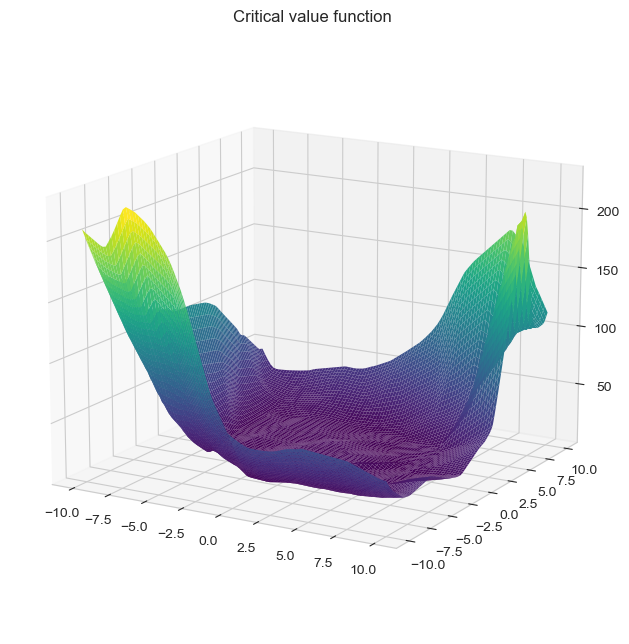

In [15]:
mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='viridis', edgecolor='none')
ax.set_title('Critical value function')
ax.view_init(elev=15)

##### 68.3%

In [16]:
CONFIDENCE_LEVEL = 0.683

In [17]:
#learner_kwargs = {'max_depth': 20, 'n_estimators': 1000}
#qr_XGB68, predicted_cutoffs_xgb68 = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
#                                              theta_mat=b_prime_theta, stats_mat=qr_statistics,
#                                              algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,
#                                              prediction_grid=simulator_lf2i.param_grid)

learner_kwargs = {'epochs': 1000, 'batch_size': 50}
pytorch_kwargs = {'neur_shapes': (128, 128, 128)}
qr_nn68, predicted_cutoffs_nn68 = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
                                                                       theta_mat=b_prime_theta.numpy(), stats_mat=qr_statistics,
                                                                       algo_name='pytorch', learner_kwargs=learner_kwargs, pytorch_kwargs=pytorch_kwargs,
                                                                       prediction_grid=simulator_lf2i.param_grid, nn_dropout=0.1)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [03:58<00:00,  4.19it/s]


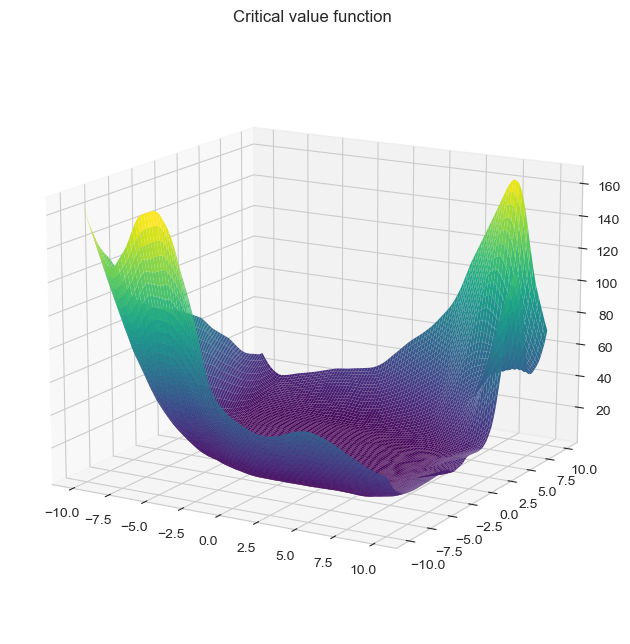

In [18]:
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, predicted_cutoffs_nn68.reshape(X.shape), rstride=1, cstride=1,
                cmap='viridis', edgecolor='none')
ax.set_title('Critical value function')
ax.view_init(elev=15)

## Diagnostics

### Confidence sets

In [146]:
posterior_means_diagnostics = []
posterior_vars_diagnostics = []
for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing posterior quantities for diagnostics...'):
    posterior_samples_diagnostics = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=b_double_prime_x[i, :])
    posterior_means_diagnostics.append(torch.mean(posterior_samples_diagnostics, dim=0))
    posterior_vars_diagnostics.append(torch.cov(torch.transpose(posterior_samples_diagnostics, 0, 1)))

Computing posterior quantities for diagnostics...:   0%|                                                                                                         | 0/10000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 1/10000 [00:00<35:29,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 2/10000 [00:00<34:37,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 3/10000 [00:00<34:20,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 4/10000 [00:00<34:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 5/10000 [00:01<34:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 6/10000 [00:01<34:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 7/10000 [00:01<34:16,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 8/10000 [00:01<34:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                 | 9/10000 [00:01<34:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                | 10/10000 [00:02<34:27,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                | 11/10000 [00:02<34:22,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                | 12/10000 [00:02<34:22,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                | 13/10000 [00:02<34:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 14/10000 [00:02<34:20,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 15/10000 [00:03<34:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 16/10000 [00:03<34:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 17/10000 [00:03<34:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 18/10000 [00:03<34:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 19/10000 [00:03<34:08,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 20/10000 [00:04<34:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 21/10000 [00:04<34:21,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 22/10000 [00:04<34:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 23/10000 [00:04<34:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 24/10000 [00:04<34:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 25/10000 [00:05<34:23,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                               | 26/10000 [00:05<34:49,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 27/10000 [00:05<35:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 28/10000 [00:05<34:55,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 29/10000 [00:05<34:39,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 30/10000 [00:06<34:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 31/10000 [00:06<34:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 32/10000 [00:06<34:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 33/10000 [00:06<34:32,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 34/10000 [00:07<34:33,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 35/10000 [00:07<34:28,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 36/10000 [00:07<34:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 37/10000 [00:07<34:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 38/10000 [00:07<34:22,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                               | 39/10000 [00:08<34:12,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 40/10000 [00:08<34:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 41/10000 [00:08<33:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 42/10000 [00:08<33:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 43/10000 [00:08<33:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 44/10000 [00:09<33:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 45/10000 [00:09<33:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 46/10000 [00:09<33:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 47/10000 [00:09<33:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 48/10000 [00:09<33:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 49/10000 [00:10<33:36,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                               | 50/10000 [00:10<33:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▍                                                                                               | 51/10000 [00:10<33:36,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▍                                                                                               | 52/10000 [00:10<33:36,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 53/10000 [00:10<33:31,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 54/10000 [00:11<33:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 55/10000 [00:11<33:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 56/10000 [00:11<33:30,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 57/10000 [00:11<33:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 58/10000 [00:11<33:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 59/10000 [00:12<33:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 60/10000 [00:12<33:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 61/10000 [00:12<33:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 62/10000 [00:12<33:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 63/10000 [00:12<33:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 64/10000 [00:13<33:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▌                                                                                               | 65/10000 [00:13<33:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 66/10000 [00:13<33:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 67/10000 [00:13<33:12,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 68/10000 [00:13<33:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 69/10000 [00:14<33:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 70/10000 [00:14<33:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 71/10000 [00:14<33:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 72/10000 [00:14<33:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 73/10000 [00:14<33:20,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 74/10000 [00:15<33:58,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 75/10000 [00:15<34:06,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 76/10000 [00:15<33:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 77/10000 [00:15<33:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                               | 78/10000 [00:15<33:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 79/10000 [00:16<33:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 80/10000 [00:16<33:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 81/10000 [00:16<34:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 82/10000 [00:16<34:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 83/10000 [00:16<34:26,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 84/10000 [00:17<34:14,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 85/10000 [00:17<34:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 86/10000 [00:17<34:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 87/10000 [00:17<33:59,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 88/10000 [00:18<34:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 89/10000 [00:18<33:53,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 90/10000 [00:18<33:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                               | 91/10000 [00:18<33:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 92/10000 [00:18<33:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 93/10000 [00:19<33:59,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 94/10000 [00:19<33:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 95/10000 [00:19<33:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 96/10000 [00:19<33:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 97/10000 [00:19<33:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 98/10000 [00:20<33:23,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                               | 99/10000 [00:20<33:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 100/10000 [00:20<33:28,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 101/10000 [00:20<33:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 102/10000 [00:20<33:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 103/10000 [00:21<33:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 104/10000 [00:21<33:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                              | 105/10000 [00:21<33:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 106/10000 [00:21<33:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 107/10000 [00:21<33:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 108/10000 [00:22<33:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 109/10000 [00:22<33:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 110/10000 [00:22<33:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 111/10000 [00:22<33:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 112/10000 [00:22<33:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 113/10000 [00:23<33:06,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 114/10000 [00:23<32:57,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 115/10000 [00:23<33:06,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 116/10000 [00:23<33:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 117/10000 [00:23<33:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                              | 118/10000 [00:24<33:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 119/10000 [00:24<33:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 120/10000 [00:24<33:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 121/10000 [00:24<34:27,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 122/10000 [00:24<33:56,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 123/10000 [00:25<33:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 124/10000 [00:25<33:24,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 125/10000 [00:25<33:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 126/10000 [00:25<33:20,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 127/10000 [00:25<33:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 128/10000 [00:26<33:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 129/10000 [00:26<33:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 130/10000 [00:26<33:15,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                             | 131/10000 [00:26<33:25,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 132/10000 [00:26<33:40,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 133/10000 [00:27<33:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 134/10000 [00:27<33:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 135/10000 [00:27<33:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 136/10000 [00:27<34:06,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 137/10000 [00:27<34:39,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 138/10000 [00:28<34:44,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 139/10000 [00:28<34:23,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 140/10000 [00:28<34:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 141/10000 [00:28<33:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 142/10000 [00:28<33:24,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 143/10000 [00:29<33:49,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                             | 144/10000 [00:29<33:26,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                             | 145/10000 [00:29<33:33,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                             | 146/10000 [00:29<33:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                             | 147/10000 [00:30<33:51,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                             | 148/10000 [00:30<33:52,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                             | 149/10000 [00:30<33:40,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 150/10000 [00:30<33:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 151/10000 [00:30<33:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 152/10000 [00:31<33:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 153/10000 [00:31<33:25,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 154/10000 [00:31<33:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 155/10000 [00:31<33:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 156/10000 [00:31<33:15,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▍                                                                                             | 157/10000 [00:32<33:18,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 158/10000 [00:32<33:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 159/10000 [00:32<33:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 160/10000 [00:32<33:25,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 161/10000 [00:32<33:11,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 162/10000 [00:33<33:13,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 163/10000 [00:33<33:16,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 164/10000 [00:33<33:29,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 165/10000 [00:33<33:49,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 166/10000 [00:33<33:59,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 167/10000 [00:34<33:47,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 168/10000 [00:34<33:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 169/10000 [00:34<33:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 170/10000 [00:34<34:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▌                                                                                             | 171/10000 [00:34<34:13,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 172/10000 [00:35<33:53,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 173/10000 [00:35<33:49,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 174/10000 [00:35<33:57,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 175/10000 [00:35<33:50,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 176/10000 [00:35<33:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 177/10000 [00:36<33:30,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 178/10000 [00:36<33:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 179/10000 [00:36<33:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 180/10000 [00:36<33:15,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 181/10000 [00:36<33:04,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 182/10000 [00:37<33:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 183/10000 [00:37<32:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▋                                                                                             | 184/10000 [00:37<32:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 185/10000 [00:37<32:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 186/10000 [00:37<32:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 187/10000 [00:38<32:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 188/10000 [00:38<32:45,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 189/10000 [00:38<32:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 190/10000 [00:38<32:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 191/10000 [00:38<32:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 192/10000 [00:39<33:05,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 193/10000 [00:39<33:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 194/10000 [00:39<33:05,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 195/10000 [00:39<33:00,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 196/10000 [00:40<36:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▊                                                                                             | 197/10000 [00:40<35:37,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 198/10000 [00:40<34:53,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 199/10000 [00:40<34:14,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 200/10000 [00:40<33:51,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 201/10000 [00:41<33:26,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 202/10000 [00:41<33:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 203/10000 [00:41<33:07,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 204/10000 [00:41<32:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 205/10000 [00:41<32:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 206/10000 [00:42<32:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 207/10000 [00:42<32:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 208/10000 [00:42<32:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 209/10000 [00:42<32:51,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|█▉                                                                                             | 210/10000 [00:42<32:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 211/10000 [00:43<32:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 212/10000 [00:43<32:59,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 213/10000 [00:43<32:58,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 214/10000 [00:43<32:57,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 215/10000 [00:43<32:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 216/10000 [00:44<32:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 217/10000 [00:44<32:49,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 218/10000 [00:44<32:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 219/10000 [00:44<32:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 220/10000 [00:44<32:57,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 221/10000 [00:45<32:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 222/10000 [00:45<33:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██                                                                                             | 223/10000 [00:45<32:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 224/10000 [00:45<32:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 225/10000 [00:45<32:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 226/10000 [00:46<32:46,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 227/10000 [00:46<32:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 228/10000 [00:46<32:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 229/10000 [00:46<32:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 230/10000 [00:46<32:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 231/10000 [00:47<32:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 232/10000 [00:47<32:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 233/10000 [00:47<32:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 234/10000 [00:47<33:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 235/10000 [00:47<33:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                            | 236/10000 [00:48<32:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 237/10000 [00:48<32:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 238/10000 [00:48<32:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 239/10000 [00:48<32:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 240/10000 [00:48<32:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 241/10000 [00:49<32:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 242/10000 [00:49<32:56,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 243/10000 [00:49<33:00,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 244/10000 [00:49<32:57,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 245/10000 [00:49<32:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 246/10000 [00:50<32:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 247/10000 [00:50<32:40,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 248/10000 [00:50<32:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                            | 249/10000 [00:50<32:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                            | 250/10000 [00:50<32:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 251/10000 [00:51<32:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 252/10000 [00:51<32:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 253/10000 [00:51<32:34,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 254/10000 [00:51<32:33,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 255/10000 [00:51<32:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 256/10000 [00:52<32:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 257/10000 [00:52<32:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 258/10000 [00:52<32:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 259/10000 [00:52<32:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 260/10000 [00:52<32:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 261/10000 [00:53<32:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 262/10000 [00:53<32:37,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▍                                                                                            | 263/10000 [00:53<32:37,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 264/10000 [00:53<32:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 265/10000 [00:53<32:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 266/10000 [00:54<32:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 267/10000 [00:54<32:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 268/10000 [00:54<32:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 269/10000 [00:54<32:39,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 270/10000 [00:54<32:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 271/10000 [00:55<32:35,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 272/10000 [00:55<32:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 273/10000 [00:55<32:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 274/10000 [00:55<32:17,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 275/10000 [00:55<32:18,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▌                                                                                            | 276/10000 [00:56<32:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 277/10000 [00:56<32:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 278/10000 [00:56<32:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 279/10000 [00:56<32:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 280/10000 [00:56<32:25,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 281/10000 [00:57<32:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 282/10000 [00:57<32:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 283/10000 [00:57<32:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 284/10000 [00:57<32:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 285/10000 [00:57<32:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 286/10000 [00:58<32:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 287/10000 [00:58<32:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 288/10000 [00:58<32:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▋                                                                                            | 289/10000 [00:58<32:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 290/10000 [00:58<32:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 291/10000 [00:59<32:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 292/10000 [00:59<32:55,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 293/10000 [00:59<32:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 294/10000 [00:59<32:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 295/10000 [01:00<32:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 296/10000 [01:00<32:44,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 297/10000 [01:00<32:39,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 298/10000 [01:00<32:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 299/10000 [01:00<32:36,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 300/10000 [01:01<32:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 301/10000 [01:01<32:30,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▊                                                                                            | 302/10000 [01:01<32:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 303/10000 [01:01<32:47,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 304/10000 [01:01<32:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 305/10000 [01:02<32:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 306/10000 [01:02<32:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 307/10000 [01:02<32:46,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 308/10000 [01:02<33:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 309/10000 [01:02<33:28,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 310/10000 [01:03<33:33,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 311/10000 [01:03<33:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 312/10000 [01:03<33:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 313/10000 [01:03<33:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 314/10000 [01:03<32:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|██▉                                                                                            | 315/10000 [01:04<32:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 316/10000 [01:04<32:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 317/10000 [01:04<33:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 318/10000 [01:04<33:30,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 319/10000 [01:04<33:34,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 320/10000 [01:05<33:25,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 321/10000 [01:05<33:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 322/10000 [01:05<33:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 323/10000 [01:05<33:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 324/10000 [01:05<33:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 325/10000 [01:06<33:22,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 326/10000 [01:06<33:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 327/10000 [01:06<33:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███                                                                                            | 328/10000 [01:06<33:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 329/10000 [01:06<33:22,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 330/10000 [01:07<33:24,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 331/10000 [01:07<33:23,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 332/10000 [01:07<33:11,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 333/10000 [01:07<32:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 334/10000 [01:07<32:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 335/10000 [01:08<32:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 336/10000 [01:08<32:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 337/10000 [01:08<32:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 338/10000 [01:08<32:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 339/10000 [01:08<32:31,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 340/10000 [01:09<32:29,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 341/10000 [01:09<32:29,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▏                                                                                           | 342/10000 [01:09<32:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 343/10000 [01:09<32:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 344/10000 [01:10<32:20,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 345/10000 [01:10<32:32,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 346/10000 [01:10<32:45,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 347/10000 [01:10<32:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 348/10000 [01:10<32:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▎                                                                                           | 349/10000 [01:11<32:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 350/10000 [01:11<32:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 351/10000 [01:11<32:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 352/10000 [01:11<49:45,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 353/10000 [01:12<44:44,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 354/10000 [01:12<40:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▎                                                                                           | 355/10000 [01:12<38:19,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 356/10000 [01:12<36:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 357/10000 [01:12<35:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 358/10000 [01:13<34:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 359/10000 [01:13<33:29,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 360/10000 [01:13<33:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 361/10000 [01:13<32:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 362/10000 [01:13<32:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 363/10000 [01:14<32:08,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 364/10000 [01:14<32:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 365/10000 [01:14<31:56,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 366/10000 [01:14<32:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 367/10000 [01:14<32:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▍                                                                                           | 368/10000 [01:15<32:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 369/10000 [01:15<32:17,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 370/10000 [01:15<32:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 371/10000 [01:15<32:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 372/10000 [01:15<32:27,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 373/10000 [01:16<32:22,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 374/10000 [01:16<32:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 375/10000 [01:16<32:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 376/10000 [01:16<32:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 377/10000 [01:17<33:06,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 378/10000 [01:17<33:30,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 379/10000 [01:17<33:16,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 380/10000 [01:17<33:18,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▌                                                                                           | 381/10000 [01:17<33:11,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 382/10000 [01:18<33:13,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 383/10000 [01:18<33:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 384/10000 [01:18<32:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 385/10000 [01:18<32:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 386/10000 [01:18<32:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 387/10000 [01:19<33:10,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 388/10000 [01:19<33:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 389/10000 [01:19<33:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 390/10000 [01:19<33:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 391/10000 [01:19<34:33,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 392/10000 [01:20<34:41,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 393/10000 [01:20<33:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▋                                                                                           | 394/10000 [01:20<33:21,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 395/10000 [01:20<33:00,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 396/10000 [01:20<32:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 397/10000 [01:21<32:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 398/10000 [01:21<32:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 399/10000 [01:21<36:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 400/10000 [01:21<34:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 401/10000 [01:22<34:06,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 402/10000 [01:22<33:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 403/10000 [01:22<33:32,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 404/10000 [01:22<33:16,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 405/10000 [01:22<33:25,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 406/10000 [01:23<33:19,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▊                                                                                           | 407/10000 [01:23<32:58,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 408/10000 [01:23<33:07,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 409/10000 [01:23<39:08,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 410/10000 [01:24<37:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 411/10000 [01:24<36:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 412/10000 [01:24<35:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 413/10000 [01:24<35:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 414/10000 [01:24<34:52,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 415/10000 [01:25<34:26,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 416/10000 [01:25<34:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 417/10000 [01:25<34:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 418/10000 [01:25<34:29,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 419/10000 [01:25<34:09,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 420/10000 [01:26<34:16,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|███▉                                                                                           | 421/10000 [01:26<34:25,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 422/10000 [01:26<35:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 423/10000 [01:26<35:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 424/10000 [01:27<34:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 425/10000 [01:27<34:34,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 426/10000 [01:27<34:23,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 427/10000 [01:27<33:48,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 428/10000 [01:27<33:12,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 429/10000 [01:28<32:51,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 430/10000 [01:28<32:45,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 431/10000 [01:28<32:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 432/10000 [01:28<32:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 433/10000 [01:28<32:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████                                                                                           | 434/10000 [01:29<32:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 435/10000 [01:29<32:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 436/10000 [01:29<32:48,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 437/10000 [01:29<32:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 438/10000 [01:29<33:04,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 439/10000 [01:30<33:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 440/10000 [01:30<33:56,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 441/10000 [01:30<33:49,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 442/10000 [01:30<33:48,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 443/10000 [01:31<33:38,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 444/10000 [01:31<41:23,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 445/10000 [01:31<39:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 446/10000 [01:31<39:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▏                                                                                          | 447/10000 [01:32<37:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▎                                                                                          | 448/10000 [01:32<37:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▎                                                                                          | 449/10000 [01:32<42:26,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|████▎                                                                                          | 450/10000 [01:32<40:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 451/10000 [01:33<38:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 452/10000 [01:33<36:42,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 453/10000 [01:33<36:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 454/10000 [01:33<37:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 455/10000 [01:33<35:58,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 456/10000 [01:34<35:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 457/10000 [01:34<37:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 458/10000 [01:34<37:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 459/10000 [01:34<35:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▎                                                                                          | 460/10000 [01:35<34:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 461/10000 [01:35<34:20,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 462/10000 [01:35<33:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 463/10000 [01:35<33:19,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 464/10000 [01:35<32:56,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 465/10000 [01:36<32:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 466/10000 [01:36<32:04,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 467/10000 [01:36<31:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 468/10000 [01:36<32:05,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 469/10000 [01:36<32:02,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 470/10000 [01:37<32:02,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 471/10000 [01:37<31:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 472/10000 [01:37<31:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▍                                                                                          | 473/10000 [01:37<31:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 474/10000 [01:37<31:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 475/10000 [01:38<31:42,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 476/10000 [01:38<31:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 477/10000 [01:38<32:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 478/10000 [01:38<31:58,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 479/10000 [01:38<31:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 480/10000 [01:39<31:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 481/10000 [01:39<32:23,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 482/10000 [01:39<32:30,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 483/10000 [01:39<32:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 484/10000 [01:39<32:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 485/10000 [01:40<31:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▌                                                                                          | 486/10000 [01:40<31:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 487/10000 [01:40<31:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 488/10000 [01:40<32:11,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 489/10000 [01:40<32:04,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 490/10000 [01:41<31:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 491/10000 [01:41<31:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 492/10000 [01:41<31:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 493/10000 [01:41<31:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 494/10000 [01:41<31:33,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 495/10000 [01:42<31:35,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 496/10000 [01:42<31:33,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 497/10000 [01:42<32:05,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 498/10000 [01:42<31:45,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▋                                                                                          | 499/10000 [01:42<31:35,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 500/10000 [01:43<31:24,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 501/10000 [01:43<31:25,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 502/10000 [01:43<31:18,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 503/10000 [01:43<31:22,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 504/10000 [01:43<32:15,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 505/10000 [01:44<32:02,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 506/10000 [01:44<31:49,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 507/10000 [01:44<31:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 508/10000 [01:44<31:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 509/10000 [01:44<31:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 510/10000 [01:45<31:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 511/10000 [01:45<31:49,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 512/10000 [01:45<31:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▊                                                                                          | 513/10000 [01:45<31:49,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 514/10000 [01:45<31:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 515/10000 [01:46<31:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 516/10000 [01:46<32:01,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 517/10000 [01:46<32:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 518/10000 [01:46<32:02,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 519/10000 [01:46<31:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 520/10000 [01:47<31:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 521/10000 [01:47<31:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 522/10000 [01:47<31:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 523/10000 [01:47<31:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 524/10000 [01:47<31:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 525/10000 [01:48<31:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|████▉                                                                                          | 526/10000 [01:48<31:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 527/10000 [01:48<31:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 528/10000 [01:48<31:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 529/10000 [01:48<31:46,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 530/10000 [01:49<31:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 531/10000 [01:49<31:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 532/10000 [01:49<31:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 533/10000 [01:49<31:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 534/10000 [01:49<31:27,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 535/10000 [01:50<31:32,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 536/10000 [01:50<35:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 537/10000 [01:50<34:40,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 538/10000 [01:50<33:46,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████                                                                                          | 539/10000 [01:51<33:11,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 540/10000 [01:51<34:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 541/10000 [01:51<33:52,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 542/10000 [01:51<33:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 543/10000 [01:51<32:58,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 544/10000 [01:52<32:34,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 545/10000 [01:52<32:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 546/10000 [01:52<32:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 547/10000 [01:52<32:08,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 548/10000 [01:52<31:57,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|█████▏                                                                                         | 549/10000 [01:53<31:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▏                                                                                         | 550/10000 [01:53<31:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▏                                                                                         | 551/10000 [01:53<32:36,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▏                                                                                         | 552/10000 [01:53<32:24,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 553/10000 [01:53<32:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 554/10000 [01:54<32:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 555/10000 [01:54<31:54,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 556/10000 [01:54<31:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 557/10000 [01:54<31:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 558/10000 [01:54<31:49,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 559/10000 [01:55<31:40,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 560/10000 [01:55<31:42,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 561/10000 [01:55<31:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 562/10000 [01:55<31:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 563/10000 [01:55<31:40,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 564/10000 [01:56<31:39,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▎                                                                                         | 565/10000 [01:56<31:34,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 566/10000 [01:56<31:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 567/10000 [01:56<31:50,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 568/10000 [01:56<31:51,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 569/10000 [01:57<31:44,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 570/10000 [01:57<31:41,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 571/10000 [01:57<31:40,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 572/10000 [01:57<31:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 573/10000 [01:57<31:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 574/10000 [01:58<31:37,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 575/10000 [01:58<31:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 576/10000 [01:58<31:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 577/10000 [01:58<31:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▍                                                                                         | 578/10000 [01:58<31:19,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 579/10000 [01:59<31:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 580/10000 [01:59<31:25,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 581/10000 [01:59<31:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 582/10000 [01:59<31:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 583/10000 [01:59<31:37,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 584/10000 [02:00<31:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 585/10000 [02:00<31:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 586/10000 [02:00<31:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 587/10000 [02:00<31:38,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 588/10000 [02:00<31:41,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 589/10000 [02:01<31:39,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 590/10000 [02:01<31:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 591/10000 [02:01<31:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▌                                                                                         | 592/10000 [02:01<31:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 593/10000 [02:01<31:34,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 594/10000 [02:02<31:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 595/10000 [02:02<32:55,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 596/10000 [02:02<37:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 597/10000 [02:02<36:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 598/10000 [02:03<35:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 599/10000 [02:03<34:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 600/10000 [02:03<34:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 601/10000 [02:03<34:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 602/10000 [02:03<33:50,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 603/10000 [02:04<33:10,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 604/10000 [02:04<32:37,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▋                                                                                         | 605/10000 [02:04<32:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 606/10000 [02:04<32:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 607/10000 [02:04<31:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 608/10000 [02:05<31:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 609/10000 [02:05<31:35,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 610/10000 [02:05<31:16,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 611/10000 [02:05<31:06,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 612/10000 [02:05<31:05,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 613/10000 [02:06<31:10,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 614/10000 [02:06<31:13,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 615/10000 [02:06<31:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 616/10000 [02:06<31:22,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 617/10000 [02:06<31:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▊                                                                                         | 618/10000 [02:07<31:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 619/10000 [02:07<31:25,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 620/10000 [02:07<31:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 621/10000 [02:07<31:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 622/10000 [02:08<31:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 623/10000 [02:08<31:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 624/10000 [02:08<31:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 625/10000 [02:08<31:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 626/10000 [02:08<31:18,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 627/10000 [02:09<31:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 628/10000 [02:09<31:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 629/10000 [02:09<31:11,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 630/10000 [02:09<31:07,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████▉                                                                                         | 631/10000 [02:09<31:10,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 632/10000 [02:10<31:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 633/10000 [02:10<31:10,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 634/10000 [02:10<31:10,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 635/10000 [02:10<31:04,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 636/10000 [02:10<33:50,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 637/10000 [02:11<33:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 638/10000 [02:11<32:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 639/10000 [02:11<32:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 640/10000 [02:11<34:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 641/10000 [02:11<34:17,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 642/10000 [02:12<33:24,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 643/10000 [02:12<32:41,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████                                                                                         | 644/10000 [02:12<32:13,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 645/10000 [02:12<31:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 646/10000 [02:12<31:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 647/10000 [02:13<31:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 648/10000 [02:13<31:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 649/10000 [02:13<31:18,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|██████▏                                                                                        | 650/10000 [02:13<31:18,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 651/10000 [02:13<31:18,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 652/10000 [02:14<31:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 653/10000 [02:14<31:15,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 654/10000 [02:14<31:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 655/10000 [02:14<31:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 656/10000 [02:14<31:12,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▏                                                                                        | 657/10000 [02:15<31:08,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 658/10000 [02:15<31:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 659/10000 [02:15<31:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 660/10000 [02:15<31:03,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 661/10000 [02:15<30:58,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 662/10000 [02:16<31:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 663/10000 [02:16<31:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 664/10000 [02:16<31:15,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 665/10000 [02:16<31:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 666/10000 [02:16<31:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 667/10000 [02:17<31:00,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 668/10000 [02:17<31:03,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 669/10000 [02:17<31:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 670/10000 [02:17<31:16,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▎                                                                                        | 671/10000 [02:17<31:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 672/10000 [02:18<31:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 673/10000 [02:18<31:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 674/10000 [02:18<31:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 675/10000 [02:18<31:03,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 676/10000 [02:18<31:08,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 677/10000 [02:19<31:04,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 678/10000 [02:19<31:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 679/10000 [02:19<31:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 680/10000 [02:19<31:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 681/10000 [02:19<31:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 682/10000 [02:20<31:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 683/10000 [02:20<31:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▍                                                                                        | 684/10000 [02:20<31:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 685/10000 [02:20<31:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 686/10000 [02:20<31:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 687/10000 [02:21<31:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 688/10000 [02:21<31:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 689/10000 [02:21<31:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 690/10000 [02:21<30:57,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 691/10000 [02:21<31:02,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 692/10000 [02:22<30:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 693/10000 [02:22<31:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 694/10000 [02:22<31:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 695/10000 [02:22<31:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 696/10000 [02:22<31:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▌                                                                                        | 697/10000 [02:23<31:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 698/10000 [02:23<31:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 699/10000 [02:23<31:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 700/10000 [02:23<31:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 701/10000 [02:23<30:57,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 702/10000 [02:24<31:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 703/10000 [02:24<31:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 704/10000 [02:24<31:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 705/10000 [02:24<31:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 706/10000 [02:24<31:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 707/10000 [02:25<31:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 708/10000 [02:25<31:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 709/10000 [02:25<31:00,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▋                                                                                        | 710/10000 [02:25<30:57,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 711/10000 [02:25<31:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 712/10000 [02:26<31:06,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 713/10000 [02:26<31:00,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 714/10000 [02:26<30:56,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 715/10000 [02:26<30:57,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 716/10000 [02:26<30:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 717/10000 [02:27<31:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 718/10000 [02:27<31:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 719/10000 [02:27<31:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 720/10000 [02:27<31:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 721/10000 [02:27<30:56,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 722/10000 [02:28<31:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▊                                                                                        | 723/10000 [02:28<31:01,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 724/10000 [02:28<30:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 725/10000 [02:28<30:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 726/10000 [02:28<30:57,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 727/10000 [02:29<31:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 728/10000 [02:29<30:50,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 729/10000 [02:29<30:47,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 730/10000 [02:29<30:54,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 731/10000 [02:29<30:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 732/10000 [02:30<31:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 733/10000 [02:30<31:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 734/10000 [02:30<30:57,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 735/10000 [02:30<31:08,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████▉                                                                                        | 736/10000 [02:30<31:06,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 737/10000 [02:31<31:06,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 738/10000 [02:31<31:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 739/10000 [02:31<31:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 740/10000 [02:31<31:03,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 741/10000 [02:31<31:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 742/10000 [02:32<31:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 743/10000 [02:32<31:07,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 744/10000 [02:32<31:06,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 745/10000 [02:32<31:05,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 746/10000 [02:32<30:59,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 747/10000 [02:33<30:53,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 748/10000 [02:33<31:02,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|███████                                                                                        | 749/10000 [02:33<30:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 750/10000 [02:33<30:55,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 751/10000 [02:33<31:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 752/10000 [02:34<30:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 753/10000 [02:34<30:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 754/10000 [02:34<31:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 755/10000 [02:34<31:32,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 756/10000 [02:34<31:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 757/10000 [02:35<31:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 758/10000 [02:35<31:00,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 759/10000 [02:35<30:55,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 760/10000 [02:35<30:58,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 761/10000 [02:36<30:55,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 762/10000 [02:36<30:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▏                                                                                       | 763/10000 [02:36<30:47,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 764/10000 [02:36<30:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 765/10000 [02:36<30:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 766/10000 [02:37<31:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 767/10000 [02:37<30:55,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 768/10000 [02:37<30:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 769/10000 [02:37<30:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 770/10000 [02:37<30:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 771/10000 [02:38<30:39,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 772/10000 [02:38<30:38,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 773/10000 [02:38<30:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 774/10000 [02:38<30:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 775/10000 [02:38<30:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▎                                                                                       | 776/10000 [02:39<30:58,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 777/10000 [02:39<30:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 778/10000 [02:39<30:45,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 779/10000 [02:39<30:47,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 780/10000 [02:39<30:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 781/10000 [02:40<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 782/10000 [02:40<30:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 783/10000 [02:40<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 784/10000 [02:40<30:45,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 785/10000 [02:40<30:42,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 786/10000 [02:41<30:36,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 787/10000 [02:41<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 788/10000 [02:41<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▍                                                                                       | 789/10000 [02:41<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 790/10000 [02:41<30:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 791/10000 [02:42<30:41,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 792/10000 [02:42<30:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 793/10000 [02:42<30:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 794/10000 [02:42<30:41,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 795/10000 [02:42<30:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 796/10000 [02:43<30:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 797/10000 [02:43<30:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 798/10000 [02:43<30:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 799/10000 [02:43<30:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 800/10000 [02:43<30:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 801/10000 [02:44<30:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▌                                                                                       | 802/10000 [02:44<30:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 803/10000 [02:44<30:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 804/10000 [02:44<30:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 805/10000 [02:44<30:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 806/10000 [02:45<30:32,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 807/10000 [02:45<30:31,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 808/10000 [02:45<30:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 809/10000 [02:45<30:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 810/10000 [02:45<30:32,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 811/10000 [02:46<30:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 812/10000 [02:46<30:34,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 813/10000 [02:46<30:34,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 814/10000 [02:46<30:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▋                                                                                       | 815/10000 [02:46<31:45,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 816/10000 [02:47<31:32,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 817/10000 [02:47<31:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 818/10000 [02:47<31:06,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 819/10000 [02:47<30:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 820/10000 [02:47<30:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 821/10000 [02:48<30:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 822/10000 [02:48<30:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 823/10000 [02:48<30:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 824/10000 [02:48<30:34,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 825/10000 [02:48<30:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 826/10000 [02:49<30:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 827/10000 [02:49<30:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▊                                                                                       | 828/10000 [02:49<30:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 829/10000 [02:49<30:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 830/10000 [02:49<30:39,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 831/10000 [02:50<30:39,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 832/10000 [02:50<30:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 833/10000 [02:50<30:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 834/10000 [02:50<30:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 835/10000 [02:50<30:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 836/10000 [02:51<30:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 837/10000 [02:51<30:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 838/10000 [02:51<30:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 839/10000 [02:51<32:43,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 840/10000 [02:51<32:08,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 841/10000 [02:52<31:42,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████▉                                                                                       | 842/10000 [02:52<31:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 843/10000 [02:52<31:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 844/10000 [02:52<30:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 845/10000 [02:52<30:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 846/10000 [02:53<30:51,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 847/10000 [02:53<30:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 848/10000 [02:53<30:51,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 849/10000 [02:53<30:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████                                                                                       | 850/10000 [02:53<30:51,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████                                                                                       | 851/10000 [02:54<30:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████                                                                                       | 852/10000 [02:54<30:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████                                                                                       | 853/10000 [02:54<30:47,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████                                                                                       | 854/10000 [02:54<30:40,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████                                                                                       | 855/10000 [02:54<30:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 856/10000 [02:55<30:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 857/10000 [02:55<30:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 858/10000 [02:55<30:35,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 859/10000 [02:55<30:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 860/10000 [02:55<30:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 861/10000 [02:56<30:33,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 862/10000 [02:56<30:37,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 863/10000 [02:56<30:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 864/10000 [02:56<30:39,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 865/10000 [02:56<30:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 866/10000 [02:57<30:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 867/10000 [02:57<30:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▏                                                                                      | 868/10000 [02:57<30:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 869/10000 [02:57<30:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 870/10000 [02:57<30:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 871/10000 [02:58<30:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 872/10000 [02:58<30:29,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 873/10000 [02:58<30:28,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 874/10000 [02:58<30:25,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 875/10000 [02:58<30:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 876/10000 [02:59<31:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 877/10000 [02:59<30:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 878/10000 [02:59<30:46,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 879/10000 [02:59<30:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 880/10000 [02:59<30:36,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▎                                                                                      | 881/10000 [03:00<30:46,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 882/10000 [03:00<30:39,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 883/10000 [03:00<30:38,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 884/10000 [03:00<30:46,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 885/10000 [03:00<30:37,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 886/10000 [03:01<30:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 887/10000 [03:01<30:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 888/10000 [03:01<30:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 889/10000 [03:01<30:34,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 890/10000 [03:01<30:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 891/10000 [03:02<30:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 892/10000 [03:02<31:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 893/10000 [03:02<30:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▍                                                                                      | 894/10000 [03:02<30:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 895/10000 [03:02<30:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 896/10000 [03:03<30:36,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 897/10000 [03:03<30:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 898/10000 [03:03<30:36,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 899/10000 [03:03<30:38,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 900/10000 [03:03<30:27,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 901/10000 [03:04<30:26,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 902/10000 [03:04<30:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 903/10000 [03:04<30:25,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 904/10000 [03:04<30:21,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 905/10000 [03:04<30:17,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 906/10000 [03:05<30:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▌                                                                                      | 907/10000 [03:05<30:15,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 908/10000 [03:05<30:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 909/10000 [03:05<30:20,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 910/10000 [03:05<30:18,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 911/10000 [03:06<30:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 912/10000 [03:06<30:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 913/10000 [03:06<30:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 914/10000 [03:06<30:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 915/10000 [03:06<30:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 916/10000 [03:07<30:22,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 917/10000 [03:07<30:17,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 918/10000 [03:07<30:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 919/10000 [03:07<30:26,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 920/10000 [03:07<30:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▋                                                                                      | 921/10000 [03:08<30:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 922/10000 [03:08<30:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 923/10000 [03:08<30:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 924/10000 [03:08<30:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 925/10000 [03:08<30:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 926/10000 [03:09<30:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 927/10000 [03:09<30:14,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 928/10000 [03:09<30:05,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 929/10000 [03:09<30:10,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 930/10000 [03:09<30:07,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 931/10000 [03:10<32:45,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 932/10000 [03:10<32:50,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 933/10000 [03:10<32:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▊                                                                                      | 934/10000 [03:10<32:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 935/10000 [03:11<31:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 936/10000 [03:11<32:45,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 937/10000 [03:11<32:13,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 938/10000 [03:11<31:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 939/10000 [03:12<35:38,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 940/10000 [03:12<34:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 941/10000 [03:12<33:38,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 942/10000 [03:12<32:44,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 943/10000 [03:12<32:14,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 944/10000 [03:13<32:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 945/10000 [03:13<32:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 946/10000 [03:13<32:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████▉                                                                                      | 947/10000 [03:13<31:53,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████                                                                                      | 948/10000 [03:13<31:38,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████                                                                                      | 949/10000 [03:14<31:28,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 950/10000 [03:14<31:21,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 951/10000 [03:14<31:11,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 952/10000 [03:14<31:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 953/10000 [03:14<31:05,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 954/10000 [03:15<31:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 955/10000 [03:15<30:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 956/10000 [03:15<30:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 957/10000 [03:15<30:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 958/10000 [03:15<30:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 959/10000 [03:16<30:58,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████                                                                                      | 960/10000 [03:16<30:59,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 961/10000 [03:16<30:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 962/10000 [03:16<30:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 963/10000 [03:16<30:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 964/10000 [03:17<30:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 965/10000 [03:17<30:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 966/10000 [03:17<30:30,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 967/10000 [03:17<30:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 968/10000 [03:17<30:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 969/10000 [03:18<31:07,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 970/10000 [03:18<31:07,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 971/10000 [03:18<30:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 972/10000 [03:18<30:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▏                                                                                     | 973/10000 [03:19<30:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 974/10000 [03:19<30:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 975/10000 [03:19<30:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 976/10000 [03:19<30:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 977/10000 [03:19<30:21,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 978/10000 [03:20<30:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 979/10000 [03:20<30:29,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 980/10000 [03:20<30:22,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 981/10000 [03:20<30:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 982/10000 [03:20<30:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 983/10000 [03:21<30:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 984/10000 [03:21<30:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 985/10000 [03:21<30:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▎                                                                                     | 986/10000 [03:21<30:22,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 987/10000 [03:21<30:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 988/10000 [03:22<30:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 989/10000 [03:22<30:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 990/10000 [03:22<30:20,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 991/10000 [03:22<30:21,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 992/10000 [03:22<30:26,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 993/10000 [03:23<30:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 994/10000 [03:23<30:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 995/10000 [03:23<30:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 996/10000 [03:23<30:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 997/10000 [03:23<30:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 998/10000 [03:24<30:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                     | 999/10000 [03:24<30:06,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1000/10000 [03:24<30:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1001/10000 [03:24<30:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1002/10000 [03:24<30:16,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1003/10000 [03:25<30:16,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1004/10000 [03:25<30:26,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1005/10000 [03:25<30:26,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1006/10000 [03:25<30:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1007/10000 [03:25<30:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1008/10000 [03:26<30:15,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1009/10000 [03:26<30:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▍                                                                                    | 1010/10000 [03:26<30:14,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1011/10000 [03:26<30:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1012/10000 [03:26<33:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1013/10000 [03:27<35:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1014/10000 [03:27<35:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1015/10000 [03:27<34:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1016/10000 [03:27<33:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1017/10000 [03:28<32:41,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1018/10000 [03:28<32:27,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1019/10000 [03:28<32:44,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1020/10000 [03:28<32:31,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1021/10000 [03:28<32:21,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1022/10000 [03:29<32:11,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▌                                                                                    | 1023/10000 [03:29<32:28,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1024/10000 [03:29<31:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1025/10000 [03:29<31:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1026/10000 [03:30<31:54,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1027/10000 [03:30<32:14,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1028/10000 [03:30<32:12,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1029/10000 [03:30<31:39,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1030/10000 [03:30<31:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1031/10000 [03:31<31:17,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1032/10000 [03:31<30:52,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1033/10000 [03:31<30:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1034/10000 [03:31<30:25,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1035/10000 [03:31<30:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1036/10000 [03:32<30:23,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▋                                                                                    | 1037/10000 [03:32<30:29,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1038/10000 [03:32<30:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1039/10000 [03:32<29:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1040/10000 [03:32<29:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1041/10000 [03:33<29:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1042/10000 [03:33<29:59,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1043/10000 [03:33<30:25,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1044/10000 [03:33<30:44,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1045/10000 [03:33<30:37,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1046/10000 [03:34<30:23,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1047/10000 [03:34<30:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1048/10000 [03:34<30:18,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1049/10000 [03:34<30:55,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████▊                                                                                    | 1050/10000 [03:34<30:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1051/10000 [03:35<30:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1052/10000 [03:35<33:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1053/10000 [03:35<33:06,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1054/10000 [03:35<32:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1055/10000 [03:36<32:01,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1056/10000 [03:36<34:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1057/10000 [03:36<33:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1058/10000 [03:36<32:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1059/10000 [03:37<35:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1060/10000 [03:37<34:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1061/10000 [03:37<33:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1062/10000 [03:37<32:29,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|█████████▉                                                                                    | 1063/10000 [03:37<31:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1064/10000 [03:38<32:43,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1065/10000 [03:38<32:15,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1066/10000 [03:38<31:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1067/10000 [03:38<31:11,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1068/10000 [03:38<30:45,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1069/10000 [03:39<30:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1070/10000 [03:39<30:15,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1071/10000 [03:39<30:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1072/10000 [03:39<30:14,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1073/10000 [03:39<30:08,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1074/10000 [03:40<30:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1075/10000 [03:40<29:59,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1076/10000 [03:40<30:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████                                                                                    | 1077/10000 [03:40<30:11,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1078/10000 [03:40<30:09,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1079/10000 [03:41<30:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1080/10000 [03:41<29:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1081/10000 [03:41<29:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1082/10000 [03:41<30:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1083/10000 [03:41<30:04,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1084/10000 [03:42<30:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1085/10000 [03:42<30:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1086/10000 [03:42<29:58,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1087/10000 [03:42<29:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1088/10000 [03:42<29:49,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1089/10000 [03:43<29:56,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▏                                                                                   | 1090/10000 [03:43<29:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1091/10000 [03:43<29:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1092/10000 [03:43<29:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1093/10000 [03:43<29:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1094/10000 [03:44<30:00,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1095/10000 [03:44<29:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1096/10000 [03:44<29:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1097/10000 [03:44<29:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1098/10000 [03:44<29:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1099/10000 [03:45<29:51,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1100/10000 [03:45<29:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1101/10000 [03:45<29:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1102/10000 [03:45<29:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▎                                                                                   | 1103/10000 [03:45<29:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1104/10000 [03:46<29:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1105/10000 [03:46<29:38,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1106/10000 [03:46<29:43,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1107/10000 [03:46<29:42,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1108/10000 [03:46<29:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1109/10000 [03:47<29:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1110/10000 [03:47<29:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1111/10000 [03:47<30:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1112/10000 [03:47<30:08,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1113/10000 [03:47<29:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1114/10000 [03:48<29:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1115/10000 [03:48<29:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1116/10000 [03:48<29:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▍                                                                                   | 1117/10000 [03:48<29:37,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1118/10000 [03:48<29:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1119/10000 [03:49<29:37,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1120/10000 [03:49<29:33,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1121/10000 [03:49<29:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1122/10000 [03:49<29:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1123/10000 [03:49<29:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1124/10000 [03:50<29:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1125/10000 [03:50<29:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1126/10000 [03:50<29:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1127/10000 [03:50<29:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1128/10000 [03:50<29:59,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1129/10000 [03:51<29:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▌                                                                                   | 1130/10000 [03:51<29:51,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1131/10000 [03:51<30:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1132/10000 [03:51<30:22,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1133/10000 [03:52<31:16,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1134/10000 [03:52<31:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1135/10000 [03:52<30:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1136/10000 [03:52<30:36,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1137/10000 [03:52<30:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1138/10000 [03:53<30:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1139/10000 [03:53<29:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1140/10000 [03:53<29:57,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1141/10000 [03:53<29:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1142/10000 [03:53<29:44,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▋                                                                                   | 1143/10000 [03:54<29:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1144/10000 [03:54<30:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1145/10000 [03:54<30:34,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1146/10000 [03:54<30:45,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1147/10000 [03:54<30:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1148/10000 [03:55<30:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|██████████▊                                                                                   | 1149/10000 [03:55<30:21,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1150/10000 [03:55<30:18,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1151/10000 [03:55<30:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1152/10000 [03:55<30:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1153/10000 [03:56<30:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1154/10000 [03:56<30:28,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1155/10000 [03:56<30:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▊                                                                                   | 1156/10000 [03:56<30:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1157/10000 [03:56<30:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1158/10000 [03:57<29:54,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1159/10000 [03:57<29:52,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1160/10000 [03:57<29:49,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1161/10000 [03:57<29:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1162/10000 [03:57<29:52,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1163/10000 [03:58<30:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1164/10000 [03:58<30:11,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1165/10000 [03:58<29:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1166/10000 [03:58<29:46,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1167/10000 [03:58<29:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1168/10000 [03:59<29:56,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1169/10000 [03:59<29:51,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|██████████▉                                                                                   | 1170/10000 [03:59<29:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1171/10000 [03:59<29:48,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1172/10000 [03:59<29:48,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1173/10000 [04:00<29:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1174/10000 [04:00<29:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1175/10000 [04:00<29:38,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1176/10000 [04:00<29:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1177/10000 [04:00<29:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1178/10000 [04:01<29:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1179/10000 [04:01<29:41,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1180/10000 [04:01<29:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1181/10000 [04:01<29:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1182/10000 [04:01<29:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████                                                                                   | 1183/10000 [04:02<29:27,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1184/10000 [04:02<29:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1185/10000 [04:02<29:27,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1186/10000 [04:02<29:19,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1187/10000 [04:02<29:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1188/10000 [04:03<29:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1189/10000 [04:03<29:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1190/10000 [04:03<29:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1191/10000 [04:03<29:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1192/10000 [04:04<34:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1193/10000 [04:04<33:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1194/10000 [04:04<32:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1195/10000 [04:04<32:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▏                                                                                  | 1196/10000 [04:04<31:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1197/10000 [04:05<31:23,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1198/10000 [04:05<31:06,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1199/10000 [04:05<30:38,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1200/10000 [04:05<30:19,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1201/10000 [04:05<30:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1202/10000 [04:06<29:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1203/10000 [04:06<29:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1204/10000 [04:06<29:40,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1205/10000 [04:06<29:54,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1206/10000 [04:06<29:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1207/10000 [04:07<29:44,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1208/10000 [04:07<29:35,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1209/10000 [04:07<29:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▎                                                                                  | 1210/10000 [04:07<29:15,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1211/10000 [04:07<29:08,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1212/10000 [04:08<29:12,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1213/10000 [04:08<29:13,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1214/10000 [04:08<29:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1215/10000 [04:08<29:10,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1216/10000 [04:08<29:06,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1217/10000 [04:09<29:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1218/10000 [04:09<29:30,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1219/10000 [04:09<29:33,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1220/10000 [04:09<29:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1221/10000 [04:09<29:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1222/10000 [04:10<29:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▍                                                                                  | 1223/10000 [04:10<30:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1224/10000 [04:10<30:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1225/10000 [04:10<30:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1226/10000 [04:11<29:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1227/10000 [04:11<29:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1228/10000 [04:11<29:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1229/10000 [04:11<30:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1230/10000 [04:11<30:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1231/10000 [04:12<30:37,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1232/10000 [04:12<30:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1233/10000 [04:12<30:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1234/10000 [04:12<29:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1235/10000 [04:12<30:08,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▌                                                                                  | 1236/10000 [04:13<30:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1237/10000 [04:13<30:16,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1238/10000 [04:13<30:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1239/10000 [04:13<29:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1240/10000 [04:13<29:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1241/10000 [04:14<29:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1242/10000 [04:14<29:29,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1243/10000 [04:14<29:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1244/10000 [04:14<29:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1245/10000 [04:14<29:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1246/10000 [04:15<29:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1247/10000 [04:15<29:10,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1248/10000 [04:15<29:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▋                                                                                  | 1249/10000 [04:15<29:27,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|███████████▊                                                                                  | 1250/10000 [04:15<29:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1251/10000 [04:16<29:38,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1252/10000 [04:16<29:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1253/10000 [04:16<29:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1254/10000 [04:16<29:37,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1255/10000 [04:16<29:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1256/10000 [04:17<29:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1257/10000 [04:17<29:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1258/10000 [04:17<29:19,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1259/10000 [04:17<29:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1260/10000 [04:17<29:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1261/10000 [04:18<29:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1262/10000 [04:18<29:30,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▊                                                                                  | 1263/10000 [04:18<29:20,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1264/10000 [04:18<29:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1265/10000 [04:18<29:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1266/10000 [04:19<29:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1267/10000 [04:19<29:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1268/10000 [04:19<29:15,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1269/10000 [04:19<29:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1270/10000 [04:19<28:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1271/10000 [04:20<28:52,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1272/10000 [04:20<28:43,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1273/10000 [04:20<28:42,  5.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1274/10000 [04:20<28:32,  5.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1275/10000 [04:20<28:42,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████▉                                                                                  | 1276/10000 [04:21<28:43,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1277/10000 [04:21<28:43,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1278/10000 [04:21<28:37,  5.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1279/10000 [04:21<28:46,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1280/10000 [04:21<28:45,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1281/10000 [04:22<28:47,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1282/10000 [04:22<28:50,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1283/10000 [04:22<28:46,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1284/10000 [04:22<28:40,  5.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1285/10000 [04:22<28:39,  5.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1286/10000 [04:23<28:48,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1287/10000 [04:23<28:47,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1288/10000 [04:23<28:40,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████                                                                                  | 1289/10000 [04:23<28:44,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1290/10000 [04:23<28:46,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1291/10000 [04:24<28:48,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1292/10000 [04:24<28:51,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1293/10000 [04:24<29:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1294/10000 [04:24<28:54,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1295/10000 [04:24<29:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1296/10000 [04:25<29:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1297/10000 [04:25<29:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1298/10000 [04:25<29:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1299/10000 [04:25<29:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1300/10000 [04:25<29:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1301/10000 [04:26<29:45,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1302/10000 [04:26<29:29,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▏                                                                                 | 1303/10000 [04:26<29:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1304/10000 [04:26<29:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1305/10000 [04:26<29:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1306/10000 [04:27<29:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1307/10000 [04:27<28:51,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1308/10000 [04:27<28:47,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1309/10000 [04:27<28:45,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1310/10000 [04:27<28:47,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1311/10000 [04:28<28:49,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1312/10000 [04:28<28:40,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1313/10000 [04:28<28:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1314/10000 [04:28<28:44,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1315/10000 [04:28<28:35,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▎                                                                                 | 1316/10000 [04:29<28:35,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1317/10000 [04:29<28:34,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1318/10000 [04:29<28:32,  5.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1319/10000 [04:29<28:35,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1320/10000 [04:29<28:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1321/10000 [04:30<29:17,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1322/10000 [04:30<29:32,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1323/10000 [04:30<29:24,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1324/10000 [04:30<29:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1325/10000 [04:30<30:02,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1326/10000 [04:31<29:51,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1327/10000 [04:31<29:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1328/10000 [04:31<29:35,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▍                                                                                 | 1329/10000 [04:31<30:00,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1330/10000 [04:31<29:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1331/10000 [04:32<29:38,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1332/10000 [04:32<29:48,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1333/10000 [04:32<29:43,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1334/10000 [04:32<29:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1335/10000 [04:33<29:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1336/10000 [04:33<29:52,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1337/10000 [04:33<30:05,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1338/10000 [04:33<30:11,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1339/10000 [04:33<30:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1340/10000 [04:34<30:20,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1341/10000 [04:34<30:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1342/10000 [04:34<30:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▌                                                                                 | 1343/10000 [04:34<30:11,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1344/10000 [04:34<30:05,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1345/10000 [04:35<30:19,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1346/10000 [04:35<30:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1347/10000 [04:35<30:23,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1348/10000 [04:35<30:15,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|████████████▋                                                                                 | 1349/10000 [04:35<30:47,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1350/10000 [04:36<30:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1351/10000 [04:36<29:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1352/10000 [04:36<30:01,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1353/10000 [04:36<30:14,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1354/10000 [04:37<30:46,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1355/10000 [04:37<30:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▋                                                                                 | 1356/10000 [04:37<29:58,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1357/10000 [04:37<29:49,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1358/10000 [04:37<29:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1359/10000 [04:38<29:15,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1360/10000 [04:38<29:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1361/10000 [04:38<29:09,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1362/10000 [04:38<28:57,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1363/10000 [04:38<28:58,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1364/10000 [04:39<29:02,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1365/10000 [04:39<28:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1366/10000 [04:39<28:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1367/10000 [04:39<28:45,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1368/10000 [04:39<28:46,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▊                                                                                 | 1369/10000 [04:40<28:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1370/10000 [04:40<28:55,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1371/10000 [04:40<28:58,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1372/10000 [04:40<29:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1373/10000 [04:40<29:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1374/10000 [04:41<29:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1375/10000 [04:41<29:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1376/10000 [04:41<29:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1377/10000 [04:41<29:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1378/10000 [04:41<29:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1379/10000 [04:42<29:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1380/10000 [04:42<29:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1381/10000 [04:42<29:09,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████▉                                                                                 | 1382/10000 [04:42<29:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1383/10000 [04:42<33:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1384/10000 [04:43<32:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1385/10000 [04:43<32:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1386/10000 [04:43<32:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1387/10000 [04:43<31:17,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1388/10000 [04:44<31:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1389/10000 [04:44<31:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1390/10000 [04:44<30:33,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1391/10000 [04:44<29:58,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1392/10000 [04:44<29:36,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1393/10000 [04:45<29:31,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1394/10000 [04:45<29:43,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1395/10000 [04:45<29:31,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████                                                                                 | 1396/10000 [04:45<29:17,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1397/10000 [04:45<29:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1398/10000 [04:46<30:01,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1399/10000 [04:46<30:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1400/10000 [04:46<30:21,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1401/10000 [04:46<30:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1402/10000 [04:46<29:47,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1403/10000 [04:47<29:36,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1404/10000 [04:47<29:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1405/10000 [04:47<29:29,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1406/10000 [04:47<29:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1407/10000 [04:47<29:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1408/10000 [04:48<29:06,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▏                                                                                | 1409/10000 [04:48<29:13,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1410/10000 [04:48<29:29,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1411/10000 [04:48<29:37,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1412/10000 [04:49<30:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1413/10000 [04:49<29:50,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1414/10000 [04:49<29:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1415/10000 [04:49<29:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1416/10000 [04:49<29:21,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1417/10000 [04:50<29:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1418/10000 [04:50<29:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1419/10000 [04:50<28:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1420/10000 [04:50<28:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1421/10000 [04:50<28:59,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▎                                                                                | 1422/10000 [04:51<28:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1423/10000 [04:51<29:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1424/10000 [04:51<29:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1425/10000 [04:51<29:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1426/10000 [04:51<29:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1427/10000 [04:52<29:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1428/10000 [04:52<29:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1429/10000 [04:52<29:37,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1430/10000 [04:52<29:42,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1431/10000 [04:52<29:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1432/10000 [04:53<29:55,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1433/10000 [04:53<29:37,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1434/10000 [04:53<29:30,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1435/10000 [04:53<29:34,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▍                                                                                | 1436/10000 [04:53<29:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1437/10000 [04:54<29:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1438/10000 [04:54<32:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1439/10000 [04:54<32:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1440/10000 [04:54<31:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1441/10000 [04:55<30:45,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1442/10000 [04:55<30:02,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1443/10000 [04:55<29:40,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1444/10000 [04:55<29:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1445/10000 [04:55<29:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1446/10000 [04:56<28:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1447/10000 [04:56<28:47,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1448/10000 [04:56<29:32,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▌                                                                                | 1449/10000 [04:56<29:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|█████████████▋                                                                                | 1450/10000 [04:56<29:14,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1451/10000 [04:57<29:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1452/10000 [04:57<29:07,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1453/10000 [04:57<29:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1454/10000 [04:57<28:50,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1455/10000 [04:57<28:56,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1456/10000 [04:58<28:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1457/10000 [04:58<29:17,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1458/10000 [04:58<29:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1459/10000 [04:58<29:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1460/10000 [04:58<28:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1461/10000 [04:59<28:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▋                                                                                | 1462/10000 [04:59<28:57,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1463/10000 [04:59<28:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1464/10000 [04:59<29:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1465/10000 [04:59<29:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1466/10000 [05:00<29:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1467/10000 [05:00<28:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1468/10000 [05:00<29:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1469/10000 [05:00<29:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1470/10000 [05:00<29:24,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1471/10000 [05:01<29:42,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1472/10000 [05:01<29:44,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1473/10000 [05:01<29:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1474/10000 [05:01<29:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1475/10000 [05:02<29:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▊                                                                                | 1476/10000 [05:02<29:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1477/10000 [05:02<28:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1478/10000 [05:02<28:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1479/10000 [05:02<28:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1480/10000 [05:03<28:37,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1481/10000 [05:03<28:39,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1482/10000 [05:03<28:38,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1483/10000 [05:03<28:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1484/10000 [05:03<28:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1485/10000 [05:04<28:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1486/10000 [05:04<28:47,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1487/10000 [05:04<28:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1488/10000 [05:04<28:38,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████▉                                                                                | 1489/10000 [05:04<28:31,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1490/10000 [05:05<28:35,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1491/10000 [05:05<28:53,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1492/10000 [05:05<28:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1493/10000 [05:05<28:48,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1494/10000 [05:05<28:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1495/10000 [05:06<28:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1496/10000 [05:06<28:46,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1497/10000 [05:06<28:36,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1498/10000 [05:06<28:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1499/10000 [05:06<28:25,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1500/10000 [05:07<28:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1501/10000 [05:07<28:25,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████                                                                                | 1502/10000 [05:07<28:48,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1503/10000 [05:07<28:44,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1504/10000 [05:07<28:42,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1505/10000 [05:08<29:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1506/10000 [05:08<29:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1507/10000 [05:08<29:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1508/10000 [05:08<28:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1509/10000 [05:08<28:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1510/10000 [05:09<28:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1511/10000 [05:09<28:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1512/10000 [05:09<28:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1513/10000 [05:09<28:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1514/10000 [05:09<28:41,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▏                                                                               | 1515/10000 [05:10<28:43,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1516/10000 [05:10<28:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1517/10000 [05:10<28:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1518/10000 [05:10<28:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1519/10000 [05:10<28:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1520/10000 [05:11<28:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1521/10000 [05:11<28:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1522/10000 [05:11<28:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1523/10000 [05:11<28:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1524/10000 [05:11<28:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1525/10000 [05:12<28:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1526/10000 [05:12<28:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1527/10000 [05:12<28:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1528/10000 [05:12<28:43,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▎                                                                               | 1529/10000 [05:12<28:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1530/10000 [05:13<28:24,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1531/10000 [05:13<28:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1532/10000 [05:13<28:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1533/10000 [05:13<28:20,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1534/10000 [05:13<28:14,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1535/10000 [05:14<28:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1536/10000 [05:14<28:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1537/10000 [05:14<28:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1538/10000 [05:14<28:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1539/10000 [05:14<28:31,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1540/10000 [05:15<28:33,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1541/10000 [05:15<28:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▍                                                                               | 1542/10000 [05:15<28:28,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1543/10000 [05:15<28:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1544/10000 [05:16<28:30,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1545/10000 [05:16<28:29,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1546/10000 [05:16<28:30,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1547/10000 [05:16<28:22,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1548/10000 [05:16<28:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████▌                                                                               | 1549/10000 [05:17<28:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1550/10000 [05:17<28:15,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1551/10000 [05:17<28:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1552/10000 [05:17<28:19,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1553/10000 [05:17<28:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1554/10000 [05:18<28:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▌                                                                               | 1555/10000 [05:18<28:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1556/10000 [05:18<28:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1557/10000 [05:18<28:15,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1558/10000 [05:18<28:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1559/10000 [05:19<28:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1560/10000 [05:19<28:08,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1561/10000 [05:19<28:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1562/10000 [05:19<28:08,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1563/10000 [05:19<28:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1564/10000 [05:20<28:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1565/10000 [05:20<28:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1566/10000 [05:20<28:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1567/10000 [05:20<28:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1568/10000 [05:20<28:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▋                                                                               | 1569/10000 [05:21<28:07,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1570/10000 [05:21<28:02,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1571/10000 [05:21<28:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1572/10000 [05:21<28:15,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1573/10000 [05:21<28:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1574/10000 [05:22<27:58,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1575/10000 [05:22<28:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1576/10000 [05:22<28:02,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1577/10000 [05:22<28:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1578/10000 [05:22<28:15,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1579/10000 [05:23<28:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1580/10000 [05:23<28:02,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1581/10000 [05:23<28:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▊                                                                               | 1582/10000 [05:23<28:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1583/10000 [05:23<28:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1584/10000 [05:24<28:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1585/10000 [05:24<28:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1586/10000 [05:24<28:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1587/10000 [05:24<28:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1588/10000 [05:24<28:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1589/10000 [05:25<28:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1590/10000 [05:25<28:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1591/10000 [05:25<28:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1592/10000 [05:25<28:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1593/10000 [05:25<28:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1594/10000 [05:26<28:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████▉                                                                               | 1595/10000 [05:26<28:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1596/10000 [05:26<28:04,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1597/10000 [05:26<28:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1598/10000 [05:26<28:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1599/10000 [05:27<28:35,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1600/10000 [05:27<28:47,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1601/10000 [05:27<28:54,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1602/10000 [05:27<29:07,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1603/10000 [05:27<28:48,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1604/10000 [05:28<28:34,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1605/10000 [05:28<28:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1606/10000 [05:28<28:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1607/10000 [05:28<28:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1608/10000 [05:28<28:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████                                                                               | 1609/10000 [05:29<28:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1610/10000 [05:29<28:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1611/10000 [05:29<28:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1612/10000 [05:29<28:06,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1613/10000 [05:29<27:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1614/10000 [05:30<28:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1615/10000 [05:30<31:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1616/10000 [05:30<33:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1617/10000 [05:30<33:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1618/10000 [05:31<32:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1619/10000 [05:31<31:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1620/10000 [05:31<30:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1621/10000 [05:31<30:17,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▏                                                                              | 1622/10000 [05:31<30:01,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1623/10000 [05:32<30:02,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1624/10000 [05:32<29:59,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1625/10000 [05:32<30:07,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1626/10000 [05:32<29:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1627/10000 [05:32<29:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1628/10000 [05:33<29:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1629/10000 [05:33<29:22,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1630/10000 [05:33<30:13,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1631/10000 [05:33<30:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1632/10000 [05:34<29:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1633/10000 [05:34<29:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1634/10000 [05:34<29:06,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▎                                                                              | 1635/10000 [05:34<28:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1636/10000 [05:34<28:52,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1637/10000 [05:35<28:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1638/10000 [05:35<28:11,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1639/10000 [05:35<27:59,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1640/10000 [05:35<28:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1641/10000 [05:35<27:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1642/10000 [05:36<27:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1643/10000 [05:36<27:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1644/10000 [05:36<27:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1645/10000 [05:36<27:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1646/10000 [05:36<27:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1647/10000 [05:37<27:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▍                                                                              | 1648/10000 [05:37<27:45,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▌                                                                              | 1649/10000 [05:37<27:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████▌                                                                              | 1650/10000 [05:37<27:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1651/10000 [05:37<27:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1652/10000 [05:38<27:38,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1653/10000 [05:38<27:43,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1654/10000 [05:38<27:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1655/10000 [05:38<27:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1656/10000 [05:38<28:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1657/10000 [05:39<28:26,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1658/10000 [05:39<28:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1659/10000 [05:39<28:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1660/10000 [05:39<28:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1661/10000 [05:39<28:58,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▌                                                                              | 1662/10000 [05:40<30:07,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1663/10000 [05:40<29:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1664/10000 [05:40<29:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1665/10000 [05:40<28:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1666/10000 [05:40<29:45,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1667/10000 [05:41<29:40,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1668/10000 [05:41<29:03,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1669/10000 [05:41<28:50,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1670/10000 [05:41<28:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1671/10000 [05:42<28:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1672/10000 [05:42<28:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1673/10000 [05:42<28:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1674/10000 [05:42<28:00,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▋                                                                              | 1675/10000 [05:42<27:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1676/10000 [05:43<27:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1677/10000 [05:43<27:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1678/10000 [05:43<27:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1679/10000 [05:43<27:41,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1680/10000 [05:43<27:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1681/10000 [05:44<27:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1682/10000 [05:44<27:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1683/10000 [05:44<27:34,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1684/10000 [05:44<27:36,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1685/10000 [05:44<27:35,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1686/10000 [05:45<27:31,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1687/10000 [05:45<27:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▊                                                                              | 1688/10000 [05:45<27:42,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1689/10000 [05:45<27:41,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1690/10000 [05:45<27:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1691/10000 [05:46<27:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1692/10000 [05:46<27:34,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1693/10000 [05:46<27:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1694/10000 [05:46<27:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1695/10000 [05:46<30:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1696/10000 [05:47<31:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1697/10000 [05:47<30:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1698/10000 [05:47<29:48,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1699/10000 [05:47<29:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1700/10000 [05:48<31:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1701/10000 [05:48<30:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████▉                                                                              | 1702/10000 [05:48<29:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1703/10000 [05:48<29:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1704/10000 [05:48<28:46,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1705/10000 [05:49<28:26,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1706/10000 [05:49<28:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1707/10000 [05:49<27:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1708/10000 [05:49<27:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1709/10000 [05:49<27:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1710/10000 [05:50<27:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1711/10000 [05:50<27:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1712/10000 [05:50<27:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1713/10000 [05:50<27:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1714/10000 [05:50<27:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████                                                                              | 1715/10000 [05:51<27:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1716/10000 [05:51<27:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1717/10000 [05:51<27:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1718/10000 [05:51<28:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1719/10000 [05:51<28:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1720/10000 [05:52<28:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1721/10000 [05:52<28:08,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1722/10000 [05:52<28:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1723/10000 [05:52<28:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1724/10000 [05:52<28:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1725/10000 [05:53<28:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1726/10000 [05:53<28:17,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1727/10000 [05:53<27:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▏                                                                             | 1728/10000 [05:53<27:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1729/10000 [05:53<27:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1730/10000 [05:54<28:18,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1731/10000 [05:54<28:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1732/10000 [05:54<28:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1733/10000 [05:54<28:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1734/10000 [05:54<27:59,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1735/10000 [05:55<27:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1736/10000 [05:55<27:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1737/10000 [05:55<27:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1738/10000 [05:55<27:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1739/10000 [05:55<28:30,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1740/10000 [05:56<28:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1741/10000 [05:56<28:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▎                                                                             | 1742/10000 [05:56<28:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1743/10000 [05:56<30:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1744/10000 [05:57<30:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1745/10000 [05:57<29:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1746/10000 [05:57<29:20,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1747/10000 [05:57<29:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1748/10000 [05:57<29:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████▍                                                                             | 1749/10000 [05:58<28:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1750/10000 [05:58<28:33,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1751/10000 [05:58<29:14,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1752/10000 [05:58<28:57,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1753/10000 [05:58<28:33,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1754/10000 [05:59<28:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▍                                                                             | 1755/10000 [05:59<28:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1756/10000 [05:59<28:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1757/10000 [05:59<28:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1758/10000 [05:59<28:16,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1759/10000 [06:00<28:06,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1760/10000 [06:00<28:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1761/10000 [06:00<27:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1762/10000 [06:00<28:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1763/10000 [06:00<28:32,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1764/10000 [06:01<28:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1765/10000 [06:01<28:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1766/10000 [06:01<28:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1767/10000 [06:01<28:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▌                                                                             | 1768/10000 [06:01<28:04,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1769/10000 [06:02<27:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1770/10000 [06:02<27:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1771/10000 [06:02<27:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1772/10000 [06:02<27:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1773/10000 [06:02<27:37,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1774/10000 [06:03<27:41,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1775/10000 [06:03<27:43,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1776/10000 [06:03<27:38,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1777/10000 [06:03<27:42,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1778/10000 [06:03<27:44,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1779/10000 [06:04<27:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1780/10000 [06:04<28:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▋                                                                             | 1781/10000 [06:04<27:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1782/10000 [06:04<27:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1783/10000 [06:04<27:43,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1784/10000 [06:05<27:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1785/10000 [06:05<33:45,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1786/10000 [06:05<32:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1787/10000 [06:05<30:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1788/10000 [06:06<30:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1789/10000 [06:06<30:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1790/10000 [06:06<29:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1791/10000 [06:06<29:39,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1792/10000 [06:07<29:11,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1793/10000 [06:07<28:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1794/10000 [06:07<28:44,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▊                                                                             | 1795/10000 [06:07<28:32,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1796/10000 [06:07<28:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1797/10000 [06:08<28:25,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1798/10000 [06:08<28:17,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1799/10000 [06:08<28:32,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1800/10000 [06:08<28:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1801/10000 [06:08<27:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1802/10000 [06:09<27:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1803/10000 [06:09<30:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1804/10000 [06:09<30:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1805/10000 [06:09<29:28,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1806/10000 [06:09<29:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1807/10000 [06:10<30:04,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|████████████████▉                                                                             | 1808/10000 [06:10<29:25,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1809/10000 [06:10<28:54,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1810/10000 [06:10<28:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1811/10000 [06:11<28:30,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1812/10000 [06:11<28:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1813/10000 [06:11<28:20,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1814/10000 [06:11<27:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1815/10000 [06:11<27:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1816/10000 [06:12<28:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1817/10000 [06:12<27:48,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1818/10000 [06:12<27:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1819/10000 [06:12<27:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1820/10000 [06:12<27:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████                                                                             | 1821/10000 [06:13<27:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1822/10000 [06:13<27:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1823/10000 [06:13<27:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1824/10000 [06:13<27:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1825/10000 [06:13<27:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1826/10000 [06:14<27:30,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1827/10000 [06:14<27:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1828/10000 [06:14<27:14,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1829/10000 [06:14<27:24,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1830/10000 [06:14<27:22,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1831/10000 [06:15<27:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1832/10000 [06:15<27:06,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1833/10000 [06:15<27:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1834/10000 [06:15<27:09,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▏                                                                            | 1835/10000 [06:15<27:08,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1836/10000 [06:16<27:15,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1837/10000 [06:16<27:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1838/10000 [06:16<27:28,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1839/10000 [06:16<27:35,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1840/10000 [06:16<27:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1841/10000 [06:17<28:17,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1842/10000 [06:17<28:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1843/10000 [06:17<27:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1844/10000 [06:17<27:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1845/10000 [06:17<27:25,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1846/10000 [06:18<27:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1847/10000 [06:18<27:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▎                                                                            | 1848/10000 [06:18<27:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▍                                                                            | 1849/10000 [06:18<27:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████▍                                                                            | 1850/10000 [06:18<27:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1851/10000 [06:19<27:20,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1852/10000 [06:19<27:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1853/10000 [06:19<27:27,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1854/10000 [06:19<27:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1855/10000 [06:19<27:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1856/10000 [06:20<27:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1857/10000 [06:20<27:24,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1858/10000 [06:20<27:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1859/10000 [06:20<27:12,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1860/10000 [06:20<27:13,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▍                                                                            | 1861/10000 [06:21<27:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1862/10000 [06:21<27:03,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1863/10000 [06:21<27:04,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1864/10000 [06:21<27:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1865/10000 [06:21<27:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1866/10000 [06:22<27:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1867/10000 [06:22<27:27,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1868/10000 [06:22<27:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1869/10000 [06:22<27:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1870/10000 [06:22<27:22,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1871/10000 [06:23<27:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1872/10000 [06:23<27:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1873/10000 [06:23<27:29,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▌                                                                            | 1874/10000 [06:23<27:26,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1875/10000 [06:23<27:21,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1876/10000 [06:24<27:20,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1877/10000 [06:24<27:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1878/10000 [06:24<27:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1879/10000 [06:24<27:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1880/10000 [06:24<27:18,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1881/10000 [06:25<27:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1882/10000 [06:25<27:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1883/10000 [06:25<27:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1884/10000 [06:25<27:10,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1885/10000 [06:25<27:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1886/10000 [06:26<27:24,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1887/10000 [06:26<27:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▋                                                                            | 1888/10000 [06:26<27:10,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1889/10000 [06:26<27:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1890/10000 [06:26<27:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1891/10000 [06:27<27:16,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1892/10000 [06:27<27:28,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1893/10000 [06:27<27:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1894/10000 [06:27<27:26,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1895/10000 [06:27<27:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1896/10000 [06:28<27:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1897/10000 [06:28<28:00,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1898/10000 [06:28<28:00,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1899/10000 [06:28<28:21,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1900/10000 [06:29<27:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▊                                                                            | 1901/10000 [06:29<28:06,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1902/10000 [06:29<28:03,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1903/10000 [06:29<27:52,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1904/10000 [06:29<27:34,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1905/10000 [06:30<27:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1906/10000 [06:30<27:19,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1907/10000 [06:30<27:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1908/10000 [06:30<27:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1909/10000 [06:30<27:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1910/10000 [06:31<27:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1911/10000 [06:31<27:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1912/10000 [06:31<27:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1913/10000 [06:31<27:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|█████████████████▉                                                                            | 1914/10000 [06:31<27:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1915/10000 [06:32<27:00,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1916/10000 [06:32<26:56,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1917/10000 [06:32<26:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1918/10000 [06:32<26:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1919/10000 [06:32<26:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1920/10000 [06:33<26:57,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1921/10000 [06:33<26:53,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1922/10000 [06:33<26:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1923/10000 [06:33<26:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1924/10000 [06:33<27:12,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1925/10000 [06:34<27:04,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1926/10000 [06:34<27:03,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1927/10000 [06:34<27:07,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████                                                                            | 1928/10000 [06:34<27:02,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1929/10000 [06:34<27:10,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1930/10000 [06:35<27:10,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1931/10000 [06:35<27:10,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1932/10000 [06:35<27:09,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1933/10000 [06:35<27:01,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1934/10000 [06:35<27:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1935/10000 [06:36<27:09,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1936/10000 [06:36<27:09,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1937/10000 [06:36<27:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1938/10000 [06:36<27:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1939/10000 [06:36<27:00,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1940/10000 [06:37<27:22,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▏                                                                           | 1941/10000 [06:37<27:43,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1942/10000 [06:37<27:34,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1943/10000 [06:37<27:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1944/10000 [06:37<27:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1945/10000 [06:38<27:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1946/10000 [06:38<27:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1947/10000 [06:38<27:14,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1948/10000 [06:38<27:22,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████▎                                                                           | 1949/10000 [06:38<27:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▎                                                                           | 1950/10000 [06:39<27:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▎                                                                           | 1951/10000 [06:39<27:12,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▎                                                                           | 1952/10000 [06:39<27:23,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▎                                                                           | 1953/10000 [06:39<27:18,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▎                                                                           | 1954/10000 [06:39<27:39,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1955/10000 [06:40<27:35,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1956/10000 [06:40<27:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1957/10000 [06:40<27:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1958/10000 [06:40<27:21,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1959/10000 [06:40<27:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1960/10000 [06:41<27:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1961/10000 [06:41<27:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1962/10000 [06:41<27:07,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1963/10000 [06:41<27:14,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1964/10000 [06:41<27:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1965/10000 [06:42<27:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1966/10000 [06:42<27:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1967/10000 [06:42<27:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▍                                                                           | 1968/10000 [06:42<27:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1969/10000 [06:43<27:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1970/10000 [06:43<27:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1971/10000 [06:43<27:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1972/10000 [06:43<27:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1973/10000 [06:43<27:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1974/10000 [06:44<27:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1975/10000 [06:44<26:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1976/10000 [06:44<27:04,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1977/10000 [06:44<27:09,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1978/10000 [06:44<27:22,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1979/10000 [06:45<27:32,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1980/10000 [06:45<27:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▌                                                                           | 1981/10000 [06:45<27:42,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1982/10000 [06:45<27:17,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1983/10000 [06:45<27:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1984/10000 [06:46<27:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1985/10000 [06:46<27:27,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1986/10000 [06:46<27:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1987/10000 [06:46<27:09,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1988/10000 [06:46<26:58,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1989/10000 [06:47<27:07,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1990/10000 [06:47<27:03,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1991/10000 [06:47<27:08,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1992/10000 [06:47<27:02,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1993/10000 [06:47<26:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▋                                                                           | 1994/10000 [06:48<26:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 1995/10000 [06:48<26:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 1996/10000 [06:48<26:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 1997/10000 [06:48<27:00,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 1998/10000 [06:48<27:10,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 1999/10000 [06:49<27:27,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2000/10000 [06:49<27:29,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2001/10000 [06:49<27:30,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2002/10000 [06:49<27:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2003/10000 [06:49<27:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2004/10000 [06:50<27:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2005/10000 [06:50<26:58,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2006/10000 [06:50<26:50,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▊                                                                           | 2007/10000 [06:50<27:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2008/10000 [06:50<27:19,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2009/10000 [06:51<27:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2010/10000 [06:51<27:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2011/10000 [06:51<26:58,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2012/10000 [06:51<26:59,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2013/10000 [06:51<26:51,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2014/10000 [06:52<27:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2015/10000 [06:52<27:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2016/10000 [06:52<27:00,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2017/10000 [06:52<26:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2018/10000 [06:52<26:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2019/10000 [06:53<27:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2020/10000 [06:53<27:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|██████████████████▉                                                                           | 2021/10000 [06:53<27:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2022/10000 [06:53<27:03,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2023/10000 [06:53<26:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2024/10000 [06:54<26:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2025/10000 [06:54<26:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2026/10000 [06:54<26:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2027/10000 [06:54<27:00,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2028/10000 [06:55<26:57,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2029/10000 [06:55<27:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2030/10000 [06:55<27:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2031/10000 [06:55<27:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2032/10000 [06:55<27:11,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2033/10000 [06:56<27:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████                                                                           | 2034/10000 [06:56<27:28,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2035/10000 [06:56<27:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2036/10000 [06:56<27:35,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2037/10000 [06:56<27:28,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2038/10000 [06:57<27:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2039/10000 [06:57<27:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2040/10000 [06:57<26:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2041/10000 [06:57<26:58,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2042/10000 [06:57<27:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2043/10000 [06:58<27:32,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2044/10000 [06:58<27:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2045/10000 [06:58<27:29,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2046/10000 [06:58<27:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▏                                                                          | 2047/10000 [06:58<27:14,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▎                                                                          | 2048/10000 [06:59<27:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▎                                                                          | 2049/10000 [06:59<27:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████▎                                                                          | 2050/10000 [06:59<27:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2051/10000 [06:59<27:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2052/10000 [06:59<27:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2053/10000 [07:00<26:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2054/10000 [07:00<26:45,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2055/10000 [07:00<26:51,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2056/10000 [07:00<26:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2057/10000 [07:00<26:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2058/10000 [07:01<26:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2059/10000 [07:01<26:52,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2060/10000 [07:01<26:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▎                                                                          | 2061/10000 [07:01<26:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2062/10000 [07:01<26:35,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2063/10000 [07:02<26:48,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2064/10000 [07:02<26:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2065/10000 [07:02<26:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2066/10000 [07:02<26:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2067/10000 [07:02<26:47,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2068/10000 [07:03<26:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2069/10000 [07:03<26:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2070/10000 [07:03<26:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2071/10000 [07:03<26:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2072/10000 [07:04<27:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2073/10000 [07:04<26:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▍                                                                          | 2074/10000 [07:04<26:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2075/10000 [07:04<26:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2076/10000 [07:04<26:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2077/10000 [07:05<26:46,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2078/10000 [07:05<26:43,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2079/10000 [07:05<26:37,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2080/10000 [07:05<26:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2081/10000 [07:05<26:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2082/10000 [07:06<26:48,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2083/10000 [07:06<27:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2084/10000 [07:06<27:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2085/10000 [07:06<26:54,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2086/10000 [07:06<26:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▌                                                                          | 2087/10000 [07:07<26:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2088/10000 [07:07<26:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2089/10000 [07:07<26:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2090/10000 [07:07<27:04,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2091/10000 [07:07<26:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2092/10000 [07:08<26:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2093/10000 [07:08<26:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2094/10000 [07:08<27:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2095/10000 [07:08<26:54,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2096/10000 [07:08<26:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2097/10000 [07:09<26:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2098/10000 [07:09<26:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2099/10000 [07:09<26:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2100/10000 [07:09<26:39,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▋                                                                          | 2101/10000 [07:09<26:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2102/10000 [07:10<27:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2103/10000 [07:10<27:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2104/10000 [07:10<27:11,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2105/10000 [07:10<27:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2106/10000 [07:10<27:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2107/10000 [07:11<27:23,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2108/10000 [07:11<27:08,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2109/10000 [07:11<27:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2110/10000 [07:11<27:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2111/10000 [07:11<26:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2112/10000 [07:12<26:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2113/10000 [07:12<26:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▊                                                                          | 2114/10000 [07:12<26:37,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2115/10000 [07:12<26:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2116/10000 [07:12<26:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2117/10000 [07:13<26:45,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2118/10000 [07:13<30:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2119/10000 [07:13<30:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2120/10000 [07:13<29:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2121/10000 [07:14<28:18,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2122/10000 [07:14<28:27,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2123/10000 [07:14<27:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2124/10000 [07:14<27:49,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2125/10000 [07:14<27:21,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2126/10000 [07:15<27:11,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|███████████████████▉                                                                          | 2127/10000 [07:15<26:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2128/10000 [07:15<26:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2129/10000 [07:15<26:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2130/10000 [07:15<26:31,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2131/10000 [07:16<26:29,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2132/10000 [07:16<26:25,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2133/10000 [07:16<26:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2134/10000 [07:16<26:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2135/10000 [07:16<26:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2136/10000 [07:17<26:31,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2137/10000 [07:17<26:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2138/10000 [07:17<26:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2139/10000 [07:17<26:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████                                                                          | 2140/10000 [07:17<26:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2141/10000 [07:18<26:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2142/10000 [07:18<26:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2143/10000 [07:18<26:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2144/10000 [07:18<26:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2145/10000 [07:19<26:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2146/10000 [07:19<26:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2147/10000 [07:19<26:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2148/10000 [07:19<26:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|████████████████████▏                                                                         | 2149/10000 [07:19<26:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▏                                                                         | 2150/10000 [07:20<26:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▏                                                                         | 2151/10000 [07:20<26:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▏                                                                         | 2152/10000 [07:20<26:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▏                                                                         | 2153/10000 [07:20<26:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▏                                                                         | 2154/10000 [07:20<26:57,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2155/10000 [07:21<26:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2156/10000 [07:21<26:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2157/10000 [07:21<26:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2158/10000 [07:21<30:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2159/10000 [07:21<29:15,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2160/10000 [07:22<28:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2161/10000 [07:22<28:06,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2162/10000 [07:22<27:37,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2163/10000 [07:22<27:16,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2164/10000 [07:22<26:58,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2165/10000 [07:23<27:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2166/10000 [07:23<28:21,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▎                                                                         | 2167/10000 [07:23<28:19,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2168/10000 [07:23<28:00,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2169/10000 [07:24<28:08,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2170/10000 [07:24<27:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2171/10000 [07:24<27:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2172/10000 [07:24<28:15,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2173/10000 [07:24<27:58,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2174/10000 [07:25<27:38,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2175/10000 [07:25<27:20,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2176/10000 [07:25<26:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2177/10000 [07:25<26:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2178/10000 [07:25<26:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2179/10000 [07:26<26:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▍                                                                         | 2180/10000 [07:26<27:37,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2181/10000 [07:26<27:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2182/10000 [07:26<27:20,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2183/10000 [07:27<27:12,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2184/10000 [07:27<27:09,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2185/10000 [07:27<26:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2186/10000 [07:27<26:47,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2187/10000 [07:27<26:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2188/10000 [07:28<27:01,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2189/10000 [07:28<27:27,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2190/10000 [07:28<27:21,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2191/10000 [07:28<27:05,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2192/10000 [07:28<27:11,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2193/10000 [07:29<27:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▌                                                                         | 2194/10000 [07:29<27:21,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2195/10000 [07:29<27:04,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2196/10000 [07:29<26:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2197/10000 [07:29<27:12,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2198/10000 [07:30<26:57,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2199/10000 [07:30<26:57,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2200/10000 [07:30<27:52,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2201/10000 [07:30<27:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2202/10000 [07:30<27:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2203/10000 [07:31<27:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2204/10000 [07:31<27:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2205/10000 [07:31<27:10,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2206/10000 [07:31<27:02,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▋                                                                         | 2207/10000 [07:32<26:49,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2208/10000 [07:32<27:43,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2209/10000 [07:32<27:34,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2210/10000 [07:32<27:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2211/10000 [07:32<27:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2212/10000 [07:33<27:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2213/10000 [07:33<27:17,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2214/10000 [07:33<27:13,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2215/10000 [07:33<27:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2216/10000 [07:34<34:12,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2217/10000 [07:34<36:48,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2218/10000 [07:34<34:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2219/10000 [07:35<55:46,  2.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▊                                                                         | 2220/10000 [07:35<47:48,  2.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2221/10000 [07:35<41:53,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2222/10000 [07:36<37:33,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2223/10000 [07:36<34:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2224/10000 [07:36<33:44,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2225/10000 [07:36<32:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2226/10000 [07:37<31:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2227/10000 [07:37<30:52,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2228/10000 [07:37<30:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2229/10000 [07:37<29:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2230/10000 [07:37<29:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2231/10000 [07:38<29:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2232/10000 [07:38<29:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2233/10000 [07:38<28:12,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████▉                                                                         | 2234/10000 [07:38<27:33,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2235/10000 [07:38<27:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2236/10000 [07:39<27:06,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2237/10000 [07:39<26:53,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2238/10000 [07:39<26:26,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2239/10000 [07:39<26:15,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2240/10000 [07:39<26:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2241/10000 [07:40<26:14,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2242/10000 [07:40<26:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2243/10000 [07:40<26:22,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2244/10000 [07:40<26:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2245/10000 [07:41<26:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2246/10000 [07:41<26:39,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████                                                                         | 2247/10000 [07:41<26:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████▏                                                                        | 2248/10000 [07:41<26:48,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████▏                                                                        | 2249/10000 [07:41<26:53,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|█████████████████████▏                                                                        | 2250/10000 [07:42<26:54,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2251/10000 [07:42<26:48,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2252/10000 [07:42<26:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2253/10000 [07:42<26:33,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2254/10000 [07:42<26:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2255/10000 [07:43<27:07,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2256/10000 [07:43<27:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2257/10000 [07:43<27:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2258/10000 [07:43<27:48,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2259/10000 [07:43<27:43,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▏                                                                        | 2260/10000 [07:44<27:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2261/10000 [07:44<27:37,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2262/10000 [07:44<32:37,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2263/10000 [07:44<32:51,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2264/10000 [07:45<31:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2265/10000 [07:45<30:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2266/10000 [07:45<29:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2267/10000 [07:45<28:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2268/10000 [07:46<28:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2269/10000 [07:46<28:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2270/10000 [07:46<27:55,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2271/10000 [07:46<27:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2272/10000 [07:46<28:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▎                                                                        | 2273/10000 [07:47<28:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2274/10000 [07:47<27:37,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2275/10000 [07:47<27:25,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2276/10000 [07:47<27:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2277/10000 [07:47<27:04,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2278/10000 [07:48<27:15,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2279/10000 [07:48<27:15,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2280/10000 [07:48<26:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2281/10000 [07:48<26:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2282/10000 [07:49<26:47,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2283/10000 [07:49<26:47,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2284/10000 [07:49<26:46,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2285/10000 [07:49<26:34,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2286/10000 [07:49<26:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▍                                                                        | 2287/10000 [07:50<26:28,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2288/10000 [07:50<26:25,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2289/10000 [07:50<26:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2290/10000 [07:50<29:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2291/10000 [07:50<30:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2292/10000 [07:51<29:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2293/10000 [07:51<28:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2294/10000 [07:51<29:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2295/10000 [07:51<32:35,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2296/10000 [07:52<30:38,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2297/10000 [07:52<30:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2298/10000 [07:52<28:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2299/10000 [07:52<28:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▌                                                                        | 2300/10000 [07:53<27:42,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2301/10000 [07:53<27:13,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2302/10000 [07:53<26:49,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2303/10000 [07:53<26:44,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2304/10000 [07:53<26:29,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2305/10000 [07:54<26:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2306/10000 [07:54<26:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2307/10000 [07:54<26:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2308/10000 [07:54<26:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2309/10000 [07:54<26:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2310/10000 [07:55<26:08,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2311/10000 [07:55<26:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2312/10000 [07:55<26:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▋                                                                        | 2313/10000 [07:55<26:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2314/10000 [07:55<26:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2315/10000 [07:56<25:56,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2316/10000 [07:56<25:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2317/10000 [07:56<25:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2318/10000 [07:56<25:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2319/10000 [07:56<25:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2320/10000 [07:57<25:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2321/10000 [07:57<26:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2322/10000 [07:57<26:36,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2323/10000 [07:57<26:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2324/10000 [07:57<26:14,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2325/10000 [07:58<26:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2326/10000 [07:58<25:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▊                                                                        | 2327/10000 [07:58<25:46,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2328/10000 [07:58<25:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2329/10000 [07:58<25:46,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2330/10000 [07:59<25:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2331/10000 [07:59<25:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2332/10000 [07:59<25:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2333/10000 [07:59<25:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2334/10000 [07:59<25:54,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2335/10000 [08:00<25:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2336/10000 [08:00<25:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2337/10000 [08:00<25:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2338/10000 [08:00<25:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2339/10000 [08:00<25:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████▉                                                                        | 2340/10000 [08:01<25:47,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2341/10000 [08:01<25:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2342/10000 [08:01<25:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2343/10000 [08:01<25:34,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2344/10000 [08:01<25:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2345/10000 [08:02<25:33,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2346/10000 [08:02<25:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2347/10000 [08:02<25:34,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2348/10000 [08:02<25:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|██████████████████████                                                                        | 2349/10000 [08:02<25:35,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████                                                                        | 2350/10000 [08:03<25:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████                                                                        | 2351/10000 [08:03<25:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████                                                                        | 2352/10000 [08:03<25:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████                                                                        | 2353/10000 [08:03<25:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2354/10000 [08:03<25:34,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2355/10000 [08:04<25:51,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2356/10000 [08:04<25:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2357/10000 [08:04<26:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2358/10000 [08:04<26:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2359/10000 [08:04<26:26,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2360/10000 [08:05<26:38,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2361/10000 [08:05<26:20,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2362/10000 [08:05<26:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2363/10000 [08:05<26:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2364/10000 [08:06<26:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2365/10000 [08:06<26:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2366/10000 [08:06<25:53,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▏                                                                       | 2367/10000 [08:06<25:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2368/10000 [08:06<27:19,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2369/10000 [08:07<27:28,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2370/10000 [08:07<27:09,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2371/10000 [08:07<27:00,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2372/10000 [08:07<26:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2373/10000 [08:07<26:22,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2374/10000 [08:08<26:40,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2375/10000 [08:08<29:56,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2376/10000 [08:08<28:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2377/10000 [08:08<27:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2378/10000 [08:09<27:13,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2379/10000 [08:09<26:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▎                                                                       | 2380/10000 [08:09<26:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2381/10000 [08:09<26:11,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2382/10000 [08:09<26:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2383/10000 [08:10<25:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2384/10000 [08:10<25:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2385/10000 [08:10<25:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2386/10000 [08:10<25:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2387/10000 [08:10<25:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2388/10000 [08:11<25:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2389/10000 [08:11<25:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2390/10000 [08:11<25:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2391/10000 [08:11<25:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2392/10000 [08:11<25:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▍                                                                       | 2393/10000 [08:12<25:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2394/10000 [08:12<25:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2395/10000 [08:12<25:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2396/10000 [08:12<25:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2397/10000 [08:12<25:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2398/10000 [08:13<25:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2399/10000 [08:13<25:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2400/10000 [08:13<25:43,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2401/10000 [08:13<25:36,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2402/10000 [08:13<25:43,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2403/10000 [08:14<25:33,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2404/10000 [08:14<25:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2405/10000 [08:14<25:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▌                                                                       | 2406/10000 [08:14<25:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2407/10000 [08:14<26:05,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2408/10000 [08:15<26:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2409/10000 [08:15<25:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2410/10000 [08:15<25:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2411/10000 [08:15<25:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2412/10000 [08:15<25:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2413/10000 [08:16<25:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2414/10000 [08:16<25:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2415/10000 [08:16<25:50,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2416/10000 [08:16<25:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2417/10000 [08:17<29:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2418/10000 [08:17<28:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2419/10000 [08:17<27:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▋                                                                       | 2420/10000 [08:17<26:54,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2421/10000 [08:17<26:29,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2422/10000 [08:18<26:08,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2423/10000 [08:18<26:04,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2424/10000 [08:18<25:50,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2425/10000 [08:18<25:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2426/10000 [08:18<26:08,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2427/10000 [08:19<26:16,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2428/10000 [08:19<26:15,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2429/10000 [08:19<26:06,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2430/10000 [08:19<26:12,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2431/10000 [08:19<26:16,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2432/10000 [08:20<26:16,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▊                                                                       | 2433/10000 [08:20<26:20,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2434/10000 [08:20<26:13,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2435/10000 [08:20<25:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2436/10000 [08:20<25:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2437/10000 [08:21<25:37,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2438/10000 [08:21<25:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2439/10000 [08:21<25:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2440/10000 [08:21<25:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2441/10000 [08:21<25:33,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2442/10000 [08:22<25:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2443/10000 [08:22<25:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2444/10000 [08:22<25:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2445/10000 [08:22<25:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████▉                                                                       | 2446/10000 [08:22<25:27,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████                                                                       | 2447/10000 [08:23<25:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████                                                                       | 2448/10000 [08:23<26:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████                                                                       | 2449/10000 [08:23<26:22,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████                                                                       | 2450/10000 [08:23<26:06,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2451/10000 [08:24<25:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2452/10000 [08:24<25:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2453/10000 [08:24<25:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2454/10000 [08:24<25:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2455/10000 [08:24<25:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2456/10000 [08:25<26:16,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2457/10000 [08:25<26:07,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2458/10000 [08:25<25:53,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2459/10000 [08:25<25:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████                                                                       | 2460/10000 [08:25<25:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2461/10000 [08:26<25:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2462/10000 [08:26<25:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2463/10000 [08:26<25:26,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2464/10000 [08:26<25:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2465/10000 [08:26<25:23,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2466/10000 [08:27<25:29,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2467/10000 [08:27<25:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2468/10000 [08:27<25:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2469/10000 [08:27<25:23,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2470/10000 [08:27<25:21,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2471/10000 [08:28<25:19,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2472/10000 [08:28<25:29,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▏                                                                      | 2473/10000 [08:28<25:23,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2474/10000 [08:28<25:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2475/10000 [08:28<25:26,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2476/10000 [08:29<25:21,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2477/10000 [08:29<25:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2478/10000 [08:29<25:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2479/10000 [08:29<25:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2480/10000 [08:29<25:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2481/10000 [08:30<25:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2482/10000 [08:30<25:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2483/10000 [08:30<25:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2484/10000 [08:30<25:21,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2485/10000 [08:30<25:52,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▎                                                                      | 2486/10000 [08:31<26:49,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2487/10000 [08:31<26:40,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2488/10000 [08:31<26:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2489/10000 [08:31<26:07,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2490/10000 [08:31<25:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2491/10000 [08:32<25:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2492/10000 [08:32<25:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2493/10000 [08:32<25:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2494/10000 [08:32<25:24,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2495/10000 [08:32<25:24,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2496/10000 [08:33<25:22,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2497/10000 [08:33<25:21,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2498/10000 [08:33<25:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▍                                                                      | 2499/10000 [08:33<25:16,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2500/10000 [08:34<25:14,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2501/10000 [08:34<25:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2502/10000 [08:34<25:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2503/10000 [08:34<25:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2504/10000 [08:34<25:45,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2505/10000 [08:35<25:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2506/10000 [08:35<25:26,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2507/10000 [08:35<25:20,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2508/10000 [08:35<25:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2509/10000 [08:35<25:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2510/10000 [08:36<25:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2511/10000 [08:36<25:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2512/10000 [08:36<25:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▌                                                                      | 2513/10000 [08:36<25:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2514/10000 [08:36<25:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2515/10000 [08:37<25:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2516/10000 [08:37<25:12,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2517/10000 [08:37<25:06,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2518/10000 [08:37<26:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2519/10000 [08:37<25:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2520/10000 [08:38<26:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2521/10000 [08:38<26:08,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2522/10000 [08:38<26:15,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2523/10000 [08:38<26:12,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2524/10000 [08:38<26:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2525/10000 [08:39<26:31,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▋                                                                      | 2526/10000 [08:39<26:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2527/10000 [08:39<25:42,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2528/10000 [08:39<26:01,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2529/10000 [08:39<26:05,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2530/10000 [08:40<26:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2531/10000 [08:40<26:13,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2532/10000 [08:40<25:49,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2533/10000 [08:40<27:05,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2534/10000 [08:41<28:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2535/10000 [08:41<27:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2536/10000 [08:41<27:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2537/10000 [08:41<26:32,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2538/10000 [08:41<26:10,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▊                                                                      | 2539/10000 [08:42<25:59,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2540/10000 [08:42<25:42,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2541/10000 [08:42<25:31,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2542/10000 [08:42<25:24,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2543/10000 [08:42<25:14,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2544/10000 [08:43<25:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2545/10000 [08:43<25:09,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2546/10000 [08:43<25:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2547/10000 [08:43<25:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2548/10000 [08:43<25:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████▉                                                                      | 2549/10000 [08:44<25:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|███████████████████████▉                                                                      | 2550/10000 [08:44<25:23,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|███████████████████████▉                                                                      | 2551/10000 [08:44<25:31,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|███████████████████████▉                                                                      | 2552/10000 [08:44<25:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|███████████████████████▉                                                                      | 2553/10000 [08:44<25:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2554/10000 [08:45<25:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2555/10000 [08:45<25:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2556/10000 [08:45<25:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2557/10000 [08:45<24:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2558/10000 [08:45<24:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2559/10000 [08:46<24:59,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2560/10000 [08:46<24:59,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2561/10000 [08:46<24:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2562/10000 [08:46<24:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2563/10000 [08:46<24:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2564/10000 [08:47<24:43,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2565/10000 [08:47<24:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████                                                                      | 2566/10000 [08:47<24:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2567/10000 [08:47<24:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2568/10000 [08:48<25:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2569/10000 [08:48<25:05,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2570/10000 [08:48<25:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2571/10000 [08:48<24:56,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2572/10000 [08:48<25:15,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2573/10000 [08:49<25:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2574/10000 [08:49<25:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2575/10000 [08:49<25:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2576/10000 [08:49<25:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2577/10000 [08:49<25:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2578/10000 [08:50<25:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▏                                                                     | 2579/10000 [08:50<25:09,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2580/10000 [08:50<25:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2581/10000 [08:50<25:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2582/10000 [08:50<25:19,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2583/10000 [08:51<25:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2584/10000 [08:51<25:14,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2585/10000 [08:51<25:14,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2586/10000 [08:51<25:15,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2587/10000 [08:51<25:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2588/10000 [08:52<25:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2589/10000 [08:52<25:10,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2590/10000 [08:52<25:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2591/10000 [08:52<25:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2592/10000 [08:52<25:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▎                                                                     | 2593/10000 [08:53<25:03,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2594/10000 [08:53<25:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2595/10000 [08:53<24:58,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2596/10000 [08:53<24:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2597/10000 [08:53<24:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2598/10000 [08:54<25:02,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2599/10000 [08:54<25:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2600/10000 [08:54<24:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2601/10000 [08:54<24:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2602/10000 [08:54<24:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2603/10000 [08:55<24:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2604/10000 [08:55<24:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2605/10000 [08:55<25:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▍                                                                     | 2606/10000 [08:55<25:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2607/10000 [08:55<24:56,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2608/10000 [08:56<24:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2609/10000 [08:56<24:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2610/10000 [08:56<25:30,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2611/10000 [08:56<25:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2612/10000 [08:56<25:34,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2613/10000 [08:57<25:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2614/10000 [08:57<25:31,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2615/10000 [08:57<25:16,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2616/10000 [08:57<25:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2617/10000 [08:58<25:42,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2618/10000 [08:58<25:39,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▌                                                                     | 2619/10000 [08:58<25:29,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2620/10000 [08:58<25:32,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2621/10000 [08:58<25:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2622/10000 [08:59<25:08,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2623/10000 [08:59<25:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2624/10000 [08:59<24:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2625/10000 [08:59<24:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2626/10000 [08:59<24:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2627/10000 [09:00<24:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2628/10000 [09:00<24:57,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2629/10000 [09:00<28:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2630/10000 [09:00<28:31,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2631/10000 [09:00<27:30,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▋                                                                     | 2632/10000 [09:01<26:38,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2633/10000 [09:01<26:39,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2634/10000 [09:01<26:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2635/10000 [09:01<25:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2636/10000 [09:02<25:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2637/10000 [09:02<25:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2638/10000 [09:02<25:34,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2639/10000 [09:02<25:30,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2640/10000 [09:02<25:24,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2641/10000 [09:03<25:31,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2642/10000 [09:03<25:41,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2643/10000 [09:03<26:00,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2644/10000 [09:03<25:54,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2645/10000 [09:03<25:35,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▊                                                                     | 2646/10000 [09:04<25:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▉                                                                     | 2647/10000 [09:04<25:18,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▉                                                                     | 2648/10000 [09:04<25:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▉                                                                     | 2649/10000 [09:04<24:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████▉                                                                     | 2650/10000 [09:04<25:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2651/10000 [09:05<25:08,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2652/10000 [09:05<24:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2653/10000 [09:05<25:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2654/10000 [09:05<25:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2655/10000 [09:05<24:48,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2656/10000 [09:06<24:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2657/10000 [09:06<24:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2658/10000 [09:06<24:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|████████████████████████▉                                                                     | 2659/10000 [09:06<24:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2660/10000 [09:06<24:34,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2661/10000 [09:07<24:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2662/10000 [09:07<24:44,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2663/10000 [09:07<24:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2664/10000 [09:07<25:14,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2665/10000 [09:07<25:10,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2666/10000 [09:08<25:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2667/10000 [09:08<25:44,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2668/10000 [09:08<25:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2669/10000 [09:08<25:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2670/10000 [09:09<25:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2671/10000 [09:09<25:27,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████                                                                     | 2672/10000 [09:09<25:11,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2673/10000 [09:09<24:59,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2674/10000 [09:09<24:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2675/10000 [09:10<24:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2676/10000 [09:10<24:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2677/10000 [09:10<24:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2678/10000 [09:10<24:36,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2679/10000 [09:10<24:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2680/10000 [09:11<24:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2681/10000 [09:11<24:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2682/10000 [09:11<24:36,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2683/10000 [09:11<24:36,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2684/10000 [09:11<24:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2685/10000 [09:12<24:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▏                                                                    | 2686/10000 [09:12<24:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2687/10000 [09:12<24:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2688/10000 [09:12<24:30,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2689/10000 [09:12<24:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2690/10000 [09:13<24:19,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2691/10000 [09:13<24:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2692/10000 [09:13<24:25,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2693/10000 [09:13<24:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2694/10000 [09:13<24:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2695/10000 [09:14<24:39,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2696/10000 [09:14<24:37,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2697/10000 [09:14<24:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2698/10000 [09:14<24:36,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▎                                                                    | 2699/10000 [09:14<24:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2700/10000 [09:15<24:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2701/10000 [09:15<24:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2702/10000 [09:15<24:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2703/10000 [09:15<24:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2704/10000 [09:15<24:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2705/10000 [09:16<24:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2706/10000 [09:16<24:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2707/10000 [09:16<24:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2708/10000 [09:16<24:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2709/10000 [09:16<24:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2710/10000 [09:17<27:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2711/10000 [09:17<27:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▍                                                                    | 2712/10000 [09:17<27:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2713/10000 [09:17<26:21,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2714/10000 [09:18<25:57,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2715/10000 [09:18<26:19,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2716/10000 [09:18<25:55,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2717/10000 [09:18<25:23,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2718/10000 [09:18<25:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2719/10000 [09:19<24:58,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2720/10000 [09:19<24:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2721/10000 [09:19<24:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2722/10000 [09:19<24:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2723/10000 [09:19<24:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2724/10000 [09:20<24:30,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2725/10000 [09:20<24:28,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▌                                                                    | 2726/10000 [09:20<24:22,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2727/10000 [09:20<24:32,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2728/10000 [09:20<24:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2729/10000 [09:21<24:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2730/10000 [09:21<24:25,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2731/10000 [09:21<24:27,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2732/10000 [09:21<24:28,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2733/10000 [09:21<24:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2734/10000 [09:22<24:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2735/10000 [09:22<25:04,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2736/10000 [09:22<25:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2737/10000 [09:22<25:13,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2738/10000 [09:22<25:14,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▋                                                                    | 2739/10000 [09:23<25:06,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2740/10000 [09:23<24:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2741/10000 [09:23<24:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2742/10000 [09:23<24:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2743/10000 [09:23<24:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2744/10000 [09:24<24:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2745/10000 [09:24<24:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2746/10000 [09:24<24:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2747/10000 [09:24<24:50,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2748/10000 [09:24<24:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████▊                                                                    | 2749/10000 [09:25<24:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▊                                                                    | 2750/10000 [09:25<24:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▊                                                                    | 2751/10000 [09:25<24:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▊                                                                    | 2752/10000 [09:25<24:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2753/10000 [09:25<24:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2754/10000 [09:26<26:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2755/10000 [09:26<27:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2756/10000 [09:26<26:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2757/10000 [09:26<25:54,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2758/10000 [09:27<25:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2759/10000 [09:27<25:01,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2760/10000 [09:27<24:52,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2761/10000 [09:27<24:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2762/10000 [09:27<24:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2763/10000 [09:28<24:34,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2764/10000 [09:28<24:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|█████████████████████████▉                                                                    | 2765/10000 [09:28<24:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2766/10000 [09:28<24:23,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2767/10000 [09:28<24:22,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2768/10000 [09:29<24:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2769/10000 [09:29<24:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2770/10000 [09:29<24:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2771/10000 [09:29<24:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2772/10000 [09:29<24:18,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2773/10000 [09:30<24:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2774/10000 [09:30<24:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2775/10000 [09:30<24:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2776/10000 [09:30<24:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2777/10000 [09:30<24:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2778/10000 [09:31<24:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████                                                                    | 2779/10000 [09:31<24:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2780/10000 [09:31<24:10,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2781/10000 [09:31<24:04,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2782/10000 [09:31<24:03,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2783/10000 [09:32<24:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2784/10000 [09:32<24:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2785/10000 [09:32<24:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2786/10000 [09:32<24:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2787/10000 [09:32<24:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2788/10000 [09:33<24:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2789/10000 [09:33<24:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2790/10000 [09:33<24:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2791/10000 [09:33<24:15,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▏                                                                   | 2792/10000 [09:33<24:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2793/10000 [09:34<24:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2794/10000 [09:34<24:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2795/10000 [09:34<24:04,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2796/10000 [09:34<24:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2797/10000 [09:34<24:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2798/10000 [09:35<24:14,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2799/10000 [09:35<24:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2800/10000 [09:35<24:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2801/10000 [09:35<24:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2802/10000 [09:35<24:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2803/10000 [09:36<24:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2804/10000 [09:36<23:59,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▎                                                                   | 2805/10000 [09:36<24:00,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2806/10000 [09:36<24:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2807/10000 [09:36<24:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2808/10000 [09:37<24:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2809/10000 [09:37<24:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2810/10000 [09:37<27:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2811/10000 [09:37<29:07,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2812/10000 [09:38<28:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2813/10000 [09:38<27:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2814/10000 [09:38<26:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2815/10000 [09:38<26:11,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2816/10000 [09:38<25:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2817/10000 [09:39<26:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2818/10000 [09:39<26:12,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▍                                                                   | 2819/10000 [09:39<25:39,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2820/10000 [09:39<25:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2821/10000 [09:40<25:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2822/10000 [09:40<26:05,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2823/10000 [09:40<25:37,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2824/10000 [09:40<25:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2825/10000 [09:40<25:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2826/10000 [09:41<26:38,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2827/10000 [09:41<25:55,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2828/10000 [09:41<25:28,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2829/10000 [09:41<25:10,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2830/10000 [09:41<24:58,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2831/10000 [09:42<24:59,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▌                                                                   | 2832/10000 [09:42<24:43,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2833/10000 [09:42<24:23,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2834/10000 [09:42<24:26,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2835/10000 [09:42<24:04,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2836/10000 [09:43<23:53,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2837/10000 [09:43<23:48,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2838/10000 [09:43<23:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2839/10000 [09:43<23:47,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2840/10000 [09:43<23:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2841/10000 [09:44<23:46,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2842/10000 [09:44<23:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2843/10000 [09:44<23:58,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2844/10000 [09:44<24:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▋                                                                   | 2845/10000 [09:44<23:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▊                                                                   | 2846/10000 [09:45<23:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▊                                                                   | 2847/10000 [09:45<23:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▊                                                                   | 2848/10000 [09:45<24:07,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▊                                                                   | 2849/10000 [09:45<24:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|██████████████████████████▊                                                                   | 2850/10000 [09:46<24:04,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2851/10000 [09:46<24:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2852/10000 [09:46<24:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2853/10000 [09:46<24:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2854/10000 [09:46<24:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2855/10000 [09:47<24:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2856/10000 [09:47<24:13,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2857/10000 [09:47<24:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2858/10000 [09:47<24:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▊                                                                   | 2859/10000 [09:47<24:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2860/10000 [09:48<24:18,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2861/10000 [09:48<24:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2862/10000 [09:48<24:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2863/10000 [09:48<23:59,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2864/10000 [09:48<23:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2865/10000 [09:49<23:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2866/10000 [09:49<23:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2867/10000 [09:49<23:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2868/10000 [09:49<23:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2869/10000 [09:49<23:55,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2870/10000 [09:50<23:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2871/10000 [09:50<23:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████▉                                                                   | 2872/10000 [09:50<23:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2873/10000 [09:50<23:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2874/10000 [09:50<23:54,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2875/10000 [09:51<23:45,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2876/10000 [09:51<23:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2877/10000 [09:51<27:33,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2878/10000 [09:51<26:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2879/10000 [09:51<25:51,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2880/10000 [09:52<25:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2881/10000 [09:52<24:56,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2882/10000 [09:52<24:35,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2883/10000 [09:52<24:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2884/10000 [09:52<24:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████                                                                   | 2885/10000 [09:53<24:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2886/10000 [09:53<24:03,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2887/10000 [09:53<24:07,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2888/10000 [09:53<24:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2889/10000 [09:53<24:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2890/10000 [09:54<24:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2891/10000 [09:54<24:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2892/10000 [09:54<24:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2893/10000 [09:54<24:00,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2894/10000 [09:55<23:58,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2895/10000 [09:55<23:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2896/10000 [09:55<23:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2897/10000 [09:55<23:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▏                                                                  | 2898/10000 [09:55<23:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2899/10000 [09:56<23:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2900/10000 [09:56<23:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2901/10000 [09:56<23:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2902/10000 [09:56<23:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2903/10000 [09:56<23:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2904/10000 [09:57<23:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2905/10000 [09:57<23:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2906/10000 [09:57<23:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2907/10000 [09:57<23:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2908/10000 [09:57<23:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2909/10000 [09:58<23:42,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2910/10000 [09:58<23:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2911/10000 [09:58<23:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▎                                                                  | 2912/10000 [09:58<23:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2913/10000 [09:58<23:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2914/10000 [09:59<23:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2915/10000 [09:59<23:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2916/10000 [09:59<23:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2917/10000 [09:59<23:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2918/10000 [09:59<23:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2919/10000 [10:00<23:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2920/10000 [10:00<23:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2921/10000 [10:00<23:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2922/10000 [10:00<23:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2923/10000 [10:00<23:58,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2924/10000 [10:01<24:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▍                                                                  | 2925/10000 [10:01<23:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2926/10000 [10:01<23:58,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2927/10000 [10:01<24:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2928/10000 [10:01<24:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2929/10000 [10:02<24:04,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2930/10000 [10:02<24:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2931/10000 [10:02<24:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2932/10000 [10:02<24:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2933/10000 [10:02<24:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2934/10000 [10:03<24:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2935/10000 [10:03<24:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2936/10000 [10:03<24:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2937/10000 [10:03<24:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▌                                                                  | 2938/10000 [10:03<23:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2939/10000 [10:04<23:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2940/10000 [10:04<23:57,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2941/10000 [10:04<24:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2942/10000 [10:04<24:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2943/10000 [10:04<24:23,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2944/10000 [10:05<24:23,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2945/10000 [10:05<24:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2946/10000 [10:05<24:20,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2947/10000 [10:05<24:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2948/10000 [10:05<24:30,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|███████████████████████████▋                                                                  | 2949/10000 [10:06<24:35,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▋                                                                  | 2950/10000 [10:06<24:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▋                                                                  | 2951/10000 [10:06<24:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▋                                                                  | 2952/10000 [10:06<24:23,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2953/10000 [10:07<24:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2954/10000 [10:07<24:24,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2955/10000 [10:07<24:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2956/10000 [10:07<24:26,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2957/10000 [10:07<24:17,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2958/10000 [10:08<24:10,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2959/10000 [10:08<24:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2960/10000 [10:08<24:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2961/10000 [10:08<24:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2962/10000 [10:08<23:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2963/10000 [10:09<24:10,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2964/10000 [10:09<24:24,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▊                                                                  | 2965/10000 [10:09<24:12,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2966/10000 [10:09<24:04,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2967/10000 [10:09<24:05,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2968/10000 [10:10<24:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2969/10000 [10:10<28:55,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2970/10000 [10:10<27:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2971/10000 [10:10<28:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2972/10000 [10:11<27:25,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2973/10000 [10:11<26:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2974/10000 [10:11<25:43,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2975/10000 [10:11<24:59,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2976/10000 [10:11<24:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2977/10000 [10:12<24:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████▉                                                                  | 2978/10000 [10:12<24:15,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2979/10000 [10:12<23:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2980/10000 [10:12<23:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2981/10000 [10:12<24:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2982/10000 [10:13<23:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2983/10000 [10:13<23:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2984/10000 [10:13<23:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2985/10000 [10:13<23:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2986/10000 [10:14<23:44,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2987/10000 [10:14<23:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2988/10000 [10:14<23:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2989/10000 [10:14<23:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2990/10000 [10:14<23:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2991/10000 [10:15<23:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████                                                                  | 2992/10000 [10:15<23:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2993/10000 [10:15<23:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2994/10000 [10:15<23:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2995/10000 [10:15<23:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2996/10000 [10:16<23:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2997/10000 [10:16<23:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2998/10000 [10:16<23:42,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 2999/10000 [10:16<23:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3000/10000 [10:16<23:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3001/10000 [10:17<23:33,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3002/10000 [10:17<24:09,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3003/10000 [10:17<24:32,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3004/10000 [10:17<24:18,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▏                                                                 | 3005/10000 [10:17<24:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3006/10000 [10:18<23:45,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3007/10000 [10:18<23:43,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3008/10000 [10:18<23:42,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3009/10000 [10:18<23:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3010/10000 [10:18<23:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3011/10000 [10:19<23:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3012/10000 [10:19<23:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3013/10000 [10:19<23:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3014/10000 [10:19<24:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3015/10000 [10:20<26:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3016/10000 [10:20<26:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3017/10000 [10:20<25:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▎                                                                 | 3018/10000 [10:20<24:58,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3019/10000 [10:20<24:25,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3020/10000 [10:21<24:17,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3021/10000 [10:21<24:03,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3022/10000 [10:21<24:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3023/10000 [10:21<24:58,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3024/10000 [10:21<24:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3025/10000 [10:22<24:24,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3026/10000 [10:22<24:10,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3027/10000 [10:22<24:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3028/10000 [10:22<23:56,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3029/10000 [10:22<23:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3030/10000 [10:23<23:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▍                                                                 | 3031/10000 [10:23<23:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3032/10000 [10:23<23:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3033/10000 [10:23<23:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3034/10000 [10:23<23:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3035/10000 [10:24<23:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3036/10000 [10:24<23:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3037/10000 [10:24<23:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3038/10000 [10:24<23:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3039/10000 [10:24<23:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3040/10000 [10:25<23:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3041/10000 [10:25<23:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3042/10000 [10:25<23:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3043/10000 [10:25<23:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3044/10000 [10:25<23:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▌                                                                 | 3045/10000 [10:26<23:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▋                                                                 | 3046/10000 [10:26<23:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▋                                                                 | 3047/10000 [10:26<23:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▋                                                                 | 3048/10000 [10:26<23:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▋                                                                 | 3049/10000 [10:26<23:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|████████████████████████████▋                                                                 | 3050/10000 [10:27<23:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3051/10000 [10:27<23:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3052/10000 [10:27<23:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3053/10000 [10:27<23:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3054/10000 [10:28<23:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3055/10000 [10:28<23:45,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3056/10000 [10:28<25:22,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3057/10000 [10:28<24:58,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▋                                                                 | 3058/10000 [10:28<24:31,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3059/10000 [10:29<24:20,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3060/10000 [10:29<24:04,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3061/10000 [10:29<23:47,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3062/10000 [10:29<23:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3063/10000 [10:29<23:29,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3064/10000 [10:30<23:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3065/10000 [10:30<23:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3066/10000 [10:30<23:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3067/10000 [10:30<23:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3068/10000 [10:30<23:53,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3069/10000 [10:31<24:23,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3070/10000 [10:31<24:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▊                                                                 | 3071/10000 [10:31<24:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3072/10000 [10:31<24:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3073/10000 [10:31<24:13,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3074/10000 [10:32<24:18,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3075/10000 [10:32<24:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3076/10000 [10:32<24:09,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3077/10000 [10:32<24:05,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3078/10000 [10:33<23:48,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3079/10000 [10:33<23:36,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3080/10000 [10:33<23:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3081/10000 [10:33<23:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3082/10000 [10:33<23:32,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3083/10000 [10:34<23:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3084/10000 [10:34<23:33,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████▉                                                                 | 3085/10000 [10:34<23:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3086/10000 [10:34<23:29,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3087/10000 [10:34<23:52,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3088/10000 [10:35<23:56,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3089/10000 [10:35<23:49,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3090/10000 [10:35<23:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3091/10000 [10:35<24:12,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3092/10000 [10:35<24:06,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3093/10000 [10:36<23:47,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3094/10000 [10:36<23:37,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3095/10000 [10:36<23:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3096/10000 [10:36<23:28,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3097/10000 [10:36<23:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████                                                                 | 3098/10000 [10:37<23:20,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3099/10000 [10:37<23:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3100/10000 [10:37<23:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3101/10000 [10:37<23:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3102/10000 [10:37<23:28,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3103/10000 [10:38<23:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3104/10000 [10:38<23:19,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3105/10000 [10:38<23:18,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3106/10000 [10:38<23:16,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3107/10000 [10:38<23:16,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3108/10000 [10:39<23:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3109/10000 [10:39<23:13,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3110/10000 [10:39<23:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▏                                                                | 3111/10000 [10:39<23:15,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3112/10000 [10:39<23:15,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3113/10000 [10:40<23:19,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3114/10000 [10:40<23:13,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3115/10000 [10:40<23:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3116/10000 [10:40<24:03,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3117/10000 [10:41<23:51,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3118/10000 [10:41<23:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3119/10000 [10:41<23:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3120/10000 [10:41<23:18,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3121/10000 [10:41<23:17,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3122/10000 [10:42<23:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3123/10000 [10:42<23:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▎                                                                | 3124/10000 [10:42<23:45,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3125/10000 [10:42<23:32,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3126/10000 [10:42<23:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3127/10000 [10:43<23:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3128/10000 [10:43<23:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3129/10000 [10:43<23:22,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3130/10000 [10:43<23:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3131/10000 [10:43<23:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3132/10000 [10:44<23:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3133/10000 [10:44<23:12,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3134/10000 [10:44<23:13,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3135/10000 [10:44<23:06,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3136/10000 [10:44<22:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3137/10000 [10:45<23:12,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▍                                                                | 3138/10000 [10:45<23:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3139/10000 [10:45<23:30,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3140/10000 [10:45<24:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3141/10000 [10:45<23:59,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3142/10000 [10:46<23:44,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3143/10000 [10:46<23:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3144/10000 [10:46<23:36,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3145/10000 [10:46<23:24,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3146/10000 [10:46<23:15,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3147/10000 [10:47<23:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3148/10000 [10:47<23:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████▌                                                                | 3149/10000 [10:47<23:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▌                                                                | 3150/10000 [10:47<23:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▌                                                                | 3151/10000 [10:47<23:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3152/10000 [10:48<23:21,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3153/10000 [10:48<23:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3154/10000 [10:48<23:10,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3155/10000 [10:48<23:07,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3156/10000 [10:48<23:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3157/10000 [10:49<23:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3158/10000 [10:49<23:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3159/10000 [10:49<22:57,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3160/10000 [10:49<22:54,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3161/10000 [10:49<22:55,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3162/10000 [10:50<22:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3163/10000 [10:50<22:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▋                                                                | 3164/10000 [10:50<22:59,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3165/10000 [10:50<23:01,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3166/10000 [10:50<23:00,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3167/10000 [10:51<22:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3168/10000 [10:51<23:00,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3169/10000 [10:51<22:56,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3170/10000 [10:51<22:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3171/10000 [10:51<23:01,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3172/10000 [10:52<22:56,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3173/10000 [10:52<22:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3174/10000 [10:52<22:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3175/10000 [10:52<22:46,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3176/10000 [10:52<22:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3177/10000 [10:53<22:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▊                                                                | 3178/10000 [10:53<22:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3179/10000 [10:53<22:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3180/10000 [10:53<23:19,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3181/10000 [10:54<23:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3182/10000 [10:54<23:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3183/10000 [10:54<23:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3184/10000 [10:54<23:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3185/10000 [10:54<23:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3186/10000 [10:55<23:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3187/10000 [10:55<23:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3188/10000 [10:55<23:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3189/10000 [10:55<23:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3190/10000 [10:55<23:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████▉                                                                | 3191/10000 [10:56<23:31,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3192/10000 [10:56<23:45,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3193/10000 [10:56<23:48,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3194/10000 [10:56<24:05,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3195/10000 [10:56<24:05,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3196/10000 [10:57<23:40,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3197/10000 [10:57<23:31,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3198/10000 [10:57<23:37,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3199/10000 [10:57<23:38,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3200/10000 [10:57<23:24,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3201/10000 [10:58<23:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3202/10000 [10:58<23:08,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3203/10000 [10:58<23:27,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████                                                                | 3204/10000 [10:58<23:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3205/10000 [10:58<23:18,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3206/10000 [10:59<23:14,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3207/10000 [10:59<23:04,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3208/10000 [10:59<22:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3209/10000 [10:59<22:54,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3210/10000 [10:59<22:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3211/10000 [11:00<22:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3212/10000 [11:00<22:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3213/10000 [11:00<22:46,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3214/10000 [11:00<25:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3215/10000 [11:01<28:41,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3216/10000 [11:01<27:33,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3217/10000 [11:01<26:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▏                                                               | 3218/10000 [11:01<25:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3219/10000 [11:02<25:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3220/10000 [11:02<25:00,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3221/10000 [11:02<24:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3222/10000 [11:02<24:23,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3223/10000 [11:02<23:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3224/10000 [11:03<23:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3225/10000 [11:03<23:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3226/10000 [11:03<23:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3227/10000 [11:03<22:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3228/10000 [11:03<22:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3229/10000 [11:04<22:53,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3230/10000 [11:04<22:56,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▎                                                               | 3231/10000 [11:04<22:51,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3232/10000 [11:04<22:52,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3233/10000 [11:04<22:49,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3234/10000 [11:05<22:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3235/10000 [11:05<22:45,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3236/10000 [11:05<22:47,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3237/10000 [11:05<22:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3238/10000 [11:05<24:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3239/10000 [11:06<24:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3240/10000 [11:06<23:57,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3241/10000 [11:06<23:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3242/10000 [11:06<23:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3243/10000 [11:07<23:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▍                                                               | 3244/10000 [11:07<23:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3245/10000 [11:07<23:19,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3246/10000 [11:07<23:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3247/10000 [11:07<23:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3248/10000 [11:08<23:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3249/10000 [11:08<22:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████▌                                                               | 3250/10000 [11:08<22:53,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3251/10000 [11:08<22:46,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3252/10000 [11:08<22:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3253/10000 [11:09<22:36,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3254/10000 [11:09<24:12,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3255/10000 [11:09<25:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3256/10000 [11:09<25:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▌                                                               | 3257/10000 [11:09<24:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3258/10000 [11:10<24:02,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3259/10000 [11:10<26:51,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3260/10000 [11:10<25:56,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3261/10000 [11:10<24:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3262/10000 [11:11<24:08,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3263/10000 [11:11<23:40,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3264/10000 [11:11<23:21,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3265/10000 [11:11<23:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3266/10000 [11:11<22:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3267/10000 [11:12<22:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3268/10000 [11:12<22:54,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3269/10000 [11:12<22:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3270/10000 [11:12<22:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▋                                                               | 3271/10000 [11:12<22:48,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3272/10000 [11:13<22:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3273/10000 [11:13<22:47,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3274/10000 [11:13<22:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3275/10000 [11:13<22:40,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3276/10000 [11:13<22:40,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3277/10000 [11:14<22:42,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3278/10000 [11:14<22:42,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3279/10000 [11:14<22:40,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3280/10000 [11:14<22:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3281/10000 [11:14<22:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3282/10000 [11:15<22:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3283/10000 [11:15<22:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▊                                                               | 3284/10000 [11:15<22:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3285/10000 [11:15<22:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3286/10000 [11:15<22:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3287/10000 [11:16<22:39,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3288/10000 [11:16<22:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3289/10000 [11:16<22:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3290/10000 [11:16<22:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3291/10000 [11:16<22:35,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3292/10000 [11:17<22:42,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3293/10000 [11:17<22:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3294/10000 [11:17<22:41,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3295/10000 [11:17<22:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3296/10000 [11:17<22:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████▉                                                               | 3297/10000 [11:18<22:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3298/10000 [11:18<22:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3299/10000 [11:18<22:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3300/10000 [11:18<22:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3301/10000 [11:18<22:50,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3302/10000 [11:19<22:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3303/10000 [11:19<22:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3304/10000 [11:19<23:05,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3305/10000 [11:19<22:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3306/10000 [11:20<22:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3307/10000 [11:20<23:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3308/10000 [11:20<23:12,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3309/10000 [11:20<23:10,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3310/10000 [11:20<23:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████                                                               | 3311/10000 [11:21<24:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3312/10000 [11:21<23:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3313/10000 [11:21<23:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3314/10000 [11:21<23:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3315/10000 [11:21<23:21,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3316/10000 [11:22<23:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3317/10000 [11:22<22:53,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3318/10000 [11:22<22:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3319/10000 [11:22<22:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3320/10000 [11:22<23:07,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3321/10000 [11:23<22:57,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3322/10000 [11:23<22:50,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3323/10000 [11:23<22:50,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▏                                                              | 3324/10000 [11:23<22:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3325/10000 [11:23<22:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3326/10000 [11:24<22:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3327/10000 [11:24<22:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3328/10000 [11:24<22:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3329/10000 [11:24<22:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3330/10000 [11:24<22:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3331/10000 [11:25<22:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3332/10000 [11:25<22:56,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3333/10000 [11:25<22:53,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3334/10000 [11:25<22:52,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3335/10000 [11:26<22:52,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3336/10000 [11:26<22:50,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▎                                                              | 3337/10000 [11:26<22:49,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3338/10000 [11:26<22:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3339/10000 [11:26<22:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3340/10000 [11:27<22:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3341/10000 [11:27<22:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3342/10000 [11:27<22:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3343/10000 [11:27<22:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3344/10000 [11:27<22:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3345/10000 [11:28<22:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3346/10000 [11:28<22:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3347/10000 [11:28<22:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3348/10000 [11:28<22:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████▍                                                              | 3349/10000 [11:28<22:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▍                                                              | 3350/10000 [11:29<22:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▍                                                              | 3351/10000 [11:29<22:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3352/10000 [11:29<22:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3353/10000 [11:29<22:34,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3354/10000 [11:29<22:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3355/10000 [11:30<22:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3356/10000 [11:30<22:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3357/10000 [11:30<22:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3358/10000 [11:30<22:37,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3359/10000 [11:30<22:35,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3360/10000 [11:31<22:36,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3361/10000 [11:31<22:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3362/10000 [11:31<22:34,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3363/10000 [11:31<22:35,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▌                                                              | 3364/10000 [11:31<22:27,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3365/10000 [11:32<22:28,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3366/10000 [11:32<22:32,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3367/10000 [11:32<22:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3368/10000 [11:32<22:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3369/10000 [11:32<22:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3370/10000 [11:33<22:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3371/10000 [11:33<22:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3372/10000 [11:33<22:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3373/10000 [11:33<22:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3374/10000 [11:33<22:41,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3375/10000 [11:34<22:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3376/10000 [11:34<22:25,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▋                                                              | 3377/10000 [11:34<22:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3378/10000 [11:34<22:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3379/10000 [11:35<22:27,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3380/10000 [11:35<22:22,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3381/10000 [11:35<22:19,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3382/10000 [11:35<22:27,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3383/10000 [11:35<22:26,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3384/10000 [11:36<22:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3385/10000 [11:36<22:22,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3386/10000 [11:36<22:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3387/10000 [11:36<23:04,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3388/10000 [11:36<23:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3389/10000 [11:37<23:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▊                                                              | 3390/10000 [11:37<23:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3391/10000 [11:37<23:42,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3392/10000 [11:37<23:10,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3393/10000 [11:37<22:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3394/10000 [11:38<22:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3395/10000 [11:38<22:53,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3396/10000 [11:38<22:43,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3397/10000 [11:38<22:35,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3398/10000 [11:38<22:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3399/10000 [11:39<22:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3400/10000 [11:39<22:31,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3401/10000 [11:39<22:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3402/10000 [11:39<22:23,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3403/10000 [11:39<22:35,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████▉                                                              | 3404/10000 [11:40<22:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3405/10000 [11:40<22:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3406/10000 [11:40<22:31,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3407/10000 [11:40<22:23,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3408/10000 [11:40<22:27,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3409/10000 [11:41<25:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3410/10000 [11:41<28:32,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3411/10000 [11:41<27:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3412/10000 [11:42<26:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3413/10000 [11:42<25:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3414/10000 [11:42<24:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3415/10000 [11:42<27:37,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3416/10000 [11:43<27:01,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████                                                              | 3417/10000 [11:43<26:53,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3418/10000 [11:43<26:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3419/10000 [11:43<25:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3420/10000 [11:43<26:12,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3421/10000 [11:44<25:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3422/10000 [11:44<25:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3423/10000 [11:44<24:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3424/10000 [11:44<25:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3425/10000 [11:45<24:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3426/10000 [11:45<24:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3427/10000 [11:45<23:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3428/10000 [11:45<23:39,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3429/10000 [11:45<23:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▏                                                             | 3430/10000 [11:46<22:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3431/10000 [11:46<22:40,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3432/10000 [11:46<22:34,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3433/10000 [11:46<22:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3434/10000 [11:46<22:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3435/10000 [11:47<22:22,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3436/10000 [11:47<22:42,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3437/10000 [11:47<22:30,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3438/10000 [11:47<22:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3439/10000 [11:47<22:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3440/10000 [11:48<22:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3441/10000 [11:48<22:37,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3442/10000 [11:48<22:29,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3443/10000 [11:48<22:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▎                                                             | 3444/10000 [11:48<22:21,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3445/10000 [11:49<22:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3446/10000 [11:49<22:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3447/10000 [11:49<22:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3448/10000 [11:49<25:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3449/10000 [11:50<25:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████▍                                                             | 3450/10000 [11:50<24:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3451/10000 [11:50<24:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3452/10000 [11:50<23:37,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3453/10000 [11:51<26:36,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3454/10000 [11:51<25:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3455/10000 [11:51<24:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3456/10000 [11:51<24:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▍                                                             | 3457/10000 [11:51<24:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3458/10000 [11:52<24:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3459/10000 [11:52<24:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3460/10000 [11:52<23:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3461/10000 [11:52<24:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3462/10000 [11:53<25:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3463/10000 [11:53<24:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3464/10000 [11:53<23:35,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3465/10000 [11:53<23:06,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3466/10000 [11:53<22:44,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3467/10000 [11:54<22:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3468/10000 [11:54<22:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3469/10000 [11:54<22:15,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▌                                                             | 3470/10000 [11:54<22:05,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3471/10000 [11:54<22:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3472/10000 [11:55<22:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3473/10000 [11:55<22:15,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3474/10000 [11:55<22:12,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3475/10000 [11:55<22:10,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3476/10000 [11:55<22:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3477/10000 [11:56<22:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3478/10000 [11:56<22:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3479/10000 [11:56<22:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3480/10000 [11:56<22:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3481/10000 [11:56<22:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3482/10000 [11:57<22:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3483/10000 [11:57<22:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▋                                                             | 3484/10000 [11:57<22:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3485/10000 [11:57<22:30,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3486/10000 [11:57<22:18,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3487/10000 [11:58<22:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3488/10000 [11:58<22:00,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3489/10000 [11:58<22:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3490/10000 [11:58<21:59,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3491/10000 [11:58<22:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3492/10000 [11:59<22:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3493/10000 [11:59<22:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3494/10000 [11:59<21:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3495/10000 [11:59<21:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3496/10000 [11:59<21:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▊                                                             | 3497/10000 [12:00<21:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3498/10000 [12:00<21:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3499/10000 [12:00<21:55,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3500/10000 [12:00<21:57,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3501/10000 [12:01<21:59,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3502/10000 [12:01<22:03,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3503/10000 [12:01<22:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3504/10000 [12:01<21:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3505/10000 [12:01<21:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3506/10000 [12:02<21:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3507/10000 [12:02<21:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3508/10000 [12:02<21:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3509/10000 [12:02<21:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████▉                                                             | 3510/10000 [12:02<21:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3511/10000 [12:03<21:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3512/10000 [12:03<21:46,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3513/10000 [12:03<21:46,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3514/10000 [12:03<21:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3515/10000 [12:03<21:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3516/10000 [12:04<21:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3517/10000 [12:04<21:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3518/10000 [12:04<21:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3519/10000 [12:04<21:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3520/10000 [12:04<21:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3521/10000 [12:05<21:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3522/10000 [12:05<21:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████                                                             | 3523/10000 [12:05<21:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3524/10000 [12:05<21:44,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3525/10000 [12:05<21:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3526/10000 [12:06<21:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3527/10000 [12:06<21:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3528/10000 [12:06<21:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3529/10000 [12:06<21:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3530/10000 [12:06<21:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3531/10000 [12:07<21:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3532/10000 [12:07<21:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3533/10000 [12:07<22:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3534/10000 [12:07<22:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3535/10000 [12:07<22:10,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3536/10000 [12:08<22:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▏                                                            | 3537/10000 [12:08<21:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3538/10000 [12:08<21:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3539/10000 [12:08<21:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3540/10000 [12:08<21:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3541/10000 [12:09<21:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3542/10000 [12:09<21:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3543/10000 [12:09<22:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3544/10000 [12:09<21:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3545/10000 [12:09<22:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3546/10000 [12:10<22:03,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3547/10000 [12:10<21:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3548/10000 [12:10<21:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████▎                                                            | 3549/10000 [12:10<21:44,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▎                                                            | 3550/10000 [12:10<21:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3551/10000 [12:11<21:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3552/10000 [12:11<21:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3553/10000 [12:11<21:59,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3554/10000 [12:11<21:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3555/10000 [12:11<23:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3556/10000 [12:12<22:57,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3557/10000 [12:12<22:30,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3558/10000 [12:12<23:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3559/10000 [12:12<24:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3560/10000 [12:13<23:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3561/10000 [12:13<22:58,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3562/10000 [12:13<22:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▍                                                            | 3563/10000 [12:13<22:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3564/10000 [12:13<22:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3565/10000 [12:14<22:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3566/10000 [12:14<21:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3567/10000 [12:14<21:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3568/10000 [12:14<21:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3569/10000 [12:14<22:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3570/10000 [12:15<21:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3571/10000 [12:15<21:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3572/10000 [12:15<21:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3573/10000 [12:15<21:42,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3574/10000 [12:15<21:37,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3575/10000 [12:16<21:40,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3576/10000 [12:16<22:54,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▌                                                            | 3577/10000 [12:16<23:00,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3578/10000 [12:16<22:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3579/10000 [12:16<22:15,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3580/10000 [12:17<21:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3581/10000 [12:17<21:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3582/10000 [12:17<21:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3583/10000 [12:17<21:42,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3584/10000 [12:17<21:37,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3585/10000 [12:18<21:36,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3586/10000 [12:18<21:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3587/10000 [12:18<21:35,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3588/10000 [12:18<21:34,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3589/10000 [12:18<21:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▋                                                            | 3590/10000 [12:19<21:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3591/10000 [12:19<21:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3592/10000 [12:19<21:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3593/10000 [12:19<21:30,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3594/10000 [12:20<21:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3595/10000 [12:20<21:22,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3596/10000 [12:20<21:22,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3597/10000 [12:20<21:12,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3598/10000 [12:20<21:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3599/10000 [12:20<21:19,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3600/10000 [12:21<21:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3601/10000 [12:21<21:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3602/10000 [12:21<21:21,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▊                                                            | 3603/10000 [12:21<21:25,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3604/10000 [12:22<21:21,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3605/10000 [12:22<21:16,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3606/10000 [12:22<21:13,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3607/10000 [12:22<21:15,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3608/10000 [12:22<21:12,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3609/10000 [12:22<21:14,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3610/10000 [12:23<21:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3611/10000 [12:23<21:17,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3612/10000 [12:23<21:15,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3613/10000 [12:23<21:17,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3614/10000 [12:23<21:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3615/10000 [12:24<21:20,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3616/10000 [12:24<21:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|█████████████████████████████████▉                                                            | 3617/10000 [12:24<21:16,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3618/10000 [12:24<21:15,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3619/10000 [12:24<21:10,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3620/10000 [12:25<21:14,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3621/10000 [12:25<21:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3622/10000 [12:25<21:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3623/10000 [12:25<21:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3624/10000 [12:26<21:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3625/10000 [12:26<21:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3626/10000 [12:26<21:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3627/10000 [12:26<21:20,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3628/10000 [12:26<21:16,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3629/10000 [12:27<21:15,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████                                                            | 3630/10000 [12:27<21:20,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3631/10000 [12:27<21:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3632/10000 [12:27<21:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3633/10000 [12:27<21:12,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3634/10000 [12:28<21:11,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3635/10000 [12:28<21:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3636/10000 [12:28<21:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3637/10000 [12:28<21:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3638/10000 [12:28<21:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3639/10000 [12:29<21:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3640/10000 [12:29<21:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3641/10000 [12:29<21:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3642/10000 [12:29<21:20,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▏                                                           | 3643/10000 [12:29<21:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3644/10000 [12:30<21:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3645/10000 [12:30<21:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3646/10000 [12:30<21:26,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3647/10000 [12:30<21:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3648/10000 [12:30<21:26,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3649/10000 [12:31<21:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████▎                                                           | 3650/10000 [12:31<21:28,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3651/10000 [12:31<21:22,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3652/10000 [12:31<21:13,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3653/10000 [12:31<21:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3654/10000 [12:32<21:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3655/10000 [12:32<21:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▎                                                           | 3656/10000 [12:32<21:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3657/10000 [12:32<21:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3658/10000 [12:32<21:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3659/10000 [12:33<21:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3660/10000 [12:33<21:28,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3661/10000 [12:33<21:21,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3662/10000 [12:33<21:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3663/10000 [12:33<21:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3664/10000 [12:34<21:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3665/10000 [12:34<21:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3666/10000 [12:34<21:21,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3667/10000 [12:34<21:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3668/10000 [12:34<21:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3669/10000 [12:35<21:22,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▍                                                           | 3670/10000 [12:35<21:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3671/10000 [12:35<21:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3672/10000 [12:35<21:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3673/10000 [12:35<21:08,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3674/10000 [12:36<21:32,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3675/10000 [12:36<21:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3676/10000 [12:36<21:43,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3677/10000 [12:36<22:03,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3678/10000 [12:36<22:11,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3679/10000 [12:37<21:59,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3680/10000 [12:37<21:44,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3681/10000 [12:37<21:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3682/10000 [12:37<21:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▌                                                           | 3683/10000 [12:37<21:29,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3684/10000 [12:38<21:24,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3685/10000 [12:38<21:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3686/10000 [12:38<21:28,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3687/10000 [12:38<21:30,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3688/10000 [12:38<21:19,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3689/10000 [12:39<21:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3690/10000 [12:39<21:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3691/10000 [12:39<21:12,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3692/10000 [12:39<26:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3693/10000 [12:40<26:10,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3694/10000 [12:40<24:58,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3695/10000 [12:40<24:09,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▋                                                           | 3696/10000 [12:40<23:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3697/10000 [12:41<25:52,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3698/10000 [12:41<24:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3699/10000 [12:41<23:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3700/10000 [12:41<22:54,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3701/10000 [12:41<22:23,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3702/10000 [12:42<22:00,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3703/10000 [12:42<21:52,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3704/10000 [12:42<21:37,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3705/10000 [12:42<21:24,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3706/10000 [12:42<21:16,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3707/10000 [12:43<21:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3708/10000 [12:43<21:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3709/10000 [12:43<21:36,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▊                                                           | 3710/10000 [12:43<21:47,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3711/10000 [12:43<21:49,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3712/10000 [12:44<21:42,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3713/10000 [12:44<21:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3714/10000 [12:44<21:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3715/10000 [12:44<22:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3716/10000 [12:45<22:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3717/10000 [12:45<21:44,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3718/10000 [12:45<21:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3719/10000 [12:45<21:23,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3720/10000 [12:45<21:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3721/10000 [12:46<21:39,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3722/10000 [12:46<21:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|██████████████████████████████████▉                                                           | 3723/10000 [12:46<21:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3724/10000 [12:46<21:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3725/10000 [12:46<22:12,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3726/10000 [12:47<21:55,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3727/10000 [12:47<21:39,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3728/10000 [12:47<21:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3729/10000 [12:47<21:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3730/10000 [12:47<21:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3731/10000 [12:48<21:12,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3732/10000 [12:48<21:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3733/10000 [12:48<21:05,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3734/10000 [12:48<21:07,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3735/10000 [12:48<21:09,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████                                                           | 3736/10000 [12:49<21:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3737/10000 [12:49<21:18,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3738/10000 [12:49<21:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3739/10000 [12:49<21:25,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3740/10000 [12:49<21:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3741/10000 [12:50<21:28,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3742/10000 [12:50<21:37,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3743/10000 [12:50<21:42,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3744/10000 [12:50<21:37,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3745/10000 [12:50<21:38,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3746/10000 [12:51<21:41,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3747/10000 [12:51<21:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3748/10000 [12:51<22:15,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|███████████████████████████████████▏                                                          | 3749/10000 [12:51<22:12,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3750/10000 [12:52<21:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3751/10000 [12:52<21:53,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3752/10000 [12:52<21:41,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3753/10000 [12:52<21:34,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3754/10000 [12:52<21:29,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3755/10000 [12:53<21:24,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3756/10000 [12:53<21:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3757/10000 [12:53<21:32,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3758/10000 [12:53<21:34,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3759/10000 [12:53<21:21,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3760/10000 [12:54<21:27,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3761/10000 [12:54<21:35,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3762/10000 [12:54<21:35,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▎                                                          | 3763/10000 [12:54<21:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3764/10000 [12:54<21:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3765/10000 [12:55<21:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3766/10000 [12:55<21:33,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3767/10000 [12:55<21:34,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3768/10000 [12:55<21:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3769/10000 [12:55<21:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3770/10000 [12:56<21:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3771/10000 [12:56<21:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3772/10000 [12:56<21:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3773/10000 [12:56<21:30,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3774/10000 [12:57<21:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3775/10000 [12:57<21:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▍                                                          | 3776/10000 [12:57<21:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3777/10000 [12:57<21:30,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3778/10000 [12:57<21:34,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3779/10000 [12:58<21:32,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3780/10000 [12:58<21:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3781/10000 [12:58<21:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3782/10000 [12:58<21:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3783/10000 [12:58<21:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3784/10000 [12:59<21:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3785/10000 [12:59<21:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3786/10000 [12:59<20:55,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3787/10000 [12:59<20:51,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3788/10000 [12:59<21:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▌                                                          | 3789/10000 [13:00<21:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3790/10000 [13:00<21:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3791/10000 [13:00<21:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3792/10000 [13:00<21:00,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3793/10000 [13:00<20:54,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3794/10000 [13:01<20:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3795/10000 [13:01<20:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3796/10000 [13:01<20:50,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3797/10000 [13:01<20:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3798/10000 [13:01<20:46,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3799/10000 [13:02<20:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3800/10000 [13:02<20:51,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3801/10000 [13:02<25:03,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3802/10000 [13:02<28:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▋                                                          | 3803/10000 [13:03<28:00,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3804/10000 [13:03<26:03,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3805/10000 [13:03<25:02,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3806/10000 [13:03<24:27,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3807/10000 [13:04<24:15,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3808/10000 [13:04<23:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3809/10000 [13:04<22:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3810/10000 [13:04<22:12,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3811/10000 [13:04<21:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3812/10000 [13:05<21:36,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3813/10000 [13:05<21:20,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3814/10000 [13:05<21:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3815/10000 [13:05<21:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▊                                                          | 3816/10000 [13:05<21:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3817/10000 [13:06<21:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3818/10000 [13:06<21:13,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3819/10000 [13:06<21:31,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3820/10000 [13:06<21:20,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3821/10000 [13:07<21:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3822/10000 [13:07<21:13,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3823/10000 [13:07<21:04,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3824/10000 [13:07<21:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3825/10000 [13:07<20:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3826/10000 [13:08<20:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3827/10000 [13:08<20:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3828/10000 [13:08<21:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████▉                                                          | 3829/10000 [13:08<21:09,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3830/10000 [13:08<21:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3831/10000 [13:09<21:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3832/10000 [13:09<21:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3833/10000 [13:09<21:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3834/10000 [13:09<20:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3835/10000 [13:09<20:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3836/10000 [13:10<20:46,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3837/10000 [13:10<20:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3838/10000 [13:10<20:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3839/10000 [13:10<20:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3840/10000 [13:10<20:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3841/10000 [13:11<21:12,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3842/10000 [13:11<24:47,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████                                                          | 3843/10000 [13:11<24:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3844/10000 [13:11<23:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3845/10000 [13:12<22:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3846/10000 [13:12<23:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3847/10000 [13:12<25:02,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3848/10000 [13:12<23:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3849/10000 [13:12<23:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|████████████████████████████████████▏                                                         | 3850/10000 [13:13<22:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3851/10000 [13:13<21:56,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3852/10000 [13:13<21:41,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3853/10000 [13:13<21:25,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3854/10000 [13:14<21:13,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3855/10000 [13:14<21:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▏                                                         | 3856/10000 [13:14<20:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3857/10000 [13:14<20:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3858/10000 [13:14<20:51,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3859/10000 [13:15<21:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3860/10000 [13:15<20:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3861/10000 [13:15<20:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3862/10000 [13:15<21:16,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3863/10000 [13:15<21:22,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3864/10000 [13:16<21:14,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3865/10000 [13:16<20:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3866/10000 [13:16<20:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3867/10000 [13:16<20:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3868/10000 [13:16<20:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▎                                                         | 3869/10000 [13:17<20:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3870/10000 [13:17<20:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3871/10000 [13:17<20:37,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3872/10000 [13:17<20:41,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3873/10000 [13:17<20:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3874/10000 [13:18<20:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3875/10000 [13:18<20:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3876/10000 [13:18<20:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3877/10000 [13:18<20:48,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3878/10000 [13:18<20:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3879/10000 [13:19<20:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3880/10000 [13:19<20:50,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3881/10000 [13:19<20:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▍                                                         | 3882/10000 [13:19<20:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3883/10000 [13:19<20:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3884/10000 [13:20<20:57,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3885/10000 [13:20<20:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3886/10000 [13:20<20:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3887/10000 [13:20<20:42,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3888/10000 [13:20<20:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3889/10000 [13:21<20:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3890/10000 [13:21<20:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3891/10000 [13:21<20:34,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3892/10000 [13:21<20:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3893/10000 [13:21<20:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3894/10000 [13:22<20:33,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3895/10000 [13:22<20:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▌                                                         | 3896/10000 [13:22<20:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3897/10000 [13:22<20:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3898/10000 [13:22<20:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3899/10000 [13:23<20:31,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3900/10000 [13:23<20:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3901/10000 [13:23<20:31,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3902/10000 [13:23<20:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3903/10000 [13:23<20:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3904/10000 [13:24<20:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3905/10000 [13:24<20:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3906/10000 [13:24<20:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3907/10000 [13:24<20:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3908/10000 [13:25<20:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▋                                                         | 3909/10000 [13:25<20:37,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3910/10000 [13:25<20:35,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3911/10000 [13:25<20:31,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3912/10000 [13:25<20:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3913/10000 [13:26<22:02,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3914/10000 [13:26<22:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3915/10000 [13:26<21:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3916/10000 [13:26<21:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3917/10000 [13:26<21:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3918/10000 [13:27<21:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3919/10000 [13:27<21:24,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3920/10000 [13:27<21:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3921/10000 [13:27<21:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▊                                                         | 3922/10000 [13:27<21:08,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3923/10000 [13:28<21:04,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3924/10000 [13:28<21:04,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3925/10000 [13:28<21:07,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3926/10000 [13:28<21:02,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3927/10000 [13:28<20:52,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3928/10000 [13:29<21:44,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3929/10000 [13:29<21:30,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3930/10000 [13:29<21:12,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3931/10000 [13:29<21:00,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3932/10000 [13:30<21:02,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3933/10000 [13:30<20:53,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3934/10000 [13:30<20:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3935/10000 [13:30<20:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████▉                                                         | 3936/10000 [13:30<20:34,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3937/10000 [13:31<20:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3938/10000 [13:31<20:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3939/10000 [13:31<20:47,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3940/10000 [13:31<20:48,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3941/10000 [13:31<20:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3942/10000 [13:32<21:00,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3943/10000 [13:32<21:02,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3944/10000 [13:32<21:08,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3945/10000 [13:32<21:07,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3946/10000 [13:32<21:06,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3947/10000 [13:33<21:00,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3948/10000 [13:33<20:55,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|█████████████████████████████████████                                                         | 3949/10000 [13:33<20:53,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3950/10000 [13:33<20:44,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3951/10000 [13:33<20:50,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3952/10000 [13:34<20:54,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3953/10000 [13:34<20:53,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3954/10000 [13:34<20:43,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3955/10000 [13:34<20:41,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3956/10000 [13:35<21:21,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3957/10000 [13:35<21:09,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3958/10000 [13:35<21:13,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3959/10000 [13:35<20:55,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3960/10000 [13:35<20:52,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3961/10000 [13:36<21:00,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▏                                                        | 3962/10000 [13:36<20:55,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3963/10000 [13:36<20:50,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3964/10000 [13:36<20:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3965/10000 [13:36<20:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3966/10000 [13:37<20:50,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3967/10000 [13:37<20:51,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3968/10000 [13:37<20:47,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3969/10000 [13:37<20:42,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3970/10000 [13:37<20:44,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3971/10000 [13:38<20:50,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3972/10000 [13:38<20:56,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3973/10000 [13:38<21:03,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3974/10000 [13:38<20:57,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3975/10000 [13:38<20:59,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▎                                                        | 3976/10000 [13:39<20:48,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3977/10000 [13:39<20:44,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3978/10000 [13:39<20:38,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3979/10000 [13:39<20:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3980/10000 [13:39<20:37,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3981/10000 [13:40<20:47,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3982/10000 [13:40<20:47,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3983/10000 [13:40<20:37,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3984/10000 [13:40<20:34,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3985/10000 [13:41<20:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3986/10000 [13:41<20:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3987/10000 [13:41<20:35,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3988/10000 [13:41<20:36,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▍                                                        | 3989/10000 [13:41<20:47,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3990/10000 [13:42<21:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3991/10000 [13:42<21:08,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3992/10000 [13:42<21:03,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3993/10000 [13:42<20:58,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3994/10000 [13:42<21:07,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3995/10000 [13:43<21:11,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3996/10000 [13:43<21:06,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3997/10000 [13:43<20:54,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3998/10000 [13:43<20:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 3999/10000 [13:43<20:56,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 4000/10000 [13:44<20:58,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 4001/10000 [13:44<20:59,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▌                                                        | 4002/10000 [13:44<20:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4003/10000 [13:44<20:50,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4004/10000 [13:45<25:27,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4005/10000 [13:45<26:03,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4006/10000 [13:45<24:32,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4007/10000 [13:45<23:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4008/10000 [13:46<22:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4009/10000 [13:46<23:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4010/10000 [13:46<22:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4011/10000 [13:46<22:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4012/10000 [13:46<22:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4013/10000 [13:47<22:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4014/10000 [13:47<21:55,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▋                                                        | 4015/10000 [13:47<21:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4016/10000 [13:47<21:37,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4017/10000 [13:48<22:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4018/10000 [13:48<22:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4019/10000 [13:48<23:18,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4020/10000 [13:48<22:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4021/10000 [13:48<22:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4022/10000 [13:49<22:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4023/10000 [13:49<21:50,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4024/10000 [13:49<21:28,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4025/10000 [13:49<21:04,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4026/10000 [13:50<21:21,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4027/10000 [13:50<20:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4028/10000 [13:50<20:48,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▊                                                        | 4029/10000 [13:50<20:41,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4030/10000 [13:50<20:41,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4031/10000 [13:51<20:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4032/10000 [13:51<22:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4033/10000 [13:51<22:17,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4034/10000 [13:51<21:42,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4035/10000 [13:51<21:16,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4036/10000 [13:52<21:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4037/10000 [13:52<20:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4038/10000 [13:52<20:49,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4039/10000 [13:52<20:46,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4040/10000 [13:52<20:42,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4041/10000 [13:53<20:33,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████▉                                                        | 4042/10000 [13:53<20:25,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4043/10000 [13:53<20:32,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4044/10000 [13:53<20:35,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4045/10000 [13:54<20:29,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4046/10000 [13:54<20:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4047/10000 [13:54<20:38,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4048/10000 [13:54<21:09,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4049/10000 [13:54<21:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|██████████████████████████████████████                                                        | 4050/10000 [13:55<21:19,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████                                                        | 4051/10000 [13:55<21:08,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████                                                        | 4052/10000 [13:55<20:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████                                                        | 4053/10000 [13:55<20:44,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████                                                        | 4054/10000 [13:55<20:40,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████                                                        | 4055/10000 [13:56<21:33,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4056/10000 [13:56<21:07,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4057/10000 [13:56<20:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4058/10000 [13:56<20:40,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4059/10000 [13:56<20:40,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4060/10000 [13:57<20:42,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4061/10000 [13:57<20:48,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4062/10000 [13:57<20:49,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4063/10000 [13:57<20:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4064/10000 [13:58<20:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4065/10000 [13:58<20:41,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4066/10000 [13:58<20:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4067/10000 [13:58<20:40,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4068/10000 [13:58<20:35,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▏                                                       | 4069/10000 [13:59<20:34,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4070/10000 [13:59<20:54,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4071/10000 [13:59<21:14,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4072/10000 [13:59<21:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4073/10000 [13:59<20:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4074/10000 [14:00<20:39,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4075/10000 [14:00<20:34,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4076/10000 [14:00<20:30,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4077/10000 [14:00<20:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4078/10000 [14:00<20:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4079/10000 [14:01<20:25,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4080/10000 [14:01<20:28,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4081/10000 [14:01<24:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▎                                                       | 4082/10000 [14:01<23:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4083/10000 [14:02<22:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4084/10000 [14:02<22:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4085/10000 [14:02<23:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4086/10000 [14:02<24:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4087/10000 [14:03<23:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4088/10000 [14:03<22:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4089/10000 [14:03<21:46,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4090/10000 [14:03<21:19,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4091/10000 [14:03<21:08,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4092/10000 [14:04<20:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4093/10000 [14:04<20:39,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4094/10000 [14:04<20:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▍                                                       | 4095/10000 [14:04<20:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4096/10000 [14:04<20:44,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4097/10000 [14:05<20:38,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4098/10000 [14:05<20:33,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4099/10000 [14:05<21:12,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4100/10000 [14:05<21:02,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4101/10000 [14:06<20:40,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4102/10000 [14:06<20:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4103/10000 [14:06<20:51,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4104/10000 [14:06<20:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4105/10000 [14:06<20:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4106/10000 [14:07<20:46,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4107/10000 [14:07<20:44,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4108/10000 [14:07<20:41,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▌                                                       | 4109/10000 [14:07<20:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4110/10000 [14:07<20:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4111/10000 [14:08<20:43,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4112/10000 [14:08<20:36,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4113/10000 [14:08<20:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4114/10000 [14:08<20:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4115/10000 [14:09<20:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4116/10000 [14:09<20:24,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4117/10000 [14:09<20:22,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4118/10000 [14:09<20:27,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4119/10000 [14:09<21:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4120/10000 [14:10<21:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4121/10000 [14:10<20:58,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▋                                                       | 4122/10000 [14:10<20:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4123/10000 [14:10<20:37,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4124/10000 [14:10<20:34,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4125/10000 [14:11<20:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4126/10000 [14:11<20:25,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4127/10000 [14:11<20:35,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4128/10000 [14:11<20:38,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4129/10000 [14:11<20:34,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4130/10000 [14:12<20:23,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4131/10000 [14:12<20:21,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4132/10000 [14:12<21:03,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4133/10000 [14:12<21:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4134/10000 [14:13<20:50,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▊                                                       | 4135/10000 [14:13<20:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4136/10000 [14:13<20:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4137/10000 [14:13<20:49,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4138/10000 [14:13<20:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4139/10000 [14:14<20:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4140/10000 [14:14<20:22,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4141/10000 [14:14<20:28,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4142/10000 [14:14<21:03,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4143/10000 [14:14<20:47,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4144/10000 [14:15<20:36,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4145/10000 [14:15<20:20,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4146/10000 [14:15<20:17,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4147/10000 [14:15<20:12,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████▉                                                       | 4148/10000 [14:15<20:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████                                                       | 4149/10000 [14:16<20:11,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4150/10000 [14:16<20:10,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4151/10000 [14:16<20:05,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4152/10000 [14:16<20:08,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4153/10000 [14:16<19:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4154/10000 [14:17<20:08,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4155/10000 [14:17<20:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4156/10000 [14:17<20:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4157/10000 [14:17<20:06,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4158/10000 [14:18<20:06,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4159/10000 [14:18<20:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4160/10000 [14:18<19:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4161/10000 [14:18<20:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████                                                       | 4162/10000 [14:18<20:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4163/10000 [14:19<19:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4164/10000 [14:19<19:58,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4165/10000 [14:19<20:06,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4166/10000 [14:19<20:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4167/10000 [14:19<20:07,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4168/10000 [14:20<20:08,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4169/10000 [14:20<20:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4170/10000 [14:20<19:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4171/10000 [14:20<19:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4172/10000 [14:20<19:56,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4173/10000 [14:21<19:58,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4174/10000 [14:21<20:00,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▏                                                      | 4175/10000 [14:21<19:59,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4176/10000 [14:21<19:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4177/10000 [14:21<20:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4178/10000 [14:22<20:07,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4179/10000 [14:22<20:05,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4180/10000 [14:22<20:12,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4181/10000 [14:22<20:07,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4182/10000 [14:22<20:03,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4183/10000 [14:23<19:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4184/10000 [14:23<19:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4185/10000 [14:23<19:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4186/10000 [14:23<19:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4187/10000 [14:23<19:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▎                                                      | 4188/10000 [14:24<19:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4189/10000 [14:24<19:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4190/10000 [14:24<19:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4191/10000 [14:24<19:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4192/10000 [14:25<19:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4193/10000 [14:25<19:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4194/10000 [14:25<19:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4195/10000 [14:25<19:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4196/10000 [14:25<19:33,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4197/10000 [14:26<19:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4198/10000 [14:26<19:33,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4199/10000 [14:26<19:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4200/10000 [14:26<19:26,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4201/10000 [14:26<19:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▍                                                      | 4202/10000 [14:27<19:30,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4203/10000 [14:27<19:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4204/10000 [14:27<19:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4205/10000 [14:27<19:26,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4206/10000 [14:27<19:25,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4207/10000 [14:28<19:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4208/10000 [14:28<19:27,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4209/10000 [14:28<19:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4210/10000 [14:28<19:47,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4211/10000 [14:28<19:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4212/10000 [14:29<19:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4213/10000 [14:29<19:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4214/10000 [14:29<19:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▌                                                      | 4215/10000 [14:29<19:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4216/10000 [14:29<19:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4217/10000 [14:30<19:33,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4218/10000 [14:30<19:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4219/10000 [14:30<19:33,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4220/10000 [14:30<19:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4221/10000 [14:30<19:30,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4222/10000 [14:31<19:33,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4223/10000 [14:31<19:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4224/10000 [14:31<19:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4225/10000 [14:31<19:29,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4226/10000 [14:31<19:30,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4227/10000 [14:32<19:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▋                                                      | 4228/10000 [14:32<19:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4229/10000 [14:32<19:27,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4230/10000 [14:32<19:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4231/10000 [14:32<19:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4232/10000 [14:33<19:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4233/10000 [14:33<19:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4234/10000 [14:33<19:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4235/10000 [14:33<19:23,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4236/10000 [14:33<19:21,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4237/10000 [14:34<19:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4238/10000 [14:34<19:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4239/10000 [14:34<19:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4240/10000 [14:34<19:19,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4241/10000 [14:34<19:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▊                                                      | 4242/10000 [14:35<19:20,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4243/10000 [14:35<19:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4244/10000 [14:35<19:27,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4245/10000 [14:35<19:23,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4246/10000 [14:36<22:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4247/10000 [14:36<21:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4248/10000 [14:36<21:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4249/10000 [14:36<20:44,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████▉                                                      | 4250/10000 [14:36<20:25,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|███████████████████████████████████████▉                                                      | 4251/10000 [14:37<20:07,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|███████████████████████████████████████▉                                                      | 4252/10000 [14:37<19:55,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|███████████████████████████████████████▉                                                      | 4253/10000 [14:37<19:45,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|███████████████████████████████████████▉                                                      | 4254/10000 [14:37<19:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|███████████████████████████████████████▉                                                      | 4255/10000 [14:37<19:28,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4256/10000 [14:38<19:21,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4257/10000 [14:38<19:26,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4258/10000 [14:38<19:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4259/10000 [14:38<19:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4260/10000 [14:38<19:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4261/10000 [14:39<19:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4262/10000 [14:39<19:23,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4263/10000 [14:39<19:20,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4264/10000 [14:39<19:21,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4265/10000 [14:39<19:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4266/10000 [14:40<19:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4267/10000 [14:40<19:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████                                                      | 4268/10000 [14:40<19:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4269/10000 [14:40<19:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4270/10000 [14:40<19:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4271/10000 [14:41<19:15,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4272/10000 [14:41<19:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4273/10000 [14:41<19:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4274/10000 [14:41<19:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4275/10000 [14:41<19:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4276/10000 [14:42<19:10,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4277/10000 [14:42<19:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4278/10000 [14:42<19:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4279/10000 [14:42<19:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4280/10000 [14:42<19:23,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▏                                                     | 4281/10000 [14:43<19:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4282/10000 [14:43<19:19,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4283/10000 [14:43<19:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4284/10000 [14:43<19:20,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4285/10000 [14:43<19:16,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4286/10000 [14:44<19:17,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4287/10000 [14:44<19:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4288/10000 [14:44<19:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4289/10000 [14:44<19:14,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4290/10000 [14:44<19:16,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4291/10000 [14:45<19:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4292/10000 [14:45<19:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4293/10000 [14:45<19:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4294/10000 [14:45<19:11,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▎                                                     | 4295/10000 [14:45<19:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4296/10000 [14:46<19:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4297/10000 [14:46<19:11,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4298/10000 [14:46<19:08,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4299/10000 [14:46<19:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4300/10000 [14:46<19:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4301/10000 [14:47<19:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4302/10000 [14:47<19:16,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4303/10000 [14:47<19:18,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4304/10000 [14:47<19:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4305/10000 [14:47<19:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4306/10000 [14:48<19:13,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4307/10000 [14:48<19:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▍                                                     | 4308/10000 [14:48<19:17,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4309/10000 [14:48<19:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4310/10000 [14:49<19:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4311/10000 [14:49<19:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4312/10000 [14:49<19:30,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4313/10000 [14:49<19:21,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4314/10000 [14:49<19:13,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4315/10000 [14:50<19:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4316/10000 [14:50<19:06,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4317/10000 [14:50<19:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4318/10000 [14:50<19:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4319/10000 [14:50<19:10,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4320/10000 [14:51<19:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▌                                                     | 4321/10000 [14:51<19:06,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4322/10000 [14:51<19:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4323/10000 [14:51<19:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4324/10000 [14:51<19:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4325/10000 [14:52<19:11,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4326/10000 [14:52<19:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4327/10000 [14:52<19:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4328/10000 [14:52<19:12,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4329/10000 [14:52<19:07,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4330/10000 [14:53<19:05,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4331/10000 [14:53<26:39,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4332/10000 [14:53<27:14,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4333/10000 [14:54<26:22,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4334/10000 [14:54<25:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▋                                                     | 4335/10000 [14:54<23:59,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4336/10000 [14:54<23:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4337/10000 [14:55<23:04,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4338/10000 [14:55<22:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4339/10000 [14:55<22:14,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4340/10000 [14:55<22:12,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4341/10000 [14:55<21:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4342/10000 [14:56<23:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4343/10000 [14:56<22:46,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4344/10000 [14:56<22:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4345/10000 [14:56<22:04,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4346/10000 [14:57<21:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4347/10000 [14:57<20:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▊                                                     | 4348/10000 [14:57<20:39,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████▉                                                     | 4349/10000 [14:57<20:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4350/10000 [14:57<20:16,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4351/10000 [14:58<20:11,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4352/10000 [14:58<20:14,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4353/10000 [14:58<20:09,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4354/10000 [14:58<20:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4355/10000 [14:59<20:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4356/10000 [14:59<19:57,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4357/10000 [14:59<22:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4358/10000 [14:59<21:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4359/10000 [14:59<21:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4360/10000 [15:00<20:40,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|████████████████████████████████████████▉                                                     | 4361/10000 [15:00<20:06,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4362/10000 [15:00<19:38,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4363/10000 [15:00<19:17,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4364/10000 [15:00<19:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4365/10000 [15:01<19:20,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4366/10000 [15:01<19:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4367/10000 [15:01<19:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4368/10000 [15:01<19:36,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4369/10000 [15:02<21:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4370/10000 [15:02<21:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4371/10000 [15:02<20:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4372/10000 [15:02<20:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4373/10000 [15:02<20:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████                                                     | 4374/10000 [15:03<19:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4375/10000 [15:03<19:56,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4376/10000 [15:03<20:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4377/10000 [15:03<20:07,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4378/10000 [15:03<19:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4379/10000 [15:04<19:41,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4380/10000 [15:04<22:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4381/10000 [15:04<22:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4382/10000 [15:04<21:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4383/10000 [15:05<20:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4384/10000 [15:05<20:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4385/10000 [15:05<19:56,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4386/10000 [15:05<19:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4387/10000 [15:05<19:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▏                                                    | 4388/10000 [15:06<19:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4389/10000 [15:06<19:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4390/10000 [15:06<19:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4391/10000 [15:06<19:18,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4392/10000 [15:07<19:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4393/10000 [15:07<21:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4394/10000 [15:07<21:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4395/10000 [15:07<21:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4396/10000 [15:07<20:48,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4397/10000 [15:08<20:15,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4398/10000 [15:08<19:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4399/10000 [15:08<19:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4400/10000 [15:08<19:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▎                                                    | 4401/10000 [15:08<19:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4402/10000 [15:09<19:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4403/10000 [15:09<19:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4404/10000 [15:09<19:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4405/10000 [15:09<22:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4406/10000 [15:10<21:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4407/10000 [15:10<21:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4408/10000 [15:10<20:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4409/10000 [15:10<19:54,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4410/10000 [15:10<19:27,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4411/10000 [15:11<19:15,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4412/10000 [15:11<18:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4413/10000 [15:11<18:51,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▍                                                    | 4414/10000 [15:11<18:45,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4415/10000 [15:11<18:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4416/10000 [15:12<21:51,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4417/10000 [15:12<21:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4418/10000 [15:12<21:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4419/10000 [15:12<20:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4420/10000 [15:13<19:57,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4421/10000 [15:13<19:39,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4422/10000 [15:13<19:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4423/10000 [15:13<19:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4424/10000 [15:13<19:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4425/10000 [15:14<19:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4426/10000 [15:14<20:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4427/10000 [15:14<22:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▌                                                    | 4428/10000 [15:14<21:59,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4429/10000 [15:15<21:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4430/10000 [15:15<20:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4431/10000 [15:15<20:03,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4432/10000 [15:15<19:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4433/10000 [15:15<19:25,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4434/10000 [15:16<19:16,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4435/10000 [15:16<19:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4436/10000 [15:16<18:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4437/10000 [15:16<18:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4438/10000 [15:17<21:40,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4439/10000 [15:17<21:00,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4440/10000 [15:17<21:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▋                                                    | 4441/10000 [15:17<20:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4442/10000 [15:17<19:57,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4443/10000 [15:18<19:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4444/10000 [15:18<19:13,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4445/10000 [15:18<19:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4446/10000 [15:18<18:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4447/10000 [15:18<18:46,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4448/10000 [15:19<21:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4449/10000 [15:19<20:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|█████████████████████████████████████████▊                                                    | 4450/10000 [15:19<20:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▊                                                    | 4451/10000 [15:19<20:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▊                                                    | 4452/10000 [15:20<19:45,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▊                                                    | 4453/10000 [15:20<19:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▊                                                    | 4454/10000 [15:20<19:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4455/10000 [15:20<19:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4456/10000 [15:20<18:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4457/10000 [15:21<18:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4458/10000 [15:21<21:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4459/10000 [15:21<21:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4460/10000 [15:21<21:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4461/10000 [15:21<20:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4462/10000 [15:22<19:46,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4463/10000 [15:22<19:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4464/10000 [15:22<20:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4465/10000 [15:22<20:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4466/10000 [15:23<20:05,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4467/10000 [15:23<22:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████▉                                                    | 4468/10000 [15:23<21:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4469/10000 [15:23<21:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4470/10000 [15:24<22:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4471/10000 [15:24<21:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4472/10000 [15:24<20:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4473/10000 [15:24<20:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4474/10000 [15:24<20:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4475/10000 [15:25<20:00,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4476/10000 [15:25<20:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4477/10000 [15:25<20:08,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4478/10000 [15:25<19:48,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4479/10000 [15:25<19:30,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4480/10000 [15:26<19:26,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████                                                    | 4481/10000 [15:26<19:27,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4482/10000 [15:26<19:19,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4483/10000 [15:26<19:17,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4484/10000 [15:27<19:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4485/10000 [15:27<18:58,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4486/10000 [15:27<18:52,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4487/10000 [15:27<18:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4488/10000 [15:27<18:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4489/10000 [15:28<18:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4490/10000 [15:28<18:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4491/10000 [15:28<18:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4492/10000 [15:28<18:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4493/10000 [15:28<18:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▏                                                   | 4494/10000 [15:29<18:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4495/10000 [15:29<18:54,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4496/10000 [15:29<18:50,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4497/10000 [15:29<19:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4498/10000 [15:29<19:39,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4499/10000 [15:30<19:42,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4500/10000 [15:30<19:33,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4501/10000 [15:30<19:17,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4502/10000 [15:30<19:06,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4503/10000 [15:30<18:58,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4504/10000 [15:31<19:12,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4505/10000 [15:31<19:38,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4506/10000 [15:31<19:32,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▎                                                   | 4507/10000 [15:31<20:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4508/10000 [15:32<20:02,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4509/10000 [15:32<19:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4510/10000 [15:32<19:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4511/10000 [15:32<19:57,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4512/10000 [15:32<19:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4513/10000 [15:33<19:15,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4514/10000 [15:33<19:06,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4515/10000 [15:33<18:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4516/10000 [15:33<19:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4517/10000 [15:33<19:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4518/10000 [15:34<19:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4519/10000 [15:34<18:55,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4520/10000 [15:34<18:49,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▍                                                   | 4521/10000 [15:34<18:53,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4522/10000 [15:34<19:11,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4523/10000 [15:35<19:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4524/10000 [15:35<19:08,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4525/10000 [15:35<18:52,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4526/10000 [15:35<18:51,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4527/10000 [15:36<18:51,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4528/10000 [15:36<19:11,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4529/10000 [15:36<20:24,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4530/10000 [15:36<19:48,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4531/10000 [15:36<19:20,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4532/10000 [15:37<19:01,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4533/10000 [15:37<18:49,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▌                                                   | 4534/10000 [15:37<18:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4535/10000 [15:37<18:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4536/10000 [15:37<18:22,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4537/10000 [15:38<18:16,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4538/10000 [15:38<18:37,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4539/10000 [15:38<18:49,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4540/10000 [15:38<18:42,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4541/10000 [15:38<18:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4542/10000 [15:39<18:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4543/10000 [15:39<18:37,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4544/10000 [15:39<18:32,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4545/10000 [15:39<19:06,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4546/10000 [15:39<18:56,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▋                                                   | 4547/10000 [15:40<18:53,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▊                                                   | 4548/10000 [15:40<18:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|██████████████████████████████████████████▊                                                   | 4549/10000 [15:40<18:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4550/10000 [15:40<18:38,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4551/10000 [15:40<18:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4552/10000 [15:41<18:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4553/10000 [15:41<18:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4554/10000 [15:41<18:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4555/10000 [15:41<18:26,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4556/10000 [15:41<18:27,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4557/10000 [15:42<34:37,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4558/10000 [15:43<30:04,  3.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4559/10000 [15:43<26:33,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4560/10000 [15:43<24:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▊                                                   | 4561/10000 [15:43<22:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4562/10000 [15:43<21:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4563/10000 [15:44<20:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4564/10000 [15:44<20:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4565/10000 [15:44<19:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4566/10000 [15:44<19:16,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4567/10000 [15:44<19:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4568/10000 [15:45<18:53,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4569/10000 [15:45<18:56,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4570/10000 [15:45<18:51,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4571/10000 [15:45<18:57,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4572/10000 [15:45<18:51,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4573/10000 [15:46<18:51,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████▉                                                   | 4574/10000 [15:46<18:41,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4575/10000 [15:46<19:06,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4576/10000 [15:46<19:01,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4577/10000 [15:46<18:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4578/10000 [15:47<18:40,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4579/10000 [15:47<18:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4580/10000 [15:47<18:30,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4581/10000 [15:47<18:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4582/10000 [15:47<18:41,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4583/10000 [15:48<18:34,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4584/10000 [15:48<18:41,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4585/10000 [15:48<20:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4586/10000 [15:49<29:47,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████                                                   | 4587/10000 [15:49<28:17,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4588/10000 [15:49<25:25,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4589/10000 [15:49<23:30,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4590/10000 [15:50<23:03,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4591/10000 [15:50<22:43,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4592/10000 [15:50<22:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4593/10000 [15:50<21:55,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4594/10000 [15:51<21:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4595/10000 [15:51<20:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4596/10000 [15:51<20:18,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4597/10000 [15:51<20:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4598/10000 [15:52<20:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4599/10000 [15:52<20:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4600/10000 [15:52<20:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▏                                                  | 4601/10000 [15:52<20:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4602/10000 [15:52<20:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4603/10000 [15:53<19:37,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4604/10000 [15:53<19:20,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4605/10000 [15:53<19:10,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4606/10000 [15:53<18:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4607/10000 [15:53<18:43,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4608/10000 [15:54<18:32,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4609/10000 [15:54<18:24,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4610/10000 [15:54<18:21,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4611/10000 [15:54<18:21,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4612/10000 [15:54<19:07,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4613/10000 [15:55<19:13,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▎                                                  | 4614/10000 [15:55<18:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4615/10000 [15:55<19:29,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4616/10000 [15:55<19:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4617/10000 [15:56<19:17,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4618/10000 [15:56<19:22,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4619/10000 [15:56<19:19,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4620/10000 [15:56<19:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4621/10000 [15:56<18:57,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4622/10000 [15:57<18:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4623/10000 [15:57<18:48,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4624/10000 [15:57<19:18,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4625/10000 [15:57<19:15,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4626/10000 [15:57<19:02,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▍                                                  | 4627/10000 [15:58<19:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4628/10000 [15:58<19:11,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4629/10000 [15:58<18:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4630/10000 [15:58<18:46,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4631/10000 [15:59<18:44,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4632/10000 [15:59<18:34,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4633/10000 [15:59<18:41,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4634/10000 [15:59<18:38,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4635/10000 [15:59<19:14,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4636/10000 [16:00<19:01,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4637/10000 [16:00<18:58,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4638/10000 [16:00<18:49,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4639/10000 [16:00<18:37,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▌                                                  | 4640/10000 [16:00<18:29,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4641/10000 [16:01<18:28,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4642/10000 [16:01<18:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4643/10000 [16:01<18:17,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4644/10000 [16:01<18:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4645/10000 [16:01<18:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4646/10000 [16:02<18:29,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4647/10000 [16:02<18:21,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4648/10000 [16:02<18:18,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4649/10000 [16:02<18:29,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|███████████████████████████████████████████▋                                                  | 4650/10000 [16:02<18:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▋                                                  | 4651/10000 [16:03<18:20,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▋                                                  | 4652/10000 [16:03<18:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▋                                                  | 4653/10000 [16:03<18:19,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▋                                                  | 4654/10000 [16:03<18:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4655/10000 [16:03<18:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4656/10000 [16:04<18:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4657/10000 [16:04<18:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4658/10000 [16:04<18:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4659/10000 [16:04<18:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4660/10000 [16:05<18:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4661/10000 [16:05<18:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4662/10000 [16:05<18:15,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4663/10000 [16:05<21:36,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4664/10000 [16:05<21:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4665/10000 [16:06<20:47,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4666/10000 [16:06<20:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▊                                                  | 4667/10000 [16:06<19:45,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4668/10000 [16:06<22:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4669/10000 [16:07<21:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4670/10000 [16:07<20:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4671/10000 [16:07<19:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4672/10000 [16:07<19:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4673/10000 [16:07<18:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4674/10000 [16:08<18:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4675/10000 [16:08<18:25,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4676/10000 [16:08<18:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4677/10000 [16:08<18:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4678/10000 [16:08<18:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4679/10000 [16:09<18:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████▉                                                  | 4680/10000 [16:09<18:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4681/10000 [16:09<18:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4682/10000 [16:09<18:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4683/10000 [16:10<18:09,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4684/10000 [16:10<18:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4685/10000 [16:10<18:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4686/10000 [16:10<18:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4687/10000 [16:10<18:00,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4688/10000 [16:11<18:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4689/10000 [16:11<18:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4690/10000 [16:11<18:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4691/10000 [16:11<18:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4692/10000 [16:11<18:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4693/10000 [16:12<18:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████                                                  | 4694/10000 [16:12<18:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4695/10000 [16:12<18:03,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4696/10000 [16:12<18:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4697/10000 [16:12<18:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4698/10000 [16:13<18:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4699/10000 [16:13<18:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4700/10000 [16:13<17:58,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4701/10000 [16:13<17:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4702/10000 [16:13<17:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4703/10000 [16:14<18:13,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4704/10000 [16:14<18:09,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4705/10000 [16:14<18:32,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4706/10000 [16:14<18:22,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▏                                                 | 4707/10000 [16:14<18:26,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4708/10000 [16:15<20:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4709/10000 [16:15<19:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4710/10000 [16:15<19:08,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4711/10000 [16:15<19:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4712/10000 [16:16<19:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4713/10000 [16:16<19:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4714/10000 [16:16<19:03,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4715/10000 [16:16<18:43,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4716/10000 [16:16<18:49,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4717/10000 [16:17<18:37,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4718/10000 [16:17<18:25,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4719/10000 [16:17<18:18,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▎                                                 | 4720/10000 [16:17<18:16,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4721/10000 [16:17<18:12,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4722/10000 [16:18<18:25,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4723/10000 [16:18<18:16,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4724/10000 [16:18<18:08,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4725/10000 [16:18<18:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4726/10000 [16:19<18:05,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4727/10000 [16:19<18:05,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4728/10000 [16:19<18:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4729/10000 [16:19<17:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4730/10000 [16:19<17:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4731/10000 [16:20<18:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4732/10000 [16:20<18:06,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4733/10000 [16:20<18:12,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▍                                                 | 4734/10000 [16:20<18:14,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4735/10000 [16:20<18:18,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4736/10000 [16:21<18:21,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4737/10000 [16:21<18:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4738/10000 [16:21<18:31,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4739/10000 [16:21<18:47,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4740/10000 [16:21<18:36,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4741/10000 [16:22<18:28,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4742/10000 [16:22<18:24,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4743/10000 [16:22<18:23,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4744/10000 [16:22<18:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4745/10000 [16:22<18:19,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4746/10000 [16:23<18:17,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▌                                                 | 4747/10000 [16:23<18:12,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▋                                                 | 4748/10000 [16:23<18:11,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|████████████████████████████████████████████▋                                                 | 4749/10000 [16:23<18:03,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4750/10000 [16:24<18:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4751/10000 [16:24<18:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4752/10000 [16:24<18:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4753/10000 [16:24<18:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4754/10000 [16:24<17:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4755/10000 [16:25<17:56,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4756/10000 [16:25<17:56,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4757/10000 [16:25<17:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4758/10000 [16:25<17:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4759/10000 [16:25<18:56,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▋                                                 | 4760/10000 [16:26<18:37,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4761/10000 [16:26<18:21,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4762/10000 [16:26<18:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4763/10000 [16:26<18:34,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4764/10000 [16:26<18:19,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4765/10000 [16:27<18:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4766/10000 [16:27<18:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4767/10000 [16:27<18:52,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4768/10000 [16:27<18:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4769/10000 [16:27<18:22,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4770/10000 [16:28<18:08,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4771/10000 [16:28<18:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4772/10000 [16:28<18:19,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▊                                                 | 4773/10000 [16:28<18:07,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4774/10000 [16:29<18:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4775/10000 [16:29<17:59,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4776/10000 [16:29<18:16,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4777/10000 [16:29<18:05,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4778/10000 [16:29<18:01,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4779/10000 [16:30<17:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4780/10000 [16:30<17:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4781/10000 [16:30<17:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4782/10000 [16:30<17:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4783/10000 [16:30<17:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4784/10000 [16:31<17:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4785/10000 [16:31<17:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4786/10000 [16:31<17:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████▉                                                 | 4787/10000 [16:31<17:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4788/10000 [16:31<17:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4789/10000 [16:32<17:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4790/10000 [16:32<17:38,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4791/10000 [16:32<17:35,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4792/10000 [16:32<17:34,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4793/10000 [16:32<17:52,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4794/10000 [16:33<17:56,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4795/10000 [16:33<17:52,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4796/10000 [16:33<17:51,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4797/10000 [16:33<17:46,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4798/10000 [16:33<17:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4799/10000 [16:34<17:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████                                                 | 4800/10000 [16:34<17:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4801/10000 [16:34<17:47,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4802/10000 [16:34<17:47,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4803/10000 [16:34<17:50,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4804/10000 [16:35<17:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4805/10000 [16:35<17:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4806/10000 [16:35<17:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4807/10000 [16:35<17:36,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4808/10000 [16:35<17:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4809/10000 [16:36<17:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4810/10000 [16:36<17:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4811/10000 [16:36<17:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4812/10000 [16:36<17:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▏                                                | 4813/10000 [16:37<17:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4814/10000 [16:37<17:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4815/10000 [16:37<17:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4816/10000 [16:37<17:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4817/10000 [16:37<17:32,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4818/10000 [16:38<18:07,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4819/10000 [16:38<19:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4820/10000 [16:38<18:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4821/10000 [16:38<18:37,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4822/10000 [16:38<18:21,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4823/10000 [16:39<18:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4824/10000 [16:39<18:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4825/10000 [16:39<18:37,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4826/10000 [16:39<18:22,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▎                                                | 4827/10000 [16:39<18:06,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4828/10000 [16:40<18:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4829/10000 [16:40<17:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4830/10000 [16:40<17:56,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4831/10000 [16:40<17:51,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4832/10000 [16:41<17:49,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4833/10000 [16:41<17:54,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4834/10000 [16:41<17:55,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4835/10000 [16:41<17:52,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4836/10000 [16:41<17:54,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4837/10000 [16:42<17:57,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4838/10000 [16:42<17:59,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4839/10000 [16:42<17:57,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▍                                                | 4840/10000 [16:42<17:52,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4841/10000 [16:42<18:12,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4842/10000 [16:43<18:00,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4843/10000 [16:43<17:55,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4844/10000 [16:43<17:54,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4845/10000 [16:43<17:48,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4846/10000 [16:43<17:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4847/10000 [16:44<17:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4848/10000 [16:44<17:42,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4849/10000 [16:44<17:37,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████▌                                                | 4850/10000 [16:44<17:42,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▌                                                | 4851/10000 [16:44<17:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▌                                                | 4852/10000 [16:45<17:55,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▌                                                | 4853/10000 [16:45<18:12,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4854/10000 [16:45<18:02,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4855/10000 [16:45<17:54,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4856/10000 [16:46<17:55,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4857/10000 [16:46<17:54,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4858/10000 [16:46<17:46,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4859/10000 [16:46<18:21,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4860/10000 [16:46<18:22,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4861/10000 [16:47<18:05,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4862/10000 [16:47<17:53,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4863/10000 [16:47<17:45,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4864/10000 [16:47<17:36,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4865/10000 [16:47<17:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4866/10000 [16:48<17:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▋                                                | 4867/10000 [16:48<17:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4868/10000 [16:48<17:31,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4869/10000 [16:48<18:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4870/10000 [16:48<17:59,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4871/10000 [16:49<17:50,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4872/10000 [16:49<18:02,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4873/10000 [16:49<17:56,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4874/10000 [16:49<18:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4875/10000 [16:50<18:18,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4876/10000 [16:50<18:18,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4877/10000 [16:50<18:14,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4878/10000 [16:50<18:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4879/10000 [16:50<17:57,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▊                                                | 4880/10000 [16:51<18:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4881/10000 [16:51<18:28,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4882/10000 [16:51<18:18,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4883/10000 [16:51<18:03,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4884/10000 [16:51<17:50,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4885/10000 [16:52<17:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4886/10000 [16:52<17:41,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4887/10000 [16:52<17:39,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4888/10000 [16:52<17:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4889/10000 [16:52<17:31,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4890/10000 [16:53<17:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4891/10000 [16:53<17:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4892/10000 [16:53<17:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████▉                                                | 4893/10000 [16:53<17:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4894/10000 [16:53<17:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4895/10000 [16:54<17:25,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4896/10000 [16:54<17:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4897/10000 [16:54<17:27,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4898/10000 [16:54<17:24,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4899/10000 [16:55<17:32,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4900/10000 [16:55<17:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4901/10000 [16:55<17:29,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4902/10000 [16:55<17:22,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4903/10000 [16:55<17:24,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4904/10000 [16:56<17:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4905/10000 [16:56<17:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████                                                | 4906/10000 [16:56<17:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4907/10000 [16:56<17:20,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4908/10000 [16:56<17:21,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4909/10000 [16:57<17:17,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4910/10000 [16:57<17:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4911/10000 [16:57<17:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4912/10000 [16:57<17:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4913/10000 [16:57<17:18,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4914/10000 [16:58<17:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4915/10000 [16:58<17:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4916/10000 [16:58<17:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4917/10000 [16:58<17:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4918/10000 [16:58<17:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4919/10000 [16:59<17:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▏                                               | 4920/10000 [16:59<17:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4921/10000 [16:59<17:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4922/10000 [16:59<17:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4923/10000 [16:59<17:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4924/10000 [17:00<17:49,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4925/10000 [17:00<19:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4926/10000 [17:00<18:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4927/10000 [17:00<18:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4928/10000 [17:01<18:06,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4929/10000 [17:01<18:05,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4930/10000 [17:01<17:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4931/10000 [17:01<17:36,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4932/10000 [17:01<17:30,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▎                                               | 4933/10000 [17:02<17:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4934/10000 [17:02<17:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4935/10000 [17:02<17:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4936/10000 [17:02<17:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4937/10000 [17:02<17:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4938/10000 [17:03<17:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4939/10000 [17:03<17:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4940/10000 [17:03<17:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4941/10000 [17:03<17:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4942/10000 [17:03<17:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4943/10000 [17:04<17:19,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4944/10000 [17:04<17:18,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4945/10000 [17:04<17:14,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▍                                               | 4946/10000 [17:04<17:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▌                                               | 4947/10000 [17:04<17:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▌                                               | 4948/10000 [17:05<17:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████▌                                               | 4949/10000 [17:05<17:17,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4950/10000 [17:05<17:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4951/10000 [17:05<17:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4952/10000 [17:05<17:14,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4953/10000 [17:06<17:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4954/10000 [17:06<17:14,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4955/10000 [17:06<17:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4956/10000 [17:06<17:10,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4957/10000 [17:06<17:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4958/10000 [17:07<17:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4959/10000 [17:07<17:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▌                                               | 4960/10000 [17:07<17:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4961/10000 [17:07<17:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4962/10000 [17:08<17:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4963/10000 [17:08<17:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4964/10000 [17:08<17:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4965/10000 [17:08<17:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4966/10000 [17:08<17:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4967/10000 [17:09<17:24,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4968/10000 [17:09<17:31,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4969/10000 [17:09<17:25,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4970/10000 [17:09<17:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4971/10000 [17:09<17:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4972/10000 [17:10<17:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▋                                               | 4973/10000 [17:10<17:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4974/10000 [17:10<17:06,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4975/10000 [17:10<17:05,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4976/10000 [17:10<17:02,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4977/10000 [17:11<17:05,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4978/10000 [17:11<17:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4979/10000 [17:11<18:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4980/10000 [17:11<18:06,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4981/10000 [17:11<17:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4982/10000 [17:12<19:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4983/10000 [17:12<20:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4984/10000 [17:12<20:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4985/10000 [17:12<19:32,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▊                                               | 4986/10000 [17:13<19:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4987/10000 [17:13<18:50,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4988/10000 [17:13<18:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4989/10000 [17:13<18:17,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4990/10000 [17:14<18:02,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4991/10000 [17:14<17:57,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4992/10000 [17:14<17:45,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4993/10000 [17:14<17:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4994/10000 [17:14<17:56,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4995/10000 [17:15<18:04,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4996/10000 [17:15<17:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4997/10000 [17:15<17:32,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4998/10000 [17:15<17:26,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████▉                                               | 4999/10000 [17:15<17:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5000/10000 [17:16<17:16,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5001/10000 [17:16<17:14,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5002/10000 [17:16<17:15,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5003/10000 [17:16<17:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5004/10000 [17:16<17:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5005/10000 [17:17<17:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5006/10000 [17:17<17:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5007/10000 [17:17<17:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5008/10000 [17:17<17:04,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5009/10000 [17:17<17:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5010/10000 [17:18<17:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5011/10000 [17:18<17:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5012/10000 [17:18<17:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████                                               | 5013/10000 [17:18<17:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5014/10000 [17:19<17:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5015/10000 [17:19<16:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5016/10000 [17:19<16:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5017/10000 [17:19<16:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5018/10000 [17:19<17:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5019/10000 [17:20<17:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5020/10000 [17:20<16:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5021/10000 [17:20<16:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5022/10000 [17:20<16:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5023/10000 [17:20<16:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5024/10000 [17:21<16:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5025/10000 [17:21<16:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▏                                              | 5026/10000 [17:21<16:55,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5027/10000 [17:21<16:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5028/10000 [17:21<16:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5029/10000 [17:22<16:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5030/10000 [17:22<16:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5031/10000 [17:22<16:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5032/10000 [17:22<16:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5033/10000 [17:22<16:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5034/10000 [17:23<16:54,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5035/10000 [17:23<16:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5036/10000 [17:23<16:58,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5037/10000 [17:23<16:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5038/10000 [17:23<16:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▎                                              | 5039/10000 [17:24<16:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5040/10000 [17:24<16:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5041/10000 [17:24<16:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5042/10000 [17:24<16:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5043/10000 [17:24<16:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5044/10000 [17:25<16:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5045/10000 [17:25<16:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5046/10000 [17:25<16:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5047/10000 [17:25<16:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5048/10000 [17:25<16:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5049/10000 [17:26<16:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████▍                                              | 5050/10000 [17:26<16:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▍                                              | 5051/10000 [17:26<16:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▍                                              | 5052/10000 [17:26<16:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▍                                              | 5053/10000 [17:26<16:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5054/10000 [17:27<16:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5055/10000 [17:27<16:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5056/10000 [17:27<16:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5057/10000 [17:27<16:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5058/10000 [17:28<16:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5059/10000 [17:28<16:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5060/10000 [17:28<16:48,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5061/10000 [17:28<16:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5062/10000 [17:28<16:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5063/10000 [17:29<16:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5064/10000 [17:29<16:52,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5065/10000 [17:29<16:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▌                                              | 5066/10000 [17:29<16:52,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5067/10000 [17:29<16:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5068/10000 [17:30<16:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5069/10000 [17:30<16:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5070/10000 [17:30<16:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5071/10000 [17:30<16:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5072/10000 [17:30<16:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5073/10000 [17:31<16:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5074/10000 [17:31<16:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5075/10000 [17:31<16:40,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5076/10000 [17:31<16:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5077/10000 [17:31<16:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5078/10000 [17:32<16:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▋                                              | 5079/10000 [17:32<16:43,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5080/10000 [17:32<16:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5081/10000 [17:32<16:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5082/10000 [17:32<16:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5083/10000 [17:33<16:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5084/10000 [17:33<16:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5085/10000 [17:33<16:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5086/10000 [17:33<16:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5087/10000 [17:33<16:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5088/10000 [17:34<16:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5089/10000 [17:34<16:37,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5090/10000 [17:34<16:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5091/10000 [17:34<16:43,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5092/10000 [17:34<16:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▊                                              | 5093/10000 [17:35<16:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5094/10000 [17:35<16:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5095/10000 [17:35<16:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5096/10000 [17:35<16:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5097/10000 [17:35<16:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5098/10000 [17:36<16:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5099/10000 [17:36<16:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5100/10000 [17:36<16:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5101/10000 [17:36<16:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5102/10000 [17:36<16:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5103/10000 [17:37<16:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5104/10000 [17:37<16:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5105/10000 [17:37<16:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|███████████████████████████████████████████████▉                                              | 5106/10000 [17:37<16:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5107/10000 [17:38<16:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5108/10000 [17:38<16:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5109/10000 [17:38<16:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5110/10000 [17:38<16:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5111/10000 [17:38<16:34,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5112/10000 [17:39<16:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5113/10000 [17:39<16:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5114/10000 [17:39<16:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5115/10000 [17:39<16:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5116/10000 [17:39<16:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5117/10000 [17:40<16:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5118/10000 [17:40<16:40,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████                                              | 5119/10000 [17:40<16:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5120/10000 [17:40<16:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5121/10000 [17:40<16:38,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5122/10000 [17:41<16:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5123/10000 [17:41<16:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5124/10000 [17:41<16:40,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5125/10000 [17:41<16:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5126/10000 [17:41<16:37,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5127/10000 [17:42<16:34,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5128/10000 [17:42<16:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5129/10000 [17:42<16:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5130/10000 [17:42<16:31,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5131/10000 [17:42<16:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▏                                             | 5132/10000 [17:43<16:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5133/10000 [17:43<16:36,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5134/10000 [17:43<16:34,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5135/10000 [17:43<16:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5136/10000 [17:43<16:29,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5137/10000 [17:44<16:34,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5138/10000 [17:44<16:29,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5139/10000 [17:44<16:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5140/10000 [17:44<16:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5141/10000 [17:44<16:33,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5142/10000 [17:45<16:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5143/10000 [17:45<16:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5144/10000 [17:45<16:27,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5145/10000 [17:45<16:29,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▎                                             | 5146/10000 [17:45<16:31,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▍                                             | 5147/10000 [17:46<16:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▍                                             | 5148/10000 [17:46<16:28,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████▍                                             | 5149/10000 [17:46<16:24,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5150/10000 [17:46<16:48,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5151/10000 [17:47<17:21,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5152/10000 [17:47<17:12,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5153/10000 [17:47<16:58,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5154/10000 [17:47<16:51,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5155/10000 [17:47<16:42,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5156/10000 [17:48<16:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5157/10000 [17:48<16:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5158/10000 [17:48<16:33,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▍                                             | 5159/10000 [17:48<16:36,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5160/10000 [17:48<16:30,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5161/10000 [17:49<16:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5162/10000 [17:49<16:25,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5163/10000 [17:49<16:24,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5164/10000 [17:49<16:23,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5165/10000 [17:49<16:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5166/10000 [17:50<16:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5167/10000 [17:50<16:21,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5168/10000 [17:50<16:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5169/10000 [17:50<16:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5170/10000 [17:50<16:19,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5171/10000 [17:51<16:20,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▌                                             | 5172/10000 [17:51<16:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5173/10000 [17:51<16:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5174/10000 [17:51<16:42,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5175/10000 [17:51<16:37,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5176/10000 [17:52<16:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5177/10000 [17:52<16:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5178/10000 [17:52<16:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5179/10000 [17:52<21:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5180/10000 [17:53<21:58,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5181/10000 [17:53<21:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5182/10000 [17:53<21:00,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5183/10000 [17:53<20:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5184/10000 [17:54<19:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5185/10000 [17:54<18:29,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▋                                             | 5186/10000 [17:54<18:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5187/10000 [17:54<18:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5188/10000 [17:55<18:02,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5189/10000 [17:55<17:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5190/10000 [17:55<17:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5191/10000 [17:55<17:32,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5192/10000 [17:55<17:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5193/10000 [17:56<17:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5194/10000 [17:56<17:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5195/10000 [17:56<17:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5196/10000 [17:56<18:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5197/10000 [17:57<17:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5198/10000 [17:57<17:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▊                                             | 5199/10000 [17:57<17:21,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5200/10000 [17:57<16:59,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5201/10000 [17:57<16:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5202/10000 [17:58<16:41,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5203/10000 [17:58<16:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5204/10000 [17:58<16:38,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5205/10000 [17:58<16:26,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5206/10000 [17:58<16:17,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5207/10000 [17:59<16:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5208/10000 [17:59<16:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5209/10000 [17:59<16:14,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5210/10000 [17:59<16:15,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5211/10000 [17:59<16:52,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|████████████████████████████████████████████████▉                                             | 5212/10000 [18:00<16:50,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5213/10000 [18:00<16:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5214/10000 [18:00<16:37,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5215/10000 [18:00<16:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5216/10000 [18:00<16:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5217/10000 [18:01<16:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5218/10000 [18:01<16:22,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5219/10000 [18:01<16:22,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5220/10000 [18:01<16:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5221/10000 [18:02<16:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5222/10000 [18:02<16:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5223/10000 [18:02<16:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5224/10000 [18:02<16:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5225/10000 [18:02<16:29,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████                                             | 5226/10000 [18:03<16:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5227/10000 [18:03<16:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5228/10000 [18:03<16:36,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5229/10000 [18:03<16:29,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5230/10000 [18:03<16:24,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5231/10000 [18:04<16:24,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5232/10000 [18:04<16:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5233/10000 [18:04<16:20,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5234/10000 [18:04<16:20,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5235/10000 [18:04<16:19,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5236/10000 [18:05<16:27,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5237/10000 [18:05<16:29,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5238/10000 [18:05<16:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▏                                            | 5239/10000 [18:05<16:27,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5240/10000 [18:05<16:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5241/10000 [18:06<16:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5242/10000 [18:06<16:29,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5243/10000 [18:06<16:29,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5244/10000 [18:06<16:31,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5245/10000 [18:06<16:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5246/10000 [18:07<16:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5247/10000 [18:07<16:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5248/10000 [18:07<16:23,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5249/10000 [18:07<16:21,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████▎                                            | 5250/10000 [18:08<16:17,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▎                                            | 5251/10000 [18:08<16:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▎                                            | 5252/10000 [18:08<16:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5253/10000 [18:08<16:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5254/10000 [18:08<16:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5255/10000 [18:09<16:15,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5256/10000 [18:09<16:14,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5257/10000 [18:09<16:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5258/10000 [18:09<19:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5259/10000 [18:10<18:44,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5260/10000 [18:10<18:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5261/10000 [18:10<17:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5262/10000 [18:10<19:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5263/10000 [18:10<19:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5264/10000 [18:11<18:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▍                                            | 5265/10000 [18:11<17:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5266/10000 [18:11<17:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5267/10000 [18:11<16:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5268/10000 [18:11<16:42,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5269/10000 [18:12<16:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5270/10000 [18:12<16:22,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5271/10000 [18:12<16:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5272/10000 [18:12<16:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5273/10000 [18:13<16:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5274/10000 [18:13<16:07,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5275/10000 [18:13<16:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5276/10000 [18:13<16:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5277/10000 [18:13<16:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5278/10000 [18:14<16:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▌                                            | 5279/10000 [18:14<16:07,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5280/10000 [18:14<16:07,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5281/10000 [18:14<16:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5282/10000 [18:14<15:59,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5283/10000 [18:15<16:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5284/10000 [18:15<16:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5285/10000 [18:15<16:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5286/10000 [18:15<16:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5287/10000 [18:15<16:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5288/10000 [18:16<16:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5289/10000 [18:16<16:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5290/10000 [18:16<16:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5291/10000 [18:16<16:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▋                                            | 5292/10000 [18:16<16:07,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5293/10000 [18:17<16:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5294/10000 [18:17<16:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5295/10000 [18:17<16:03,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5296/10000 [18:17<16:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5297/10000 [18:17<16:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5298/10000 [18:18<16:03,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5299/10000 [18:18<16:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5300/10000 [18:18<16:08,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5301/10000 [18:18<16:08,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5302/10000 [18:18<16:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5303/10000 [18:19<16:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5304/10000 [18:19<16:04,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▊                                            | 5305/10000 [18:19<16:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5306/10000 [18:19<16:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5307/10000 [18:19<16:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5308/10000 [18:20<16:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5309/10000 [18:20<15:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5310/10000 [18:20<15:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5311/10000 [18:20<15:59,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5312/10000 [18:21<15:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5313/10000 [18:21<15:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5314/10000 [18:21<15:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5315/10000 [18:21<16:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5316/10000 [18:21<16:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5317/10000 [18:22<16:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5318/10000 [18:22<15:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|█████████████████████████████████████████████████▉                                            | 5319/10000 [18:22<15:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5320/10000 [18:22<15:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5321/10000 [18:22<15:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5322/10000 [18:23<15:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5323/10000 [18:23<15:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5324/10000 [18:23<16:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5325/10000 [18:23<15:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5326/10000 [18:23<15:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5327/10000 [18:24<15:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5328/10000 [18:24<15:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5329/10000 [18:24<15:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5330/10000 [18:24<15:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5331/10000 [18:24<15:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████                                            | 5332/10000 [18:25<15:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5333/10000 [18:25<15:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5334/10000 [18:25<15:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5335/10000 [18:25<15:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5336/10000 [18:25<15:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5337/10000 [18:26<15:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5338/10000 [18:26<15:51,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5339/10000 [18:26<15:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5340/10000 [18:26<15:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5341/10000 [18:26<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5342/10000 [18:27<15:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5343/10000 [18:27<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5344/10000 [18:27<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▏                                           | 5345/10000 [18:27<15:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▎                                           | 5346/10000 [18:27<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▎                                           | 5347/10000 [18:28<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▎                                           | 5348/10000 [18:28<15:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|██████████████████████████████████████████████████▎                                           | 5349/10000 [18:28<15:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5350/10000 [18:28<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5351/10000 [18:28<15:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5352/10000 [18:29<15:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5353/10000 [18:29<15:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5354/10000 [18:29<15:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5355/10000 [18:29<15:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5356/10000 [18:30<15:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5357/10000 [18:30<15:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5358/10000 [18:30<15:53,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▎                                           | 5359/10000 [18:30<15:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5360/10000 [18:30<15:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5361/10000 [18:31<15:45,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5362/10000 [18:31<15:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5363/10000 [18:31<15:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5364/10000 [18:31<15:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5365/10000 [18:31<15:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5366/10000 [18:32<15:55,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5367/10000 [18:32<15:54,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5368/10000 [18:32<15:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5369/10000 [18:32<15:56,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5370/10000 [18:32<16:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5371/10000 [18:33<16:43,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▍                                           | 5372/10000 [18:33<16:24,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5373/10000 [18:33<16:13,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5374/10000 [18:33<16:01,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5375/10000 [18:33<15:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5376/10000 [18:34<15:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5377/10000 [18:34<15:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5378/10000 [18:34<15:56,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5379/10000 [18:34<15:54,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5380/10000 [18:34<15:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5381/10000 [18:35<15:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5382/10000 [18:35<15:43,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5383/10000 [18:35<15:46,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5384/10000 [18:35<15:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▌                                           | 5385/10000 [18:36<15:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5386/10000 [18:36<15:51,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5387/10000 [18:36<15:51,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5388/10000 [18:36<15:52,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5389/10000 [18:36<15:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5390/10000 [18:37<15:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5391/10000 [18:37<15:47,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5392/10000 [18:37<15:44,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5393/10000 [18:37<15:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5394/10000 [18:37<15:44,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5395/10000 [18:38<15:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5396/10000 [18:38<15:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5397/10000 [18:38<15:44,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▋                                           | 5398/10000 [18:38<15:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5399/10000 [18:38<15:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5400/10000 [18:39<15:38,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5401/10000 [18:39<15:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5402/10000 [18:39<15:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5403/10000 [18:39<15:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5404/10000 [18:39<15:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5405/10000 [18:40<15:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5406/10000 [18:40<15:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5407/10000 [18:40<15:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5408/10000 [18:40<15:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5409/10000 [18:40<15:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5410/10000 [18:41<15:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5411/10000 [18:41<15:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▊                                           | 5412/10000 [18:41<15:40,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5413/10000 [18:41<15:44,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5414/10000 [18:41<15:45,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5415/10000 [18:42<15:44,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5416/10000 [18:42<15:43,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5417/10000 [18:42<15:41,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5418/10000 [18:42<15:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5419/10000 [18:42<15:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5420/10000 [18:43<15:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5421/10000 [18:43<15:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5422/10000 [18:43<15:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5423/10000 [18:43<15:42,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5424/10000 [18:44<15:40,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|██████████████████████████████████████████████████▉                                           | 5425/10000 [18:44<15:41,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5426/10000 [18:44<15:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5427/10000 [18:44<15:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5428/10000 [18:44<15:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5429/10000 [18:45<15:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5430/10000 [18:45<15:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5431/10000 [18:45<15:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5432/10000 [18:45<15:33,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5433/10000 [18:45<15:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5434/10000 [18:46<15:39,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5435/10000 [18:46<15:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5436/10000 [18:46<15:38,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5437/10000 [18:46<15:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████                                           | 5438/10000 [18:46<15:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5439/10000 [18:47<15:35,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5440/10000 [18:47<15:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5441/10000 [18:47<15:37,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5442/10000 [18:47<15:37,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5443/10000 [18:47<15:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5444/10000 [18:48<15:42,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5445/10000 [18:48<15:39,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5446/10000 [18:48<15:33,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5447/10000 [18:48<15:34,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5448/10000 [18:48<15:34,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|███████████████████████████████████████████████████▏                                          | 5449/10000 [18:49<15:31,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▏                                          | 5450/10000 [18:49<15:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▏                                          | 5451/10000 [18:49<15:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▏                                          | 5452/10000 [18:49<15:28,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5453/10000 [18:49<15:28,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5454/10000 [18:50<15:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5455/10000 [18:50<15:30,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5456/10000 [18:50<15:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5457/10000 [18:50<15:29,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5458/10000 [18:50<15:29,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5459/10000 [18:51<15:30,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5460/10000 [18:51<15:26,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5461/10000 [18:51<15:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5462/10000 [18:51<15:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5463/10000 [18:52<15:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5464/10000 [18:52<15:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▎                                          | 5465/10000 [18:52<15:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5466/10000 [18:52<15:27,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5467/10000 [18:52<15:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5468/10000 [18:53<15:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5469/10000 [18:53<15:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5470/10000 [18:53<15:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5471/10000 [18:53<15:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5472/10000 [18:53<15:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5473/10000 [18:54<15:25,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5474/10000 [18:54<15:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5475/10000 [18:54<15:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5476/10000 [18:54<15:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5477/10000 [18:54<15:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▍                                          | 5478/10000 [18:55<15:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5479/10000 [18:55<15:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5480/10000 [18:55<16:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5481/10000 [18:55<15:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5482/10000 [18:55<15:40,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5483/10000 [18:56<15:36,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5484/10000 [18:56<15:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5485/10000 [18:56<15:33,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5486/10000 [18:56<15:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5487/10000 [18:56<15:40,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5488/10000 [18:57<15:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5489/10000 [18:57<15:30,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5490/10000 [18:57<15:28,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5491/10000 [18:57<15:27,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▌                                          | 5492/10000 [18:57<15:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5493/10000 [18:58<15:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5494/10000 [18:58<15:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5495/10000 [18:58<15:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5496/10000 [18:58<15:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5497/10000 [18:59<15:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5498/10000 [18:59<15:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5499/10000 [18:59<15:24,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5500/10000 [18:59<15:25,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5501/10000 [18:59<15:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5502/10000 [19:00<15:22,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5503/10000 [19:00<15:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5504/10000 [19:00<15:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▋                                          | 5505/10000 [19:00<15:15,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5506/10000 [19:00<15:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5507/10000 [19:01<15:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5508/10000 [19:01<15:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5509/10000 [19:01<15:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5510/10000 [19:01<15:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5511/10000 [19:01<15:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5512/10000 [19:02<15:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5513/10000 [19:02<15:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5514/10000 [19:02<15:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5515/10000 [19:02<15:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5516/10000 [19:02<15:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5517/10000 [19:03<15:23,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▊                                          | 5518/10000 [19:03<15:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5519/10000 [19:03<15:19,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5520/10000 [19:03<15:15,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5521/10000 [19:03<15:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5522/10000 [19:04<15:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5523/10000 [19:04<15:14,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5524/10000 [19:04<15:07,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5525/10000 [19:04<15:09,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5526/10000 [19:04<15:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5527/10000 [19:05<15:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5528/10000 [19:05<15:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5529/10000 [19:05<15:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5530/10000 [19:05<15:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████▉                                          | 5531/10000 [19:05<15:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5532/10000 [19:06<15:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5533/10000 [19:06<15:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5534/10000 [19:06<15:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5535/10000 [19:06<15:15,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5536/10000 [19:06<15:13,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5537/10000 [19:07<15:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5538/10000 [19:07<15:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5539/10000 [19:07<15:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5540/10000 [19:07<15:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5541/10000 [19:07<15:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5542/10000 [19:08<15:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5543/10000 [19:08<15:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5544/10000 [19:08<15:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████                                          | 5545/10000 [19:08<15:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████▏                                         | 5546/10000 [19:09<15:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████▏                                         | 5547/10000 [19:09<15:10,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████▏                                         | 5548/10000 [19:09<15:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|████████████████████████████████████████████████████▏                                         | 5549/10000 [19:09<15:10,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5550/10000 [19:09<15:10,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5551/10000 [19:10<15:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5552/10000 [19:10<15:14,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5553/10000 [19:10<15:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5554/10000 [19:10<15:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5555/10000 [19:10<15:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5556/10000 [19:11<15:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5557/10000 [19:11<15:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▏                                         | 5558/10000 [19:11<15:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5559/10000 [19:11<15:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5560/10000 [19:11<15:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5561/10000 [19:12<15:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5562/10000 [19:12<15:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5563/10000 [19:12<15:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5564/10000 [19:12<15:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5565/10000 [19:12<15:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5566/10000 [19:13<15:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5567/10000 [19:13<15:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5568/10000 [19:13<15:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5569/10000 [19:13<15:10,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5570/10000 [19:13<15:12,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▎                                         | 5571/10000 [19:14<15:07,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5572/10000 [19:14<15:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5573/10000 [19:14<15:08,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5574/10000 [19:14<15:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5575/10000 [19:14<15:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5576/10000 [19:15<15:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5577/10000 [19:15<15:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5578/10000 [19:15<15:04,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5579/10000 [19:15<15:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5580/10000 [19:15<15:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5581/10000 [19:16<15:04,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5582/10000 [19:16<15:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5583/10000 [19:16<15:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5584/10000 [19:16<15:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▍                                         | 5585/10000 [19:17<15:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5586/10000 [19:17<15:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5587/10000 [19:17<15:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5588/10000 [19:17<15:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5589/10000 [19:17<15:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5590/10000 [19:18<14:57,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5591/10000 [19:18<14:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5592/10000 [19:18<15:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5593/10000 [19:18<14:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5594/10000 [19:18<15:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5595/10000 [19:19<15:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5596/10000 [19:19<15:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5597/10000 [19:19<15:07,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▌                                         | 5598/10000 [19:19<15:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5599/10000 [19:19<15:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5600/10000 [19:20<15:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5601/10000 [19:20<14:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5602/10000 [19:20<15:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5603/10000 [19:20<15:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5604/10000 [19:20<15:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5605/10000 [19:21<15:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5606/10000 [19:21<14:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5607/10000 [19:21<15:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5608/10000 [19:21<14:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5609/10000 [19:21<15:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5610/10000 [19:22<14:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▋                                         | 5611/10000 [19:22<14:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5612/10000 [19:22<14:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5613/10000 [19:22<15:08,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5614/10000 [19:22<15:07,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5615/10000 [19:23<15:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5616/10000 [19:23<15:03,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5617/10000 [19:23<15:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5618/10000 [19:23<14:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5619/10000 [19:23<14:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5620/10000 [19:24<15:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5621/10000 [19:24<16:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5622/10000 [19:24<16:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5623/10000 [19:24<15:46,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▊                                         | 5624/10000 [19:25<16:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5625/10000 [19:25<16:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5626/10000 [19:25<16:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5627/10000 [19:25<17:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5628/10000 [19:26<16:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5629/10000 [19:26<16:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5630/10000 [19:26<16:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5631/10000 [19:26<15:54,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5632/10000 [19:26<15:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5633/10000 [19:27<15:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5634/10000 [19:27<15:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5635/10000 [19:27<15:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5636/10000 [19:27<15:31,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5637/10000 [19:27<15:19,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████▉                                         | 5638/10000 [19:28<15:10,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5639/10000 [19:28<15:10,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5640/10000 [19:28<15:03,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5641/10000 [19:28<15:02,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5642/10000 [19:29<15:00,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5643/10000 [19:29<14:58,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5644/10000 [19:29<14:57,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5645/10000 [19:29<14:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5646/10000 [19:29<14:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5647/10000 [19:30<14:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5648/10000 [19:30<14:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5649/10000 [19:30<14:50,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|█████████████████████████████████████████████████████                                         | 5650/10000 [19:30<14:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████                                         | 5651/10000 [19:30<14:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5652/10000 [19:31<14:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5653/10000 [19:31<14:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5654/10000 [19:31<14:52,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5655/10000 [19:31<14:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5656/10000 [19:31<14:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5657/10000 [19:32<14:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5658/10000 [19:32<14:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5659/10000 [19:32<14:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5660/10000 [19:32<14:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5661/10000 [19:32<14:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5662/10000 [19:33<14:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5663/10000 [19:33<14:41,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▏                                        | 5664/10000 [19:33<14:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5665/10000 [19:33<14:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5666/10000 [19:33<14:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5667/10000 [19:34<14:49,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5668/10000 [19:34<14:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5669/10000 [19:34<14:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5670/10000 [19:34<14:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5671/10000 [19:34<14:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5672/10000 [19:35<14:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5673/10000 [19:35<14:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5674/10000 [19:35<14:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5675/10000 [19:35<14:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5676/10000 [19:35<14:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5677/10000 [19:36<14:46,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▎                                        | 5678/10000 [19:36<14:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5679/10000 [19:36<14:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5680/10000 [19:36<14:48,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5681/10000 [19:36<14:52,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5682/10000 [19:37<14:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5683/10000 [19:37<14:46,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5684/10000 [19:37<14:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5685/10000 [19:37<14:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5686/10000 [19:38<14:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5687/10000 [19:38<14:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5688/10000 [19:38<14:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5689/10000 [19:38<14:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5690/10000 [19:38<14:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▍                                        | 5691/10000 [19:39<14:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5692/10000 [19:39<14:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5693/10000 [19:39<14:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5694/10000 [19:39<14:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5695/10000 [19:39<14:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5696/10000 [19:40<14:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5697/10000 [19:40<14:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5698/10000 [19:40<14:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5699/10000 [19:40<14:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5700/10000 [19:40<14:40,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5701/10000 [19:41<14:43,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5702/10000 [19:41<14:41,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5703/10000 [19:41<14:39,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▌                                        | 5704/10000 [19:41<14:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5705/10000 [19:41<14:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5706/10000 [19:42<14:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5707/10000 [19:42<14:35,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5708/10000 [19:42<14:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5709/10000 [19:42<14:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5710/10000 [19:42<14:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5711/10000 [19:43<14:34,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5712/10000 [19:43<14:46,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5713/10000 [19:43<14:59,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5714/10000 [19:43<15:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5715/10000 [19:43<15:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5716/10000 [19:44<14:55,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5717/10000 [19:44<14:52,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▋                                        | 5718/10000 [19:44<14:49,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5719/10000 [19:44<14:49,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5720/10000 [19:45<14:51,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5721/10000 [19:45<14:51,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5722/10000 [19:45<14:45,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5723/10000 [19:45<14:47,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5724/10000 [19:45<14:47,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5725/10000 [19:46<14:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5726/10000 [19:46<14:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5727/10000 [19:46<14:42,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5728/10000 [19:46<14:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5729/10000 [19:46<14:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5730/10000 [19:47<14:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▊                                        | 5731/10000 [19:47<14:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5732/10000 [19:47<14:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5733/10000 [19:47<14:39,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5734/10000 [19:47<14:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5735/10000 [19:48<15:03,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5736/10000 [19:48<15:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5737/10000 [19:48<14:57,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5738/10000 [19:48<14:47,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5739/10000 [19:48<14:43,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5740/10000 [19:49<14:42,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5741/10000 [19:49<14:37,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5742/10000 [19:49<14:37,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5743/10000 [19:49<14:37,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████▉                                        | 5744/10000 [19:49<14:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5745/10000 [19:50<15:56,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5746/10000 [19:50<16:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5747/10000 [19:50<16:37,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5748/10000 [19:50<16:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5749/10000 [19:51<16:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████                                        | 5750/10000 [19:51<16:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5751/10000 [19:51<16:20,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5752/10000 [19:51<16:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5753/10000 [19:52<15:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5754/10000 [19:52<15:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5755/10000 [19:52<16:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5756/10000 [19:52<16:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████                                        | 5757/10000 [19:53<16:41,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5758/10000 [19:53<16:14,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5759/10000 [19:53<16:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5760/10000 [19:53<16:28,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5761/10000 [19:53<15:54,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5762/10000 [19:54<15:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5763/10000 [19:54<15:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5764/10000 [19:54<15:15,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5765/10000 [19:54<15:04,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5766/10000 [19:54<14:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5767/10000 [19:55<14:45,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5768/10000 [19:55<14:40,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5769/10000 [19:55<14:33,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5770/10000 [19:55<14:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▏                                       | 5771/10000 [19:56<14:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5772/10000 [19:56<14:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5773/10000 [19:56<14:30,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5774/10000 [19:56<14:29,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5775/10000 [19:56<14:29,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5776/10000 [19:57<14:26,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5777/10000 [19:57<18:18,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5778/10000 [19:57<19:31,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5779/10000 [19:58<19:08,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5780/10000 [19:58<18:16,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5781/10000 [19:58<17:55,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5782/10000 [19:58<16:54,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5783/10000 [19:58<17:31,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▎                                       | 5784/10000 [19:59<17:17,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5785/10000 [19:59<16:51,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5786/10000 [19:59<16:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5787/10000 [19:59<16:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5788/10000 [20:00<15:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5789/10000 [20:00<15:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5790/10000 [20:00<15:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5791/10000 [20:00<15:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5792/10000 [20:00<15:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5793/10000 [20:01<15:03,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5794/10000 [20:01<15:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5795/10000 [20:01<15:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5796/10000 [20:01<15:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▍                                       | 5797/10000 [20:02<14:57,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5798/10000 [20:02<14:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5799/10000 [20:02<14:35,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5800/10000 [20:02<14:31,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5801/10000 [20:02<14:32,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5802/10000 [20:03<14:35,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5803/10000 [20:03<14:35,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5804/10000 [20:03<14:38,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5805/10000 [20:03<14:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5806/10000 [20:03<14:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5807/10000 [20:04<14:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5808/10000 [20:04<14:11,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5809/10000 [20:04<14:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5810/10000 [20:04<14:19,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▌                                       | 5811/10000 [20:04<14:15,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5812/10000 [20:05<14:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5813/10000 [20:05<14:17,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5814/10000 [20:05<14:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5815/10000 [20:05<14:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5816/10000 [20:06<16:29,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5817/10000 [20:06<16:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5818/10000 [20:06<16:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5819/10000 [20:06<16:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5820/10000 [20:06<15:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5821/10000 [20:07<15:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5822/10000 [20:07<15:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5823/10000 [20:07<15:04,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▋                                       | 5824/10000 [20:07<14:51,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5825/10000 [20:07<14:37,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5826/10000 [20:08<14:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5827/10000 [20:08<14:33,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5828/10000 [20:08<14:31,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5829/10000 [20:08<14:30,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5830/10000 [20:09<14:29,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5831/10000 [20:09<14:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5832/10000 [20:09<14:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5833/10000 [20:09<14:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5834/10000 [20:09<14:25,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5835/10000 [20:10<14:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5836/10000 [20:10<14:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▊                                       | 5837/10000 [20:10<14:17,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5838/10000 [20:10<14:16,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5839/10000 [20:10<14:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5840/10000 [20:11<14:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5841/10000 [20:11<14:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5842/10000 [20:11<14:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5843/10000 [20:11<14:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5844/10000 [20:11<14:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5845/10000 [20:12<14:11,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5846/10000 [20:12<14:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5847/10000 [20:12<14:10,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5848/10000 [20:12<14:11,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5849/10000 [20:12<14:09,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████▉                                       | 5850/10000 [20:13<14:08,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|██████████████████████████████████████████████████████▉                                       | 5851/10000 [20:13<14:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5852/10000 [20:13<14:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5853/10000 [20:13<14:35,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5854/10000 [20:13<14:40,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5855/10000 [20:14<14:43,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5856/10000 [20:14<14:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5857/10000 [20:14<14:25,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5858/10000 [20:14<14:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5859/10000 [20:15<14:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5860/10000 [20:15<14:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5861/10000 [20:15<15:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5862/10000 [20:15<14:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5863/10000 [20:15<14:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████                                       | 5864/10000 [20:16<14:23,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5865/10000 [20:16<15:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5866/10000 [20:16<15:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5867/10000 [20:16<15:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5868/10000 [20:16<14:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5869/10000 [20:17<14:42,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5870/10000 [20:17<14:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5871/10000 [20:17<14:23,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5872/10000 [20:17<14:15,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5873/10000 [20:18<14:13,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5874/10000 [20:18<14:17,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5875/10000 [20:18<15:00,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5876/10000 [20:18<14:52,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▏                                      | 5877/10000 [20:18<14:37,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5878/10000 [20:19<14:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5879/10000 [20:19<14:23,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5880/10000 [20:19<14:16,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5881/10000 [20:19<14:14,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5882/10000 [20:19<14:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5883/10000 [20:20<14:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5884/10000 [20:20<14:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5885/10000 [20:20<14:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5886/10000 [20:20<14:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5887/10000 [20:20<14:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5888/10000 [20:21<14:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5889/10000 [20:21<13:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▎                                      | 5890/10000 [20:21<13:57,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5891/10000 [20:21<14:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5892/10000 [20:21<13:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5893/10000 [20:22<13:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5894/10000 [20:22<13:55,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5895/10000 [20:22<13:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5896/10000 [20:22<13:55,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5897/10000 [20:22<13:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5898/10000 [20:23<13:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5899/10000 [20:23<14:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5900/10000 [20:23<14:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5901/10000 [20:23<14:07,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5902/10000 [20:24<14:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5903/10000 [20:24<14:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▍                                      | 5904/10000 [20:24<14:06,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5905/10000 [20:24<14:24,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5906/10000 [20:24<14:13,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5907/10000 [20:25<14:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5908/10000 [20:25<14:30,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5909/10000 [20:25<14:20,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5910/10000 [20:25<14:08,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5911/10000 [20:25<14:10,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5912/10000 [20:26<14:03,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5913/10000 [20:26<14:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5914/10000 [20:26<14:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5915/10000 [20:26<14:17,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5916/10000 [20:26<14:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▌                                      | 5917/10000 [20:27<14:16,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5918/10000 [20:27<14:29,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5919/10000 [20:27<14:32,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5920/10000 [20:27<14:24,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5921/10000 [20:28<14:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5922/10000 [20:28<14:10,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5923/10000 [20:28<14:08,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5924/10000 [20:28<14:40,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5925/10000 [20:28<14:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5926/10000 [20:29<14:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5927/10000 [20:29<14:15,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5928/10000 [20:29<14:09,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5929/10000 [20:29<14:07,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▋                                      | 5930/10000 [20:29<14:04,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5931/10000 [20:30<13:57,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5932/10000 [20:30<13:58,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5933/10000 [20:30<13:59,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5934/10000 [20:30<13:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5935/10000 [20:30<13:59,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5936/10000 [20:31<14:03,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5937/10000 [20:31<15:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5938/10000 [20:31<16:33,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5939/10000 [20:31<15:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5940/10000 [20:32<15:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5941/10000 [20:32<14:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5942/10000 [20:32<14:38,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5943/10000 [20:32<14:26,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▊                                      | 5944/10000 [20:32<14:17,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▉                                      | 5945/10000 [20:33<14:08,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▉                                      | 5946/10000 [20:33<14:10,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▉                                      | 5947/10000 [20:33<14:05,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▉                                      | 5948/10000 [20:33<14:08,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████▉                                      | 5949/10000 [20:33<13:59,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5950/10000 [20:34<14:05,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5951/10000 [20:34<14:02,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5952/10000 [20:34<13:56,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5953/10000 [20:34<15:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5954/10000 [20:35<17:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5955/10000 [20:35<16:55,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5956/10000 [20:35<16:20,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|███████████████████████████████████████████████████████▉                                      | 5957/10000 [20:35<15:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5958/10000 [20:36<15:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5959/10000 [20:36<14:39,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5960/10000 [20:36<14:21,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5961/10000 [20:36<14:08,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5962/10000 [20:36<14:01,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5963/10000 [20:37<13:56,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5964/10000 [20:37<13:53,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5965/10000 [20:37<13:50,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5966/10000 [20:37<13:49,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5967/10000 [20:37<13:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5968/10000 [20:38<13:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5969/10000 [20:38<13:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████                                      | 5970/10000 [20:38<13:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5971/10000 [20:38<13:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5972/10000 [20:38<13:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5973/10000 [20:39<13:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5974/10000 [20:39<13:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5975/10000 [20:39<13:49,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5976/10000 [20:39<14:01,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5977/10000 [20:39<14:08,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5978/10000 [20:40<14:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5979/10000 [20:40<13:55,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5980/10000 [20:40<13:49,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5981/10000 [20:40<13:48,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5982/10000 [20:41<13:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5983/10000 [20:41<13:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▏                                     | 5984/10000 [20:41<13:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5985/10000 [20:41<13:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5986/10000 [20:41<13:36,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5987/10000 [20:42<13:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5988/10000 [20:42<13:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5989/10000 [20:42<13:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5990/10000 [20:42<13:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5991/10000 [20:42<13:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5992/10000 [20:43<13:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5993/10000 [20:43<13:40,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5994/10000 [20:43<13:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5995/10000 [20:43<13:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5996/10000 [20:43<13:31,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▎                                     | 5997/10000 [20:44<13:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 5998/10000 [20:44<13:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 5999/10000 [20:44<13:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6000/10000 [20:44<13:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6001/10000 [20:44<13:35,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6002/10000 [20:45<13:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6003/10000 [20:45<13:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6004/10000 [20:45<13:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6005/10000 [20:45<13:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6006/10000 [20:45<13:42,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6007/10000 [20:46<13:41,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6008/10000 [20:46<13:38,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6009/10000 [20:46<13:38,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▍                                     | 6010/10000 [20:46<13:42,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6011/10000 [20:46<13:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6012/10000 [20:47<13:36,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6013/10000 [20:47<13:34,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6014/10000 [20:47<13:34,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6015/10000 [20:47<13:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6016/10000 [20:47<13:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6017/10000 [20:48<13:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6018/10000 [20:48<13:39,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6019/10000 [20:48<13:43,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6020/10000 [20:48<13:42,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6021/10000 [20:48<13:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6022/10000 [20:49<13:42,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▌                                     | 6023/10000 [20:49<13:35,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6024/10000 [20:49<13:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6025/10000 [20:49<13:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6026/10000 [20:50<13:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6027/10000 [20:50<13:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6028/10000 [20:50<13:37,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6029/10000 [20:50<13:47,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6030/10000 [20:50<13:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6031/10000 [20:51<14:14,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6032/10000 [20:51<14:21,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6033/10000 [20:51<14:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6034/10000 [20:51<14:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6035/10000 [20:51<14:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6036/10000 [20:52<13:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▋                                     | 6037/10000 [20:52<13:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6038/10000 [20:52<13:46,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6039/10000 [20:52<13:57,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6040/10000 [20:52<13:44,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6041/10000 [20:53<13:35,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6042/10000 [20:53<13:39,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6043/10000 [20:53<13:36,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6044/10000 [20:53<13:36,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6045/10000 [20:54<13:34,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6046/10000 [20:54<13:31,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6047/10000 [20:54<13:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6048/10000 [20:54<13:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6049/10000 [20:54<13:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|████████████████████████████████████████████████████████▊                                     | 6050/10000 [20:55<13:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6051/10000 [20:55<13:44,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6052/10000 [20:55<13:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6053/10000 [20:55<13:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6054/10000 [20:55<13:47,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6055/10000 [20:56<14:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6056/10000 [20:56<14:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6057/10000 [20:56<19:34,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6058/10000 [20:57<19:05,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6059/10000 [20:57<18:05,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6060/10000 [20:57<17:08,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6061/10000 [20:57<16:06,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6062/10000 [20:57<15:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|████████████████████████████████████████████████████████▉                                     | 6063/10000 [20:58<14:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6064/10000 [20:58<14:22,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6065/10000 [20:58<14:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6066/10000 [20:58<14:17,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6067/10000 [20:59<14:02,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6068/10000 [20:59<13:54,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6069/10000 [20:59<13:40,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6070/10000 [20:59<13:33,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6071/10000 [20:59<13:35,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6072/10000 [21:00<13:29,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6073/10000 [21:00<13:25,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6074/10000 [21:00<13:26,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6075/10000 [21:00<13:29,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6076/10000 [21:00<14:04,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████                                     | 6077/10000 [21:01<14:25,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6078/10000 [21:01<14:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6079/10000 [21:01<14:13,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6080/10000 [21:01<14:00,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6081/10000 [21:01<13:48,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6082/10000 [21:02<13:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6083/10000 [21:02<13:30,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6084/10000 [21:02<13:27,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6085/10000 [21:02<13:27,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6086/10000 [21:03<13:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6087/10000 [21:03<13:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6088/10000 [21:03<13:35,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6089/10000 [21:03<13:28,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▏                                    | 6090/10000 [21:03<13:29,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6091/10000 [21:04<13:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6092/10000 [21:04<13:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6093/10000 [21:04<13:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6094/10000 [21:04<13:22,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6095/10000 [21:04<13:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6096/10000 [21:05<13:22,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6097/10000 [21:05<13:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6098/10000 [21:05<13:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6099/10000 [21:05<13:15,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6100/10000 [21:05<13:19,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6101/10000 [21:06<13:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6102/10000 [21:06<13:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▎                                    | 6103/10000 [21:06<13:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6104/10000 [21:06<13:21,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6105/10000 [21:06<13:27,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6106/10000 [21:07<13:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6107/10000 [21:07<13:21,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6108/10000 [21:07<13:51,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6109/10000 [21:07<13:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6110/10000 [21:07<13:37,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6111/10000 [21:08<13:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6112/10000 [21:08<13:33,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6113/10000 [21:08<13:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6114/10000 [21:08<13:46,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6115/10000 [21:09<13:51,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6116/10000 [21:09<13:50,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▍                                    | 6117/10000 [21:09<13:48,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6118/10000 [21:09<13:45,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6119/10000 [21:09<13:44,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6120/10000 [21:10<13:57,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6121/10000 [21:10<13:58,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6122/10000 [21:10<13:49,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6123/10000 [21:10<13:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6124/10000 [21:10<13:32,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6125/10000 [21:11<13:29,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6126/10000 [21:11<13:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6127/10000 [21:11<13:35,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6128/10000 [21:11<13:31,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6129/10000 [21:11<13:25,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▌                                    | 6130/10000 [21:12<13:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6131/10000 [21:12<13:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6132/10000 [21:12<13:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6133/10000 [21:12<13:19,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6134/10000 [21:13<13:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6135/10000 [21:13<13:29,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6136/10000 [21:13<13:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6137/10000 [21:13<13:29,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6138/10000 [21:13<13:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6139/10000 [21:14<13:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6140/10000 [21:14<13:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6141/10000 [21:14<13:27,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6142/10000 [21:14<14:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▋                                    | 6143/10000 [21:14<14:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6144/10000 [21:15<14:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6145/10000 [21:15<14:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6146/10000 [21:15<14:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6147/10000 [21:15<13:57,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6148/10000 [21:16<13:48,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|█████████████████████████████████████████████████████████▊                                    | 6149/10000 [21:16<13:41,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6150/10000 [21:16<13:40,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6151/10000 [21:16<13:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6152/10000 [21:16<13:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6153/10000 [21:17<13:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6154/10000 [21:17<13:29,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6155/10000 [21:17<13:30,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▊                                    | 6156/10000 [21:17<13:24,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6157/10000 [21:17<13:21,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6158/10000 [21:18<13:12,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6159/10000 [21:18<13:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6160/10000 [21:18<13:13,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6161/10000 [21:18<13:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6162/10000 [21:18<13:32,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6163/10000 [21:19<13:46,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6164/10000 [21:19<13:48,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6165/10000 [21:19<13:46,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6166/10000 [21:19<13:48,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6167/10000 [21:20<13:49,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6168/10000 [21:20<14:20,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6169/10000 [21:20<14:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████▉                                    | 6170/10000 [21:20<14:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6171/10000 [21:20<14:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6172/10000 [21:21<14:46,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6173/10000 [21:21<14:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6174/10000 [21:21<14:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6175/10000 [21:21<13:43,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6176/10000 [21:22<13:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6177/10000 [21:22<13:22,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6178/10000 [21:22<13:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6179/10000 [21:22<13:24,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6180/10000 [21:22<13:19,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6181/10000 [21:23<13:15,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6182/10000 [21:23<13:13,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████                                    | 6183/10000 [21:23<13:11,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6184/10000 [21:23<13:08,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6185/10000 [21:23<13:14,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6186/10000 [21:24<13:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6187/10000 [21:24<13:14,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6188/10000 [21:24<13:14,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6189/10000 [21:24<13:12,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6190/10000 [21:24<13:11,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6191/10000 [21:25<13:18,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6192/10000 [21:25<13:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6193/10000 [21:25<13:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6194/10000 [21:25<13:43,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6195/10000 [21:26<13:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▏                                   | 6196/10000 [21:26<13:21,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6197/10000 [21:26<13:17,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6198/10000 [21:26<13:17,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6199/10000 [21:26<13:17,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6200/10000 [21:27<13:20,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6201/10000 [21:27<13:17,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6202/10000 [21:27<13:15,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6203/10000 [21:27<13:11,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6204/10000 [21:27<13:09,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6205/10000 [21:28<13:06,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6206/10000 [21:28<13:05,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6207/10000 [21:28<13:03,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6208/10000 [21:28<13:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6209/10000 [21:28<12:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▎                                   | 6210/10000 [21:29<12:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6211/10000 [21:29<12:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6212/10000 [21:29<12:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6213/10000 [21:29<12:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6214/10000 [21:29<12:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6215/10000 [21:30<12:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6216/10000 [21:30<12:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6217/10000 [21:30<12:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6218/10000 [21:30<12:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6219/10000 [21:31<12:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6220/10000 [21:31<12:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6221/10000 [21:31<12:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6222/10000 [21:31<12:49,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▍                                   | 6223/10000 [21:31<12:50,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6224/10000 [21:32<12:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6225/10000 [21:32<12:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6226/10000 [21:32<12:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6227/10000 [21:32<12:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6228/10000 [21:32<12:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6229/10000 [21:33<12:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6230/10000 [21:33<12:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6231/10000 [21:33<12:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6232/10000 [21:33<12:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6233/10000 [21:33<12:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6234/10000 [21:34<12:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6235/10000 [21:34<12:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▌                                   | 6236/10000 [21:34<12:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6237/10000 [21:34<12:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6238/10000 [21:34<12:48,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6239/10000 [21:35<12:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6240/10000 [21:35<12:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6241/10000 [21:35<12:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6242/10000 [21:35<12:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6243/10000 [21:35<12:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6244/10000 [21:36<12:47,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6245/10000 [21:36<12:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6246/10000 [21:36<12:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6247/10000 [21:36<12:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6248/10000 [21:36<12:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▋                                   | 6249/10000 [21:37<12:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|██████████████████████████████████████████████████████████▊                                   | 6250/10000 [21:37<12:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6251/10000 [21:37<12:45,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6252/10000 [21:37<12:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6253/10000 [21:37<12:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6254/10000 [21:38<12:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6255/10000 [21:38<12:49,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6256/10000 [21:38<12:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6257/10000 [21:38<12:47,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6258/10000 [21:38<12:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6259/10000 [21:39<12:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6260/10000 [21:39<12:42,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6261/10000 [21:39<12:47,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6262/10000 [21:39<12:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▊                                   | 6263/10000 [21:39<12:43,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6264/10000 [21:40<12:46,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6265/10000 [21:40<12:43,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6266/10000 [21:40<12:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6267/10000 [21:40<12:38,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6268/10000 [21:41<12:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6269/10000 [21:41<12:43,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6270/10000 [21:41<12:43,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6271/10000 [21:41<12:44,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6272/10000 [21:41<12:45,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6273/10000 [21:42<12:42,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6274/10000 [21:42<12:44,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6275/10000 [21:42<12:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████▉                                   | 6276/10000 [21:42<12:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6277/10000 [21:42<12:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6278/10000 [21:43<12:43,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6279/10000 [21:43<12:45,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6280/10000 [21:43<12:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6281/10000 [21:43<12:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6282/10000 [21:43<12:47,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6283/10000 [21:44<12:47,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6284/10000 [21:44<12:47,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6285/10000 [21:44<12:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6286/10000 [21:44<12:42,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6287/10000 [21:44<12:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6288/10000 [21:45<12:45,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████                                   | 6289/10000 [21:45<12:46,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6290/10000 [21:45<12:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6291/10000 [21:45<12:44,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6292/10000 [21:45<12:55,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6293/10000 [21:46<12:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6294/10000 [21:46<12:53,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6295/10000 [21:46<12:48,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6296/10000 [21:46<12:48,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6297/10000 [21:47<12:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6298/10000 [21:47<13:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6299/10000 [21:47<13:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6300/10000 [21:47<14:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6301/10000 [21:47<13:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6302/10000 [21:48<13:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▏                                  | 6303/10000 [21:48<13:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6304/10000 [21:48<13:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6305/10000 [21:48<13:13,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6306/10000 [21:48<13:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6307/10000 [21:49<12:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6308/10000 [21:49<12:52,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6309/10000 [21:49<12:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6310/10000 [21:49<13:04,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6311/10000 [21:50<12:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6312/10000 [21:50<12:51,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6313/10000 [21:50<12:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6314/10000 [21:50<12:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6315/10000 [21:50<12:49,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▎                                  | 6316/10000 [21:51<13:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6317/10000 [21:51<13:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6318/10000 [21:51<12:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6319/10000 [21:51<12:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6320/10000 [21:51<13:16,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6321/10000 [21:52<13:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6322/10000 [21:52<13:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6323/10000 [21:52<13:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6324/10000 [21:52<13:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6325/10000 [21:53<13:46,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6326/10000 [21:53<14:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6327/10000 [21:53<14:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6328/10000 [21:53<13:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▍                                  | 6329/10000 [21:54<13:45,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6330/10000 [21:54<13:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6331/10000 [21:54<13:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6332/10000 [21:54<12:57,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6333/10000 [21:54<13:03,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6334/10000 [21:55<13:00,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6335/10000 [21:55<12:52,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6336/10000 [21:55<12:43,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6337/10000 [21:55<12:39,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6338/10000 [21:55<12:39,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6339/10000 [21:56<12:45,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6340/10000 [21:56<12:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6341/10000 [21:56<12:41,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6342/10000 [21:56<12:38,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▌                                  | 6343/10000 [21:56<12:41,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6344/10000 [21:57<12:38,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6345/10000 [21:57<12:35,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6346/10000 [21:57<12:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6347/10000 [21:57<12:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6348/10000 [21:58<13:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|███████████████████████████████████████████████████████████▋                                  | 6349/10000 [21:58<15:22,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6350/10000 [21:58<14:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6351/10000 [21:58<15:42,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6352/10000 [21:59<15:00,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6353/10000 [21:59<14:33,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6354/10000 [21:59<14:02,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6355/10000 [21:59<13:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▋                                  | 6356/10000 [21:59<13:17,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6357/10000 [22:00<13:13,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6358/10000 [22:00<12:59,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6359/10000 [22:00<12:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6360/10000 [22:00<12:39,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6361/10000 [22:00<12:34,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6362/10000 [22:01<12:39,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6363/10000 [22:01<12:48,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6364/10000 [22:01<17:39,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6365/10000 [22:02<18:04,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6366/10000 [22:02<16:50,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6367/10000 [22:02<16:33,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6368/10000 [22:02<15:26,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▊                                  | 6369/10000 [22:03<14:49,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6370/10000 [22:03<14:55,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6371/10000 [22:03<14:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6372/10000 [22:03<14:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6373/10000 [22:04<13:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6374/10000 [22:04<14:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6375/10000 [22:04<13:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6376/10000 [22:04<13:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6377/10000 [22:04<13:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6378/10000 [22:05<14:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6379/10000 [22:05<13:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6380/10000 [22:05<14:12,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6381/10000 [22:05<14:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████▉                                  | 6382/10000 [22:06<13:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6383/10000 [22:06<13:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6384/10000 [22:06<13:02,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6385/10000 [22:06<12:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6386/10000 [22:06<12:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6387/10000 [22:07<12:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6388/10000 [22:07<12:39,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6389/10000 [22:07<12:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6390/10000 [22:07<12:47,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6391/10000 [22:07<12:54,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6392/10000 [22:08<12:57,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6393/10000 [22:08<12:58,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6394/10000 [22:08<12:50,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6395/10000 [22:08<12:58,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████                                  | 6396/10000 [22:09<12:59,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6397/10000 [22:09<12:49,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6398/10000 [22:09<12:39,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6399/10000 [22:09<12:30,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6400/10000 [22:09<12:29,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6401/10000 [22:10<12:27,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6402/10000 [22:10<12:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6403/10000 [22:10<12:30,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6404/10000 [22:10<12:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6405/10000 [22:10<12:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6406/10000 [22:11<12:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6407/10000 [22:11<12:30,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6408/10000 [22:11<12:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▏                                 | 6409/10000 [22:11<12:27,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6410/10000 [22:11<12:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6411/10000 [22:12<12:26,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6412/10000 [22:12<12:27,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6413/10000 [22:12<12:33,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6414/10000 [22:12<12:32,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6415/10000 [22:13<12:33,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6416/10000 [22:13<12:30,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6417/10000 [22:13<12:26,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6418/10000 [22:13<12:34,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6419/10000 [22:13<12:44,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6420/10000 [22:14<12:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6421/10000 [22:14<12:30,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▎                                 | 6422/10000 [22:14<12:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6423/10000 [22:14<12:37,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6424/10000 [22:14<12:27,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6425/10000 [22:15<12:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6426/10000 [22:15<12:20,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6427/10000 [22:15<12:19,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6428/10000 [22:15<12:27,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6429/10000 [22:15<12:26,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6430/10000 [22:16<12:21,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6431/10000 [22:16<12:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6432/10000 [22:16<12:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6433/10000 [22:16<12:13,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6434/10000 [22:16<12:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6435/10000 [22:17<12:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▍                                 | 6436/10000 [22:17<12:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6437/10000 [22:17<12:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6438/10000 [22:17<12:18,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6439/10000 [22:17<12:12,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6440/10000 [22:18<12:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6441/10000 [22:18<14:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6442/10000 [22:18<14:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6443/10000 [22:19<13:54,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6444/10000 [22:19<13:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6445/10000 [22:19<13:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6446/10000 [22:19<15:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6447/10000 [22:19<14:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6448/10000 [22:20<13:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▌                                 | 6449/10000 [22:20<13:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████▋                                 | 6450/10000 [22:20<13:54,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6451/10000 [22:20<13:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6452/10000 [22:21<13:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6453/10000 [22:21<12:54,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6454/10000 [22:21<12:48,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6455/10000 [22:21<12:43,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6456/10000 [22:21<12:34,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6457/10000 [22:22<12:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6458/10000 [22:22<12:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6459/10000 [22:22<12:34,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6460/10000 [22:22<12:37,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6461/10000 [22:22<12:40,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▋                                 | 6462/10000 [22:23<13:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6463/10000 [22:23<13:01,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6464/10000 [22:23<12:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6465/10000 [22:23<12:50,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6466/10000 [22:24<12:38,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6467/10000 [22:24<12:39,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6468/10000 [22:24<12:29,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6469/10000 [22:24<12:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6470/10000 [22:24<12:42,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6471/10000 [22:25<13:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6472/10000 [22:25<12:47,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6473/10000 [22:25<12:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6474/10000 [22:25<12:34,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6475/10000 [22:26<12:30,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▊                                 | 6476/10000 [22:26<12:31,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6477/10000 [22:26<12:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6478/10000 [22:26<12:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6479/10000 [22:26<12:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6480/10000 [22:27<12:21,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6481/10000 [22:27<12:18,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6482/10000 [22:27<12:18,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6483/10000 [22:27<12:39,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6484/10000 [22:27<12:37,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6485/10000 [22:28<12:29,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6486/10000 [22:28<12:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6487/10000 [22:28<12:27,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6488/10000 [22:28<12:37,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████▉                                 | 6489/10000 [22:28<12:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6490/10000 [22:29<12:22,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6491/10000 [22:29<12:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6492/10000 [22:29<12:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6493/10000 [22:29<12:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6494/10000 [22:30<12:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6495/10000 [22:30<12:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6496/10000 [22:30<12:14,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6497/10000 [22:30<12:13,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6498/10000 [22:30<12:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6499/10000 [22:31<12:16,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6500/10000 [22:31<12:12,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6501/10000 [22:31<12:12,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████                                 | 6502/10000 [22:31<12:13,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6503/10000 [22:31<12:17,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6504/10000 [22:32<12:40,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6505/10000 [22:32<12:39,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6506/10000 [22:32<12:31,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6507/10000 [22:32<12:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6508/10000 [22:33<12:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6509/10000 [22:33<12:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6510/10000 [22:33<12:13,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6511/10000 [22:33<12:12,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6512/10000 [22:33<12:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6513/10000 [22:34<12:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6514/10000 [22:34<12:32,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▏                                | 6515/10000 [22:34<12:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6516/10000 [22:34<12:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6517/10000 [22:34<12:42,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6518/10000 [22:35<12:29,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6519/10000 [22:35<12:26,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6520/10000 [22:35<12:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6521/10000 [22:35<12:42,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6522/10000 [22:36<12:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6523/10000 [22:36<12:31,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6524/10000 [22:36<12:26,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6525/10000 [22:36<12:33,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6526/10000 [22:36<12:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6527/10000 [22:37<12:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6528/10000 [22:37<12:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▎                                | 6529/10000 [22:37<13:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6530/10000 [22:37<13:20,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6531/10000 [22:38<13:21,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6532/10000 [22:38<13:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6533/10000 [22:38<13:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6534/10000 [22:38<12:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6535/10000 [22:38<12:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6536/10000 [22:39<12:32,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6537/10000 [22:39<12:21,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6538/10000 [22:39<12:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6539/10000 [22:39<12:17,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6540/10000 [22:40<12:16,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6541/10000 [22:40<12:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▍                                | 6542/10000 [22:40<12:10,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6543/10000 [22:40<12:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6544/10000 [22:40<12:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6545/10000 [22:41<12:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6546/10000 [22:41<12:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6547/10000 [22:41<12:06,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6548/10000 [22:41<12:01,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████▌                                | 6549/10000 [22:41<12:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6550/10000 [22:42<12:07,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6551/10000 [22:42<12:02,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6552/10000 [22:42<12:04,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6553/10000 [22:42<12:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6554/10000 [22:42<12:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▌                                | 6555/10000 [22:43<12:13,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6556/10000 [22:43<12:04,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6557/10000 [22:43<12:01,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6558/10000 [22:43<12:01,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6559/10000 [22:44<12:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6560/10000 [22:44<12:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6561/10000 [22:44<11:58,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6562/10000 [22:44<11:55,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6563/10000 [22:44<11:53,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6564/10000 [22:45<12:08,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6565/10000 [22:45<12:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6566/10000 [22:45<12:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6567/10000 [22:45<12:52,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6568/10000 [22:45<12:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▋                                | 6569/10000 [22:46<12:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6570/10000 [22:46<12:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6571/10000 [22:46<12:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6572/10000 [22:46<13:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6573/10000 [22:47<12:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6574/10000 [22:47<12:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6575/10000 [22:47<12:23,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6576/10000 [22:47<12:15,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6577/10000 [22:47<12:15,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6578/10000 [22:48<12:15,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6579/10000 [22:48<12:15,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6580/10000 [22:48<12:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6581/10000 [22:48<12:13,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▊                                | 6582/10000 [22:49<12:07,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6583/10000 [22:49<12:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6584/10000 [22:49<12:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6585/10000 [22:49<11:55,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6586/10000 [22:49<11:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6587/10000 [22:50<11:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6588/10000 [22:50<11:58,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6589/10000 [22:50<12:00,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6590/10000 [22:50<12:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6591/10000 [22:50<11:59,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6592/10000 [22:51<11:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6593/10000 [22:51<11:51,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6594/10000 [22:51<12:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████▉                                | 6595/10000 [22:51<12:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6596/10000 [22:52<12:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6597/10000 [22:52<12:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6598/10000 [22:52<12:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6599/10000 [22:52<12:17,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6600/10000 [22:52<12:11,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6601/10000 [22:53<12:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6602/10000 [22:53<12:02,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6603/10000 [22:53<12:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6604/10000 [22:53<12:08,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6605/10000 [22:53<12:10,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6606/10000 [22:54<12:09,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6607/10000 [22:54<12:12,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6608/10000 [22:54<12:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████                                | 6609/10000 [22:54<12:00,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6610/10000 [22:54<11:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6611/10000 [22:55<11:53,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6612/10000 [22:55<11:48,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6613/10000 [22:55<11:48,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6614/10000 [22:55<11:51,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6615/10000 [22:56<11:50,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6616/10000 [22:56<12:12,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6617/10000 [22:56<12:05,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6618/10000 [22:56<12:02,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6619/10000 [22:56<12:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6620/10000 [22:57<12:14,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6621/10000 [22:57<12:06,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▏                               | 6622/10000 [22:57<16:30,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6623/10000 [22:58<16:01,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6624/10000 [22:58<14:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6625/10000 [22:58<14:31,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6626/10000 [22:58<14:15,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6627/10000 [22:59<13:57,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6628/10000 [22:59<13:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6629/10000 [22:59<13:39,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6630/10000 [22:59<13:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6631/10000 [22:59<13:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6632/10000 [23:00<12:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6633/10000 [23:00<12:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6634/10000 [23:00<12:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▎                               | 6635/10000 [23:00<12:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6636/10000 [23:01<12:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6637/10000 [23:01<12:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6638/10000 [23:01<12:10,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6639/10000 [23:01<11:53,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6640/10000 [23:01<11:54,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6641/10000 [23:02<11:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6642/10000 [23:02<11:44,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6643/10000 [23:02<11:47,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6644/10000 [23:02<11:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6645/10000 [23:02<11:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6646/10000 [23:03<11:48,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6647/10000 [23:03<11:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▍                               | 6648/10000 [23:03<11:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▌                               | 6649/10000 [23:03<11:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████▌                               | 6650/10000 [23:03<11:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6651/10000 [23:04<11:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6652/10000 [23:04<11:44,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6653/10000 [23:04<11:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6654/10000 [23:04<11:46,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6655/10000 [23:05<11:56,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6656/10000 [23:05<11:55,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6657/10000 [23:05<11:56,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6658/10000 [23:05<11:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6659/10000 [23:05<11:48,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6660/10000 [23:06<11:47,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6661/10000 [23:06<11:46,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▌                               | 6662/10000 [23:06<11:43,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6663/10000 [23:06<11:56,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6664/10000 [23:06<12:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6665/10000 [23:07<12:01,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6666/10000 [23:07<11:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6667/10000 [23:07<11:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6668/10000 [23:07<11:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6669/10000 [23:08<11:46,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6670/10000 [23:08<11:54,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6671/10000 [23:08<11:49,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6672/10000 [23:08<11:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6673/10000 [23:08<11:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6674/10000 [23:09<11:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▋                               | 6675/10000 [23:09<11:38,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6676/10000 [23:09<11:37,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6677/10000 [23:09<11:37,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6678/10000 [23:09<11:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6679/10000 [23:10<11:38,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6680/10000 [23:10<11:33,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6681/10000 [23:10<11:30,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6682/10000 [23:10<11:33,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6683/10000 [23:10<11:34,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6684/10000 [23:11<11:33,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6685/10000 [23:11<11:37,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6686/10000 [23:11<11:36,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6687/10000 [23:11<11:41,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▊                               | 6688/10000 [23:12<11:39,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6689/10000 [23:12<11:43,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6690/10000 [23:12<11:34,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6691/10000 [23:12<11:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6692/10000 [23:12<11:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6693/10000 [23:13<11:35,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6694/10000 [23:13<11:56,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6695/10000 [23:13<11:54,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6696/10000 [23:13<11:46,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6697/10000 [23:13<11:42,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6698/10000 [23:14<11:44,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6699/10000 [23:14<11:45,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6700/10000 [23:14<11:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6701/10000 [23:14<11:52,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|██████████████████████████████████████████████████████████████▉                               | 6702/10000 [23:15<14:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6703/10000 [23:15<13:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6704/10000 [23:15<13:27,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6705/10000 [23:15<12:59,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6706/10000 [23:16<12:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6707/10000 [23:16<13:14,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6708/10000 [23:16<13:00,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6709/10000 [23:16<12:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6710/10000 [23:16<12:19,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6711/10000 [23:17<12:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6712/10000 [23:17<11:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6713/10000 [23:17<11:54,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6714/10000 [23:17<12:01,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████                               | 6715/10000 [23:18<11:52,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6716/10000 [23:18<12:02,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6717/10000 [23:18<13:28,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6718/10000 [23:18<12:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6719/10000 [23:19<12:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6720/10000 [23:19<12:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6721/10000 [23:19<11:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6722/10000 [23:19<11:49,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6723/10000 [23:19<11:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6724/10000 [23:20<11:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6725/10000 [23:20<11:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6726/10000 [23:20<11:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6727/10000 [23:20<11:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▏                              | 6728/10000 [23:20<11:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6729/10000 [23:21<11:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6730/10000 [23:21<11:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6731/10000 [23:21<11:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6732/10000 [23:21<11:25,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6733/10000 [23:21<11:20,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6734/10000 [23:22<11:19,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6735/10000 [23:22<11:20,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6736/10000 [23:22<11:35,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6737/10000 [23:22<11:36,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6738/10000 [23:22<11:24,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6739/10000 [23:23<11:15,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6740/10000 [23:23<11:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6741/10000 [23:23<11:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▎                              | 6742/10000 [23:23<11:01,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6743/10000 [23:23<11:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6744/10000 [23:24<11:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6745/10000 [23:24<11:08,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6746/10000 [23:24<11:18,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6747/10000 [23:24<11:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6748/10000 [23:25<11:15,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████▍                              | 6749/10000 [23:25<11:25,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6750/10000 [23:25<11:17,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6751/10000 [23:25<11:14,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6752/10000 [23:25<11:10,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6753/10000 [23:26<11:13,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6754/10000 [23:26<11:14,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▍                              | 6755/10000 [23:26<11:15,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6756/10000 [23:26<11:12,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6757/10000 [23:26<11:13,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6758/10000 [23:27<11:11,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6759/10000 [23:27<11:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6760/10000 [23:27<11:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6761/10000 [23:27<11:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6762/10000 [23:27<11:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6763/10000 [23:28<11:03,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6764/10000 [23:28<11:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6765/10000 [23:28<10:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6766/10000 [23:28<10:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6767/10000 [23:28<10:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▌                              | 6768/10000 [23:29<10:57,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6769/10000 [23:29<10:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6770/10000 [23:29<10:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6771/10000 [23:29<11:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6772/10000 [23:29<11:11,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6773/10000 [23:30<11:16,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6774/10000 [23:30<11:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6775/10000 [23:30<11:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6776/10000 [23:30<11:26,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6777/10000 [23:31<11:22,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6778/10000 [23:31<11:16,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6779/10000 [23:31<11:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6780/10000 [23:31<11:14,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▋                              | 6781/10000 [23:31<11:08,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6782/10000 [23:32<11:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6783/10000 [23:32<10:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6784/10000 [23:32<10:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6785/10000 [23:32<10:58,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6786/10000 [23:32<11:10,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6787/10000 [23:33<11:04,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6788/10000 [23:33<11:01,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6789/10000 [23:33<11:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6790/10000 [23:33<11:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6791/10000 [23:33<10:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6792/10000 [23:34<10:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6793/10000 [23:34<10:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6794/10000 [23:34<10:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▊                              | 6795/10000 [23:34<10:54,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6796/10000 [23:34<10:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6797/10000 [23:35<10:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6798/10000 [23:35<10:55,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6799/10000 [23:35<10:56,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6800/10000 [23:35<10:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6801/10000 [23:35<10:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6802/10000 [23:36<10:55,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6803/10000 [23:36<10:58,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6804/10000 [23:36<10:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6805/10000 [23:36<10:57,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6806/10000 [23:37<10:56,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6807/10000 [23:37<10:57,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|███████████████████████████████████████████████████████████████▉                              | 6808/10000 [23:37<10:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6809/10000 [23:37<10:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6810/10000 [23:37<11:02,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6811/10000 [23:38<10:58,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6812/10000 [23:38<10:55,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6813/10000 [23:38<10:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6814/10000 [23:38<10:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6815/10000 [23:38<10:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6816/10000 [23:39<10:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6817/10000 [23:39<10:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6818/10000 [23:39<10:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6819/10000 [23:39<10:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6820/10000 [23:39<10:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████                              | 6821/10000 [23:40<10:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6822/10000 [23:40<10:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6823/10000 [23:40<10:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6824/10000 [23:40<10:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6825/10000 [23:40<10:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6826/10000 [23:41<10:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6827/10000 [23:41<10:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6828/10000 [23:41<10:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6829/10000 [23:41<10:51,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6830/10000 [23:41<10:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6831/10000 [23:42<10:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6832/10000 [23:42<10:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6833/10000 [23:42<10:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6834/10000 [23:42<10:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▏                             | 6835/10000 [23:42<10:46,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6836/10000 [23:43<10:43,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6837/10000 [23:43<10:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6838/10000 [23:43<10:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6839/10000 [23:43<10:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6840/10000 [23:43<10:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6841/10000 [23:44<10:54,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6842/10000 [23:44<10:53,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6843/10000 [23:44<10:56,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6844/10000 [23:44<10:58,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6845/10000 [23:45<10:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6846/10000 [23:45<11:24,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6847/10000 [23:45<11:14,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▎                             | 6848/10000 [23:45<11:11,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▍                             | 6849/10000 [23:45<11:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████▍                             | 6850/10000 [23:46<10:59,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6851/10000 [23:46<10:58,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6852/10000 [23:46<11:10,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6853/10000 [23:46<11:12,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6854/10000 [23:46<11:04,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6855/10000 [23:47<10:57,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6856/10000 [23:47<10:50,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6857/10000 [23:47<10:48,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6858/10000 [23:47<10:48,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6859/10000 [23:47<10:46,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6860/10000 [23:48<10:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▍                             | 6861/10000 [23:48<10:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6862/10000 [23:48<10:46,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6863/10000 [23:48<10:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6864/10000 [23:48<10:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6865/10000 [23:49<10:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6866/10000 [23:49<10:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6867/10000 [23:49<10:36,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6868/10000 [23:49<10:41,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6869/10000 [23:50<10:42,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6870/10000 [23:50<10:43,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6871/10000 [23:50<10:42,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6872/10000 [23:50<10:44,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6873/10000 [23:50<10:46,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▌                             | 6874/10000 [23:51<10:48,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6875/10000 [23:51<10:47,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6876/10000 [23:51<10:47,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6877/10000 [23:51<11:02,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6878/10000 [23:51<11:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6879/10000 [23:52<10:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6880/10000 [23:52<10:51,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6881/10000 [23:52<10:56,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6882/10000 [23:52<11:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6883/10000 [23:52<10:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6884/10000 [23:53<10:53,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6885/10000 [23:53<10:47,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6886/10000 [23:53<10:44,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6887/10000 [23:53<10:41,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▋                             | 6888/10000 [23:53<10:38,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6889/10000 [23:54<10:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6890/10000 [23:54<10:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6891/10000 [23:54<10:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6892/10000 [23:54<10:43,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6893/10000 [23:54<10:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6894/10000 [23:55<10:48,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6895/10000 [23:55<10:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6896/10000 [23:55<10:49,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6897/10000 [23:55<10:47,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6898/10000 [23:56<10:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6899/10000 [23:56<10:42,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6900/10000 [23:56<10:52,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▊                             | 6901/10000 [23:56<10:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6902/10000 [23:56<10:52,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6903/10000 [23:57<10:43,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6904/10000 [23:57<11:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6905/10000 [23:57<11:04,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6906/10000 [23:57<11:06,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6907/10000 [23:57<11:22,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6908/10000 [23:58<11:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6909/10000 [23:58<11:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6910/10000 [23:58<11:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6911/10000 [23:58<11:02,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6912/10000 [23:59<10:53,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6913/10000 [23:59<10:48,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|████████████████████████████████████████████████████████████████▉                             | 6914/10000 [23:59<10:46,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6915/10000 [23:59<10:49,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6916/10000 [23:59<10:45,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6917/10000 [24:00<10:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6918/10000 [24:00<10:45,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6919/10000 [24:00<10:40,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6920/10000 [24:00<10:38,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6921/10000 [24:00<10:36,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6922/10000 [24:01<10:32,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6923/10000 [24:01<10:33,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6924/10000 [24:01<10:36,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6925/10000 [24:01<10:32,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6926/10000 [24:01<10:33,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6927/10000 [24:02<10:31,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████                             | 6928/10000 [24:02<10:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6929/10000 [24:02<10:49,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6930/10000 [24:02<10:51,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6931/10000 [24:03<10:44,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6932/10000 [24:03<10:45,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6933/10000 [24:03<10:36,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6934/10000 [24:03<10:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6935/10000 [24:03<10:26,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6936/10000 [24:04<10:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6937/10000 [24:04<10:20,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6938/10000 [24:04<10:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6939/10000 [24:04<10:22,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6940/10000 [24:04<10:23,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▏                            | 6941/10000 [24:05<10:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6942/10000 [24:05<10:33,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6943/10000 [24:05<10:31,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6944/10000 [24:05<10:51,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6945/10000 [24:06<12:59,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6946/10000 [24:06<15:29,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6947/10000 [24:06<14:23,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6948/10000 [24:06<13:46,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████▎                            | 6949/10000 [24:07<13:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▎                            | 6950/10000 [24:07<12:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▎                            | 6951/10000 [24:07<12:23,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▎                            | 6952/10000 [24:07<12:03,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▎                            | 6953/10000 [24:08<11:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▎                            | 6954/10000 [24:08<11:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6955/10000 [24:08<11:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6956/10000 [24:08<11:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6957/10000 [24:08<11:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6958/10000 [24:09<11:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6959/10000 [24:09<11:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6960/10000 [24:09<12:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6961/10000 [24:09<11:55,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6962/10000 [24:10<12:27,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6963/10000 [24:10<12:18,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6964/10000 [24:10<11:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6965/10000 [24:10<11:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6966/10000 [24:11<11:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6967/10000 [24:11<11:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▍                            | 6968/10000 [24:11<11:00,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6969/10000 [24:11<10:49,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6970/10000 [24:11<10:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6971/10000 [24:12<10:57,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6972/10000 [24:12<10:49,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6973/10000 [24:12<10:38,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6974/10000 [24:12<10:29,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6975/10000 [24:12<10:27,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6976/10000 [24:13<10:30,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6977/10000 [24:13<10:24,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6978/10000 [24:13<10:29,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6979/10000 [24:13<10:38,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6980/10000 [24:13<10:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▌                            | 6981/10000 [24:14<10:33,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6982/10000 [24:14<10:53,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6983/10000 [24:14<12:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6984/10000 [24:14<12:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6985/10000 [24:15<11:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6986/10000 [24:15<11:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6987/10000 [24:15<11:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6988/10000 [24:15<13:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6989/10000 [24:16<12:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6990/10000 [24:16<11:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6991/10000 [24:16<11:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6992/10000 [24:16<11:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6993/10000 [24:17<11:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▋                            | 6994/10000 [24:17<10:46,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 6995/10000 [24:17<10:39,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 6996/10000 [24:17<10:46,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 6997/10000 [24:17<10:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 6998/10000 [24:18<10:40,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 6999/10000 [24:18<10:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7000/10000 [24:18<10:31,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7001/10000 [24:18<10:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7002/10000 [24:18<10:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7003/10000 [24:19<10:18,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7004/10000 [24:19<10:18,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7005/10000 [24:19<10:24,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7006/10000 [24:19<10:20,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▊                            | 7007/10000 [24:19<10:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7008/10000 [24:20<10:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7009/10000 [24:20<10:10,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7010/10000 [24:20<10:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7011/10000 [24:20<10:13,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7012/10000 [24:20<10:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7013/10000 [24:21<10:19,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7014/10000 [24:21<10:23,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7015/10000 [24:21<10:19,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7016/10000 [24:21<10:15,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7017/10000 [24:22<10:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7018/10000 [24:22<10:26,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7019/10000 [24:22<10:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7020/10000 [24:22<10:14,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|█████████████████████████████████████████████████████████████████▉                            | 7021/10000 [24:22<10:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7022/10000 [24:23<10:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7023/10000 [24:23<10:24,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7024/10000 [24:23<10:29,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7025/10000 [24:23<10:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7026/10000 [24:23<10:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7027/10000 [24:24<10:33,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7028/10000 [24:24<10:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7029/10000 [24:24<10:27,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7030/10000 [24:24<10:21,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7031/10000 [24:25<11:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7032/10000 [24:25<12:33,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7033/10000 [24:25<12:01,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████                            | 7034/10000 [24:25<11:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7035/10000 [24:25<11:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7036/10000 [24:26<11:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7037/10000 [24:26<11:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7038/10000 [24:26<10:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7039/10000 [24:26<10:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7040/10000 [24:27<11:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7041/10000 [24:27<11:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7042/10000 [24:27<11:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7043/10000 [24:27<11:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7044/10000 [24:27<10:50,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7045/10000 [24:28<10:38,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7046/10000 [24:28<10:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▏                           | 7047/10000 [24:28<10:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▎                           | 7048/10000 [24:28<10:17,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▎                           | 7049/10000 [24:29<10:11,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|██████████████████████████████████████████████████████████████████▎                           | 7050/10000 [24:29<10:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7051/10000 [24:29<10:04,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7052/10000 [24:29<10:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7053/10000 [24:29<10:03,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7054/10000 [24:30<10:02,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7055/10000 [24:30<09:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7056/10000 [24:30<09:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7057/10000 [24:30<09:57,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7058/10000 [24:30<10:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7059/10000 [24:31<09:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7060/10000 [24:31<09:57,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▎                           | 7061/10000 [24:31<09:57,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7062/10000 [24:31<09:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7063/10000 [24:31<09:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7064/10000 [24:32<09:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7065/10000 [24:32<09:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7066/10000 [24:32<10:00,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7067/10000 [24:32<10:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7068/10000 [24:32<09:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7069/10000 [24:33<09:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7070/10000 [24:33<09:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7071/10000 [24:33<09:57,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7072/10000 [24:33<09:55,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7073/10000 [24:33<09:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▍                           | 7074/10000 [24:34<09:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7075/10000 [24:34<09:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7076/10000 [24:34<09:55,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7077/10000 [24:34<10:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7078/10000 [24:34<09:58,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7079/10000 [24:35<09:56,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7080/10000 [24:35<09:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7081/10000 [24:35<09:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7082/10000 [24:35<09:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7083/10000 [24:35<09:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7084/10000 [24:36<09:53,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7085/10000 [24:36<09:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7086/10000 [24:36<09:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▌                           | 7087/10000 [24:36<09:53,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7088/10000 [24:36<09:52,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7089/10000 [24:37<09:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7090/10000 [24:37<09:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7091/10000 [24:37<09:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7092/10000 [24:37<09:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7093/10000 [24:37<09:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7094/10000 [24:38<09:52,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7095/10000 [24:38<09:50,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7096/10000 [24:38<09:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7097/10000 [24:38<09:48,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7098/10000 [24:38<09:48,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7099/10000 [24:39<09:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7100/10000 [24:39<09:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▋                           | 7101/10000 [24:39<09:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7102/10000 [24:39<10:00,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7103/10000 [24:40<09:59,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7104/10000 [24:40<10:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7105/10000 [24:40<10:07,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7106/10000 [24:40<10:05,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7107/10000 [24:40<10:07,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7108/10000 [24:41<10:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7109/10000 [24:41<10:04,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7110/10000 [24:41<09:58,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7111/10000 [24:41<09:55,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7112/10000 [24:41<09:55,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7113/10000 [24:42<09:53,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▊                           | 7114/10000 [24:42<09:51,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7115/10000 [24:42<09:53,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7116/10000 [24:42<09:50,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7117/10000 [24:42<09:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7118/10000 [24:43<09:49,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7119/10000 [24:43<09:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7120/10000 [24:43<09:46,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7121/10000 [24:43<09:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7122/10000 [24:43<09:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7123/10000 [24:44<09:49,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7124/10000 [24:44<09:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7125/10000 [24:44<09:44,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7126/10000 [24:44<09:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████▉                           | 7127/10000 [24:44<09:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7128/10000 [24:45<10:10,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7129/10000 [24:45<10:01,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7130/10000 [24:45<09:55,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7131/10000 [24:45<09:51,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7132/10000 [24:46<09:49,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7133/10000 [24:46<09:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7134/10000 [24:46<09:45,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7135/10000 [24:46<09:44,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7136/10000 [24:46<09:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7137/10000 [24:47<09:43,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7138/10000 [24:47<09:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7139/10000 [24:47<09:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████                           | 7140/10000 [24:47<09:40,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7141/10000 [24:47<09:37,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7142/10000 [24:48<09:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7143/10000 [24:48<09:39,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7144/10000 [24:48<09:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7145/10000 [24:48<09:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7146/10000 [24:48<09:38,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7147/10000 [24:49<09:41,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7148/10000 [24:49<09:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|███████████████████████████████████████████████████████████████████▏                          | 7149/10000 [24:49<09:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▏                          | 7150/10000 [24:49<09:39,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▏                          | 7151/10000 [24:49<09:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▏                          | 7152/10000 [24:50<09:39,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▏                          | 7153/10000 [24:50<09:38,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▏                          | 7154/10000 [24:50<09:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7155/10000 [24:50<09:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7156/10000 [24:50<09:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7157/10000 [24:51<09:37,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7158/10000 [24:51<09:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7159/10000 [24:51<09:33,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7160/10000 [24:51<09:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7161/10000 [24:51<09:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7162/10000 [24:52<09:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7163/10000 [24:52<09:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7164/10000 [24:52<09:34,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7165/10000 [24:52<09:36,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7166/10000 [24:52<09:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▎                          | 7167/10000 [24:53<09:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7168/10000 [24:53<09:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7169/10000 [24:53<09:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7170/10000 [24:53<09:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7171/10000 [24:53<09:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7172/10000 [24:54<09:41,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7173/10000 [24:54<09:40,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7174/10000 [24:54<09:40,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7175/10000 [24:54<09:40,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7176/10000 [24:54<09:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7177/10000 [24:55<09:38,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7178/10000 [24:55<09:36,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7179/10000 [24:55<09:34,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▍                          | 7180/10000 [24:55<09:33,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7181/10000 [24:55<09:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7182/10000 [24:56<09:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7183/10000 [24:56<09:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7184/10000 [24:56<09:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7185/10000 [24:56<09:34,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7186/10000 [24:56<09:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7187/10000 [24:57<09:33,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7188/10000 [24:57<09:35,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7189/10000 [24:57<09:45,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7190/10000 [24:57<09:42,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7191/10000 [24:58<09:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7192/10000 [24:58<09:37,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7193/10000 [24:58<09:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▌                          | 7194/10000 [24:58<09:33,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7195/10000 [24:58<09:35,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7196/10000 [24:59<09:34,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7197/10000 [24:59<10:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7198/10000 [24:59<10:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7199/10000 [24:59<10:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7200/10000 [24:59<10:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7201/10000 [25:00<10:06,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7202/10000 [25:00<10:01,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7203/10000 [25:00<10:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7204/10000 [25:01<13:49,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7205/10000 [25:01<12:59,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7206/10000 [25:01<12:01,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▋                          | 7207/10000 [25:01<11:14,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7208/10000 [25:01<10:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7209/10000 [25:02<10:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7210/10000 [25:02<10:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7211/10000 [25:02<10:01,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7212/10000 [25:02<09:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7213/10000 [25:02<09:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7214/10000 [25:03<09:36,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7215/10000 [25:03<09:32,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7216/10000 [25:03<09:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7217/10000 [25:03<09:25,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7218/10000 [25:03<09:26,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7219/10000 [25:04<09:27,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▊                          | 7220/10000 [25:04<09:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7221/10000 [25:04<09:27,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7222/10000 [25:04<09:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7223/10000 [25:05<09:26,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7224/10000 [25:05<09:34,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7225/10000 [25:05<09:32,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7226/10000 [25:05<09:30,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7227/10000 [25:05<09:32,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7228/10000 [25:06<09:30,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7229/10000 [25:06<09:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7230/10000 [25:06<09:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7231/10000 [25:06<09:35,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7232/10000 [25:06<09:37,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7233/10000 [25:07<09:39,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████▉                          | 7234/10000 [25:07<09:35,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7235/10000 [25:07<09:30,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7236/10000 [25:07<09:26,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7237/10000 [25:07<09:23,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7238/10000 [25:08<09:22,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7239/10000 [25:08<09:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7240/10000 [25:08<09:22,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7241/10000 [25:08<09:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7242/10000 [25:08<09:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7243/10000 [25:09<09:23,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7244/10000 [25:09<09:22,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7245/10000 [25:09<09:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7246/10000 [25:09<09:21,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████                          | 7247/10000 [25:09<09:22,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████▏                         | 7248/10000 [25:10<09:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████▏                         | 7249/10000 [25:10<09:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|████████████████████████████████████████████████████████████████████▏                         | 7250/10000 [25:10<09:22,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7251/10000 [25:10<09:25,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7252/10000 [25:10<09:28,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7253/10000 [25:11<09:26,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7254/10000 [25:11<09:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7255/10000 [25:11<09:28,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7256/10000 [25:11<09:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7257/10000 [25:12<09:23,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7258/10000 [25:12<09:21,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7259/10000 [25:12<09:17,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▏                         | 7260/10000 [25:12<09:19,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7261/10000 [25:12<09:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7262/10000 [25:13<09:16,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7263/10000 [25:13<09:18,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7264/10000 [25:13<09:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7265/10000 [25:13<09:14,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7266/10000 [25:13<09:15,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7267/10000 [25:14<09:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7268/10000 [25:14<09:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7269/10000 [25:14<09:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7270/10000 [25:14<09:16,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7271/10000 [25:14<09:17,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7272/10000 [25:15<09:18,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▎                         | 7273/10000 [25:15<09:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7274/10000 [25:15<09:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7275/10000 [25:15<09:14,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7276/10000 [25:15<09:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7277/10000 [25:16<09:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7278/10000 [25:16<09:15,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7279/10000 [25:16<09:15,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7280/10000 [25:16<09:17,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7281/10000 [25:16<09:16,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7282/10000 [25:17<09:17,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7283/10000 [25:17<09:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7284/10000 [25:17<09:12,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7285/10000 [25:17<09:12,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7286/10000 [25:17<09:12,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▍                         | 7287/10000 [25:18<09:11,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7288/10000 [25:18<09:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7289/10000 [25:18<09:13,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7290/10000 [25:18<09:14,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7291/10000 [25:18<09:12,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7292/10000 [25:19<09:11,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7293/10000 [25:19<09:10,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7294/10000 [25:19<09:12,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7295/10000 [25:19<09:10,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7296/10000 [25:19<09:09,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7297/10000 [25:20<09:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7298/10000 [25:20<09:10,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7299/10000 [25:20<09:11,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▌                         | 7300/10000 [25:20<09:12,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7301/10000 [25:20<09:08,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7302/10000 [25:21<09:08,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7303/10000 [25:21<09:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7304/10000 [25:21<09:22,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7305/10000 [25:21<09:19,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7306/10000 [25:22<09:21,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7307/10000 [25:22<09:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7308/10000 [25:22<09:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7309/10000 [25:22<09:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7310/10000 [25:22<09:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7311/10000 [25:23<09:11,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7312/10000 [25:23<09:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▋                         | 7313/10000 [25:23<09:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7314/10000 [25:23<09:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7315/10000 [25:23<09:08,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7316/10000 [25:24<09:07,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7317/10000 [25:24<09:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7318/10000 [25:24<09:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7319/10000 [25:24<09:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7320/10000 [25:24<09:05,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7321/10000 [25:25<09:03,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7322/10000 [25:25<09:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7323/10000 [25:25<09:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7324/10000 [25:25<09:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7325/10000 [25:25<09:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7326/10000 [25:26<09:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▊                         | 7327/10000 [25:26<09:05,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7328/10000 [25:26<09:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7329/10000 [25:26<09:01,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7330/10000 [25:26<08:59,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7331/10000 [25:27<09:03,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7332/10000 [25:27<09:16,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7333/10000 [25:27<09:10,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7334/10000 [25:27<09:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7335/10000 [25:27<09:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7336/10000 [25:28<09:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7337/10000 [25:28<09:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7338/10000 [25:28<09:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7339/10000 [25:28<09:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████▉                         | 7340/10000 [25:28<09:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7341/10000 [25:29<09:03,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7342/10000 [25:29<09:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7343/10000 [25:29<09:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7344/10000 [25:29<09:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7345/10000 [25:29<09:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7346/10000 [25:30<08:58,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7347/10000 [25:30<09:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7348/10000 [25:30<09:00,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████                         | 7349/10000 [25:30<09:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████                         | 7350/10000 [25:31<09:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████                         | 7351/10000 [25:31<09:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████                         | 7352/10000 [25:31<09:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████                         | 7353/10000 [25:31<08:58,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7354/10000 [25:31<09:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7355/10000 [25:32<08:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7356/10000 [25:32<09:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7357/10000 [25:32<09:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7358/10000 [25:32<09:13,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7359/10000 [25:32<09:08,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7360/10000 [25:33<09:03,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7361/10000 [25:33<09:02,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7362/10000 [25:33<09:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7363/10000 [25:33<09:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7364/10000 [25:33<08:57,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7365/10000 [25:34<08:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7366/10000 [25:34<08:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▏                        | 7367/10000 [25:34<08:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7368/10000 [25:34<09:13,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7369/10000 [25:34<09:08,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7370/10000 [25:35<09:08,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7371/10000 [25:35<09:12,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7372/10000 [25:35<09:06,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7373/10000 [25:35<09:07,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7374/10000 [25:35<09:10,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7375/10000 [25:36<09:08,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7376/10000 [25:36<09:03,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7377/10000 [25:36<09:14,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7378/10000 [25:36<09:11,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7379/10000 [25:37<09:09,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▎                        | 7380/10000 [25:37<09:12,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7381/10000 [25:37<09:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7382/10000 [25:37<09:08,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7383/10000 [25:37<09:10,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7384/10000 [25:38<09:09,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7385/10000 [25:38<09:06,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7386/10000 [25:38<09:01,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7387/10000 [25:38<08:57,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7388/10000 [25:38<08:56,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7389/10000 [25:39<08:53,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7390/10000 [25:39<08:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7391/10000 [25:39<08:53,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7392/10000 [25:39<08:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▍                        | 7393/10000 [25:39<08:55,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7394/10000 [25:40<08:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7395/10000 [25:40<08:53,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7396/10000 [25:40<08:54,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7397/10000 [25:40<08:56,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7398/10000 [25:40<09:03,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7399/10000 [25:41<09:09,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7400/10000 [25:41<09:07,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7401/10000 [25:41<09:09,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7402/10000 [25:41<09:05,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7403/10000 [25:42<08:59,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7404/10000 [25:42<09:15,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7405/10000 [25:42<09:10,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▌                        | 7406/10000 [25:42<09:06,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7407/10000 [25:42<09:00,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7408/10000 [25:43<09:00,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7409/10000 [25:43<09:00,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7410/10000 [25:43<08:56,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7411/10000 [25:43<08:53,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7412/10000 [25:43<08:56,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7413/10000 [25:44<09:10,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7414/10000 [25:44<09:15,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7415/10000 [25:44<09:18,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7416/10000 [25:44<09:13,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7417/10000 [25:44<09:10,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7418/10000 [25:45<09:09,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7419/10000 [25:45<09:10,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▋                        | 7420/10000 [25:45<09:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7421/10000 [25:45<09:12,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7422/10000 [25:46<09:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7423/10000 [25:46<09:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7424/10000 [25:46<09:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7425/10000 [25:46<09:15,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7426/10000 [25:46<09:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7427/10000 [25:47<09:11,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7428/10000 [25:47<09:07,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7429/10000 [25:47<09:00,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7430/10000 [25:47<09:00,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7431/10000 [25:47<09:01,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7432/10000 [25:48<09:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▊                        | 7433/10000 [25:48<09:04,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7434/10000 [25:48<09:05,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7435/10000 [25:48<09:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7436/10000 [25:49<09:03,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7437/10000 [25:49<09:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7438/10000 [25:49<08:57,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7439/10000 [25:49<08:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7440/10000 [25:49<08:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7441/10000 [25:50<08:55,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7442/10000 [25:50<08:55,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7443/10000 [25:50<08:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7444/10000 [25:50<09:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7445/10000 [25:50<09:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████▉                        | 7446/10000 [25:51<09:00,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████                        | 7447/10000 [25:51<08:58,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████                        | 7448/10000 [25:51<08:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████                        | 7449/10000 [25:51<08:55,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████                        | 7450/10000 [25:51<08:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7451/10000 [25:52<08:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7452/10000 [25:52<08:52,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7453/10000 [25:52<08:51,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7454/10000 [25:52<08:54,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7455/10000 [25:53<08:52,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7456/10000 [25:53<08:50,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7457/10000 [25:53<08:50,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7458/10000 [25:53<08:50,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7459/10000 [25:53<08:49,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████                        | 7460/10000 [25:54<08:50,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7461/10000 [25:54<08:52,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7462/10000 [25:54<08:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7463/10000 [25:54<08:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7464/10000 [25:54<08:52,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7465/10000 [25:55<08:50,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7466/10000 [25:55<08:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7467/10000 [25:55<08:49,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7468/10000 [25:55<08:51,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7469/10000 [25:55<08:51,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7470/10000 [25:56<08:51,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7471/10000 [25:56<08:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7472/10000 [25:57<17:04,  2.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▏                       | 7473/10000 [25:57<14:43,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7474/10000 [25:57<13:06,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7475/10000 [25:57<11:50,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7476/10000 [25:58<10:56,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7477/10000 [25:58<10:25,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7478/10000 [25:58<09:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7479/10000 [25:58<09:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7480/10000 [25:58<09:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7481/10000 [25:59<09:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7482/10000 [25:59<09:07,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7483/10000 [25:59<09:00,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7484/10000 [25:59<08:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7485/10000 [25:59<08:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▎                       | 7486/10000 [26:00<08:51,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7487/10000 [26:00<08:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7488/10000 [26:00<08:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7489/10000 [26:00<08:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7490/10000 [26:01<08:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7491/10000 [26:01<08:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7492/10000 [26:01<08:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7493/10000 [26:01<08:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7494/10000 [26:01<08:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7495/10000 [26:02<08:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7496/10000 [26:02<08:42,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7497/10000 [26:02<08:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7498/10000 [26:02<08:45,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▍                       | 7499/10000 [26:02<08:51,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7500/10000 [26:03<08:55,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7501/10000 [26:03<08:57,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7502/10000 [26:03<08:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7503/10000 [26:03<08:50,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7504/10000 [26:04<08:48,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7505/10000 [26:04<08:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7506/10000 [26:04<09:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7507/10000 [26:04<08:57,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7508/10000 [26:04<08:55,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7509/10000 [26:05<09:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7510/10000 [26:05<09:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7511/10000 [26:05<09:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7512/10000 [26:05<09:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▌                       | 7513/10000 [26:06<09:44,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7514/10000 [26:06<09:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7515/10000 [26:06<09:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7516/10000 [26:06<09:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7517/10000 [26:06<09:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7518/10000 [26:07<09:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7519/10000 [26:07<09:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7520/10000 [26:07<08:58,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7521/10000 [26:07<09:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7522/10000 [26:08<08:59,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7523/10000 [26:08<08:53,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7524/10000 [26:08<08:45,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7525/10000 [26:08<08:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▋                       | 7526/10000 [26:08<08:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7527/10000 [26:09<08:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7528/10000 [26:09<08:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7529/10000 [26:09<08:56,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7530/10000 [26:09<09:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7531/10000 [26:09<08:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7532/10000 [26:10<08:54,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7533/10000 [26:10<08:54,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7534/10000 [26:10<08:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7535/10000 [26:10<10:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7536/10000 [26:11<13:18,  3.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7537/10000 [26:11<12:40,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7538/10000 [26:12<12:11,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▊                       | 7539/10000 [26:12<11:25,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7540/10000 [26:12<12:04,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7541/10000 [26:12<12:08,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7542/10000 [26:13<11:47,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7543/10000 [26:13<11:03,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7544/10000 [26:13<10:33,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7545/10000 [26:13<10:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7546/10000 [26:14<10:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7547/10000 [26:14<10:05,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7548/10000 [26:14<09:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████▉                       | 7549/10000 [26:14<09:43,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|██████████████████████████████████████████████████████████████████████▉                       | 7550/10000 [26:15<09:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|██████████████████████████████████████████████████████████████████████▉                       | 7551/10000 [26:15<09:48,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|██████████████████████████████████████████████████████████████████████▉                       | 7552/10000 [26:15<09:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|██████████████████████████████████████████████████████████████████████▉                       | 7553/10000 [26:15<09:40,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7554/10000 [26:15<09:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7555/10000 [26:16<09:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7556/10000 [26:16<08:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7557/10000 [26:16<08:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7558/10000 [26:16<08:47,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7559/10000 [26:17<08:44,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7560/10000 [26:17<08:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7561/10000 [26:17<08:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7562/10000 [26:17<08:26,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7563/10000 [26:17<08:28,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7564/10000 [26:18<08:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7565/10000 [26:18<08:26,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████                       | 7566/10000 [26:18<08:30,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7567/10000 [26:18<08:33,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7568/10000 [26:18<08:37,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7569/10000 [26:19<08:35,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7570/10000 [26:19<08:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7571/10000 [26:19<08:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7572/10000 [26:19<08:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7573/10000 [26:19<08:32,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7574/10000 [26:20<08:30,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7575/10000 [26:20<08:34,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7576/10000 [26:20<10:33,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7577/10000 [26:20<10:17,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7578/10000 [26:21<10:29,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▏                      | 7579/10000 [26:21<10:52,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7580/10000 [26:22<13:30,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7581/10000 [26:22<12:46,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7582/10000 [26:22<11:35,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7583/10000 [26:22<10:44,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7584/10000 [26:22<10:14,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7585/10000 [26:23<09:58,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7586/10000 [26:23<09:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7587/10000 [26:23<09:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7588/10000 [26:23<08:43,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7589/10000 [26:24<08:32,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7590/10000 [26:24<08:24,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7591/10000 [26:24<08:19,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7592/10000 [26:24<08:16,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▎                      | 7593/10000 [26:24<08:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7594/10000 [26:25<08:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7595/10000 [26:25<08:43,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7596/10000 [26:25<08:41,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7597/10000 [26:25<08:39,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7598/10000 [26:25<08:35,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7599/10000 [26:26<08:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7600/10000 [26:26<08:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7601/10000 [26:26<08:20,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7602/10000 [26:26<08:18,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7603/10000 [26:26<08:17,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7604/10000 [26:27<08:13,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7605/10000 [26:27<08:12,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▍                      | 7606/10000 [26:27<08:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7607/10000 [26:27<08:08,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7608/10000 [26:27<08:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7609/10000 [26:28<08:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7610/10000 [26:28<08:06,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7611/10000 [26:28<08:24,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7612/10000 [26:28<08:25,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7613/10000 [26:29<08:19,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7614/10000 [26:29<08:14,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7615/10000 [26:29<08:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7616/10000 [26:29<08:12,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7617/10000 [26:29<08:15,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7618/10000 [26:30<08:12,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▌                      | 7619/10000 [26:30<08:10,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7620/10000 [26:30<08:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7621/10000 [26:30<08:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7622/10000 [26:30<08:06,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7623/10000 [26:31<08:06,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7624/10000 [26:31<08:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7625/10000 [26:31<08:05,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7626/10000 [26:31<08:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7627/10000 [26:31<08:12,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7628/10000 [26:32<08:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7629/10000 [26:32<08:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7630/10000 [26:32<08:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7631/10000 [26:32<08:07,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▋                      | 7632/10000 [26:32<08:05,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7633/10000 [26:33<08:05,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7634/10000 [26:33<08:06,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7635/10000 [26:33<08:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7636/10000 [26:33<08:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7637/10000 [26:33<08:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7638/10000 [26:34<08:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7639/10000 [26:34<08:01,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7640/10000 [26:34<08:00,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7641/10000 [26:34<08:09,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7642/10000 [26:34<08:10,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7643/10000 [26:35<08:06,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7644/10000 [26:35<08:07,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7645/10000 [26:35<08:06,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▊                      | 7646/10000 [26:35<08:09,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▉                      | 7647/10000 [26:36<08:07,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▉                      | 7648/10000 [26:36<08:05,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▉                      | 7649/10000 [26:36<08:05,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████▉                      | 7650/10000 [26:36<08:07,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7651/10000 [26:36<08:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7652/10000 [26:37<08:19,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7653/10000 [26:37<08:20,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7654/10000 [26:37<08:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7655/10000 [26:37<08:24,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7656/10000 [26:37<08:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7657/10000 [26:38<08:14,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7658/10000 [26:38<08:09,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|███████████████████████████████████████████████████████████████████████▉                      | 7659/10000 [26:38<08:08,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7660/10000 [26:38<08:05,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7661/10000 [26:38<08:02,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7662/10000 [26:39<08:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7663/10000 [26:39<08:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7664/10000 [26:39<08:07,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7665/10000 [26:40<11:20,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7666/10000 [26:40<11:53,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7667/10000 [26:40<10:58,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7668/10000 [26:40<11:33,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7669/10000 [26:41<11:24,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7670/10000 [26:41<12:19,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7671/10000 [26:41<11:11,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████                      | 7672/10000 [26:42<10:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7673/10000 [26:42<10:14,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7674/10000 [26:42<09:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7675/10000 [26:42<09:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7676/10000 [26:42<09:02,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7677/10000 [26:43<08:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7678/10000 [26:43<08:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7679/10000 [26:43<08:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7680/10000 [26:43<08:23,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7681/10000 [26:44<08:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7682/10000 [26:44<08:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7683/10000 [26:44<08:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7684/10000 [26:44<08:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7685/10000 [26:44<08:39,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▏                     | 7686/10000 [26:45<08:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7687/10000 [26:45<08:39,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7688/10000 [26:45<08:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7689/10000 [26:45<08:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7690/10000 [26:46<08:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7691/10000 [26:46<08:20,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7692/10000 [26:46<08:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7693/10000 [26:46<08:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7694/10000 [26:46<08:16,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7695/10000 [26:47<08:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7696/10000 [26:47<08:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7697/10000 [26:47<08:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7698/10000 [26:47<08:14,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▎                     | 7699/10000 [26:47<08:05,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7700/10000 [26:48<08:00,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7701/10000 [26:48<07:57,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7702/10000 [26:48<08:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7703/10000 [26:48<09:54,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7704/10000 [26:49<09:20,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7705/10000 [26:49<09:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7706/10000 [26:49<09:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7707/10000 [26:50<10:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7708/10000 [26:50<09:26,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7709/10000 [26:50<09:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7710/10000 [26:50<08:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7711/10000 [26:50<08:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▍                     | 7712/10000 [26:51<08:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7713/10000 [26:51<08:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7714/10000 [26:51<08:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7715/10000 [26:51<08:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7716/10000 [26:51<08:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7717/10000 [26:52<08:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7718/10000 [26:52<08:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7719/10000 [26:52<08:18,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7720/10000 [26:52<08:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7721/10000 [26:53<08:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7722/10000 [26:53<08:16,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7723/10000 [26:53<08:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7724/10000 [26:53<08:16,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7725/10000 [26:53<08:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▌                     | 7726/10000 [26:54<08:05,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7727/10000 [26:54<08:14,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7728/10000 [26:54<08:17,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7729/10000 [26:54<08:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7730/10000 [26:54<08:06,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7731/10000 [26:55<08:07,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7732/10000 [26:55<08:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7733/10000 [26:55<08:07,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7734/10000 [26:55<08:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7735/10000 [26:56<08:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7736/10000 [26:56<08:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7737/10000 [26:56<08:13,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7738/10000 [26:56<08:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▋                     | 7739/10000 [26:56<08:14,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7740/10000 [26:57<08:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7741/10000 [26:57<08:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7742/10000 [26:57<08:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7743/10000 [26:57<08:58,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7744/10000 [26:58<08:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7745/10000 [26:58<08:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7746/10000 [26:58<08:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7747/10000 [26:58<08:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7748/10000 [26:58<08:09,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|████████████████████████████████████████████████████████████████████████▊                     | 7749/10000 [26:59<08:04,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▊                     | 7750/10000 [26:59<08:03,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▊                     | 7751/10000 [26:59<08:01,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▊                     | 7752/10000 [26:59<07:55,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7753/10000 [27:00<07:51,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7754/10000 [27:00<07:51,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7755/10000 [27:00<07:49,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7756/10000 [27:00<07:51,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7757/10000 [27:00<08:07,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7758/10000 [27:01<08:05,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7759/10000 [27:01<08:09,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7760/10000 [27:01<08:06,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7761/10000 [27:01<08:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7762/10000 [27:01<08:04,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7763/10000 [27:02<09:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7764/10000 [27:02<10:46,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████▉                     | 7765/10000 [27:02<09:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7766/10000 [27:03<09:19,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7767/10000 [27:03<08:53,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7768/10000 [27:03<08:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7769/10000 [27:03<08:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7770/10000 [27:03<08:06,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7771/10000 [27:04<08:05,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7772/10000 [27:04<07:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7773/10000 [27:04<07:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7774/10000 [27:04<07:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7775/10000 [27:05<07:49,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7776/10000 [27:05<07:54,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7777/10000 [27:05<07:50,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7778/10000 [27:05<07:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████                     | 7779/10000 [27:05<07:47,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7780/10000 [27:06<07:44,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7781/10000 [27:06<07:41,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7782/10000 [27:06<07:38,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7783/10000 [27:06<07:40,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7784/10000 [27:06<07:48,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7785/10000 [27:07<07:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7786/10000 [27:07<08:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7787/10000 [27:07<07:52,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7788/10000 [27:07<07:48,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7789/10000 [27:07<07:41,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7790/10000 [27:08<07:40,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7791/10000 [27:08<07:38,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▏                    | 7792/10000 [27:08<07:35,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7793/10000 [27:08<07:34,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7794/10000 [27:09<07:34,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7795/10000 [27:09<07:39,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7796/10000 [27:09<07:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7797/10000 [27:09<07:51,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7798/10000 [27:09<07:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7799/10000 [27:10<07:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7800/10000 [27:10<07:38,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7801/10000 [27:10<07:35,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7802/10000 [27:10<07:34,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7803/10000 [27:10<07:33,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7804/10000 [27:11<07:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▎                    | 7805/10000 [27:11<07:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7806/10000 [27:11<07:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7807/10000 [27:11<07:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7808/10000 [27:11<07:28,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7809/10000 [27:12<07:28,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7810/10000 [27:12<07:31,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7811/10000 [27:12<07:43,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7812/10000 [27:12<07:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7813/10000 [27:12<07:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7814/10000 [27:13<07:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7815/10000 [27:13<07:47,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7816/10000 [27:13<07:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7817/10000 [27:13<07:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7818/10000 [27:14<07:34,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▍                    | 7819/10000 [27:14<07:32,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7820/10000 [27:14<07:30,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7821/10000 [27:14<07:35,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7822/10000 [27:14<07:40,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7823/10000 [27:15<07:40,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7824/10000 [27:15<07:42,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7825/10000 [27:15<07:39,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7826/10000 [27:15<07:35,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7827/10000 [27:15<07:33,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7828/10000 [27:16<07:33,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7829/10000 [27:16<07:34,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7830/10000 [27:16<07:39,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7831/10000 [27:16<07:35,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▌                    | 7832/10000 [27:16<07:32,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7833/10000 [27:17<07:30,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7834/10000 [27:17<07:27,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7835/10000 [27:17<07:24,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7836/10000 [27:17<07:21,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7837/10000 [27:17<07:21,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7838/10000 [27:18<07:23,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7839/10000 [27:18<07:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7840/10000 [27:18<07:28,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7841/10000 [27:18<07:26,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7842/10000 [27:19<07:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7843/10000 [27:19<07:34,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7844/10000 [27:19<07:30,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▋                    | 7845/10000 [27:19<07:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▊                    | 7846/10000 [27:19<07:23,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▊                    | 7847/10000 [27:20<07:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▊                    | 7848/10000 [27:20<07:20,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▊                    | 7849/10000 [27:20<07:25,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|█████████████████████████████████████████████████████████████████████████▊                    | 7850/10000 [27:20<07:29,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7851/10000 [27:20<07:25,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7852/10000 [27:21<07:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7853/10000 [27:21<07:24,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7854/10000 [27:21<07:22,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7855/10000 [27:21<07:22,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7856/10000 [27:21<07:19,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7857/10000 [27:22<07:25,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7858/10000 [27:22<07:28,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▊                    | 7859/10000 [27:22<07:32,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7860/10000 [27:22<07:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7861/10000 [27:22<07:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7862/10000 [27:23<07:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7863/10000 [27:23<07:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7864/10000 [27:23<07:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7865/10000 [27:23<07:27,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7866/10000 [27:24<07:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7867/10000 [27:24<07:22,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7868/10000 [27:24<07:20,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7869/10000 [27:24<07:19,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7870/10000 [27:24<07:23,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7871/10000 [27:25<07:26,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████▉                    | 7872/10000 [27:25<07:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7873/10000 [27:25<07:26,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7874/10000 [27:25<07:27,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7875/10000 [27:25<07:28,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7876/10000 [27:26<07:24,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7877/10000 [27:26<07:20,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7878/10000 [27:26<07:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7879/10000 [27:26<07:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7880/10000 [27:26<07:18,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7881/10000 [27:27<07:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7882/10000 [27:27<07:17,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7883/10000 [27:27<07:23,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7884/10000 [27:27<07:25,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████                    | 7885/10000 [27:27<07:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7886/10000 [27:28<07:29,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7887/10000 [27:28<07:31,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7888/10000 [27:28<08:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7889/10000 [27:29<08:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7890/10000 [27:29<08:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7891/10000 [27:29<08:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7892/10000 [27:29<08:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7893/10000 [27:29<07:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7894/10000 [27:30<07:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7895/10000 [27:30<07:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7896/10000 [27:30<07:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7897/10000 [27:30<07:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▏                   | 7898/10000 [27:30<08:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7899/10000 [27:31<07:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7900/10000 [27:31<07:32,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7901/10000 [27:31<07:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7902/10000 [27:31<07:26,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7903/10000 [27:32<07:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7904/10000 [27:32<07:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7905/10000 [27:32<07:15,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7906/10000 [27:32<07:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7907/10000 [27:32<07:10,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7908/10000 [27:33<07:08,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7909/10000 [27:33<07:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7910/10000 [27:33<07:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7911/10000 [27:33<07:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▎                   | 7912/10000 [27:33<07:06,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7913/10000 [27:34<07:04,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7914/10000 [27:34<07:02,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7915/10000 [27:34<07:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7916/10000 [27:34<07:05,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7917/10000 [27:34<07:05,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7918/10000 [27:35<07:01,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7919/10000 [27:35<07:01,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7920/10000 [27:35<06:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7921/10000 [27:35<06:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7922/10000 [27:35<06:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7923/10000 [27:36<06:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7924/10000 [27:36<06:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▍                   | 7925/10000 [27:36<06:52,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7926/10000 [27:36<06:51,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7927/10000 [27:36<06:52,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7928/10000 [27:37<06:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7929/10000 [27:37<06:53,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7930/10000 [27:37<06:52,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7931/10000 [27:37<06:58,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7932/10000 [27:37<07:02,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7933/10000 [27:38<07:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7934/10000 [27:38<07:09,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7935/10000 [27:38<07:09,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7936/10000 [27:38<07:05,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7937/10000 [27:38<06:58,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▌                   | 7938/10000 [27:39<06:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7939/10000 [27:39<06:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7940/10000 [27:39<06:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7941/10000 [27:39<06:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7942/10000 [27:39<06:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7943/10000 [27:40<07:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7944/10000 [27:40<07:05,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7945/10000 [27:40<07:04,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7946/10000 [27:40<07:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7947/10000 [27:40<06:56,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7948/10000 [27:41<07:01,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|██████████████████████████████████████████████████████████████████████████▋                   | 7949/10000 [27:41<06:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▋                   | 7950/10000 [27:41<06:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▋                   | 7951/10000 [27:41<06:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▋                   | 7952/10000 [27:41<07:00,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7953/10000 [27:42<06:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7954/10000 [27:42<06:52,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7955/10000 [27:42<06:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7956/10000 [27:42<06:59,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7957/10000 [27:42<06:59,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7958/10000 [27:43<06:57,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7959/10000 [27:43<07:00,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7960/10000 [27:43<07:03,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7961/10000 [27:43<07:03,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7962/10000 [27:44<06:58,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7963/10000 [27:44<06:53,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7964/10000 [27:44<06:51,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▊                   | 7965/10000 [27:44<06:49,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7966/10000 [27:44<06:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7967/10000 [27:45<06:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7968/10000 [27:45<06:50,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7969/10000 [27:45<06:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7970/10000 [27:45<06:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7971/10000 [27:45<06:45,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7972/10000 [27:46<06:43,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7973/10000 [27:46<06:44,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7974/10000 [27:46<06:43,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7975/10000 [27:46<06:41,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7976/10000 [27:46<06:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7977/10000 [27:47<06:49,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████▉                   | 7978/10000 [27:47<06:52,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7979/10000 [27:47<06:56,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7980/10000 [27:47<06:59,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7981/10000 [27:47<06:59,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7982/10000 [27:48<07:02,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7983/10000 [27:48<07:03,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7984/10000 [27:48<07:02,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7985/10000 [27:48<06:57,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7986/10000 [27:48<06:59,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7987/10000 [27:49<06:59,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7988/10000 [27:49<06:59,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7989/10000 [27:49<06:55,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7990/10000 [27:49<06:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7991/10000 [27:49<06:49,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████                   | 7992/10000 [27:50<06:45,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7993/10000 [27:50<06:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7994/10000 [27:50<06:44,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7995/10000 [27:50<06:41,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7996/10000 [27:50<06:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7997/10000 [27:51<06:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7998/10000 [27:51<06:38,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 7999/10000 [27:51<06:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8000/10000 [27:51<06:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8001/10000 [27:51<06:48,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8002/10000 [27:52<06:46,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8003/10000 [27:52<06:42,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8004/10000 [27:52<06:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▏                  | 8005/10000 [27:52<06:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8006/10000 [27:52<07:03,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8007/10000 [27:53<06:55,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8008/10000 [27:53<07:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8009/10000 [27:53<07:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8010/10000 [27:53<07:08,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8011/10000 [27:54<07:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8012/10000 [27:54<06:55,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8013/10000 [27:54<06:48,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8014/10000 [27:54<06:44,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8015/10000 [27:54<06:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8016/10000 [27:55<06:39,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8017/10000 [27:55<06:39,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▎                  | 8018/10000 [27:55<06:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8019/10000 [27:55<06:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8020/10000 [27:55<06:39,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8021/10000 [27:56<06:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8022/10000 [27:56<06:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8023/10000 [27:56<06:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8024/10000 [27:56<06:42,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8025/10000 [27:56<07:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8026/10000 [27:57<07:08,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8027/10000 [27:57<06:57,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8028/10000 [27:57<07:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8029/10000 [27:57<07:07,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8030/10000 [27:57<06:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▍                  | 8031/10000 [27:58<07:06,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8032/10000 [27:58<07:03,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8033/10000 [27:58<06:56,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8034/10000 [27:58<06:50,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8035/10000 [27:59<06:45,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8036/10000 [27:59<06:41,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8037/10000 [27:59<06:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8038/10000 [27:59<06:37,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8039/10000 [27:59<06:51,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8040/10000 [28:00<07:00,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8041/10000 [28:00<06:52,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8042/10000 [28:00<06:45,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8043/10000 [28:00<06:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8044/10000 [28:00<06:36,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▌                  | 8045/10000 [28:01<06:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▋                  | 8046/10000 [28:01<06:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▋                  | 8047/10000 [28:01<06:39,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▋                  | 8048/10000 [28:01<06:37,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▋                  | 8049/10000 [28:01<06:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████▋                  | 8050/10000 [28:02<06:35,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8051/10000 [28:02<06:34,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8052/10000 [28:02<06:40,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8053/10000 [28:02<06:36,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8054/10000 [28:02<06:34,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8055/10000 [28:03<06:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8056/10000 [28:03<06:39,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8057/10000 [28:03<06:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▋                  | 8058/10000 [28:03<06:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8059/10000 [28:03<06:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8060/10000 [28:04<06:48,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8061/10000 [28:04<06:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8062/10000 [28:04<06:43,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8063/10000 [28:04<06:38,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8064/10000 [28:04<06:36,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8065/10000 [28:05<06:32,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8066/10000 [28:05<06:30,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8067/10000 [28:05<06:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8068/10000 [28:05<06:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8069/10000 [28:05<06:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8070/10000 [28:06<06:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▊                  | 8071/10000 [28:06<06:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8072/10000 [28:06<06:28,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8073/10000 [28:06<06:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8074/10000 [28:07<06:27,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8075/10000 [28:07<06:26,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8076/10000 [28:07<06:25,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8077/10000 [28:07<06:25,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8078/10000 [28:07<06:25,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8079/10000 [28:08<06:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8080/10000 [28:08<06:23,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8081/10000 [28:08<06:23,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8082/10000 [28:08<06:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8083/10000 [28:08<06:21,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8084/10000 [28:08<06:21,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████▉                  | 8085/10000 [28:09<06:21,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8086/10000 [28:09<06:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8087/10000 [28:09<06:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8088/10000 [28:09<06:19,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8089/10000 [28:09<06:20,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8090/10000 [28:10<06:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8091/10000 [28:10<06:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8092/10000 [28:10<06:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8093/10000 [28:10<06:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8094/10000 [28:10<06:21,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8095/10000 [28:11<06:33,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8096/10000 [28:11<06:43,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8097/10000 [28:11<06:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████                  | 8098/10000 [28:11<06:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8099/10000 [28:12<06:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8100/10000 [28:12<06:40,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8101/10000 [28:12<06:34,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8102/10000 [28:12<06:30,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8103/10000 [28:12<06:33,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8104/10000 [28:13<06:47,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8105/10000 [28:13<06:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8106/10000 [28:13<07:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8107/10000 [28:13<06:47,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8108/10000 [28:14<06:45,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8109/10000 [28:14<06:47,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8110/10000 [28:14<06:39,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▏                 | 8111/10000 [28:14<06:33,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8112/10000 [28:14<06:29,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8113/10000 [28:15<06:25,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8114/10000 [28:15<06:23,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8115/10000 [28:15<07:36,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8116/10000 [28:16<10:04,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8117/10000 [28:16<09:30,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8118/10000 [28:16<08:45,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8119/10000 [28:16<08:16,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8120/10000 [28:16<07:54,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8121/10000 [28:17<07:43,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8122/10000 [28:17<07:39,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8123/10000 [28:17<07:32,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▎                 | 8124/10000 [28:17<07:28,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8125/10000 [28:18<07:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8126/10000 [28:18<07:33,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8127/10000 [28:18<07:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8128/10000 [28:18<07:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8129/10000 [28:19<07:40,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8130/10000 [28:19<07:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8131/10000 [28:19<07:27,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8132/10000 [28:19<07:24,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8133/10000 [28:20<07:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8134/10000 [28:20<07:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8135/10000 [28:20<07:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8136/10000 [28:20<06:49,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8137/10000 [28:20<06:40,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▍                 | 8138/10000 [28:21<06:31,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8139/10000 [28:21<06:26,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8140/10000 [28:21<06:24,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8141/10000 [28:21<06:23,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8142/10000 [28:21<06:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8143/10000 [28:22<06:36,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8144/10000 [28:22<06:39,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8145/10000 [28:22<06:43,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8146/10000 [28:22<06:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8147/10000 [28:23<06:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8148/10000 [28:23<06:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████▌                 | 8149/10000 [28:23<06:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▌                 | 8150/10000 [28:23<06:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▌                 | 8151/10000 [28:23<06:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8152/10000 [28:24<06:43,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8153/10000 [28:24<06:36,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8154/10000 [28:24<06:29,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8155/10000 [28:24<06:22,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8156/10000 [28:25<06:18,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8157/10000 [28:25<06:16,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8158/10000 [28:25<06:14,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8159/10000 [28:25<06:11,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8160/10000 [28:25<06:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8161/10000 [28:26<06:12,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8162/10000 [28:26<06:24,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8163/10000 [28:26<06:36,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▋                 | 8164/10000 [28:26<06:38,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8165/10000 [28:26<06:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8166/10000 [28:27<06:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8167/10000 [28:27<06:38,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8168/10000 [28:27<06:35,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8169/10000 [28:27<06:32,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8170/10000 [28:27<06:33,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8171/10000 [28:28<06:36,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8172/10000 [28:28<06:32,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8173/10000 [28:28<06:23,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8174/10000 [28:28<06:17,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8175/10000 [28:29<06:19,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8176/10000 [28:29<06:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8177/10000 [28:29<06:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▊                 | 8178/10000 [28:29<06:36,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8179/10000 [28:29<06:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8180/10000 [28:30<06:30,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8181/10000 [28:30<06:25,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8182/10000 [28:30<06:22,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8183/10000 [28:30<06:15,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8184/10000 [28:30<06:11,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8185/10000 [28:31<06:08,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8186/10000 [28:31<06:09,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8187/10000 [28:31<06:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8188/10000 [28:31<06:07,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8189/10000 [28:31<06:06,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8190/10000 [28:32<06:05,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████▉                 | 8191/10000 [28:32<06:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8192/10000 [28:32<07:25,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8193/10000 [28:32<07:09,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8194/10000 [28:33<06:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8195/10000 [28:33<06:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8196/10000 [28:33<07:51,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8197/10000 [28:33<07:44,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8198/10000 [28:34<07:20,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8199/10000 [28:34<07:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8200/10000 [28:34<08:16,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8201/10000 [28:34<07:48,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8202/10000 [28:35<07:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8203/10000 [28:35<06:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████                 | 8204/10000 [28:35<06:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8205/10000 [28:35<06:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8206/10000 [28:36<06:40,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8207/10000 [28:36<06:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8208/10000 [28:36<06:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8209/10000 [28:36<06:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8210/10000 [28:36<06:34,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8211/10000 [28:37<06:34,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8212/10000 [28:37<06:23,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8213/10000 [28:37<06:15,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8214/10000 [28:37<06:09,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8215/10000 [28:37<06:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8216/10000 [28:38<06:02,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8217/10000 [28:38<06:01,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▏                | 8218/10000 [28:38<05:59,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8219/10000 [28:38<06:00,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8220/10000 [28:38<06:00,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8221/10000 [28:39<05:58,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8222/10000 [28:39<05:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8223/10000 [28:39<05:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8224/10000 [28:39<05:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8225/10000 [28:39<05:54,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8226/10000 [28:40<06:01,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8227/10000 [28:40<06:04,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8228/10000 [28:40<06:03,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8229/10000 [28:40<06:06,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8230/10000 [28:40<06:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▎                | 8231/10000 [28:41<06:01,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8232/10000 [28:41<06:07,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8233/10000 [28:41<06:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8234/10000 [28:41<06:00,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8235/10000 [28:41<06:02,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8236/10000 [28:42<06:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8237/10000 [28:42<06:08,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8238/10000 [28:42<06:12,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8239/10000 [28:42<06:13,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8240/10000 [28:43<06:13,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8241/10000 [28:43<06:11,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8242/10000 [28:43<06:05,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8243/10000 [28:43<06:02,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▍                | 8244/10000 [28:43<05:58,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8245/10000 [28:44<05:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8246/10000 [28:44<05:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8247/10000 [28:44<05:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8248/10000 [28:44<05:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8249/10000 [28:44<05:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████▌                | 8250/10000 [28:45<05:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8251/10000 [28:45<05:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8252/10000 [28:45<05:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8253/10000 [28:45<05:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8254/10000 [28:45<05:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8255/10000 [28:46<05:58,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8256/10000 [28:46<05:56,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▌                | 8257/10000 [28:46<05:53,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8258/10000 [28:46<05:52,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8259/10000 [28:46<05:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8260/10000 [28:47<05:57,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8261/10000 [28:47<06:08,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8262/10000 [28:47<06:16,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8263/10000 [28:47<06:18,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8264/10000 [28:47<06:19,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8265/10000 [28:48<06:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8266/10000 [28:48<06:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8267/10000 [28:48<06:16,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8268/10000 [28:48<06:09,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8269/10000 [28:49<06:04,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8270/10000 [28:49<06:07,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▋                | 8271/10000 [28:49<06:12,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8272/10000 [28:49<06:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8273/10000 [28:49<06:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8274/10000 [28:50<06:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8275/10000 [28:50<06:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8276/10000 [28:50<06:20,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8277/10000 [28:50<06:16,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8278/10000 [28:51<06:11,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8279/10000 [28:51<06:10,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8280/10000 [28:51<06:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8281/10000 [28:51<06:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8282/10000 [28:51<06:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8283/10000 [28:52<06:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▊                | 8284/10000 [28:52<06:06,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8285/10000 [28:52<06:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8286/10000 [28:52<06:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8287/10000 [28:53<06:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8288/10000 [28:53<06:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8289/10000 [28:53<06:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8290/10000 [28:53<06:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8291/10000 [28:53<06:10,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8292/10000 [28:54<06:01,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8293/10000 [28:54<05:54,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8294/10000 [28:54<05:50,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8295/10000 [28:54<05:50,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8296/10000 [28:54<05:47,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████▉                | 8297/10000 [28:55<05:43,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8298/10000 [28:55<05:48,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8299/10000 [28:55<05:57,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8300/10000 [28:55<06:02,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8301/10000 [28:55<06:00,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8302/10000 [28:56<06:03,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8303/10000 [28:56<06:02,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8304/10000 [28:56<06:05,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8305/10000 [28:56<06:07,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8306/10000 [28:57<06:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8307/10000 [28:57<06:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8308/10000 [28:57<06:06,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8309/10000 [28:57<06:06,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8310/10000 [28:57<06:06,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████                | 8311/10000 [28:58<06:01,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8312/10000 [28:58<05:57,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8313/10000 [28:58<05:54,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8314/10000 [28:58<05:53,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8315/10000 [28:58<06:02,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8316/10000 [28:59<06:07,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8317/10000 [28:59<06:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8318/10000 [28:59<06:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8319/10000 [28:59<06:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8320/10000 [29:00<06:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8321/10000 [29:00<06:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8322/10000 [29:00<06:10,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8323/10000 [29:00<06:01,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▏               | 8324/10000 [29:00<05:53,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8325/10000 [29:01<05:47,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8326/10000 [29:01<05:41,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8327/10000 [29:01<05:40,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8328/10000 [29:01<05:38,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8329/10000 [29:01<05:36,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8330/10000 [29:02<05:50,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8331/10000 [29:02<05:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8332/10000 [29:02<05:49,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8333/10000 [29:02<05:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8334/10000 [29:03<05:47,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8335/10000 [29:03<05:46,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8336/10000 [29:03<06:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▎               | 8337/10000 [29:03<05:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8338/10000 [29:03<05:58,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8339/10000 [29:04<06:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8340/10000 [29:04<05:57,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8341/10000 [29:04<05:57,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8342/10000 [29:04<05:58,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8343/10000 [29:04<06:00,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8344/10000 [29:05<06:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8345/10000 [29:05<05:59,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8346/10000 [29:05<06:00,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8347/10000 [29:05<06:00,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8348/10000 [29:06<06:03,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████▍               | 8349/10000 [29:06<06:02,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▍               | 8350/10000 [29:06<05:58,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▍               | 8351/10000 [29:06<05:49,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8352/10000 [29:06<05:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8353/10000 [29:07<05:45,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8354/10000 [29:07<05:41,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8355/10000 [29:07<05:37,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8356/10000 [29:07<05:33,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8357/10000 [29:08<06:56,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8358/10000 [29:08<06:30,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8359/10000 [29:08<06:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8360/10000 [29:08<05:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8361/10000 [29:08<05:54,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8362/10000 [29:09<05:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8363/10000 [29:09<05:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▌               | 8364/10000 [29:09<05:57,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8365/10000 [29:09<05:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8366/10000 [29:10<06:01,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8367/10000 [29:10<06:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8368/10000 [29:10<05:58,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8369/10000 [29:10<05:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8370/10000 [29:10<05:54,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8371/10000 [29:11<05:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8372/10000 [29:11<05:51,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8373/10000 [29:11<05:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8374/10000 [29:11<05:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8375/10000 [29:11<05:47,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8376/10000 [29:12<05:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▋               | 8377/10000 [29:12<05:34,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8378/10000 [29:12<05:32,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8379/10000 [29:12<05:30,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8380/10000 [29:12<05:27,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8381/10000 [29:13<05:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8382/10000 [29:13<05:25,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8383/10000 [29:13<05:30,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8384/10000 [29:13<05:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8385/10000 [29:14<05:40,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8386/10000 [29:14<05:44,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8387/10000 [29:14<05:47,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8388/10000 [29:14<05:48,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8389/10000 [29:14<05:48,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▊               | 8390/10000 [29:15<05:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8391/10000 [29:15<05:46,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8392/10000 [29:15<05:45,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8393/10000 [29:15<05:44,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8394/10000 [29:15<05:43,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8395/10000 [29:16<05:42,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8396/10000 [29:16<05:42,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8397/10000 [29:16<05:44,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8398/10000 [29:16<05:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8399/10000 [29:17<05:42,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8400/10000 [29:17<05:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8401/10000 [29:17<05:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8402/10000 [29:17<05:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8403/10000 [29:17<05:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|██████████████████████████████████████████████████████████████████████████████▉               | 8404/10000 [29:18<05:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8405/10000 [29:18<05:47,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8406/10000 [29:18<05:50,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8407/10000 [29:18<05:48,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8408/10000 [29:18<05:46,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8409/10000 [29:19<05:47,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8410/10000 [29:19<05:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8411/10000 [29:19<05:43,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8412/10000 [29:19<05:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8413/10000 [29:20<05:41,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8414/10000 [29:20<05:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8415/10000 [29:20<05:40,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8416/10000 [29:20<05:40,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████               | 8417/10000 [29:20<05:38,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8418/10000 [29:21<05:36,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8419/10000 [29:21<05:38,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8420/10000 [29:21<05:37,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8421/10000 [29:21<05:37,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8422/10000 [29:21<05:33,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8423/10000 [29:22<05:28,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8424/10000 [29:22<05:26,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8425/10000 [29:22<05:22,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8426/10000 [29:22<05:20,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8427/10000 [29:22<05:18,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8428/10000 [29:23<05:18,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8429/10000 [29:23<05:15,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▏              | 8430/10000 [29:23<05:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8431/10000 [29:23<05:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8432/10000 [29:23<05:13,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8433/10000 [29:24<05:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8434/10000 [29:24<05:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8435/10000 [29:24<05:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8436/10000 [29:24<05:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8437/10000 [29:24<05:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8438/10000 [29:25<05:20,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8439/10000 [29:25<05:28,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8440/10000 [29:25<05:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8441/10000 [29:25<05:33,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8442/10000 [29:26<05:35,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8443/10000 [29:26<05:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▎              | 8444/10000 [29:26<05:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8445/10000 [29:26<05:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8446/10000 [29:26<05:35,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8447/10000 [29:27<05:37,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8448/10000 [29:27<05:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8449/10000 [29:27<05:33,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████▍              | 8450/10000 [29:27<05:26,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8451/10000 [29:27<05:26,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8452/10000 [29:28<05:28,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8453/10000 [29:28<05:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8454/10000 [29:28<05:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8455/10000 [29:28<05:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8456/10000 [29:29<05:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▍              | 8457/10000 [29:29<05:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8458/10000 [29:29<05:29,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8459/10000 [29:29<05:27,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8460/10000 [29:29<05:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8461/10000 [29:30<05:26,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8462/10000 [29:30<05:29,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8463/10000 [29:30<05:27,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8464/10000 [29:30<05:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8465/10000 [29:30<05:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8466/10000 [29:31<05:29,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8467/10000 [29:31<05:30,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8468/10000 [29:31<05:30,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8469/10000 [29:31<05:29,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▌              | 8470/10000 [29:32<05:29,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8471/10000 [29:32<05:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8472/10000 [29:32<05:27,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8473/10000 [29:32<05:28,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8474/10000 [29:32<05:27,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8475/10000 [29:33<05:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8476/10000 [29:33<05:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8477/10000 [29:33<05:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8478/10000 [29:33<05:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8479/10000 [29:33<05:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8480/10000 [29:34<05:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8481/10000 [29:34<05:25,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8482/10000 [29:34<05:22,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8483/10000 [29:34<05:16,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▋              | 8484/10000 [29:35<05:12,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8485/10000 [29:35<05:11,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8486/10000 [29:35<05:09,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8487/10000 [29:35<05:07,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8488/10000 [29:35<05:04,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8489/10000 [29:36<05:04,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8490/10000 [29:36<05:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8491/10000 [29:36<05:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8492/10000 [29:36<05:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8493/10000 [29:36<05:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8494/10000 [29:37<05:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8495/10000 [29:37<05:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8496/10000 [29:37<05:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▊              | 8497/10000 [29:37<05:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8498/10000 [29:37<04:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8499/10000 [29:38<04:59,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8500/10000 [29:38<05:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8501/10000 [29:38<05:03,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8502/10000 [29:38<05:02,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8503/10000 [29:38<05:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8504/10000 [29:39<05:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8505/10000 [29:39<05:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8506/10000 [29:39<05:11,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8507/10000 [29:39<05:15,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8508/10000 [29:39<05:16,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8509/10000 [29:40<05:20,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|███████████████████████████████████████████████████████████████████████████████▉              | 8510/10000 [29:40<05:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8511/10000 [29:40<05:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8512/10000 [29:40<05:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8513/10000 [29:41<05:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8514/10000 [29:41<05:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8515/10000 [29:41<05:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8516/10000 [29:41<05:21,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8517/10000 [29:41<05:19,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8518/10000 [29:42<05:20,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8519/10000 [29:42<05:19,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8520/10000 [29:42<05:18,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8521/10000 [29:42<05:17,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8522/10000 [29:42<05:18,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████              | 8523/10000 [29:43<05:18,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8524/10000 [29:43<05:19,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8525/10000 [29:43<05:17,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8526/10000 [29:43<05:17,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8527/10000 [29:44<05:15,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8528/10000 [29:44<05:16,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8529/10000 [29:44<05:13,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8530/10000 [29:44<05:07,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8531/10000 [29:44<05:03,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8532/10000 [29:45<04:59,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8533/10000 [29:45<04:59,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8534/10000 [29:45<04:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8535/10000 [29:45<04:56,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8536/10000 [29:45<04:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▏             | 8537/10000 [29:46<04:55,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8538/10000 [29:46<04:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8539/10000 [29:46<04:52,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8540/10000 [29:46<04:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8541/10000 [29:46<04:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8542/10000 [29:47<04:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8543/10000 [29:47<04:50,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8544/10000 [29:47<04:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8545/10000 [29:47<04:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8546/10000 [29:47<04:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8547/10000 [29:48<04:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8548/10000 [29:48<04:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████▎             | 8549/10000 [29:48<04:49,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▎             | 8550/10000 [29:48<04:49,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8551/10000 [29:48<04:48,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8552/10000 [29:49<04:47,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8553/10000 [29:49<04:46,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8554/10000 [29:49<04:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8555/10000 [29:49<04:47,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8556/10000 [29:49<04:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8557/10000 [29:50<04:47,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8558/10000 [29:50<04:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8559/10000 [29:50<04:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8560/10000 [29:50<04:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8561/10000 [29:50<04:47,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8562/10000 [29:51<04:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▍             | 8563/10000 [29:51<04:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8564/10000 [29:51<04:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8565/10000 [29:51<04:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8566/10000 [29:51<04:45,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8567/10000 [29:52<04:45,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8568/10000 [29:52<04:45,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8569/10000 [29:52<04:45,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8570/10000 [29:52<04:46,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8571/10000 [29:52<04:45,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8572/10000 [29:53<04:44,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8573/10000 [29:53<04:44,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8574/10000 [29:53<04:44,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8575/10000 [29:53<04:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8576/10000 [29:53<04:46,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▌             | 8577/10000 [29:54<04:46,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8578/10000 [29:54<04:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8579/10000 [29:54<04:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8580/10000 [29:54<04:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8581/10000 [29:54<04:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8582/10000 [29:55<04:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8583/10000 [29:55<04:43,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8584/10000 [29:55<04:43,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8585/10000 [29:55<04:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8586/10000 [29:55<04:42,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8587/10000 [29:56<04:42,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8588/10000 [29:56<04:40,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8589/10000 [29:56<04:40,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▋             | 8590/10000 [29:56<04:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8591/10000 [29:56<04:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8592/10000 [29:57<04:39,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8593/10000 [29:57<04:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8594/10000 [29:57<04:41,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8595/10000 [29:57<04:42,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8596/10000 [29:57<04:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8597/10000 [29:58<04:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8598/10000 [29:58<04:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8599/10000 [29:58<04:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8600/10000 [29:58<04:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8601/10000 [29:58<04:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8602/10000 [29:59<04:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▊             | 8603/10000 [29:59<04:39,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8604/10000 [29:59<04:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8605/10000 [29:59<04:37,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8606/10000 [29:59<04:45,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8607/10000 [30:00<04:43,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8608/10000 [30:00<04:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8609/10000 [30:00<04:41,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8610/10000 [30:00<04:40,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8611/10000 [30:00<04:39,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8612/10000 [30:01<04:39,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8613/10000 [30:01<04:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8614/10000 [30:01<04:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8615/10000 [30:01<04:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8616/10000 [30:01<04:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|████████████████████████████████████████████████████████████████████████████████▉             | 8617/10000 [30:02<04:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8618/10000 [30:02<04:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8619/10000 [30:02<04:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8620/10000 [30:02<04:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8621/10000 [30:02<04:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8622/10000 [30:03<04:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8623/10000 [30:03<04:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8624/10000 [30:03<04:34,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8625/10000 [30:03<04:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8626/10000 [30:03<04:42,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8627/10000 [30:04<04:40,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8628/10000 [30:04<04:37,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8629/10000 [30:04<04:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████             | 8630/10000 [30:04<04:49,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8631/10000 [30:04<04:56,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8632/10000 [30:05<05:02,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8633/10000 [30:05<05:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8634/10000 [30:05<04:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8635/10000 [30:05<04:51,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8636/10000 [30:06<04:44,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8637/10000 [30:06<04:40,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8638/10000 [30:06<04:38,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8639/10000 [30:06<04:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8640/10000 [30:06<04:35,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8641/10000 [30:07<04:34,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8642/10000 [30:07<04:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▏            | 8643/10000 [30:07<04:31,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8644/10000 [30:07<04:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8645/10000 [30:07<04:30,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8646/10000 [30:08<04:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8647/10000 [30:08<04:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8648/10000 [30:08<04:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8649/10000 [30:08<04:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|█████████████████████████████████████████████████████████████████████████████████▎            | 8650/10000 [30:08<04:28,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8651/10000 [30:09<04:29,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8652/10000 [30:09<04:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8653/10000 [30:09<04:29,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8654/10000 [30:09<04:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8655/10000 [30:09<04:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▎            | 8656/10000 [30:10<04:27,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8657/10000 [30:10<04:27,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8658/10000 [30:10<04:27,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8659/10000 [30:10<04:27,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8660/10000 [30:10<04:27,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8661/10000 [30:11<04:27,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8662/10000 [30:11<04:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8663/10000 [30:11<04:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8664/10000 [30:11<04:25,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8665/10000 [30:11<04:25,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8666/10000 [30:12<04:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8667/10000 [30:12<04:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8668/10000 [30:12<04:26,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8669/10000 [30:12<04:25,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▍            | 8670/10000 [30:12<04:25,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8671/10000 [30:13<04:24,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8672/10000 [30:13<04:24,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8673/10000 [30:13<04:24,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8674/10000 [30:13<04:23,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8675/10000 [30:13<04:23,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8676/10000 [30:14<04:23,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8677/10000 [30:14<04:24,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8678/10000 [30:14<04:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8679/10000 [30:14<04:24,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8680/10000 [30:14<04:25,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8681/10000 [30:15<04:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8682/10000 [30:15<04:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▌            | 8683/10000 [30:15<04:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8684/10000 [30:15<04:22,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8685/10000 [30:15<04:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8686/10000 [30:16<04:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8687/10000 [30:16<04:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8688/10000 [30:16<04:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8689/10000 [30:16<04:21,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8690/10000 [30:16<04:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8691/10000 [30:17<04:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8692/10000 [30:17<04:22,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8693/10000 [30:17<04:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8694/10000 [30:17<04:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8695/10000 [30:17<04:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▋            | 8696/10000 [30:18<04:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8697/10000 [30:18<04:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8698/10000 [30:18<04:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8699/10000 [30:18<04:19,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8700/10000 [30:18<04:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8701/10000 [30:19<04:19,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8702/10000 [30:19<04:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8703/10000 [30:19<04:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8704/10000 [30:19<04:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8705/10000 [30:19<04:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8706/10000 [30:20<04:18,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8707/10000 [30:20<05:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8708/10000 [30:20<05:43,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8709/10000 [30:20<05:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▊            | 8710/10000 [30:21<05:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8711/10000 [30:21<05:01,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8712/10000 [30:21<04:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8713/10000 [30:21<04:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8714/10000 [30:21<04:36,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8715/10000 [30:22<04:35,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8716/10000 [30:22<04:34,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8717/10000 [30:22<04:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8718/10000 [30:22<04:29,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8719/10000 [30:23<04:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8720/10000 [30:23<04:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8721/10000 [30:23<04:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8722/10000 [30:23<04:32,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████▉            | 8723/10000 [30:23<04:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8724/10000 [30:24<04:39,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8725/10000 [30:24<04:42,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8726/10000 [30:24<04:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8727/10000 [30:24<04:36,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8728/10000 [30:24<04:29,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8729/10000 [30:25<04:23,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8730/10000 [30:25<04:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8731/10000 [30:25<04:18,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8732/10000 [30:25<04:17,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8733/10000 [30:25<04:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8734/10000 [30:26<04:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8735/10000 [30:26<04:12,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████            | 8736/10000 [30:26<04:11,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8737/10000 [30:26<04:10,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8738/10000 [30:26<04:11,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8739/10000 [30:27<04:11,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8740/10000 [30:27<04:12,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8741/10000 [30:27<04:12,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8742/10000 [30:27<04:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8743/10000 [30:27<04:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8744/10000 [30:28<04:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8745/10000 [30:28<04:10,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8746/10000 [30:28<04:09,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8747/10000 [30:28<04:10,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8748/10000 [30:28<04:09,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|██████████████████████████████████████████████████████████████████████████████████▏           | 8749/10000 [30:29<04:10,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8750/10000 [30:29<04:09,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8751/10000 [30:29<04:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8752/10000 [30:29<04:09,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8753/10000 [30:29<04:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8754/10000 [30:30<04:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8755/10000 [30:30<04:08,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8756/10000 [30:30<04:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8757/10000 [30:30<04:11,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8758/10000 [30:30<04:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8759/10000 [30:31<04:11,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8760/10000 [30:31<04:11,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8761/10000 [30:31<04:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8762/10000 [30:31<04:09,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▎           | 8763/10000 [30:31<04:08,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8764/10000 [30:32<04:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8765/10000 [30:32<04:18,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8766/10000 [30:32<04:29,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8767/10000 [30:32<04:27,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8768/10000 [30:33<04:21,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8769/10000 [30:33<04:22,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8770/10000 [30:33<04:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8771/10000 [30:33<04:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8772/10000 [30:33<04:25,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8773/10000 [30:34<04:20,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8774/10000 [30:34<04:17,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8775/10000 [30:34<04:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▍           | 8776/10000 [30:34<04:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8777/10000 [30:34<04:18,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8778/10000 [30:35<04:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8779/10000 [30:35<04:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8780/10000 [30:35<04:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8781/10000 [30:35<04:23,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8782/10000 [30:36<04:24,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8783/10000 [30:36<04:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8784/10000 [30:36<04:19,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8785/10000 [30:36<04:14,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8786/10000 [30:37<05:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8787/10000 [30:37<05:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8788/10000 [30:37<04:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▌           | 8789/10000 [30:37<04:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8790/10000 [30:37<04:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8791/10000 [30:38<05:15,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8792/10000 [30:38<04:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8793/10000 [30:38<04:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8794/10000 [30:38<04:30,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8795/10000 [30:39<04:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8796/10000 [30:39<04:15,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8797/10000 [30:39<04:12,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8798/10000 [30:39<04:08,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8799/10000 [30:39<04:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8800/10000 [30:40<04:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8801/10000 [30:40<04:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8802/10000 [30:40<04:03,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▋           | 8803/10000 [30:40<04:02,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8804/10000 [30:40<04:01,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8805/10000 [30:41<04:00,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8806/10000 [30:41<04:00,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8807/10000 [30:41<03:59,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8808/10000 [30:41<03:58,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8809/10000 [30:41<03:57,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8810/10000 [30:42<03:58,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8811/10000 [30:42<03:58,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8812/10000 [30:42<03:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8813/10000 [30:42<03:58,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8814/10000 [30:42<03:57,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8815/10000 [30:43<03:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▊           | 8816/10000 [30:43<03:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8817/10000 [30:43<03:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8818/10000 [30:43<03:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8819/10000 [30:43<03:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8820/10000 [30:44<03:57,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8821/10000 [30:44<03:57,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8822/10000 [30:44<03:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8823/10000 [30:44<03:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8824/10000 [30:44<03:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8825/10000 [30:45<03:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8826/10000 [30:45<03:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8827/10000 [30:45<03:56,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8828/10000 [30:45<03:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████▉           | 8829/10000 [30:45<03:56,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8830/10000 [30:46<03:55,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8831/10000 [30:46<03:54,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8832/10000 [30:46<03:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8833/10000 [30:46<03:53,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8834/10000 [30:46<03:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8835/10000 [30:47<03:52,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8836/10000 [30:47<03:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8837/10000 [30:47<03:51,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8838/10000 [30:47<03:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8839/10000 [30:47<03:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8840/10000 [30:48<03:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8841/10000 [30:48<03:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8842/10000 [30:48<03:50,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████           | 8843/10000 [30:48<03:50,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8844/10000 [30:48<03:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8845/10000 [30:49<03:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8846/10000 [30:49<03:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8847/10000 [30:49<03:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8848/10000 [30:49<03:49,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8849/10000 [30:49<03:49,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|███████████████████████████████████████████████████████████████████████████████████▏          | 8850/10000 [30:50<03:49,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8851/10000 [30:50<03:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8852/10000 [30:50<03:48,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8853/10000 [30:50<03:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8854/10000 [30:50<03:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8855/10000 [30:51<03:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▏          | 8856/10000 [30:51<03:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8857/10000 [30:51<03:48,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8858/10000 [30:51<03:47,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8859/10000 [30:51<03:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8860/10000 [30:52<03:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8861/10000 [30:52<03:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8862/10000 [30:52<03:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8863/10000 [30:52<03:47,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8864/10000 [30:52<03:47,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8865/10000 [30:53<03:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8866/10000 [30:53<03:47,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8867/10000 [30:53<03:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8868/10000 [30:53<03:52,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▎          | 8869/10000 [30:53<03:50,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8870/10000 [30:54<03:49,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8871/10000 [30:54<03:48,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8872/10000 [30:54<03:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8873/10000 [30:54<03:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8874/10000 [30:54<03:45,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8875/10000 [30:55<03:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8876/10000 [30:55<03:47,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8877/10000 [30:55<03:47,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8878/10000 [30:55<03:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8879/10000 [30:55<03:45,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8880/10000 [30:56<03:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8881/10000 [30:56<03:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▍          | 8882/10000 [30:56<03:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8883/10000 [30:56<03:44,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8884/10000 [30:56<03:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8885/10000 [30:57<03:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8886/10000 [30:57<03:42,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8887/10000 [30:57<03:42,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8888/10000 [30:57<03:42,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8889/10000 [30:57<03:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8890/10000 [30:58<03:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8891/10000 [30:58<03:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8892/10000 [30:58<03:40,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8893/10000 [30:58<03:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8894/10000 [30:58<03:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8895/10000 [30:59<03:40,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▌          | 8896/10000 [30:59<03:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8897/10000 [30:59<03:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8898/10000 [30:59<03:40,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8899/10000 [30:59<03:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8900/10000 [31:00<03:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8901/10000 [31:00<03:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8902/10000 [31:00<03:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8903/10000 [31:00<03:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8904/10000 [31:00<03:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8905/10000 [31:01<03:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8906/10000 [31:01<03:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8907/10000 [31:01<03:38,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8908/10000 [31:01<03:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▋          | 8909/10000 [31:01<03:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8910/10000 [31:02<03:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8911/10000 [31:02<03:37,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8912/10000 [31:02<03:36,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8913/10000 [31:02<03:36,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8914/10000 [31:02<03:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8915/10000 [31:03<03:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8916/10000 [31:03<03:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8917/10000 [31:03<03:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8918/10000 [31:03<03:35,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8919/10000 [31:03<03:35,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8920/10000 [31:04<03:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8921/10000 [31:04<03:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▊          | 8922/10000 [31:04<03:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8923/10000 [31:04<03:36,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8924/10000 [31:04<03:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8925/10000 [31:05<03:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8926/10000 [31:05<03:39,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8927/10000 [31:05<03:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8928/10000 [31:05<03:38,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8929/10000 [31:05<03:36,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8930/10000 [31:06<03:35,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8931/10000 [31:06<03:34,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8932/10000 [31:06<03:33,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8933/10000 [31:06<03:32,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8934/10000 [31:06<03:32,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8935/10000 [31:07<03:32,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████▉          | 8936/10000 [31:07<03:32,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8937/10000 [31:07<03:32,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8938/10000 [31:07<03:32,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8939/10000 [31:07<03:31,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8940/10000 [31:08<03:31,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8941/10000 [31:08<03:31,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8942/10000 [31:08<03:31,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8943/10000 [31:08<03:30,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8944/10000 [31:08<03:30,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8945/10000 [31:09<03:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8946/10000 [31:09<03:29,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8947/10000 [31:09<03:29,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8948/10000 [31:09<03:29,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|████████████████████████████████████████████████████████████████████████████████████          | 8949/10000 [31:09<03:29,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8950/10000 [31:10<03:29,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8951/10000 [31:10<03:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8952/10000 [31:10<03:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8953/10000 [31:10<03:29,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8954/10000 [31:10<03:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8955/10000 [31:11<03:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8956/10000 [31:11<03:29,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8957/10000 [31:11<03:28,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8958/10000 [31:11<03:28,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8959/10000 [31:11<03:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8960/10000 [31:12<03:28,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8961/10000 [31:12<03:28,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▏         | 8962/10000 [31:12<03:28,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8963/10000 [31:12<03:28,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8964/10000 [31:12<03:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8965/10000 [31:13<03:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8966/10000 [31:13<03:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8967/10000 [31:13<03:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8968/10000 [31:13<03:25,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8969/10000 [31:13<03:25,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8970/10000 [31:14<03:25,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8971/10000 [31:14<03:24,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8972/10000 [31:14<03:24,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8973/10000 [31:14<03:23,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8974/10000 [31:14<03:23,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8975/10000 [31:15<03:24,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▎         | 8976/10000 [31:15<03:25,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8977/10000 [31:15<03:25,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8978/10000 [31:15<03:24,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8979/10000 [31:15<03:23,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8980/10000 [31:16<03:23,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8981/10000 [31:16<03:23,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8982/10000 [31:16<03:23,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8983/10000 [31:16<03:23,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8984/10000 [31:16<03:23,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8985/10000 [31:17<03:23,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8986/10000 [31:17<03:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8987/10000 [31:17<03:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8988/10000 [31:17<03:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▍         | 8989/10000 [31:17<03:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8990/10000 [31:18<03:21,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8991/10000 [31:18<03:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8992/10000 [31:18<03:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8993/10000 [31:18<03:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8994/10000 [31:18<03:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8995/10000 [31:19<03:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8996/10000 [31:19<03:21,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8997/10000 [31:19<04:04,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8998/10000 [31:19<03:57,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 8999/10000 [31:20<03:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 9000/10000 [31:20<03:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 9001/10000 [31:20<03:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▌         | 9002/10000 [31:20<03:28,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9003/10000 [31:20<03:25,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9004/10000 [31:21<03:24,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9005/10000 [31:21<03:22,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9006/10000 [31:21<03:21,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9007/10000 [31:21<03:21,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9008/10000 [31:21<03:20,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9009/10000 [31:22<03:20,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9010/10000 [31:22<03:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9011/10000 [31:22<03:20,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9012/10000 [31:22<03:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9013/10000 [31:22<03:18,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9014/10000 [31:23<03:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▋         | 9015/10000 [31:23<03:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9016/10000 [31:23<03:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9017/10000 [31:23<03:17,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9018/10000 [31:23<03:16,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9019/10000 [31:24<03:16,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9020/10000 [31:24<03:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9021/10000 [31:24<03:19,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9022/10000 [31:24<03:19,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9023/10000 [31:24<03:17,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9024/10000 [31:25<03:17,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9025/10000 [31:25<03:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9026/10000 [31:25<03:17,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9027/10000 [31:25<03:16,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9028/10000 [31:25<03:15,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▊         | 9029/10000 [31:26<03:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9030/10000 [31:26<03:13,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9031/10000 [31:26<03:14,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9032/10000 [31:26<03:13,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9033/10000 [31:26<03:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9034/10000 [31:27<03:12,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9035/10000 [31:27<03:13,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9036/10000 [31:27<03:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9037/10000 [31:27<03:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9038/10000 [31:27<03:14,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9039/10000 [31:28<03:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9040/10000 [31:28<03:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9041/10000 [31:28<03:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████▉         | 9042/10000 [31:28<03:13,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9043/10000 [31:28<03:12,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9044/10000 [31:29<03:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9045/10000 [31:29<03:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9046/10000 [31:29<03:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9047/10000 [31:29<03:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9048/10000 [31:29<03:10,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9049/10000 [31:30<03:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████         | 9050/10000 [31:30<03:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████         | 9051/10000 [31:30<03:12,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████         | 9052/10000 [31:30<03:11,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████         | 9053/10000 [31:31<03:11,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████         | 9054/10000 [31:31<03:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████         | 9055/10000 [31:31<03:10,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9056/10000 [31:31<03:10,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9057/10000 [31:31<03:17,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9058/10000 [31:32<03:15,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9059/10000 [31:32<03:12,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9060/10000 [31:32<03:10,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9061/10000 [31:32<03:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9062/10000 [31:32<03:09,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9063/10000 [31:33<03:09,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9064/10000 [31:33<03:08,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9065/10000 [31:33<03:07,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9066/10000 [31:33<03:06,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9067/10000 [31:33<03:06,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9068/10000 [31:34<03:07,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▏        | 9069/10000 [31:34<03:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9070/10000 [31:34<03:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9071/10000 [31:34<03:05,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9072/10000 [31:34<03:05,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9073/10000 [31:35<03:05,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9074/10000 [31:35<03:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9075/10000 [31:35<03:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9076/10000 [31:35<03:05,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9077/10000 [31:35<03:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9078/10000 [31:36<03:06,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9079/10000 [31:36<03:05,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9080/10000 [31:36<03:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9081/10000 [31:36<03:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▎        | 9082/10000 [31:36<03:03,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9083/10000 [31:37<03:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9084/10000 [31:37<03:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9085/10000 [31:37<03:03,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9086/10000 [31:37<03:02,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9087/10000 [31:37<03:02,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9088/10000 [31:38<03:01,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9089/10000 [31:38<03:00,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9090/10000 [31:38<03:01,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9091/10000 [31:38<03:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9092/10000 [31:38<03:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9093/10000 [31:39<03:00,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9094/10000 [31:39<03:00,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▍        | 9095/10000 [31:39<03:00,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9096/10000 [31:39<02:59,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9097/10000 [31:39<02:59,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9098/10000 [31:40<02:59,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9099/10000 [31:40<02:59,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9100/10000 [31:40<02:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9101/10000 [31:40<03:00,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9102/10000 [31:40<03:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9103/10000 [31:41<02:59,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9104/10000 [31:41<02:58,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9105/10000 [31:41<03:04,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9106/10000 [31:41<03:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9107/10000 [31:41<03:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9108/10000 [31:42<03:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▌        | 9109/10000 [31:42<03:11,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9110/10000 [31:42<03:06,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9111/10000 [31:42<03:03,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9112/10000 [31:42<03:01,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9113/10000 [31:43<03:00,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9114/10000 [31:43<02:58,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9115/10000 [31:43<02:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9116/10000 [31:43<02:56,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9117/10000 [31:43<02:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9118/10000 [31:44<02:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9119/10000 [31:44<02:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9120/10000 [31:44<02:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9121/10000 [31:44<02:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▋        | 9122/10000 [31:44<02:54,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9123/10000 [31:45<02:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9124/10000 [31:45<02:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9125/10000 [31:45<02:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9126/10000 [31:45<02:54,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9127/10000 [31:45<02:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9128/10000 [31:46<02:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9129/10000 [31:46<02:54,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9130/10000 [31:46<02:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9131/10000 [31:46<02:53,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9132/10000 [31:46<02:53,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9133/10000 [31:47<02:53,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9134/10000 [31:47<02:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▊        | 9135/10000 [31:47<02:52,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9136/10000 [31:47<02:53,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9137/10000 [31:47<02:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9138/10000 [31:48<02:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9139/10000 [31:48<02:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9140/10000 [31:48<02:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9141/10000 [31:48<02:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9142/10000 [31:48<02:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9143/10000 [31:49<02:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9144/10000 [31:49<02:53,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9145/10000 [31:49<02:52,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9146/10000 [31:49<02:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9147/10000 [31:49<02:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████▉        | 9148/10000 [31:50<02:49,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████        | 9149/10000 [31:50<02:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9150/10000 [31:50<02:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9151/10000 [31:50<02:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9152/10000 [31:50<02:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9153/10000 [31:51<03:01,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9154/10000 [31:51<03:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9155/10000 [31:51<02:56,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9156/10000 [31:51<02:53,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9157/10000 [31:52<02:56,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9158/10000 [31:52<03:01,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9159/10000 [31:52<02:57,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9160/10000 [31:52<02:54,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9161/10000 [31:52<02:51,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████        | 9162/10000 [31:53<02:49,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9163/10000 [31:53<02:49,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9164/10000 [31:53<02:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9165/10000 [31:53<02:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9166/10000 [31:53<02:48,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9167/10000 [31:54<02:48,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9168/10000 [31:54<02:47,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9169/10000 [31:54<02:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9170/10000 [31:54<02:48,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9171/10000 [31:54<02:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9172/10000 [31:55<03:14,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9173/10000 [31:55<03:21,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9174/10000 [31:55<03:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▏       | 9175/10000 [31:55<03:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9176/10000 [31:56<02:58,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9177/10000 [31:56<02:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9178/10000 [31:56<02:53,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9179/10000 [31:56<02:50,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9180/10000 [31:56<02:48,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9181/10000 [31:57<02:47,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9182/10000 [31:57<02:46,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9183/10000 [31:57<02:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9184/10000 [31:57<02:45,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9185/10000 [31:57<02:45,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9186/10000 [31:58<02:45,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9187/10000 [31:58<02:45,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▎       | 9188/10000 [31:58<02:44,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9189/10000 [31:58<02:44,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9190/10000 [31:58<02:43,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9191/10000 [31:59<02:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9192/10000 [31:59<02:43,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9193/10000 [31:59<02:42,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9194/10000 [31:59<02:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9195/10000 [31:59<02:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9196/10000 [32:00<02:41,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9197/10000 [32:00<02:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9198/10000 [32:00<02:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9199/10000 [32:00<02:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9200/10000 [32:00<02:41,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9201/10000 [32:01<02:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▍       | 9202/10000 [32:01<02:40,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9203/10000 [32:01<02:40,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9204/10000 [32:01<02:39,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9205/10000 [32:01<02:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9206/10000 [32:02<02:39,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9207/10000 [32:02<02:38,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9208/10000 [32:02<02:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9209/10000 [32:02<02:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9210/10000 [32:02<02:38,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9211/10000 [32:03<02:37,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9212/10000 [32:03<02:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9213/10000 [32:03<02:37,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9214/10000 [32:03<02:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▌       | 9215/10000 [32:03<02:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9216/10000 [32:04<02:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9217/10000 [32:04<02:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9218/10000 [32:04<02:36,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9219/10000 [32:04<02:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9220/10000 [32:04<02:34,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9221/10000 [32:05<02:34,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9222/10000 [32:05<02:35,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9223/10000 [32:05<02:35,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9224/10000 [32:05<02:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9225/10000 [32:05<02:41,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9226/10000 [32:06<02:42,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9227/10000 [32:06<02:40,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▋       | 9228/10000 [32:06<02:38,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9229/10000 [32:06<02:37,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9230/10000 [32:06<02:36,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9231/10000 [32:07<02:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9232/10000 [32:07<02:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9233/10000 [32:07<02:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9234/10000 [32:07<02:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9235/10000 [32:07<02:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9236/10000 [32:08<02:33,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9237/10000 [32:08<02:32,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9238/10000 [32:08<02:32,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9239/10000 [32:08<02:31,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9240/10000 [32:08<02:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9241/10000 [32:09<02:32,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▊       | 9242/10000 [32:09<02:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9243/10000 [32:09<02:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9244/10000 [32:09<02:30,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9245/10000 [32:09<02:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9246/10000 [32:10<02:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9247/10000 [32:10<02:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9248/10000 [32:10<02:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9249/10000 [32:10<02:30,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9250/10000 [32:10<02:29,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9251/10000 [32:11<02:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9252/10000 [32:11<02:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9253/10000 [32:11<02:32,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9254/10000 [32:11<02:30,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|██████████████████████████████████████████████████████████████████████████████████████▉       | 9255/10000 [32:11<02:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9256/10000 [32:12<02:28,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9257/10000 [32:12<02:28,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9258/10000 [32:12<02:27,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9259/10000 [32:12<02:27,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9260/10000 [32:12<02:27,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9261/10000 [32:13<02:26,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9262/10000 [32:13<02:27,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9263/10000 [32:13<02:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9264/10000 [32:13<02:26,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9265/10000 [32:13<02:26,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9266/10000 [32:14<02:30,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9267/10000 [32:14<02:29,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████       | 9268/10000 [32:14<02:28,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9269/10000 [32:14<02:29,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9270/10000 [32:14<02:28,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9271/10000 [32:15<02:27,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9272/10000 [32:15<02:29,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9273/10000 [32:15<02:27,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9274/10000 [32:15<02:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9275/10000 [32:16<02:26,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9276/10000 [32:16<02:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9277/10000 [32:16<02:25,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9278/10000 [32:16<02:25,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9279/10000 [32:16<02:24,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9280/10000 [32:17<02:23,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▏      | 9281/10000 [32:17<02:23,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9282/10000 [32:17<02:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9283/10000 [32:17<02:22,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9284/10000 [32:17<02:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9285/10000 [32:18<02:22,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9286/10000 [32:18<02:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9287/10000 [32:18<02:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9288/10000 [32:18<02:22,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9289/10000 [32:18<02:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9290/10000 [32:19<02:21,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9291/10000 [32:19<02:22,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9292/10000 [32:19<02:22,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9293/10000 [32:19<02:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9294/10000 [32:19<02:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▎      | 9295/10000 [32:20<02:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9296/10000 [32:20<02:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9297/10000 [32:20<02:19,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9298/10000 [32:20<02:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9299/10000 [32:20<02:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9300/10000 [32:21<02:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9301/10000 [32:21<02:19,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9302/10000 [32:21<02:19,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9303/10000 [32:21<02:19,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9304/10000 [32:21<02:19,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9305/10000 [32:21<02:18,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9306/10000 [32:22<02:18,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9307/10000 [32:22<02:18,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▍      | 9308/10000 [32:22<02:17,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9309/10000 [32:22<02:17,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9310/10000 [32:22<02:17,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9311/10000 [32:23<02:17,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9312/10000 [32:23<02:17,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9313/10000 [32:23<02:17,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9314/10000 [32:23<02:16,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9315/10000 [32:23<02:16,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9316/10000 [32:24<02:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9317/10000 [32:24<02:21,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9318/10000 [32:24<03:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9319/10000 [32:25<03:39,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9320/10000 [32:25<03:19,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▌      | 9321/10000 [32:25<03:04,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9322/10000 [32:25<02:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9323/10000 [32:26<02:41,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9324/10000 [32:26<02:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9325/10000 [32:26<02:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9326/10000 [32:26<02:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9327/10000 [32:26<02:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9328/10000 [32:27<02:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9329/10000 [32:27<02:25,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9330/10000 [32:27<02:24,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9331/10000 [32:27<02:23,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9332/10000 [32:28<02:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9333/10000 [32:28<02:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9334/10000 [32:28<02:24,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▋      | 9335/10000 [32:28<02:24,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9336/10000 [32:28<02:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9337/10000 [32:29<02:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9338/10000 [32:29<02:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9339/10000 [32:29<02:20,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9340/10000 [32:29<02:17,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9341/10000 [32:29<02:15,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9342/10000 [32:30<02:14,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9343/10000 [32:30<02:14,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9344/10000 [32:30<02:13,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9345/10000 [32:30<02:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9346/10000 [32:30<02:10,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9347/10000 [32:31<02:09,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▊      | 9348/10000 [32:31<02:09,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9349/10000 [32:31<02:08,  5.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9350/10000 [32:31<02:08,  5.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9351/10000 [32:31<02:08,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9352/10000 [32:32<02:09,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9353/10000 [32:32<02:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9354/10000 [32:32<02:09,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9355/10000 [32:32<02:09,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9356/10000 [32:32<02:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9357/10000 [32:33<02:08,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9358/10000 [32:33<02:07,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9359/10000 [32:33<02:07,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9360/10000 [32:33<02:06,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████▉      | 9361/10000 [32:33<02:06,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9362/10000 [32:34<02:06,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9363/10000 [32:34<02:07,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9364/10000 [32:34<02:06,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9365/10000 [32:34<02:06,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9366/10000 [32:34<02:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9367/10000 [32:35<02:07,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9368/10000 [32:35<02:07,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9369/10000 [32:35<02:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9370/10000 [32:35<02:06,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9371/10000 [32:35<02:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9372/10000 [32:36<02:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9373/10000 [32:36<02:05,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████      | 9374/10000 [32:36<02:03,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9375/10000 [32:36<02:04,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9376/10000 [32:36<02:04,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9377/10000 [32:37<02:03,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9378/10000 [32:37<02:03,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9379/10000 [32:37<02:03,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9380/10000 [32:37<02:03,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9381/10000 [32:37<02:02,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9382/10000 [32:38<02:06,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9383/10000 [32:38<02:08,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9384/10000 [32:38<02:06,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9385/10000 [32:38<02:05,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9386/10000 [32:38<02:04,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9387/10000 [32:39<02:04,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▏     | 9388/10000 [32:39<02:04,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9389/10000 [32:39<02:03,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9390/10000 [32:39<02:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9391/10000 [32:39<02:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9392/10000 [32:40<02:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9393/10000 [32:40<02:01,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9394/10000 [32:40<02:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9395/10000 [32:40<02:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9396/10000 [32:40<02:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9397/10000 [32:41<02:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9398/10000 [32:41<01:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9399/10000 [32:41<02:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9400/10000 [32:41<02:00,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▎     | 9401/10000 [32:41<02:00,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9402/10000 [32:42<01:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9403/10000 [32:42<01:59,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9404/10000 [32:42<01:58,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9405/10000 [32:42<01:58,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9406/10000 [32:42<01:57,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9407/10000 [32:43<01:58,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9408/10000 [32:43<01:57,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9409/10000 [32:43<01:57,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9410/10000 [32:43<01:57,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9411/10000 [32:43<01:57,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9412/10000 [32:44<01:58,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9413/10000 [32:44<01:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▍     | 9414/10000 [32:44<01:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9415/10000 [32:44<01:57,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9416/10000 [32:44<01:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9417/10000 [32:45<01:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9418/10000 [32:45<01:56,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9419/10000 [32:45<01:56,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9420/10000 [32:45<01:55,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9421/10000 [32:45<01:55,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9422/10000 [32:46<01:55,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9423/10000 [32:46<01:55,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9424/10000 [32:46<01:54,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9425/10000 [32:46<02:01,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9426/10000 [32:47<02:00,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9427/10000 [32:47<01:58,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▌     | 9428/10000 [32:47<01:57,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9429/10000 [32:47<01:56,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9430/10000 [32:47<01:56,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9431/10000 [32:48<01:55,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9432/10000 [32:48<01:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9433/10000 [32:48<01:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9434/10000 [32:48<01:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9435/10000 [32:48<01:53,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9436/10000 [32:49<01:53,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9437/10000 [32:49<01:54,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9438/10000 [32:49<01:54,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9439/10000 [32:49<01:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9440/10000 [32:49<01:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▋     | 9441/10000 [32:50<01:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9442/10000 [32:50<01:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9443/10000 [32:50<01:51,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9444/10000 [32:50<01:51,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9445/10000 [32:50<01:50,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9446/10000 [32:51<01:50,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9447/10000 [32:51<01:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9448/10000 [32:51<01:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9449/10000 [32:51<01:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9450/10000 [32:51<01:56,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9451/10000 [32:52<01:53,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9452/10000 [32:52<01:52,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9453/10000 [32:52<01:51,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▊     | 9454/10000 [32:52<01:50,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9455/10000 [32:52<01:49,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9456/10000 [32:53<01:49,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9457/10000 [32:53<01:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9458/10000 [32:53<01:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9459/10000 [32:53<01:48,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9460/10000 [32:53<01:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9461/10000 [32:54<01:47,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9462/10000 [32:54<01:47,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9463/10000 [32:54<01:47,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9464/10000 [32:54<01:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9465/10000 [32:54<01:47,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9466/10000 [32:55<01:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9467/10000 [32:55<01:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████▉     | 9468/10000 [32:55<01:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9469/10000 [32:55<01:46,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9470/10000 [32:55<01:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9471/10000 [32:56<01:46,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9472/10000 [32:56<01:45,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9473/10000 [32:56<01:45,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9474/10000 [32:56<01:44,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9475/10000 [32:56<01:44,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9476/10000 [32:57<01:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9477/10000 [32:57<01:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9478/10000 [32:57<01:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9479/10000 [32:57<01:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9480/10000 [32:57<01:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████     | 9481/10000 [32:58<01:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9482/10000 [32:58<01:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9483/10000 [32:58<01:43,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9484/10000 [32:58<01:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9485/10000 [32:58<01:42,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9486/10000 [32:59<01:43,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9487/10000 [32:59<01:42,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9488/10000 [32:59<01:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9489/10000 [32:59<01:45,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9490/10000 [32:59<01:44,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9491/10000 [33:00<01:43,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9492/10000 [33:00<01:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9493/10000 [33:00<01:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▏    | 9494/10000 [33:00<01:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9495/10000 [33:00<01:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9496/10000 [33:01<01:41,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9497/10000 [33:01<01:41,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9498/10000 [33:01<01:41,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9499/10000 [33:01<01:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9500/10000 [33:01<01:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9501/10000 [33:02<01:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9502/10000 [33:02<01:39,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9503/10000 [33:02<01:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9504/10000 [33:02<01:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9505/10000 [33:02<01:39,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9506/10000 [33:03<01:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▎    | 9507/10000 [33:03<01:38,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9508/10000 [33:03<01:38,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9509/10000 [33:03<01:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9510/10000 [33:03<01:37,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9511/10000 [33:04<01:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9512/10000 [33:04<01:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9513/10000 [33:04<01:37,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9514/10000 [33:04<01:37,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9515/10000 [33:04<01:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9516/10000 [33:05<01:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9517/10000 [33:05<01:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9518/10000 [33:05<01:36,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9519/10000 [33:05<01:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9520/10000 [33:06<01:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▍    | 9521/10000 [33:06<01:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9522/10000 [33:06<01:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9523/10000 [33:06<01:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9524/10000 [33:07<01:57,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9525/10000 [33:07<01:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9526/10000 [33:07<01:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9527/10000 [33:07<01:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9528/10000 [33:07<01:42,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9529/10000 [33:08<01:39,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9530/10000 [33:08<01:37,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9531/10000 [33:08<01:36,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9532/10000 [33:08<01:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9533/10000 [33:08<01:34,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▌    | 9534/10000 [33:09<01:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9535/10000 [33:09<01:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9536/10000 [33:09<01:33,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9537/10000 [33:09<01:32,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9538/10000 [33:09<01:32,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9539/10000 [33:10<01:32,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9540/10000 [33:10<01:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9541/10000 [33:10<01:32,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9542/10000 [33:10<01:32,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9543/10000 [33:10<01:31,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9544/10000 [33:11<01:31,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9545/10000 [33:11<01:31,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9546/10000 [33:11<01:31,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▋    | 9547/10000 [33:11<01:30,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9548/10000 [33:11<01:30,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9549/10000 [33:12<01:31,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9550/10000 [33:12<01:31,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9551/10000 [33:12<01:31,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9552/10000 [33:12<01:30,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9553/10000 [33:12<01:30,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9554/10000 [33:13<01:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9555/10000 [33:13<01:29,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9556/10000 [33:13<01:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9557/10000 [33:13<01:29,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9558/10000 [33:13<01:29,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9559/10000 [33:14<01:28,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9560/10000 [33:14<01:29,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▊    | 9561/10000 [33:14<01:30,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9562/10000 [33:14<01:30,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9563/10000 [33:14<01:29,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9564/10000 [33:15<01:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9565/10000 [33:15<01:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9566/10000 [33:15<01:32,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9567/10000 [33:15<01:31,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9568/10000 [33:16<01:30,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9569/10000 [33:16<01:29,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9570/10000 [33:16<01:28,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9571/10000 [33:16<01:27,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9572/10000 [33:16<01:27,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9573/10000 [33:17<01:26,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████▉    | 9574/10000 [33:17<01:26,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9575/10000 [33:17<01:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9576/10000 [33:17<01:25,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9577/10000 [33:17<01:25,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9578/10000 [33:18<01:25,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9579/10000 [33:18<01:24,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9580/10000 [33:18<01:24,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9581/10000 [33:18<01:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9582/10000 [33:18<01:23,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9583/10000 [33:19<01:23,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9584/10000 [33:19<01:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9585/10000 [33:19<01:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9586/10000 [33:19<01:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████    | 9587/10000 [33:19<01:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9588/10000 [33:20<01:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9589/10000 [33:20<01:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9590/10000 [33:20<01:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9591/10000 [33:20<01:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9592/10000 [33:20<01:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9593/10000 [33:21<01:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9594/10000 [33:21<01:21,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9595/10000 [33:21<01:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9596/10000 [33:21<01:20,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9597/10000 [33:21<01:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9598/10000 [33:22<01:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9599/10000 [33:22<01:19,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9600/10000 [33:22<01:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▏   | 9601/10000 [33:22<01:21,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9602/10000 [33:22<01:20,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9603/10000 [33:23<01:20,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9604/10000 [33:23<01:19,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9605/10000 [33:23<01:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9606/10000 [33:23<01:18,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9607/10000 [33:23<01:18,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9608/10000 [33:24<01:18,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9609/10000 [33:24<01:18,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9610/10000 [33:24<01:18,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9611/10000 [33:24<01:18,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9612/10000 [33:24<01:17,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9613/10000 [33:25<01:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▎   | 9614/10000 [33:25<01:18,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9615/10000 [33:25<01:17,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9616/10000 [33:25<01:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9617/10000 [33:25<01:20,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9618/10000 [33:26<01:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9619/10000 [33:26<01:21,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9620/10000 [33:26<01:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9621/10000 [33:26<01:19,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9622/10000 [33:26<01:18,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9623/10000 [33:27<01:20,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9624/10000 [33:27<01:20,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9625/10000 [33:27<01:19,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9626/10000 [33:27<01:17,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▍   | 9627/10000 [33:28<01:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9628/10000 [33:28<01:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9629/10000 [33:28<01:15,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9630/10000 [33:28<01:15,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9631/10000 [33:28<01:14,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9632/10000 [33:29<01:14,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9633/10000 [33:29<01:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9634/10000 [33:29<01:13,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9635/10000 [33:29<01:13,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9636/10000 [33:29<01:12,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9637/10000 [33:30<01:13,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9638/10000 [33:30<01:13,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9639/10000 [33:30<01:12,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▌   | 9640/10000 [33:30<01:12,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9641/10000 [33:30<01:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9642/10000 [33:31<01:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9643/10000 [33:31<01:11,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9644/10000 [33:31<01:11,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9645/10000 [33:31<01:11,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9646/10000 [33:31<01:10,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9647/10000 [33:32<01:11,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9648/10000 [33:32<01:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9649/10000 [33:32<01:25,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9650/10000 [33:32<01:21,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9651/10000 [33:33<01:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9652/10000 [33:33<01:14,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9653/10000 [33:33<01:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▋   | 9654/10000 [33:33<01:12,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9655/10000 [33:33<01:11,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9656/10000 [33:34<01:10,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9657/10000 [33:34<01:09,  4.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9658/10000 [33:34<01:10,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9659/10000 [33:34<01:09,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9660/10000 [33:34<01:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9661/10000 [33:35<01:08,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9662/10000 [33:35<01:09,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9663/10000 [33:35<01:09,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9664/10000 [33:35<01:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9665/10000 [33:35<01:07,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9666/10000 [33:36<01:07,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▊   | 9667/10000 [33:36<01:09,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9668/10000 [33:36<01:08,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9669/10000 [33:36<01:07,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9670/10000 [33:36<01:07,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9671/10000 [33:37<01:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9672/10000 [33:37<01:06,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9673/10000 [33:37<01:06,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9674/10000 [33:37<01:05,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9675/10000 [33:37<01:05,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9676/10000 [33:38<01:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9677/10000 [33:38<01:04,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9678/10000 [33:38<01:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9679/10000 [33:38<01:04,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████▉   | 9680/10000 [33:38<01:04,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9681/10000 [33:39<01:03,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9682/10000 [33:39<01:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9683/10000 [33:39<01:03,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9684/10000 [33:39<01:03,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9685/10000 [33:39<01:02,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9686/10000 [33:40<01:02,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9687/10000 [33:40<01:02,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9688/10000 [33:40<01:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9689/10000 [33:40<01:02,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9690/10000 [33:40<01:02,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9691/10000 [33:41<01:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9692/10000 [33:41<01:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9693/10000 [33:41<01:01,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████   | 9694/10000 [33:41<01:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9695/10000 [33:41<01:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9696/10000 [33:42<01:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9697/10000 [33:42<01:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9698/10000 [33:42<01:00,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9699/10000 [33:42<00:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9700/10000 [33:42<00:59,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9701/10000 [33:43<00:59,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9702/10000 [33:43<00:59,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9703/10000 [33:43<00:59,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9704/10000 [33:43<00:59,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9705/10000 [33:43<00:58,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9706/10000 [33:44<00:59,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▏  | 9707/10000 [33:44<00:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9708/10000 [33:44<00:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9709/10000 [33:44<00:58,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9710/10000 [33:44<00:58,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9711/10000 [33:45<00:58,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9712/10000 [33:45<00:57,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9713/10000 [33:45<00:57,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9714/10000 [33:45<00:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9715/10000 [33:45<00:57,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9716/10000 [33:46<00:57,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9717/10000 [33:46<00:56,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9718/10000 [33:46<00:56,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9719/10000 [33:46<00:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▎  | 9720/10000 [33:46<00:56,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9721/10000 [33:47<00:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9722/10000 [33:47<00:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9723/10000 [33:47<00:55,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9724/10000 [33:47<00:55,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9725/10000 [33:47<00:55,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9726/10000 [33:48<00:54,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9727/10000 [33:48<00:54,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9728/10000 [33:48<00:54,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9729/10000 [33:48<00:54,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9730/10000 [33:48<00:54,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9731/10000 [33:49<00:54,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9732/10000 [33:49<00:53,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9733/10000 [33:49<00:53,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▍  | 9734/10000 [33:49<00:53,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9735/10000 [33:49<00:53,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9736/10000 [33:50<00:52,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9737/10000 [33:50<00:52,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9738/10000 [33:50<00:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9739/10000 [33:50<00:52,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9740/10000 [33:50<00:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9741/10000 [33:51<00:52,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9742/10000 [33:51<00:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9743/10000 [33:51<00:51,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9744/10000 [33:51<00:51,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9745/10000 [33:51<00:51,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9746/10000 [33:52<00:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▌  | 9747/10000 [33:52<00:50,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9748/10000 [33:52<00:50,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9749/10000 [33:52<00:50,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9750/10000 [33:52<00:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9751/10000 [33:53<00:49,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9752/10000 [33:53<00:49,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9753/10000 [33:53<00:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9754/10000 [33:53<00:49,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9755/10000 [33:53<00:49,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9756/10000 [33:54<00:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9757/10000 [33:54<00:48,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9758/10000 [33:54<00:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9759/10000 [33:54<00:48,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▋  | 9760/10000 [33:54<00:48,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9761/10000 [33:55<00:47,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9762/10000 [33:55<00:48,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9763/10000 [33:55<00:47,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9764/10000 [33:55<00:47,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9765/10000 [33:55<00:46,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9766/10000 [33:56<00:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9767/10000 [33:56<00:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9768/10000 [33:56<00:46,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9769/10000 [33:56<00:46,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9770/10000 [33:56<00:45,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9771/10000 [33:57<00:45,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9772/10000 [33:57<00:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▊  | 9773/10000 [33:57<00:45,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9774/10000 [33:57<00:45,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9775/10000 [33:57<00:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9776/10000 [33:58<00:44,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9777/10000 [33:58<00:44,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9778/10000 [33:58<00:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9779/10000 [33:58<00:44,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9780/10000 [33:58<00:44,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9781/10000 [33:59<00:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9782/10000 [33:59<00:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9783/10000 [33:59<00:43,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9784/10000 [33:59<00:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9785/10000 [33:59<00:43,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9786/10000 [34:00<00:43,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████▉  | 9787/10000 [34:00<00:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9788/10000 [34:00<00:42,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9789/10000 [34:00<00:42,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9790/10000 [34:00<00:42,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9791/10000 [34:01<00:41,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9792/10000 [34:01<00:41,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9793/10000 [34:01<00:41,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9794/10000 [34:01<00:41,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9795/10000 [34:01<00:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9796/10000 [34:02<00:40,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9797/10000 [34:02<00:40,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9798/10000 [34:02<00:40,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9799/10000 [34:02<00:39,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████  | 9800/10000 [34:02<00:39,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9801/10000 [34:03<00:39,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9802/10000 [34:03<00:39,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9803/10000 [34:03<00:39,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9804/10000 [34:03<00:39,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9805/10000 [34:03<00:39,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9806/10000 [34:04<00:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9807/10000 [34:04<00:38,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9808/10000 [34:04<00:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9809/10000 [34:04<00:38,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9810/10000 [34:04<00:38,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9811/10000 [34:05<00:37,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9812/10000 [34:05<00:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▏ | 9813/10000 [34:05<00:37,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9814/10000 [34:05<00:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9815/10000 [34:05<00:37,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9816/10000 [34:06<00:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9817/10000 [34:06<00:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9818/10000 [34:06<00:36,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9819/10000 [34:06<00:36,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9820/10000 [34:06<00:35,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9821/10000 [34:07<00:35,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9822/10000 [34:07<00:35,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9823/10000 [34:07<00:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9824/10000 [34:07<00:35,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9825/10000 [34:07<00:35,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9826/10000 [34:08<00:34,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▎ | 9827/10000 [34:08<00:35,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9828/10000 [34:08<00:34,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9829/10000 [34:08<00:34,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9830/10000 [34:08<00:34,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9831/10000 [34:09<00:34,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9832/10000 [34:09<00:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9833/10000 [34:09<00:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9834/10000 [34:09<00:33,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9835/10000 [34:09<00:33,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9836/10000 [34:10<00:33,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9837/10000 [34:10<00:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9838/10000 [34:10<00:32,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9839/10000 [34:10<00:32,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▍ | 9840/10000 [34:10<00:32,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9841/10000 [34:11<00:31,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9842/10000 [34:11<00:31,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9843/10000 [34:11<00:31,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9844/10000 [34:11<00:31,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9845/10000 [34:11<00:30,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9846/10000 [34:12<00:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9847/10000 [34:12<00:30,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9848/10000 [34:12<00:30,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9849/10000 [34:12<00:30,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9850/10000 [34:12<00:29,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9851/10000 [34:13<00:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9852/10000 [34:13<00:29,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▌ | 9853/10000 [34:13<00:29,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9854/10000 [34:13<00:29,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9855/10000 [34:13<00:28,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9856/10000 [34:14<00:28,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9857/10000 [34:14<00:28,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9858/10000 [34:14<00:28,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9859/10000 [34:14<00:28,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9860/10000 [34:14<00:27,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9861/10000 [34:15<00:27,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9862/10000 [34:15<00:27,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9863/10000 [34:15<00:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9864/10000 [34:15<00:27,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9865/10000 [34:15<00:26,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9866/10000 [34:16<00:26,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▋ | 9867/10000 [34:16<00:26,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9868/10000 [34:16<00:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9869/10000 [34:16<00:26,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9870/10000 [34:16<00:26,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9871/10000 [34:17<00:25,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9872/10000 [34:17<00:25,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9873/10000 [34:17<00:25,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9874/10000 [34:17<00:25,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9875/10000 [34:17<00:24,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9876/10000 [34:18<00:24,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9877/10000 [34:18<00:24,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9878/10000 [34:18<00:24,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9879/10000 [34:18<00:24,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▊ | 9880/10000 [34:18<00:23,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9881/10000 [34:19<00:24,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9882/10000 [34:19<00:23,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9883/10000 [34:19<00:23,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9884/10000 [34:19<00:23,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9885/10000 [34:19<00:23,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9886/10000 [34:20<00:22,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9887/10000 [34:20<00:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9888/10000 [34:20<00:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9889/10000 [34:20<00:22,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9890/10000 [34:20<00:22,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9891/10000 [34:21<00:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9892/10000 [34:21<00:21,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████▉ | 9893/10000 [34:21<00:21,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9894/10000 [34:21<00:21,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9895/10000 [34:21<00:20,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9896/10000 [34:22<00:20,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9897/10000 [34:22<00:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9898/10000 [34:22<00:20,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9899/10000 [34:22<00:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9900/10000 [34:22<00:20,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9901/10000 [34:23<00:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9902/10000 [34:23<00:19,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9903/10000 [34:23<00:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9904/10000 [34:23<00:19,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9905/10000 [34:23<00:19,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████ | 9906/10000 [34:24<00:18,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9907/10000 [34:24<00:18,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9908/10000 [34:24<00:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9909/10000 [34:24<00:18,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9910/10000 [34:24<00:18,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9911/10000 [34:25<00:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9912/10000 [34:25<00:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9913/10000 [34:25<00:17,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9914/10000 [34:25<00:17,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9915/10000 [34:25<00:17,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9916/10000 [34:26<00:16,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9917/10000 [34:26<00:16,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9918/10000 [34:26<00:16,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9919/10000 [34:26<00:16,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▏| 9920/10000 [34:26<00:15,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9921/10000 [34:27<00:15,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9922/10000 [34:27<00:15,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9923/10000 [34:27<00:15,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9924/10000 [34:27<00:15,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9925/10000 [34:27<00:15,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9926/10000 [34:28<00:14,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9927/10000 [34:28<00:14,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9928/10000 [34:28<00:14,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9929/10000 [34:28<00:14,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9930/10000 [34:28<00:13,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9931/10000 [34:29<00:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9932/10000 [34:29<00:19,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▎| 9933/10000 [34:29<00:17,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9934/10000 [34:30<00:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9935/10000 [34:30<00:15,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9936/10000 [34:30<00:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9937/10000 [34:30<00:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9938/10000 [34:31<00:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9939/10000 [34:31<00:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9940/10000 [34:31<00:12,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9941/10000 [34:31<00:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9942/10000 [34:31<00:12,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9943/10000 [34:32<00:12,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9944/10000 [34:32<00:12,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9945/10000 [34:32<00:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▍| 9946/10000 [34:32<00:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9947/10000 [34:32<00:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9948/10000 [34:33<00:11,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9949/10000 [34:33<00:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9950/10000 [34:33<00:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9951/10000 [34:33<00:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9952/10000 [34:34<00:10,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9953/10000 [34:34<00:09,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9954/10000 [34:34<00:09,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9955/10000 [34:34<00:09,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9956/10000 [34:34<00:08,  4.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9957/10000 [34:35<00:08,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9958/10000 [34:35<00:08,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9959/10000 [34:35<00:08,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▌| 9960/10000 [34:35<00:08,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9961/10000 [34:35<00:07,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9962/10000 [34:36<00:07,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9963/10000 [34:36<00:07,  5.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9964/10000 [34:36<00:07,  5.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9965/10000 [34:36<00:06,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9966/10000 [34:36<00:06,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9967/10000 [34:37<00:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9968/10000 [34:37<00:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9969/10000 [34:37<00:06,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9970/10000 [34:37<00:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9971/10000 [34:37<00:05,  5.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9972/10000 [34:38<00:05,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▋| 9973/10000 [34:38<00:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9974/10000 [34:38<00:05,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9975/10000 [34:38<00:05,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9976/10000 [34:38<00:04,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9977/10000 [34:39<00:04,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9978/10000 [34:39<00:04,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9979/10000 [34:39<00:04,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9980/10000 [34:39<00:04,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9981/10000 [34:39<00:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9982/10000 [34:40<00:03,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9983/10000 [34:40<00:03,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9984/10000 [34:40<00:03,  4.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9985/10000 [34:40<00:03,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▊| 9986/10000 [34:40<00:02,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9987/10000 [34:41<00:02,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9988/10000 [34:41<00:02,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9989/10000 [34:41<00:02,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9990/10000 [34:41<00:02,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9991/10000 [34:41<00:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9992/10000 [34:42<00:01,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9993/10000 [34:42<00:01,  4.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9994/10000 [34:42<00:01,  4.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9995/10000 [34:42<00:01,  4.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9996/10000 [34:42<00:00,  5.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9997/10000 [34:43<00:00,  5.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9998/10000 [34:43<00:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████▉| 9999/10000 [34:43<00:00,  5.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [34:43<00:00,  4.80it/s]


In [147]:
diagnostics_statistics = np.array([
    torch.matmul(
        torch.matmul(torch.t(torch.subtract(posterior_means_diagnostics[i].reshape(-1, 1), b_double_prime_theta[i, :].reshape(-1, 1))),
                     torch.linalg.inv(posterior_vars_diagnostics[i])),
        torch.subtract(posterior_means_diagnostics[i].reshape(-1, 1), b_double_prime_theta[i, :].reshape(-1, 1))).item()
    for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing diagnostics statistics...')
])
diagnostics_statistics.shape

[autoreload of shapely.geos failed: Traceback (most recent call last):
  File "/Users/luca/miniforge3/envs/waldo-sbi/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 257, in check
    superreload(m, reload, self.old_objects)
  File "/Users/luca/miniforge3/envs/waldo-sbi/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 455, in superreload
    module = reload(module)
  File "/Users/luca/miniforge3/envs/waldo-sbi/lib/python3.10/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 883, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/Users/luca/miniforge3/envs/waldo-sbi/lib/python3.10/site-packages/shapely/geos.py", line 111, in <module>
    _lgeos = load_dll('geos_c', fallbacks=alt_paths)
  File "/Users/luca/miniforge3/envs/waldo-sbi/lib/python3.10/site-packag

(10000,)

##### 95%

In [148]:
diagnostics_cutoffs = qr_nn.predict(b_double_prime_theta.numpy())

In [149]:
indicator = np.zeros(shape=(B_DOUBLE_PRIME, ))
indicator[diagnostics_statistics <= diagnostics_cutoffs.reshape(-1, )] = 1

In [150]:
np.sum(indicator)/B_DOUBLE_PRIME

0.947

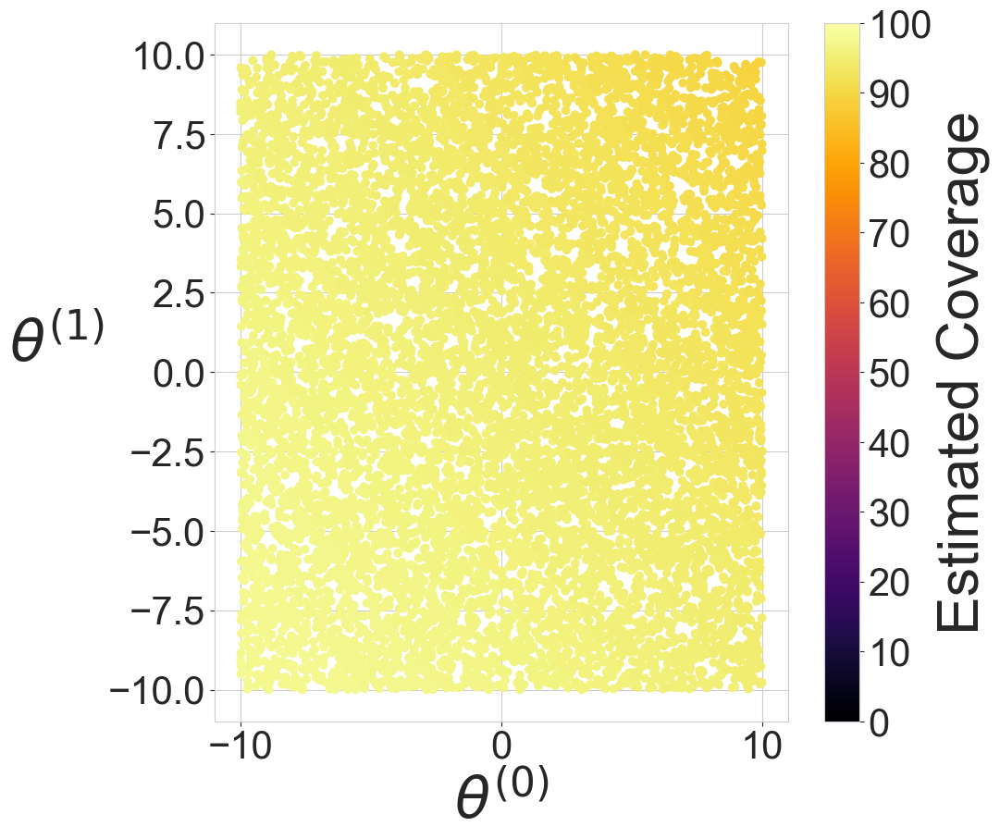

In [186]:
#probabilities, upper, lower = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator, is_azure=False, d=2, c=2)
#barplot_diagnostics(probabilities, upper, lower, 0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics95_barplot_gaussPrior_unifRef_LATEST.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities=probabilities, confidence_level=0.95, 
               save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics95_gaussPrior_unifRef_LATEST.pdf'))

##### 68.3% 

In [ ]:
diagnostics_cutoffs68 = qr_XGB68.predict(b_double_prime_theta.numpy())

In [ ]:
indicator68 = np.zeros(shape=(B_DOUBLE_PRIME, ))
indicator68[diagnostics_statistics <= diagnostics_cutoffs68.reshape(-1, )] = 1
np.sum(indicator68)/B_DOUBLE_PRIME

In [ ]:
probabilities68, upper68, lower68 = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator68, is_azure=False, d=2, c=2)
barplot_diagnostics(probabilities68, upper68, lower68, 0.683, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics68_barplot_gaussPrior_unifRef_LATEST.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities68, confidence_level=0.683, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics68_gaussPrior_unifRef_LATEST.pdf'))

### Credible sets

##### 95%

In [152]:
indicator_credible = np.zeros(shape=(B_DOUBLE_PRIME, ))
for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing credible regions for diagnostics for diagnostics...'):
    _, credible_region, _ = hpd_region(posterior=posterior, 
                                       param_grid=np.concatenate((simulator_lf2i.param_grid.astype(np.float32), b_double_prime_theta[i, :].reshape(-1, 2).float().numpy())), 
                                       x=b_double_prime_x[i, :], 
                                       confidence_level=0.95, n_p_stars=10_000, tol=0.01)
    if b_double_prime_theta[i, :].float().numpy() in credible_region:
        indicator_credible[i] = 1
np.sum(indicator_credible)

Computing credible regions for diagnostics for diagnostics...: 100%|█████████████████████████████████████████████████████████████████████████████████| 10000/10000 [46:02<00:00,  3.62it/s]


3396.0

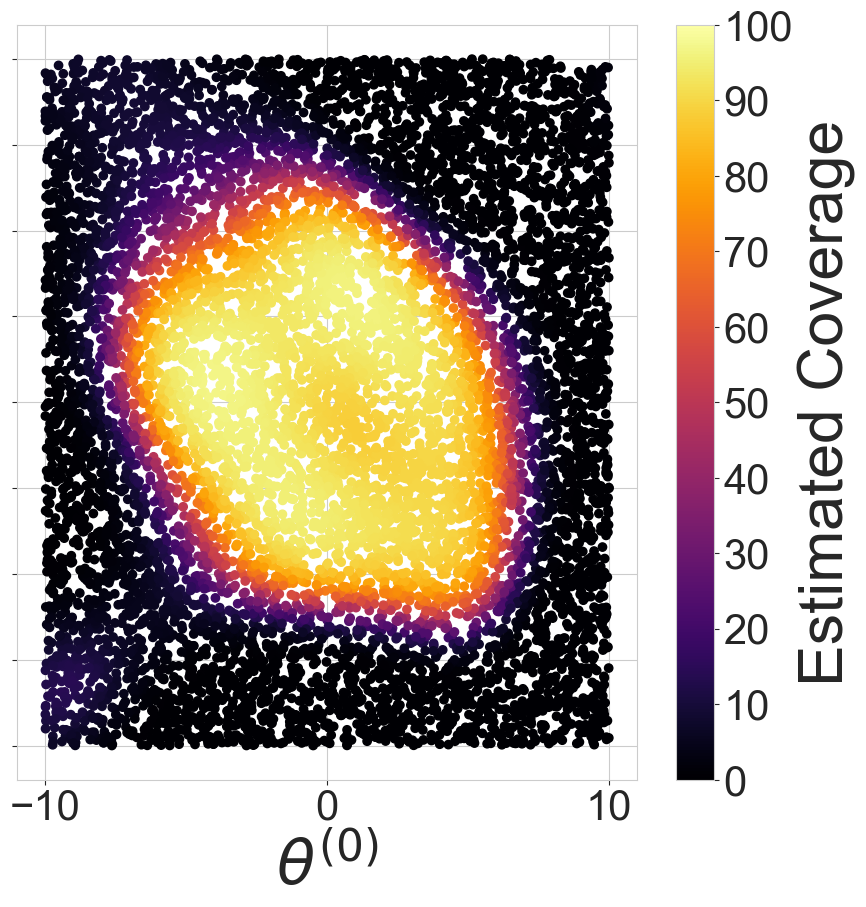

In [185]:
#probabilities_cr, upper_cr, lower_cr = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator_credible, is_azure=False, d=2)
#barplot_diagnostics(probabilities_cr, upper_cr, lower_cr, 0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/credible_region_diagnostics95_barplot_gaussPrior_unifRef_LATEST.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities_cr, confidence_level=0.95, 
               save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/credible_region_diagnostics95_gaussPrior_unifRef_LATEST.pdf'))

## Observations

### Using observations from SBIBM

#### Confidence sets

##### 95%

In [19]:
confidence_sets = []
for i in tqdm(range(1, 11), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=original_task.get_observation(num_observation=i))
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|████████████▍                                                                                                               | 1/10 [00:00<00:03,  2.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|████████████████████████▊                                                                                                   | 2/10 [00:00<00:03,  2.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|█████████████████████████████████████▏                                                                                      | 3/10 [00:01<00:02,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████▌                                                                          | 4/10 [00:01<00:02,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████                                                              | 5/10 [00:02<00:02,  2.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|██████████████████████████████████████████████████████████████████████████▍                                                 | 6/10 [00:02<00:01,  2.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 7/10 [00:02<00:01,  2.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8/10 [00:03<00:00,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9/10 [00:03<00:00,  2.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:04<00:00,  2.44it/s]


###### Inspect test statistic

In [136]:
def stat_obs(num_obs):
    post_s = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=original_task.get_observation(num_observation=num_obs))
    post_mean_obs = torch.mean(post_s, dim=0)
    post_var_obs = torch.cov(torch.transpose(post_s, 0, 1))
    stat_obs = []
    for j in range(simulator_lf2i.grid_sample_size):
        stat_obs.append(torch.matmul(torch.matmul(torch.t(torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(post_var_obs)),
                                      torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item())
    return np.array(stat_obs)

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

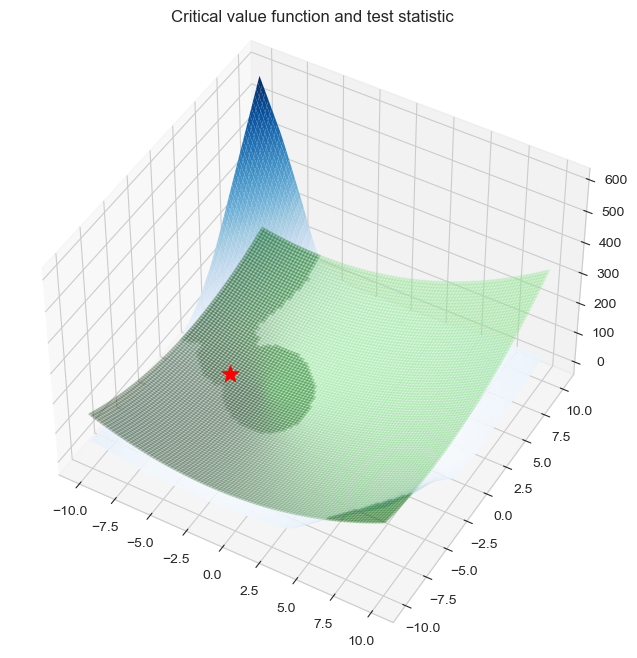

In [137]:
which_obs = 6

mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d', computed_zorder=False)

# cutoffs
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='Blues', edgecolor='none', zorder=1)

# test statistics
facecolors = np.array(['lightgreen']*simulator_lf2i.grid_sample_size)
facecolors[stat_obs(which_obs).reshape(-1, ) <= predicted_cutoffs_nn.reshape(-1,)] = 'green'
ax.plot_surface(X, Y, stat_obs(which_obs).reshape(X.shape), rstride=1, cstride=1,
                facecolors=facecolors.reshape(X.shape), edgecolor='none', alpha=0.2, zorder=2)

# projected confidence set
#cs = simulator_lf2i.param_grid[stat_obs(which_obs).reshape(-1, ) < predicted_cutoffs_xgb.reshape(-1,), :]
#ax.plot_surface(cs[:, 0].reshape(cs[:, 0].shape[0], -1), cs[:, 1].reshape(cs[:, 0].shape[0], -1), np.zeros(shape=(cs[:, 0].shape[0], cs[:, 0].shape[0])), rstride=1, cstride=1,
#                facecolors=np.full(shape=cs_x.shape, fill_value='silver'), edgecolor='none', alpha=0.5, zorder=3)

# true parameter
ax.scatter(original_task.get_true_parameters(which_obs)[0][0], original_task.get_true_parameters(which_obs)[0][1], 0, s=150, color='red', marker='*', zorder=4)

# settings
ax.set_title('Critical value function and test statistic')
#ax.set_zlim(0, 10)
ax.view_init(elev=45)#, azim=270)

##### 68.3%

In [20]:
confidence_sets_68 = []
for i in tqdm(range(1, 11), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=original_task.get_observation(num_observation=i))
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn68[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_68.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|████████████▍                                                                                                               | 1/10 [00:00<00:03,  2.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|████████████████████████▊                                                                                                   | 2/10 [00:00<00:03,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|█████████████████████████████████████▏                                                                                      | 3/10 [00:01<00:02,  2.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████▌                                                                          | 4/10 [00:01<00:02,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████                                                              | 5/10 [00:02<00:02,  2.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|██████████████████████████████████████████████████████████████████████████▍                                                 | 6/10 [00:02<00:01,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 7/10 [00:02<00:01,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8/10 [00:03<00:00,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9/10 [00:03<00:00,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:04<00:00,  2.45it/s]


#### Credible regions

##### 95%

In [21]:
credible_regions = []
actual_confidence_levels = []
for i in tqdm(range(1, 11)):
    current_confidence_level, credible_region, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=original_task.get_observation(num_observation=i), 
                                                              confidence_level=0.95, n_p_stars=100_000, tol=0.01)
    credible_regions.append(credible_region)
    actual_confidence_levels.append(current_confidence_level)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [01:06<00:00,  6.63s/it]


##### 68.3%

In [22]:
credible_regions68 = []
actual_confidence_levels68 = []
for i in tqdm(range(1, 11)):
    current_confidence_level68, credible_region68, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=original_task.get_observation(num_observation=i), 
                                                              confidence_level=0.683, n_p_stars=100_000, tol=0.01)
    credible_regions68.append(credible_region68)
    actual_confidence_levels68.append(current_confidence_level68)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [01:26<00:00,  8.66s/it]


#### Plot

##### Plot one

In [299]:
plot_hull = True
plot_points = False
prior_credible_region = True
plot_95 = True
plot_68 = False

which_obs = 8

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
if plot_95:
    which_conf_set = confidence_sets[which_obs-1]
    perimeter_conf_set = ConcaveHull(which_conf_set).calculate()
    which_credible_region = credible_regions[which_obs-1]
    perimeter_credible_region = ConcaveHull(which_credible_region).calculate()
if plot_68:
    which_conf_set68 = confidence_sets_68[which_obs-1]
    perimeter_conf_set68 = ConcaveHull(which_conf_set68).calculate()
    which_credible_region68 = credible_regions68[which_obs-1]
    perimeter_credible_region68 = ConcaveHull(which_credible_region68).calculate()
    
if plot_hull:
    if plot_95:
        perimeter_conf_set = np.vstack((perimeter_conf_set, perimeter_conf_set[0, :].reshape(-1, 2)))
        perimeter_credible_region = np.vstack((perimeter_credible_region, perimeter_credible_region[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], linewidth=5, color='green', zorder=1, label=r"Waldo 95%")
        plt.fill(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], color='green', alpha=0.2, zorder=1)
        ax.plot(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], linestyle='-', linewidth=5, color='blue', zorder=2, label=r"Posterior Credible Region 95%")
        plt.fill(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], color='blue', alpha=0.2, zorder=2)
    if plot_68:
        perimeter_conf_set68 = np.vstack((perimeter_conf_set68, perimeter_conf_set68[0, :].reshape(-1, 2)))
        perimeter_credible_region68 = np.vstack((perimeter_credible_region68, perimeter_credible_region68[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], linewidth=4, color='orange', label=r"Waldo 68.3%", zorder=3)
        plt.fill(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], color='orange', alpha=0.2, zorder=3)
        ax.plot(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], linewidth=4, color='pink', label=r"Credible Region 68.3%", zorder=4)
        plt.fill(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], color='pink', alpha=0.2, zorder=4)

if plot_points:
    if plot_95:
        ax.scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", zorder=1)#, label=r"Waldo 95% confidence set")
        ax.scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", zorder=2)#, label=r"95% credible region",)
    if plot_68:
        ax.scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", zorder=3)#, label=r"Waldo 68.3% confidence set")
        ax.scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", zorder=4)#, label=r"68.3% credible region")

if prior_credible_region:
    _, prior_credible_region, _ = hpd_region(prior=task.prior_dist, 
                                             posterior=None,
                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                              x=original_task.get_observation(num_observation=which_obs), 
                                              confidence_level=0.95, n_p_stars=100_000, tol=0.01)
    prior_credible_region = Polygon(prior_credible_region[ConvexHull(prior_credible_region).vertices,:], 
                                    fc=to_rgba("grey", 0.2), ec=to_rgba('grey', 1), lw=4, label=r"Prior Credible Region 95%", zorder=0, linestyle=':')
    ax.add_artist(prior_credible_region)
    
ax.scatter(x=original_task.get_true_parameters(num_observation=which_obs)[0][0], 
           y=original_task.get_true_parameters(num_observation=which_obs)[0][1], 
           alpha=1, 
           c="red", marker="*", s=1000, 
           label=r"True $\theta^*=$[{:.2f}, {:.2f}]".format(*original_task.get_true_parameters(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)
#ax.scatter(x=original_task.get_observation(num_observation=which_obs)[0][0], 
#                     y=original_task.get_observation(num_observation=which_obs)[0][1], alpha=1, 
#                     c="black", marker="x", s=500, label=r"$\mathbf{{x}}_o=$[{:.2f}, {:.2f}]".format(*original_task.get_observation(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)


ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
# ax.set_xlabel(r"$\theta_{{(1)}}$", fontsize=45)
#ax.set_ylabel(r"$\theta^{{(2)}}$", fontsize=45, rotation=0)
ax.tick_params(axis='both', which='major', labelsize=30, bottom=True, left=True, labelleft=False, labelbottom=False)
# ax.legend(prop={'size': 50})
ax.set_title(r'Prior: $N(\mathbf{0}, 2\mathbf{I})$', fontsize=45, pad=8)#U(-10, 10)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(3)
    ax.spines[axis].set_color('black')
which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
plt.savefig(os.path.join(PATH, f'waldo/results/bayesian_lfi/confidence_credible_sets_nobs{which_obs-1}_LATEST.pdf'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

##### Plot all (slow)

In [84]:
plot_hull = False
plot_points = True
plot_posterior = False
plot_95 = True
plot_68 = False

fig, ax = plt.subplots(5, 2, figsize=(20, 50))
which_obs = 1
for row in range(5):
    for col in range(2):
        print(which_obs, flush=True, end='')
        
        if plot_95:
            which_conf_set = confidence_sets[which_obs-1]
            which_credible_region = credible_regions[which_obs-1]
        if plot_68:
            which_conf_set68 = confidence_sets_68[which_obs-1]
            which_credible_region68 = credible_regions68[which_obs-1]

        ######## PLOT
        if plot_hull:
            # convex hulls
            if plot_95:
                waldo_region = Polygon(which_conf_set[ConvexHull(which_conf_set).vertices,:], 
                                       fc=to_rgba("green", 0.2), ec=to_rgba('green', 1), lw=2, label=r"Waldo 95% confidence set", zorder=2)
                credible_set = Polygon(which_credible_region[ConvexHull(which_credible_region).vertices,:], 
                                        fc=to_rgba("green", 0.2), ec=to_rgba('blue', 1), lw=2, label=r"95% Credible region", zorder=2)
                ax[row][col].add_artist(credible_set)
                ax[row][col].add_artist(waldo_region)
                #closed_which_conf_set = np.vstack((which_conf_set, which_conf_set[0, :].reshape(-1, 2)))
                #closed_which_credible_region = np.vstack((which_credible_region, which_credible_region[0, :].reshape(-1, 2)))
                #ax[row][col].plot(which_conf_set[:, 0], which_conf_set[:, 1], linewidth=3, color='green', label=r"Waldo 95%", zorder=1)
                #ax[row][col].plot(which_credible_region[:, 0], which_credible_region[:, 1], linewidth=3, color='blue', label=r"Credible Region 95%", zorder=2)
                
            if plot_68:
                waldo_region68 = Polygon(which_conf_set68[ConvexHull(which_conf_set68).vertices,:], 
                                       fc=to_rgba("orange", 0.2), ec=to_rgba('orange', 1), lw=2, label=r"Waldo 68.3% confidence set", zorder=2)
                credible_set68 = Polygon(which_credible_region68[ConvexHull(which_credible_region68).vertices,:], 
                                        fc=to_rgba("green", 0.2), ec=to_rgba('pink', 1), lw=2, label=r"68.3% Credible region", zorder=2)
                
                #ax[row][col].add_artist(credible_set68)
                #ax[row][col].add_artist(waldo_region68)
                #closed_which_conf_set68 = np.vstack((which_conf_set68, which_conf_set68[0, :].reshape(-1, 2)))
                #closed_which_credible_region68 = np.vstack((which_credible_region68, which_credible_region68[0, :].reshape(-1, 2)))
                #ax[row][col].plot(closed_which_conf_set68[:, 0], closed_which_conf_set68[:, 1], linewidth=3, color='orange', label=r"Waldo 68.3%", zorder=3)
                #ax[row][col].plot(closed_which_credible_region68[:, 0], closed_which_credible_region68[:, 1], linewidth=3, color='pink', label=r"Credible Region 68.3%", zorder=4)

        if plot_points:
            # points
            if plot_95:
                ax[row][col].scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", label=r"Waldo 95% confidence set", zorder=2)
                ax[row][col].scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", label=r"95% credible region", zorder=2)
            if plot_68:
                ax[row][col].scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", label=r"Waldo 68.3% confidence set", zorder=2)
                ax[row][col].scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", label=r"68.3% credible region", zorder=2)

        ax[row][col].scatter(x=original_task.get_true_parameters(num_observation=which_obs)[0][0], 
                             y=original_task.get_true_parameters(num_observation=which_obs)[0][1], alpha=1, 
                             c="red", marker="*", s=150, label=r"True $\theta$", zorder=3)


        if plot_posterior:
            which_posterior_samples = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.original_task(num_observation=which_obs))
            #ax[row][col].hist2d(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Estimated Posterior')
            sns.histplot(data=np_to_pd(which_posterior_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='Estimated Posterior', 
                         ax=ax[row][col], stat='density', zorder=1, alpha=1)
            # TRUE
            #true_post_samples = task.get_reference_posterior_samples(num_observation=which_obs)

            #sns.histplot(data=np_to_pd(true_post_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='True Posterior', 
            #             ax=ax[row][col], zorder=1, alpha=1)
            #ax[row][col].scatter(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Posterior Samples', zorder=1, alpha=0.5, s=10)


        # settings
        axis_lim = 2
        #ax.set_xlim(task.get_true_parameters(num_observation=which_obs)[0][0]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][0]+axis_lim)
        #ax.set_ylim(task.get_true_parameters(num_observation=which_obs)[0][1]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][1]+axis_lim)
        ax[row][col].set_xlim(-10, 10)
        ax[row][col].set_ylim(-10, 10)
        ax[row][col].set_xlabel(r"$\theta_0$", fontsize=15)
        ax[row][col].set_ylabel(r"$\theta_1$", fontsize=15, rotation=0)
        ax[row][col].legend()
        title1 = r"$\theta^*=$[{:.2f}, {:.2f}]".format(*original_task.get_true_parameters(num_observation=which_obs).reshape(-1, ).tolist())
        title2 = r"$x_o=$[{:.2f}, {:.2f}]".format(*original_task.get_observation(num_observation=which_obs).reshape(-1, ).tolist())
        ax[row][col].set_title(title1+', '+title2)
        which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
# plt.savefig(os.path.join(PATH, 'waldo/results/bayesian_lfi/confidence_credible_setsBOTHCL_corrected_QRnn_gaussPrior.png'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

12345678910

### When $\theta^* = [0, 0]$

In [117]:
new_observations = simulate_in_batches(simulator=simulator, theta=torch.Tensor([[0, 0]]).repeat_interleave(10, dim=0)).numpy()
new_observations.shape

Running 10 simulations.:   0%|          | 0/10 [00:00<?, ?it/s]

(10, 2)

#### Confidence sets

##### 95%

In [118]:
confidence_sets_new = []
for i in tqdm(range(0, 10), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=new_observations[i, :])
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_new.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|████████████▍                                                                                                               | 1/10 [00:00<00:03,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|████████████████████████▊                                                                                                   | 2/10 [00:00<00:03,  2.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|█████████████████████████████████████▏                                                                                      | 3/10 [00:01<00:02,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████▌                                                                          | 4/10 [00:01<00:02,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████                                                              | 5/10 [00:01<00:01,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|██████████████████████████████████████████████████████████████████████████▍                                                 | 6/10 [00:02<00:01,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 7/10 [00:02<00:01,  2.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8/10 [00:03<00:00,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9/10 [00:03<00:00,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:03<00:00,  2.63it/s]


###### Inspect test statistic

In [132]:
def stat_obs(num_obs):
    post_s = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=num_obs))
    post_mean_obs = torch.mean(post_s, dim=0)
    post_var_obs = torch.cov(torch.transpose(post_s, 0, 1))
    stat_obs = []
    for j in range(simulator_lf2i.grid_sample_size):
        stat_obs.append(torch.matmul(torch.matmul(torch.t(torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(post_var_obs)),
                                      torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item())
    return np.array(stat_obs)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

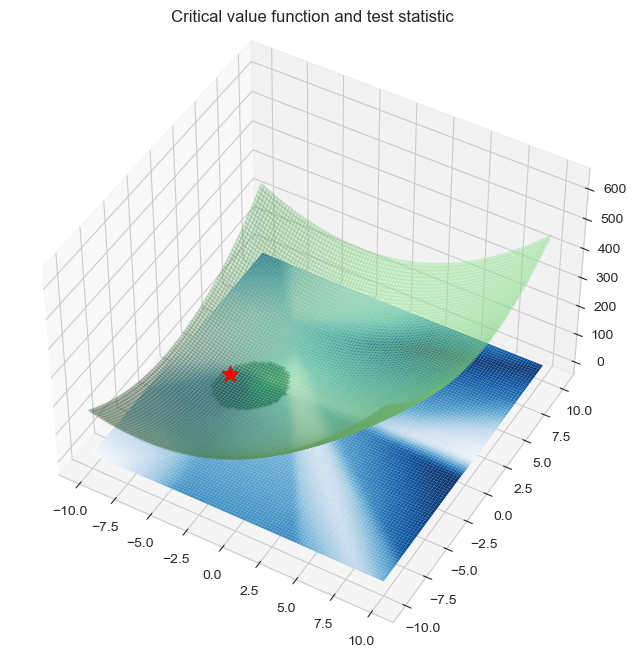

In [135]:
which_obs = 6

mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d', computed_zorder=False)

# cutoffs
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='Blues', edgecolor='none', zorder=1)

# test statistics
facecolors = np.array(['lightgreen']*simulator_lf2i.grid_sample_size)
facecolors[stat_obs(which_obs).reshape(-1, ) <= predicted_cutoffs_nn.reshape(-1,)] = 'green'
ax.plot_surface(X, Y, stat_obs(which_obs).reshape(X.shape), rstride=1, cstride=1,
                facecolors=facecolors.reshape(X.shape), edgecolor='none', alpha=0.2, zorder=2)

# projected confidence set
#cs = simulator_lf2i.param_grid[stat_obs(which_obs).reshape(-1, ) < predicted_cutoffs_xgb.reshape(-1,), :]
#ax.plot_surface(cs[:, 0].reshape(cs[:, 0].shape[0], -1), cs[:, 1].reshape(cs[:, 0].shape[0], -1), np.zeros(shape=(cs[:, 0].shape[0], cs[:, 0].shape[0])), rstride=1, cstride=1,
#                facecolors=np.full(shape=cs_x.shape, fill_value='silver'), edgecolor='none', alpha=0.5, zorder=3)

# true parameter
ax.scatter(task.get_true_parameters(which_obs)[0][0], task.get_true_parameters(which_obs)[0][1], 0, s=150, color='red', marker='*', zorder=4)

# settings
ax.set_title('Critical value function and test statistic')
#ax.set_zlim(0, 10)
ax.view_init(elev=45)#, azim=270)

##### 68.3%

In [86]:
confidence_sets_68_new = []
for i in tqdm(range(0, 10), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=new_observations[i, :])
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn68[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_68_new.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|████████████▍                                                                                                               | 1/10 [00:00<00:04,  2.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|████████████████████████▊                                                                                                   | 2/10 [00:00<00:03,  2.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|█████████████████████████████████████▏                                                                                      | 3/10 [00:01<00:03,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████▌                                                                          | 4/10 [00:01<00:02,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████                                                              | 5/10 [00:02<00:02,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|██████████████████████████████████████████████████████████████████████████▍                                                 | 6/10 [00:02<00:01,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 7/10 [00:03<00:01,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8/10 [00:03<00:00,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9/10 [00:04<00:00,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:04<00:00,  2.24it/s]


#### Credible regions

##### 95%

In [119]:
credible_regions_new = []
actual_confidence_levels = []
for i in tqdm(range(0, 10)):
    current_confidence_level, credible_region, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=new_observations[i, :], 
                                                              confidence_level=0.95, n_p_stars=100_000, tol=0.01)
    credible_regions_new.append(credible_region)
    actual_confidence_levels.append(current_confidence_level)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:55<00:00,  5.58s/it]


##### 68.3%

In [36]:
credible_regions68_new = []
actual_confidence_levels68 = []
for i in tqdm(range(0, 10)):
    current_confidence_level68, credible_region68, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=new_observations[i, :], 
                                                              confidence_level=0.683, n_p_stars=100_000, tol=0.01)
    credible_regions68_new.append(credible_region68)
    actual_confidence_levels68.append(current_confidence_level68)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:25<00:00,  2.56s/it]


#### Plot one

In [292]:
plot_hull = True
plot_points = False
plot_posterior = False
plot_95 = True
plot_68 = False

which_obs = 1

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
if plot_95:
    which_conf_set = confidence_sets_new[which_obs-1]
    perimeter_conf_set = ConcaveHull(which_conf_set).calculate()
    which_credible_region = credible_regions_new[which_obs-1]
    perimeter_credible_region = ConcaveHull(which_credible_region).calculate()
if plot_68:
    which_conf_set68 = confidence_sets_68[which_obs-1]
    perimeter_conf_set68 = ConcaveHull(which_conf_set68).calculate()
    which_credible_region68 = credible_regions68[which_obs-1]
    perimeter_credible_region68 = ConcaveHull(which_credible_region68).calculate()
    
if plot_hull:
    if plot_95:
        # perimeter_conf_set = np.vstack((perimeter_conf_set, perimeter_conf_set[0, :].reshape(-1, 2)))
        perimeter_credible_region = np.vstack((perimeter_credible_region, perimeter_credible_region[0, :].reshape(-1, 2)))
        #ax.plot(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], linewidth=4, color='green', zorder=1)#label=r"Waldo 95%", 
        #plt.fill(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], color='green', alpha=0.2, zorder=1)
        waldo_region = Polygon(which_conf_set[ConvexHull(which_conf_set).vertices,:], 
                                       fc=to_rgba("green", 0.2), ec=to_rgba('green', 1), lw=5, zorder=1)
        ax.add_artist(waldo_region)
        ax.plot(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], linewidth=5, color='blue', zorder=2)#label=r"Credible Region 95%", 
        plt.fill(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], color='blue', alpha=0.2, zorder=2)
    if plot_68:
        perimeter_conf_set68 = np.vstack((perimeter_conf_set68, perimeter_conf_set68[0, :].reshape(-1, 2)))
        perimeter_credible_region68 = np.vstack((perimeter_credible_region68, perimeter_credible_region68[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], linewidth=4, color='orange', label=r"Waldo 68.3%", zorder=3)
        plt.fill(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], color='orange', alpha=0.2, zorder=3)
        ax.plot(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], linewidth=4, color='pink', label=r"Credible Region 68.3%", zorder=4)
        plt.fill(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], color='pink', alpha=0.2, zorder=4)

if plot_points:
    if plot_95:
        ax.scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", zorder=1)#, label=r"Waldo 95% confidence set")
        ax.scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", zorder=2)#, label=r"95% credible region",)
    if plot_68:
        ax.scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", zorder=3)#, label=r"Waldo 68.3% confidence set")
        ax.scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", zorder=4)#, label=r"68.3% credible region")

ax.scatter(x=0, y=0, alpha=1, c="red", marker="*", s=1000, label=r"True $\theta^*=$[{:.2f}, {:.2f}]".format(*[0, 0]), zorder=5)
#ax.scatter(x=original_task.get_observation(num_observation=which_obs)[0][0], 
#                     y=original_task.get_observation(num_observation=which_obs)[0][1], alpha=1, 
#                     c="black", marker="x", s=500, label=r"$\mathbf{{x}}_o=$[{:.2f}, {:.2f}]".format(*original_task.get_observation(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_xlabel(r"$\theta^{{(1)}}$", fontsize=45)
ax.set_ylabel(r"$\theta^{{(2)}}$", fontsize=45, rotation=0)
ax.tick_params(axis='both', which='major', labelsize=30, bottom=True, left=True, labelleft=True, labelbottom=True)
ax.legend(prop={'size': 40})
ax.set_title(r'Prior: $N(0, 2)$', fontsize=45)#U(-10, 10)
which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
# plt.savefig(os.path.join(PATH, f'waldo/results/bayesian_lfi/confidence_credible_sets_true0gauss_LATEST.pdf'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

In [294]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/true_zero_credibleConfidence_forComparison.pickle'), 'wb') as f:
    pickle.dump((which_conf_set, perimeter_credible_region), f)

In [296]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/true_zero_obs_forComparison.pickle'), 'wb') as f:
    pickle.dump(new_observations[0, :], f)

#### Plot all

In [132]:
plot_hull = False
plot_points = True
plot_posterior = False
plot_95 = True
plot_68 = False

fig, ax = plt.subplots(5, 2, figsize=(20, 50))
which_obs = 0
for row in range(5):
    for col in range(2):
        
        if plot_95:
            which_conf_set = confidence_sets_new[which_obs-1]
            which_credible_region = credible_regions_new[which_obs-1]
        if plot_68:
            which_conf_set68 = confidence_sets_68_new[which_obs-1]
            which_credible_region68 = credible_regions68_new[which_obs-1]

        ######## PLOT
        if plot_hull:
            # convex hulls
            if plot_95:
                waldo_region = Polygon(which_conf_set[ConvexHull(which_conf_set).vertices,:], 
                                       fc=to_rgba("green", 0.2), ec=to_rgba('green', 1), lw=2, label=r"Waldo 95% confidence set", zorder=2)
                credible_set = Polygon(which_credible_region[ConvexHull(which_credible_region).vertices,:], 
                                        fc=to_rgba("green", 0.2), ec=to_rgba('blue', 1), lw=2, label=r"95% Credible region", zorder=2)
                ax[row][col].add_artist(credible_set)
                ax[row][col].add_artist(waldo_region)
            if plot_68:
                waldo_region68 = Polygon(which_conf_set68[ConvexHull(which_conf_set68).vertices,:], 
                                       fc=to_rgba("orange", 0.2), ec=to_rgba('orange', 1), lw=2, label=r"Waldo 68.3% confidence set", zorder=2)
                credible_set68 = Polygon(which_credible_region68[ConvexHull(which_credible_region68).vertices,:], 
                                        fc=to_rgba("green", 0.2), ec=to_rgba('pink', 1), lw=2, label=r"68.3% Credible region", zorder=2)
            
                ax[row][col].add_artist(credible_set68)
                ax[row][col].add_artist(waldo_region68)

        if plot_points:
            # points
            if plot_95:
                ax[row][col].scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", label=r"Waldo 95% confidence set", zorder=3)
                ax[row][col].scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", label=r"95% credible region", zorder=2)
            if plot_68:
                ax[row][col].scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", label=r"Waldo 68.3% confidence set", zorder=2)
                ax[row][col].scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", label=r"68.3% credible region", zorder=2)

        ax[row][col].scatter(x=0, 
                             y=0, alpha=1, 
                             c="red", marker="*", s=150, label=r"True $\theta$", zorder=3)


        if plot_posterior:
            which_posterior_samples = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=new_observations[which_obs, :])
            #ax[row][col].hist2d(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Estimated Posterior')
            sns.histplot(data=np_to_pd(which_posterior_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='Estimated Posterior', 
                         ax=ax[row][col], stat='density', zorder=1, alpha=1)
            # TRUE
            #true_post_samples = task.get_reference_posterior_samples(num_observation=which_obs)

            #sns.histplot(data=np_to_pd(true_post_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='True Posterior', 
            #             ax=ax[row][col], zorder=1, alpha=1)
            #ax[row][col].scatter(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Posterior Samples', zorder=1, alpha=0.5, s=10)


        # settings
        axis_lim = 2
        #ax.set_xlim(task.get_true_parameters(num_observation=which_obs)[0][0]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][0]+axis_lim)
        #ax.set_ylim(task.get_true_parameters(num_observation=which_obs)[0][1]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][1]+axis_lim)
        ax[row][col].set_xlim(-10, 10)
        ax[row][col].set_ylim(-10, 10)
        ax[row][col].set_xlabel(r"$\theta_0$", fontsize=15)
        ax[row][col].set_ylabel(r"$\theta_1$", fontsize=15, rotation=0)
        ax[row][col].legend()
        title1 = r"$\theta^*=$[{:.2f}, {:.2f}]".format(*[0, 0])
        title2 = r"$x_o=$[{:.2f}, {:.2f}]".format(*new_observations[which_obs, :])
        ax[row][col].set_title(title1+', '+title2)
        which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
# plt.savefig(os.path.join(PATH, 'waldo/results/bayesian_lfi/confidence_credible_setsBOTHCL_corrected_QRnn_gaussPrior.png'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

## Save Results

In [143]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture_gaussPrior_LATEST.pickle'), 'wb') as f:
    pickle.dump({'b_prime_theta': (b_prime_theta), #'b_double_prime_sample': (b_double_prime_theta, b_double_prime_x), 
                 'npe': posterior, 
                 'qr_statistics': qr_statistics, #'diagnostics_statistics': diagnostics_statistics
                }, f)

In [ ]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture_gaussPrior_LATEST.pickle'), 'wb') as f:
    pickle.dump({'b_prime_sample': (b_prime_theta, b_prime_x), 'b_double_prime_sample': (b_double_prime_theta, b_double_prime_x), 
                 'npe': posterior, 
                 'qr_statistics': qr_statistics,
                 'diagnostics_statistics': diagnostics_statistics,
                 'indicator_credible': indicator_credible}, f)

## Load Results

In [7]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture.pickle'), 'rb') as f:
    saved_results = pickle.load(f)

In [5]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture_nosbibm.pickle'), 'rb') as f:
    saved_results = pickle.load(f)

In [8]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture_gaussPrior.pickle'), 'rb') as f:
    saved_results = pickle.load(f)

In [10]:
task = saved_results['task']
posterior = saved_results['npe']
b_prime_theta, b_prime_x = saved_results['b_prime_sample']
b_double_prime_theta, b_double_prime_x = saved_results['b_double_prime_sample']
# diagnostics_statistics, diagnostics_cutoffs = saved_results['diagnostics_statistics_cutoffs']
qr_statistics, predicted_cutoffs_nn, predicted_cutoffs_nn68, qr_nn, qr_nn68 = saved_results['qr_statistics_cutoffs_QR_95_68']
confidence_sets = saved_results['confidence_sets']

# Intro waldo figure for scheme

In [188]:
from scipy.stats import chi2

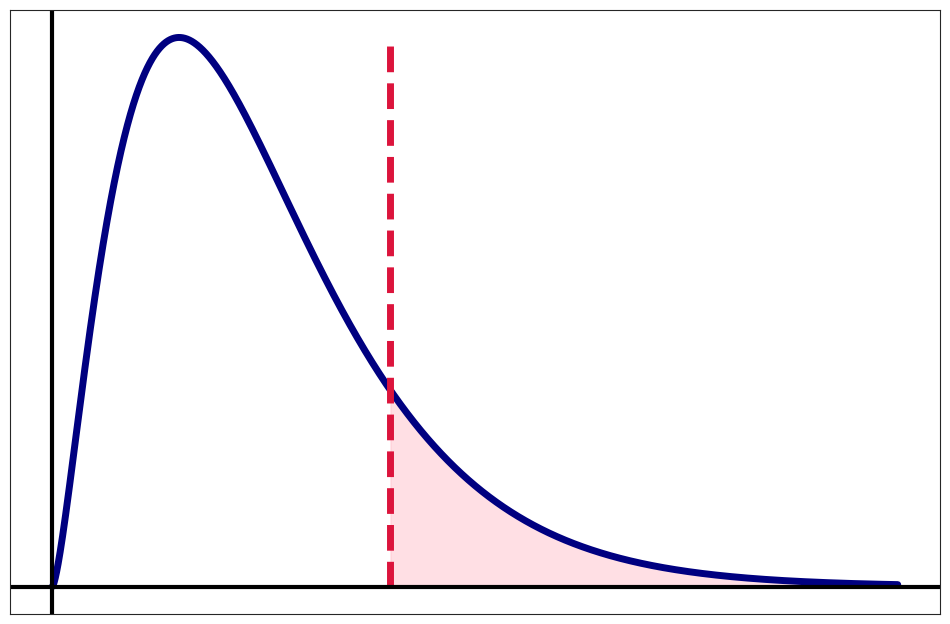

In [240]:
sns.set_style('white')

fig, ax = plt.subplots(1, 1, figsize=(12, 8))
x = np.linspace(0, 20, 100_000)
pdf = chi2(5).pdf(x)
sns.lineplot(x=x, y=pdf, color='navy', linewidth=5)
ax.vlines(x=8, ymin=np.min(pdf), ymax=np.max(pdf), color='crimson', linestyles='--', linewidths=5)
ax.fill_between(x[x >= 8], 0, pdf[x > 8], color='pink', alpha=0.5)
ax.axvline(x=0, ymin=0, ymax=1, color='black', linestyle='-', linewidth=3)
ax.axhline(y=np.min(pdf), xmin=0, xmax=1, color='black', linestyle='-', linewidth=3)

ax.axes.tick_params(bottom=False, labelbottom=False, left=False, labelleft=False)
#ax.set_xlabel(r'$\hat{\tau}$', fontsize=30, labelpad=8)
ax.set_ylabel('')
ax.axis('on')
plt.savefig(os.path.join(PATH, 'waldo/nips2022/figures/intro/waldo_cutoff.pdf'))
plt.show()